### Import necessary libraries

In [1]:
!pip install twint
!pip install nest_asyncio
!pip install vaderSentiment
!pip install spacy
!pip install pyLDAvis
import twint 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
import xgboost as xgb
import seaborn as sns
import scipy as sp
import sklearn as sklearn
import gensim as gensim
import nltk
import time
import re
import json
import csv
import gensim.corpora as corpora
import spacy
import pyLDAvis
import pyLDAvis.gensim
import nest_asyncio
import warnings
import pickle
from statsmodels.formula.api import ols
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from pprint import pprint
from datetime import datetime
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
plt.style.use('seaborn')
%matplotlib inline
pd.set_option('display.max_columns', 1000)
pd.set_option('display.max_rows', 1000)
warnings.filterwarnings("ignore",category=DeprecationWarning)

[nltk_data] Downloading package punkt to /Users/lucas/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/lucas/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /Users/lucas/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


### Read in csv files

In [2]:
d_20 = pd.read_csv('offense-2020.csv')
o_20 = pd.read_csv('defense-2020.csv')

d_19 = pd.read_csv('offense-2019.csv')
o_19 = pd.read_csv('defense-2019.csv')

d_18 = pd.read_csv('offense-2018.csv')
o_18 = pd.read_csv('defense-2018.csv')

d_17 = pd.read_csv('offense-2017.csv')
o_17 = pd.read_csv('defense-2017.csv')

d_16 = pd.read_csv('offense-2016.csv')
o_16 = pd.read_csv('defense-2016.csv')

d_15 = pd.read_csv('offense-2015.csv')
o_15 = pd.read_csv('defense-2015.csv')

d_14 = pd.read_csv('offense-2014.csv')
o_14 = pd.read_csv('defense-2014.csv')

d_13 = pd.read_csv('offense-2013.csv')
o_13 = pd.read_csv('defense-2013.csv')

d_12 = pd.read_csv('offense-2012.csv')
o_12 = pd.read_csv('defense-2012.csv')

d_11 = pd.read_csv('offense-2011.csv')
o_11 = pd.read_csv('defense-2011.csv')

d_10 = pd.read_csv('offense-2010.csv')
o_10 = pd.read_csv('defense-2010.csv')

d_09 = pd.read_csv('offense-2009.csv')
o_09 = pd.read_csv('defense-2009.csv')

d_08 = pd.read_csv('offense-2008.csv')
o_08 = pd.read_csv('defense-2008.csv')

d_07 = pd.read_csv('offense-2007.csv')
o_07 = pd.read_csv('defense-2007.csv')

d_06 = pd.read_csv('offense-2006.csv')
o_06 = pd.read_csv('defense-2006.csv')

d_05 = pd.read_csv('offense-2005.csv')
o_05 = pd.read_csv('defense-2005.csv')

d_04 = pd.read_csv('offense-2004.csv')
o_04 = pd.read_csv('defense-2004.csv')

d_03 = pd.read_csv('offense-2003.csv')
o_03 = pd.read_csv('defense-2003.csv')

d_02 = pd.read_csv('offense-2002.csv')
o_02 = pd.read_csv('defense-2002.csv')

d_01 = pd.read_csv('offense-2001.csv')
o_01 = pd.read_csv('defense-2001.csv')

d_00 = pd.read_csv('offense-2000.csv')
o_00 = pd.read_csv('defense-2000.csv')

In [3]:
df_list = [d_19,o_19,d_18,o_18,d_17,o_17,d_16,o_16,d_15,o_15,d_14,o_14,d_13,o_13,d_12,o_12,d_11,o_11,d_10,o_10,d_09,o_09,d_08,o_08,d_07,o_07,d_06,o_06,d_05,o_05,d_04,o_04,d_03,o_03,d_02,o_02,d_01,o_01,d_00,o_00]

In [4]:
df = pd.concat(df_list)

In [5]:
df.shape

(6319, 17)

### Clean Data

In [6]:
#clean names column
name_list = []
for i in df.Player:
    player_list = i.split("\\")
    name_list.append(player_list[0])
df.Player = name_list

In [7]:
#handle undrafted players by replacing nan with 8
round_dict = {np.nan:'No Team / 8th / 700th pick / 2100'}
df['Drafted (tm/rnd/yr)'].replace(round_dict, inplace = True)

In [8]:
# impute mean age (roughly)
age_dict = {np.nan:22}
df['Age'].replace(age_dict, inplace = True)

In [9]:
#clean draft position of players in new_df
clean_round_drafted = []
for i in df['Drafted (tm/rnd/yr)']:
    draft_list = i.split("/")
    round_drafted = draft_list[1][1]
    clean_round_drafted.append(round_drafted)
df['Round'] = clean_round_drafted
df.drop(columns = ['Drafted (tm/rnd/yr)'], inplace = True)

In [10]:
df.drop(columns = ['Rk', 'AV', 'College'], inplace = True)

In [11]:
# map infrequent and new positions to pre-existing ones with similar responsibilities and qualities
pos_dict = {'S':'FS', 'OL':'OG', 'DL':'DT', 'LB':'OLB', 'EDGE':'DE'}
df.Pos.replace(pos_dict, inplace = True)

### Deal with missing data

In [12]:
# create list of values to impute for non-participants of events (by position)
mean_by_pos_40 = df.groupby('Pos')['40YD'].mean()
std_by_pos_40 = df.groupby('Pos')['40YD'].std()
nan_penalty_40 = mean_by_pos_40 + .5*std_by_pos_40

mean_by_pos_vert = df.groupby('Pos')['Vertical'].mean()
std_by_pos_vert = df.groupby('Pos')['Vertical'].std()
nan_penalty_vert = mean_by_pos_vert - .5*std_by_pos_vert

mean_by_pos_bench = df.groupby('Pos')['BenchReps'].mean()
std_by_pos_bench = df.groupby('Pos')['BenchReps'].std()
nan_penalty_bench = mean_by_pos_bench - .5*std_by_pos_bench

mean_by_pos_broad = df.groupby('Pos')['Broad Jump'].mean()
std_by_pos_broad = df.groupby('Pos')['Broad Jump'].std()
nan_penalty_broad = mean_by_pos_broad - .5*std_by_pos_broad


mean_by_pos_3cone = df.groupby('Pos')['3Cone'].mean()
std_by_pos_3cone = df.groupby('Pos')['3Cone'].std()
nan_penalty_3cone = mean_by_pos_3cone + .5*std_by_pos_3cone

mean_by_pos_shuttle = df.groupby('Pos')['Shuttle'].mean()
std_by_pos_shuttle = df.groupby('Pos')['Shuttle'].std()
nan_penalty_shuttle = mean_by_pos_shuttle + .5*std_by_pos_shuttle

In [13]:
print("nan_penalty_40")
print(nan_penalty_40)
print("")
print("nan_penalty_vert")
print(nan_penalty_vert)
print("")
print("nan_penalty_bench")
print(nan_penalty_bench)
print("")
print("nan_penalty_broad")
print(nan_penalty_broad)
print("")
print("nan_penalty_3cone")
print(nan_penalty_3cone)
print("")
print("nan_penalty_shuttle")
print(nan_penalty_shuttle)

nan_penalty_40
Pos
C      5.319924
CB     4.541584
DE     4.893102
DT     5.170493
FB     4.832669
FS     4.609266
ILB    4.814414
OG     5.394333
OLB    4.734316
OT     5.339185
QB     4.914067
RB     4.611794
SS     4.619766
TE     4.841208
WR     4.562142
Name: 40YD, dtype: float64

nan_penalty_vert
Pos
C      26.509700
CB     34.577116
DE     31.450307
DT     27.864409
FB     31.210632
FS     34.166669
ILB    31.735044
OG     26.062851
OLB    32.804533
OT     26.537368
QB     29.496755
RB     32.895829
SS     33.883471
TE     31.340777
WR     33.725323
Name: Vertical, dtype: float64

nan_penalty_bench
Pos
C      23.646150
CB     12.432329
DE     21.387198
DT     24.903738
FB     20.370783
FS     14.360253
ILB    20.165818
OG     22.926322
OLB    20.045840
OT     21.961435
QB     17.145077
RB     17.113607
SS     15.365649
TE     18.028782
WR     12.486491
Name: BenchReps, dtype: float64

nan_penalty_broad
Pos
C       98.421912
CB     119.022484
DE     111.816697
DT     102.186387
F

In [14]:
df.set_index('Pos', inplace = True)

In [15]:
# make positional dataframes
C = df.loc['C', :]
CB = df.loc['CB', :]
DE = df.loc['DE', :]
DT = df.loc['DT', :]
FB = df.loc['FB', :]
FS = df.loc['FS', :]
ILB = df.loc['ILB', :]
OG = df.loc['OG', :]
OLB = df.loc['OLB', :]
OT = df.loc['OT', :]
QB = df.loc['QB', :]
RB = df.loc['RB', :]
SS = df.loc['SS', :]
TE = df.loc['TE', :]
WR = df.loc['WR', :]

In [16]:
C['40YD'].fillna(nan_penalty_40['C'], inplace = True)
CB['40YD'].fillna(nan_penalty_40['CB'], inplace = True)
DE['40YD'].fillna(nan_penalty_40['DE'], inplace = True)
DT['40YD'].fillna(nan_penalty_40['DT'], inplace = True)
FB['40YD'].fillna(nan_penalty_40['FB'], inplace = True)
FS['40YD'].fillna(nan_penalty_40['FS'], inplace = True)
ILB['40YD'].fillna(nan_penalty_40['ILB'], inplace = True)
OG['40YD'].fillna(nan_penalty_40['OG'], inplace = True)
OLB['40YD'].fillna(nan_penalty_40['OLB'], inplace = True)
OT['40YD'].fillna(nan_penalty_40['OT'], inplace = True)
QB['40YD'].fillna(nan_penalty_40['QB'], inplace = True)
RB['40YD'].fillna(nan_penalty_40['RB'], inplace = True)
SS['40YD'].fillna(nan_penalty_40['SS'], inplace = True)
TE['40YD'].fillna(nan_penalty_40['TE'], inplace = True)
WR['40YD'].fillna(nan_penalty_40['WR'], inplace = True)

/Users/lucas/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/pandas/core/generic.py:6245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._update_inplace(new_data)


In [17]:
C['Vertical'].fillna(nan_penalty_vert['C'], inplace = True)
CB['Vertical'].fillna(nan_penalty_vert['CB'], inplace = True)
DE['Vertical'].fillna(nan_penalty_vert['DE'], inplace = True)
DT['Vertical'].fillna(nan_penalty_vert['DT'], inplace = True)
FB['Vertical'].fillna(nan_penalty_vert['FB'], inplace = True)
FS['Vertical'].fillna(nan_penalty_vert['FS'], inplace = True)
ILB['Vertical'].fillna(nan_penalty_vert['ILB'], inplace = True)
OG['Vertical'].fillna(nan_penalty_vert['OG'], inplace = True)
OLB['Vertical'].fillna(nan_penalty_vert['OLB'], inplace = True)
OT['Vertical'].fillna(nan_penalty_vert['OT'], inplace = True)
QB['Vertical'].fillna(nan_penalty_vert['QB'], inplace = True)
RB['Vertical'].fillna(nan_penalty_vert['RB'], inplace = True)
SS['Vertical'].fillna(nan_penalty_vert['SS'], inplace = True)
TE['Vertical'].fillna(nan_penalty_vert['TE'], inplace = True)
WR['Vertical'].fillna(nan_penalty_vert['WR'], inplace = True)

In [18]:
C['BenchReps'].fillna(nan_penalty_bench['C'], inplace = True)
CB['BenchReps'].fillna(nan_penalty_bench['CB'], inplace = True)
DE['BenchReps'].fillna(nan_penalty_bench['DE'], inplace = True)
DT['BenchReps'].fillna(nan_penalty_bench['DT'], inplace = True)
FB['BenchReps'].fillna(nan_penalty_bench['FB'], inplace = True)
FS['BenchReps'].fillna(nan_penalty_bench['FS'], inplace = True)
ILB['BenchReps'].fillna(nan_penalty_bench['ILB'], inplace = True)
OG['BenchReps'].fillna(nan_penalty_bench['OG'], inplace = True)
OLB['BenchReps'].fillna(nan_penalty_bench['OLB'], inplace = True)
OT['BenchReps'].fillna(nan_penalty_bench['OT'], inplace = True)
QB['BenchReps'].fillna(nan_penalty_bench['QB'], inplace = True)
RB['BenchReps'].fillna(nan_penalty_bench['RB'], inplace = True)
SS['BenchReps'].fillna(nan_penalty_bench['SS'], inplace = True)
TE['BenchReps'].fillna(nan_penalty_bench['TE'], inplace = True)
WR['BenchReps'].fillna(nan_penalty_bench['WR'], inplace = True)

In [19]:
C['Broad Jump'].fillna(nan_penalty_broad['C'], inplace = True)
CB['Broad Jump'].fillna(nan_penalty_broad['CB'], inplace = True)
DE['Broad Jump'].fillna(nan_penalty_broad['DE'], inplace = True)
DT['Broad Jump'].fillna(nan_penalty_broad['DT'], inplace = True)
FB['Broad Jump'].fillna(nan_penalty_broad['FB'], inplace = True)
FS['Broad Jump'].fillna(nan_penalty_broad['FS'], inplace = True)
ILB['Broad Jump'].fillna(nan_penalty_broad['ILB'], inplace = True)
OG['Broad Jump'].fillna(nan_penalty_broad['OG'], inplace = True)
OLB['Broad Jump'].fillna(nan_penalty_broad['OLB'], inplace = True)
OT['Broad Jump'].fillna(nan_penalty_broad['OT'], inplace = True)
QB['Broad Jump'].fillna(nan_penalty_broad['QB'], inplace = True)
RB['Broad Jump'].fillna(nan_penalty_broad['RB'], inplace = True)
SS['Broad Jump'].fillna(nan_penalty_broad['SS'], inplace = True)
TE['Broad Jump'].fillna(nan_penalty_broad['TE'], inplace = True)
WR['Broad Jump'].fillna(nan_penalty_broad['WR'], inplace = True)

In [20]:
C['3Cone'].fillna(nan_penalty_3cone['C'], inplace = True)
CB['3Cone'].fillna(nan_penalty_3cone['CB'], inplace = True)
DE['3Cone'].fillna(nan_penalty_3cone['DE'], inplace = True)
DT['3Cone'].fillna(nan_penalty_3cone['DT'], inplace = True)
FB['3Cone'].fillna(nan_penalty_3cone['FB'], inplace = True)
FS['3Cone'].fillna(nan_penalty_3cone['FS'], inplace = True)
ILB['3Cone'].fillna(nan_penalty_3cone['ILB'], inplace = True)
OG['3Cone'].fillna(nan_penalty_3cone['OG'], inplace = True)
OLB['3Cone'].fillna(nan_penalty_3cone['OLB'], inplace = True)
OT['3Cone'].fillna(nan_penalty_3cone['OT'], inplace = True)
QB['3Cone'].fillna(nan_penalty_3cone['QB'], inplace = True)
RB['3Cone'].fillna(nan_penalty_3cone['RB'], inplace = True)
SS['3Cone'].fillna(nan_penalty_3cone['SS'], inplace = True)
TE['3Cone'].fillna(nan_penalty_3cone['TE'], inplace = True)
WR['3Cone'].fillna(nan_penalty_3cone['WR'], inplace = True)

In [21]:
C['Shuttle'].fillna(nan_penalty_shuttle['C'], inplace = True)
CB['Shuttle'].fillna(nan_penalty_shuttle['CB'], inplace = True)
DE['Shuttle'].fillna(nan_penalty_shuttle['DE'], inplace = True)
DT['Shuttle'].fillna(nan_penalty_shuttle['DT'], inplace = True)
FB['Shuttle'].fillna(nan_penalty_shuttle['FB'], inplace = True)
FS['Shuttle'].fillna(nan_penalty_shuttle['FS'], inplace = True)
ILB['Shuttle'].fillna(nan_penalty_shuttle['ILB'], inplace = True)
OG['Shuttle'].fillna(nan_penalty_shuttle['OG'], inplace = True)
OLB['Shuttle'].fillna(nan_penalty_shuttle['OLB'], inplace = True)
OT['Shuttle'].fillna(nan_penalty_shuttle['OT'], inplace = True)
QB['Shuttle'].fillna(nan_penalty_shuttle['QB'], inplace = True)
RB['Shuttle'].fillna(nan_penalty_shuttle['RB'], inplace = True)
SS['Shuttle'].fillna(nan_penalty_shuttle['SS'], inplace = True)
TE['Shuttle'].fillna(nan_penalty_shuttle['TE'], inplace = True)
WR['Shuttle'].fillna(nan_penalty_shuttle['WR'], inplace = True)

In [22]:
pos_dfs = [C,CB,DE,DT,FB,FS,ILB,OG,OLB,OT,QB,RB,SS,TE,WR]
new_df = pd.concat(pos_dfs) 

In [23]:
new_df.shape

(6319, 13)

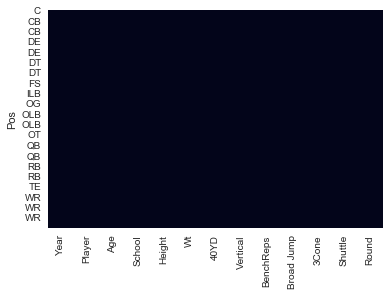

In [24]:
sns.heatmap(new_df.isnull(), cbar = False)

In [25]:
new_df.head()

,Year,Player,Age,School,Height,Wt,40YD,Vertical,BenchReps,Broad Jump,3Cone,Shuttle,Round
Pos,,,,,,,,,,,,,
C,2018,Sean Welsh,23.0,Iowa,6-3,306,5.430000,25.0000,20.00000,103.000000,7.90000,4.81000,8
C,2018,Coleman Shelton,22.0,Washington,6-3,292,5.240000,26.5000,23.64615,110.000000,7.62000,4.59000,8
C,2018,Frank Ragnow,21.0,Arkansas,6-5,312,5.319924,26.5097,26.00000,98.421912,7.86268,4.72272,1
C,2018,Scott Quessenberry,22.0,UCLA,6-4,310,5.090000,33.5000,25.00000,111.000000,7.50000,4.69000,5
C,2018,Billy Price,23.0,Ohio St.,6-4,305,5.319924,26.5097,23.64615,98.421912,7.86268,4.72272,1


In [26]:
# coerce height from string to int
split_lst = []
for i in range(len(new_df)):
    split_lst.append(new_df.iloc[i,4].split("-"))

ht_lst = []
for i in split_lst:
    ht_lst.append(12*int(i[0]) + int(i[1]))
new_df['Height'] = ht_lst

In [27]:
# create a column for position
new_df['Position'] = [new_df.index[i] for i in range(len(new_df))]

In [28]:
# reindex with normal numerical index column
new_df.reset_index(drop = True, inplace = True)

In [29]:
new_df.head()

,Year,Player,Age,School,Height,Wt,40YD,Vertical,BenchReps,Broad Jump,3Cone,Shuttle,Round,Position
0,2018,Sean Welsh,23.0,Iowa,75,306,5.430000,25.0000,20.00000,103.000000,7.90000,4.81000,8,C
1,2018,Coleman Shelton,22.0,Washington,75,292,5.240000,26.5000,23.64615,110.000000,7.62000,4.59000,8,C
2,2018,Frank Ragnow,21.0,Arkansas,77,312,5.319924,26.5097,26.00000,98.421912,7.86268,4.72272,1,C
3,2018,Scott Quessenberry,22.0,UCLA,76,310,5.090000,33.5000,25.00000,111.000000,7.50000,4.69000,5,C
4,2018,Billy Price,23.0,Ohio St.,76,305,5.319924,26.5097,23.64615,98.421912,7.86268,4.72272,1,C


In [30]:
# make round an int rather than a string
new_df['Round'] = [int(i) for i in new_df['Round']]

In [31]:
# created a coumn for drafted/undrafted
new_df['Drafted'] = [1 if i < 8 else 0 for i in new_df['Round']]

In [32]:
new_df.head()

,Year,Player,Age,School,Height,Wt,40YD,Vertical,BenchReps,Broad Jump,3Cone,Shuttle,Round,Position,Drafted
0,2018,Sean Welsh,23.0,Iowa,75,306,5.430000,25.0000,20.00000,103.000000,7.90000,4.81000,8,C,0
1,2018,Coleman Shelton,22.0,Washington,75,292,5.240000,26.5000,23.64615,110.000000,7.62000,4.59000,8,C,0
2,2018,Frank Ragnow,21.0,Arkansas,77,312,5.319924,26.5097,26.00000,98.421912,7.86268,4.72272,1,C,1
3,2018,Scott Quessenberry,22.0,UCLA,76,310,5.090000,33.5000,25.00000,111.000000,7.50000,4.69000,5,C,1
4,2018,Billy Price,23.0,Ohio St.,76,305,5.319924,26.5097,23.64615,98.421912,7.86268,4.72272,1,C,1


In [33]:
with open('new_df_orig.pkl', 'wb') as f:
    pickle.dump(new_df, f)
with open('pickled_tweets_dict.pkl', 'rb') as f:
    pickled_tweets_0 = pickle.load(f)
with open('new_df.pkl', 'rb') as f:
    new_df_1 = pickle.load(f)

In [34]:
new_df.head()

,Year,Player,Age,School,Height,Wt,40YD,Vertical,BenchReps,Broad Jump,3Cone,Shuttle,Round,Position,Drafted
0,2018,Sean Welsh,23.0,Iowa,75,306,5.430000,25.0000,20.00000,103.000000,7.90000,4.81000,8,C,0
1,2018,Coleman Shelton,22.0,Washington,75,292,5.240000,26.5000,23.64615,110.000000,7.62000,4.59000,8,C,0
2,2018,Frank Ragnow,21.0,Arkansas,77,312,5.319924,26.5097,26.00000,98.421912,7.86268,4.72272,1,C,1
3,2018,Scott Quessenberry,22.0,UCLA,76,310,5.090000,33.5000,25.00000,111.000000,7.50000,4.69000,5,C,1
4,2018,Billy Price,23.0,Ohio St.,76,305,5.319924,26.5097,23.64615,98.421912,7.86268,4.72272,1,C,1


In [35]:
new_df_1.head()

,Year,Player,Age,School,Height,Wt,40YD,Vertical,BenchReps,Broad Jump,3Cone,Shuttle,Round,Since,Until,search_name,stats
Pos,,,,,,,,,,,,,,,,,
C,2018,Sean Welsh,23.0,Iowa,6-3,306,5.430000,25.0000,20.00000,103.000000,7.90000,4.81000,8,2017-06-01,2018-04-20,sean welsh,NaN
C,2018,Coleman Shelton,22.0,Washington,6-3,292,5.240000,26.5000,23.64615,110.000000,7.62000,4.59000,8,2017-06-01,2018-04-20,coleman shelton,"[coleman shelton, {'g': '3', 'tackles_solo': '..."
C,2018,Frank Ragnow,21.0,Arkansas,6-5,312,5.319924,26.5097,26.00000,98.421912,7.86268,4.72272,1,2017-06-01,2018-04-20,frank ragnow,"[frank ragnow, {'g': '1', 'tackles_solo': '1',..."
C,2018,Scott Quessenberry,22.0,UCLA,6-4,310,5.090000,33.5000,25.00000,111.000000,7.50000,4.69000,5,2017-06-01,2018-04-20,scott quessenberry,"[scott quessenberry, {'g': '', 'tackles_solo':..."
C,2018,Billy Price,23.0,Ohio St.,6-4,305,5.319924,26.5097,23.64615,98.421912,7.86268,4.72272,1,2017-06-01,2018-04-20,billy price,"[billy price, {'g': '1', 'tackles_solo': '1', ..."


In [ ]:
year = new_df.loc[(new_df['Player'] == 'Sean Welsh'), 'Year'][0]
year-1

In [ ]:
to_be_searched = []
for i in new_df_1['Player']:
    if i not in unique_names:
        to_be_searched.append(i)
print(len(to_be_searched))
to_be_searched

In [ ]:
nest_asyncio.apply()
player_tweets_dict = {}
count = 0
for player in to_be_searched:
    year = new_df_1.loc[(new_df_1['Player'] == player), 'Year']
    search_term = " nfl draft"
    c = twint.Config()
    c.Pandas = True
    c.Search = player + search_term
    c.Since = "{}-06-01".format(year[0]-1)
    c.Until = "{}-04-20".format(year[0])
    c.Verified = True
    c.Limit = 100
    twint.run.Search(c)
    Tweets_df = twint.storage.panda.Tweets_df
    count += len(Tweets_df.index)
    player_tweets_dict[player] = Tweets_df
    Tweets_df = pd.DataFrame(data=None)
    #if count > 10000:
    #    time.sleep(15*60)
    #    count = 0
player_tweets_dict

In [ ]:
lens = [len(i[1]) for i in player_tweets_dict.items()]
lens
sns.distplot(lens)

In [ ]:
players_with_tweets = []
for i in player_tweets_dict.items():
    if len(i[1]) > 50:
        players_with_tweets.append((i[0],len(i[1])))
print(len(players_with_tweets))
players_with_tweets

In [ ]:
with open('pickled_tweets_2.pkl', 'wb') as f:
    pickle.dump(player_tweets_dict, f)

In [ ]:
with open('pickled_tweets_2.pkl', 'rb') as f:
    pickled_tweets_2 = pickle.load(f)

In [ ]:
players_with_tweets_1 = []
for i in pickled_tweets_0.items():
    if len(i[1]) > 50:
        players_with_tweets_1.append((i[0],len(i[1])))
players_with_tweets_1

In [ ]:
players_with_tweets_0 = players_with_tweets

In [ ]:
combined_names = players_with_tweets + players_with_tweets_0 + players_with_tweets_1

In [ ]:
combined_names = [i[0] for i in combined_names]
combined_names

In [ ]:
unique_names = list(set(combined_names))

In [ ]:
len(unique_names)

In [ ]:
len(combined_names)

In [ ]:
new_df_1

In [36]:
nest_asyncio.apply()
count = 0
haul = 0
successful = []
has_enough = []
while haul < 5000:
    
    to_be_searched = []
    for i in new_df_1['Player']:
        if i not in has_enough:
            to_be_searched.append(i)
            
    player_tweets_dict = {}
    
    for player in to_be_searched:
        
        year = new_df_1.loc[(new_df_1['Player'] == player), 'Year']
        search_term = " nfl draft"
        c = twint.Config()
        c.Pandas = True
        c.Search = player + search_term
        c.Since = "{}-06-01".format(year[0]-1)
        c.Until = "{}-04-20".format(year[0])
        c.Verified = True
        c.Limit = 100
        twint.run.Search(c)
        
        Tweets_df = twint.storage.panda.Tweets_df
        count += len(Tweets_df.index)
        player_tweets_dict[player] = Tweets_df
        if len(Tweets_df.index) > 50:
            print("success")
            haul += len(Tweets_df.index)
            successful.append(Tweets_df)
            has_enough.append(player)
            with open('pickled_tweets_{}.pkl'.format(player), 'wb') as f:
                pickle.dump(Tweets_df, f)
        Tweets_df = pd.DataFrame(data=None)
        
        if count > 3000:
            time.sleep(1000)
            count = 0


950414365244653573 2018-01-08 12:10:17 EDT <ScottDochterman> Projecting where Josh Jackson, James Daniels, Akrum Wadley, Josey Jewell, Sean Welsh and others could end up in the NFL draft #Hawkeyes  https://www.landof10.com/iowa/early-projections-iowas-nfl-draft-prospects?utm_campaign=SF_Landof10_Iowa&utm_source=Twitter&utm_medium=Social …
930889791079452672 2017-11-15 15:06:35 EDT <710ESPNSeattle> Huskies center Coleman Shelton could be a late-round NFL Draft pick, or he could be a valuable undrafted free agent. @ClaytonESPN looks at his prospects.  http://mynw.me/2iXj55D 
986987987006304261 2018-04-19 11:20:48 EDT <TheFalconsWire> 2018 NFL Draft: Frank Ragnow meets with Falcons and Patriots  https://usat.ly/2qL5Ngq 
982287111649943552 2018-04-06 12:01:12 EDT <PFF_College> Frank Ragnow is the forgotten superstar in the 2018 NFL Draft (via @PFF_Sam)   https://buff.ly/2IyvB6K  pic.twitter.com/RDcclvDvPX
981581170990288896 2018-04-04 13:16:02 EDT <PFF> Frank Ragnow, the forgotten supersta

954796331859619841 2018-01-20 14:22:39 EDT <DraftCountdown> Initial 2018 NFL Draft C Rankings:  http://www.draftcountdown.com/nfl-draft-ranking/2018-center-rankings/ …  This is a stellar group!  Starting with 1st Rounder Billy Price then James Daniels, Mason Cole, etc.  Great year to get a pivot.
954018501504782336 2018-01-18 10:51:50 EDT <TommySledge> Here are some recent NFL MOCK DRAFT selections for YOUR Dallas Cowboys :  CBS SPORTS -- James Washington, WR, Oklahoma State WALTER FOOTBALL -- Billy Price, C/G, Ohio State MEL KIPER -- Vita Vea, DT, Washington PRO FOOTBALL FOCUS -- Michael Gallup, WR, Colorado State
954012652572946432 2018-01-18 10:28:35 EDT <rmginn> Mel Kiper's mock NFL draft has Denzel Ward at No. 9 to San Francisco, Sam Hubbard at No. 20 to Detroit and Billy Price at No. 24 to Carolina   http://www.espn.com/nfl/draft2018/insider/story/_/id/22134110 …
949086926216290304 2018-01-04 20:15:31 EDT <Dan_Hope> Billy Price and Jamarco Jones will be training with another form

968585491456102401 2018-02-27 15:35:51 EDT <hawkcentral> NFL Combine: What do Josh Jackson, James Daniels, Josey Jewell and Iowa's other #NFLDraft hopefuls need to show this week in Indy? #Hawkeyes http://dmreg.co/2EYM07f 
968221671583776768 2018-02-26 15:30:09 EDT <MarkEmmert> On a teleconference today, the NFL Network's Mike Mayock called Josh Jackson 'the most intriguing cornerback in the draft.' His 40 time will be the key to where he gets drafted, but certainly a first-round prospect. Also said James Daniels could be a late first-round pick
956751456006168579 2018-01-25 23:51:37 EDT <TheNFLWire> James Daniels NFL draft profile  https://usat.ly/2rIXLrW 
956751450700316672 2018-01-25 23:51:36 EDT <TheDraftWire> James Daniels NFL draft profile  https://usat.ly/2rIXLrW 
954796331859619841 2018-01-20 14:22:39 EDT <DraftCountdown> Initial 2018 NFL Draft C Rankings:  http://www.draftcountdown.com/nfl-draft-ranking/2018-center-rankings/ …  This is a stellar group!  Starting with 1st Round

979348604396687360 2018-03-29 09:24:37 EDT <mwenzel2> Mel Kiper sees Michigan State's Brian Allen picked in final three rounds of NFL draft  http://www.mlive.com/spartans/index.ssf/2018/03/mel_kiper_sees_michigan_states.html#incart_river_index …
979142117258752000 2018-03-28 19:44:06 EDT <MLive> Mel Kiper sees Michigan State's Brian Allen picked in final three rounds of NFL draft  http://bit.ly/2J3UN64 
978791534245154816 2018-03-27 20:31:01 EDT <PFF_College> MSU C Brian Allen had the fifth-highest grade among all 2018 NFL Draft centers a season ago  pic.twitter.com/jEJyEKWFG0
978255092422987778 2018-03-26 08:59:23 EDT <mwenzel2> Brian Allen's NFL draft plan is 'expect the worst and hope for the best'  http://www.mlive.com/spartans/index.ssf/2018/03/brian_allens_nfl_draft_plan_is.html#incart_river_index …
978251129199919104 2018-03-26 08:43:38 EDT <MLive> Brian Allen's NFL draft plan is 'expect the worst and hope for the best'  http://bit.ly/2pH0qyg 
977526696088764417 2018-03-24 08:45

709711013776596992 2016-03-15 08:01:06 EDT <Connor_J_Hughes> 2016 NFL Draft prospect profile: USC C Max Tuerk  http://wp.me/p76x19-1BXn  via @thejetswire
706269870296535040 2016-03-05 19:07:13 EDT <NFLMocks> OL Max Tuerk: 2016 NFL Draft Scouting Report  http://nflmocks.com/2016/03/05/max-tuerk-ol-usc-2016-nfl-draft-scouting-report/ …
689854967868325888 2016-01-20 12:00:15 EDT <ReignofTroy> ICYMI: Su'a Cravens and Max Tuerk are among the Top 100 prospects for the 2016 NFL draft. #USC  http://reignoftroy.com/2016/01/19/sua-cravens-max-tuerk-ranked-among-top-draft-prospects/ …
689524284528590848 2016-01-19 14:06:14 EDT <ReignofTroy> Su'a Cravens and Max Tuerk ranked among the top NFL Draft prospects for 2016 #USC  http://reignoftroy.com/2016/01/19/sua-cravens-max-tuerk-ranked-among-top-draft-prospects/ …
689172683309727745 2016-01-18 14:49:06 EDT <NFLSpinZone> Cincinnati Bengals 2016 NFL Draft: Max Tuerk at 24?  http://dlvr.it/DJrn9T  pic.twitter.com/5JlDV8Y1x7
667052179459567617 2015-11-

722387285002440704 2016-04-19 07:32:04 EDT <Anthony_Becht> My Top 5 G/C for the #NFLDraft 1) Cody Whitehair KST 2) Joshua Garnett STAN 3) Vadal Alexander LSU 4) Ryan Kelly ALA 5) Graham Glasgow MICH
720628766490419200 2016-04-14 11:04:21 EDT <Anthony_Becht> My Top 5 G/C for the #NFLDraft: 1) Cody Whitehair KST 2) Joshua Garnett STAN 3) Vadal Alexander LSU 4) Ryan Kelly ALA 5) Graham Glasgow MICH
712756929018331138 2016-03-23 17:44:28 EDT <NBCSBears> NFL Draft Profile: Michigan OL Graham Glasgow -  http://ift.tt/1UlDeB6  #BearsTalk
712744110608752640 2016-03-23 16:53:32 EDT <NBCSChicago> 2016 #NFLDraft Profile: Michigan (@umichfootball) OL Graham Glasgow  http://cmcst.sn/WX8  #BearsTalk pic.twitter.com/Ei26D4CPYv
711362855795367936 2016-03-19 21:24:55 EDT <jakelourim> ICYMI, yesterday's story on Graham Glasgow, NFL Draft prep and Call of Duty:  http://bit.ly/1XB9LR0 
710940925560811520 2016-03-18 17:28:19 EDT <jakelourim> If you need Graham Glasgow on NFL Draft Day, he'll be playing Cal

561315510814388224 2015-01-30 19:10:21 EDT <GMENHQ> 2015 NFL Draft Profile: Cameron Erving, Florida State @FanSided  http://gmenhq.com/2015/01/17/2015-nfl-draft-profile-cameron-erving-florida-state/ … #CameronErving #FloridaState #FanSided
559080723169427456 2015-01-24 15:10:06 EDT <GMENHQ> 2015 NFL Draft Profile: Cameron Erving, Florida State @FanSided  http://gmenhq.com/2015/01/17/2015-nfl-draft-profile-cameron-erving-florida-state/ … #CameronErving #NFLDraft #FanSided
558340835671281664 2015-01-22 14:10:03 EDT <GMENHQ> 2015 NFL Draft Profile: Cameron Erving, Florida State @FanSided  http://gmenhq.com/2015/01/17/2015-nfl-draft-profile-cameron-erving-florida-state/ … #Seminoles #NFLDraft #CameronErving
557955812501749760 2015-01-21 12:40:06 EDT <GMENHQ> 2015 NFL Draft Profile: Cameron Erving, Florida State @FanSided  http://gmenhq.com/2015/01/17/2015-nfl-draft-profile-cameron-erving-florida-state/ … #NFLDraft #NYGiants #CameronErving
557617453606641665 2015-01-20 14:15:35 EDT <GMENHQ>

456184980993871872 2014-04-15 17:39:09 EDT <WEEI> NFL Draft’s Potential Patriots: Florida State C Bryan Stork  http://dlvr.it/5Pp5y5 
432585265136144384 2014-02-09 13:42:18 EDT <BryanPerezNFL> *NEW* to FRG:  A look at Bryan Stork, Center, #FloridaSt:   http://firstroundgrade.com/2014/02/09/scouting-the-ocs-bryan-stork-florida-state/ … #NFLDraft #Seminoles #Centers
427947307674644480 2014-01-27 18:32:43 EDT <TDavenport_NFL> Draft Bryan Stork FSU RT @49erswebzone: What should 49ers do at center? #49ers [ESPN]  http://bit.ly/1cndNrR 
426471659311472640 2014-01-23 16:49:01 EDT <TDavenport_NFL> @sanfranniner Goodwin is a goner. Possibly draft a center like Bryan Stork from Florida St. Dawson should be back.
409639438092734464 2013-12-08 06:03:47 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Bryan Stork, C Florida State #FSU #Seminoles #Noles  http://withthefirstpick.com/?p=11288 
443464968542109696 2014-03-11 15:14:22 EDT <Midday180> Thanks to James Stone for joining us, and best o

450211522225008640 2014-03-30 06:02:46 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Corey Linsley, C #OhioState #Buckeyes #OSU  http://withthefirstpick.com/?p=11739 
455772563164000256 2014-04-14 14:20:21 EDT <Withthe1st_pick> NFL Draft Prospect Interview – Wesley Johnson, OT Vanderbilt  http://withthefirstpick.com/?p=11801 
452109933866004480 2014-04-04 11:46:22 EDT <TrainIsland> 2014 NFL Draft Capsules: Wesley Johnson, OL (EVERY POSITION)  http://sbn.to/1hczqhK 
452023767716208641 2014-04-04 06:03:59 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Wesley Johnson, OT #Vanderbilt #Vandy #AnchorDown  http://withthefirstpick.com/?p=11775 
356585429958524929 2013-07-14 21:26:06 EDT <BryanPerezNFL> Taking a look at some Wesley Johnson, OT, #Vanderbilt tonight.  A favorite of @Froginthewindow.  #NFLDraft
384104736401522688 2013-09-28 19:58:00 EDT <DraftCountdown> Oklahoma C Gabe Ikard really stepped up against Louis Nix.  Athletic zone-blocker in mix to be the top senior pi

242075761618583552 2012-09-01 21:45:33 EDT <StripeHype> 2013 Draft Profile: Barrett Jones  http://bit.ly/OCwM3N  #Tide #Bama #NFL
242067901073473536 2012-09-01 21:14:19 EDT <dpbrugler> #Alabama OL Barrett Jones and Chance Warmack might be the two best interior linemen in the country #NFLDraft
242041514056884224 2012-09-01 19:29:28 EDT <Dan_Hope> NFL draft prospects to watch for #Alabama tonight: OT/G Barrett Jones, G Chance Warmack, FS Robert Lester, CB Dee Milliner, ILB Nico Johnson
242035909728550913 2012-09-01 19:07:12 EDT <StripeHype> 2013 Draft Profile: Barrett Jones  http://bit.ly/OCwM3N  #NFL #Bengals
242032932271816704 2012-09-01 18:55:22 EDT <FanSidedNFL> 2013 Draft Profile: Barrett Jones  http://bit.ly/OCwM3N  #NFL #Bengals
235131669638705153 2012-08-13 17:52:13 EDT <MikeBacsik> Cowboys fans will learn who Barrett Jones is come NFL draft time. Center from Alabama is needed on Cowboys now!
234761381231091712 2012-08-12 17:20:49 EDT <RantSports> NFL Draft: Barrett Jones Scoutin

176388676077633537 2012-03-04 14:28:32 EDT <zachkruse2> New at  http://AllGBP.com : NFL Draft Prospect Profile: David Molk, C Michigan  http://bit.ly/xXSWuY 
173590333249167360 2012-02-25 21:08:55 EDT <NFLMocks> Wonder how fun it would have been to be in Michigan weight room with David Molk and Mike Martin. Workout warriors. #NFLDraft
160390872800821248 2012-01-20 10:58:58 EDT <stephenjnesbitt> RT @PDBuckeyes: According to Mel Kiper Jr., top 3 centers in NFL Draft from B1G: Wisc's Peter Konz, OSU's Mike Brewster, Mich's David Molk
160390679871238144 2012-01-20 10:58:12 EDT <DougLesmerises> According to ESPN's Mel Kiper Jr., top 3 centers in NFL Draft from Big Ten: Wisc's Peter Konz, Ohio State's Mike Brewster, Mich's David Molk
155027559439007745 2012-01-05 15:47:05 EDT <EricGalko> Top 5 #NFLDraft Interior OL: 1. David DeCastro 2. Peter Konz 3. Cordy Glenn 4. Kevin Zeitler 5. David Molk:  http://www.optimumscouting.com/rankings/static/og-rankings.html …
154374072531304449 2012-01-03 20

155361654694096896 2012-01-06 13:54:39 EDT <fswisconsin> Peter Konz may be a 1st round draft pick in the #NFL, leaving the WI Badgers a year early:  http://tinyurl.com/7zhckgu  Story by @JesseTemple
155353018466963456 2012-01-06 13:20:20 EDT <JoeGoodberry> #1 Center #2 Guard. RT "@NFLMocks: Multiple media outlets are reporting that #Wisconsin C Peter Konz is going to declare for 2012 #NFLDraft"
155352802472886272 2012-01-06 13:19:29 EDT <NFLMocks> Here are two sources saying #Wisconsin C Peter Konz is leaving early  http://bit.ly/zAmrSK  the #NFLDraft  http://bit.ly/xm0Syf 
155352193401229313 2012-01-06 13:17:03 EDT <NFLMocks> Multiple media outlets are reporting that #Wisconsin C Peter Konz is going to declare for the 2012 #NFLDraft
155340638320214017 2012-01-06 12:31:08 EDT <AndyBaggot> My apologies for misinterpreting a text earlier today regarding Peter Konz's plans. Good luck to him in the NFL draft.
155333689994252289 2012-01-06 12:03:32 EDT <PCBrettC> RT @PostCrescent: Report: B

52848743841660928 2011-03-29 17:44:57 EDT <Caricsportsmgt> An o-line coach in attendance at Zane Taylor's pro day today told me "He's strong as an ox! He definitely helped himself today." #NFLDraft
33964288242745344 2011-02-05 14:04:52 EDT <Caricsportsmgt> Tune into the CBS College Sports Network right now to see NFL Draft sleeper Zane Taylor dominate the NFLPA college all-star game!
41560873101295616 2011-02-26 13:10:58 EDT <NFLMocks> Fastest 40 time by an offensive lineman at the #NFLCombine was Cincy's Jason Kelce at 4.93, former LB #NFLDraft
20651709718069248 2010-12-30 20:25:25 EDT <Tommy_G> Just got some great #Bearcats football news...Jason Kelce (@Jkelce) received an invite to the NFL Draft Combine today
53622925617668096 2011-03-31 21:01:16 EDT <NinersNation> 2011 NFL Draft, 50 in 50: Rodney Hudson - G - Florida State - (21 of 50)  http://sbn.to/gUFM8g
52329477153374208 2011-03-28 07:21:34 EDT <TurfShowTimes> 2011 NFL Draft: OG Rodney Hudson receiving first round consideration

992760849 2008-11-05 22:33:17 EDT <FullTimeFantasy> FFToolbox: Antoine Caldwell Scouting Report: 2009 NFL Draft Prospect - OL from Alabama  http://tinyurl.com/6xgjo2
1119350199258951682 2019-04-19 17:20:58 EDT <SaturdayBlitz> The first round of the #NFLDraft doesn't feature many small school guys. Rock Ya-Sin is out to prove he's the exception.    https://saturdayblitz.com/2019/04/19/nfl-draft-temples-rock-ya-sin-continues-climb-ladder/ …
1118975248760803328 2019-04-18 16:31:03 EDT <theMMQB> 2019 NFL Draft DB Rankings: Greedy Williams, Byron Murphy and Rock Ya-Sin lead our ranking of the top 75 defensive backs in the 2019 draft  http://go.si.com/y0Soo96 
1116436255049420800 2019-04-11 16:22:00 EDT <KevinBoilard> The Five Best Names in the 2019 NFL Draft:  1. Rock Ya-Sin 2. Hamp Cheevers 3. Jazz Ferguson 4, JoJo McIntosh 5. Lil'Jordan Humphrey
1112810294592516096 2019-04-01 16:13:43 EDT <Rotoworld_Draft> .@markrlindquist unveils his All-Underrated team for the NFL Draft, including:  🏈 T

1079099243879641088 2018-12-29 14:38:03 EDT <Tennessean> Vanderbilt football: Joejuan Williams leaving early for NFL Draft  http://rssfeeds.tennessean.com/~/589706128/0/nashville/home~Vanderbilt-football-Joejuan-Williams-leaving-early-for-NFL-Draft/ …
1079094230281342978 2018-12-29 14:18:07 EDT <AdamSparks> Vanderbilt cornerback Joejuan Williams leaving early for NFL Draft.  https://www.tennessean.com/story/sports/college/vanderbilt/2018/12/29/vanderbilt-football-joejuan-williams-nfl-draft/2440282002/ … via @tennessean
1079087653222535168 2018-12-29 13:51:59 EDT <MrChadBishop> Joejuan Williams announces intention to enter the 2019 NFL Draft  http://bit.ly/2QUstdT 
1079085243632701441 2018-12-29 13:42:25 EDT <dpbrugler> #Vanderbilt CB Joejuan Williams announced he will enter the NFL Draft.   Bottom of the screen, Williams is unrefined but his size/athleticism projects him in the top-60 picks. Scheme specific press-man CB.  pic.twitter.com/E8A2PBueVh
1079079380322799617 2018-12-29 13:19:

1102766289766903809 2019-03-04 22:02:26 EDT <ringer> Greedy Williams made his case for being the first defensive back off the board, but Deandre Baker is not far behind. #NFLCombine #NFLDraft @Danny_Heifetz: https://www.theringer.com/nfl/2019/3/4/18250758/combine-day-6-takeaways-greedy-williams-deandre-baker-rich-eisen-40-yard …
1102674528918880256 2019-03-04 15:57:49 EDT <NFLMedia> 2nd episode of Destination Nashville is now available, following top prospects Rashan Gary, Greedy Williams & A.J. Brown as they prepare for the 2019 NFL Draft  http://www.nfl.com/nflnetwork/main/network/features/destination-nashville …
1102608781597392898 2019-03-04 11:36:33 EDT <NFLDraft> Greedy Williams cuts #NFLCombine workout short due to cramps.   http://on.nfl.com/NjVhEY  pic.twitter.com/uWR1fxZNxb
1102599053764784129 2019-03-04 10:57:54 EDT <NFLDraft> Top official 40 times for cornerbacks at #NFLCombine:  1. Jamel Dean, @AuburnFootball, 4.30 t2. Mark Fields, @ClemsonFB, 4.37 t2. Greedy Williams, @LS

1081199751541018624 2019-01-04 09:44:43 EDT <sportingnews> The first five picks of our 2019 NFL Mock Draft:  1. Cardinals: Nick Bosa, DE, Ohio State 2. 49ers: Quinnen Williams, DT, Alabama 3. Jets: Jonah Williams, OT, Alabama 4. Raiders: Josh Allen, DE/OLB, Kentucky 5. Bucs: Greedy Williams, CB, LSU
1079772924255633410 2018-12-31 11:15:01 EDT <azcsports> Cornerback Greedy Williams’ decision to skip the PlayStation Fiesta Bowl after declaring for the #NFLdraft will leave #LSU without a player many expect to be a top-10 selection come April. https://www.azcentral.com/story/sports/college/2018/12/30/fiesta-bowl-alexander-lsu-secondary-put-test-ucf-offense/2445008002/ …
1078447905701224448 2018-12-27 19:29:51 EDT <SBNation> Our 2019 NFL mock draft:  1. Nick Bosa - Cardinals @revengeofbirds  2. Josh Allen - Raiders @SilverBlakPride  3. Greedy Williams - 49ers @NinersNation  4. Jonah Williams - Jets @GangGreenNation  5. Quinnen Williams - Lions @PrideOfDetroit  Picks 6-32 ⬇️ https://www.sbna

1118663179691798528 2019-04-17 19:51:00 EDT <Dan_Hope> After working out for representatives from 27 NFL teams at Ohio State last week, Kendall Sheffield garnering interest from multiple teams in the final week of pre-draft visits ahead of next week's NFL draft.  https://twitter.com/MMehtaNYDN/status/1118661259891752960 …
1115744946609213440 2019-04-09 18:34:59 EDT <Dan_Hope> Nick Bosa is the only Ohio State player who will be attending the 2019 NFL draft.   Dwayne Haskins, Parris Campbell, Terry McLaurin, Dre'Mont Jones, Mike Weber, Michael Jordan, Isaiah Prince, Kendall Sheffield, Johnnie Dixon among Buckeyes who will hope to receive calls at home.  https://twitter.com/NFLDraft/status/1115744002266021894 …
1111679299453480960 2019-03-29 13:19:33 EDT <Tradition> NFL Draft expert says Ohio State DB Kendall Sheffield is a ‘massive faller’  http://dlvr.it/R1pM1w 
1108113883334615041 2019-03-19 17:11:52 EDT <Dan_Hope> 14 2019 NFL draft prospects from Ohio State attending Wednesday's pro d

1117242443903262721 2019-04-13 21:45:30 EDT <dpbrugler> Sign of the times: Looking over my top-80 safety prospects in this draft class and only one is 215+ pounds - and that is Jamal Peters (218 lbs), who was a college corner I'm projecting to safety in the NFL.  Size is great, speed is better.
1061355304577888256 2018-11-10 15:29:58 EDT <JimNagy_SB> .@HailStateFB CB #2 Jamal Peters (@JamalPeters21) missed a bunch of games this year with injuries but he’s one of the most interesting press-man corners in this year’s draft.  Tall, well-built 217-lber with eventual NFL starter tools.  Was No. 1 overall player in MS out of HS.  pic.twitter.com/5Ri3aYNj5R
1015702582403231753 2018-07-07 17:02:21 EDT <MikeWFerguson> Jamal Reynolds had large shoes to fill at #FSU, being given No. 58 after Peter Boulware. He proceeded to have an All-American career and get selected in the top 10 of the 2001 NFL Draft. He also record three sacks in a #Noles national title victory over Virginia Tech. #NoleNation 

1119232900090691584 2019-04-19 09:34:52 EDT <SaturdayBlitz> There are only a few premier corners in the 2019 #NFLDraft. Byron Murphy is the best of the best. #PurpleReign  https://saturdayblitz.com/2019/04/18/2019-nfl-draft-byron-murphy-case-drafts-top-cornerback/ …
1118975248760803328 2019-04-18 16:31:03 EDT <theMMQB> 2019 NFL Draft DB Rankings: Greedy Williams, Byron Murphy and Rock Ya-Sin lead our ranking of the top 75 defensive backs in the 2019 draft  http://go.si.com/y0Soo96 
1118964800346836992 2019-04-18 15:49:32 EDT <TheAthleticKC> Just one week until the NFL Draft! Chiefs film analyst @RealMNchiefsfan continues his look at options the team reportedly is considering, this time breaking down the skill sets of cornerbacks Greedy Williams (LSU) and Byron Murphy (Washington):  https://theathletic.com/932502/2019/04/18/know-your-chiefs-draft-crush-evaluating-cornerbacks-greedy-williams-and-byron-murphy/ …
1118771142834044929 2019-04-18 03:00:00 EDT <FantasyLabs> 2019 NFL Draft: Wil

1082364532905906178 2019-01-07 14:53:08 EDT <TheDraftWire> Washington CB Byron Murphy to enter 2019 NFL draft  https://wp.me/p72adI-2wWT 
1082362740596006914 2019-01-07 14:46:01 EDT <SeaTimesSports> Byron Murphy is the second Huskies DB to declare early for the NFL draft — and he may not be the last  https://st.news/2TxrFII 
1082355409283887105 2019-01-07 14:16:53 EDT <OregonianSports> Washington Huskies CB Byron Murphy declares for 2019 NFL draft  https://trib.al/borLP0E  pic.twitter.com/a9rmaJRAZA
1082353966703247360 2019-01-07 14:11:09 EDT <CoachCarson> Washington CB Byron Murphy declares for NFL draft  http://dlvr.it/Qw96dK  pic.twitter.com/Ll0OxIclrw
1082353695801729024 2019-01-07 14:10:04 EDT <KIRO7Seattle> UW cornerback Byron Murphy declares for 2019 NFL Draft  https://www.kiro7.com/news/local/uw-cornerback-byron-murphy-declares-for-2019-nfl-draft/900563967 …
1082342038236999680 2019-01-07 13:23:45 EDT <JoeHealey42> Updated #Pac12 #NFLDraft Early Entry List:  JJ Arcega-Whiteside

1030532975283318785 2018-08-17 15:13:02 EDT <MattWaldman> RSP’s @D1gono on 2019 NFL Draft Prospect Trayvon Mullen’s FBI    https://buff.ly/2MGqvaM  pic.twitter.com/4H6sPhdWH2
1029915157680533504 2018-08-15 22:18:03 EDT <MattWaldman> RSP’s @D1gono on 2019 NFL Draft Prospect Trayvon Mullen’s FBI    https://buff.ly/2MGqvaM  pic.twitter.com/8t8vBUJmde
1029727674506334209 2018-08-15 09:53:03 EDT <MattWaldman> RSP’s @D1gono on 2019 NFL Draft Prospect Trayvon Mullen’s FBI    https://buff.ly/2MGqvaM  pic.twitter.com/vxRPlYij9z
1029428701270880257 2018-08-14 14:05:02 EDT <MattWaldman> RSP’s @D1gono on 2019 NFL Draft Prospect Trayvon Mullen’s FBI    https://buff.ly/2MGqvaM  pic.twitter.com/wTrpfnU49i
1029158670683316224 2018-08-13 20:12:02 EDT <MattWaldman> RSP’s @D1gono on 2019 NFL Draft Prospect Trayvon Mullen’s FBI    https://buff.ly/2MGqvaM  pic.twitter.com/WiUY0vF1JM
1029002895210041344 2018-08-13 09:53:02 EDT <MattWaldman> RSP’s @D1gono on 2019 NFL Draft Prospect Trayvon Mullen’s FBI    ht

1080550805898436608 2019-01-02 14:46:02 EDT <971theticketxyt> Michigan's David Long To Enter #NFL Draft, Zach Gentry Reportedly Joining Him  https://971theticket.radio.com/articles/michigans-david-long-enter-nfl-draft-zach-gentry-reportedly-joining-him …
1080548797003059201 2019-01-02 14:38:03 EDT <freep> Michigan football CB David Long declares for the NFL draft  http://rssfeeds.freep.com/~/590246168/0/freep/home~Michigan-football-CB-David-Long-declares-for-the-NFL-draft/ …
1080547205738647555 2019-01-02 14:31:44 EDT <nickbaumgardner> Michigan cornerback David Long has declared for the NFL Draft  https://www.freep.com/story/sports/college/university-michigan/wolverines/2019/01/02/michigan-football-cb-david-long-declares-nfl-draft/2465083002/ …
1080543128531148802 2019-01-02 14:15:32 EDT <BriceMarich> With the news of David Long heading to the NFL Draft, there are several guys I'll be looking to see fill that void for #Michigan - Ambry Thomas, Myles Sims, Gemon/German Green, Benjamin S

1075890395349954560 2018-12-20 18:07:13 EDT <mwenzel2> After practice tonight, MSU players were supportive of Justin Layne’s decision to sit out the Redbox Bowl before the NFL draft.
1075865927005007876 2018-12-20 16:30:00 EDT <FOX47News> . @michiganstateu cornerback Justin Layne will miss the @RedboxBowl game against  @uoregon after declaring his intention to leave for the @NFL draft #NFLDraft  http://bit.ly/2ECkOdC 
1075473348979777538 2018-12-19 14:30:02 EDT <mwenzel2> Michigan State’s Justin Layne left program before NFL draft, won’t play in Redbox Bowl  https://www.mlive.com/sports/2018/12/michigan-states-justin-layne-left-program-before-nfl-draft-wont-play-in-redbox-bowl.html …
1075472056676990977 2018-12-19 14:24:54 EDT <freepsports> You won't see Justin Layne playing for @MSU_Football against Oregon in the Redbox Bowl as he prepares for the NFL draft.   http://bit.ly/2PNHZ64 
1075471874442838018 2018-12-19 14:24:10 EDT <LSJGreenWhite> Cornerback Justin Layne has left Michigan S

1118523621847240705 2019-04-17 10:36:27 EDT <MikeKlis> Broncos recently visited with TCU outside linebacker Ben Banogu and Houston DB Isaiah Johnson, per sources. Banogu and Johnson are projected 3rd rounders per NFL Draft Bible. Banogu had 8.5 sacks each of past 2 years. Johnson a 6-2/4.4 CB. He was a WR his first 2 years. #9sports
1103315374651699204 2019-03-06 10:24:18 EDT <McClain_on_NFL> .@AaronWilson_NFL How UH's Isaiah Johnson made himself a rising NFL draft prospect  https://www.houstonchronicle.com/sports/texas-sports-nation/texans/article/How-UH-s-Isaiah-Johnson-made-himself-a-rising-NFL-13665628.php?utm_campaign=CMS%20Sharing%20Tools%20(Premium)&utm_source=t.co&utm_medium=referral …
1103104085191024640 2019-03-05 20:24:43 EDT <ReidLaymance> How UH's Isaiah Johnson made himself a rising NFL draft prospect  https://www.houstonchronicle.com/sports/texas-sports-nation/texans/article/How-UH-s-Isaiah-Johnson-made-himself-a-rising-NFL-13665628.php?utm_campaign=CMS%20Sharing%20Tools

1079017946956120066 2018-12-29 09:15:00 EDT <JoshVitale> ICYMI late last night | Cornerback Jamel Dean declared for the 2019 NFL Draft a year early, and even though Auburn has some depth behind him, that's a big loss.  Now, the attention turns to the other Tigers players who are considering the same decision:  https://www.montgomeryadvertiser.com/story/sports/college/auburn/2018/12/29/auburn-football-jamel-dean-cornerback-declare-nfl-draft-prince-tega-marlon-davidson-derrick-brown/2438915002/ …
1078901744845930496 2018-12-29 01:33:15 EDT <JFergusonAU> I just got back to Auburn, and I see that Jamel Dean wasted no time in declaring for the 2019 NFL Draft.  Few players have the mix of size and speed that Dean has. It’s impressive to see how well he’s bounced back from several injuries. He has a chance to be great in the league.  pic.twitter.com/wG3CH5l9sL
1078892786668187648 2018-12-29 00:57:39 EDT <JoshVitale> Auburn cornerback Jamel Dean will forgo his senior season and enter the 2019 

1118942267773820928 2019-04-18 14:20:00 EDT <Rivals> #NFLDraft: Top Available CBs Where does #UGA's Deandre Baker ranking on the @Rivals cornerback #NFLDraft2019 board. @adamgorney, @rivalsmike list the top 5:  http://rvls.co/CB0418  pic.twitter.com/yhvcBk1lJM
1117798870229168128 2019-04-15 10:36:33 EDT <ZachGelb> Deandre Baker (@DreBaker1_) on @CBSSportsRadio talking @FootballUGA & his path to the @NFL draft.  https://omny.fm/shows/the-zach-gelb-show/4-15-19-the-zach-gelb-show-deandre-baker-uga-cb-pr …
1117196538487427072 2019-04-13 18:43:05 EDT <Redskins> He's considered to be a first-round pick in the 2019 NFL Draft, with some analysts believing he'll end up with the #Redskins.  Full Prospect Profile on Georgia CB Deandre Baker:  https://redsk.in/2X4Tg5K  pic.twitter.com/Oygij8sdjE
1115961895545135104 2019-04-10 08:57:04 EDT <AJCsports> Former Bulldog Deandre Baker to attend NFL draft  https://www.ajc.com/sports/football/former-bulldog-baker-attend-nfl-draft/Cq8OdI0k7ZlbPNvI0N7mlJ/ 

1093023415269617664 2019-02-06 00:47:44 EDT <MoveTheSticks> Went back and watched UGA/OU Rose Bowl. Fun to watch Hollywood Brown vs Deandre Baker. Brown is so explosive!! #NFLDraft  https://www.instagram.com/p/Bth3W9ABufs/?utm_source=ig_twitter_share&igshid=1ivjvtj7rhq13 …
1091656523292520450 2019-02-02 06:16:11 EDT <PFF> There are several cornerbacks who are 'step-in right away' kind of guys – Deandre Baker, Greedy Williams, Byron Murphy – @PFF_Mike & @PFF_Steve talk about the potential first 5 picks in the 2019 NFL Draft:  https://www.youtube.com/watch?v=NMwCtwVNB8E&t=174s … pic.twitter.com/pfiDtPGbGO
1089716154027991041 2019-01-27 21:45:51 EDT <HipHopNation> #InNews @liltunechi Signs NFL Draft Prospect Deandre Baker To Young Money Sports - HipHopDX  https://hiphopdx.com/news/id.50063/title.lil-wayne-signs-nfl-draft-prospect-deandre-baker-to-young-money-sports … via @GoogleNews
1089347546525270016 2019-01-26 21:21:08 EDT <yourCheriseAmor> Lil Wayne Signs NFL Draft Prospect Deandre Ba

success
1102560572120408064 2019-03-04 08:24:59 EDT <EdwardsCBS> There is not a cornerback in this 2019 NFL Draft class that has shut down conversation on being the best. Big opportunity for #Kentucky's Lonnie Johnson and others to make in an impression today in the final day of the Combine. Darius West, Derrick Baity also getting in work.
1085565307798867969 2019-01-16 10:51:52 EDT <BigOShow> One helluva play @Shrine_Game as  @UKFootball DB Derrick Baity Jr makes a nice play. #BallSkillz #NFLDraft @NFL #NFL Brought to you by @1210TheMan. pic.twitter.com/PJmNGbjm2B
1057675720904859648 2018-10-31 12:48:37 EDT <Ryan_McCrystal> Derrick Baity isn’t getting nearly enough NFL draft hype  https://twitter.com/CFBFilmRoom/status/1057674812061937664 …
1046198303048839170 2018-09-29 20:41:27 EDT <JonHale_CJ> Hell of an interception by Derrick Baity, who is getting NFL draft buzz after strong start to his season.
1113599012907683841 2019-04-03 20:27:49 EDT <RutgersOnBTN> Hear from Saquan Hampton a

977202559743033346 2018-03-23 11:17:00 EDT <BCSNsports> Denzel Ward will likely be the first Buckeye to be chosen in next month’s draft. 👀    See how the Buckeyes impressed NFL scouts during OSU Pro Day!  pic.twitter.com/FmJDFRFu55
976627708204548097 2018-03-21 21:12:45 EDT <lombardiave> What could CB Denzel Ward bring to the #Packers defense? A closer look at the 2018 NFL Draft prospect  https://lombardiave.com/2018/03/21/packers-draft-scouting-report-denzel-ward/ …
976574942991888384 2018-03-21 17:43:04 EDT <BleacherReport> Meet the undisputed top cornerback in 2018 NFL Draft: Denzel Ward 🔥  pic.twitter.com/tWWZx1u7hi
976433309248049153 2018-03-21 08:20:16 EDT <NFLDraft> Denzel Ward (@Flash_Ward12) looks to solidify status as 2018 NFL Draft's top CB at @OhioStateFB pro day.   http://on.nfl.com/hE0EFf  (via @TheNickShook) pic.twitter.com/ngnTF6GCgB
975752215766949890 2018-03-19 11:13:51 EDT <TheAthleticCFB> .@FB_FilmAnalysis breaks down cornerbacks Denzel Ward (Ohio State) and Jaire A

946937353591033856 2017-12-29 21:53:52 EDT <mitchsherman> Considering that Denzel Ward declared for the NFL draft five minutes before kickoff, maybe it would behoove Sam Darnold to do the same at halftime.
946929621609594881 2017-12-29 21:23:09 EDT <Enquirer> Ohio State corner, likely high NFL draft pick Denzel Ward sits out Cotton Bowl  http://dlvr.it/Q88fjv  pic.twitter.com/dN4ogDy6qH
946929101436276736 2017-12-29 21:21:05 EDT <lopezgovlaw> #News via #ESPN Ohio State: CB Denzel Ward skips Cotton Bowl after declaring for NFL Draft (ESPN) |  http://ift.tt/17RC98x  pic.twitter.com/v9ml8OIpmo
946926912965836800 2017-12-29 21:12:23 EDT <fox28columbus> Star #OhioState defensive back Denzel Ward sitting out the #CottonBowl and will forego his senior season to enter the #NFLDraft. Projected by many as a 1st round pick.  https://twitter.com/claywsyx6/status/946926435519918080 …
946926912911368194 2017-12-29 21:12:23 EDT <wsyx6> Star #OhioState defensive back Denzel Ward sitting out the #Cotto

984791469851643904 2018-04-13 09:52:37 EDT <RosterWatch> The following #NFLDraft DB prospects were measured by @ZebraSports with sustained max speeds of over 21 mph during @SeniorBowl week:   CB MJ Stewart 21.44 mph S Trayvon Henderson 21.1 mph CB Isaac Yiadom 21.08 mph CB Chandon Sullivan 21.01 mph CB Jamarcus King 21 mph  pic.twitter.com/lixaebITB2
946193068461498368 2017-12-27 20:36:21 EDT <SBJLizMullen> Georgia State CB Chandon Sullivan @showtimesully10 has signed with @CseFootball agents & brothers Michael & Jason Katz for the NFL Draft.
982295367625539584 2018-04-06 12:34:00 EDT <NFLSpinZone> #Jets don’t just need stars, but also need solid depth throughout the roster. Greg Stroman could be an #NFLDraft target to do just that  https://nflspinzone.com/2018/04/06/new-york-jets-2018-nfl-draft-target-greg-stroman/ …
972147759968129024 2018-03-09 11:31:02 EDT <PFF_College> Lowest catch rate allowed by 2018 NFL Draft CBs?   Greg Stroman, oh course.  pic.twitter.com/cjf6MN225q
956287752

937056338219339776 2017-12-02 15:30:15 EDT <DPostSports> #CUBuffs cornerback Isaiah Oliver to forego senior season for NFL draft  http://dpo.st/2kfRiBy  by @kylefredrickson
937008577029558274 2017-12-02 12:20:28 EDT <KevinOnCFB> Colorado corner Isaiah Oliver declares for NFL draft #collegefootball  https://wp.me/p14QTT-1DGG 
937008572139036672 2017-12-02 12:20:27 EDT <CFTalk> Colorado corner Isaiah Oliver declares for NFL draft #collegefootball  https://wp.me/p14QTT-1DGG 
936825061637365761 2017-12-02 00:11:14 EDT <prooney07> Reaction story from @BrianHowell33 on Isaiah Oliver decision to enter NFL draft. Tough loss for #CUBuffs but not unexpected:   http://www.buffzone.com/football-cubuffs/ci_31492490/cu-buffs-cb-isaiah-oliver-declares-nfl-draft …
936802126197436417 2017-12-01 22:40:06 EDT <PFF_College> Back in August - our very own @PFF_Steve pegged Colorado CB Isaiah Oliver as a breakout candidate this season:  https://buff.ly/2AA4Xdc   Flash forward to December, and after a great 2

947439971882876928 2017-12-31 07:11:06 EDT <WiStateJournal> Nick Nelson to enter NFL draft, Beau Benzschawel to stay at Wisconsin for senior season  http://host.madison.com/wsj/sports/college/football/badgers-football-nick-nelson-to-enter-nfl-draft-beau-benzschawel/article_60fe1e89-4268-5503-843a-a94df0903a3d.html?utm_source=dlvr.it&utm_medium=twitter&utm_campaign=wisconsin%20state%20journal …
947390077121978368 2017-12-31 03:52:50 EDT <WiStateJournal> Badgers football: Nick Nelson announces decision to enter NFL Draft, Beau Benzschawel plans to stay at Wisconsin for senior season  http://host.madison.com/wsj/sports/college/football/badgers-football-nick-nelson-announces-decision-to-enter-nfl-draft/article_60fe1e89-4268-5503-843a-a94df0903a3d.html?utm_source=dlvr.it&utm_medium=twitter&utm_campaign=wisconsin%20state%20journal … pic.twitter.com/YUUhasKzbP
947355159373295616 2017-12-31 01:34:05 EDT <juz44> Badgers football: Nick Nelson announces decision to enter NFL Draft, Beau Benzschaw

894240929040695296 2017-08-06 12:57:06 EDT <NFLDraft> Nos. 16-25 in our #CFBTop25 countdown  16. Tarvarus McFadden, @FSU_Football 17. Bradley Chubb, @PackFootball 18-25:  http://on.nfl.com/Kp1sPA  pic.twitter.com/7yrZMsuXXv
887852611914711041 2017-07-19 21:52:12 EDT <FanSidedNFL> 2018 NFL #Draft preview: Tarvarus McFadden  http://dlvr.it/PWx7Xc  via @titan_sized pic.twitter.com/GBtb9iPx9b
887761709103955968 2017-07-19 15:50:59 EDT <FanSidedNFL> 2018 NFL #Draft preview: Tarvarus McFadden  http://dlvr.it/PWsf1c  via @titan_sized pic.twitter.com/OTW9lZUPsz
887714935186305025 2017-07-19 12:45:08 EDT <NFLDraft> Top 10 CBs to watch  1. Anthony Averett, @AlabamaFTBL 2. Tarvarus McFadden, @FSU_Football 3-10:  http://on.nfl.com/n0h1F1  (via @LanceZierlein) pic.twitter.com/uUq41mTR7V
885582621031444480 2017-07-13 15:32:04 EDT <NFLDraft> Has the skills to become an elite @NFL CB.  @MoveTheSticks scouts @FSU_Football's Tarvarus McFadden:  http://on.nfl.com/gmPBtR  #FirstLook pic.twitter.com/7IWp3D

961983405519986688 2018-02-09 10:21:31 EDT <DarrylSlater> NFL Draft 2018: Could Iowa's Josh Jackson be an option for Jets? | Scouting report |  http://NJ.com  via @Connor_J_Hughes  http://www.nj.com/jets/index.ssf/2018/02/could_josh_jackson_be_option_for_jets_in_nfl_draft.html#incart_river_mobile_index …
961249263798775808 2018-02-07 09:44:18 EDT <TheRaidersWire> #Raiders 2018 NFL Draft Profile: CB Josh Jackson  https://usat.ly/2Ep9W2h  #RaiderNation
961249119913181185 2018-02-07 09:43:43 EDT <WillReeveJr> #Raiders 2018 NFL Draft Profile: CB Josh Jackson  https://usat.ly/2Ep9W2h  via @theraiderswire #RaiderNation
961001206607949827 2018-02-06 17:18:36 EDT <hawkcentral> 2018 NFL mock draft 2.0: Latest @usatodaysports outlook has Iowa #Hawkeyes ball-hawk Josh Jackson teaming up with Richard Sherman.  http://dmreg.co/2FUGYEr 
954057300456693765 2018-01-18 13:26:00 EDT <ZachHanley2> In his first NFL mock draft, Mel Kiper has #Hawkeye Josh Jackson going 15th overall to the Cardinals  pic.tw

948597544917127169 2018-01-03 11:50:53 EDT <BlairRIVALS> Iowa cornerback Josh Jackson declares for the NFL Draft  https://twitter.com/IM_TEXAS_TRILL/status/948597367892213763 …
948597237139034112 2018-01-03 11:49:40 EDT <langetime> Here it is. Josh Jackson’s official announcement that he will declare for the NFL Draft. Via his Instagram account.  pic.twitter.com/GzlH6VM7a1
948597225646673920 2018-01-03 11:49:37 EDT <MurphyKeith> As expected, Josh Jackson entering NFL draft. Here’s his Instagram post:  pic.twitter.com/pPPeXtQISK
948596191243227136 2018-01-03 11:45:30 EDT <BigTenNetwork> Just in: @HawkeyeFootball star CB Josh Jackson announces he will enter the 2018 NFL Draft.  https://www.instagram.com/p/BdfnwginoCU/ 
948595262468997120 2018-01-03 11:41:49 EDT <BruceFeldmanCFB> Rangy #Iowa CB Josh Jackson is leaving early to enter the NFL draft. He was one of the best defensive players I saw this season.
946470955169263616 2017-12-28 15:00:34 EDT <sportingnews> Josh Jackson picked up hi

954747207965700096 2018-01-20 11:07:27 EDT <RamblinFan> 2018 NFL Mock Draft: Los Angeles Rams select Donte Jackson first round #LARams  https://ramblinfan.com/2018/01/20/nfl-mock-draft-2018-los-angeles-rams-select-donte-jackson-first-round/ … pic.twitter.com/Bj8PchV9g5
951529821137522690 2018-01-11 14:02:42 EDT <Sheadixon> #LSU's had six players leave early for the #NFLDraft.  Will Clapp - C Toby Weathersby - RT Derrius Guice - RB Arden Key - OLB Donte Jackson - CB Kevin Toliver II - CB  All eyes now on junior LG Garrett Brumfield.
951105876261310465 2018-01-10 09:58:06 EDT <RossDellenger> AM | #LSU lost a fourth underclassman (1-3 more to come) to the #NFLDraft Tuesday, as Donte Jackson speeds off to the league.  Said a draft analyst: "Teams are all about speed."   http://bit.ly/2CMezPT 
951042943162470401 2018-01-10 05:48:01 EDT <NOLAnews> LSU cornerback Donte Jackson declares for 2018 NFL Draft  https://trib.al/fA3G8pq 
950930274174619648 2018-01-09 22:20:19 EDT <KevinOnCFB> In Dont

950480418566033409 2018-01-08 16:32:45 EDT <KevinOnCFB> UCF CB and special teams returner Mike Hughes declares for NFL Draft  https://wp.me/p14QTT-1Edh 
950480414413606913 2018-01-08 16:32:44 EDT <CFTalk> UCF CB and special teams returner Mike Hughes declares for NFL Draft  https://wp.me/p14QTT-1Edh 
950454471838130176 2018-01-08 14:49:39 EDT <NFLDraft> UCF's Mike Hughes, a top CB prospect, declares for #NFLDraft.  Tracking underclassmen intentions for 2018:  http://on.nfl.com/gvFaRf  pic.twitter.com/VlCtY3xxjr
950441335479242752 2018-01-08 13:57:27 EDT <juanctoribio> Mike Hughes will enter the 2018 NFL Draft, forgoing his senior season at UCF:  https://247sports.com/college/central-florida/Bolt/UCF-Knights-defensive-back-Mike-Hughes-forgoes-senior-season-enters-NFL-Draft-113397083 …
950441272594128899 2018-01-08 13:57:12 EDT <Ry_Bass> UCF's Mike Hughes to forgo senior season, enter NFL Draft  https://247sports.com/college/central-florida/Bolt/UCF-Knights-defensive-back-Mike-Hughes-for

974369601680216064 2018-03-15 15:39:50 EDT <BrianMacWriter> Illinois State's Davontae Harris (@the24elite) talks to our Sam Herder (@TheHerd215) about his ascension to being considered a possible Day Two type of NFL Draft Pick for @RedbirdFB. https://twitter.com/TheHerd215/status/974357452526379009 …
970403938842259456 2018-03-04 16:01:42 EDT <NFLDraft> OFFICIAL bench press results for #NFLCombine DBs:  T1. Dane Cruikshank, AZ, 25 T1. Natrell Jamerson, WIS, 25 3. Davontae Harris, ILST, 22 T4. Derwin James, FSU, 21 T4. Kyzir White, WVU, 21 T4. Jordan Whitehead, PIT, 21 7. Mike Hughes, UCF, 20
976119273222320128 2018-03-20 11:32:24 EDT <sportingnews> "I hate Alabama."  As he gets ready for the NFL Draft, former Tennessee DB Rashaan Gaulden explains why he gave the finger to Crimson Tide fans.  http://bit.ly/2GN9J7U  pic.twitter.com/GXaG54S9N2
968262169031659520 2018-02-26 18:11:05 EDT <memphissports> NFL draft: John Kelly, Rashaan Gaulden project as Day 3 picks, analyst says  http://bit.

954119501464948737 2018-01-18 17:33:10 EDT <JamesCrepea> Where ESPN's Mel Kiper Jr. sees Auburn's Carlton Davis going in 1st round of NFL Draft  http://bit.ly/2DhCxCS  pic.twitter.com/MAf7ce6gwr
949279787381649408 2018-01-05 09:01:52 EDT <SECcountry> What Carlton Davis’ NFL draft decision means for Auburn’s cornerbacks in 2018. From @JFergusonAU  https://www.seccountry.com/auburn/auburn-football-carlton-davis-replacement-cornerbacks-2018 …
949077795640102912 2018-01-04 19:39:14 EDT <JFergusonAU> A lot of mixing and matching in store for the future: What Carlton Davis’ NFL draft decision means for Auburn’s cornerbacks in 2018  https://www.seccountry.com/auburn/auburn-football-carlton-davis-replacement-cornerbacks-2018 …
948901842523697152 2018-01-04 08:00:03 EDT <AUBlog> In case you missed the fireworks on Wednesday, Carlton Davis ( http://www.oanow.com/sports/college/auburn/football/auburn-corner-carlton-davis-enters-nfl-draft/article_112dd3d2-f0b4-11e7-a3ed-a3b3b98aa9e0.html …), Kamry

945478881812860928 2017-12-25 21:18:26 EDT <bmarcello> Auburn fans have been keeping their eyes on three defensive players who could enter NFL Draft early: Carlton Davis, Jeff Holland and Dontavius Russell. One decided tonight he will return for his senior season.  https://auburn.247sports.com/Article/Auburn-Tigers-defensive-tackle-Dontavius-Russell-skipping-NFL-Draft-to-return-for-senior-season-112740093 …
success
986615638176264193 2018-04-18 10:41:13 EDT <Charlie_Potter> ESPN draft analyst Todd McShay, on a conference call, said Anthony Averett could sneak into the second round of the NFL Draft.  McShay has a first-round grade on Minkah Fitzpatrick, who he believes will be a perennial All-Pro, and a second-round grade on Ronnie Harrison.
978687430235697153 2018-03-27 13:37:21 EDT <DAonCBS> NFL Draft prospect & Alabama CB Anthony Averett tells me about the Clemson game: “I know a lot of people wouldn’t say revenge, but I definitely would say that.”  https://cbssports.radio.com/articl

944233288444628992 2017-12-22 10:48:53 EDT <aadelsonESPN> Jaire Alexander will enter the NFL draft and skip the TaxSlayer Bowl  http://www.espn.com/nfl/draft2018/story/_/id/21846429/louisville-cardinals-cb-jaire-alexander-declares-draft-play-taxslayer-bowl …
944233085561966594 2017-12-22 10:48:05 EDT <lopezgovlaw> #News via #ESPN Louisville CB Jaire Alexander enters NFL draft, won't play in TaxSlayer Bowl (ESPN) |  http://ift.tt/17RC98x  pic.twitter.com/jfB2TT7sPT
944232403152891904 2017-12-22 10:45:22 EDT <NFLDraft> Louisville CB Jaire Alexander elects to skip bowl game, declare for #NFLDraft.  Tracking underclassmen intentions for 2018:  http://on.nfl.com/cxFOFk  pic.twitter.com/NS9ChKlOaT
944231079761780736 2017-12-22 10:40:07 EDT <courierjournal> Louisville football's Jaire Alexander declares for 2018 NFL draft, won't play in TaxSlayer Bowl  http://dlvr.it/Q7BNWb  pic.twitter.com/lQD3oETpu2
944230698923298818 2017-12-22 10:38:36 EDT <WDRBNews> U of L's defensive back Jaire Alexande

977361123765661696 2018-03-23 21:47:05 EDT <NFLMocks> Jordan Thomas, CB, Oklahoma: 2018 NFL Draft Scouting Report  http://dlvr.it/QMBKDR  pic.twitter.com/6DDGnAVw9f
984791469851643904 2018-04-13 09:52:37 EDT <RosterWatch> The following #NFLDraft DB prospects were measured by @ZebraSports with sustained max speeds of over 21 mph during @SeniorBowl week:   CB MJ Stewart 21.44 mph S Trayvon Henderson 21.1 mph CB Isaac Yiadom 21.08 mph CB Chandon Sullivan 21.01 mph CB Jamarcus King 21 mph  pic.twitter.com/lixaebITB2
986229086380068865 2018-04-17 09:05:12 EDT <mariovrossi> Really cool piece from @ChaseGoodbread on an NFL prospect underdog: University of Dubuque CB Michael Joseph. #NFLDraft  http://www.nfl.com/news/story/0ap3000000926141/article/cb-michael-joseph-is-drafts-most-improbable-and-inspiring-story …
985125592633929728 2018-04-14 08:00:18 EDT <TheFalcoholic> 2018 NFL Draft: Falcons plan workout for CB Michael Joseph  https://www.thefalcoholic.com/2018/4/14/17232566/2018-nfl-draft-a

852268963119546369 2017-04-12 17:15:29 EDT <TheEaglesWire> WATCH: #Eagles host Colorado CB Ahkello Witherspoon #NFLDraft  pic.twitter.com/Mr2rzHJ1fO
847457836648996864 2017-03-30 10:37:47 EDT <SFNinerNoise> Is Ahkello Witherspoon a decent cornerback option for the #49ers in the #NFLDraft?  http://ninernoise.com/2017/03/30/49ers-ahkello-witherspoon-day-2-option-nfl-draft/ …
840055403178295296 2017-03-09 23:23:10 EDT <TDavenport_NFL> Have to wait until the draft. I'd say Jalen Mills and Kevin King/Ahkello Witherspoon outside with Sidney Jones at slot.
854707782032908290 2017-04-19 10:46:29 EDT <nfldraftscout> 9 days until the NFL draft...  My No. 9 player overall is Florida CB Quincy Wilson. He's big,…  https://www.instagram.com/p/BTEh9iOBOU4/ 
854423549452443648 2017-04-18 15:57:03 EDT <MattLombardoNFL> Todd McShay: Marlon Humphrey is a first-rounder, behind Lattimore and Conley. Quincy Wilson could go late-first, early second. #NFLDraft
853279037015437312 2017-04-15 12:09:10 EDT <NBCSC

816402659662065664 2017-01-03 16:55:36 EDT <pinakk12> Looks official: #Gators CB Quincy Wilson declaring for NFL draft.  https://twitter.com/dc_wilson954/status/816402351401693184 …
815961120691339264 2017-01-02 11:41:05 EDT <NFLDraft> Top 10 prospects playing in Monday's bowls:  1. @GatorsFB CB Quincy Wilson 2. @BadgerFootball OT Ryan Ramczyk 3-10:  http://on.nfl.com/fbkryi  pic.twitter.com/iY3F73W350
815614198529064960 2017-01-01 12:42:32 EDT <LukeEasterling> Considering Quincy Wilson is my CB1 & Njoku is likely a top-50 lock, #Bucs fans would certainly love this miracle. #NFLDraft  https://twitter.com/deneshajason/status/815613242018066432 …
814259932983869440 2016-12-28 19:01:10 EDT <SECCountryUF> Still no formal decision, but Jalen Tabor and Quincy Wilson share some NFL Draft thoughts  http://sec.news/2hulmFE  #GatorNation pic.twitter.com/DBH3EEwOEp
813791951975829504 2016-12-27 12:01:35 EDT <SECCountryUF> Should Gators cornerback Quincy Wilson declare for the NFL draft?  http://s

852673623177527296 2017-04-13 20:03:28 EDT <newslouisiana> The Times Picayune - Leonard Fournette, Jamal Adams, Tre'Davious White to attend NFL Draft  http://ow.ly/hOVI50aPXsQ 
852658581778440193 2017-04-13 19:03:42 EDT <SaintsNews> Leonard Fournette, Jamal Adams, Tre’Davious White to attend NFL Draft ( http://NOLA.COM )  http://www.saintsnews.net/2017/04/13/leonard-fournette-jamal-adams-tredavious-white-to-attend-nfl-draft-nola-com/ …
852657926896574464 2017-04-13 19:01:06 EDT <e_saintsnet> Leonard Fournette, Jamal Adams, Tre'Davious White to attend NFL Draft  http://ow.ly/uxjc50aPUe4 
852653494439956480 2017-04-13 18:43:29 EDT <BillyEmbody> Ed Orgeron will join three #LSU Tigers in the green room at the #NFLDraft. Tre'Davious White, Jamal Adams and Leonard Fournette.  https://twitter.com/lukeeasterling/status/852645918402805760 …
852651351234498560 2017-04-13 18:34:58 EDT <JimKleinpeter> #LSU players Leonard Fournette, Jamal Adams, Tre'Davious White to attend #NFLDraft 1st round  htt

850155272144400384 2017-04-06 21:16:26 EDT <iam4lsu2> LSU CB Tre’Davious White says he is the best corner in NFL draft  http://fb.me/5AqUVoCiF 
850068189044256768 2017-04-06 15:30:24 EDT <EasyWorldNews> LSU CB Tre’Davious White says he is the best corner in NFL draft #digitalmarketing #news #today  http://janj.eu/n/127409  via @Easy_Branches pic.twitter.com/URs2eFuszI
850068180664012801 2017-04-06 15:30:22 EDT <Easy_Branches> LSU CB Tre’Davious White says he is the best corner in NFL draft #digitalmarketing #news #today  http://janj.eu/n/127409  via @Easy_Branches pic.twitter.com/XeKikENdek
850058639511629824 2017-04-06 14:52:27 EDT <PierceWHuff> Is Tre'Davious White @TreWhite16 the best cornerback in the NFL draft? He thinks so.  https://www.seccountry.com/lsu/lsu-tredavious-white-best-corner-nfl-draft?utm_campaign=SF_SECCountryLSU&utm_source=Twitter&utm_medium=Social …
850056488374718467 2017-04-06 14:43:54 EDT <SECCountryLSU> LSU CB Tre’Davious White says he is the best corner in NF

839926793947729920 2017-03-09 14:52:07 EDT <NFLMocks> Marquez White, CB, Florida State: 2017 NFL Draft Scouting Report  http://nflmocks.com/2017/03/08/marquez-white-cb-florida-state-2017-nfl-draft-scouting-report/ …
847517657633095682 2017-03-30 14:35:30 EDT <TheWolfpacker> Jack Tocho the #NFLDraft’s No. 19 CB per @PFF_College. #PackPros https://twitter.com/pff_college/status/847516529323397125 …
854726312518406144 2017-04-19 12:00:07 EDT <BloggingTheBoys> NFL Draft 2017 Profile: Cornerback Cordrea Tankersley (#Cowboys Pre-Draft Visits)  http://www.bloggingtheboys.com/2017/4/19/15322544/nfl-draft-2017-profile-cornerback-cordrea-tankersley-dallas-cowboys-official-pre-draft-visits?utm_campaign=bloggingtheboys&utm_content=chorus&utm_medium=social&utm_source=twitter …
854463454215680000 2017-04-18 18:35:37 EDT <SportsRadioKJR> .@RobRang focuses on Clemson CB Cordrea Tankersley in his latest #Seahawks NFL Draft preview with @IanFurnessSea! >>  http://sportsradiokjr.iheart.com/onair/the-ian-

820665125950681093 2017-01-15 11:13:07 EDT <NFLMocks> Teez Tabor, CB, Florida: NFL Draft Scouting Report  http://nflmocks.com/2017/01/15/teez-tabor-cb-florida-2017-nfl-draft-scouting-report/ …
818996550508695552 2017-01-10 20:42:48 EDT <BlueStarBlog> Scouting the NFL Draft: Florida CB Teez Tabor  http://on.nbcdfw.com/QbrHABc   pic.twitter.com/9mT7ZIEDaO
818829611828215808 2017-01-10 09:39:27 EDT <BlueStarBlog> Scouting the NFL Draft: Florida CB Teez Tabor  http://on.nbcdfw.com/zwDeo7q   pic.twitter.com/LA8lJf6sbA
817094570689249281 2017-01-05 14:45:01 EDT <10TampaBay> Florida CB Jalen "Teez" Tabor declares for NFL Draft. #Gators  http://on.wtsp.com/2j8Xh5m   pic.twitter.com/5P58MSZ7iX
817032887711232000 2017-01-05 10:39:54 EDT <BR_CFB> Florida DB Jalen "Teez" Tabor announced he's going to skip his final year of eligibility and enter the NFL draft  http://ble.ac/2iTYpdN   pic.twitter.com/kpEYUZ08ss
817025046908641280 2017-01-05 10:08:45 EDT <ChrisPorterFCN> Florida CB Jalen 'Teez' Tabor

834114548147712000 2017-02-21 13:56:20 EDT <JasonSmith929> Shoutout to Arthur Maulet (@APieceoF_Art), who's still working on getting his degree at Memphis this spring while he prepares for NFL Draft.
816714402376384515 2017-01-04 13:34:22 EDT <929espn> .@MemphisFB Standout Arthur Maulet LIVE now on 92.9FM talking with @JasonSmith929 & @JohnMartin929 about the NFL Draft 🏈  pic.twitter.com/wNwEmJAIlC
853638437840326656 2017-04-16 11:57:18 EDT <NBCSChicago> Get to know @UMichFootball cornerback Jourdan Lewis with our latest #NFLDraft Profile --  http://bit.ly/2oDuOu8  pic.twitter.com/b9vPJA42Mg
849610522395897858 2017-04-05 09:11:48 EDT <MattLombardoNFL> Everything you need to know about #Michigan CB Jourdan Lewis, who ESPN's @McShay13 projects to #Eagles. #NFLDraft  http://www.nj.com/eagles/index.ssf/2017/04/nfl_draft_2017_todd_mcshay_projects_jourdan_lewis.html#incart_river_mobileshort_index …
844239577166614530 2017-03-21 13:29:35 EDT <mikerothstein> Former #Michigan CB & #NFL draft pr

849606587908075521 2017-04-05 08:56:10 EDT <DarrylSlater> NFL Draft 2017: Should Dee Milliner fiasco steer Jets away from Marshon Lattimore? |  http://NJ.com  http://www.nj.com/jets/index.ssf/2017/04/nfl_draft_2017_should_dee_milliner_fiasco_steer_je.html#incart_river_mobileshort_index …
847511107153678336 2017-03-30 14:09:28 EDT <Browns> .@OhioStateFB's Marshon Lattimore makes his case as the best CB in the NFL Draft   Profiling the Prospects »  http://brow.nz/2mTjTNL  pic.twitter.com/azxxal1Cay
847140394588672001 2017-03-29 13:36:23 EDT <LukeEasterling> Solomon Thomas? Marshon Lattimore? Leonard Fournette?  #NFL #NFLDraft #KeepPounding #49ers #Panthers https://twitter.com/TheDraftWire/status/847140049724588035 …
845994309434445825 2017-03-26 09:42:15 EDT <TheJetPress> Marshon Lattimore should be primary draft target of the Jets  http://bit.ly/2npqo9p  #NewYorkJets #NFLDraft #MarshonLattimore pic.twitter.com/2Cqq45nzyP
844367004786184192 2017-03-21 21:55:56 EDT <schadjoe> NFL Draft: A

828007545717534721 2017-02-04 17:29:17 EDT <Connor_J_Hughes> NFL Mock Draft 2017: Another projection of Marshon Lattimore to #Jets  http://s.nj.com/gwQkoxd 
827859075794870272 2017-02-04 07:39:19 EDT <DarrylSlater> NFL Mock Draft 2017: Another projection of Marshon Lattimore to Jets |  http://NJ.com   http://www.nj.com/jets/index.ssf/2017/02/nfl_mock_draft_2017_another_projection_of_marshon.html#incart_river_mobileshort_index …
824728816467791872 2017-01-26 16:20:47 EDT <TheNFLWire> Buffalo Bills 2017 NFL draft targets: Ohio State CB Marshon Lattimore  http://wp.me/p7aERq-2kK 
824728812235747328 2017-01-26 16:20:46 EDT <RobQuinn619> Buffalo Bills 2017 NFL draft targets: Ohio State CB Marshon Lattimore  http://wp.me/p7aERq-2kK 
824728807907229696 2017-01-26 16:20:45 EDT <TheBillsWire> Buffalo Bills 2017 NFL draft targets: Ohio State CB Marshon Lattimore  http://wp.me/p7aERq-2kK 
822456106333118465 2017-01-20 09:49:50 EDT <DarrylSlater> NFL Mock Draft 2017: Ohio State's Marshon Lattimore

831241113121996801 2017-02-13 15:38:19 EDT <RobQuinn619> Bills 2017 NFL draft targets: Washington CB Kevin King scouting report  http://wp.me/p7aERq-2un 
831241108541886464 2017-02-13 15:38:18 EDT <TheBillsWire> Bills 2017 NFL draft targets: Washington CB Kevin King scouting report  http://wp.me/p7aERq-2un 
821180943381778449 2017-01-16 21:22:48 EDT <NFLMocks> @Spencer_NFL and @Russell_Brown51 select Kevin King for the #Seahawks  in the second round of the NFL Mocks staff mock draft
820307657005232131 2017-01-14 11:32:40 EDT <SBJLizMullen> U of Washington CB Kevin King signed with @aThreeAthletics for NFL draft. Agent Tommy Sims is repping him.  https://twitter.com/thefanaticsview/status/800317892688420864 …
820131102077632512 2017-01-13 23:51:06 EDT <dpbrugler> #Washington CB Kevin King has declined his Senior Bowl invite. Won't be in Mobile. #NFLDraft
852671182906298368 2017-04-13 19:53:46 EDT <CBSSportsRadio> We look ahead to the #NFLDraft as San Diego State Corner Damontae Kazee jo

839218829096026112 2017-03-07 15:58:55 EDT <LukeEasterling> Barnett, Baker, Melifonwu, Sidney Jones would all be fantastic picks. #Bucs #NFLDraft  https://twitter.com/MackB40/status/839218588544352258 …
838789454240296960 2017-03-06 11:32:44 EDT <TDavenport_NFL> Sidney Jones explains why he is the top CB in the draft | Eagles Wire  http://wp.me/p7aERO-2sp9  via @theeagleswire
838772077146447872 2017-03-06 10:23:41 EDT <NFLDraft> Official 40 times:  Adoree' Jackson: 4.42 Jamal Adams: 4.56 Sidney Jones: 4.47 Budda Baker: 4.45 Gareon Conley: 4.44  #NFLCombine
838760309011574786 2017-03-06 09:36:55 EDT <NFLDraft> .@UW_Football CB Sidney Jones 1st 40: 4.48u  #NFLCombine
838524459782967297 2017-03-05 17:59:44 EDT <TDavenport_NFL> The Eagles had a formal meeting with Sidney Jones. Is he the best CB in the draft?  http://wp.me/p7aERO-2sp9 
838022446691201024 2017-03-04 08:44:55 EDT <NFLDraft> DB #NFLCombine measurements:  Jamal Adams: 5-11 3/4, 214 Malik Hooker: 6-1, 206 Adoree' Jackson: 5-10,

success
854731375446036484 2017-04-19 12:20:14 EDT <usatodayhss> From high school ALL-USA to NFL Draft: Adoree' Jackson, USC  http://bit.ly/2oc6bSn  @amfam @AdoreeKnows
854017112704032768 2017-04-17 13:02:01 EDT <ReignofTroy> With the NFL Draft being next week, we kick off our #USC previews with a look at Adoree' Jackson's draft stock.  http://reignoftroy.com/2017/04/17/adoree-jackson-nfl-draft-preview-stock-mock-drafts-projections/ …
853819952515751936 2017-04-16 23:58:34 EDT <RamblinFan> Los Angeles Rams to Meet With USC CB Adoree’ Jackson #Rams #NFLDraft #LARams #MobSquad  http://ramblinfan.com/2017/04/16/los-angeles-rams-meet-usc-cb-adoree-jackson/ … pic.twitter.com/iMedTENVKP
853725543145107456 2017-04-16 17:43:25 EDT <NFLSpinZone> #Dolphins get playmaker in Adoree’ Jackson, but what else in our full 7-round 2017 #NFL Mock Draft? #FinsUp http://nflspinzone.com/2017/04/15/nfl-mock-draft-2017-seven-rounds-full-easter/ …
853640853688127489 2017-04-16 12:06:54 EDT <RiggosRag> Adoree J

821092607690506241 2017-01-16 15:31:47 EDT <DraftCountdown> USC CB Adoree’ Jackson, one of the final underclassmen mysteries, has declared for the 2017 NFL Draft.  Full List @  http://www.draftcountdown.com/2017-underclassmen/ …
821091440860098560 2017-01-16 15:27:09 EDT <latimessports> Adoree' Jackson declares for NFL draft, skipping his senior season at USC  http://lat.ms/2jY91Mz 
821090811530084352 2017-01-16 15:24:39 EDT <NFLMocks> Adoree' Jackson declares for the NFL Draft  http://nflmocks.com/2017/01/16/adoree-jackson-declares-nfl-draft/ …
821089770747019264 2017-01-16 15:20:31 EDT <ChrisNTrevino> Always one for excitement,#USC's Adoree’ Jackson takes choice down to the wire, declares for the NFL Draft (FREE):    http://usc.247sports.com/Article/Adoree-Jackson-to-enter-the-2017-NFL-Draft--50340721 … pic.twitter.com/9EvaYgBxE5
821089664807407616 2017-01-16 15:20:05 EDT <YahooSportsCFB> USC star Adoree' Jackson declares for the 2017 NFL draft.  https://yhoo.it/2jpxJEJ  pic.twitter.

845712765495001089 2017-03-25 15:03:30 EDT <Eric_Edholm> NFL draft profile: No. 33 — Alabama CB Marlon Humphrey  Has great traits but struggles to defend long ball at times   http://sports.yahoo.com/news/nfl-draft-profile-no-33-alabama-cb-marlon-humphrey-physical-with-downfield-concerns-190136387.html … pic.twitter.com/AjEjfy4f1c
844956921316737024 2017-03-23 13:00:03 EDT <TheJetPress> 2017 NFL Draft Profile: Cornerback Marlon Humphrey  http://bit.ly/2nbDjdv  #MarlonHumphrey #NFLDraft #Alabama pic.twitter.com/XIqhFErsdF
844900201571766273 2017-03-23 09:14:40 EDT <SaintsNOW> Leonard Fournette to Carolina; Saints grab LB Haason Reddick, CB Marlon Humphrey: Mel Kiper NFL mock draft 3.0  http://trib.al/1lb97oL  pic.twitter.com/aDlFz8cXAc
843822371467378689 2017-03-20 09:51:45 EDT <MattLombardoNFL> Everything you need to know about Marlon Humphrey, who visited #Eagles, could be in their Round 1 sights. #NFLDraft  http://www.nj.com/eagles/index.ssf/2017/03/nfl_draft_2017_why_alabama_cb_marlo

success
822904372489138176 2017-01-21 15:31:05 EDT <NFLDraft> .@Temple_FB CB Nate Hairston catches @MikeMayock's eye again with special-teams tackle. Hairston off to good start in #ShrineGame.
844553022005018624 2017-03-22 10:15:06 EDT <NFLDraft> A promise led Shaquill Griffin to @UCF_Football + now @NFL teams are taking notice of his potential   http://on.nfl.com/QVDOIa  (via @ConorOrr) pic.twitter.com/s9MhVxs5lp
838771528921554944 2017-03-06 10:21:30 EDT <NFLDraft> Top official 40 times for 1st group of DBs:  1. Shaquill Griffin, 4.38 2t. Marlon Humphrey, 4.41 2t. Josh Jones, 4.41  #NFLCombine
849400322003021825 2017-04-04 19:16:32 EDT <DAonCBS> Let's talk #NFLDraft with @MiamiHurricanes DB Corn Elder NEXT.  pic.twitter.com/6AlGiSbKJM
833794841259687938 2017-02-20 16:45:55 EDT <TBTimes_Sports> NFL Draft Q&A: Miami cornerback Corn Elder.  http://www.tampabay.com/blogs/bucs/nfl-draft-qa-miami-cornerback-corn-elder/2313855 … #Canes @CanesFootball #Miami @gregauman #NFLDraft  pic.twitter

838772077146447872 2017-03-06 10:23:41 EDT <NFLDraft> Official 40 times:  Adoree' Jackson: 4.42 Jamal Adams: 4.56 Sidney Jones: 4.47 Budda Baker: 4.45 Gareon Conley: 4.44  #NFLCombine
838762531933962240 2017-03-06 09:45:45 EDT <NFLDraft> .@OhioStateFB CB Gareon Conley 2nd 40: 4.48u. Ran 4.45u on 1st.  #NFLCombine
838755700759121920 2017-03-06 09:18:37 EDT <NFLDraft> Gareon Conley 1st 40: 4.45u  #NFLCombine
838519533598031872 2017-03-05 17:40:10 EDT <TheFalconsWire> ICYMI: A new mock draft has @OhioStateFB CB Gareon Conley going to the #Falcons in the first round:  http://thefalconswire.usatoday.com/2017/03/05/2017-nfl-mock-draft-ohio-state-cb-to-falcons-at-no-31/ … #NFLDraft
838405890743091201 2017-03-05 10:08:35 EDT <landof10> Will Gareon Conley give Ohio State three first-round picks in the 2017 NFL Draft?  http://sptz.us/2lsVVrL  pic.twitter.com/r2uCN83goJ
836586594316468225 2017-02-28 09:39:21 EDT <RamblinFan> 2017 NFL Draft: Could Los Angeles Rams Land Gareon Conley in Second Roun

803980095597740032 2016-11-30 10:12:46 EDT <TylerDBrooke> Here are 5 NFL draft prospects to watch during conference championships, including Colorado DB Chidobe Awuzie  http://saturdayblitz.com/2016/11/30/2017-nfl-draft-conference-championship-prospects/ …
803379231791185921 2016-11-28 18:25:09 EDT <LukeEasterling> Just the DBs, man.   Desmond King Chidobe Awuzie Justin Evans Tre'Davious White  #NFL #NFLDraft #CFB #SeniorBowl https://twitter.com/TheDraftWire/status/803371366762377216 …
802885581936218112 2016-11-27 09:43:34 EDT <LukeEasterling> Really looking forward to John Ross vs. Chidobe Awuzie. #Pac12Championship #NFLDraft
800083732367556610 2016-11-19 16:10:01 EDT <jonhumbert> And with the 29th pick of the 2017 NFL Draft, the Seattle Seahawks select...from Colorado...Chidobe Awuzie. #GoBuffs
771892925206847488 2016-09-02 22:09:49 EDT <JarrettBell> Watching at home. Hadn't heard of Chidobe Awuzie til 2nite. Dude, what a playmaker. Surely on map for next @nfl draft.
764148167591931

722492576394141697 2016-04-19 14:30:28 EDT <TheSteelersWire> #Steelers hosting NFL Draft prospect CB Brandon Williams from @AggieFootball.   READ:  http://usat.ly/1ThkGi1  pic.twitter.com/E3BQ0CAIAo
715551357672022016 2016-03-31 10:48:32 EDT <CoachSchuman> Brandon Williams, 6-5, 253, SIU, OLB/DE Highlights Film, Freak Ath 4.69 40 & 37 VJ 2016 NFL Draft  http://youtu.be/VMbTJXAFP8U?a 
714661098243366912 2016-03-28 23:50:58 EDT <CoachSchuman> BRANDON WILLIAMS OLB/DE, Southern Illinois 6-5, 253, NFL Draft Prospect Freak Athlete  https://youtu.be/9CzZRyt03EQ  via @YouTube @nfldraftbible
712818562365276160 2016-03-23 21:49:23 EDT <CoachSchuman> BRANDON WILLIAMS OLB/DE, Southern Illinois 6-5, 253, NFL Draft Prospect  4.69 40 ,37 vert,10-5 broad Pro...  http://youtu.be/9CzZRyt03EQ?a 
712818129475399680 2016-03-23 21:47:40 EDT <CoachSchuman> I added a video to a @YouTube playlist  http://youtu.be/9CzZRyt03EQ?a  BRANDON WILLIAMS OLB/DE, Southern Illinois 6-5, 253, NFL Draft Prospect
70436003205

718818463838531584 2016-04-09 11:10:51 EDT <LukeEasterling> Mayock has KeiVarae Russell as his No. 3 safety. #NFLDraft  pic.twitter.com/H7Di2DO7Un
717091432515956737 2016-04-04 16:48:15 EDT <BGInews> KeiVarae Russell confident as ever heading into NFL Draft.   Story via @BGI_JWells:  https://notredame.n.rivals.com/news/keivarae-russell-confident-as-ever-entering-nfl-draft … pic.twitter.com/7Dnw2RWMr1
715615307251867649 2016-03-31 15:02:39 EDT <Matt_Fortuna> The NFL draft process is about selling yourself. Enter #NotreDame's KeiVarae Russell, on playing all of 2015 hurt:  pic.twitter.com/gQlDeTqp4V
702184959818260483 2016-02-23 12:35:15 EDT <NFLMocks> KeiVarae Russell: 2016 NFL Draft Scouting Report  http://nflmocks.com/2016/02/23/keivarae-russell-cb-notre-dame-2016-nfl-draft-scouting-report/ …
690643998772297728 2016-01-22 16:15:35 EDT <nfldraftscout> Keivarae Russell is *IN* the 2016 draft class. He didn't have to declare, per the NFL.
684453585023705088 2016-01-05 14:17:05 EDT <NDFoo

722563336114675713 2016-04-19 19:11:38 EDT <BaltimoreWireFS> 'Baltimore Ravens Draft Prospect: Florida State DB Jalen Ramsey' via @JoeSerp #Ravens #NFLDraft #FloridaState  http://thebaltimorewire.com/2016/04/19/baltimore-ravens-draft-prospect-florida-state-db-jalen-ramsey/ …
722058421931913217 2016-04-18 09:45:17 EDT <Ebony_Bird> Ravens Draft: Jalen Ramsey V. Myles Jack  http://ebonybird.com/2016/04/18/ravens-draft-jalen-ramsey-v-myles-jack/ … #Ravens #RavensNation #NFLDraft
721809987324936192 2016-04-17 17:18:06 EDT <NFLSpinZone> #Cowboys: Jalen Ramsey; more defense in 2016 NFL Mock Draft  http://dlvr.it/L4qmnf  pic.twitter.com/qtWl2FKgkz
721103268785623042 2016-04-15 18:29:51 EDT <NBCSBears> NFL Draft Profile: Florida State DB Jalen Ramsey -  http://ift.tt/1NdUo0V  #BearsTalk
720707810842046464 2016-04-14 16:18:26 EDT <bycharlescurtis> A Q&A with Myles Jack, Jalen Ramsey on HoF comps, greeting Goodell and more:  http://ftw.usatoday.com/2016/04/nfl-draft-2016-myles-jack-jalen-ramsey …

714935276276203520 2016-03-29 18:00:27 EDT <dmn_cowboys> 👀 DB Jalen Ramsey, a potential Cowboys #NFLDraft pick, made quite the statement today:  http://d-news.co/103BG6  pic.twitter.com/NKPZvPpRJb
714935222115155969 2016-03-29 18:00:14 EDT <MBakerTBTimes> Should Jalen Ramsey be #NFLDraft No. 1 pick? | Tampa Bay Times #FSU #Titans http://www.tampabay.com/sports/football/bucs/should-jalen-ramsey-be-nfl-drafts-no-1-pick/2271184 …
714934831453351936 2016-03-29 17:58:41 EDT <TB_Times> Should Jalen Ramsey be NFL draft's No. 1 pick?  http://tbtim.es/yj9 
714931310620385280 2016-03-29 17:44:41 EDT <NBCSports> Jalen Ramsey: I want Titans to draft me because I'm the best player in this year's #NFLdraft  http://tw.nbcsports.com/cb1  pic.twitter.com/GJO2aJuqXP
714929948943900673 2016-03-29 17:39:17 EDT <joereedy> #FSU DB Jalen Ramsey makes his case on why he should be the top pick in the NFL Draft  http://collegefootball.ap.org/article/florida-states-ramsey-makes-case-top-pick-nfl-draft …
71492939

692032301790683137 2016-01-26 12:12:12 EDT <kylefredrickson> Per reports, #OKstate CB Kevin Peterson checked in at 5-foot-10 and 173 pounds at the Senior Bowl today. Not ideal for NFL Draft stock.
662106196153729024 2015-11-04 22:16:33 EDT <JonahTulsNFL> @LucPolglaze Kevin Peterson. No such thing as NFL Draft without a dose of KP. #fact
659019245993394176 2015-10-27 10:50:06 EDT <JonahTulsNFL> I'm on the Oklahoma State draft hype. Brandon Sheperd, Emmanuel Ogbah, Jimmy Bean, Kevin Peterson, & Jordan Sterns. All have a place in NFL.
658729544623362048 2015-10-26 15:38:56 EDT <JonahTulsNFL> ICYMI, my early scouting report on Kevin Peterson (@Pistol_Peterson) for the 2016 NFL Draft. One of my favs to watch  http://nflmocks.com/2015/08/04/kevin-peterson-cb-oklahoma-state-early-scouting-report/ …
657297156026437632 2015-10-22 16:47:08 EDT <JonahTulsNFL> NEW: Kevin Peterson vs Kansas State (2015)  http://draftbreakdown.com/video/kevin-peterson-vs-kansas-state-2015-2/ … via @draftbreakdown #N

722544008682217472 2016-04-19 17:54:50 EDT <DMooreNFL> The #Steelers need CB help for sure, but I don't see William Jackson III falling to 25. I see another corner being picked by them. #NFLDraft
720223541698793472 2016-04-13 08:14:08 EDT <WGNRadio> The #NFLDraft countdown continues....next on @AdamHoge's #BearsBigBoard: No. 12 CB William Jackson III  http://bit.ly/23u0t0B?utm_medium=social&utm_source=twitter_wgnradio …
718907935674527744 2016-04-09 17:06:23 EDT <pbpost> Houston corner William Jackson III speeding up NFL Draft lists  http://pbpo.st/1qf9TLv 
718884667945000960 2016-04-09 15:33:55 EDT <pbpsports> Houston corner William Jackson III speeding up NFL Draft lists  http://pbpo.st/1VHXcVt 
718204923758919680 2016-04-07 18:32:52 EDT <YahooSports> NFL draft profile: Houston CB William Jackson III is a true ballhawk  http://yhoo.it/1qwHSzw  pic.twitter.com/yeHBErs6rt
718175885904334849 2016-04-07 16:37:28 EDT <Eric_Edholm> NFL draft profile: Houston CB William Jackson III, a true 

673317486167740417 2015-12-05 20:46:12 EDT <MBakerTBTimes> Blog: #Gators DB Vernon Hargreaves III (Wharton High) says #NFLDraft is "probably" in his future.  http://www.tampabay.com/blogs/gators/vernon-hargreaves-iii-probably-the-nfl-in-his-future/2256653 …
673317068171776000 2015-12-05 20:44:33 EDT <ZachAbolverdi> Vernon Hargreaves III said he's declaring for NFL draft. Demarcus Robinson told me he isn't sure when or even if he'll make that decision.
673311413167869952 2015-12-05 20:22:05 EDT <osgators> Vernon Hargreaves III, 'I'll most likely declare for the NFL draft.'
672120731875037184 2015-12-02 13:30:44 EDT <NFLMocks> Vernon Hargreaves III, CB, Florida: 2016 NFL Draft Scouting Report  http://nflmocks.com/2015/12/02/vernon-hargreaves-iii-cb-florida-2016-nfl-draft-scouting-report/ …
651563431854665728 2015-10-06 21:03:22 EDT <JonahTulsNFL> Here is my scouting report on Vernon Hargreaves III out #Florida for the 2016 #NFLDraft 👍  http://nflmocks.com/2015/10/06/vernon-hargreaves-iii

676871799771009024 2015-12-15 16:09:47 EDT <CFBONFOX> Virginia Tech CB Kendall Fuller to forgo senior season and enter NFL Draft. Fuller missed most of 2015 season because of knee surgery.
676871773757923329 2015-12-15 16:09:41 EDT <WDBJ7Sports> Kendall Fuller to leave Virginia Tech and declare for NFL Draft:   Virginia Tech star cornerback Kendall Fulle...  http://bit.ly/1UvH8nr 
676870540229873667 2015-12-15 16:04:47 EDT <WDBJ7Sports> #BREAKING: @vt_football star Kendall Fuller to declare for NFL Draft. #Hokies  http://www.wdbj7.com/sports/college/kendall-fuller-leaving-virginia-tech-to-declare-for-nfl-draft/36977408?utm_medium=social&utm_source=twitter_WDBJ7Sports …
676870537788841984 2015-12-15 16:04:46 EDT <WDBJ7> #BREAKING: @vt_football star Kendall Fuller to declare for NFL Draft. #Hokies  http://www.wdbj7.com/sports/college/kendall-fuller-leaving-virginia-tech-to-declare-for-nfl-draft/36977408?utm_medium=social&utm_source=twitter_WDBJ7 …
676869258685493248 2015-12-15 15:59:41 E

704311316299784196 2016-02-29 09:24:37 EDT <NFLDraft> Taveze Calhoun of Mississippi State runs 4.61 (unofficial) 40 time on first attempt. #NFLCombine
658776264849776640 2015-10-26 18:44:35 EDT <JonahTulsNFL> Last draft take of the day: If I'm an NFL team, I experiment both Kendall Fuller and Taveze Calhoun at safety. Higher upside there than CB.
720041340684251136 2016-04-12 20:10:07 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: NC State CB Juston Burris  http://wp.me/p72adI-1Cew 
706857048416190464 2016-03-07 10:00:27 EDT <lombardiave> Green Bay Packers 2016 NFL Draft prospect: Interview with NC State cornerback Juston Burris  http://lombardiave.com/2016/03/07/green-bay-packers-2016-nfl-draft-interview-juston-burris/ …
704311012036575232 2016-02-29 09:23:25 EDT <NFLDraft> Juston Burris of NC State runs 4.54 (unofficial) 40 time on first attempt. #NFLCombine
722573817822998528 2016-04-19 19:53:17 EDT <pbpsports> 2016 NFL Draft: Mel Kiper Jr. still has Artie Burns in the first rou

681590077177380865 2015-12-28 16:38:32 EDT <InsideTheU> CB Artie Burns Declaring Early For NFL Draft  http://miami.247sports.com/Article/CB-Artie-Burns-Declaring-Early-For-NFL-Draft-42324570 …
681587257720094725 2015-12-28 16:27:20 EDT <sshapiro7> .@CanesFootball cornerback artie burns will skip senior season and enter the nfl draft
681583207003885569 2015-12-28 16:11:14 EDT <BruceFeldmanCFB> #Miami JR CB Artie Burns announces that he has elected to enter the NFL Draft. Had 6 INTs this year & should test very well in Indy.
681582717687992320 2015-12-28 16:09:17 EDT <KevinOnCFB> Miami announces junior CB Artie Burns will be declaring early for the #NFLDraft.
681582580001583104 2015-12-28 16:08:44 EDT <Rotoworld_Draft> Artie Burns declares for 2016 NFL Draft  http://tinyurl.com/h26pqur 
681582530542354432 2015-12-28 16:08:33 EDT <Jared_Shanker> Miami junior CB Artie Burns is entering the NFL draft
681582298232393728 2015-12-28 16:07:37 EDT <Brett_McMurphy> Miami junior CB Artie Burns for

707299531856203777 2016-03-08 15:18:44 EDT <TodderickHunt> Mel Kiper Jr. has N.J.'s Eli Apple going 14th overall in 2016 NFL Draft #NJFootball @HSSportsNJ  http://highschoolsports.nj.com/news/article/-4996640140916280482/mel-kiper-jr-has-njs-eli-apple-going-14th-overall-in-2016-nfl-draft/ …
705894918233858049 2016-03-04 18:17:18 EDT <kron4news> NFL coach asks draft prospect Eli Apple if he ‘liked men’  http://wp.me/p5hgGs-1lMf 
705848669183070209 2016-03-04 15:13:31 EDT <metronewyork> Eli Apple asked if he is gay by NFL coach during a draft interview  http://www.metro.us/new-york/eli-apple-asked-if-he-is-gay-by-falcons-coach-during-nfl-interview/zsJpcd---BQ0dpnvGsRM66/ … #nflmockdraft
705848669178871808 2016-03-04 15:13:31 EDT <MetroBOS> Eli Apple asked if he is gay by NFL coach during a draft interview  http://www.metro.us/new-york/eli-apple-asked-if-he-is-gay-by-falcons-coach-during-nfl-interview/zsJpcd---BQ0dpnvGsRM66/ … #nflmockdraft
705841417646641152 2016-03-04 14:44:42 EDT <Come

715541192532840450 2016-03-31 10:08:09 EDT <SportsSturm> 2016 NFL Draft Profile - Mackensie Alexander, CB, Clemson -  http://sportsday.dallasnews.com/dallas-cowboys/cowboys/2016/03/31/bob-sturms-nfl-draft-profile-series-clemsons-mackensie-alexander-size-issues-strong-game …
714088723743268864 2016-03-27 09:56:33 EDT <NFLSpinZone> 2016 NFL Draft Analytics: Mackensie Alexander  http://dlvr.it/KvDw8z  pic.twitter.com/8NBoKbiOmq
711682757173219329 2016-03-20 18:36:06 EDT <NFLSpinZone> #Panthers 7-Round 2016 NFL Mock Draft: Mackensie Alexander and a shutdown duo  http://dlvr.it/Kr8nN3  pic.twitter.com/bgyK9zDNf2
710876472412651521 2016-03-18 13:12:13 EDT <BlueStarBlog> Scouting the #NFLDraft: CB Mackensie Alexander, a physical film room junkie  http://on.nbcdfw.com/SPugw4g  pic.twitter.com/vCawDGfxeO
710694703671291904 2016-03-18 01:09:56 EDT <TheVikingAge> 2016 NFL Draft Profile: Mackensie Alexander, CB Clemson  http://bit.ly/1Vi6Q1c  #Vikings
710512903087116288 2016-03-17 13:07:31 EDT <Da

672480309246603264 2015-12-03 13:19:34 EDT <NFLMocks> Clemson CB Mackensie Alexander: 2016 NFL Draft Scouting Report  http://nflmocks.com/2015/12/03/clemson-cb-mackensie-alexander-2016-nfl-draft-scouting-report/ …
659085621135351809 2015-10-27 15:13:51 EDT <ByCoryMull> #Immokalee grad and #Clemson red. soph. CB Mackensie Alexander is projected as high as 12 in early #NFL mock drafts  http://www.cbssports.com/nfl/draft/mock-draft …
645023352566865920 2015-09-18 19:55:25 EDT <JonahTulsNFL> Gareon Conley and Mackensie Alexander as the top CB's in the 2017 NFL Draft? Sign me up.
success
711173199598321664 2016-03-19 08:51:18 EDT <FBallGameplan> NEW Talking w/@TDavenport_NFL Interview: #NFLDraft hopeful @AggieFootball CB De'Vante Harris  http://footballgameplan.com/talking-with-td-episode-24-cb-devante-harris-texas-am/ … pic.twitter.com/tcQjj5cqry
712067488196853761 2016-03-21 20:04:53 EDT <PROcast> Cornerback Deiondre’ Hall gives us a peek inside the classroom as he trains his mind for the

567409524639010816 2015-02-16 14:45:47 EDT <GMENHQ> 2015 NFL Draft Profile: CB P.J. Williams, FSU @GMenHQ  http://gmenhq.com/2015/02/16/2015-nfl-draft-profile-cb-p-j-williams-fsu/ … #PJWilliams #NYGiants #NYG #NFLDraft @greatmonkeysuit
567394396203917312 2015-02-16 13:45:40 EDT <GMENHQ> 2015 NFL Draft Profile: CB P.J. Williams, FSU @GMenHQ  http://gmenhq.com/2015/02/16/2015-nfl-draft-profile-cb-p-j-williams-fsu/ … #PJWilliams #NYGiants #NYG #NFLDraft @SportsTalkRT
567379329588670464 2015-02-16 12:45:48 EDT <GMENHQ> 2015 NFL Draft Profile: CB P.J. Williams, FSU @GMenHQ  http://gmenhq.com/2015/02/16/2015-nfl-draft-profile-cb-p-j-williams-fsu/ … #PJWilliams #NYGiants #NYG #NFLDraft @SportsArticleRT
567364066927448066 2015-02-16 11:45:09 EDT <GMENHQ> 2015 NFL Draft Profile: CB P.J. Williams, FSU @GMenHQ  http://gmenhq.com/2015/02/16/2015-nfl-draft-profile-cb-p-j-williams-fsu/ … #PJWilliams #NYGiants #NYG #NFLDraft @SportsBlogRT
567348958784393216 2015-02-16 10:45:07 EDT <GMENHQ> 2015 NFL D

success
589231784547713024 2015-04-17 20:59:39 EDT <NBCSBears> NFL Draft Profile: TCU CB Kevin White -  http://ift.tt/1cENEbb  #BearsTalk
588877137005780993 2015-04-16 21:30:24 EDT <JustBlogBaby> 2015 NFL Draft Player Comparison: Amari Cooper vs. Kevin White (from @nickhjeltness)  http://justblogbaby.com/2015/04/15/player-comparison-amari-cooper-vs-kevin-white/ …
588846976516677632 2015-04-16 19:30:34 EDT <GMENHQ> 2015 NFL Draft: Amari Cooper Vs. Kevin White  http://gmenhq.com/2015/04/09/2015-nfl-draft-amari-cooper-vs-kevin-white/ … #NFLDraft #KevinWhite #AmariCooper
588816719818444800 2015-04-16 17:30:20 EDT <GMENHQ> 2015 NFL Draft: New York Giants To Meet With Kevin White?  http://gmenhq.com/2015/04/10/2015-nfl-draft-new-york-giants-to-meet-with-kevin-white/ … #KevinWhite #NYGiants #NFLDraft
588689462412124160 2015-04-16 09:04:39 EDT <JordanRaanan> WR Kevin White stops by for a visit #giants #NFLDraft  http://www.nj.com/giants/index.ssf/2015/04/wide_receiver_kevin_white_has_pre-draft

586199903249899520 2015-04-09 12:12:02 EDT <MattHarmon_BYB> #ReceptionPerception: How Kevin White Began his Ascension to the Top  http://bitly.com/11Kw25m42  #NFLDraft  pic.twitter.com/SRieNnl4d9
586193161061543936 2015-04-09 11:45:15 EDT <GMENHQ> 2015 NFL Draft: Amari Cooper Vs. Kevin White  http://gmenhq.com/2015/04/09/2015-nfl-draft-amari-cooper-vs-kevin-white/ … #AmariCooper #KevinWhite #NFLDraft #FanSided
586186368042172416 2015-04-09 11:18:15 EDT <dmn_cowboys> 2015 NFL Draft Profile: Kevin White, WR, West Virginia  http://bit.ly/1Pog20f 
586181532487778304 2015-04-09 10:59:02 EDT <SportsSturm> 2015 NFL Draft Prospect #64 - Kevin White, WR, West Virginia -  http://cowboysblog.dallasnews.com/2015/04/2015-nfl-draft-profile-kevin-white-wr-west-virginia.html/ …
586178669707718657 2015-04-09 10:47:40 EDT <GMENHQ> 2015 NFL Draft: Amari Cooper Vs. Kevin White  http://gmenhq.com/2015/04/09/2015-nfl-draft-amari-cooper-vs-kevin-white/ … #AmariCooper #KevinWhite #NFLDraft #FanSided pic.twitt

576508904374427649 2015-03-13 18:23:28 EDT <rivalskeenan> #WVU WR Kevin White is rising on NFL Draft Boards but continues to focus on improvement in every area  http://rvls.co/1HSSuvD 
576471724864180224 2015-03-13 15:55:44 EDT <CraigMeyerPG> Kevin White said Larry Fitzgerald has been one of the people who has given him advice during the NFL draft process. Pitt-WVU bipartisanship!
576464692161474560 2015-03-13 15:27:47 EDT <CMAnderson247> #WVU's Kevin White says that he is the No. 1 WR in the @NFL Draft, and he's not afraid to prove it (FREE)...  http://bit.ly/1BBrJuL 
576440116727541760 2015-03-13 13:50:08 EDT <BairNBCS> NFL Draft Profile: West Virginia WR Kevin White, who had his pro day today:  http://www.csnbayarea.com/49ers/nfl-draft-profile-west-virginia-wr-kevin-white … #Raiders
576423491425021952 2015-03-13 12:44:04 EDT <CMAnderson247> #WVU's Kevin White Ready to Prove He is the Top WR in NFL Draft (FREE)...   http://bit.ly/1BBrJuL 
576130626996191232 2015-03-12 17:20:20 EDT <N

580098191976054784 2015-03-23 16:06:01 EDT <ByMikeWilson> Darqueze Dennard thinks Trae Waynes "sealed the deal" as the NFL Draft's cornerback with his pro day showing  http://michiganstate.scout.com/story/1530456-dennard-waynes-sealed-the-deal-at-pro-day?s=175 …
580015272716709888 2015-03-23 10:36:31 EDT <TheBadgerNation> 2015 Free NFL Scout Mock Draft 12.0. Trae Waynes to Minnesota at 11. @MelvinGordon25 to San Diego at 17  http://profootball.scout.com/story/1530306-2015-nfl-mock-draft-12-0#.VRAkoDQNrzw.twitter …
579698111355887616 2015-03-22 13:36:14 EDT <cmonarrez> Lions' NFL draft board: MSU CB Trae Waynes attractive, but he may be gone  http://on.freep.com/1Hi4J3U  via @freep
578336724046258176 2015-03-18 19:26:34 EDT <NFLDraft> Michigan State's Trae Waynes substantiates high draft stock at #proday -->  http://at.nfl.com/kogUcwv  pic.twitter.com/JXIvrsYwls
577830414196211713 2015-03-17 09:54:40 EDT <NFLDraft> Trae Waynes set to visit CB-needy NFC team. -->  http://bit.ly/1BtnxII  

587273063449755648 2015-04-12 11:16:23 EDT <JonahTulsNFL> I think Damian Swann can be a starting free safety in the NFL. #NFLDraft
584512653156024322 2015-04-04 20:27:30 EDT <NBCSBears> NFL Draft Profile: Towson CB Tye Smith -  http://ift.tt/1xPgTS4  #BearsTalk
583430721768792064 2015-04-01 20:48:18 EDT <BaltSunSports> Towson draft prospects Ryan Delaire, Tye Smith draw crowd of NFL scouts to Pro Day workout  http://bsun.md/1EHfCip 
563094061218004993 2015-02-04 16:57:40 EDT <fduffy3> 6 Small School players to watch? 1) Brandon Bridge 2) Tye Smith 3) Dezmin Lewis 4-6)  http://goo.gl/oZOWsl  #EaglesDraft #NFLDraft
561008560809590784 2015-01-29 22:50:38 EDT <NFLMocks> 2015 NFL Draft Prospect Tye Smith Ready to Earn Spot  http://nflmocks.com/2015/01/29/2015-nfl-draft-prospect-tye-smith-ready-earn-spot/ … @seanstellato @TyeSmithCB
586930600667283456 2015-04-11 12:35:34 EDT <JonahTulsNFL> D'Joun Smith has also helped himself with a good showing at his pro day and has moved up as well. #NFLD

587781118860070914 2015-04-13 20:55:13 EDT <Dan_Hope> ICYMI, you can listen to my interview with @GuntherandBen on Eric Rowe/Utah NFL draft prospects here:  http://stationcaster.com/stations/kfnz/media/mp3/Dan_Hope_with_Gunther_and_Ben-1428971352.mp3 …
587393086717845504 2015-04-12 19:13:19 EDT <Dan_Hope> ICYMI: My @BR_NFL feature on #Utah CB/S Eric Rowe, who has been busy with visits and workouts ahead of 2015 NFL Draft  http://bleacherreport.com/articles/2426733-utah-cornerback-eric-rowe-keeping-nfl-teams-interested-ahead-of-2015-draft …
587238819465793538 2015-04-12 09:00:19 EDT <Dan_Hope> New @BleacherReport: #Utah Cornerback Eric Rowe Keeping NFL Teams Interested Ahead of 2015 Draft  http://bleacherreport.com/articles/2426733-utah-cornerback-eric-rowe-keeping-nfl-teams-interested-ahead-of-2015-draft …
586414226056417281 2015-04-10 02:23:41 EDT <NBCSBears> NFL Draft Profile: Utah CB Eric Rowe -  http://ift.tt/1JuThn8  #BearsTalk
586401238268256259 2015-04-10 01:32:04 EDT <NBCSChica

565133168437919744 2015-02-10 08:00:21 EDT <mike_e_kaye> 2015 NFL Draft Profile: Miami (OH) defensive back Quinten Rollins  http://sbnation.com/e/7716582  pic.twitter.com/LyF8xv5rWS
563366534715047936 2015-02-05 11:00:23 EDT <PrideOfDetroit> 2015 NFL Draft profile: Quinten Rollins  http://sbnation.com/e/7739004  pic.twitter.com/xhdemDSPgr
562677601387675648 2015-02-03 13:22:48 EDT <NFLMocks> Miami (OH) CB Quinten Rollins NFL Draft Scouting Notebook  http://nflmocks.com/2015/02/03/miami-oh-cb-quinten-rollins-nfl-draft-scouting-notebook/ …
562657512885714944 2015-02-03 12:02:59 EDT <NFLFilmStudy> My latest: Miami (OH) Dual-Sport CB Quinten Rollins Is NFL Draft's Fastest Riser  http://bleacherreport.com/articles/2351912-miami-oh-dual-sport-cb-quinten-rollins-is-nfl-drafts-fastest-riser?utm_source=twitter.com&utm_medium=share&utm_campaign=web-des-art-top-2809 …
562508206732107777 2015-02-03 02:09:42 EDT <NFLFilmStudy> Miami (OH) Dual-Sport CB Quinten Rollins Is NFL Draft's Fastest Riser  h

571497698077118465 2015-02-27 21:30:43 EDT <GMENHQ> 2015 NFL Draft Profile: CB Marcus Peters, Washington  http://gmenhq.com/2015/02/18/2015-nfl-draft-profile-cb-marcus-peters-washington/ … #MarcusPeters #NFLDraft #Washington
569617708683284480 2015-02-22 17:00:19 EDT <GMENHQ> 2015 NFL Draft Profile: CB Marcus Peters, Washington  http://gmenhq.com/2015/02/18/2015-nfl-draft-profile-cb-marcus-peters-washington/ … #NFLDraft #MarcusPeters
569447850217766912 2015-02-22 05:45:21 EDT <NealCoolong> 2015 NFL Draft: Marcus Peters won't guarantee anything but owns up to his mistakes  http://sbnation.com/e/7848544  pic.twitter.com/TLK9JZoZSD
568560914099769344 2015-02-19 19:00:59 EDT <GMENHQ> 2015 NFL Draft Profile: CB Marcus Peters, Washington  http://gmenhq.com/2015/02/18/2015-nfl-draft-profile-cb-marcus-peters-washington/ … #Washington #MarcusPeters #NFLDraft
568168442286747648 2015-02-18 17:01:27 EDT <GMENHQ> 2015 NFL Draft Profile: CB Marcus Peters, Washington  http://gmenhq.com/2015/02/18/201

523624591994793984 2014-10-18 20:00:05 EDT <dpbrugler> Another NFL Draft story line to watch in #OREvsWASH: who is the best CB prospect on the field? Marcus Peters or Ifo Ekpre-Olomu?
523219603611058177 2014-10-17 17:10:49 EDT <thebiglead> 2015 NFL Draft Watch: Washington's Marcus Peters and Shaq Thompson in the 1st Round?  http://wp.me/p3LRnW-1JcQ 
523196564383100928 2014-10-17 15:39:16 EDT <NFLMocks> Marcus Peters: Washington CB 2015 NFL Draft Scouting Report  http://nflmocks.com/?p=41696 
success
585287690804977664 2015-04-06 23:47:14 EDT <NBCSBears> NFL Draft Profile: Clemson CB Garry Peters -  http://ift.tt/1NPHz7b  #BearsTalk
569856960570507265 2015-02-23 08:51:01 EDT <Mandrallius> For #Clemson's Garry Peters, NFL draft hopes can hinge on "The 40"  http://grnol.co/1ExAftJ  via @greenvillenews
589199304474042368 2015-04-17 18:50:35 EDT <agalaviz_TheBee> #NFLDraft hopeful --- @COSAthletics Steven Nelson, #OregonState
588143104072536066 2015-04-14 20:53:37 EDT <AronYohannes> NFL Dra

568467763544457216 2015-02-19 12:50:51 EDT <NFLDraft> Nick Marshall will throw at combine to satisfy teams interested in him as emergency QB.  http://bit.ly/1EXGDdp  pic.twitter.com/h1V0081itX
567804089988558848 2015-02-17 16:53:39 EDT <theMMQB> Could former @AuburnTigers QB Nick Marshall end up playing cornerback for the @Ravens or @steelers? #NFLDraft  http://wp.me/p3Dw81-ayc 
567463997394649089 2015-02-16 18:22:14 EDT <NFLDraft> Mike Mayock is intrigued by Nick Marshall's roll of the dice move to cornerback -->  http://at.nfl.com/3PV9Up2  pic.twitter.com/PI23ry5qAO
563853162042253313 2015-02-06 19:14:04 EDT <Rotoworld_Draft> Nick Marshall listed as QB for NFL Combine  http://dlvr.it/8QvMHr 
563827224415981568 2015-02-06 17:31:00 EDT <NFLDraft> Nick Marshall surprised by position assignment at NFL combine.  -->  http://at.nfl.com/xRJJR50  pic.twitter.com/gSoeyaw94m
559715739922599936 2015-01-26 09:13:26 EDT <aldotcomSports> Nick Marshall deserves "a lot of credit" for making switch f

success
583620627371700224 2015-04-02 09:22:55 EDT <JonahTulsNFL> Steven Nelson. Senquez Golson. Lorenzo Doss. Craig Mager. #steals #NFLDraft
581309579079843840 2015-03-27 00:19:38 EDT <NBCSBears> NFL Draft Profile: Texas State CB Craig Mager -  http://ift.tt/19WOZt3  #BearsTalk
556114764280000512 2015-01-16 10:44:26 EDT <NFLDraft> Sources Tell Us: Scouts dish on Shrine Game prospects, including Texas St. CB Craig Mager. -->  http://bit.ly/1E7itNP  pic.twitter.com/3TEOFloHe9
589630919012700160 2015-04-18 23:25:40 EDT <hartfordcourant> Former UConn CB Byron Jones visits ESPN as he prepares for the NFL draft.  http://cour.at/1b9Bwhf  pic.twitter.com/83uwiffEVY
588472432417202176 2015-04-15 18:42:15 EDT <djdurkin> Byron Jones’ athleticism and position versatility make him an intriguing #NFLDraft defensive back prospect.  http://chicago.cbslocal.com/2015/04/15/durkins-prospect-watch-cb-byron-jones/ …
588424009571696640 2015-04-15 15:29:50 EDT <NESN> Byron Jones, Bud Dupree Among Best Athle

584019293542686720 2015-04-03 11:47:04 EDT <cpriceglobe> It Is What It Is >> NFL Draft’s Potential Patriots: Wake Forest CB Kevin Johnson  http://itiswhatitis.weei.com/sports/newengland/football/patriots/2015/04/03/nfl-drafts-potential-patriots-wake-forest-cb-kevin-johnson/ … via @WEEI
583994424662843392 2015-04-03 10:08:15 EDT <1037WEEIFM> NFL Draft’s Potential Patriots: Wake Forest CB Kevin Johnson  http://dlvr.it/9DtM9r 
583985567664189440 2015-04-03 09:33:03 EDT <WEEI> NFL Draft’s Potential Patriots: Wake Forest CB Kevin Johnson  http://dlvr.it/9DtM9r 
583770563463643136 2015-04-02 19:18:42 EDT <BrianFormica> ESPN's latest Big Board has Wake Forest's Kevin Johnson going 21st overall in the NFL Draft
583433950808449024 2015-04-01 21:01:08 EDT <GMENHQ> 2015 NFL Draft Profile: CB Kevin Johnson, WF  http://gmenhq.com/2015/03/24/2015-nfl-draft-profile-cb-kevin-johnson-wf/ … #KevinJohnson #NFLDraft
583078397242421248 2015-03-31 21:28:17 EDT <LukeEasterling> My #NFLDraft hot takes for tod

587971723254988800 2015-04-14 09:32:37 EDT <1037WEEIFM> NFL Draft’s Potential Patriots: Mississippi CB Senquez Golson  http://dlvr.it/9NncdX 
587970197304123392 2015-04-14 09:26:33 EDT <WEEI> NFL Draft’s Potential Patriots: Mississippi CB Senquez Golson  http://dlvr.it/9NncdX 
583620627371700224 2015-04-02 09:22:55 EDT <JonahTulsNFL> Steven Nelson. Senquez Golson. Lorenzo Doss. Craig Mager. #steals #NFLDraft
582914218179055616 2015-03-31 10:35:54 EDT <FBallGameplan> ICYMI, in my #NFLDraft Big Board, I explained my 1st rd reasoning behind Winston, Ty Montgomery & Senquez Golson ->  http://footballgameplan.com/fbgps-2015-nfl-draft-big-board/ …
576526433729830912 2015-03-13 19:33:07 EDT <WLBT> Tonight city of Pascagoula to honor Senquez Golson, as he prepares for NFL draft     More>> http://shout.lt/Yctv  pic.twitter.com/5AvTlVB5VD
559741304075083776 2015-01-26 10:55:01 EDT <CLSports> Prewitt raises NFL Draft stock with Senior Bowl play: Senquez Golson sits Senior Bowl with hamstring inju

583620627371700224 2015-04-02 09:22:55 EDT <JonahTulsNFL> Steven Nelson. Senquez Golson. Lorenzo Doss. Craig Mager. #steals #NFLDraft
581121298862075904 2015-03-26 11:51:29 EDT <JeffDuncan_> Lorenzo Doss. Tulane CB, NFL Draft prospect. RT @Griffin_11: Doss goes 4.48 and 4.51
571391854601641985 2015-02-27 14:30:08 EDT <tammynunez> This is where experts think #tulane's Lorenzo Doss will go in the #NFLdraft. Where do u think he goes?  http://www.nola.com/tulane/index.ssf/2015/02/former_tulane_cb_lorenzo_doss.html#incart_2box_tulane_index.ssf …
565537321647620096 2015-02-11 10:46:19 EDT <NOLAnews> Tulane product Lorenzo Doss talks NFL draft with media outlet  http://bit.ly/1ygLPEg 
565535695071354880 2015-02-11 10:39:51 EDT <tammynunez> #tulane product @Lorenzo_Doss talks #nfldraft in this Q&A with media outlet:  http://www.nola.com/tulane/index.ssf/2015/02/tulane_product_lorenzo_doss_ta.html …
560271244667670528 2015-01-27 22:00:48 EDT <LukeEasterling> Per his agent, #Tulane CB Lorenzo Do

588069801148473345 2015-04-14 16:02:21 EDT <packers> CB Jalen Collins talks about his decision to enter the NFL draft a year early:  http://pack.rs/2ssf5  @schneiderjobs pic.twitter.com/F6bCAeQa19
587798462223273984 2015-04-13 22:04:08 EDT <TDavenport_NFL> Was looking at some Jalen Collins vs Alabama and guess who showed up? Amari is the best WR in this draft.  pic.twitter.com/eexntyW190
587299191975620611 2015-04-12 13:00:13 EDT <49ers> Get to know LSU CB Jalen Collins, a possible first-round pick in the #NFLDraft.   http://49rs.co/w39853  pic.twitter.com/zH3UJXB61e
586322182780747776 2015-04-09 20:17:56 EDT <NFLDraft> Jalen Collins, Duke Johnson are fits for #Patriots (via @MoveTheSticks and @CurtisConway80).  http://bit.ly/1H92NwR  pic.twitter.com/hSwxF8FIrJ
586256294333546496 2015-04-09 15:56:07 EDT <NBCS49ers> NFL Draft Profile: LSU cornerback Jalen Collins:  The NFL Draft starts on April 30. Use our draft p...  http://bit.ly/1CuWmhh  #49ersTalk
586241489853927424 2015-04-09 14:57

550386411837194241 2014-12-31 15:22:00 EDT <RossDellenger> Story: #LSU loses junior LB Kwon Alexander to NFL Draft. He and Jalen Collins were seen as leans to leave early -  http://bit.ly/1AcaMVq 
545686135339749376 2014-12-18 16:04:47 EDT <RossDellenger> RT @Rand_Getlin: Sources: #LSU CB Jalen Collins likely to enter NFL draft.  http://sports.yahoo.com/news/sources--lsu-cb-jalen-collins-likely-to-enter-nfl-draft-203030307.html …
545685649127243776 2014-12-18 16:02:51 EDT <Aaron_Torres> First of 68 LSU underclassmen who will eventually declare RT @Rand_Getlin LSU CB Jalen Collins to enter NFL draft  http://sports.yahoo.com/news/sources--lsu-cb-jalen-collins-likely-to-enter-nfl-draft-203030307.html%20 ……
545683429275090945 2014-12-18 15:54:02 EDT <RandGetlin> Sources: #LSU CB Jalen Collins likely to enter NFL draft.  http://sports.yahoo.com/news/sources--lsu-cb-jalen-collins-likely-to-enter-nfl-draft-203030307.html …
543484438639026176 2014-12-12 14:16:02 EDT <theadvocatebr> LSU players

431110576660811777 2014-02-05 12:02:25 EDT <mike_e_kaye> NFL Draft Profile: TCU cornerback Jason Verrett  http://sbn.to/1eUbvxa 
413762031171272704 2013-12-19 15:05:30 EDT <BB_Chargers> 2014 NFL Mock Draft: In Round 2, the Chargers select Jason Verrett  http://boltbeat.com/?p=28894 
411576562748633088 2013-12-13 14:21:13 EDT <ArifHasanNFL> Many ppl's top CB RT @DarrenPage15: ICYMI - I broke down how Jason Verrett shut down Antwan Goodley here:  http://www.detroitlionsdraft.com/2013/12/draft-matchup-jason-verrett-vs-antwan-goodley/?utm_source=twitterfeed&utm_medium=twitter … #NFLDraft
409365331270836224 2013-12-07 11:54:35 EDT <NFLSpinZone> 2014 NFL Mock Draft: Cincinnati Bengals select Jason Verrett  http://nflspinzone.com/?p=22917 
387880406357262336 2013-10-09 06:01:10 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Jason Verrett, CB #TCU #HornedFrogs  http://withthefirstpick.com/?p=11047 
378005430556827648 2013-09-12 00:01:32 EDT <NFLFilmStudy> Tomorrow night will feature 3 

407961479854321664 2013-12-03 14:56:11 EDT <NFLDraft> . @BuckyBrooks says #OhioState RB Carlos Hyde is on the rise and CB Bradley Roby's stock is still strong  http://on.nfl.com/1g3KqgI 
407001020082831361 2013-11-30 23:19:39 EDT <dpbrugler> So far 3 underclassmen CBs have declared for the 2014 #NFLDraft: Bradley Roby, Loucheiz Purifoy, Victor Hampton
404254557166792704 2013-11-23 09:26:11 EDT <BuckyBrooks> With Bradley Roby set to enter the NFL Draft after the season, I wanted retweet my early season breakdown on his game  http://www.nfl.com/news/story/0ap2000000255033/article/film-room-breaking-down-ohio-state-cb-bradley-roby?akmobile=ios-tablet&akcarrier=other …
404047638045003776 2013-11-22 19:43:58 EDT <TDavenport_NFL> @DeSimone80 Kyle Fuller, Marcus Roberson, Bradley Roby, Jason Verrett and a few others are draft possibilities.
403894796114472960 2013-11-22 09:36:38 EDT <Landgrant33> The NFL Draft Top 100, per @MockingTheDraft:  http://www.sbnation.com/nfl-mock-draft/2013/11/22/5

419173697962799104 2014-01-03 13:29:32 EDT <AlligatorArmy> Marcus Roberson to leave Florida for NFL Draft, according to @pat_dooley.  http://sbn.to/1kgTjq1 
419172941310328834 2014-01-03 13:26:31 EDT <NFLSpinZone> 2014 NFL Draft: Marcus Roberson will declare  http://nflspinzone.com/?p=24379 
419170629078618112 2014-01-03 13:17:20 EDT <ZachAbolverdi> #UF junior CB Marcus Roberson is entering the NFL Draft per @pat_dooley. #Gators
408984682723049472 2013-12-06 10:42:01 EDT <Frank_Frangie> TTMA: For the record, I think Marcus Roberson and Ronald Powell join Purifoy and opt for the NFL draft. I think Leon Orr stays.
404047638045003776 2013-11-22 19:43:58 EDT <TDavenport_NFL> @DeSimone80 Kyle Fuller, Marcus Roberson, Bradley Roby, Jason Verrett and a few others are draft possibilities.
403165973219655680 2013-11-20 09:20:33 EDT <NFLonCBS> NFL Draft Risers: Marqise Lee, Carlos Hyde, Ahmad Dixon.  Fallers: Aaron Lynch, Keith Price, Marcus Roberson.  http://ow.ly/qZnXt 
401861152281341952 2013

406879948482150401 2013-11-30 15:18:33 EDT <DMcComasOB> Getting away from Benjamin as fast as possible RT @schadjoe Florida CB Loucheiz Purifoy just told me he'll enter the next NFL Draft
406879920489783296 2013-11-30 15:18:27 EDT <TampaBayTre> #Gators CB Loucheiz Purifoy has declared for the 2014 NFL Draft.
406879774452498432 2013-11-30 15:17:52 EDT <ZachAbolverdi> #UF junior CB Loucheiz Purifoy told @schadjoe he will enter the NFL Draft. #Gators
406879515411877888 2013-11-30 15:16:50 EDT <nfldraftscout> RT @schadjoe: Florida CB Loucheiz Purifoy just told me he'll enter the next NFL Draft
406879366069506049 2013-11-30 15:16:14 EDT <JohnMiddlekauff> Shocker---> “@JoshNorris: RT @schadjoe: Florida CB Loucheiz Purifoy just told me he'll enter the next NFL Draft”
406878933888417792 2013-11-30 15:14:31 EDT <onlygators> Florida #Gators CB Loucheiz Purifoy tells @schadjoe he will enter the 2014 NFL Draft. That was fast.
406878757316612097 2013-11-30 15:13:49 EDT <DarrenHeitner> Time to get p

450574182338670593 2014-03-31 06:03:50 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Nevin Lawson, CB #UtahState  http://withthefirstpick.com/?p=11747 
452868388381945857 2014-04-06 14:00:12 EDT <Buccaneers> See what makes @FSU_Football's Lamarcus Joyner one of the best DBs in the Draft:  http://bccn.rs/2c2  #NFLDraft  pic.twitter.com/wkYZab1KDt
452353134623342592 2014-04-05 03:52:46 EDT <TheVikingAge> 2014 NFL Draft Profile: Lamarcus Joyner, CB Florida State  http://thevikingage.com/?p=15507 
451805808909500416 2014-04-03 15:37:53 EDT <NBCSChicago> #NFLDraft Profile: Florida State CB Lamarcus Joyner --  http://bit.ly/OfFQji  #BearsTalk
451802876667379712 2014-04-03 15:26:14 EDT <NBCSBears> NFL Draft Profile: Florida State CB Lamarcus Joyner  http://bit.ly/1gSrXU3  #BearsTalk
450745875417944064 2014-03-31 17:26:05 EDT <WEEI> NFL Draft’s Potential Patriots: Florida State CB Lamarcus Joyner  http://dlvr.it/5HHHXZ 
444888388173193216 2014-03-15 13:30:32 EDT <NinersNation> 2014 NF

456465814103674881 2014-04-16 12:15:05 EDT <TrainIsland> 2014 NFL Draft Capsules: Andre Hal, CB. Can Hal keep Vandy's tradition of producing NFL cornerbacks alive?  http://sbn.to/P5mJsR 
438338642583764992 2014-02-25 10:44:10 EDT <DerekPhillips89> Dag RT @Mike28davis: Sorry Andre Hal but I had to do it 😂😂😂 NFLdraft  https://twitter.com/Mike28davis/status/438338214823473152/photo/1 pic.twitter.com/iraS7meAHT 
394838090440667137 2013-10-28 10:48:31 EDT <EricGalko> 2014 NFL Draft Rankings Update: Derek Carr, Trent Murphy, Ra'Shede Hageman, Andre Hal, Justin Gilbert All Move Up:  http://www.optimumscouting.com/2013-nfl-draft-rankings-updated.html …
384803202396221440 2013-09-30 18:13:27 EDT <MatthewFairburn> Mizzou OC Josh Henson talked at length about Vandy CB Andre Hal and his physicality. Big reason why he's a potential riser in the NFL Draft.
382082189891870720 2013-09-23 06:01:07 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Andre Hal, CB Vanderbilt #Vandy #AnchorDown  http:/

439037438241935360 2014-02-27 09:00:56 EDT <NealCoolong> 2014 NFL Mock Draft: #Steelers select athletic CB Justin Gilbert  http://sbn.to/1cV3eMB 
438494394891505664 2014-02-25 21:03:05 EDT <usatodaynfl> Oklahoma State's Justin Gilbert emerges as NFL draft's top DB  http://usat.ly/1hwk8Rr 
438343828358324224 2014-02-25 11:04:47 EDT <SInow> Justin Gilbert, Darqueze Dennard among notable cornerbacks in 2014 NFL draft class:  http://on.si.com/1hOMFq1 
438334260789784577 2014-02-25 10:26:46 EDT <Ron_Clements> #NFLCombine proving ground for Justin Gilbert  http://shar.es/FlO30  #OKState #Big12 #Sparty #NFLDraft
438055473799905280 2014-02-24 15:58:58 EDT <TheGreat_Nate> Mike Mayock has #OKState's Justin Gilbert as his #2 CB in draft. NFL Network has Lions, Cards, Panthers, Saints & Seahawks as landing spots.
437641941321150464 2014-02-23 12:35:44 EDT <SiriusXMNFL> Oklahoma St. DB & NFL Draft Prospect Justin Gilbert is live with @15Miller & @PatKirwanCBS right now! #NFLCombine pic.twitter.com/

454998794564673536 2014-04-12 11:05:40 EDT <NBCSChicago> #NFLDraft Profile: Virginia Tech CB Antone Exum, presented by AT&T @Uverse --  http://bit.ly/1ibGgTP  #BearsTalk
444116155666812928 2014-03-13 10:21:57 EDT <RTD_MikeBarber> ESPN's Mel Kiper Jr. projects #Hokies CB/S Antone Exum as a third-day selection in the NFL draft.
437636802204028928 2014-02-23 12:15:19 EDT <CecilLammey> Antone Exum says knee feels "great, better than it ever has." #NFLCombine - I feel he could be a target for #Broncos in #NFLDraft
436241193601478656 2014-02-19 15:49:40 EDT <NFLDraft> Virginia Tech CB Antone Exum says he's finally healthy, ready to excel at combine.  http://on.nfl.com/1hw3Zjn 
395217047363145728 2013-10-29 11:54:21 EDT <RTD_MikeBarber> On the blog:ESPN's Todd @McShay13 talks NFL draft outlook for #Hokies QB Logan Thomas, CB Antone Exum, DE James Gayle  http://vtsports.blogs.timesdispatch.com/2013/10/29/espns-mcshay-talks-draft-outlook-for-thomas-exum-gayle/ …
395209345685655552 2013-10-29 11

457514471171178496 2014-04-19 09:42:04 EDT <WEEI> NFL Draft’s Potential Patriots: Michigan State CB Darqueze Dennard  http://dlvr.it/5RNZRZ 
457188927133085696 2014-04-18 12:08:29 EDT <Phil_Lewis_> RT @SpartansMLive: Former Michigan State star Darqueze Dennard projected as 13th pick of NFL draft by Mel Kiper Jr.  http://bit.ly/1jdvGbC 
457153721965633536 2014-04-18 09:48:35 EDT <TurfShowTimes> NFL Draft: Rising, or Falling? - Darqueze Dennard  http://sbn.to/1hTsh6C 
456447661923528704 2014-04-16 11:02:57 EDT <BearGogglesOn> 2014 NFL Draft Prospect Profile: Michigan State CB Darqueze Dennard  http://beargoggleson.com/?p=22494 
456373298972991488 2014-04-16 06:07:28 EDT <NFLUK> Counting down to NFL Draft on @nfl_uk is @neilreynoldsnfl & today he looks look at cornerback Darqueze Dennard.  http://bit.ly/1hUl3sT 
455184966625021952 2014-04-12 23:25:27 EDT <usatodayfantasy> #Fantasyfootball: NFL | Darqueze Dennard will not attend draft  http://ow.ly/2FCsz0 
453923417931386880 2014-04-09 11:

411555033314889728 2013-12-13 12:55:40 EDT <ByMikeWilson> Darqueze Dennard is rated the No. 7 overall NFL Draft prospect by @CBSSports  http://www.cbssports.com/nfl/draft/prospectrankings/2014/all …
411215584349548544 2013-12-12 14:26:49 EDT <NFLDraft> Scouting Combine prep already on the mind of #MichiganState CB and Thorpe Award finalist Darqueze Dennard  http://on.nfl.com/1d9YIXP 
409080403463389184 2013-12-06 17:02:23 EDT <NFLDraft> CB Darqueze Dennard can climb even higher on draft boards with a big game vs. Ohio State's Corey Brown.  http://on.nfl.com/1d1p7Hp 
404386577154973698 2013-11-23 18:10:47 EDT <NFLDraft> #MichiganState's Darqueze Dennard keeps draft stock moving in the right direction against NU, @CFD22 says  http://on.nfl.com/I8wJ18 
400032664687624193 2013-11-11 17:49:54 EDT <NFLDraft> #MichiganState CB Darqueze Dennard, whom @Gil_Brandt ranked No. 35 in his Hot 100, accepted his Senior Bowl invite.  http://on.nfl.com/16WPxK8 
396767578082664448 2013-11-02 18:35:36 EDT

448919362682888192 2014-03-26 16:28:11 EDT <usatodaynfl> NFL draft diary: Bene' Benwikere's ball skills, INTs should help stock  http://usat.ly/1jL31MO 
441724689073704960 2014-03-06 18:59:07 EDT <usatodaynfl> NFL draft diary: Bene' Benwikere recalls first concussion  http://usat.ly/1ieUO2R 
438931152464666624 2014-02-27 01:58:36 EDT <bardia_g> NFL draft diary: San Jose State cornerback Bene' Benwikere  http://usat.ly/1fiNQWM  via @usatoday
438023563920941056 2014-02-24 13:52:10 EDT <usatodaynfl> NFL draft diary: San Jose State cornerback Bene' Benwikere  http://usat.ly/1hqegcr 
366144774861897728 2013-08-10 06:31:31 EDT <Withthe1st_pick>  http://withthefirstpick.com/2013/08/10/2014-nfl-draft-pre-season-breakdown-bene-benwikere-s-san-jose-state/ … #NFLDraft Pre-Season Scouting Report - Bené Benwikere, CB/S #SJSU #WAC
321625170932543488 2013-04-09 10:06:30 EDT <FanSidedNFL> 2013 NFL Draft: Steelers, Buccaneers host Blidi Wreh-Wilson  http://bit.ly/Yf42Wu  #NFL
320575648156512256 2013-04

320528971525652480 2013-04-06 09:30:36 EDT <FanSidedNFL> 2013 NFL Mock Draft: New England Patriots select Desmond Trufant  http://bit.ly/11Bd7Zs  #NFL #Patriots
319848287337316352 2013-04-04 12:25:48 EDT <NFLPlayersInc> #Huskies CB Desmond Trufant reveals which NFL teams he's meeting with and more in his draft diary:  http://bit.ly/YVgo55 
319457697877590017 2013-04-03 10:33:45 EDT <FanSidedNFL> 2013 NFL Draft: Desmond Trufant Prospect Interview with Evan Webeck of The Husky Haul  http://bit.ly/12gGUFM  #NFL #Buccaneers
319457696111788034 2013-04-03 10:33:44 EDT <ThePewterPlank> 2013 NFL Draft: Desmond Trufant Prospect Interview with Evan Webeck of The Husky Haul:   Evan Webeck, editor o...  http://bit.ly/12gGUFM 
319132611387731969 2013-04-02 13:01:58 EDT <NFLonCBS> .@dpbrugler and @RobRang debate whether Desmond Trufant is worth first round consideration in the 2013 NFL Draft  http://ow.ly/jFzz9 
318724484637003776 2013-04-01 10:00:13 EDT <MattVerderame> 2013 NFL Mock Draft: Pats sel

success
323280939163721729 2013-04-13 23:45:56 EDT <LukeEasterling> The more tape I watch, the more I like Jamar Taylor.  Physical, presses well, good leverage vs. run blockers, sheds well.  #NFLDraft
322908077672251392 2013-04-12 23:04:19 EDT <PaulGerke> Jamar Taylor on #NFL Draft: "I don't pay attention to it too much. You could be in the first round, then end up going to free agency."
322906978823331840 2013-04-12 22:59:57 EDT <PaulGerke> According to former #BoiseState DB Jamar Taylor, teams with picks 20-32 have all contacted him and showed interest. #NFLDraft
321977081787465728 2013-04-10 09:24:53 EDT <HogsHaven> @Russellmania980 @ESPNRadio980 We drafted Jamar Taylor in the @sbnation NFL blogs draft at #51.
321341481497546752 2013-04-08 15:19:14 EDT <massey_evan> Jamar Taylor from Boise State is the "hottest" name among CB's right now. Looks like his draft stock is rising steadily. #NFLDraft
321291373015883776 2013-04-08 12:00:07 EDT <NFLSpinZone> Atlanta Falcons work out Jamar T

287262979525849090 2013-01-04 13:23:26 EDT <RandyRosetta> As @LarryHolder tweeted, a group called Authentic Athletix, has released a statement that #LSU's Tharold Simon is headed to the NFL Draft.
287262506794246147 2013-01-04 13:21:33 EDT <LarryHolder> I can confirm LSU CB Tharold Simon will enter the NFL Draft.
287262410480427008 2013-01-04 13:21:10 EDT <EricGalko> Minter, Reid, now Simon...3 more possibly to come: Montgomery, Mingo, Logan. RT @schadjoe: LSU CB Tharold Simon said he will enter NFL Draft
287262171354783745 2013-01-04 13:20:13 EDT <DMoutonWWL> RT @schadjoe: LSU CB Tharold Simon said he will enter the next NFL Draft"
287262045680852993 2013-01-04 13:19:43 EDT <AlexS_ESPN> Tons of talent leaving Baton Rouge but still so much left on the defensive side. RT @schadjoe: LSU CB Tharold Simon will enter the NFL Draft
287261830613704704 2013-01-04 13:18:52 EDT <dpbrugler> Really could have used another year at LSU, puzzling decision RT @schadjoe LSU CB Tharold Simon said he wil

317110759073128448 2013-03-27 23:07:51 EDT <SGIII> #USC CB Nickell Robey (@RDR_21) looked quite impressive throughout the #USCProDay. #NFLDraft  pic.twitter.com/BXpE1YjIXk
316985396884029441 2013-03-27 14:49:42 EDT <EricGalko> Adding to his 40.5 vert. Great day thus far for Robey. RT @Akbar_Gbaja: USC Nickell Robey just ran a fast 4.36 at Pro Day. #NFLDraft
316984806758051840 2013-03-27 14:47:21 EDT <MichaelJLev> “@Akbar_Gbaja: USC Nickell Robey just ran a fast 4.36 at Pro Day. #NFLDraft” Scouts had him under 4.4 #USCProDay
316984555875741698 2013-03-27 14:46:22 EDT <Akbar_Gbaja> USC Nickell Robey just ran a fast 4.36 at Pro Day. #NFLDraft
291264123784790017 2013-01-15 14:22:33 EDT <dailytrojan> #USC Junior cornerback Nickell Robey will declare for the NFL draft early.  http://ow.ly/gQ3CX 
290835681108963329 2013-01-14 10:00:04 EDT <LATimesklein> ICYMI #USC cornerback Nickell Robey said he would make himself available for the NFL draft.  http://www.latimes.com/sports/sportsnow/la-sp-sn

312937793775079425 2013-03-16 10:45:58 EDT <StripeHype> NFL Draft: Xavier Rhodes, Denard Robinson & Geno Smith’s Stock Rising  http://bit.ly/Zf89zG  #Bengals
310848234270621696 2013-03-10 16:22:48 EDT <VincentFrankNFL> Good stuff here from @NickSlegel 2013 NFL Draft: Xavier Rhodes Scouting Report:  http://www.edraft.com/nfl/news/2013-nfl-draft-xavier-rhodes-scouting-report/#.UTzrlXWc6TI.twitter …
309490811798691840 2013-03-06 21:28:54 EDT <usatodayfantasy> #Fantasyfootball: 2013 NFL Draft Scouting Report: Xavier Rhodes, CB, Florida State  http://ow.ly/2vjnsy 
309489783590252544 2013-03-06 21:24:49 EDT <thebiglead> Per @kffl - 2013 NFL Draft Scouting Report: Xavier Rhodes, CB, Florida State  http://ow.ly/2vjpXv 
309043676963819520 2013-03-05 15:52:09 EDT <WEEI> NFL Draft’s Potential Patriots: Florida State CB Xavier Rhodes  http://dlvr.it/32cJxN 
308577097645977600 2013-03-04 08:58:07 EDT <FanSidedNFL> Xavier Rhodes, CB, Florida State Seminoles: 2013 NFL Draft Player Profile  http://bit

285173471602941952 2012-12-29 19:00:28 EDT <Dan_Hope> Missed #OregonState CB Jordan Poyer in my last tweet as well. Another game well worth watching on the NFL draft front. #AlamoBowl
281435553113702400 2012-12-19 11:27:19 EDT <OregonianSports> Pac-12 football rundown: UW's Desmond Trufant, OSU's Jordan Poyer high on NFL draft lists  http://orne.ws/STcvNk 
275708005788565506 2012-12-03 16:08:05 EDT <GHorowitz> Oregon DE Dion Jordan, OSU WR Markus Wheaton, and OSU CB Jordan Poyer ranked among top 100 for 2013 NFL draft.  http://insider.espn.go.com/nfl/draft/rankings?year=2013 …
274285555859218432 2012-11-29 17:55:47 EDT <AngieMachado1> In case u missed it...great article on the NFL Draft prospectus on Jordan Poyer + Markus Wheaton from @BeaverBlitz  http://oregonstate.rivals.com/content.asp?CID=1443000 …
325325035441106945 2013-04-19 15:08:27 EDT <jdavhill> NFL Draft 2013: Atlanta Falcons May Trade Up to Select Dee Milliner or Dion Jordan  http://fansided.com/?p=308729 
3253250250182492

316172974493429760 2013-03-25 09:01:25 EDT <pasports> Philadelphia Eagles' 2013 NFL draft targets: Dee Milliner, CB, Alabama  http://bit.ly/11CIMMp 
315946289521123328 2013-03-24 18:00:40 EDT <ESPNCFB> Luke Joeckel (TAMU), Shariff Floyd (FLA), Dee Milliner (BAMA), Eric Fisher. Who is the best player in the #NFLDraft  http://youtu.be/R2AZ1MsHI4k 
314739521310838785 2013-03-21 10:05:24 EDT <JeffRisdon> Why the Lions are not Drafting Dee Milliner | Detroit Lions Draft  http://www.detroitlionsdraft.com/2013/03/why-the-lions-are-not-drafting-dee-milliner/ … #NFLDraft
314452256248438785 2013-03-20 15:03:54 EDT <FanSidedNFL> AFC North: Mock Drafts for the Division Feature Cordarrelle Patterson, Dee Milliner, & Eddie Lacy  http://bit.ly/11gqMnh  #NFL #Bengals
314073653753028608 2013-03-19 13:59:28 EDT <liziarbogast> “@DetroitLionsPro: CB Dee Milliner will visit Detroit Lions prior to the NFL draft  http://sns.mx/7snJy9 ” Yesss! We need you Milliner!
313637691482836992 2013-03-18 09:07:07 EDT <

324527523021090816 2013-04-17 10:19:25 EDT <LukeEasterling> Love @gregcosell bringing up SDSU CB Leon McFadden with @CommishOnline on @987TheFan.  Been high on him for a while now.  #NFLDraft
309334705625513984 2013-03-06 11:08:35 EDT <WEEI> NFL Draft’s Potential Patriots: San Diego State CB Leon McFadden  http://dlvr.it/32qn89 
309012653504872448 2013-03-05 13:48:52 EDT <FanSidedNFL> Leon McFadden, CB, San Diego State Aztecs: 2013 NFL Draft Player Profile  http://bit.ly/YtXfWd  #NFL #NFLdraft
309010639521714176 2013-03-05 13:40:52 EDT <NFLMocks> San Diego State Aztecs CB Leon McFadden player profile. Scouting report soon:  http://nflmocks.com/2013/03/05/leon-mcfadden-cb-san-diego-state-aztecs-2013-nfl-draft-player-profile/ … #NFLDraft
325360164523896832 2013-04-19 17:28:02 EDT <thebiglead> Per @kffl - 2013 NFL Draft Scouting Report: Tyrann Mathieu, CB, NCAA  http://ow.ly/2wi3Pt 
325247239981252608 2013-04-19 09:59:19 EDT <KevinScarbinsky> ESPN the Magazine NFL draft preview cover of T

317781683350949890 2013-03-29 19:33:52 EDT <TDavenport_NFL> @THEDEEPDIG @KidCourage1 @General_MP @WillieTspeaks NFL Draft: Why the 49ers Should Select Tyrann Mathieu  http://goldengatesports.com/2013/03/29/nfl-draft-why-the-49ers-should-select-tyrann-mathieu/ …
317781121150636034 2013-03-29 19:31:38 EDT <TDavenport_NFL> NFL Draft: Why the 49ers Should Select Tyrann Mathieu  http://goldengatesports.com/2013/03/29/nfl-draft-why-the-49ers-should-select-tyrann-mathieu/ … via @fansided @goldenbaysports
317781005681451011 2013-03-29 19:31:10 EDT <goldenbaysports> NFL Draft: Why the 49ers Should Select Tyrann Mathieu  http://goldengatesports.com/2013/03/29/nfl-draft-why-the-49ers-should-select-tyrann-mathieu/ … via @fansided @goldenbaysports
317753790373699585 2013-03-29 17:43:01 EDT <SFNinerNoise> Fansided: 2013 NFL Draft: 49ers Schedule Pre Draft Visit With Tyrann Mathieu: With pre-draft visits bei...  http://bit.ly/165fcMD  #49ers
317736530154225664 2013-03-29 16:34:26 EDT <FanSidedNFL> 20

321999080832241664 2013-04-10 10:52:17 EDT <Graeme_Young27> And that's baller not ballet for Josh Johnson! #NFLDraft
321995413508980736 2013-04-10 10:37:43 EDT <Graeme_Young27> Josh Johnson - Purdue, complete ballet, undersized and lacks speed but will be a nickel/dime and special teams demon #NFLDraft
314451625001508865 2013-03-20 15:01:24 EDT <JeffRisdon> Wrote this last week but forgot to post it: Josh Johnson Scouting Report | Detroit Lions Draft  http://www.detroitlionsdraft.com/2013/03/josh-johnson-scouting-report/ … #NFLDraft #Purdue
308563196145463296 2013-03-04 08:02:53 EDT <nicktoneytweets> Great story by @TyDunne on #Purdue cornerback and #NFL hopeful Josh Johnson  http://ow.ly/1T4VXF  #NFLDraft
311113351088443393 2013-03-11 09:56:17 EDT <WEEI> NFL Draft’s Potential Patriots: Iowa CB Micah Hyde  http://dlvr.it/340G0P 
309180059896406017 2013-03-06 00:54:05 EDT <FanSidedNFL> Micah Hyde, CB, Iowa Hawkeyes: 2013 NFL Draft Player Profile  http://bit.ly/14rttCo  #NFL #NFLdraft
29

320175932314898432 2013-04-05 10:07:45 EDT <JeffRisdon> Terry Hawthorne is going to infuriate fans of whatever team drafts him. Rudderless talent, fluxes between shutdown and toast. #NFLDraft
293157431377289216 2013-01-20 19:45:52 EDT <IlliniFootball> #Illini Terry Hawthorne had a big day in @Shrine_Game yesterday. Recovered a fumble & had INT in end zone. #NFLDraft  http://twitpic.com/bwyjag 
263379805544787970 2012-10-30 16:40:13 EDT <FanSidedNFL> Illinois Ironman Terry Hawthorne Presents Intriguing Skill-Set  http://bit.ly/XUFJeh  #NFL #NFLdraft
228606004621873154 2012-07-26 17:41:33 EDT <EricGalko> 2013 NFL Draft CB Rankings: 1. Jonathan Banks 2. Johnny Adams 3. Terry Hawthorne 4. Brodrick Brown 5. Desmond Trufant  http://optimumscouting.com/rankings/static/cb-rankings.html …
320176129141002241 2013-04-05 10:08:32 EDT <Schottey> Know Your 2013 NFL Draft Picks: Dwayne Gratz Intense About Succeeding | Bleacher Report  http://bleacherreport.com/articles/1591134-know-your-2013-nfl-draf

324693954425663491 2013-04-17 21:20:45 EDT <DelReid> This. RT @RyanTalbotQCS: If someone drafts CB Marc Anthony, I hope the song "You Sang to Me" blares in the background of the NFL Draft.
324693681867214849 2013-04-17 21:19:40 EDT <RyanTalbotBills> If someone drafts CB Marc Anthony, I hope the song "You Sang to Me" blares in the background of the NFL Draft.
318452672711766016 2013-03-31 16:00:08 EDT <HogsHaven> #Redskins 2013 NFL Draft Profile: Marc Anthony, Cornerback, California  http://sbn.to/Yp5x3z 
247003276690735106 2012-09-15 12:05:44 EDT <dpbrugler> Another #NFLDraft prospect to watch in the #Cal #OhioState game is Bears CB Marc Anthony...some pro scouts love him, others not so much
324664603093127169 2013-04-17 19:24:08 EDT <dpbrugler> Give me Earl Wolff >> David Amerson #NCState #NFLDraft
324482889137917952 2013-04-17 07:22:04 EDT <WEEI> NFL Draft’s Potential Patriots: NC State CB David Amerson  http://dlvr.it/3FJjTB 
324363718572007424 2013-04-16 23:28:31 EDT <LukeEasterlin

success
324961162347282432 2013-04-18 15:02:33 EDT <nicktoneytweets> #NFLDraft Prospect Twofer: #SELA CB Robert Alford. Can be a great slot corner and returner with time. Good tackler  http://ow.ly/kbrvg 
322664734459564032 2013-04-12 06:57:22 EDT <SideLionReport> SLR Hub: Detroit Lions 2013 Nfl Draft Prospect: Southeastern Louisiana Cornerback Robert Alford  http://bit.ly/ZOy85p  #Lions #NFL
318783872835928065 2013-04-01 13:56:12 EDT <Akbar_Gbaja> Who will your team take n the 2013 #NFLDraft? Checkout my Mock Draft for some 📈risers like Robert Alford @rockorocky  http://www.nfl.com/draft/2013/mock-drafts/akbar-gbajabiamila/170653 …
309913486299901953 2013-03-08 01:28:27 EDT <Withthe1st_pick> 2013 NFL Draft: Robert Alford Prospect Profile  http://bit.ly/14AECAX  #NFL #NFLdraft
309913484018208768 2013-03-08 01:28:27 EDT <FanSidedNFL> 2013 NFL Draft: Robert Alford Prospect Profile  http://bit.ly/14AECAX  #NFL #NFLdraft
309691096672391169 2013-03-07 10:44:45 EDT <Akbar_Gbaja> One CB that 

177412212443463680 2012-03-07 10:15:42 EDT <SBJLizMullen> Agent Drew Rosenhaus has signed Central Fla CB Josh Robinson---who ran fastest 40 at NFL Combine--for representation in the NFL Draft.
156098983360593920 2012-01-08 14:44:32 EDT <CFFsports> Josh Robinson to enter NFL Draft  http://fb.me/Te9VTuXl 
156094029656899586 2012-01-08 14:24:51 EDT <osmattmurschel> UCF announces junior cornerback Josh Robinson will skip senior year, enter NFL Draft  http://thesent.nl/z9EsMX  #osfb #ucf
156086046101217281 2012-01-08 13:53:07 EDT <CFFsports> UCF cornerback Josh Robinson has decided to enter the NFL Draft. UCF Athletics announced this just moments ago...  http://fb.me/1nLEioWmV 
156084924145864704 2012-01-08 13:48:40 EDT <CFFsports> Knights junior cornerback Josh Robinson has announced he will enter the NFL Draft.
156084220299722752 2012-01-08 13:45:52 EDT <schadjoe> RT @UCF_FootballSID: UCF junior cornerback Josh Robinson to enter NFL Draft
156083389106094081 2012-01-08 13:42:34 EDT <Rivals

174385490970165248 2012-02-28 01:48:35 EDT <NFLSpinZone> NFL Draft 2012: Dre Kirkpatrick Scouting Report: NFL Draft 2012: Dre Kirkpatrick Scouting Report - NFL Spin Zone...  http://bit.ly/xi1Yve 
174141647167307776 2012-02-27 09:39:38 EDT <usatodayfantasy> #NFL News - Broncos | Dre Kirkpatrick on draft radar? - The Denver Broncos could select Alabama CB Dre Kirkpatrick i...  http://ow.ly/1hFpEA 
171039302401265664 2012-02-18 20:12:02 EDT <JeremyMauss> 2012 NFL Mock Draft: National Football Post Has Cowboys Taking Dre Kirkpatrick  http://sbn.to/A0S8Io 
170248382177230849 2012-02-16 15:49:12 EDT <freepsports> ESPN's Todd McShay: CBs Janoris Jenkins, Dre Kirkpatrick have a lot to prove at combine. #nfldraft  http://on.freep.com/xGS4CM 
170130232647495683 2012-02-16 07:59:42 EDT <theobserver> RT @mikepersinger #NFLdraft analyst Mike Mayock likes LSU DT Michael Brockers, Alabama CB Dre Kirkpatrick for Panthers.  http://m.charlotte.com/charlotte/db_260242/contentdetail.htm?contentguid=onPgt3

157552331980931072 2012-01-12 14:59:37 EDT <WVTM13> RB Trent Richardson and DB Dre Kirkpatrick leaving Alabama one year early to enter NFL Draft
157550517759901697 2012-01-12 14:52:25 EDT <RiyahdJones> ayyyy RT @AlabamaFTBL: Dre Kirkpatrick will enter the NFL draft.
157549616567549952 2012-01-12 14:48:50 EDT <CWatkinsTV> RT @BlkSportsOnline: BSO: Trent Richardson & Dre Kirkpatrick Declare for NFL Draft  http://bit.ly/Aav9iG 
157549034083581952 2012-01-12 14:46:31 EDT <BSO> BSO: Trent Richardson & Dre Kirkpatrick Declare for NFL Draft  http://bit.ly/Aav9iG 
157548451826110465 2012-01-12 14:44:12 EDT <NickMensio> RT @ProFootballTalk Alabama's Trent Richardson, Dre Kirkpatrick enter NFL draft  http://wp.me/p14QSB-KAT 
157547860819316736 2012-01-12 14:41:51 EDT <ProFootballTalk> Alabama's Trent Richardson, Dre Kirkpatrick enter NFL draft  http://wp.me/p14QSB-KAT 
157545701629378560 2012-01-12 14:33:16 EDT <NFLMocks> Alabama RB Trent Richardson, CB Dre' Kirkpatrick officially announce they 

190476936953348096 2012-04-12 12:30:15 EDT <BuffRumblings> 2012 NFL Draft Prospect Profiles: Janoris Jenkins, CB, North Alabama  http://sbn.to/HAZu4w 
189709906641817604 2012-04-10 09:42:21 EDT <TDavenport_NFL> RT @MockingTheDraft: Janoris Jenkins 2012 NFL Draft scouting report  http://sbn.to/InGDZu 
189109340479832064 2012-04-08 17:55:54 EDT <JaysonBraddock> Where Should Janoris Jenkins be Drafted?  http://thexlog.com/201204081005/xtra-point-football/nfl/where-should-janoris-jenkins-be-drafted/ … #NFLdraft
189019632106082304 2012-04-08 11:59:26 EDT <JaysonBraddock> Where Should Janoris Jenkins be Drafted?  http://tinyurl.com/8x2o7sl  #NFLdraft
188715023588261888 2012-04-07 15:49:02 EDT <SBJLizMullen> Mentor to NFL Draft prospect Sgt. Sandy Cornelio says he + Janoris Jenkins went to Las Vegas. Dwight Bentley did not go to Vegas.
188714494388736000 2012-04-07 15:46:56 EDT <SBJLizMullen> Sgt. Sandy Cornelio, mentor to NFL Draft prospects, CBs Janoris Jenkins, Dwight Bentley, wants to cle

123713194702278656 2011-10-11 06:54:58 EDT <969thegame> @TerryBowden says that Janoris Jenkins is the best athlete he has ever coached and thinks he could be a #1 pick in the #NFL draft.
119935941031899136 2011-09-30 20:45:31 EDT <MelKiperESPN> The top non I-A prospects for the 2012 NFL Draft both came from the SEC. North Alabama CB Janoris Jenkins & Cal (PA) OG Rishaw Johnson.
90832153012736001 2011-07-12 13:17:27 EDT <onlygators> Former #Gators CB Janoris Jenkins also explains why he went to North Alabama rather than the NFL Supplemental Draft -  http://bit.ly/qz0qqX 
83691601611853824 2011-06-22 20:23:27 EDT <ThomasGoldkamp> Former #Gators CB not going NFL supplemental draft - RT @bradyack: Janoris Jenkins has signed to play for Terry Bowden at North Alabama.
80831203929886720 2011-06-14 22:57:15 EDT <EricGalko> RT @JasonColeYahoo Talked to Janoris Jenkins today. He said he's going to transfer to North Alabama, not try NFL supplemental draft.
80808540868059136 2011-06-14 21:27:12 ED

193111332416004096 2012-04-19 18:58:24 EDT <BuffaLowDown> 2012 NFL Draft Scouting Report: South Carolina CB Stephon Gilmore  http://fb.me/1yJ93HoXh 
193111316054028288 2012-04-19 18:58:20 EDT <BuffaLowDown> 2012 NFL Draft Scouting Report: South Carolina CB Stephon Gilmore: Nov 5, 2011; Fayetteville, AR, USA; South Car...  http://bit.ly/JbJy5j 
193104949222182912 2012-04-19 18:33:02 EDT <BuffaLowDown> 2012 NFL Draft Scouting Report: South Carolina CB Stephon Gilmore: 2012 NFL Draft Scouting Report: South Carolin...  http://bit.ly/JpdEEB 
193024071099875328 2012-04-19 13:11:39 EDT <jwyattsports> NFL Draft guru Corey Chavous has the #Titans taking S.C. CB Stephon Gilmore in Round 1. And he loves UCONN DT Reyes   http://tnne.ws/HW6VVt 
192666671536799745 2012-04-18 13:31:28 EDT <GamecockFB> #Gamecocks' Stephon Gilmore on the front page of  http://SI.com  for their mock #NFLdraft story:  http://yfrog.com/o0ht9zhj 
192617303265902593 2012-04-18 10:15:18 EDT <DarrylSlater> Melvin Ingram and S

154984800787251200 2012-01-05 12:57:10 EDT <_JamesStarks> Watch @WLTX tonight at 6. I'll talk about Alshon Jeffery and Stephon Gilmore's place in this year's NFL Draft.
154967620628643840 2012-01-05 11:48:54 EDT <thegamecock> Wide receiver Alshon Jeffery and cornerback Stephon Gilmore will forego their senior seasons and enter the NFL Draft, per ESPN's Joe Schad.
154966929222799363 2012-01-05 11:46:09 EDT <WLTX> Report: USC's Alshon Jeffery, Stephon Gilmore to enter the NFL draft  http://on.wltx.com/yM2MFg 
154965816746582016 2012-01-05 11:41:44 EDT <JanetParker86> Gilmore also out! MT @schadjoe Stephon Gilmore, cornerback from South Carolina, will forgo his senior season and declare for the NFL draft
154965613201195008 2012-01-05 11:40:55 EDT <AndyShain> Report: USC stars Alshon Jeffery and Stephon Gilmore entering NFL Draft  http://bit.ly/zEJ813 
154963986125828096 2012-01-05 11:34:28 EDT <DarrylSlater> RT @schadjoe: Stephon Gilmore, cornerback from South Carolina, will forgo his sen

187244045188345856 2012-04-03 14:23:53 EDT <CoryHepola> Am I reading this correctly? LSU CB Morris Claiborne scored a 4 on the Wonderlic test? #nfldraft
187223028671844353 2012-04-03 13:00:23 EDT <MileHighReport> 2012 MHR Community Mock Draft: Tampa Bay #Buccaneers Select Morris Claiborne, Cornerback, LSU #NFLDraft  http://sbn.to/H6sOvT 
187216683801378816 2012-04-03 12:35:10 EDT <usatodayfantasy> NFL Draft Spotlight: CB Morris Claiborne - LSU -  http://goo.gl/Teg2n  #NFL #NFLDraft
186581239854145536 2012-04-01 18:30:08 EDT <clevelanddotcom> NFL mock draft links: Cleveland Browns select with No. 4 pick an offensive player...or Morris Claiborne?  http://dlvr.it/1Nld3R 
186491892194750464 2012-04-01 12:35:06 EDT <usatodayfantasy> NFL Draft Spotlight - CB Morris Claiborne - LSU -  http://goo.gl/Teg2n  #NFL #NFLDraft
185403574103183360 2012-03-29 12:30:31 EDT <usatodayfantasy> NFL Draft Player Preview - CB Morris Claiborne - LSU -  http://goo.gl/Teg2n  #NFL #NFLDraft
185041147519959041 201

157506710733471745 2012-01-12 11:58:20 EDT <PabloViruega> Morris Claiborne CB LSU ira al #NFL Draft 2012 de los mejores prospectos
157506593817247744 2012-01-12 11:57:52 EDT <NFLMocks> LSU Cornerback Morris Claiborne Heading to the 2012 #NFLDraft  http://nflmocks.com/2012/01/12/lsu-cornerback-morris-claiborne-heading-to-the-2012-nfl-draft/ … via @fansided @NFLMocks
157503676397785090 2012-01-12 11:46:17 EDT <LarryHolder> No surprise here. Best CB in college. RT @ProFootballWkly: Per the AP, LSU CB Morris Claiborne will enter the NFL draft.
157503188545716224 2012-01-12 11:44:21 EDT <NFLSpinZone> NFL Draft 2012: LSU's Morris Claiborne & Michael Brockers Will Enter Draft  http://fb.me/1awRdyrG3 
157502170407763969 2012-01-12 11:40:18 EDT <evansilva> RT  @AP_NFL AP sources: LSU All-American cornerback Morris Claiborne has decided to leave school a year early to enter  #NFL draft
157501079297339392 2012-01-12 11:35:58 EDT <FG_Dolan> Top CB in draft RT @AP_NFL: AP sources: LSU All-American 

160834032660267008 2012-01-21 16:19:56 EDT <NFLMocks> Excellent coverage by UNC DB Charles Brown (5'9" 205) very nice close. Perfect defense for him to be playing in right here. #NFLDraft
177196342643400704 2012-03-06 19:57:54 EDT <dave_heller> NFL Draft Bible post-combine rankings: Brad Nortman No. 1 P; Aaron Henry No. 8 FS; Antonio Fenelus No. 37 CB  http://bit.ly/xkodaC  #badgers
169422082743083008 2012-02-14 09:05:46 EDT <StefanieLoh> #Penn State's D'Anton Lynn prepares for NFL Draft  http://blog.pennlive.com/patriotnewssports/2012/02/penn_state_cornerback_danton_l.html …
40210472624074752 2011-02-22 19:44:58 EDT <AdamStites_> 2011 NFL Draft Profile: CB – Shareece Wright – USC -  http://bit.ly/id0WeG
29950134473199616 2011-01-25 12:14:03 EDT <MichaelJLev> NFL draft: Critical week for USC’s Shareece Wright: Senior Bowl practices got under way Monday, a major proving ...  http://bit.ly/f1VNBh
29234115227 2010-10-30 21:21:33 EDT <joeyrkaufman> Shareece Wright's NFL Draft stock is taki

47690264529223680 2011-03-15 12:06:59 EDT <EricGalko> Jimmy Smith gets a ton of attention, but too few are talking about B.Harris, Dowling; Fringe 1st Round talents #NFLDraft
47649718171484160 2011-03-15 09:25:52 EDT <JHWreporter> #NFL Draft - SI: #Colorado CB Jimmy Smith removed from draft boards by a "number of teams" due to character issues
47431622307495936 2011-03-14 18:59:14 EDT <evansilva> Lombardi spoke to one NFL GM who said Jimmy Smith is definitely the No. 2 CB in the draft, and "might even be No. 1" ahead of Peterson.
46948704116158464 2011-03-13 11:00:17 EDT <BigCatCountry> 2011 NFL Draft Profile: Jimmy Smith  http://sbn.to/i2S9pZ
46301757189537793 2011-03-11 15:09:33 EDT <NFLMocks> Colorado CB Jimmy Smith had a private visit with the Detroit #Lions, per his Facebook page #NFLDraft
45934675348303873 2011-03-10 14:50:54 EDT <EricGalko> Our scout has stood by Jalil Brown over Jimmy Smith, said both players got a lot of attention at Pro Day, Jalil had good workout #NFLDraft
4

45544527594917888 2011-03-09 13:00:36 EDT <NinersNation> 2011 NFL Mock Draft: Mel Kiper Mock Draft Has Patrick Peterson To The 49ers  http://sbn.to/g9CK7s
45247837629448193 2011-03-08 17:21:39 EDT <RantSports> #NFL Dallas Cowboys Offer to Trade CB Terence Newman to Draft LSU’s Patrick Peterson  http://bit.ly/hcfXes
45212284636766208 2011-03-08 15:00:23 EDT <brgridiron> 2011 #NFL Mock Draft: Patrick Peterson, and the #Buffalo #Bills' First Three Picks  http://bit.ly/dFmImZ
45159066980462592 2011-03-08 11:28:55 EDT <JasonRomano> LSU's Patrick Peterson wants to be the first DB ever taken number one overall in the #NFLDraft   http://plixi.com/p/82536306
44928773849747456 2011-03-07 20:13:49 EDT <NFL> Should LSU's Patrick Peterson be the first CB ever selected No. 1 overall in the #NFL Draft?  http://fb.me/VYgatvCc
44094330679468032 2011-03-05 12:58:02 EDT <RobQuinn619> @joefromnycblog 2011 NFL Draft: Should Buffalo #Bills take Patrick Peterson or Von Miller?  http://tinyurl.com/4etgucb
437

57585216142835712 2011-04-11 19:26:00 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: Johnny Patrick, CB, Louisville  http://ow.ly/1c8JVJ
49576570351915008 2011-03-20 17:02:30 EDT <JaysonBraddock> The Cornerback steal of this draft will be Johnny Patrick of #Louisville #NFLDRAFT
45295710551281665 2011-03-08 20:31:53 EDT <JaysonBraddock> Latest draft prospect profile from @JaysonBraddock : Johnny Patrick, CB, Louisville Cardinals:  http://www.xtrapointfootball.com/201103081090/2011-articles/march/nfl-draft-prospect-johnny-patrick-cb-louisville-cardinals.html … #NFLdraft
45254757845188610 2011-03-08 17:49:09 EDT <JaysonBraddock> My latest Player Profile on:  NFL Draft Prospect - #Louisville CB, Johnny Patrick.   http://goo.gl/DCUE6 #NFL #NFLdraft
44635882883522560 2011-03-07 00:49:58 EDT <JaysonBraddock> Just completed the Profile on #NFLdraft Prospect, Johnny Patrick,CB from #Louisville . Some flaws but one of the best change of direction
43188662325874688 2011-0

22334487283105792 2011-01-04 11:52:11 EDT <MiamiHerald> #UM cornerback junior Brandon Harris to go pro, enter NFL draft  http://bit.ly/ed8x2W
22332444875165696 2011-01-04 11:44:04 EDT <560WQAM> RT @InsideTheU: BREAKING NEWS--CB (Brandon)Harris is Leaving for the NFL Draft
22328318191730688 2011-01-04 11:27:40 EDT <Manny_Navarro> #Canes CB Brandon Harris decided last night he is leaving early for NFL Draft his dad says.
22323958095290368 2011-01-04 11:10:21 EDT <ByTimReynolds> Brandon Harris tells InsideTheU.com that he is leaving for NFL Draft.
13632532780154880 2010-12-11 11:33:43 EDT <MiamiHurricanes> #Miami CB Brandon Harris says he has not decided about potentially entering the #NFLDraft and will "worry about that after the bowl"
59025929288159232 2011-04-15 18:50:52 EDT <ClemsonSports> NFL Draft 2011: Raiders Workout Clemson's Marcus Gilchrist - Bleacher Report: The Bay CitizenNFL Draft 2011: Rai...  http://bit.ly/fBjpOW
50632995467567104 2011-03-23 15:00:21 EDT <BigCatCountry> 20

45934675348303873 2011-03-10 14:50:54 EDT <EricGalko> Our scout has stood by Jalil Brown over Jimmy Smith, said both players got a lot of attention at Pro Day, Jalil had good workout #NFLDraft
43049031001321472 2011-03-02 15:44:23 EDT <PostBroncos> #Broncos News: Awaiting the NFL draft, CU's Jalil Brown is glad he focused on playing defense  http://dpo.st/fn2XPK
36968060413804544 2011-02-13 21:00:47 EDT <BigCatCountry> Jalil Brown 2011 NFL Draft Profile  http://sbn.to/gdOqT3
33276551210467330 2011-02-03 16:32:02 EDT <ErikFrenz> 2011 NFL Draft/Senior Bowl: Interview with #ColoradoUniversity DB Jalil Brown  http://bit.ly/hbRPe6 #NFL via @BleacherReport
60461657264111616 2011-04-19 17:55:57 EDT <PrideOfDetroit> 2011 NFL Mock Draft: Tampa Bay Buccaneers Select Curtis Brown  http://sbn.to/dXWrhh
56528343868243968 2011-04-08 21:26:22 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: Curtis Brown, CB, Texas  http://ow.ly/1c6CXv
45494304558415872 2011-03-09 09:41:02 EDT <

39425827699560448 2011-02-20 15:47:04 EDT <CurtPopejoySW> Scouting Report: Prince Amukamara CB #Nebraska  http://bit.ly/gDAIqY #nfl #draft #huskers
38841835438743552 2011-02-19 01:06:29 EDT <JaysonBraddock> Only way #Texans draft Prince Amukamara with the 11th pick, is if its as a Safety.#NFLdraft
37268839586598912 2011-02-14 16:55:58 EDT <JaysonBraddock> Most overrated CB in the draft is Prince Amukamara.  He's barely in top 5 at position and most people say he's a top 10 pick.#NFLdraft
33294735477047299 2011-02-03 17:44:18 EDT <nfldraftscout> RT @DraftExperts: Prince Amukamara talks NFL Draft  http://bit.ly/ieNGBb #nfldraft #video
32217830883590145 2011-01-31 18:25:04 EDT <NinersNation> 2011 NFL Mock Draft: Prince Amukamara vs. Cameron Jordan  http://sbn.to/gstWDr
31583837624471552 2011-01-30 00:25:48 EDT <JoeGoodberry> 7) San Francisco #49ers - Prince Amukamara.  8) Tennessee #Titans - Blaine Gabbert. @GilAlcarazIV #NFLdraft
29961959793233920 2011-01-25 13:01:02 EDT <NinersNation> 2

12471513772 2010-04-19 15:20:11 EDT <usatodayfantasy> NFL Draft Spotlight: Earl Thomas, FS, Texas -  http://ow.ly/1y1Pt  #NFL #NFLDraft
12424456161 2010-04-18 19:41:03 EDT <clevelanddotcom> 'Instinctive' Earl Thomas earns high praise as fast-rising safety on NFL draft boards: Texas safety Earl Thomas, a...  http://bit.ly/b8yo1f
12364177587 2010-04-17 18:26:10 EDT <mortreport> RT @RayGQue: @mortreport Possibility of Earl Thomas falling to Cowboys @ pick 27?> I'd say impossible. Jerry would, well, you know #NFLDraft
12349658903 2010-04-17 12:29:38 EDT <BleacherReport> NFL Mock Draft: Should the Browns target Earl Thomas and Colt McCoy?  http://bit.ly/aGlxQ3
12305617699 2010-04-16 17:33:22 EDT <ENQSports> Chick Ludwig takes Texas safety Earl Thomas with 21st pick in the Sporting News NFL Mock Draft.  See  http://bit.ly/dbHtHX
12226466521 2010-04-15 10:40:11 EDT <usatodayfantasy> NFL Draft Spotlight: Earl Thomas, FS, Texas -  http://ow.ly/1y1PI  #NFL #NFLDraft
12139975629 2010-04-13 22:35:

10688302302 2010-03-18 16:37:46 EDT <_andrewcarter> Former FSU CB Patrick Robinson out to end FSU's first-round drought in NFL Draft:  http://bit.ly/aK7aTJ
9925452667 2010-03-03 09:13:14 EDT <numberFire_NFL> 2010 NFL Draft Rankings-Cornerbacks: 1. Joe Haden, Florida 2. Patrick Robinson, Florida State 3. Dominique Franks,...  http://bit.ly/aGSYjc
9297582384 2010-02-18 14:33:30 EDT <brgridiron> 2010 NFL Draft Scouting Report: Patrick Robinson: Patrick Robinson (Florida State) Height : 5-11 Weight : 190 40 T...  http://bit.ly/d1SRfZ
12046979373 2010-04-12 09:47:45 EDT <CurtPopejoySW> Scouting Report: Akwasi Owusu-Ansah CB Indiana (PA)  http://goo.gl/fb/g8Krr #nfl #draft #akwasiowusuansah #indianapa
11541369741 2010-04-03 12:11:52 EDT <DraftCountdown> Scouting Report on Indiana (PA) CB Akwasi Owusu-Ansah -  http://bit.ly/9DAQZh     #NFLDraft
11499484938 2010-04-02 16:38:06 EDT <SBJLizMullen> #FF #NFL player agents @Nate_Haber & @andysimms, whose client, Draft prospect & Indiana (PA) CB Akw

9930259535 2010-03-03 11:17:24 EDT <Rich_Campbell> Joe Haden, a former Spotsy resident, is the top CB in the #NFLdraft with his tantalizing combo of athleticism & upside:  http://bit.ly/dlNwDN
9925452667 2010-03-03 09:13:14 EDT <numberFire_NFL> 2010 NFL Draft Rankings-Cornerbacks: 1. Joe Haden, Florida 2. Patrick Robinson, Florida State 3. Dominique Franks,...  http://bit.ly/aGSYjc
9893017695 2010-03-02 16:52:36 EDT <brgridiron> 2010 NFL Draft: Joe Haden May Have Run Himself Out of Seventh Pick: For the last few weeks, Joe Haden has shown up...  http://bit.ly/b6Mdy3
9881821357 2010-03-02 11:48:16 EDT <AlligatorArmy> PANIC! Joe Haden Runs 4.57 At Combine #floridagators #nflcombine #nfldraft  http://bit.ly/d1DXoZ
9881756935 2010-03-02 11:46:35 EDT <AlligatorArmy> PANIC! Joe Haden Runs 4.57 At Combine #floridagators #nflcombine #nfldraft  http://sbnation.com/e/1097292
9688111126 2010-02-26 12:38:00 EDT <AlligatorArmy> NFL Combine Preview: Joe Haden #floridagators #nflcombine #nfldraft  ht

success
10244841239 2010-03-09 19:03:02 EDT <CurtPopejoySW> Scouting Report: Brandon Ghee CB Wake Forest  http://goo.gl/fb/ZwlP #nfl #draft #brandonghee #wakeforest
9306455708 2010-02-18 18:15:29 EDT <brgridiron> 2010 NFL Draft Scouting Report: Brandon Ghee: Brandon Ghee (Wake Forest) Height : 6' Weight : 189 40 Time : 4.45 G...  http://bit.ly/aQwokq
11877081752 2010-04-09 08:09:37 EDT <RapSheet> RapSheet: Daily NFL Draft tidbit: What was CB Dominique Franks’ workout with the Patriots like?  http://bit.ly/9Rivw9 #bh_sports
10843333602 2010-03-21 19:26:33 EDT <DraftCountdown> Scouting Report on Oklahoma CB Dominique Franks -  http://www.draftcountdown.com/ScoutingReports/CB/Dominique-Franks.php     #NFLDraft
10800577972 2010-03-20 22:02:39 EDT <DraftCountdown> Scouting Report on Oklahoma CB Dominique Franks -  http://www.draftcountdown.com/ScoutingReports/CB/Dominique-Franks.php     #NFLDraft
9925452667 2010-03-03 09:13:14 EDT <numberFire_NFL> 2010 NFL Draft Rankings-Cornerbacks: 1. Joe

1117523976882933762 2019-04-14 16:24:13 EDT <TheTitansWire> 2019 NFL Draft: Michigan DE Chase Winovich presents Day 2 option for Titans  https://wp.me/p7aESo-4nR 
1116799800194797570 2019-04-12 16:26:36 EDT <FootballMatters> Chase Winovich’s love for the game is unquestioned. But it's not the only thing that makes him #DestinedForGreatness.  As he embarks on his NFL career, Winovich is dedicated to using his platform as an athlete to make a difference beyond the playing field. #GoBlue #NFLDraft  pic.twitter.com/rLtM72evET
1111320400431071232 2019-03-28 13:33:25 EDT <SaturdayBlitz> When it comes to premier edge rushers, Chase Winovich's name is often omitted. Why? #GoBlue #NFLDraft  https://saturdayblitz.com/2019/03/28/2019-nfl-draft-whats-hangup-chase-winovich/ …
1110964116309577733 2019-03-27 13:57:40 EDT <Marcus_Mosher> #Michigan EDGE Chase Winovich turns 24 before the NFL Draft.   A little older than you would want from a top-50 pick, but I still prefer him to Gary.
1110931264880721

1115331061775572992 2019-04-08 15:10:21 EDT <MuskegonChron> Detroit Lions NFL Draft prospect: Mississippi State EDGE Montez Sweat  http://bit.ly/2Uoxope 
1115330651920699397 2019-04-08 15:08:43 EDT <MLive> Detroit Lions NFL Draft prospect: Mississippi State EDGE Montez Sweat  http://bit.ly/2Kmn6RR 
1115241619878551553 2019-04-08 09:14:57 EDT <SiriusXMFantasy> With the Sixth Pick in the 2019 #GuruMockDraft, @Fantasy_Guru selects #MississippiState EDGE Montez Sweat for the New York #Giants!    @PaulKellyTweets #GuruInTheMorning #HailState #GiantsPride #NFLDraft  pic.twitter.com/p7bH6N5J3F
1114475253458186240 2019-04-06 06:29:41 EDT <pasports> NFL Draft 2019: Evaluating latest Philadelphia Eagles pre-draft visitors, including Montez Sweat, Josh Jacobs and more  https://trib.al/P7WLkxP 
1114265223819608069 2019-04-05 16:35:06 EDT <pbpost> NFL Draft 2019: Can Montez Sweat solve Miami Dolphins' pass-rush problem?  https://www.palmbeachpost.com/sports/20190405/nfl-draft-2019-can-montez-sweat-

1107378859903729671 2019-03-17 16:31:08 EDT <TheDraftWire> Report: Top NFL draft prospect Montez Sweat has heart condition  https://wp.me/p72adI-2xkb 
1107020883565207553 2019-03-16 16:48:40 EDT <SBNation> Montez Sweat isn’t flawless, but he’ll be one of the best NFL players in this draft.    https://www.sbnation.com/nfl/2019/3/15/18263489/montez-sweat-nfl-draft-2019-mississippi-state-scouting-report-defensive-end?utm_campaign=sbnation.social&utm_content=sbnation&utm_medium=social&utm_source=twitter …
1106590529138114560 2019-03-15 12:18:36 EDT <MBakerTBTimes> Montez Sweat to the #Bucs here, which gives me an excuse to RT what Dan Mullen said about Sweat earlier this week:  https://www.tampabay.com/sports/bucs/2019/03/12/why-dan-mullen-raves-about-bucs-potential-nfl-draft-target-montez-sweat/ … #NFLDraft  https://twitter.com/NFLDraft/status/1106590006142005248 …
1106590073364140032 2019-03-15 12:16:47 EDT <sgw94> Here is my draft breakdown of former Mississippi State defensive end Mont

1107302961514991616 2019-03-17 11:29:33 EDT <FanSided> On the day of his 100th birthday, Nat King Cole's legacy lives on through his grandson, Wyatt Ray. @Raywyatt5 is looking to make waves at the upcoming NFL Draft.  pic.twitter.com/AdwgmzTPUw
1115697946262212609 2019-04-09 15:28:13 EDT <SaturdayBlitz> He's rough around the edges and didn't do himself any favors this spring, but Jachai Polite is a talented football player. He's going to get a shot. #NFLDraft #Gators  https://saturdayblitz.com/2019/04/09/nfl-draft-despite-poor-combine-jachai-polite-still-first-round-talent/ …
1115659386100297730 2019-04-09 12:55:00 EDT <TBTimes_Sports> Former Florida Gators pass rusher Jachai Polite is slipping out of the first round in the latest mock drafts and more likely to go in the second or third. #NFLDraft @GatorsFB #Gators @TB_Times @mbakertbtimes https://www.tampabay.com/sports/florida-gators/2019/04/09/jachai-polite-is-still-a-tough-nfl-draft-prospect-to-figure-out/ …
1115645182077046785 201

1080187658553516032 2019-01-01 14:43:01 EDT <PFF_College> Jachai Polite has entered the draft pool for the 2019 NFL Draft  https://www.profootballfocus.com/news/draft-2019-early-declarations … pic.twitter.com/NSVoqjoTzS
1080131404913102848 2019-01-01 10:59:29 EDT <LedyardNFLDraft> NEW Draft Class Heroes column is live!  -Gators turnaround epitomized in early declarees -Draft projections for CGJ, Jachai Polite, Jawaan Taylor -3 bold predictions for All-Star week (Senior Bowl/Shrine) -NFL Wild Card predictions   https://thedraftnetwork.com/2019/01/01/draft-class-heroes-floridas-turnaround-evident-in-top-prospects/ …
1079910088352190465 2018-12-31 20:20:03 EDT <ProFootballTalk> Jachai Polite declares for NFL draft  https://wp.me/p14QSB-aQQX 
1079886084664934400 2018-12-31 18:44:40 EDT <LukeEasterling> Florida EDGE Jachai Polite to enter 2019 NFL draft  https://draftwire.usatoday.com/2018/12/31/florida-edge-jachai-polite-to-enter-2019-nfl-draft/ … via @thedraftwire
1079886081078767616 2018

1080640404440137734 2019-01-02 20:42:04 EDT <ydrcom> Defensive end Shareef Miller and offensive linemen Connor McGovern and Ryan Bates declared for the NFL Draft a day after the Citrus Bowl.  http://rssfeeds.ydr.com/~/590258800/0/ydr/home~Penn-State-football-Four-linemen-leave-early-for-the-NFL-Is-Miles-Sanders-next/ …
1080640149938192386 2019-01-02 20:41:03 EDT <PONews> Defensive end Shareef Miller and offensive linemen Connor McGovern and Ryan Bates declared for the NFL Draft a day after the Citrus Bowl.  https://feeds.feedblitz.com/~/590258800/0/chambersburg/home~Penn-State-football-Four-linemen-leave-early-for-the-NFL-Is-Miles-Sanders-next/ …
1080639146346139648 2019-01-02 20:37:04 EDT <GameTimePA_SC> Defensive end Shareef Miller and offensive linemen Connor McGovern and Ryan Bates declared for the NFL Draft a day after the Citrus Bowl.  http://rssfeeds.ydr.com/~/590258800/0/york/sports~Penn-State-football-Four-linemen-leave-early-for-the-NFL-Is-Miles-Sanders-next/ …
10806381371840

success
1118849914052780032 2019-04-18 08:13:01 EDT <PFF_College> One of the most fierce pass-rushers in the NFL Draft, Christian Miller is ready to prove it at the NFL level.  pic.twitter.com/ih9hr2btQx
1117983586026762241 2019-04-15 22:50:32 EDT <christianmillr> Christian Miller | Alabama Pro Day Highlights | 2019 | 📹: @christianmillr | #NFLDraft  pic.twitter.com/4IU9LqbM3o
1117838462453997569 2019-04-15 13:13:52 EDT <sportingnews> From hunting squirrels to sacking QBs, Alabama's Christian Miller — maybe the NFL Draft's most interesting player — is somehow good at everything he does.  From @PackerReport:  http://bit.ly/2UjIlU9  pic.twitter.com/Nky9mp88OS
1116335220394024960 2019-04-11 09:40:31 EDT <ThePanthersWire> 2019 NFL draft: Alabama EDGE Christian Miller to visit Panthers next week  https://wp.me/p7amod-2xHZ 
1109421026843209728 2019-03-23 07:45:59 EDT <TheBrownsWire> 2019 NFL Draft prospect preview: Alabama LB Christian Miller  https://wp.me/p7aERt-6FS 
1102273812983242752 201

1088957282363297797 2019-01-25 19:30:22 EDT <Ron_Clements> #HailState DE Gerri Green showcasing coverage skills at #SeniorBowl #NFLDraft  http://cdispatch.com/sports/article.asp?aid=71356#.XEupkpuj_oM.twitter …
1117884504318758912 2019-04-15 16:16:49 EDT <nfldraftscout> Important date for Carl Granderson (EDGE-Wyoming): April 19  That's his arraignment date after being charged with third degree sexual assault.  Just six days before the 2019 NFL draft starts.
1095463372320108544 2019-02-12 18:23:15 EDT <JimNagy_SB> #seniorbowl South team “Top Overall Position Group”: DL.  These guys all took turns showing off early-round ability. #NFLDraft  Montez Sweat Carl Granderson  Oshane Ximines Jaylon Ferguson Jon Ledbetter  Demarcus Christmas Dontavius Russell Isaiah Buggs Daylon Mack Kingsley Keke  pic.twitter.com/60uCGC693F
1093593641589895169 2019-02-07 14:33:36 EDT <RedditCFB> Wyoming draft prospect DE Carl Granderson facing sexual assault charge stemming from incident that occurred after se

1095358989632749568 2019-02-12 11:28:28 EDT <DarrylSlater> NFL Combine 2019: Top OLBs, edge rushers for Jets to watch entering NFL Draft 2019, including Nick Bosa, Josh Allen, Clelin Ferrell, more  https://www.nj.com/expo/sports/g66l-2019/02/62172b6e066524/nfl-combine-2019-top-olbs-edge-rushers-for-jets-to-watch-entering-nfl-draft-2019-including-nick-bosa-josh-allen-clelin-ferrell-more.html …
1093121600126365697 2019-02-06 07:17:53 EDT <LukeEasterling> Clelin Ferrell NFL draft profile  https://draftwire.usatoday.com/2019/02/06/clelin-ferrell-nfl-draft-profile-2/ … via @thedraftwire
1093121568195125250 2019-02-06 07:17:45 EDT <TheNFLWire> Clelin Ferrell NFL draft profile  https://wp.me/p72adI-2x35 
1093121565192044544 2019-02-06 07:17:45 EDT <TheDraftWire> Clelin Ferrell NFL draft profile  https://wp.me/p72adI-2x35 
1086321577841504257 2019-01-18 12:57:01 EDT <BruceFeldmanCFB> Re: early entry guys for NFL Draft: 32 players officially notified the league office that they have fulfilled t

1076888443970560000 2018-12-23 12:13:07 EDT <theMMQB> Edge rusher Nick Bosa is one of the favorites to go No. 1 in the 2019 NFL draft, and Clelin Ferrell and Rashan Gary won't be far behind him. What other edge guys are first-round prospects?  http://go.si.com/eDkiVQO 
1076487681855631361 2018-12-22 09:40:38 EDT <DarrylSlater> From @M_Stypulkoski: NFL mock draft 2019: Latest Jets 7-round projection | Clemson's Clelin Ferrell or Alabama's Jonah Williams in 1st round? Could Ohio State's Nick Bosa fall?  https://www.nj.com/expo/sports/erry-2018/12/4b0d700a969648/nfl-mock-draft-2019-latest-jet.html …
1076487411599851520 2018-12-22 09:39:33 EDT <DarrylSlater> Latest NFL Draft 2019 big board: Top 5 prospects at each position in bowl games | Oregon's Justin Herbert, Clemson's Clelin Ferrell, Alabama's Quinnen Williams, more  https://www.nj.com/expo/sports/erry-2018/12/3473bb80ef6947/latest-nfl-draft-2019-big-boar.html …
1076387084712267776 2018-12-22 03:00:53 EDT <lopezgovlaw> #NEWS via #Spor

1116325245412151296 2019-04-11 09:00:53 EDT <TheNFLWire> Giants among a handful of teams to meet with Brian Burns #nyg #giants #NFLDraft  https://wp.me/p7aERV-2AFi 
1116325242169958400 2019-04-11 09:00:52 EDT <TheGiantsWire> Giants among a handful of teams to meet with Brian Burns #nyg #giants #NFLDraft  https://wp.me/p7aERV-2AFi 
1115745125907533825 2019-04-09 18:35:42 EDT <AllanBell247> The prospects attending the NFL Draft (Thread):  Josh Allen Deandre Baker Nick Boss Marquise Brown Brian Burns Devin Bush Andre Dillard Noah Fant Cody Ford TJ Hockenson
1115740995595821056 2019-04-09 18:19:17 EDT <MaioccoNBCS> Nick Bosa, Quinnen Williams, Josh Allen, Montez Sweat, Brian Burns, Ed Oliver and Christian Wilkins are the edge rushers and D-linemen scheduled to attend the #NFLdraft in Nashville.
1115654619642908676 2019-04-09 12:36:03 EDT <MLive> Detroit Lions 2019 NFL Draft prospect: Florida State EDGE Brian Burns  http://bit.ly/2KmAAx8 
1115647521458655232 2019-04-09 12:07:51 EDT <Muskego

1070833525824331776 2018-12-06 19:13:02 EDT <PFF_College> Brian Burns heads to the 2019 NFL Draft after leading the nation in total QB pressures   https://www.profootballfocus.com/news/draft-2019-early-declarations … pic.twitter.com/CrJvvK9r6l
1070331973254725632 2018-12-05 10:00:02 EDT <tashanreed> Brian Burns made @TheAthleticCFB’s All America Second Team. His 10 sacks are tied for 9th in the nation and he had 15.5 TFL to boot. Burns declared for the 2019 NFL Draft and is expected to be a 1st round pick.  https://theathletic.com/693297/2018/12/05/the-athletic-college-football-all-america-teams-2018/ …
1069935603293323264 2018-12-04 07:45:00 EDT <TBTimes_Sports> The Seminoles defensive end Brian Burns had a strong junior season to cement himself as a likely first-round pick. #FSU @FSUFootball @TB_Times @MBakerTBTimes #NFLDraft  https://www.tampabay.com/sports/fsu-seminoles/2018/12/03/florida-state-star-brian-burns-entering-nfl-draft-yahoo-reports/ …
1069730787237511168 2018-12-03 18:1

1073793023933366272 2018-12-14 23:13:01 EDT <PFF_College> Jordan Brailford enters the 2019 NFL Draft after finishing 7th in the Big 12 in terms of total pressures   https://www.profootballfocus.com/news/draft-2019-early-declarations … pic.twitter.com/ShdpkHs0QH
1070758034161524736 2018-12-06 14:13:03 EDT <PFF_College> Jordan Brailford enters the 2019 NFL Draft on the heels of a solid 2018 campaign   https://www.profootballfocus.com/news/draft-2019-early-declarations … pic.twitter.com/25j4hzDrDo
1069778067227324416 2018-12-03 21:19:01 EDT <ocollysports> #OKState's Jordan Brailford has chosen to enter the 2019 NFL Draft, but he plans to play in the Liberty Bowl.  http://www.ocolly.com/sports/brailford-announces-intent-to-enter-nfl-draft/article_f77583a6-f768-11e8-ae1b-7f19e5169d3a.html …
1118523621847240705 2019-04-17 10:36:27 EDT <MikeKlis> Broncos recently visited with TCU outside linebacker Ben Banogu and Houston DB Isaiah Johnson, per sources. Banogu and Johnson are projected 3rd rou

1115974431552233481 2019-04-10 09:46:52 EDT <TheNFLWire> 2019 NFL draft: How Kentucky's Josh Allen could fall to the Lions  https://wp.me/p72adI-2xtd 
1115974428154834945 2019-04-10 09:46:52 EDT <TheDraftWire> 2019 NFL draft: How Kentucky's Josh Allen could fall to the Lions  https://wp.me/p72adI-2xtd 
1115943065125040128 2019-04-10 07:42:14 EDT <thelionswire> It's not as much of a stretch as you might think ... @swarheit explains how Josh Allen could fall to the Lions in the NFL Draft  https://wp.me/p7aES1-5LE 
1115760424601960449 2019-04-09 19:36:29 EDT <ADChernoff> .@UKFootball's Josh Allen (@JoshAllen41_) is one of 23 prospects who will attend the NFL Draft in Nashville later this month. @WLKY pic.twitter.com/NXlBWohJuN
1115745125907533825 2019-04-09 18:35:42 EDT <AllanBell247> The prospects attending the NFL Draft (Thread):  Josh Allen Deandre Baker Nick Boss Marquise Brown Brian Burns Devin Bush Andre Dillard Noah Fant Cody Ford TJ Hockenson
1115740995595821056 2019-04-09 18:19:1

1109481484052844544 2019-03-23 11:46:13 EDT <DarrylSlater> From @M_Stypulkoski: NFL Draft 2019: Jets, Giants prospect Josh Allen (like just about every big-name player) skipping Kentucky pro day | How much will it affect N.J. native?  https://www.nj.com/jets/2019/03/nfl-draft-2019-jets-giants-prospect-josh-allen-like-just-about-every-big-name-player-skipping-kentucky-pro-day-how-much-will-it-affect-nj-native.html …
1109261609388687360 2019-03-22 21:12:31 EDT <TheJetPress> Per a report from ESPN’s @RichCimini, there is speculation that the #Jets will select Josh Allen in this year’s NFL Draft! (via @JustinTFried) https://thejetpress.com/2019/03/22/new-york-jets-josh-allen-2019-nfl-draft/ …
1109233882015195136 2019-03-22 19:22:20 EDT <49erswebzone> NFL draft prospect Josh Allen has visits scheduled with #49ers, Raiders [@NBCSAuthentic, @MaioccoNBCS] http://bit.ly/2HOsHO6 
1109164437011759104 2019-03-22 14:46:23 EDT <NBCSAuthentic> Top NFL draft prospect Josh Allen tells @MaioccoNBCS he h

1099337839781789696 2019-02-23 10:59:00 EDT <LedyardNFLDraft> Looking for a deep sleeper at edge pass rusher?  @NCATAGGIES defensive end Darryl Johnson has the traits worth developing on day 3 of the #NFLDraft:   https://thedraftnetwork.com/2019/02/20/2019-nfl-draft-player-profile-darryl-johnson/ …
1084896584050110465 2019-01-14 14:34:36 EDT <DraftCountdown> It flew under the radar but North Carolina A&T DE Darryl Johnson, Jr. declared for the 2019 NFL Draft.  41 TFL & 19 Sacks in three seasons. Excellent 6’5” frame with long arms and a terrific first step but only 232 lbs.
1084835301376311302 2019-01-14 10:31:05 EDT <CelebrationBowl> .@ncatsuaggies's top defensive player, Darryl Johnson Jr., announced that he will be leaving school after his junior year to enter the @NFL draft 🏈 #AggiePride https://hbcugameday.com/2019/01/12/ncats-darryl-johnson-leaving-for-nfl/ …
1084828191410278400 2019-01-14 10:02:50 EDT <bhallwfmy> per his instagram page...@FOOTBALL_NCAT 's DE Darryl Johnson, Jr. 

984452182421463045 2018-04-12 11:24:25 EDT <Andrew_Ivins> .@chris_hummer tabs Miami DE Chad Thomas as a college star who could be an NFL Draft steal.  https://247sports.com/college/miami/Article/College-football-stars-who-will-be-2018-NFL-Draft-steals-Lamar-Jackson-Royce-Freeman-Chad-Thomas-117234351 … pic.twitter.com/wx0gJ69fit
968216746233679872 2018-02-26 15:10:35 EDT <mattyports>  http://NFL.com  listed draft projections for most of the Miami Hurricanes pro day participants. Chad Thomas was at the top of the list, but one NFL scout still has the old football/music question:    http://caneswatch.blog.palmbeachpost.com/2018/02/26/2018-nfl-draft-when-is-miami-hurricanes-pro-day-plus-nfl-com-draft-projections/ … pic.twitter.com/S6z0RyyRLr
966775027814354945 2018-02-22 15:41:43 EDT <TheStateOfTheU> Honest pre-combine debate about the first Hurricane selected in the 2018 NFL Draft. RJ McIntosh or Chad Thomas for the first Cane selected in the draft? Let’s debate!  https://www.stateoftheu

948979703871885312 2018-01-04 13:09:27 EDT <LukeEasterling> Florida State edge defender Josh Sweat is declaring for the 2018 #NFLDraft.
948978997613998081 2018-01-04 13:06:38 EDT <FSUFootball> Josh Sweat is officially entering the 2018 @NFL Draft.  Good luck, @SweatyJ_9! http://noles.co/2AqC7HW 
942843986590490627 2017-12-18 14:48:18 EDT <DraftCountdown> The list of underclassmen declaring for the 2018 NFL Draft is up to 15, following the additions of Pittsburgh OT Brian O'Neill and Florida St. DE Josh Sweat.   http://www.draftcountdown.com/2018-nfl-draft-underclassmen/ …
942613726972272645 2017-12-17 23:33:20 EDT <ChopChat_> ICYMI: Fans react to Josh Sweat declaring for NFL Draft  https://chopchat.com/2017/12/17/fsu-football-fans-react-josh-sweat-declaring-nfl-draft/ …
942391661086363648 2017-12-17 08:50:55 EDT <ChopChat_> Go get paid? Fans react to Josh Sweat declaring for NFL Draft  https://chopchat.com/2017/12/17/fsu-football-fans-react-josh-sweat-declaring-nfl-draft/ …
94208740567

987015970949480448 2018-04-19 13:12:00 EDT <PolynesianFBHOF> SB Nation​: Hercules Mata’afa may be too small to be an NFL​ defensive tackle. But don’t bet against him at linebacker...   https://www.sbnation.com/nfl/2018/4/18/17199814/hercules-mataafa-defensive-tackle-nfl-future-linebacker-2018-nfl-draft … ​ #PolyPride #NFLDraft @herculesuluao50 @NFL @WSUCougFB @WSUCougars
984426194387992576 2018-04-12 09:41:09 EDT <thelionswire> Meet Hercules Mata'afa, the #NFLdraft's most versatile pass rusher | Great Q&A with a fascinating prospect, via @TheDraftWire:  https://usat.ly/2GVUF7a 
984395108647866368 2018-04-12 07:37:37 EDT <TheNFLWire> Meet Hercules Mata'afa, the NFL draft's most versatile pass rusher  https://usat.ly/2uh2pP7 
984395105032376321 2018-04-12 07:37:36 EDT <TheDraftWire> Meet Hercules Mata'afa, the NFL draft's most versatile pass rusher  https://usat.ly/2uh2pP7 
981912594649833472 2018-04-05 11:13:00 EDT <CBSDenver> My Life As An NFL Draft Prospect: Hercules Mata’afa  http://

986786975926620160 2018-04-18 22:02:03 EDT <49erswebzone> NFL Draft: 49ers hosted pre-draft visit with Boston College DE Harold Landry  https://www.facebook.com/49erswebzone/videos/10155747968965958/ …
986752251401252865 2018-04-18 19:44:04 EDT <syracusedotcom> 2018 NFL Draft: Buffalo Bills host DE Harold Landry, WR Anthony Miller  https://trib.al/Bds2Vb7 
986723516597919744 2018-04-18 17:49:53 EDT <49erswebzone> NFL Draft: 49ers hosted pre-draft visit with Boston College DE Harold Landry  https://www.facebook.com/49erswebzone/videos/10155747565330958/ …
986649431083798528 2018-04-18 12:55:30 EDT <TheNFLWire> Roquan Smith or Tremaine Edmunds (or Harold Landry)? #49ers #NFLDraft  https://usat.ly/2HpqOaT 
986649424628801536 2018-04-18 12:55:28 EDT <ChrisBiderman> Roquan Smith or Tremaine Edmunds (or Harold Landry)? #49ers #NFLDraft  https://usat.ly/2HpqOaT 
986649418614169600 2018-04-18 12:55:27 EDT <TheNinersWire> Roquan Smith or Tremaine Edmunds (or Harold Landry)? #49ers #NFLDraft  ht

967076851914027008 2018-02-23 11:41:03 EDT <Connor_J_Hughes> NFL Draft 2018: Harold Landry scouting report | Might he boost Jets' edge rushing production?  http://s.nj.com/aB6abLM 
967054982011867136 2018-02-23 10:14:09 EDT <DarrylSlater> NFL Draft 2018: Harold Landry scouting report | Might he boost Jets' edge rushing production? |  http://NJ.com   http://www.nj.com/jets/index.ssf/2018/02/nfl_draft_2018_harold_landry_scouting_report_might.html#incart_river_mobile_index …
966674223493144577 2018-02-22 09:01:09 EDT <jwyattsports> “I think it would be a nice pick over a player like (Harold) Landry, who is not a guaranteed first-round pick.”   @MelKiperESPN talks @Titans, running backs, and the NFL Draft.  MORE  http://titanup.co/nwSopt  pic.twitter.com/5uLrIN5KWH
957710321157885952 2018-01-28 15:21:48 EDT <Sec215> 2018 NFL Mock Draft: Philadelphia Eagles select Harold Landry #FlyEaglesFly #NFLDraft2018  https://section215.com/2018/01/28/nfl-mock-draft-2018-philadelphia-eagles-select-haro

964917288267808768 2018-02-17 12:39:43 EDT <FantasyLabsNFL> New from @Ihartitz -- 2018 NFL Draft Prospect: DE Arden Key, LSU  http://bit.ly/FLDraftAK 
964846897201598465 2018-02-17 08:00:00 EDT <FantasyLabs> 2018 NFL Draft Prospect: DE Arden Key, LSU  https://www.fantasylabs.com/articles/2018-nfl-draft-prospect-arden-key/ …
963549476836257792 2018-02-13 18:04:31 EDT <TommySledge> Latest NFL MOCK DRAFT selections for the Dallas Cowboys:  JEFF CAVANAUGH - OG Isaiah Wynn (Georgia)  CHARLEY CASSERLY - DT Taven Bryan (Florida)  DANIEL JEREMIAH - DT Maurice Hurst (Michigan)  SB NATION - DT Harrison Phillips (Stanford)  CBS SPORTS - DE Arden Key (LSU)  pic.twitter.com/R9x36gSTU7
960962313514778625 2018-02-06 14:44:04 EDT <LanceZierlein> Here is my first episode of The Pick is In which is my NFL Draft podcast. Today I talk about the top 5 QBs as well as players including Deon Cain, Arden Key, Taven Bryan, Ronald Jones, Orlando Brown and Da'Ron Payne.   http://vsporto.com/episode/30425/the-pick

937003447454494721 2017-12-02 12:00:05 EDT <PrideOfDetroit> 2018 NFL Draft Profile: Arden Key, one of the highest risk/reward players the #Lions could target in the draft  https://www.prideofdetroit.com/2017/12/2/16701314/2018-nfl-draft-profile-lsu-edge-defensive-end-linebacker-arden-key?utm_campaign=prideofdetroit&utm_content=chorus&utm_medium=social&utm_source=twitter …
935250804881219584 2017-11-27 15:55:42 EDT <LukeEasterling> LSU's Arden Key to have surgery on finger, expected back for bowl game  https://usat.ly/2AaeIid  via @thedraftwire #NFL #NFLDraft #CFB
932827450127548416 2017-11-20 23:26:09 EDT <NOLAnews> Ed Orgeron expects Derrius Guice, Arden Key to leave LSU early for 2018 NFL Draft  https://trib.al/2p1M5b6 
932730659499626496 2017-11-20 17:01:33 EDT <SaintsNOW> Ed Orgeron expects Derrius Guice, Arden Key to leave LSU early for 2018 NFL Draft  https://trib.al/KbNAIeV  pic.twitter.com/1naCGKmleU
932712864112095232 2017-11-20 15:50:50 EDT <cmdabe> Ed Orgeron expects Derrius

947641021080338433 2017-12-31 20:30:00 EDT <WCPO> Moeller High School graduate Sam Hubbard to enter 2018 NFL Draft  http://bit.ly/2lAdenN  pic.twitter.com/vQksOnfgxp
947245414125772800 2017-12-30 18:18:00 EDT <toledonews> Ohio State defensive end Sam Hubbard declares for NFL draft.  http://bit.ly/2CljNoS  @NickPiotrowicz
947213375293022208 2017-12-30 16:10:41 EDT <Dan_Hope> Ohio State defensive end Sam Hubbard will enter 2018 NFL draft:  https://www.elevenwarriors.com/ohio-state-football/2017/11/88642/ohio-state-defensive-end-sam-hubbard-confirms-he-will-enter-2018-nfl-draft …
947191846366674945 2017-12-30 14:45:08 EDT <NFLMocks> 2018 NFL Draft: Ohio State DE Sam Hubbard declares  http://dlvr.it/Q8FDV1  pic.twitter.com/jYRYe3FX8A
947191095745802241 2017-12-30 14:42:09 EDT <NFLMocks> 2018 NFL Draft: Ohio State DE Sam Hubbard declares  https://nflmocks.com/2017/12/30/2018-nfl-draft-ohio-state-de-sam-hubbard-declares/ …
947190742270840832 2017-12-30 14:40:45 EDT <WCPO> Moeller High School

986748286810968064 2018-04-18 19:28:19 EDT <TurfShowTimes> 2018 NFL Draft scouting reports: Auburn EDGE Jeff Holland  https://www.turfshowtimes.com/2018/4/18/17254794/2018-nfl-draft-scouting-reports-auburn-edge-jeff-holland-prospects-los-angeles-rams?utm_campaign=turfshowtimes&utm_content=chorus&utm_medium=social&utm_source=twitter …
982981403267780608 2018-04-08 10:00:04 EDT <EmpireWritesBck> ICYMI: Profiling potential New York Jets draft target Jeff Holland. #NFLDraft #Jets  https://empirewritesback.com/2018/04/07/new-york-jets-draft-profile-edge-rusher-jeff-holland/ …
982743570925813761 2018-04-07 18:15:00 EDT <EmpireWritesBck> Taking a look at Auburn edge rusher Jeff Holland. #Jets #NFLDraft  https://empirewritesback.com/2018/04/07/new-york-jets-draft-profile-edge-rusher-jeff-holland/ …
982652974731354112 2018-04-07 12:15:00 EDT <EmpireWritesBck> Taking a look at Auburn edge rusher Jeff Holland. #Jets #NFLDraft  https://empirewritesback.com/2018/04/07/new-york-jets-draft-profile-ed

984492579881398272 2018-04-12 14:04:56 EDT <mike_e_kaye> Local #NFLDraft Profile: Marquis Haynes #Jaguars  http://www.firstcoastnews.com/video/sports/nfl/jacksonville-jaguars/local-nfl-draft-profile-marquis-haynes/77-8074474 …
960913506303463424 2018-02-06 11:30:07 EDT <AntonioCMorales> Ole Miss players invited to the NFL draft combine: Marquis Haynes, Breeland Speaks, Jordan Wilkins and Rod Taylor  http://www.nfl.com/combine/participants …
970419921216655361 2018-03-04 17:05:13 EDT <TheRaidersWire> #Raiders 2018 NFL Draft: DE Rasheem Green shows out at combine  https://usat.ly/2tbZzuw  #RaiderNation
970419808377307136 2018-03-04 17:04:46 EDT <WillReeveJr> #Raiders 2018 NFL Draft: DE Rasheem Green shows out at combine  https://usat.ly/2tbZzuw  via @theraiderswire #RaiderNation #NFLDraft
970056220164816896 2018-03-03 17:00:00 EDT <Rivals> NFL COMBINE PREVIEW: DE Could #USC's Rasheem Green be an #NFLDraft steal? @rivalsmike ranks & previews the DEs prior to the #NFLCombine:  http://rvls.

976446094241648640 2018-03-21 09:11:05 EDT <TheNFLWire> Giants trade down, select Marcus Davenport in latest SI mock draft #nyg #giants #NFLDraft  https://usat.ly/2FQzffp 
976446080337539072 2018-03-21 09:11:01 EDT <TheGiantsWire> Giants trade down, select Marcus Davenport in latest SI mock draft #nyg #giants #NFLDraft  https://usat.ly/2FQzffp 
976143828649472003 2018-03-20 13:09:59 EDT <TommySledge> NFL MOCK DRAFT selections for the Dallas Cowboys:  @DPBrugler - WR Calvin Ridley (Alabama)  @DannyBKelly - DE Marcus Davenport (UTSA)  @MockingTheDraft - G Isaiah Wynn (Georgia)  @TheDraftWire - DT Vita Vea (Washington)  @OptimumScouting - WR Courtland Sutton (SMU) pic.twitter.com/Zm8tOMhyHe
975914318624641024 2018-03-19 21:57:59 EDT <TheJetPress> Jets 2018 NFL Draft Profile: DE Marcus Davenport  https://thejetpress.com/2018/03/19/new-york-jets-2018-nfl-draft-profile-de-marcus-davenport/ … #NewYorkJets #MarcusDavenport #NFLDraft  pic.twitter.com/XK9qJtO2yY
970800469789552640 2018-03-05 18:

success
987073772300701696 2018-04-19 17:01:40 EDT <TikiAndTierney> Pumped for the #NFLdraft? We got you!  Monday: Sam Darnold ✔️ Tuesday: Josh Rosen and Bradley Chubb ✔️ Wednesday: Derwin James ✔️ Thursday: Carson Palmer ✔️ Friday: Dak Prescott ✔️ @TikiAndTierney 3-6 ET on @CBSSportsRadio @CBSSportsNet and @SIRIUSXM 206
986986780468678661 2018-04-19 11:16:00 EDT <923TheFan> .@CoreyChavous: "Bradley Chubb is the top talent in the NFL Draft"   https://923thefan.radio.com/articles/corey-chavous-bradley-chubb-top-talent-nfl-draft …
986820311508307968 2018-04-19 00:14:31 EDT <ScottFantasy> Talk of Barkley fills the hall. The @Browns have FINALLY done it. They've landed their QB & now arguably the best player in the draft Saquon Barkley. It's a no brainer... right???   With the 4th pick in the 2018 NFL Draft... The Browns select: DE Bradley Chubb.  Wait. What? No...  pic.twitter.com/GW6zj9rb6D
986772618836520960 2018-04-18 21:05:00 EDT <WFAN660> .@Profootballboy looks at the top defensive e

981220923264131074 2018-04-03 13:24:32 EDT <FanSided> We asked our #CFB editor (@PatrickASchmidt) about NC State DE Bradley Chubb and what he'll bring to the NFL team that drafts him  https://fansided.com/2018/04/03/nfl-draft-profile-bradley-chubb/ …
980861835502018560 2018-04-02 13:37:39 EDT <Joe_Fann> Our 2018 NFL Draft panel is here. Thanks so much to this year's crop of analysts for taking part: @nfldraftscout, @MoveTheSticks, @RobRang, @MattBowen41 and @dpbrugler.  Question 1: Who is this year's best edge rusher not named Bradley Chubb?   http://www.49ers.com/news/article-2/Draft-Panel-Best-Edge-Rusher-Not-Named-Bradley-Chubb/e3aa4fbc-d061-4271-8f94-b97e5bdfd9f2 …
980170365539422210 2018-03-31 15:50:00 EDT <AthlonSports> NC State's Bradley Chubb headlines the top defensive ends in the 2018 #NFLDraft.  https://athlonsports.com/nfl/nfl-draft-rankings-defensive-ends-2018 … pic.twitter.com/dGQyO3c8b2
979674395043131397 2018-03-30 06:59:11 EDT <TheAthleticCLE> Fox's film room: Breaking

976534539345498112 2018-03-21 15:02:31 EDT <RonLedgard> NFL Draft Big Board 3.0: Bradley Chubb leads a defensive charge by @ChrisBurkeNFL  https://theathletic.com/281573/2018/03/21/nfl-draft-big-board-3-0-bradley-chubb-leads-a-defensive-charge/ … #Browns #NFLDraft2018
976086159586660352 2018-03-20 09:20:49 EDT <TheNFLWire> Giants DL coach Gary Emanuel attended Bradley Chubb's Pro Day #nyg #giants #NFLDraft  https://usat.ly/2u6GdHD 
976086146873741316 2018-03-20 09:20:46 EDT <TheGiantsWire> Giants DL coach Gary Emanuel attended Bradley Chubb's Pro Day #nyg #giants #NFLDraft  https://usat.ly/2u6GdHD 
976061684530929664 2018-03-20 07:43:34 EDT <indystar> NFL draft prospect Bradley Chubb discusses his pro day  http://dlvr.it/QLjZLH  pic.twitter.com/uyl2dJfnea
976045580127318018 2018-03-20 06:39:35 EDT <indystar> NFL Draft 2018: Colts move down 3 spots but may still get Bradley Chubb  http://dlvr.it/QLjBnL  pic.twitter.com/nvlkpuuDCp
976042218749227008 2018-03-20 06:26:13 EDT <IndyStarSport

986352106134228993 2018-04-17 17:14:02 EDT <DavidHallVP> Former #UVa DE Andrew Brown (from #Chesapeake's @OscarSmithFB) said he's visited the #Seahawks and the #Titans and worked out for other teams in Charlottesville in advance of the #NFLDraft. Said he's hearing 2nd to 4th round.
957475227281362944 2018-01-27 23:47:37 EDT <TheNFLWire> Andrew Brown NFL draft profile  https://usat.ly/2DQFqy2 
957475223904903168 2018-01-27 23:47:37 EDT <TheDraftWire> Andrew Brown NFL draft profile  https://usat.ly/2DQFqy2 
947101619035938817 2017-12-30 08:46:36 EDT <NFLMocks> Andrew Brown, DL, Virginia: 2018 NFL Draft Scouting Report  http://dlvr.it/Q8CR6x  pic.twitter.com/uyGFUNDYGG
946446127703969799 2017-12-28 13:21:55 EDT <sportingnews> NFL draft-eligible players to watch in today's bowl games:   ➡️ Andrew Brown, Virginia - Military Bowl  ➡️ Mason Rudolph, Oklahoma State - Camping World Bowl ➡️ Bryce Love, Stanford - Alamo Bowl ➡️ Luke Falk, Washington State - Holiday Bowl  More:  http://bit.ly/2CcW

904072977037348864 2017-09-02 16:06:09 EDT <nightengalejr> "He can be a solo wrecking crew in attack mode." Dorance Armstrong viewed as potential 1st-round NFL draft pick.  http://bit.ly/2wtN90I  pic.twitter.com/KGBf8eXMkS
895753267686236160 2017-08-10 17:06:35 EDT <FanSidedNFL> Dorance Armstrong Jr., Kansas: 2018 #NFLDraft Scouting Report  http://dlvr.it/PdCKKK  via @withthe1st_pick pic.twitter.com/eWeld21Ozr
895662439328497668 2017-08-10 11:05:40 EDT <FanSidedNFL> Dorance Armstrong Jr., Kansas: 2018 #NFLDraft Scouting Report  http://dlvr.it/Pd7Z4W  via @withthe1st_pick pic.twitter.com/vtcKySxqZb
891226615073484800 2017-07-29 05:19:17 EDT <FanSidedNFL> Tennessee Titans 2018 NFL #Draft: Dorance Armstrong with GIFs  http://dlvr.it/PZLHDy  via @titan_sized pic.twitter.com/tTxlICuNN0
891135491038302208 2017-07-28 23:17:12 EDT <FanSidedNFL> Tennessee Titans 2018 NFL #Draft: Dorance Armstrong with GIFs  http://dlvr.it/PZJ1Dk  via @titan_sized pic.twitter.com/jTST5DO5tO
946870881367838722 20

854832691761565697 2017-04-19 19:02:50 EDT <NBCSBears> 2017 NFL Draft Profile: Florida State OLB DeMarcus Walker -  http://ift.tt/2oWWhY4  #BearsTalk
854831717735174144 2017-04-19 18:58:58 EDT <NBCSChicago> Get to know @FSU_Football OLB DeMarcus Walker with our latest #NFLDraft Profile --  http://bit.ly/2oWXuPj  #BearsTalk pic.twitter.com/grwo1giD9U
854723934062866436 2017-04-19 11:50:40 EDT <JustinBarneyTV> From @ryanohalloran, Sandalwood grad DeMarcus Walker awaits NFL Draft call.  http://jacksonville.com/sports/jaguars/2017-04-18/football-junkie-demarcus-walker-awaits-nfl-call …
854691948803829760 2017-04-19 09:43:34 EDT <ryanohalloran> Local draft series rolls on with FSU's DeMarcus Walker (Sandalwood) -- 'Football junkie' awaits NFL call.  http://bit.ly/2pBnXCL 
854428729501782017 2017-04-18 16:17:38 EDT <theACCDN> One #Mamba retired from basketball.  The other enters the #NFLDraft.   DeMarcus Walker, @FSU_Football DE 🐍  pic.twitter.com/XVynSrgr0j
852825904074051585 2017-04-14 06:

849346646622314496 2017-04-04 15:43:15 EDT <TheNFLWire> What #NFLDraft experts are saying about Solomon Thomas #49ers  http://usat.ly/2oFjxrb 
849346641060614147 2017-04-04 15:43:13 EDT <ChrisBiderman> What #NFLDraft experts are saying about Solomon Thomas #49ers  http://usat.ly/2oFjxrb 
849346635113037828 2017-04-04 15:43:12 EDT <TheNinersWire> What #NFLDraft experts are saying about Solomon Thomas #49ers  http://usat.ly/2oFjxrb 
849051428056379400 2017-04-03 20:10:09 EDT <texashsfootball> Solomon Thomas Recalls Coppell, Anticipates High NFL Draft Pick #TXhsfb  http://ow.ly/YEkc30auAN7 
848927908462829568 2017-04-03 11:59:20 EDT <SBNation> In our latest NFL mock draft, the 49ers take DE Solomon Thomas, and it shakes up the top 10.   http://www.sbnation.com/nfl-mock-draft/2017/4/3/15158492/2017-nfl-mock-draft-solomon-thomas-49ers-mitchell-trubisky-myles-garrett-deshaun-watson?utm_campaign=sbnation.social&utm_medium=social&utm_content=sbnation&utm_source=twitter …
848704117363134466 201

816714359858724868 2017-01-04 13:34:11 EDT <rotoworld> CFB: DL Solomon Thomas declares for NFL Draft  http://tinyurl.com/j2g7xo3 
816714317018132482 2017-01-04 13:34:01 EDT <Rotoworld_Draft> DL Solomon Thomas declares for NFL Draft  http://tinyurl.com/j2g7xo3 
816712352343195650 2017-01-04 13:26:13 EDT <mercnews> Stanford’s Solomon Thomas enters NFL Draft  http://bayareane.ws/2hRKZ5l  pic.twitter.com/1KvqsNrKxG
816712152501391361 2017-01-04 13:25:25 EDT <mattwixon> Former Coppell, Stanford star Solomon Thomas declares for the NFL draft  http://p.d-news.co/c5tw  via @sportsdayhs #txhsfb
816711273840836626 2017-01-04 13:21:56 EDT <RichCirminiello> Stanford D-lineman Solomon Thomas off to #NFLDraft .. shades of Aaron Donald in the way he moves, disrupts opposing backfields
816710415711404041 2017-01-04 13:18:31 EDT <KevinOnCFB> Stanford's Solomon Thomas will forego remaining eligibility for NFL draft #collegefootball  http://wp.me/p14QTT-1Ayy 
816710411076640768 2017-01-04 13:18:30 EDT <C

839973463880228864 2017-03-09 17:57:34 EDT <PROcast> He's a beast!   @Charlotte49ers DT Larry Ogunjobi (@Mr_Ogunjobi) checked in from Velocity Sports where he's training for the #NFLDraft.  pic.twitter.com/JfR3z7TWhB
829770312967282688 2017-02-09 14:13:53 EDT <PROcast> "The dream doesn't work unless you do." - @Mr_Ogunjobi @Charlotte49ers' Larry Ogunjobi is doing exactly that at @TeamEXOS.  🔜 #NFLDraft  pic.twitter.com/PkNZ0K7H68
828783925778591744 2017-02-06 20:54:20 EDT <unccharlotte> Larry Ogunjobi, who tackled computer science & biology degrees at #UNCC, has been generating buzz for the @NFL draft  http://advancement.uncc.edu/newsletter-stories/trailblazer … pic.twitter.com/ySkmplmTdA
793450436023947264 2016-11-01 09:51:40 EDT <Charlotte49ers> Sporting News tabs Larry Ogunjobi as a 3rd-4th round NFL Draft pick:   http://bit.ly/2eXpbjB  pic.twitter.com/ri7oakotU8
838454647639654400 2017-03-05 13:22:20 EDT <pbpsports> NFL Draft 2017: Former UM DE Al-Quadin Muhammad a fascinating pros

827971143755845632 2017-02-04 15:04:38 EDT <JFergusonAU> Some NFL Draft projections have Auburn teammates Montravius Adams and Carl Lawson becoming rivals in the NFC East.  https://www.seccountry.com/auburn/auburn-football-nfl-draft-carl-lawson-montravius-adams … pic.twitter.com/ONBCV9z77Y
827535896920616962 2017-02-03 10:15:07 EDT <NFLDraft> .@AuburnFootball's Carl Lawson + @OleMissFB's Evan Engram - #Patriots  5 #NFLDraft fits for each #SB51 team:  http://on.nfl.com/CsImT7  pic.twitter.com/LntQxAdScJ
826515658552770560 2017-01-31 14:41:03 EDT <MatthewTabeek> NFL Mock Draft: Defensive-needy Cowboys find a pass rusher in Auburn's Carl Lawson  http://www.cbssports.com/nfl/draft/news/nfl-mock-draft-defensive-needy-cowboys-find-a-pass-rusher-in-auburns-carl-lawson/ … pic.twitter.com/UlKpsYW56P
824475312947859457 2017-01-25 23:33:27 EDT <newyscruggs> Scouting the NFL Draft: Auburn EDGE Carl Lawson  http://www.nbcdfw.com/blogs/blue-star/Scouting-the-NFL-Draft-Auburn-EDGE-Carl-Lawson-4115173

800134957263949825 2016-11-19 19:33:34 EDT <TheNFLWire> Auburn DE Carl Lawson will declare for 2017 NFL draft  http://wp.me/p72adI-2qF6 
800134945591140352 2016-11-19 19:33:31 EDT <NealCoolong> Auburn DE Carl Lawson will declare for 2017 NFL draft  http://wp.me/p72adI-2qF6 
800134937982726144 2016-11-19 19:33:29 EDT <TheDraftWire> Auburn DE Carl Lawson will declare for 2017 NFL draft  http://wp.me/p72adI-2qF6 
800132250348101632 2016-11-19 19:22:48 EDT <AUBlog> Possibly an even bigger one just now for Carl Lawson. Could be his Jordan-Hare finale if he decides to declare for the NFL Draft.
799019100156678150 2016-11-16 17:39:33 EDT <bmarcello> Carl Lawson a top 10 pick in NFL Draft?  http://auburn.247sports.com/Bolt/Carl-Lawson-a-top-10-pick-in-NFL-Draft-49033107 …
793816824290824192 2016-11-02 10:07:33 EDT <TheGiantsWire> Giants select Auburn's Carl Lawson in latest Draft Wire mock #nyg #giants #NFLDraft  http://wp.me/p7aERV-2rxC 
773635439601324032 2016-09-07 17:33:56 EDT <JFergusonAU

846498378628378624 2017-03-27 19:05:15 EDT <NBCSChicago> Get to know @MizzouFootball product Charles Harris with our latest #NFLDraft Profile -  http://bit.ly/2mK54Nc  #BearsTalk pic.twitter.com/2Rl4GytzVU
845332699812376576 2017-03-24 13:53:15 EDT <EricGalko> New at @BumpersFM: NFL Draft "Take 5" on Dallas #Cowboys (6 min)  Charles Harris, Joe Mixon, Helping Dak, and more:  https://bumpers.fm/e/b3alnajd195g014g1jbg …
844981317213278209 2017-03-23 14:36:59 EDT <alec_lewis> So, #Mizzou's Charles Harris has been invited to attend the NFL Draft. My story on him from this past fall:  http://www.kansascity.com/sports/college/sec/university-of-missouri/article110953487.html …
844975332839043073 2017-03-23 14:13:12 EDT <btoppmeyer> Charles Harris said he's been invited to attend the NFL draft in Philly, and he's going to go.
844975096066400257 2017-03-23 14:12:16 EDT <Dave_Matter> Missouri's Charles Harris has been invited to attend the NFL draft in Philadelphia.
844975084632727552 2017-03-23

804388170490118144 2016-12-01 13:14:19 EDT <todpalmer> Mizzou junior DE Charles Harris declares for NFL Draft:  http://www.kansascity.com/sports/college/sec/university-of-missouri/article118210233.html …
804388127154569217 2016-12-01 13:14:08 EDT <alec_lewis> Who will fill the D-Line-Zou role with Charles Harris headed to the NFL Draft?  "Marcell Frazier," Harris said. "He wants that pressure."
804387593194508290 2016-12-01 13:12:01 EDT <KCStar> Mizzou’s Charles Harris, Lincoln Prep grad, declares for NFL Draft  http://www.kansascity.com/sports/college/sec/university-of-missouri/article118210233.html#storylink=twt_staff …
804386344634028036 2016-12-01 13:07:03 EDT <NFLDraft> .@MizzouFootball DE Charles Harris intends to apply for early eligibility into 2017 #NFLDraft.   http://on.nfl.com/Q0N9J5  pic.twitter.com/wLF9iJMyap
804385699415949316 2016-12-01 13:04:30 EDT <MichaelWBratton> Missouri star junior DE Charles Harris just announced he will forego his senior season and is declaring f

852938830977957889 2017-04-14 13:37:18 EDT <RichEisenShow> .@JimBrownNFL32 says #Browns should take Myles Garrett first overall in #NFLDraft. "He's cocky but I like it."
852905600057061377 2017-04-14 11:25:15 EDT <MaryKayCabot> Hue Jackson is a Myles Garrett guy and other #Browns buzz on 'split opinions' at 1 heading into #NFL draft  http://www.cleveland.com/browns/index.ssf/2017/04/hue_jackson_is_a_myles_garrett.html …
852899349445169152 2017-04-14 11:00:25 EDT <ALaboutSports> Likely No. 1 pick Myles Garrett to skip 2017 NFL Draft  http://upi.com/6517685t  via @upisports #NFL #NFLDraft #ff
852861511055941633 2017-04-14 08:30:04 EDT <WDUZ> So the expected No. 1 pick (Myles Garrett) won't be at the #NFLDraft.  http://fb.me/5GnCxzASi 
852665784367230976 2017-04-13 19:32:19 EDT <TheTitansWire> How the #Titans are affected if the Browns pass on Myles Garrett in the #NFLdraft  http://usat.ly/2pyUa9Z 
852656941063122944 2017-04-13 18:57:11 EDT <RuiterWrongFAN> As Expected Myles Garrett Will 

851502795433836544 2017-04-10 14:31:01 EDT <PFF_College> Brand new 2017 NFL Draft big board 1. ED Myles Garrett 2. DI Jonathan Allen 3. ED Derek Barnett   https://www.profootballfocus.com/draft-pff-draft-board-top-100-prospects-of-2017/ …
851483754556145664 2017-04-10 13:15:21 EDT <CoachCarson> #NFL Myles Garrett to Browns: Draft me or I'll 'punish' you  http://dlvr.it/NrxFZX  pic.twitter.com/RH40yQ5Ra2
851457237952458752 2017-04-10 11:29:59 EDT <wfaasports> Will Texas A&M's Myles Garrett go No. 1? @AaronBunten takes a stab at predicting the 1st round of the NFL Draft:  http://on.wfaa.com/2nxVihE 
851452227772461056 2017-04-10 11:10:04 EDT <SportsCenter> Projected No. 1 draft pick Myles Garrett already has one NFL goal: Setting the single-season sack record.  http://es.pn/2oYTQSG 
851438918411177984 2017-04-10 10:17:11 EDT <DarrylSlater> NFL Mock Draft 2017: Latest projections for all 32 teams, including Myles Garrett, Deshaun Watson.  http://www.nj.com/jets/index.ssf/2017/04/nfl_mock_

854789828323545088 2017-04-19 16:12:30 EDT <ABC7Sports> #Redskins Draft Preview: Defensive end Taco Charlton #HTTR #NFLDraft  http://wjla.com/sports/content/redskins-draft-preview-defensive-end-taco-charlton … pic.twitter.com/2Q8JVLjaDI
853346386376617985 2017-04-15 16:36:47 EDT <Ron_Clements> My #NFLDraft top 5 DEs: 1) Myles Garrett 2) Solomon Thomas  3) Derek Barnett  4) Taco Charlton 5) Takkarist McKinley
852221968325763072 2017-04-12 14:08:45 EDT <RiggosRag> #Redskins Draft Option: DE Taco Charlton Has Athletic Upside #NFLDraft #HTTR  http://riggosrag.com/2017/04/12/redskins-draft-option-taco-charlton/ …
852112843398938625 2017-04-12 06:55:08 EDT <MLive> Detroit Lions 2017 NFL Draft prospect: Michigan DE Taco Charlton  http://bit.ly/2orKSiu 
848968838054129664 2017-04-03 14:41:58 EDT <Eric_Edholm> Latest @YShutdownCorner NFL draft profile: Michigan DE Taco Charlton  Is he the next ... Kevin Dodd? Hmm.   http://sports.yahoo.com/news/nfl-draft-profile-no-24-michigan-de-taco-charlton-

825153048834166784 2017-01-27 20:26:32 EDT <BlueStarBlog> Scouting the #NFLDraft: EDGE Taco Charlton - Elite NFL traits, but enough questions to push him down to the #Cowboys  http://on.nbcdfw.com/yqJFK2y  pic.twitter.com/kneDfNvZpE
825008190005923841 2017-01-27 10:50:55 EDT <BlueStarBlog> Scouting the #NFLDraft: EDGE Taco Charlton - Elite NFL traits, but enough questions to push him down to the #Cowboys  http://on.nbcdfw.com/0R8J6CG  pic.twitter.com/RIX7tgXGvj
824768899333947392 2017-01-26 19:00:03 EDT <BloggingTheBoys> NFL Draft 2017 Prospect Profile: Defensive End Taco Charlton #Cowboys  http://www.bloggingtheboys.com/2017/1/26/14394120/nfl-draft-2017-prospect-profile-defensive-end-taco-charlton-potential-cowboys-first-round-pick?utm_campaign=bloggingtheboys&utm_content=chorus&utm_medium=social&utm_source=twitter …
822473139661709314 2017-01-20 10:57:31 EDT <Mark__Snyder> Mel Kiper: Taco Charlton one of best pass rushers in NFL drafts  http://www.freep.com/story/sports/college/unive

850068092679987200 2017-04-06 15:30:01 EDT <TheFalconsWire> ICYMI: @CarasikS profiles @Vol_Football DE Derek Barnett for #Falcons:  http://thefalconswire.usatoday.com/2017/04/06/falcons-2017-potential-draft-pick-profile-edge-derek-barnett/ … #NFLDraft
850027627582693380 2017-04-06 12:49:13 EDT <Rob_Lowder> What #NFLDraft experts are saying about Derek Barnett #49ers  http://usat.ly/2oEegTB 
850026202471518209 2017-04-06 12:43:34 EDT <TheNFLWire> What #NFLDraft experts are saying about Derek Barnett #49ers (@Rob_Lowder)  http://usat.ly/2oEegTB 
850026197681655809 2017-04-06 12:43:32 EDT <ChrisBiderman> What #NFLDraft experts are saying about Derek Barnett #49ers (@Rob_Lowder)  http://usat.ly/2oEegTB 
850026193336315904 2017-04-06 12:43:31 EDT <TheNinersWire> What #NFLDraft experts are saying about Derek Barnett #49ers (@Rob_Lowder)  http://usat.ly/2oEegTB 
849937899978190848 2017-04-06 06:52:41 EDT <MattLombardoNFL> #Eagles land DE Derek Barnett in latest 5-round #NFLDraft projection. M

816387814313041920 2017-01-03 15:56:37 EDT <Rotoworld_Draft> Derek Barnett announces entry into NFL Draft  http://tinyurl.com/hlnnn9j 
816387543260393472 2017-01-03 15:55:32 EDT <WJHL11> Derek Barnett leaving Tennessee, will enter NFL draft  http://ift.tt/2j1vmUS  #WJHLSports
816387483369934850 2017-01-03 15:55:18 EDT <WJHL11> Derek Barnett leaving Tennessee, will enter NFL draft  http://ift.tt/2j1vmUS 
816383661800964096 2017-01-03 15:40:07 EDT <wesrucker247> #Vols’ Derek Barnett makes it official, declares for NFL Draft:  http://bit.ly/2hMZ92z  pic.twitter.com/PFmzOIKhWU
816381011625787393 2017-01-03 15:29:35 EDT <TampaBayTre> #Vols DE Derek Barnett has announced he will enter the 2017 NFL Draft. #Bucs should have him on their radar:  http://www.pewterreport.com/bucs-know-draft-spot-possible-players-take/ …
816378885419847681 2017-01-03 15:21:08 EDT <LouisWBIR> Derek Barnett, Tennessee's All-Time sack leader, is heading to the NFL Draft.  https://twitter.com/dbarnett25/status/8163754

680444156804612097 2015-12-25 12:45:03 EDT <DOsports> Junior defensive lineman Ron Thompson to forgo senior season, enter NFL draft:  http://bit.ly/1ObmOHc  pic.twitter.com/AGNkzUECut
680383756297842688 2015-12-25 08:45:03 EDT <DOsports> Defensive lineman Ron Thompson will reportedly declare the NFL draft:  http://bit.ly/1ObmOHc  pic.twitter.com/ysIdKfS9N6
680058362722004993 2015-12-24 11:12:03 EDT <dailyorange> Defensive lineman Ron Thompson reportedly will declare for NFL Draft:  http://bit.ly/1IrV809  pic.twitter.com/80xFtCSs6w
680025910787964929 2015-12-24 09:03:06 EDT <DOsports> ICYMI: Defensive lineman Ron Thompson will reportedly declare for the NFL Draft:  http://bit.ly/1ObmOHc  pic.twitter.com/WxHK6G5FYq
679846289522192384 2015-12-23 21:09:21 EDT <BrentAxeMedia> Syracuse defensive lineman Ron Thompson will enter NFL Draft.   http://www.syracuse.com/orangefootball/index.ssf/2015/12/syracuse_defensive_lineman_ron_thompson_will_enter_nfl_draft.html … pic.twitter.com/eQehyrlG1h
67

709756062711287808 2016-03-15 11:00:06 EDT <DarrylSlater> From @domcosentino: NFL mock draft 2016: Some more Noah Spence to Jets.  http://www.nj.com/jets/index.ssf/2016/03/nfl_mock_draft_2016_some_more_noah_spence_to_jets.html#incart_river_index …
708294135162150913 2016-03-11 09:10:55 EDT <LandryHat> Cowboys 2016 NFL Draft: Scouting DE Noah Spence  http://bit.ly/1YFZTGR  #Cowboys
708289831537782785 2016-03-11 08:53:49 EDT <Stucourt> Linebacker Noah Spence could be worth risk for #Packers in first round of NFL draft, writes @ByRyanWood  http://pck.rs/1pcKdOY 
707340624459075584 2016-03-08 18:02:01 EDT <RobertJudin> Joey Bosa vs Noah Spence: who would you rather get in the #NFLDraft? via @CampusInsiders  http://campusinsiders.com/news/joey-bosa-noah-spence-nfl-draft-stock-comparison-03-08-2016 … pic.twitter.com/NiPhcmhi3v
707207561464979459 2016-03-08 09:13:16 EDT <CSimmsQB> Urban Legend: Why NFL Draft Prospect Noah Spence's Round 1 Talent Is Just a   Myth  http://zpr.io/m9aB 
706854045

700146044714225666 2016-02-17 21:33:19 EDT <BigCatCountry> .@HankJoness having faith in Noah Spence in the top-five of the NFL Draft has us like...  http://www.bigcatcountry.com/2016/2/17/11007180/weekly-observations-its-time-to-start-thinking-about-noah-spence?utm_campaign=bigcatcountry&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/J8RfI6EPwU
699679664256774144 2016-02-16 14:40:06 EDT <BlueStarBlog> Scouting the #NFLDraft: EDGE Noah Spence (@nspence94) a passrushing terror with elite upside  http://on.nbcdfw.com/KnQlXw6  pic.twitter.com/gGNo3O4Bw2
699273268897980416 2016-02-15 11:45:13 EDT <TheBearsWire> One #NFL mock draft has #Bears taking risk on former Ohio State standout Noah Spence.  http://usat.ly/1mCZcA7  pic.twitter.com/LhQTKxdpg4
698214887756054532 2016-02-12 13:39:36 EDT <JBristolKHOU> Wow: Noah Spence @nspence94 Bishop McDevitt going 6th overall to #Ravens mock #NFLDraft by @ChrisBurke_SI pic.twitter.com/DkQNfo0PlT
697885738545713152 2016-02-11 

717479492982292480 2016-04-05 18:30:15 EDT <TheJetPress> New York Jets: 5 reasons to draft Emmanuel Ogbah  http://thejetpress.com/2016/04/05/new-york-jets-5-reasons-draft-emmanuel-ogbah/ … #EmmanuelOgbah #NewYorkJets #NFLDraft #NYJ @SportsArticleRT
717471947542671360 2016-04-05 18:00:16 EDT <TheJetPress> New York Jets: 5 reasons to draft Emmanuel Ogbah  http://thejetpress.com/2016/04/05/new-york-jets-5-reasons-draft-emmanuel-ogbah/ … #EmmanuelOgbah #NewYorkJets #NFLDraft #NYJ @SportsBlogRT
717470156084154368 2016-04-05 17:53:09 EDT <TheJetPress> New York Jets: 5 reasons to draft Emmanuel Ogbah  http://thejetpress.com/2016/04/05/new-york-jets-5-reasons-draft-emmanuel-ogbah/ … #EmmanuelOgbah #NewYorkJets #NFLDraft #NYJ pic.twitter.com/VJ1aTVLP3a
717328601050443777 2016-04-05 08:30:40 EDT <sgw94> ICYMI Check out my breakdown of former #OklahomaState edge rusher Emmanuel #Ogbah  http://www.sbnation.com/2016/4/4/11280816/2016-nfl-draft-emmanuel-ogbah-breakdown-oklahoma-state-pass-rusher?utm

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!
success


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


322832148111450113 2013-04-12 18:02:36 EDT <jimreineking> @khalilgarriott but there's an Alec Ogletree and an Alex Okafor in the 2013 NFL Draft ... so confusing
319976033212321792 2013-04-04 20:53:25 EDT <usatodayfantasy> #Fantasyfootball: 2013 NFL Draft Scouting Report: Alex Okafor, DE, Texas  http://ow.ly/2vXdPU 
319953911190519810 2013-04-04 19:25:31 EDT <thebiglead> Per @kffl - 2013 NFL Draft Scouting Report: Alex Okafor, DE, Texas  http://ow.ly/2vX8of 
318279016048128000 2013-03-31 04:30:05 EDT <StripeHype> ICYMI: NFL Draft: The case for Bengals Drafting Bjoern Werner or Alex Okafor:   With all of the mock ...  http://bit.ly/XvwtPK  #Bengals
318172390892900353 2013-03-30 21:26:24 EDT <StripeHype> ICYMI: NFL Draft: The case for Bengals Drafting Bjoern Werner or Alex Okafor  http://bit.ly/10c8V0T  #Bengals
318168322933940224 2013-03-30 21:10:14 EDT <FanSidedNFL> ICYMI: NFL Draft: The case for Bengals Drafting Bjoern Werner or Alex Okafor  http://bit.ly/10c8V0T  #NFL #Bengals
3181034

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


31500142859264001 2011-01-29 18:53:13 EDT <Schottey> RT @gilalcaraziv: Seems like Nebraska DE Pierre Allen has done nothing but hurt his draft stock this week. #NFLDraft #SeniorBowl


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


9904977119 2010-03-02 21:42:50 EDT <brgridiron> 2010 NFL Draft: Willie Young's Stock: Willie Young is a defensive lineman who attended N.C. State. He played many ...  http://bit.ly/bmhOfo


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


1119224806614937602 2019-04-19 09:02:42 EDT <TommySledge> NFL MOCK DRAFT selection for the Dallas Cowboys:  @RyanWilsonCBS - S Johnathan Abram (Mississippi State)  @247Sports - DT Renell Wren (Arizona State)  @Chad_Reuter - WR Miles Boykin (Notre Dame)  @BenStandig - TE Jace Sternberger (Texas A&M) pic.twitter.com/yd1Wx34T7V
1116449478381326336 2019-04-11 17:14:32 EDT <PrioritySports> Take a look at former @ASUFootball DE @Renell_Wren's path to the #NFLDraft #PSEpr http://bit.ly/2Ghlg0w 
1116370342241554435 2019-04-11 12:00:05 EDT <CBSLocalSports> #NFLDraft prospect and former @ASUFootball defensive lineman @Renell_Wren told our @r_mayer about his path to the draft. @PrioritySports  https://chicago.cbslocal.com/2019/04/11/renell-wren-nfl-draft-2019-prospect-profile/ …
1111741324082868224 2019-03-29 17:26:01 EDT <PrioritySports> #NFLDraft prospect @Renell_Wren is the powerful bull of the defensive line class #PSEpr http://bit.ly/2Wzkt0h 
1111377076534169605 2019-03-28 17:18:38 EDT <Prio

1117856234231648257 2019-04-15 14:24:29 EDT <AroundTheNFL> .@Gil_Brandt lists his top 150 prospects in the 2019 NFL Draft. Where do Nick Bosa, Quinnen Williams and Kyler Murray fit in the first 50?   http://www.nfl.com/news/story/0ap3000001026448/article/hot-150-gil-brandts-topranked-prospects-for-2019-nfl-draft?campaign=Twitter_atn … pic.twitter.com/09sRefIX8C
1117836729702961152 2019-04-15 13:06:59 EDT <FanSided> 1. ?? 2. ?? 3. Quinnen Williams 4. ?? 5. Devin White  Here’s an NFL mock draft where every college football player is eligible.   https://fansided.com/2019/04/15/nfl-mock-draft-every-college-player-eligible-trevor-lawrence/?utm_campaign=FanSided&utm_source=twitter.com&utm_medium=social&utm_content=NFL%20mock%20draft%20if%20underclassmen%20were%20eligible%3A%20Trevor%20Lawrence%20goes%20No.%201%2C%20Tua%20in%20top%205 …
1117818546413813760 2019-04-15 11:54:44 EDT <DarrylSlater> From @M_Stypulkoski: NFL Draft 2019: Jets, Giants hosting Alabama’s Quinnen Williams for pre-draft 

1114877267753209856 2019-04-07 09:07:08 EDT <DarrylSlater> From @M_Stypulkoski: NFL Draft 2019: Here is Jets’ Leonard Williams’ scouting report on Alabama’s Quinnen Williams  https://www.nj.com/jets/2019/04/nfl-draft-2019-here-is-jets-leonard-williams-scouting-report-on-alabamas-quinnen-williams.html …
1114657535192129536 2019-04-06 18:34:00 EDT <NFLSpinZone> Are the #Raiders spreading a QB smoke screen for the 2019 #NFLDraft to try and land Quinnen Williams? #RaiderNation https://nflspinzone.com/2019/04/06/oakland-raiders-quarterback-smoke-screen-quinnen-williams/ …
1114284225010786304 2019-04-05 17:50:36 EDT <JCaporoso> New On #TOJ: @Joerb31 with a film breakdown of Alabama DL Quinnen Williams  https://wp.me/p4ulgP-cBk  #NFLDraft  pic.twitter.com/JND3F5feNP
1114271863566422018 2019-04-05 17:01:29 EDT <tometrics> If I were the #Bucs, I'd be tempted to go cornerback in the first round (to me, that's their No. 1 need) but couldn't pass on Quinnen Williams. If he's not available, I'd lik

1101023029486911489 2019-02-28 02:35:20 EDT <WGNOtv> Former Karr Cougar Gerald Willis prepares for the NFL draft  http://bit.ly/2T3uC8a  pic.twitter.com/85jvRZymhn
1100989331601321984 2019-02-28 00:21:26 EDT <aaronshanelee> Solid interview with Gerald Willis, who is on the top of his game heading into the NFL Draft ...  https://twitter.com/WGNOsports/status/1100986009125294083 …
1100986009125294083 2019-02-28 00:08:14 EDT <WGNOsports> Former Karr Cougar Gerald Willis prepares for the NFL draft  http://via.wgno.com/5DxCh  via @wgnosports @gw3_9 @WGNOtv
1095048851961057280 2019-02-11 14:56:05 EDT <TommySledge> NFL MOCK DRAFT selections for the Dallas Cowboys:  @Chad_Reuter — TE Jace Sternberger  (Texas A&M)  @WalterFootball — S Juan Thornhill (Virginia)  @DraftTek — DL Gerald Willis III (Miami)  @DraftSite — OL Connor McGovern (Penn State)  #DallasCowboys pic.twitter.com/42RCGo7RE6
1084434966166077440 2019-01-13 08:00:18 EDT <TheStateOfTheU> SOTU Awards: Most Valuable Player — DT Gerald 

1113159419372670977 2019-04-02 15:21:01 EDT <pbpsports> 2019 NFL Draft: Clemson DL Christian Wilkins may be perfect fit for Miami Dolphins  https://www.palmbeachpost.com/sports/20190402/2019-nfl-draft-clemson-dl-christian-wilkins-may-be-perfect-fit-for-miami-dolphins?rssfeed=true&utm_medium=social&utm_source=twitter_pbpsports …
1111266174258610177 2019-03-28 09:57:56 EDT <DarrylSlater> From @M_Stypulkoski: NFL Draft 2019: Scouting reports, analysis for Jets’ best defensive tackles options | Quinnen Williams, Christian Wilkins, Ed Oliver, more  https://www.nj.com/jets/2019/03/nfl-draft-2019-scouting-reports-analysis-for-jets-best-defensive-tackles-options-quinnen-williams-christian-wilkins-ed-oliver-more.html …
1110556574945300480 2019-03-26 10:58:15 EDT <TheNFLWire> Giants select Dwayne Haskins, Christian Wilkins in latest Mel Kiper mock #nyg #giants #NFLDraft  https://wp.me/p7aERV-2AxT 
1110556565558489089 2019-03-26 10:58:13 EDT <TheGiantsWire> Giants select Dwayne Haskins, Christian

success
1119236818002698241 2019-04-19 09:50:26 EDT <TheTitansWire> 2019 NFL Draft: Todd McShay mocks Notre Dame DL Jerry Tillery to Titans in second round  https://wp.me/p7aESo-4p8 
1119235238519918592 2019-04-19 09:44:09 EDT <MikeKlis> One of Broncos final pre-draft visits was with Notre Dame DE Jerry Tillery, per league source. A speciman at 6-6, 295. NFL Draft Bible projects as 2nd rnder. Latest of several 2-4 round DEs Broncos visited with, along with Charles Omenihu, Dre'Mont Jones, Kingsley Keke. #9sports
1118692251763392512 2019-04-17 21:46:31 EDT <JoshNorris> 📈 Updated Big Board for the 2019 NFL Draft 📈  I have totally bought into this WR group, ranking 5 in the top 25 overall  That and much more, including iDL Jerry Tillery and T Andre Dillard listed as Top 10 prospects:  https://www.rotoworld.com/article/nfl-draft-preview/norris-2019-nfl-draft-big-board …  (video via @PeoplezPen) pic.twitter.com/EFuJVKgHiD
1117919028247273475 2019-04-15 18:34:00 EDT <FieldGulls> SBNation NFL

1105551586581991430 2019-03-12 15:30:13 EDT <TheScore1260> Today on "Drive Time Sports," @BoyGreen25 will talk Jamal Cusits & Chris Slayton's #NFLDraft stock + talk what @Cuse_MBB can expect in the #ACCTourney + play Should I Stay or Should I Go and more! Guests include @TheFlyestHoopa at 4:30 and @TyDButler at 5:30! pic.twitter.com/x1rKnByQbT
1105180852038836230 2019-03-11 14:57:03 EDT <LoudHouseFS> Will former @CuseFootball star Chris Slayton get drafted? If so, how high? We used the 'Mock Draft Machine' (@DraftNetworkLLC) 50 times to determine the latest #NFLDraft stock for Slayton + here are the 17 #NFL teams interested + more interesting nuggets.  https://insidetheloudhouse.com/2019/03/11/syracuse-football-chris-slayton-nfl-draft-profile-stock-update/ …
1102352138137673728 2019-03-03 18:36:45 EDT <LoudHouseFS> Former @CuseFootball DL Chris Slayton made quite the impact at the #NFLCombine: - Here are the highlights + draft projection. - Notes from #NFLDraft Insider Paul Perdichizzi

1116529889417551872 2019-04-11 22:34:04 EDT <pbpost> 2019 NFL Draft: Houston DT Ed Oliver draws a look from Miami Dolphins  https://www.palmbeachpost.com/sports/20190411/2019-nfl-draft-houston-dt-ed-oliver-draws-look-from-miami-dolphins?rssfeed=true&utm_source=twitter&utm_medium=Social&utm_campaign=ghf-palmbeach-main …
1116529379167883264 2019-04-11 22:32:02 EDT <pbpsports> 2019 NFL Draft: Houston DT Ed Oliver draws a look from Miami Dolphins  https://www.palmbeachpost.com/sports/20190411/2019-nfl-draft-houston-dt-ed-oliver-draws-look-from-miami-dolphins?rssfeed=true&utm_medium=social&utm_source=twitter_pbpsports …
1116460037654839297 2019-04-11 17:56:30 EDT <Chron_MattYoung> Ed Oliver is about to make a lot of money after the NFL Draft, but still pretty cool that he's going to get to benefit from his likeness with these $100 bobbleheads.  https://www.chron.com/sports/cougars/article/UH-sell-Ed-Oliver-bobbleheads-keep-money-benefit-13760787.php?utm_campaign=CMS%20Sharing%20Tools%20(Des

1111323831027798018 2019-03-28 13:47:03 EDT <SlaterNFL> Post workout with #Houston DL Ed Oliver addressing his 40 time and possibility of playing linebacker in the league #nfldraft  pic.twitter.com/1HhJYWjHBb
1111314252814528513 2019-03-28 13:08:59 EDT <VoiceOfTheStar> From what I'm seeing and hearing, including this update from @AaronWilson_NFL, I've yet to see the #Cowboys make official or unofficial movement on Ed Oliver.   Makes sense considering what they'd have to give up to go and get him in the draft.  https://twitter.com/AaronWilson_NFL/status/1111313177722138625 …
1111313793286582272 2019-03-28 13:07:10 EDT <CharlesRobinson> In honor of Ed Oliver nuking his pro day and cementing himself in the top 5 of the #NFL draft, a throwback text. Dude has been special since day 1.  pic.twitter.com/hqGrp9emv1
1111312784053231616 2019-03-28 13:03:09 EDT <JasonHButt> Ed Oliver said he received an invite to the NFL draft in Nashville. His mom wants to go, so he’ll probably go.
1111297469768

1118874872246153216 2019-04-18 09:52:11 EDT <ScottDochterman> Breaking down mutually beneficial spots for @HawkeyFootball NFL Draft prospects, player comparisons: T.J. Hockenson -- Mark Bavaro Noah Fant -- Raymond Chester Amani Hooker -- Mike Brown Anthony Nelson -- Rulon Jones  2 firsts, 2 seconds, 1 seventh, 5 UDFA  https://theathletic.com/930466/2019/04/18/iowa-prospects-nfl-draft-projections-breakdown/ …
1116725189776236545 2019-04-12 11:30:07 EDT <dallascowboys> Learn about Iowa's Anthony Nelson to prepare for the NFL draft as @HelmanDC and @BryanBroaddus go "On The Clock" with the defensive end.   🎥  http://bit.ly/2VH2Onc  pic.twitter.com/bcsvSXU617
1115263259395928064 2019-04-08 10:40:56 EDT <TheTitansWire> 2019 NFL Draft: Iowa's Anthony Nelson presents second-round option for Titans at EDGE  https://wp.me/p7aESo-4m4 
1111675784882802692 2019-03-29 13:05:35 EDT <ScottDochterman> Less than 4 weeks until #NFLDraft. Catch up on @HawkeyeFootball prospects:  Both TEs @nrfant @TheeHOC

1108375237828046850 2019-03-20 10:30:23 EDT <NFLDraft> Notable players they're watching:  CB Deandre Baker OL Lamont Gaillard WR Terry Godwin WR Mecole Hardman RB Elijah Holyfield DE Jonathan Ledbetter TE Isaac Nauta WR Riley Ridley Edge D'Andre Walker  https://twitter.com/HollowClay/status/1108372985000255488 …
1067546720240836608 2018-11-27 17:32:26 EDT <937theFan> "I didn't come back this year to not be here," said senior defensive end Jonathan Ledbetter, who passed on a chance to enter the NFL draft. "We had unfinished business. We intend to go ahead and handle that." Can Georgia pull off the upset this weekend?   https://937thefan.radio.com/articles/sec-championship-game-georgia-vs-alabama …
1118846896183943171 2019-04-18 08:01:01 EDT <Patriots> In his latest Mock Draft, @DonBanks has the #Patriots picking @ClemsonFB DT Dexter Lawrence at No. 32.  More #NFLDraft projections:  http://bit.ly/2UFlabO  pic.twitter.com/Lfj7fLBHoI
1117061630934777856 2019-04-13 09:47:01 EDT <PFF> Dexter

1083121660646080515 2019-01-09 17:01:41 EDT <si_ncaafb> Clemson junior Dexter Lawrence will join his D-line brethren in entering the 2019 NFL draft  http://go.si.com/GAYwt6W 
1083120140361912320 2019-01-09 16:55:39 EDT <petarneto> Três jogadores de Clemson (recém campeão da NCAA) se declarando para o Draft 2019 da NFL!  - Dexter Lawrence (DT) - Tre Lamar (LB) - Trayvon Mullen (CB)  #NFLnaESPN #CollegeNaESPN
1083119272384176128 2019-01-09 16:52:12 EDT <theScore> Clemson's Dexter Lawrence to enter 2019 NFL Draft.  https://thesco.re/2H5O6n3  pic.twitter.com/uM1YoC4oBH
1083119017475407873 2019-01-09 16:51:11 EDT <YahooSportsCFB> Dexter Lawrence and two other Clemson defensive starters declared for the NFL draft today.  https://yhoo.it/2Qx5oJi 
1083117313388412928 2019-01-09 16:44:25 EDT <osmattmurschel> Clemson sees another player declare early for the NFL Draft in Dexter Lawrence.  https://twitter.com/llawrence2139/status/1083107083128586241 …
1083116249566142464 2019-01-09 16:40:11 EDT <

1085918340957327360 2019-01-17 10:14:42 EDT <Dan_Hope> Led by two of the draft’s projected top picks in Nick Bosa and Dwayne Haskins and another potential first-round pick in Dre’Mont Jones, a look at Ohio State’s prospects for the 2019 NFL draft:  https://www.elevenwarriors.com/ohio-state-football/2019/01/101723/a-look-at-ohio-states-prospects-for-the-2019-nfl-draft …
1085254274395697152 2019-01-15 14:15:56 EDT <SBJLizMullen> Ohio State DT Dre’Mont Jones signed with @AthletesFirst for the NFL Draft. Agents Kyle McCarthy & Brian Murphy are repping him.
1082757499500068864 2019-01-08 16:54:39 EDT <brdispatch> So here's the status of OSU underclassmen eligible for the NFL draft: Gone - Nick Bosa, Dwayne Haskins Jr., Dre'Mont Jones, Mike Weber, Michael Jordan. Staying: K.J. Hill, Malik Harrison, Jordan Fuller, Ben Victor. Unannounced: Damon Arnette (leaning NFL), Kendall Sheffield.
1079456661268455424 2018-12-30 14:18:18 EDT <JHWreporter> VIDEO: Dre'mont Jones of Ohio State believes the B

1080860684672552960 2019-01-03 11:17:23 EDT <TheStateOfTheU> Standout Miami Hurricanes DE Joe Jackson signs with agent, will enter 2019 NFL Draft. #Canes  https://www.stateoftheu.com/2019/1/3/18166836/miami-hurricanes-football-de-joe-jackson-signs-with-agent-will-enter-2019-nfl-draft?utm_campaign=stateoftheu&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/QXSHzcsQd4
1080860413338812416 2019-01-03 11:16:18 EDT <flasportsbuzz> UM junior DE Joe Jackson has declared for NFL draft.
1080859911939072005 2019-01-03 11:14:19 EDT <ChristyChirinos> Canes DE Joe Jackson has decided to enter the NFL Draft.  pic.twitter.com/oGCksZFPJp
1042417377307176960 2018-09-19 10:17:24 EDT <Andrew_Ivins> Miami DE Joe Jackson a first-round pick in latest @CBSSports NFL Mock Draft.  https://247sports.com/college/miami/Article/Miami-in-the-NFL-Draft-CBS-Sports-has-DE-Joe-Jackson-going-in-the-first-round-to-the-Carolina-Panthers-after-three-games-122160953/ … pic.twitter.com/OM8YGOPYnQ
104

1116655702569885697 2019-04-12 06:54:00 EDT <TheNFLWire> Report: Giants met with Rashan Gary, will host Josh Allen on Friday #nyg #giants #NFLDraft  https://wp.me/p7aERV-2AG6 
1116655694202245120 2019-04-12 06:53:58 EDT <TheGiantsWire> Report: Giants met with Rashan Gary, will host Josh Allen on Friday #nyg #giants #NFLDraft  https://wp.me/p7aERV-2AG6 
1116594061807239170 2019-04-12 02:49:04 EDT <pbpost> NFL Draft 2019: Miami Dolphins could fit DL Rashan Gary, who wants to be a Hall of Famer  https://www.palmbeachpost.com/sports/20190411/nfl-draft-2019-miami-dolphins-could-fit-defensive-lineman-rashan-gary-who-wants-to-be-hall-of-famer?rssfeed=true&utm_source=twitter&utm_medium=Social&utm_campaign=ghf-palmbeach-main …
1116469333394325505 2019-04-11 18:33:26 EDT <schadjoe> Would Michigan DL Rashan Gary fulfill his potential as a Miami Dolphin? #NFLDraft  https://www.palmbeachpost.com/sports/20190411/nfl-draft-2019-miami-dolphins-could-fit-defensive-lineman-rashan-gary-who-wants-to-be-ha

1106597757962387458 2019-03-15 12:47:19 EDT <TheGiantsWire> Giants met with Rashan Gary at Michigan Pro Day #nyg #giants #NFLDraft  https://wp.me/p7aERV-2ArS 
1106555914155446272 2019-03-15 10:01:03 EDT <DarrylSlater> NFL Draft 2019: Is N.J.’s Rashan Gary hurting his draft stock by not working out at Michigan’s pro day?  https://www.nj.com/jets/2019/03/nfl-draft-2019-is-njs-rashan-gary-hurting-his-draft-stock-by-not-working-out-at-michigans-pro-day.html …
1106017586385428480 2019-03-13 22:21:56 EDT <JeffRisdon> Their "latest news" scroll is Benny Snell and Rashan Gary declaring for the NFL draft, dated today. Oy.
1105048976309530624 2019-03-11 06:13:01 EDT <PFF_College> Where would you draft Rashan Gary if you were an NFL GM?  pic.twitter.com/kxlXXgcBJA
1104399967270129669 2019-03-09 10:14:05 EDT <971theticketxyt> Today 10am until Tigers baseball at 1pm @patcaputo98 Who wins tonight, MSU or Michigan? Can either win national title? Why is Rashan Gary such a polarizing NFL Draft figure? 

1101968493656895488 2019-03-02 17:12:17 EDT <NFLDraft> Top official bench reps for DL at #NFLCombine:   1. Dexter Lawrence, @ClemsonFB 36 2. Albert Huggins, @ClemsonFB 35 3. Kevin Givens, @psufootball 32 3. Ed Oliver, @UHCougarFB 32 5. Greg Gaines, @UW_Football 30 5. Daylon Mack, @AggieFootball 30 5. Renell Wren, @ASUFootball 30
1079140252525182976 2018-12-29 17:21:00 EDT <SeaTimesSports> A new baby and his name called during the NFL draft should make for a busy spring. But first, Greg Gaines wants to win a Rose Bowl.  Q&A via @A_Jude: https://st.news/2Tna3iX 
1079132955870748673 2018-12-29 16:52:00 EDT <seattletimes> A new baby and his name called during the NFL draft should make for a busy spring. But first, Greg Gaines wants to win a Rose Bowl.  Q&A via @A_Jude:  https://st.news/2QaNOKV 
1112002907329777664 2019-03-30 10:45:27 EDT <TheBrownsWire> 2019 NFL Draft prospect preview: Eastern Michigan DE Maxx Crosby  https://wp.me/p7aERt-6Jo 
1109086264253399040 2019-03-22 09:35:45 EDT <N

1119378968178843648 2019-04-19 19:15:17 EDT <CFD22> Don't miss the NFL Draft preview @SportsStarsTV this weekend.  Watch for former SSTers who are about to be selected in next week's #NFLDraft, including high school days of Oklahoma QB Kyler Murray, Ohio State QB Dwayne Haskins, Ohio State DE Nick Bosa & Michigan DL Rashan Gary.
1119319161824477184 2019-04-19 15:17:38 EDT <FoxSportsRadio> 🎙️@OSUCoachMeyer on @TheHerd:  🏈Dwayne Haskins would be better off sitting out a year in the NFL 🏈Haskins' athleticism & escapability is underrated  🏈Nick Bosa is an ANIMAL  🏈Why Bill Belichick calls him at Draft time  FULL INTERVIEW w/ @ColinCowherd: http://ihr.fm/2IIdA9l 
1119254331692392451 2019-04-19 11:00:02 EDT <FantasyLabs> 2019 NFL Draft: Will Any Defensive Lineman Be Selected Before Nick Bosa?  https://www.actionnetwork.com/nfl/2019-nfl-draft-first-defensive-lineman-drafted-betting-picks-odds-nick-bosa?utm_source=twitter&utm_medium=social&utm_campaign=FL …
1119224236986511360 2019-04-19 09:00

1117856234231648257 2019-04-15 14:24:29 EDT <AroundTheNFL> .@Gil_Brandt lists his top 150 prospects in the 2019 NFL Draft. Where do Nick Bosa, Quinnen Williams and Kyler Murray fit in the first 50?   http://www.nfl.com/news/story/0ap3000001026448/article/hot-150-gil-brandts-topranked-prospects-for-2019-nfl-draft?campaign=Twitter_atn … pic.twitter.com/09sRefIX8C
1117717224096137216 2019-04-15 05:12:07 EDT <njdotcom> NFL Mock Draft 2019: Kyler Murray or Nick Bosa No. 1? What will Giants do with two first-round picks? | Complete 2 round projection  http://nj-ne.ws/lxqZvyG  pic.twitter.com/xG74elD31H
1117170628950360064 2019-04-13 17:00:08 EDT <NFL> 2. SF: Nick Bosa 8. CAR: Montez Sweat 32. NE: Drew Lock  @CharleyCasserly's FULL Mock Draft 2.0:  http://on.nfl.com/FJjCOm  pic.twitter.com/HfPf6WQWrh
1117058852959211520 2019-04-13 09:35:59 EDT <DarrylSlater> Latest NFL Draft 2019 big board: Ranking top 5 prospects at each position, including Kyler Murray, Nick Bosa, Dwayne Haskins, more   htt

1116032980420648960 2019-04-10 13:39:32 EDT <DailyCaller> NFL Prospect Nick Bosa Stopped Publicly Supporting Trump To Help Draft Stock  https://trib.al/BtmbAcu 
1116030584411906054 2019-04-10 13:30:00 EDT <CBSLocalSports> Top #NFLDraft prospect Nick Bosa cleared tweets from his account as he prepares for the draft.  https://sacramento.cbslocal.com/2019/04/10/nick-bosa-colin-kaepernick-donald-trump-tweets-nfl-draf/ …
1116026387327004673 2019-04-10 13:13:20 EDT <KDKA> SOCIAL MEDIA PURGE: Ohio State's Nick Bosa, one of the top NFL draft prospects, says he is purging his social media accounts of any Pro-President Trump mentions or controversial conservative viewpoints.  https://cbsloc.al/2UuZXkQ 
1116023618977312775 2019-04-10 13:02:20 EDT <49erswebzone> NFL Draft 2019: Nick Bosa stopped political tweets in case he ends up in San Francisco #49ers [@sportingnews] http://bit.ly/2uWf87x 
1116014623101202433 2019-04-10 12:26:35 EDT <TMZ_Sports> NFL Draft's Nick Bosa Says He Cut Pro-Trump Tweet

1112353858326532096 2019-03-31 10:00:01 EDT <ChiefsReporter> Today's #NFLDraft prospect to watch is Western Illinois DL Khalen Saunders (6-0 5/8, 320 lbs).  He was a second-team FCS All-American last year after racking up 72 tackles (13 for loss) with 6.5 sacks.  pic.twitter.com/tdlNqwAmUm
1102230397080031232 2019-03-03 10:32:59 EDT <NFLDraft> Top official 40 times by interior D-linemen at #NFLCombine:  1. Quinnen Williams, @AlabamaFTBL, 4.83 2. Jerry Tillery, @NDFootball, 4.93 3. Kingsley Keke, @AggieFootball, 4.95 t4. Khalen Saunders, @WIUfootball, 5.01 t4. Renell Wren, @ASUFootball, 5.01
1098750523723927559 2019-02-21 20:05:13 EDT <TheBucsWire> Bucs 2019 NFL draft target: Western Illinois DL Khalen Saunders  https://wp.me/p7aERw-4IJ 
1098379442970390528 2019-02-20 19:30:40 EDT <LukeEasterling> Khalen Saunders NFL draft profile  https://draftwire.usatoday.com/2019/02/20/khalen-saunders-nfl-draft-profile/ … via @thedraftwire
1098379410552614913 2019-02-20 19:30:33 EDT <TheNFLWire> Kha

986256866383556610 2018-04-17 10:55:35 EDT <TB_Times> Get to know potential Bucs NFL draft target Vita Vea of Washington  http://dlvr.it/QPr4y2  @TB_Times
986256865049718785 2018-04-17 10:55:35 EDT <rontimes> Get to know potential Bucs NFL draft target Vita Vea of Washington  http://dlvr.it/QPr4y9 
982317538020352001 2018-04-06 14:02:06 EDT <seattlepi> UW's Vita Vea among prospects attending NFL draft  https://trib.al/SXlS4z8 
982264166214807552 2018-04-06 10:30:01 EDT <49erswebzone> ICYMI: 2018 NFL Draft: Two is Company and Three's a Crowd; Why drafting DT Vita Vea wouldn't make sense @LiveNiners http://bit.ly/2qda8ZA 
982026425262845952 2018-04-05 18:45:19 EDT <schadjoe> Roquan Smith and Tremaine Edmunds nd Vita Vea all scheduled to attend NFL Draft
982000402513219584 2018-04-05 17:01:55 EDT <49erswebzone> 2018 NFL Draft: Two is Company and Three's a Crowd; Why drafting DT Vita Vea wouldn't make sense @LiveNiners #49ers  http://bit.ly/2qda8ZA 
979735893295747072 2018-03-30 11:03:34 E

968517834086129665 2018-02-27 11:07:00 EDT <710ESPNSeattle> Where will the top Huskies and Cougars land in the NFL Draft? ESPN's @McShay13 shared his thoughts on Vita Vea, Luke Falk, Dante Pettis and Hercules Mata'afa.  http://mynw.me/2oyN46E 
968182062158098433 2018-02-26 12:52:46 EDT <FalconsKelsey> With the NFL Combine beginning this week, the 2 position groups draft experts believe the Falcons will use their 1st round pick on are guard & DT… here are some of the names who have been linked to the Falcons:   DT:  Vita Vea Taven Bryan Harrison Phillips  G:  Isaiah Wynn
967778420406018049 2018-02-25 10:08:50 EDT <LukeEasterling> Cast your vote | Would you rather: Vita Vea or Maurice Hurst?  https://usat.ly/2oATTon  via @thedraftwire #NFL #NFLDraft
966324704767283201 2018-02-21 09:52:17 EDT <VoiceOfTheStar> Sweat the Technique:   #Cowboys must strongly consider Vita Vea, Da'Ron Payne in 2018 NFL Draft instead of moving Maliek Collins »  READ ➡️  http://cwbys.co/2Fk93WG  pic.twitter.com/

970831327581868032 2018-03-05 20:20:00 EDT <Rivals> #NFLDRAFT LOOK BACK: TRENTON THOMPSON #UGA DT was at one point the No. 1 prospect in the class of 2015. He didn't finish on top, but still ranked among the best. @RivalsMike looks back:  http://rvls.co/LookBack-TT  pic.twitter.com/iLQqUwPJ0j
967018051148419072 2018-02-23 07:47:24 EDT <ajc> Draft Dawgs: Which NFL team is best fit for Georgia DL Trenton Thompson?  http://on-ajc.com/2EN4C9Q  pic.twitter.com/n8oBmkSk9H
967006925304094720 2018-02-23 07:03:11 EDT <DawgNation> Draft Dawgs: Which NFL team is best fit for Georgia DL Trenton Thompson?  http://sptz.us/2CgySIT  pic.twitter.com/sAditiV3oB
952322669998952448 2018-01-13 18:33:12 EDT <MikeDetillier> UGA DT Trenton Thompson declares for NFL draft -  http://goo.gl/alerts/ErFdB  #GoogleAlerts
952275075272790016 2018-01-13 15:24:05 EDT <AP_Top25> Georgia defensive tackle Trenton Thompson to enter NFL draft  http://apne.ws/vSB5D4A  pic.twitter.com/qOuDebh2ZU
952236845290549249 2018-01-13 

952558398960267264 2018-01-14 10:09:54 EDT <adross77> Both @tim_settle and #wyattteller working on pass pro and pass rush together this morning #nfldraft #hokies #training @HokiesFB pic.twitter.com/XcwoFIncxu
951918361214177280 2018-01-12 15:46:37 EDT <SBJLizMullen> Virginia Tech DT Tim Settle has signed with @SelectSports for representation in the NFL Draft. Agent Andy Ross is repping him.
951575778600374272 2018-01-11 17:05:19 EDT <adross77> Intensity, explosion and power.  He’s only 20. @tim_settle is going to impress in the @NFL draft process. #qbsbeware #nfldraft #hokies pic.twitter.com/TuKGlB51u0
949270707187396609 2018-01-05 08:25:47 EDT <AndyBitterVT> From yesterday: Virginia Tech DT Tim Settle declares for the NFL Draft  https://goo.gl/JBi9vP  #Hokies pic.twitter.com/M1movwmCLB
949003512620507136 2018-01-04 14:44:03 EDT <CollegiateTimes> Tim Settle, defensive tackle for the Hokies, announced on Thursday that he is entering the 2018 NFL Draft, despite two seasons of eligibility

949011740263632897 2018-01-04 15:16:45 EDT <OWHsports> Harrison Phillips, the Millard West graduate and Stanford All-American, has declared for the NFL draft  http://bit.ly/2EWaCtv  pic.twitter.com/opIpnqERWs
949004340244729861 2018-01-04 14:47:21 EDT <Sean_Callahan> #nebpreps and former Millard West standout Harrison Phillips declares for the 2018 NFL Draft. Congrats Harrison!  https://twitter.com/horribleharry66/status/948994713809510401 …
949000455971106816 2018-01-04 14:31:54 EDT <BarrettSallee> Stanford DL Harrison Phillips jumps to the NFL Draft. Tracker updated:  https://www.cbssports.com/college-football/news/2018-nfl-draft-early-entries-tracking-which-players-are-leaving-college-football/ …
946483541252214784 2017-12-28 15:50:35 EDT <LukeEasterling> In tonight's @AlamoBowl, you'll see one of the most underrated defenders in the nation, Stanford DL Harrison Phillips. Athletic, physical, smart, highly productive. Checks every box. #NFLDraft
946405630465646592 2017-12-28 10:41:00

981991816407998465 2018-04-05 16:27:48 EDT <ChopChat_> Somebody gonna get a player no question....Derrick Nnadi rated one of best DT's in NFL draft  https://chopchat.com/2018/04/05/fsu-alums-derrick-nnadi-rated-one-of-best-defensive-tackle-pass-rushers/ …
976500070492377088 2018-03-21 12:45:33 EDT <LHRubama> Deuce Windham, who covers the New Orleans Saints for Canal Street Chronicles, sat down with former Ocean Lakes standout Derrick Nnadi as he prepares for the upcoming NFL Draft.  http://bit.ly/2DNC7nq  pic.twitter.com/5n1ie5Czrl
976207510528053249 2018-03-20 17:23:02 EDT <LukeEasterling> WATCH: Emotional Derrick Nnadi reflects on journey to 2018 NFL draft  https://usat.ly/2FLQgHk  via @thedraftwire
976207163206008832 2018-03-20 17:21:39 EDT <TheNFLWire> WATCH: Emotional Derrick Nnadi reflects on journey to 2018 NFL draft  https://usat.ly/2FLQgHk 
976207159439523841 2018-03-20 17:21:38 EDT <TheDraftWire> WATCH: Emotional Derrick Nnadi reflects on journey to 2018 NFL draft  https://us

950411643988652033 2018-01-08 11:59:28 EDT <PeterAriz> BREAKING: Miami junior DTs R.J. McIntosh and Kendrick Norton have decided to enter the NFL draft, sources tell @CanesInSight. Announcement soon
959557414407364609 2018-02-02 17:41:29 EDT <TheWolfpacker> NC State’s four defensive linemen (Bradley Chubb, Kentavius Street, Justin Jones and BJ Hill) plus Jaylen Samuels, Nyheim Hines and Will Richardson received NFL Draft combine invites.
984093106034434049 2018-04-11 11:37:34 EDT <RyanTice> Has Tony Adams (who was not invited to the NFL Combine) with the third-highest grade of draft-eligible #PackPros. Will Richardson is No. 2. Both, along with B.J. Hill and Nyheim Hines, are graded as “chance to become NFL starter."  https://twitter.com/LanceZierlein/status/984089020786511872 …
982709645155463168 2018-04-07 16:00:11 EDT <TheFalcoholic> 2018 NFL Draft: Falcons do extensive work at N.C. State, including a workout with DT B.J. Hill  https://www.thefalcoholic.com/2018/4/7/17210148/2018-nf

940364236378685440 2017-12-11 18:34:39 EDT <orlandosports> UF DT Taven Bryan leaves Gators for NFL draft  http://bit.ly/2nMQ3eq 
940356710476271616 2017-12-11 18:04:45 EDT <SECCountryUF> What to expect for Florida DT Taven Bryan in NFL draft  http://sec.news/2BCKju7  #GatorNation pic.twitter.com/xpM8wy9EON
940351471517884416 2017-12-11 17:43:56 EDT <KevinOnCFB> Florida DL Taven Bryan declares for NFL Draft  https://wp.me/p14QTT-1DOS 
940351467843616768 2017-12-11 17:43:55 EDT <CFTalk> Florida DL Taven Bryan declares for NFL Draft  https://wp.me/p14QTT-1DOS 
940351354178064385 2017-12-11 17:43:28 EDT <AP_Top25> Florida DT Taven Bryan leaving school early, entering NFL draft  http://apne.ws/jece5ZH 
940339165862027272 2017-12-11 16:55:02 EDT <FOXSportsFL> #Gators DT Taven Bryan is forgoing his senior year and entering the NFL draft.  https://www.foxsports.com/florida/story/florida-gators-taven-bryan-entering-nfl-draft-121117 …
940327400352698369 2017-12-11 16:08:17 EDT <BarrettSallee> Ri

969995767082639363 2018-03-03 12:59:47 EDT <TheBillsWire> #Bills #NFLDraft target, Michigan DT Maurice Hurst diagnosed with heart condition, won't work out at #NFLCombine  https://usat.ly/2FQhR7h 
969995762288513024 2018-03-03 12:59:46 EDT <TheNFLWire> #Bills #NFLDraft target, Michigan DT Maurice Hurst diagnosed with heart condition, won't work out at #NFLCombine  https://usat.ly/2FQhR7h 
969995757351833601 2018-03-03 12:59:44 EDT <RobQuinn619> #Bills #NFLDraft target, Michigan DT Maurice Hurst diagnosed with heart condition, won't work out at #NFLCombine  https://usat.ly/2FQhR7h 
967778420406018049 2018-02-25 10:08:50 EDT <LukeEasterling> Cast your vote | Would you rather: Vita Vea or Maurice Hurst?  https://usat.ly/2oATTon  via @thedraftwire #NFL #NFLDraft
966745280925270021 2018-02-22 13:43:30 EDT <MLive> Maurice Hurst falls from first round in Mel Kiper's latest NFL mock draft  http://bit.ly/2oicRQX 
965596688512618497 2018-02-19 09:39:25 EDT <TommySledge> Latest NFL MOCK DRAFT sel

853346916746317825 2017-04-15 16:38:54 EDT <Ron_Clements> My #NFLDraft top 5 DT: 1) Jonathan Allen 2) Caleb Brantley  3) Malik McDowell 4) Carlos Watkins 5) Chris Wormley
834078516304019458 2017-02-21 11:33:09 EDT <Dan_Hope> #Clemson's Carlos Watkins, Jordan Leggett, Wayne Gallman projected to be picked between Rounds 2-4 of the NFL Draft:  http://www.independentmail.com/story/sports/college/clemson/football/2017/02/20/nfl-draft-clemson-carlos-watkins-jordan-leggett-wayne-gallman/98041760/ …
833706547549175809 2017-02-20 10:55:05 EDT <orangeandwhite> NFL draft projections for #Clemson's Carlos Watkins, Jordan Leggett, Wayne Gallman:  http://www.independentmail.com/story/sports/college/clemson/football/2017/02/20/nfl-draft-clemson-carlos-watkins-jordan-leggett-wayne-gallman/98041760/ … via @independentmail
833706103510859776 2017-02-20 10:53:19 EDT <Dan_Hope> Updated NFL draft projections for #Clemson's Carlos Watkins, Jordan Leggett and Wayne Gallman  http://www.independentmail.com/sto

803409262542131200 2016-11-28 20:24:29 EDT <thucnhi21> Eddie Vanderdoes makes it official: He's declaring for the NFL Draft  http://bit.ly/2fvj3CT 
788939525368090624 2016-10-19 23:06:55 EDT <thucnhi21> Eddie Vanderdoes No. 18 on Pro Football Focus' NFL Draft prospect list #UCLA https://twitter.com/PFF_College/status/788884195066187776 …
827160436432859136 2017-02-02 09:23:10 EDT <gregauman> Today's NFL Draft Q&A is with Utah, @USC_Athletics NT Stevie Tu'ikolovatu. Big run-stopper at 6-1, 348. @steviet_90  http://www.tampabay.com/blogs/bucs/nfl-draft-qa-usc-nose-tackle-stevie-tuikolovatu/2311800 …
823930546166370304 2017-01-24 11:28:44 EDT <DraftCountdown> 2017 NFL Draft Pronunciation Guide - Senior Bowl Edition! USC DT Stevie Tu’ikolovatu is “tooey-kolo-va-too”.  http://www.draftcountdown.com/2017-nfl-draft-pronunciation-guide/ …
851501141976395777 2017-04-10 14:24:27 EDT <RiggosRag> Dalvin Tomlinson could be a potential nose tackle target for the #Redskins in the #NFLDraft  http://ri

853020399419904000 2017-04-14 19:01:26 EDT <SportsRadioKJR> .@RobRang focuses on @UW_Football DT Elijah Qualls in today's NFL Draft preview of potential #Seahawks picks! >>>  http://sportsradiokjr.iheart.com/onair/the-ian-furness-show-21901/washington-dt-elijah-qualls-rob-rangs-15742682/ …
838063831691583488 2017-03-04 11:29:22 EDT <HuskyHaul> Bennie Logan hot FA? Now meet Baby Bennie.  #NFLCombine #UW Why Elijah Qualls Should Be Atop NFL Teams Draft boards  http://thehuskyhaul.com/2017/02/28/elijah-qualls-atop-nfl-teams-draft-boards/ …
836623031455789056 2017-02-28 12:04:09 EDT <HuskyHaul> NFL Combine, get ready Eli's coming! Why Elijah Qualls Should Be Atop NFL Teams Draft Boards  http://thehuskyhaul.com/2017/02/28/elijah-qualls-atop-nfl-teams-draft-boards/ …
832260552835608576 2017-02-16 11:09:13 EDT <StephenNelson> Seems like Garett Bolles is getting more & more #NFLDraft buzz. I love this play from October vs Elijah Qualls. #GoUtes (courtesy: FOX/NCAA) pic.twitter.com/FIYiPyUdic
8

844685111614353408 2017-03-22 18:59:58 EDT <NBCSChicago> Check out our latest 2017 #NFLDraft Profile: @MSU_Football DL Malik McDowell (w/ @JoshNorris analysis)  http://bit.ly/2mu8l2Z  #BearsTalk pic.twitter.com/8ABvw980Q3
843899429941903360 2017-03-20 14:57:57 EDT <rivalsmike> Where does #Spartans standout Malik McDowell stand with the SEC guys for #NFLDraft at DT? --  http://rvls.co/DraftDT3-20  pic.twitter.com/uKuCLXBphz
842049177374851072 2017-03-15 12:25:43 EDT <landof10> 2017 NFL Draft: ESPN expert says Michigan State’s Malik McDowell ‘might be the most talented interior defensive...  http://sptz.us/2nFbMjr  pic.twitter.com/hqA1RJIcrV
842016300956303360 2017-03-15 10:15:04 EDT <NBCSWashington> NFL Mock Draft 5.0: Could Malik Mcdowell be the one for the Baltimore Ravens?  http://bit.ly/2moka6U  pic.twitter.com/sw3V1HFAKS
838545987819945985 2017-03-05 19:25:17 EDT <TheNFLWire> Michigan State's Malik McDowell: I'm a top-5 pick in the 2017 NFL draft  http://wp.me/p72adI-2rNF 
83854598

806170274207068160 2016-12-06 11:15:45 EDT <dpbrugler> DL Malik McDowell entering the NFL Draft. Very impressive prospect.  https://twitter.com/MSU_LEEK4/status/806165391361843200 …
806169081774743552 2016-12-06 11:11:01 EDT <BruceFeldmanCFB> As expected #MichiganState DL Malik McDowell is leaving MSU early to enter the NFL draft.  https://twitter.com/MSU_LEEK4/status/806165391361843200 …
806168806783598593 2016-12-06 11:09:56 EDT <omarisankofa> Malik McDowell is NFL Draft-bound  https://twitter.com/MSU_LEEK4/status/806165391361843200 …
806167283462717440 2016-12-06 11:03:52 EDT <chrissolari> Malik McDowell makes his decision to bypass his senior year at MSU to enter the NFL Draft official.  https://twitter.com/msu_leek4/status/806165391361843200 …
806166319523622912 2016-12-06 11:00:03 EDT <971theticketxyt> Report: In Apparent Change of Course, Malik McDowell Declares For NFL Draft  http://detroit.cbslocal.com/2016/12/06/report-in-apparent-change-of-course-malik-mcdowell-declares-for-

847576762280058880 2017-03-30 18:30:21 EDT <NBCSChicago> Check out our latest #NFLDraft Profile featuring @HawkeyeFootball DL Jaleel Johnson:  http://bit.ly/2nFuudN  #BearsTalk pic.twitter.com/kaB3tbIxVj
847257570460880896 2017-03-29 21:22:00 EDT <CLNS_Nick> Charles- Jaleel Johnson is perfect fit for the #Patriots. Versatile, physical and can rush the passer #NFLDraft  http://bit.ly/2o34Yk1 
842052499158769664 2017-03-15 12:38:55 EDT <landof10> 2017 NFL Draft: ESPN expert is very high on Iowa DL Jaleel Johnson  http://sptz.us/2mOxILy  pic.twitter.com/147XDNNhqv
833677608898396161 2017-02-20 09:00:05 EDT <TheNFLWire> 4 Sleepers the #Bills Should Consider in the 2017 #NFLDraft @HawkeyeFootball DT Jaleel Johnson?  MORE:  http://billswire.usatoday.com/2017/02/18/4-sleepers-the-bills-should-consider-in-the-2017-nfl-draft/ … pic.twitter.com/DFFUivkOwh
828935247387643906 2017-02-07 06:55:38 EDT <TheNFLWire> Bills 2017 NFL draft targets: Iowa DT Jaleel Johnson scouting report  http://wp.me/p7a

854814762605170690 2017-04-19 17:51:35 EDT <SheKnowsSports_> Melo dram, new Kendrick Lamar album and #NFLDraft prospect Jonathan Allen joins the All Day podcast.
854699804160557060 2017-04-19 10:14:47 EDT <NBCSRedskins> Stonebridge to Alabama to the NFL's doorstep.  The Charley Casserly NFL Draft Special with Jonathan Allen debuts Thursday at 6:30 on CSN.  pic.twitter.com/8WiPNbWNiI
854417356721987584 2017-04-18 15:32:26 EDT <LaloVarelaTV> Jonathan Allen el mejor DT para el #NFLdraft se atrevió a hablar español en la entrevista para @NFLLive_esp la podrás ver a las 5pm CDMX hoy pic.twitter.com/dl9j75ZGPR
854366489343918080 2017-04-18 12:10:19 EDT <LaloVarelaTV> Mi entrevista con el mejor DT disponible en el #NFLDraft Jonathan Allen de @AlabamaFTBL la podrás ver hoy en @NFLLive_esp 5pm CDMX
854343944808923139 2017-04-18 10:40:44 EDT <FirstTake> Make sure you're tuned into @espn now to catch NFL Draft prospect Jonathan Allen with the crew!  pic.twitter.com/am477Hi3ck
853346916746317825 2

838769143008616448 2017-03-06 10:12:01 EDT <ByCasagrande> What Alabama's Jonathan Allen said he needs to improve most before NFL draft.  http://ow.ly/Z3Ck309Dctc 
838541351616643073 2017-03-05 19:06:52 EDT <aldotcomSports> What Alabama's Jonathan Allen said he needs to improve most before NFL draft  http://trib.al/1OoATN9 
838536742852517888 2017-03-05 18:48:33 EDT <ByCasagrande> What Alabama's Jonathan Allen said he needs to improve most before NFL draft.  http://ow.ly/KQPY309BWpC 
838414007828529153 2017-03-05 10:40:51 EDT <NFLDraft> More official 40 times:  Jonathan Allen, 5.00 Derek Barnett, 4.88 Taco Charlton, 4.92 Malik McDowell, 4.85  #NFLCombine
838409149411131393 2017-03-05 10:21:32 EDT <TheNFLWire> Potential Bears draft target Jonathan Allen having average NFL combine  http://wp.me/p6OX2n-1G4j 
838409145367867393 2017-03-05 10:21:31 EDT <BryanPerezNFL> Potential Bears draft target Jonathan Allen having average NFL combine  http://wp.me/p6OX2n-1G4j 
838409140796014592 2017-03-

853729035628625920 2017-04-16 17:57:18 EDT <TheChargersWire> Chargers 2017 NFL draft profile: Auburn DL Montravius Adams  http://usat.ly/2nSCk5z 
853728965323759617 2017-04-16 17:57:01 EDT <WillReeveJr> Chargers 2017 NFL draft profile: Auburn DL Montravius Adams  http://usat.ly/2nSCk5z  ✍️@austingayle53
849810033273708544 2017-04-05 22:24:35 EDT <aldotcomSports> ESPN's Mel Kiper Jr.'s NFL Draft prediction for Auburn's Montravius Adams and Carl Lawson  http://trib.al/HcOMt0J 
849779270297800704 2017-04-05 20:22:20 EDT <Tomas_Verde> ESPN's Mel Kiper Jr. has a *very* interesting NFL Draft prediction for Auburn's Carl Lawson and Montravius Adams:  http://www.al.com/auburnfootball/index.ssf/2017/04/espns_mel_kiper_jrs_nfl_draft.html … pic.twitter.com/CXdh4DeywQ
848567719377195008 2017-04-02 12:08:04 EDT <NFLDraft> AFC West #PerfectPairs @Chiefs: @DeshaunWatson4 / Montravius Adams  FULL:  http://on.nfl.com/hGcc4j  (via @MoveTheSticks + @BuckyBrooks) pic.twitter.com/Hskjxt71y8
843794252286971

722430174269149185 2016-04-19 10:22:30 EDT <JimOwczarski> Adolphus Washington on #NFLdraft: 'Cincinnati is definitely the dream'  http://www.cincinnati.com/story/sports/nfl/2016/04/18/cincinnati-native-adolphus-washington-nfl-draft-bengals-prospect/83199086/ …
722393764187254785 2016-04-19 07:57:49 EDT <jordankellogg> .@OhioStAthletics Adolphus Washington is big on the @Bengals  http://cin.ci/1Sow1wA  via @JimOwczarski #NFLDraft  pic.twitter.com/cEsZ7qUBnf
722392390485602304 2016-04-19 07:52:21 EDT <Enquirer> Adolphus Washington on NFL draft: 'Cincinnati is definitely the dream’   http://cin.ci/1Ss3j0V  pic.twitter.com/r8eAqIYy8N
722137040612167680 2016-04-18 14:57:41 EDT <HogsHaven> Washington Redskins 2016 NFL Draft Profiles: Adolphus Washington, DL  http://www.hogshaven.com/2016/4/18/11413232/washington-redskins-2016-nfl-draft-profiles-adolphus-washington-dl?utm_campaign=hogshaven&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/8tWVcC0fta
721041654807814145

678001319592898561 2015-12-18 18:58:05 EDT <Husker247BC> Vincent Valentine said he'll talk more about the NFL Draft possibility after the bowl. Worth noting he does receive his diploma Saturday.
677997347503136768 2015-12-18 18:42:18 EDT <michaelbruntz> #Huskers DT Vincent Valentine talks NFL Draft, timeline for a decision on his future:  http://bit.ly/1IZvxf4  pic.twitter.com/1oT8sjkELK
675454039891447809 2015-12-11 18:16:07 EDT <Sean_Callahan> Both DT's Maliek Collins and Vincent Valentine have submitted their names to get graded by the NFL Draft Advisory Board per HC Mike Riley.
717006746548572160 2016-04-04 11:11:44 EDT <NFLMocks> Lawrence Thomas, DE, MSU:NFL Draft Scouting Report from @ERobinsonRSEN  http://nflmocks.com/2016/04/04/lawrence-thomas-dl-michigan-st-2016-nfl-draft-scouting-report/ …
704611547402911744 2016-03-01 05:17:38 EDT <HondoCarpenter> GREAT NFL/MSU VIDEO: Post Combine Draft Experts Talk Jack Allen, Joel Heath & Lawrence Thomas NFL Status!  http://spartannation.c

688784231481364481 2016-01-17 13:05:32 EDT <Charlie_Potter> A'Shawn Robinson didn't apply for draft feedback, made NFL choice Wednesday:  http://alabama.247sports.com/Bolt/AShawn-Robinson-did-not-apply-for-draft-feedback-42902640 … via @247Sports pic.twitter.com/VgptQ1Vkl3
688400426518089728 2016-01-16 11:40:26 EDT <aldotcomSports> See why A'Shawn Robinson decided to declare for the @NFL draft:  http://ow.ly/X8qfo  pic.twitter.com/wYXsMhtZHb
688131910946586624 2016-01-15 17:53:27 EDT <abc3340> Alabama juniors Derrick Henry, A'Shawn Robinson declare for 2016 NFL Draft:  http://youtu.be/KOtyUc3USXk?a  via @YouTube
688129419987128320 2016-01-15 17:43:33 EDT <abc3340> WATCH: Alabama juniors Derrick Henry, A'Shawn Robinson declare for #NFLDraft  http://bit.ly/1RUoCW8  pic.twitter.com/6XE8Mu5Wbp
688115089245732865 2016-01-15 16:46:36 EDT <WAFB9Sports> Alabama Heisman winner Derrick Henry, DL A'Shawn Robinson declare for NFL draft  http://www.wafb.com/story/30978019/alabama-heisman-winner-der

success
715950351392833536 2016-04-01 13:14:00 EDT <NBCSChicago> 2016 #NFLDraft Profile: Texas (@Longhorn_FB) DL Hassan Ridgeway --  http://cmcst.sn/XMS  pic.twitter.com/Lo0Gr8yB00
712787597639045120 2016-03-23 19:46:20 EDT <BDavisAAS> Hassan Ridgeway has no regrets leaving Texas, declaring early for NFL Draft.   http://www.hookem.com/story/hassan-ridgeway-has-no-regrets-leaving-texas-declaring-for-nfl-draft/ …
712721348670394368 2016-03-23 15:23:05 EDT <NFLDraft> Hassan Ridgeway among those to surprise at Texas' pro day (via @Gil_Brandt) -->  http://on.nfl.com/1Ulg2mk  pic.twitter.com/Th0LstR7de
703992782805979138 2016-02-28 12:18:53 EDT <NFLDraft> Hassan Ridgeway of Texas with 5.02 and 5.08 (unofficial) 40 times.  #NFLCombine
697853675054600192 2016-02-11 13:44:16 EDT <AdamWinkSports> Hassan Ridgeway, who is leaving UT after junior season, is only former #Longhorns player invited to #NFL combine. #NFLDraft #HookEm
695059374184669184 2016-02-03 20:40:43 EDT <dpbrugler> NFL prospect wh

702617594470256640 2016-02-24 17:14:23 EDT <NFLDraft> Alabama's Ryan Kelly, a top center in #NFLDraft, said that teammates Jarran Reed and A'Shawn Robinson "made me a better player". #NFLCombine
701568526557908992 2016-02-21 19:45:45 EDT <SportsSturm> NFL Draft Profiles from last week: Jarran Reed, Darron Lee, Sheldon Rankins, and Michael Thomas - all here:  http://sportsday.dallasnews.com/tag/bob-sturm 
699602972435546113 2016-02-16 09:35:21 EDT <SportsSturm> 2016 NFL Draft Profile - Jarran Reed, DT, Alabama -  http://sportsday.dallasnews.com/dallas-cowboys/cowboys/2016/02/16/bob-sturms-2016-draft-profile-series-alabamas-jarran-reed-will-stuff-runs … @JustinMonty
698549731207749632 2016-02-13 11:50:09 EDT <NFLSpinZone> Detroit Lions should target Jarran Reed in 2016 NFL Draft  http://dlvr.it/KVTq9s  pic.twitter.com/3nudUNQkz6
687723268879417344 2016-01-14 14:49:39 EDT <LeniseLigon> #NFL: Mel Kiper 2016 mock draft: Detroit Lions take Jarran Reed  http://www.prideofdetroit.com/2016/1/14

701908396568502273 2016-02-22 18:16:17 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: Louisville DL Sheldon Rankins  http://wp.me/p72adI-1BBw 
701568526557908992 2016-02-21 19:45:45 EDT <SportsSturm> NFL Draft Profiles from last week: Jarran Reed, Darron Lee, Sheldon Rankins, and Michael Thomas - all here:  http://sportsday.dallasnews.com/tag/bob-sturm 
701097479912034304 2016-02-20 12:33:59 EDT <SportsSturm> 2016 NFL Draft Profile - Sheldon Rankins, DT, Louisville -  http://sportsday.dallasnews.com/dallas-cowboys/cowboys/2016/02/18/bob-sturms-2016-nfl-draft-series-louisvilles-sheldon-rankins-force-middle …
700542092259385344 2016-02-18 23:47:04 EDT <dmn_cowboys> Bob Sturm's 2016 NFL Draft Series: Louisville's Sheldon Rankins Is A Force In the Middle  http://dlvr.it/KY878j  pic.twitter.com/Y7ehmYhmWn
698271139139862529 2016-02-12 17:23:07 EDT <UofLFootball> Sheldon Rankins No.28 to KC - 2016 NFL Mock Draft: @ChrisBurke_SI projects the first two rounds http://on.si.com/1o7BSvk 
6981

718494983972642816 2016-04-08 13:45:27 EDT <CFD22> NFL Draft talk on @SportsStarsTV this weekend: Joey Bosa (Ohio State), Jared Goff (Cal), Robert Nkemdiche (Ole Miss) and Myles Jack (UCLA).
718151676625035264 2016-04-07 15:01:16 EDT <NFL> Robert Nkemdiche falls out of the top 5 DL.  @MikeMayock's 2016 Draft Position Rankings 3.0:  http://on.nfl.com/1ST7Ru5  pic.twitter.com/4RwCqGVOAm
718131325492969473 2016-04-07 13:40:24 EDT <NBCSChicago> 2016 #NFLDraft Profile: Mississippi (@OleMissFB) DL Robert Nkemdiche --  http://cmcst.sn/rxD  pic.twitter.com/n2fg4jldPi
717802087191543809 2016-04-06 15:52:08 EDT <SamuelRGold> Scouting Report of Robert Nkemdiche, DL, #OleMiss #NFLDraft #NFL  http://nflbreakdowns.com/scouting-report-robert-nkemdiche-nfldraft2016/ …
717785271509643264 2016-04-06 14:45:19 EDT <azcsports> Ryan Kelly to #AZCardinals? How about Robert Nkemdiche? Updated #NFL mock draft tracker:  http://azc.cc/1RfGpEe 
717679453187416064 2016-04-06 07:44:50 EDT <SamuelRGold> Film Analysi

689104935917633536 2016-01-18 10:19:54 EDT <SportsSturm> 2016 NFL Draft Profile - Robert Nkemdiche, DT, Ole Miss -  http://sportsday.dallasnews.com/dallas-cowboys/cowboys/2016/01/18/bob-sturms-draft-profile-series-can-robert-nkemdiche-play-hype …
689100277266432000 2016-01-18 10:01:23 EDT <RiggosRag> NFL Mock Draft 2016: #Redskins target Robert Nkemdiche? - #HTTR  http://riggosrag.com/2016/01/18/nfl-mock-draft-2016-redskins-target-robert-nkemdiche/ …
687395679984070656 2016-01-13 17:07:55 EDT <NFLDraft> Scout: Ole Miss DL Robert Nkemdiche's desire a question  -->  http://bit.ly/1Q6hLcm  #NFLDraft  pic.twitter.com/cE77lB8iNS
687312354309091328 2016-01-13 11:36:49 EDT <thebiglead> 2016 NFL Mock Draft: Ezekiel Elliott Rising, Robert Nkemdiche Falling  http://wp.me/p3LRnW-24We 
686748154067304448 2016-01-11 22:14:53 EDT <NFLMocks> Robert Nkemdiche, DL Ole Miss: 2016 NFL Draft Scouting Report  http://nflmocks.com/2015/12/18/robert-nkemdiche-mini-scouting-report-draft-stock/ …
68521502975957

721726182975123460 2016-04-17 11:45:05 EDT <WEEI> NFL Draft’s Potential Patriots: Penn State DT Austin Johnson  http://dlvr.it/L4lVS7 
717443243844177920 2016-04-05 16:06:13 EDT <NBCSChicago> 2016 #NFLDraft Profile: Penn State (@PennStateFball) DL Austin Johnson --  http://cmcst.sn/deY  pic.twitter.com/6PzcQJJoIr
716748872245256194 2016-04-03 18:07:02 EDT <TheVikingAge> 2016 NFL Draft Profile: Austin Johnson, DT Penn State  http://bit.ly/1ot9NP5  #Vikings
714587931126677504 2016-03-28 19:00:13 EDT <NinersNation> 2016 NFL Draft: Austin Johnson prospect profile  http://www.ninersnation.com/2016/3/28/11319312/2016-nfl-draft-austin-johnson-prospect-profile?utm_campaign=ninersnation&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/nMDSlsMtXs
703758068119703553 2016-02-27 20:46:13 EDT <RyanTalbotBills> ICYMI: Could NT Austin Johnson be in play for the #Bills in the NFL draft?  http://www.scout.com/nfl/bills/story/1646426-bills-interested-in-psu-s-austin-johnson … pic

688015250793312256 2016-01-15 10:09:53 EDT <danieljtgallen> After deciding to leave early for the NFL draft, former Maryland standout Quinton Jefferson has one game left.  http://bsun.md/1OTkRPW 
678072659653955584 2015-12-18 23:41:34 EDT <KevinOnCFB> Maryland DL Quinton Jefferson tweets NFL draft intentions #collegefootball  http://wp.me/p14QTT-1wwt 
678072652431425536 2015-12-18 23:41:32 EDT <CFTalk> Maryland DL Quinton Jefferson tweets NFL draft intentions #collegefootball  http://wp.me/p14QTT-1wwt 
677764005990019073 2015-12-18 03:15:05 EDT <BaltSunSports> Maryland DL Quinton Jefferson to enter NFL draft  http://bsun.md/22cyGPg 
677682098849849344 2015-12-17 21:49:37 EDT <PostSports> Maryland defensive lineman Quinton Jefferson declares for the NFL draft  http://wapo.st/1Zf3Kv2 
677676114928648192 2015-12-17 21:25:51 EDT <WTOPSports> Maryland Red-shirt Jr. DT Quinton Jefferson announcing his decision to forgo Sr. season and declare for the 2016 NFL Draft. #Terps
677671267147907072 

712350829064409088 2016-03-22 14:50:47 EDT <TheJetPress> 2016 NFL Draft Profile: DT Sheldon Day  http://thejetpress.com/2016/03/22/2016-nfl-draft-profile-dl-sheldon-day/ … #SheldonDay #NFLDraft #NotreDame #NFL  pic.twitter.com/dSWTYtJvv8
703976291767361540 2016-02-28 11:13:21 EDT <LukeEasterling> Neither Joey Bosa nor Sheldon Day are OLBs. Keep their hand in the dirt. #NFLCombine #NFLDraft
703955998143152132 2016-02-28 09:52:43 EDT <NFLDraft> Sheldon Day of Notre Dame with 5.08 and 5.16 (unofficial) 40 times.  #NFLCombine
693464276984532992 2016-01-30 11:02:22 EDT <NDFootball> PATH TO THE DRAFT 🏈  Watch Sheldon Day & Nick Martin in the Reese's Senior Bowl TODAY  📺 2:30 ET | NFL Network  pic.twitter.com/MCqQRq1a3p
691740998716620800 2016-01-25 16:54:40 EDT <NFLMocks> Sheldon Day, DL, Notre Dame: 2016 NFL Draft Scouting Report  http://nflmocks.com/2016/01/25/sheldon-day-dl-notre-dame-2016-nfl-draft-scouting-report/ …
686761936877412352 2016-01-11 23:09:39 EDT <NFLMocks> Sheldon Day, Defe

682007653275467776 2015-12-29 20:17:50 EDT <Edward__Lewis> #UCLA RB Paul Perkins joins Kenny Clark in the 2016 NFL Draft.  https://twitter.com/prime_perk_24/status/682006688124125184 …
681887218055553024 2015-12-29 12:19:16 EDT <GoJoeBruinUCLA> UCLA Football: Kenny Clark Declares For The NFL Draft and What That Means For The Defense  http://gojoebruin.com/2015/12/29/ucla-football-kenny-clark-declares-for-the-nfl-draft-and-what-that-means-for-the-defense/ …
681879656652500992 2015-12-29 11:49:13 EDT <YahooSportsCFB> UCLA DL Kenny Clark says he's declaring for the NFL draft.  http://yhoo.it/1YPVpvY  pic.twitter.com/F20BYN4QBL
681655891452493824 2015-12-28 21:00:03 EDT <yardbarker> UCLA defensive tackle Kenny Clark declares for NFL Draft  http://dlvr.it/D7HZNB 
681654446506442752 2015-12-28 20:54:19 EDT <dailybruin> Junior DT Kenny Clark (@KCBoutThatLife) announced that he will enter the 2016 NFL draft.  http://dailybruin.com/2015/12/28/defensive-lineman-kenny-clark-declares-for-the-2016-

713570602246864896 2016-03-25 23:37:43 EDT <KristianGaric> #LaTech DT Vernon Butler has been invited to go tot he NFL Draft, according to a a league source. "Big Vern" headed to Chicago.
712714271797411845 2016-03-23 14:54:58 EDT <MileHighReport> Vernon Butler could be an option for the Denver Broncos in the NFL Draft.  http://fb.me/YDpBegld 
709552227225104384 2016-03-14 21:30:08 EDT <Ron_Clements> Big week for #LaTech def. lineman Vernon Butler - invited to the #NFLDraft Sunday and working out for the #Patriots tomorrow. #NFL
705795662953254914 2016-03-04 11:42:53 EDT <KCStar> The first mock NFL draft from @TerezPaylor has the #Chiefs selecting Vernon Butler:  http://www.kansascity.com/sports/nfl/kansas-city-chiefs/article64012227.html … pic.twitter.com/m6nZP7QcfZ
704673691360165889 2016-03-01 09:24:34 EDT <RobQuinn619> 2016 NFL Draft: Vernon Butler Scouting Report, Potential #Bills Target    http://buildingtheherd.com/scout-team/vernon-butler-scouting-report-l-tech-dt-ideal-fit-bill

687031578824839168 2016-01-12 17:01:07 EDT <BruceFeldmanCFB> #Baylor DT Andrew Billings is skipping his SR year to enter NFL Draft. .. Big 12 coaches told me he was the best def. Player in that league.
687031167585918976 2016-01-12 16:59:29 EDT <NFLDraft> #Baylor DT Andrew Billings announces intentions for 2016 #NFLDraft  -->  http://bit.ly/1ZqY1G9  pic.twitter.com/uprKVyWCHc
687030468223451136 2016-01-12 16:56:42 EDT <JessicaMorrey> Per @DavidSmoak - Former Waco High Lion/#Baylor DT Andrew Billings will enter NFL Draft. He's a potential first rounder, could go top 10
687029648803270656 2016-01-12 16:53:27 EDT <kwtxsports> Baylor DT Andrew Billings will skip his senior season and enter the NFL Draft:  http://www.kwtx.com/content/sports/Baylors-Billings-Entering-NFL-Draft-365045331.html?utm_medium=social&utm_source=twitter_kwtxsports … pic.twitter.com/cBhxi3tW6R
687029616406495232 2016-01-12 16:53:19 EDT <kwtx> Baylor DT Andrew Billings will skip his senior season and enter the NFL Draf

587767242969878528 2015-04-13 20:00:05 EDT <Buccaneers> #NFLDraft Prospect Spotlight continues with @USC_Athletics DE Leonard Williams.  INFOGRAPHIC:  http://bccn.rs/54x  pic.twitter.com/XoJc70sfGf
587753386033876994 2015-04-13 19:05:01 EDT <LindseyThiry> #USC’s Leonard Williams will attend #NFLDraft in Chicago.  http://www.latimes.com/sports/usc/uscnow/la-sp-usc-leonard-williams-draft-process-attend-draft-chicago-20150413-story.html … pic.twitter.com/EjgjQqdZoL
587698203795070978 2015-04-13 15:25:45 EDT <jcshurburtt> A look at Leonard Williams of #USC and the #NFLDraft  http://bit.ly/1EuVRcI  @FightOn247 @RyanBartow
587684347790151680 2015-04-13 14:30:41 EDT <GMENHQ> 2015 NFL Draft: Leonard Williams Vs. Randy Gregory  http://gmenhq.com/2015/04/13/2015-nfl-draft-leonard-williams-vs-randy-gregory/ … #NFLDraft @SportsBlogRT @SportsArticleRT @SportsTalkRT
587669214057598976 2015-04-13 13:30:33 EDT <GMENHQ> 2015 NFL Draft: Leonard Williams Vs. Randy Gregory  http://gmenhq.com/2015/04/13/20

570021516064137216 2015-02-23 19:44:54 EDT <TheVikingAge> 2015 NFL Draft Profile: Leonard Williams, DT USC  http://bit.ly/1Bh8R5R  #Vikings
569991053039804416 2015-02-23 17:43:51 EDT <DrewASJax> Leonard Williams doesn't even have a driver's license. Is expected to be a top 5 NFL draft pick.
569927928559116288 2015-02-23 13:33:01 EDT <jwyattsports> NFL Draft analyst @McShay13's top 2 players in this year's draft: QB Jameis Winston and DL Leonard Williams. Will they go in that order?
569882067737157632 2015-02-23 10:30:47 EDT <Pac12Network> Is USC's Leonard Williams the best player available in the 2015 NFL Draft?   http://pac12.me/1BbMj6l  pic.twitter.com/U978NUwQy4
569681610167201793 2015-02-22 21:14:14 EDT <InsideSoCalSpts> USC's Leonard Williams, a potential No. 1 pick in the NFL Draft, has had an impressive combine  http://www.dailynews.com/sports/20150222/uscs-leonard-williams-among-those-making-impression-at-nfl-combine … pic.twitter.com/X4DezptZjg
568883971922067456 2015-02-20 16

567303680932970496 2015-02-16 07:45:12 EDT <lombardiave> Green Bay Packers' NFL Draft sleeper: Leterrius Walton  http://lombardiave.com/2015/02/15/green-bay-packers-nfl-draft-sleeper-leterrius-walton/ …
556569980179718144 2015-01-17 16:53:18 EDT <NFLDraft> Mayock: WR Tre McBride, Louisville OLs John Miller and Jamon Brown and DT Leterrius Walton made themselves money this week at #ShrineGame.
579458902141616128 2015-03-21 21:45:42 EDT <NBCSBears> NFL Draft Profile: Iowa DT Louis Trinca-Pasat -  http://ift.tt/1Bkua02  #BearsTalk
583771128788885505 2015-04-02 19:20:57 EDT <NBCSBears> NFL Draft Profile: Northwestern State DT Deon Simon -  http://ift.tt/1Dstpta  #BearsTalk
589797742060261376 2015-04-19 10:28:34 EDT <WEEI> NFL Draft’s Potential Patriots: Washington DT Danny Shelton  http://dlvr.it/9STfdG 
588678692110475264 2015-04-16 08:21:51 EDT <LarryHolder> NFL mock draft roundup: Washington DT Danny Shelton may fall to New Orleans Saints at No. 13  http://www.nola.com/saints/index.ssf/

570659068714422273 2015-02-25 13:58:18 EDT <BryanBroaddus> “@pgarciaz41: @BryanBroaddus @dpbrugler who would you rather have? Shaq thompson or danny shelton? #NFLDraft” Shelton
570636968859607040 2015-02-25 12:30:29 EDT <Redskins> .@uw_football DE Danny Shelton heading to the #Redskins in 2015 #NFLDraft?  READ |  http://redsk.in/1DVcIG4  pic.twitter.com/JMcUUaKAtC
570410528440496128 2015-02-24 21:30:42 EDT <SportsDayDFW> 2015 NFL Draft profile: What I see in Danny Shelton, DT, Washington  http://d-news.co/JC4lC   | @SportsSturm pic.twitter.com/7ovrQbqNfO
569619310471024641 2015-02-22 17:06:41 EDT <NFLDraft> Danny Shelton ... 7-11 broad jump.  Looks more a 7-11 Big Gulp. #NFLCombine pic.twitter.com/TOzcqJ9e67
569535714263584768 2015-02-22 11:34:30 EDT <NFLDraft> Danny Shelton 1st 40: 5.66u. 1.88 10-yard split.
568845069761060864 2015-02-20 13:50:07 EDT <GMENHQ> 2015 NFL Draft Profile: DT Danny Shelton, Washington  http://gmenhq.com/2015/01/23/2015-nfl-draft-profile-dt-danny-shelton-wash

success
588784931418963968 2015-04-16 15:24:01 EDT <DavidWoods007> In NFL draft prospect rankings for Hoosiers by @SInow: 71, Tevin Coleman (6th RB); 284, Bobby Richardson, DL. #iufb
507147010139369472 2014-09-03 08:44:04 EDT <NFLMocks> NFL Draft Report: Indiana DE Bobby Richardson Leads NCAA With Three Sacks  http://nflmocks.com/?p=36986 
588893812715565057 2015-04-16 22:36:40 EDT <MileHighReport> 2015 NFL Draft: Broncos visited with Oklahoma defensive tackle Jordan Phillips  http://sbnation.com/e/8202508?utm_campaign=milehighreport&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/BliOTmbb8b
588858154970128384 2015-04-16 20:14:59 EDT <SiriusXMNFL> Jordan Phillips (@bigj8080) says his pre-drafts visits have included the #Lions #Browns #Dolphins #Bengals #Broncos #NFLDraft
588855528048177153 2015-04-16 20:04:32 EDT <SiriusXMNFL> Joined now by @OU_Football DT Jordan Phillips (@bigj8080) on Late Hits...Ch. 88! #BoomerSooner #NFLDraft
588842891029585921 2015-04-16 

579897690768613376 2015-03-23 02:49:18 EDT <JonahTulsNFL> David Parry rising up my draft board rapidly. Fringe top 100 player now. #Stanford #NFLDraft
554906884797239296 2015-01-13 02:44:45 EDT <jchristensenTV9> @Ourlads_Shonka Where do you feel AJ Derby and David Parry rank in the NFL draft?
578720724912848896 2015-03-19 20:52:27 EDT <NBCSBears> NFL Draft Profile: Florida DT Leon Orr -  http://ift.tt/1BE0Npi  #BearsTalk
546473516070354945 2014-12-20 20:13:33 EDT <JRRickert> Client Leon Orr is ranked among the best Defensive Tackles in the 2015 NFL Draft!...  http://fb.me/1ra18n2MD 
531243887113678848 2014-11-08 19:36:27 EDT <Dan_Hope> No player hurt draft stock today more than #Florida DT Leon Orr. Left team because upset about not starting. NFL teams don't want quitters.
548628929574371328 2014-12-26 18:58:24 EDT <munzly> CONFIRMED: Southern Miss DT Rakeem Nunez-Roches tells me he intends to declare for the NFL Draft, forgoing his final year of eligibility.
587762054007762944 2015-04

571392126233276417 2015-02-27 14:31:13 EDT <SportsDayDFW> 2015 NFL Draft profile: What I see in Eddie Goldman, DT, Florida State  http://d-news.co/JJSzx   | @SportsSturm pic.twitter.com/RweI4NqcEC
569648099167223809 2015-02-22 19:01:05 EDT <GMENHQ> 2015 NFL Draft Profile: DT Eddie Goldman, FSU  http://gmenhq.com/2015/02/16/2015-nfl-draft-profile-dt-eddie-goldman-fsu/ … #EddieGoldman #NFLDraft
568832914982625280 2015-02-20 13:01:49 EDT <SiriusXMNFL> Florida State DT & NFL Draft Prospect Eddie Goldman (@Jondoelikerondo) is at the set with @BruceMurrayNFL & @SeniorBowlPhil right now!
568565747804463104 2015-02-19 19:20:12 EDT <GMENHQ> 2015 NFL Draft Profile: DT Eddie Goldman, FSU  http://gmenhq.com/2015/02/16/2015-nfl-draft-profile-dt-eddie-goldman-fsu/ … #FSU #EddieGoldman #NFLDraft
568225987584000001 2015-02-18 20:50:07 EDT <GMENHQ> 2015 NFL Draft Profile: DT Eddie Goldman, FSU  http://gmenhq.com/2015/02/16/2015-nfl-draft-profile-dt-eddie-goldman-fsu/ … #EddieGoldman #FSU #NFLDraft
5677

success
589198452791218176 2015-04-17 18:47:12 EDT <agalaviz_TheBee> #NFLDraft hopefuls --- FresnoState: Derron Smith, Tyeler Davison, Josh Harper, Cody Wichmann and Curtis Riley.
581180087753674753 2015-03-26 15:45:05 EDT <Caricsportsmgt> @YahooSports #Cowboys NFL Draft Needs has them selecting Fresno DT Tyeler Davison in 3rd Rd.  http://sports.yahoo.com/news/nfl-draft-needs-cowboys-160300930--nfl.html?soc_src=mediacontentstory&soc_trk=tw …
557263097904119809 2015-01-19 14:47:30 EDT <FSAthletics> The Bulldogs' Tyeler Davison, who is rated as one of the best defensive tackles in the 2015 NFL Draft,…  http://instagram.com/p/yDDyCrA6v0/ 
554477991762206724 2015-01-11 22:20:29 EDT <Caricsportsmgt> 2015 NFL Draft: @CBSSports East-West Shrine Game defensive preview highlights CSM client Tyeler Davison  http://mweb.cbssports.com/nfl/draft/nfl-draft-scout/24949062/nfl-draft-east-west-shrine-game-defensive-preview … #fresnostate
476462196373729281 2014-06-10 16:33:34 EDT <FresnoStateFB> @MelKi

589905418173952000 2015-04-19 17:36:26 EDT <Dan_Hope> ICYMI: My analysis of @WSUCougars DT Xavier Cooper, a 2015 NFL draft prospect who should be getting more attention:  http://bleacherreport.com/articles/2430827-2015-nfl-draft-washington-state-dt-xavier-cooper-well-worth-an-early-round-pick …
589775544750714880 2015-04-19 09:00:22 EDT <Dan_Hope> Today @BleacherReport, I make the case for Washington State DT Xavier Cooper as an early-round 2015 NFL Draft pick:  http://bleacherreport.com/articles/2430827-2015-nfl-draft-washington-state-dt-xavier-cooper-well-worth-an-early-round-pick …
589179061252980737 2015-04-17 17:30:09 EDT <WEEI> NFL Draft’s Potential Patriots: Washington State DT Xavier Cooper  http://dlvr.it/9RQcKr 
588706565210771456 2015-04-16 10:12:37 EDT <CecilLammey> Denver #Broncos Draft Countdown: Making the Case for DT Xavier Cooper  http://bleacherreport.com/articles/2432117-denver-broncos-draft-countdown-making-the-case-for-xavier-cooper?utm_source=twitter.com&utm_mediu

569500577261969408 2015-02-22 09:14:53 EDT <NFLDraft> Malcom Brown 1st 40: 5.05u. Pretty good time, Mayock says.
569183212783718400 2015-02-21 12:13:47 EDT <treed1919> Is Malcom (Brown) in the middle of #Browns draft plans on defense?  http://dlvr.it/8gLzWk  #NFLCombine #NFL
568895634826235904 2015-02-20 17:11:03 EDT <SportsDayDFW> 2015 NFL Draft profile: What I see in Malcom Brown, DT, Texas  http://d-news.co/JpLxs  | @SportsSturm pic.twitter.com/WNgRzQFrIY
568190912297373696 2015-02-18 18:30:44 EDT <SportsDayDFW> 2015 NFL Draft profile: What I see in Malcom Brown, DT, Texas  http://d-news.co/JhYRE  | @SportsSturm pic.twitter.com/rGOIxgcVmx
568162095398842368 2015-02-18 16:36:14 EDT <BlueStarBlog> #NFLDraft profile: @TexasSports DL Malcom Brown  http://on.nbcdfw.com/mzqlpT6  by @MrToddDavis #Cowboys pic.twitter.com/m6SRMul7qz
568100886058278912 2015-02-18 12:33:00 EDT <PrideOfDetroit> 2015 NFL Draft profile: Malcom Brown  http://sbnation.com/e/7791056  pic.twitter.com/ExTicshX9Q
56393

success
511605769435762688 2014-09-15 16:01:35 EDT <NFLDraft> NFL scout predicts breakout season for Auburn D-lineman Angelo Blackson.  http://on.nfl.com/X8orO6 
437658229238009856 2014-02-23 13:40:27 EDT <thedailytexan> Longhorns in the NFL draft: Chris Whaley hopes to follow in the footsteps of Henry Melton.:  http://www.dailytexanonline.com/sports/2014/02/20/longhorns-in-the-nfl-draft-chris-whaley-hopes-to-follow-henry-melton …’s-path-to
437315967920504832 2014-02-22 15:00:26 EDT <thedailytexan> Longhorns in the NFL draft: Chris Whaley hopes to follow Henry Melton’s path to success in the NFL.:  http://www.dailytexanonline.com/sports/2014/02/20/longhorns-in-the-nfl-draft-chris-whaley-hopes-to-follow-henry-melton%E2%80%99s-path-to …
436545883073552384 2014-02-20 12:00:23 EDT <thedailytexan> Longhorns in the NFL draft: Chris Whaley hopes to follow Henry Melton’s path to success in the NFL.:  http://www.dailytexanonline.com/sports/2014/02/20/longhorns-in-the-nfl-draft-chris-whaley-hope

420021449999400960 2014-01-05 21:38:11 EDT <CarlDeff> #NotreDame DE Stephon Tuitt tells @BrianHamiltonSI that he will forgo his senior year and enter the NFL Draft. Major changes for Irish Def.
420021389618601984 2014-01-05 21:37:57 EDT <BSO> BSO: ND DL Stephon Tuitt Entering NFL Draft  http://bit.ly/1d9rqMz  via @g_twitty
420017767123656705 2014-01-05 21:23:33 EDT <NBCSChicago> Report: Stephon Tuitt will enter #NFLDraft --  http://bit.ly/KuDsUV  (@JJStankevitz) #NDFB
420017714342543360 2014-01-05 21:23:21 EDT <Dan_Hope> Back to what most of you follow me for, #ND DE Stephon Tuitt will declare for NFL draft per @BrianHamiltonSI. 2nd-rounder imo, best for 3-4.
420017052821102592 2014-01-05 21:20:43 EDT <JJStankevitz> Early post on Stephon Tuitt's NFL Draft decision, as first reported by @BrianHamiltonSI --  http://bit.ly/KuDsUV 
420016742186762240 2014-01-05 21:19:29 EDT <_Brian_Hamilton> #NotreDame DE Stephon Tuitt will enter NFL Draft, he first told SI on Sunday. Quick story:  http://

395392145093582848 2013-10-29 23:30:08 EDT <azcsports> ESPN's Todd McShay discusses #ASUfootball's Will Sutton, Marion Grice in the NFL Draft.  http://bit.ly/1gb4v4w 
395349856706764800 2013-10-29 20:42:05 EDT <DougHaller> I asked ESPN draft expert Todd McShay about the NFL draft status of ASU's Will Sutton & Marion Grice. His answers:  http://www.azcentral.com/sports/asu/articles/20131029espns-todd-mcshay-discusses-will-sutton-marion-grice-in-the-nfl-draft.html …
395348446288572417 2013-10-29 20:36:29 EDT <paulbarrett6> ESPN NFL draft analyst Todd McShay says ASU DT Will Sutton's weight gain hasn't helped  http://bit.ly/16ke6QP  #azcsports #ASUfootball #Pac12
384619012706947073 2013-09-30 06:01:33 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Will Sutton, DT #ArizonaState #ASU #SunDevils  http://withthefirstpick.com/?p=11003 
382591951393923072 2013-09-24 15:46:44 EDT <DSBerk> SI did its second NFL mock draft today. Still no Ka'Deem Carey in the first round. ASU's Will Sutton

446983077579857920 2014-03-21 08:14:04 EDT <Musket_Fire> 2014 NFL Draft: Jace Amaro, Or Louis Nix III?  http://dlvr.it/5C0vcs 
446752074907545600 2014-03-20 16:56:09 EDT <Eric_Edholm> Leaner Notre Dame NT Louis Nix III is not slimming down his big personality #nfldraft  http://sports.yahoo.com/blogs/nfl-shutdown-corner/nfl-draft--leaner-notre-dame-ny-louis-nix-not-slimming-down-big-personality-204727920.html …
446727692021280768 2014-03-20 15:19:16 EDT <WEEI> NFL Draft’s Potential Patriots: Notre Dame DT Louis Nix III  http://dlvr.it/5BjfSX 
444438149134290945 2014-03-14 07:41:26 EDT <FanSided> ICYMI: #NFLDraft Rumors - #Patriots to draft Louis Nix III to replace Vince Wilfork?  http://bit.ly/1d0tC4D  pic.twitter.com/2CG7IJiT8a
431020550031286272 2014-02-05 06:04:41 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Louis Nix III, DT #NotreDame #FightingIrish #WeAreND  http://withthefirstpick.com/?p=11532 
430726710838194178 2014-02-04 10:37:05 EDT <samspiegs> 2014 #NFLDraft Profil

456065174378516481 2014-04-15 09:43:05 EDT <WEEI> NFL Draft’s Potential Patriots: LSU DT Anthony Johnson  http://dlvr.it/5Pdyv7 
454781679987462144 2014-04-11 20:42:56 EDT <NBCSBears> NFL Draft Profile: Louisiana State DT Anthony Johnson  http://bit.ly/1kf3GrW  #BearsTalk
454769650606174209 2014-04-11 19:55:08 EDT <NBCSChicago> #NFLDraft Profile: Louisiana State DT Anthony Johnson, presented by AT&T @Uverse --  http://bit.ly/1gi7N1V  #BearsTalk
437377855538753536 2014-02-22 19:06:21 EDT <DeathValleyFS> Anthony Johnson on decision to declare for NFL Draft: ‘I had done all I could do at LSU’:...  http://bit.ly/MOzRlu  #LSUWIN #GeauxTigers
437354799894245376 2014-02-22 17:34:44 EDT <DeathValleyFS> Anthony Johnson on decision to declare for NFL Draft: ‘I had done all I could do at LSU’  http://deathvalleyvoice.com/2014/02/22/anthony-johnson-decision-declare-nfl-draft-done-lsu/ …
419309101378584576 2014-01-03 22:27:34 EDT <shreveporttimes> LSU's Ego Ferguson and Anthony Johnson to enter NFL

421319012812095488 2014-01-09 11:34:15 EDT <schadjoe> FSU DL Timmy Jernigan said he will enter the next NFL Draft
420929090082725888 2014-01-08 09:44:50 EDT <RandGetlin> Two other #FSU players said to be heavily leaning toward declaring for the #NFL Draft: DT Timmy Jernigan and OL Tre' Jackson.
420589170046664706 2014-01-07 11:14:06 EDT <MatthewFairburn> Tre Mason and Timmy Jernigan were among the NFL Draft prospects who stood out in the BCS Title game:  http://sbn.to/1eiGALY 
420429748884340736 2014-01-07 00:40:38 EDT <CBSSports> 2014 #NFLDraft prospects Timmy Jernigan, Dee Ford star on defensive side of ball in #BCS title game -  http://cbsprt.co/JerniganFord  (via @RobRang)
418851936331251712 2014-01-02 16:10:58 EDT <NFLDraft> #FloridaState's Timmy Jernigan tells @NFL_CFB he has requested feedback from draft board but has yet to receive it  http://on.nfl.com/1de4RRw 
414133214891225088 2013-12-20 15:40:27 EDT <JeffFischel> NFL insider has draft thoughts on @ClemsonFB's Vic Beasley a

416638429393190913 2013-12-27 13:35:16 EDT <NFLDraft> .@BuckyBrooks looks at the skills and attributes that make #Minnesota's Ra'Shede Hageman a boom-or-bust NFL prospect.  http://on.nfl.com/19t3Z0f 
416613317910622209 2013-12-27 11:55:29 EDT <NFLDraft> Kyle Van Noy, Ra'Shede Hageman are among top defensive prospects with a lot on the line in Friday's bowls.  http://on.nfl.com/1eIZrow 
395915894582304770 2013-10-31 10:11:19 EDT <JoeCStrib> #Gophers DE Ra'Shede Hageman's NFL draft stock rising, analyst @McShay13 says:  http://www.startribune.com/sports/gophers/229975691.html …
394838090440667137 2013-10-28 10:48:31 EDT <EricGalko> 2014 NFL Draft Rankings Update: Derek Carr, Trent Murphy, Ra'Shede Hageman, Andre Hal, Justin Gilbert All Move Up:  http://www.optimumscouting.com/2013-nfl-draft-rankings-updated.html …
394340115826221056 2013-10-27 01:49:44 EDT <NFLDraft> @Gil_Brandt loved what he saw Saturday from #Minnesota DT Ra'Shede Hageman, who shot up to No. 5 on his Hot 100.  http://o

384785556959268864 2013-09-30 17:03:20 EDT <FOXSportsFL> Injured #Gators defensive tackle Dominique Easley will enter the NFL Draft after the season.  http://www.foxsportsflorida.com/collegefootball/florida-gators/story/Injured-Florida-DT-Dominique-Easley-to-g?blockID=946033&feedID=3720 …
384756637614878720 2013-09-30 15:08:25 EDT <LukeStampini> Dominique Easley to enter NFL Draft; more reps at DT for Jonathan Bullard  http://florida.247sports.com/Article/Dominique-Easley-to-enter-NFL-Draft-Evaluating-Floridas-DTs-152306 … via @247Sports
384750759864446976 2013-09-30 14:45:04 EDT <SNFonNBC> From #PFT: Florida's Dominique Easley tears ACL, will enter 2014 NFL draft  http://tw.nbcsports.com/mnv 
384730862425608192 2013-09-30 13:26:00 EDT <dpbrugler> RT @GatorZoneScott Muschamp said DT Dominique Easley will enter NFL Draft after ACL rehab >>> No surprise here, best move for him
384720276153331712 2013-09-30 12:43:56 EDT <ProFootballTalk> Florida's Dominique Easley tears ACL, will enter 20

436779124401516544 2014-02-21 03:27:12 EDT <TheVikingAge> 2014 NFL Draft Profile: Aaron Donald, DT Pittsburgh  http://thevikingage.com/?p=14861 
435637722393219072 2014-02-17 23:51:41 EDT <jonmachota> Mock draft roundup: Former NFL scout says Aaron Donald is the ‘perfect fit’ for what Rod Marinelli wants at DT...  http://bit.ly/N4IhFf 
435637713291595776 2014-02-17 23:51:39 EDT <DMN_George> Mock draft roundup: Former NFL scout says Aaron Donald is the ‘perfect fit’ for what Rod Marinelli wants at DT...  http://bit.ly/N4IhFf 
435637710082961408 2014-02-17 23:51:38 EDT <dmn_cowboys> Mock draft roundup: Former NFL scout says Aaron Donald is the ‘perfect fit’ for what Rod Marinelli wants at DT...  http://bit.ly/N4IhFf 
435637638595223552 2014-02-17 23:51:21 EDT <dmn_cowboys> Mock draft roundup: Former NFL scout says Aaron Donald is the ‘perfect fit’ for what Rod Marinelli wants at DT...  http://dallasne.ws/1bgreev 
435633945246724096 2014-02-17 23:36:40 EDT <LukeEasterling> TDR Player Prof

286596749601144832 2013-01-02 17:16:04 EDT <NEPatriotsDraft> Inriguing interior DL prospect. RT @DraftBrowns: 2013 NFL Draft Prospect Profile: Sylvester Williams  http://bit.ly/VBDNng 
251072009197461504 2012-09-26 17:33:26 EDT <NESN> Brennan Williams, Sylvester Williams Among Top NFL Draft Prospects in North Carolina-Idaho Matchup  http://bit.ly/S8GN8j 
245601989562613762 2012-09-11 15:17:32 EDT <vinnieiyer> @nfldraftscout @ChrisSteuber What is your guys' take on UNC's Sylvester Williams for 2013 #NFL draft? Here's his:  http://aol.sportingnews.com/ncaa-football/story/2012-09-10/sylvester-williams-north-carolina-2013-nfl-draft-defensive-lineman …
245549227080556544 2012-09-11 11:47:52 EDT <KenBradleyNC> Feature alert: Sylvester Williams' career flourishing at #UNC and the 2013 #NFLDraft beckons. From @ryan_fagan  http://aol.sportingnews.com/ncaa-football/story/2012-09-10/sylvester-williams-north-carolina-2013-nfl-draft-defensive-lineman …
322814455559897088 2013-04-12 16:52:18 EDT <Vi

310623908057460736 2013-03-10 00:31:25 EDT <NBCSChicago> Check out today's NFL Draft Capsule on local defensive tackle, Illinois' Akeem Spence:  http://www.csnchicago.com/blog/bears-talk/draft-capsule-dt-akeem-spence … #BearsTalk
303594780317855744 2013-02-18 15:00:10 EDT <MileHighReport> 2013 NFL Draft Prospects: DT Akeem Spence Scouting Profile #Draft #Broncos #AkeemSpence #MHR  http://sbn.to/XYBP4c 
286892124639735808 2013-01-03 12:49:47 EDT <FanSidedNFL> Akeem Spence, DT, Illinois Fighting Illini: 2013 NFL Draft Player Profile  http://bit.ly/UhFVFJ  #NFL #NFLdraft
282501143635046400 2012-12-22 10:01:35 EDT <WANDTVDoug> #Illini defensive lineman Akeem Spence will give up senior year and enter NFL draft.
282208385884094464 2012-12-21 14:38:17 EDT <IlliniFootball> Full video of Akeem Spence's #NFLDraft announcement, including comments from Coach Beckman:  http://youtu.be/7bxDpGSK7IM  #Illini #B1G
282206666680848384 2012-12-21 14:31:27 EDT <pjstarsports> As expected, Illini DT Akeem Sp

259826159582330881 2012-10-20 21:19:18 EDT <FanSidedNFL> Kawann Short- 2013 NFL Draft Scouting Report  http://bit.ly/WSzqHC  #NFL #NFLdraft
259300962378870784 2012-10-19 10:32:21 EDT <DispatchAlerts> Projected as a high NFL draft pick, Purdue defensive lineman Kawann Short is a special teams monster, too.   http://bit.ly/WJOuqM 
325296022333046785 2013-04-19 13:13:10 EDT <SiriusXMNFL> Missouri DT & 2013 NFL Draft Prospect Sheldon Richardson (@GodforShort) is on w/ @BruceMurrayNFL & @15Miller right now! #SXMSports #NFLDraft
325263998704570368 2013-04-19 11:05:55 EDT <SiriusXMNFL> Missouri DT & 2013 NFL Draft Prospect Sheldon Richardson (@GodforShort) will join @BruceMurrayNFL & @15Miller at 1 PM ET! #SXMSports
325012409054023680 2013-04-18 18:26:11 EDT <ChrisWeinke16> Sheldon Richardson displays his confidence on NFL Draft Video Series:        DT Sheldon Richardson sat...  http://bit.ly/Z288Sc 
324912189330837505 2013-04-18 11:47:57 EDT <LukeEasterling> Don't be surprised to see Sheldon

285737170545811456 2012-12-31 08:20:24 EDT <BryanPerezNFL> Several mocks now with Sheldon Richardson in top 5 of #NFLDRAFT. In case you missed it, here's our take on him:  http://firstroundgrade.com/2012/12/29/scouting-the-dts-sheldon-richardson-missouri/ …
285067152279625728 2012-12-29 11:58:00 EDT <FanSidedNFL> Sheldon Richardson, DT, Missouri Tigers: 2013 NFL Draft Player Profile  http://bit.ly/YuwZsz  #NFL #NFLdraft
284413234612695041 2012-12-27 16:39:33 EDT <BryanPerezNFL> Will be finishing up my work on Sheldon Richardson soon. Needless to say, impressive player. Fantastic athlete for his position. #NFLDraft
284085982033231873 2012-12-26 18:59:10 EDT <BryanPerezNFL> Doing some work on DT Sheldon Richardson. Analysis coming soon to FRG. #scouting #NFLDRAFT #Missouri
282543746879455232 2012-12-22 12:50:53 EDT <NEPatriotsDraft> Dynamic player. I'd take him in the top ten. RT @DraftBrowns: 2013 NFL Draft Prospect Profile: Sheldon Richardson  http://bit.ly/UZCsX1 
282301282583191552 2

319172789259096064 2013-04-02 15:41:37 EDT <SBJLizMullen> Agent Bruce Tollner: Doctor found Star Lotulelei's abnormal heart test  at Combine was transient, likely due to a viral infection. #NFLDraft
319172076030291969 2013-04-02 15:38:47 EDT <SBJLizMullen> Star Lotulelei’s agent Bruce Tollner has given NFL clubs information from MD finding the Utah DT has normal heart function. #NFLDraft
319078931384922112 2013-04-02 09:28:40 EDT <FanSided> NFL Draft 2013: Star Lotulelei Passes Latest Round of Medicals  http://bit.ly/102tSLS 
319069542145982464 2013-04-02 08:51:21 EDT <FanSided> NFL Draft 2013: Star Lotulelei Passes Latest Round of Medicals  http://fansided.com/?p=306821 
317234630724030467 2013-03-28 07:20:04 EDT <pasports> Philadelphia Eagles' 2013 NFL draft targets: Star Lotulelei, DT, Utah  http://bit.ly/ZBa81J 
317229644472545280 2013-03-28 07:00:15 EDT <pasports> Philadelphia Eagles' 2013 NFL draft targets: Star Lotulelei, DT, Utah  http://bit.ly/ZB4FYI 
316192124519473152 2013-0

289455083064815616 2013-01-10 14:34:04 EDT <evansilva> Top 5 on Mel Kiper's latest 2013 NFL draft Big Board: 1. Jarvis Jones 2. Damontre Moore 3. Luke Joeckel 4. Star Lotulelei 5. Chance Warmack.
288786928457895936 2013-01-08 18:19:03 EDT <nfldraftscout> Can't see anyone replacing Luke Joeckel at No. 1 and Star Lotulelei at No. 2 for me between now and April. #LockedIn #NFLDraft
286553695607463936 2013-01-02 14:24:59 EDT <NFLSpinZone> Switching over to draft stuff, Joe Kruger will join fellow Utah DL Star Lotulelei in the NFL Draft, per CollegeFootballTalk.
286315910833246209 2013-01-01 22:40:07 EDT <eleonbaz> Mi Top 5 Draft #NFL... Manti Te'o #FightingIrish; Star Lotulelei #Utes; Bjoern Werner #Seminoles; J. Jones #Bulldogs, Damontre Moore #Aggies
283972885322809344 2012-12-26 11:29:46 EDT <NEPatriotsDraft> Stud defensive tackle. RT @DraftBrowns: 2013 NFL Draft Prospect Profile: Star Lotulelei  http://bit.ly/10iVzC0 
282759366195679232 2012-12-23 03:07:40 EDT <FanSidedNFL> Star Lotule

289066121515114497 2013-01-09 12:48:28 EDT <FanSidedNFL> Abry Jones, DL, Georgia Bulldogs: 2013 NFL Draft Player Profile  http://bit.ly/VHibqA  #NFL #NFLdraft
324939607160520706 2013-04-18 13:36:54 EDT <DylanADeSimone> Mike Mayock thinks John Jenkins is fourth or fifth-rounder #NFLDraft
319591332492484608 2013-04-03 19:24:46 EDT <FanSidedNFL> 2013 NFL Draft: 49ers Schedule Pre-Draft Visit With Nose Tackle John Jenkins  http://bit.ly/10aAdEU  #NFL #49ers
319568770203004928 2013-04-03 17:55:06 EDT <SFNinerNoise> Fansided: 2013 NFL Draft: 49ers Schedule Pre-Draft Visit With Nose Tackle John Jenkins: According to Ia...  http://bit.ly/10aAdEU  #49ers
319527016770711552 2013-04-03 15:09:11 EDT <goldenbaysports> NFL Draft: 49ers to Visit With Georgia DT John Jenkins  http://bit.ly/109SJ0k  #goldenbaysports
317364445473034240 2013-03-28 15:55:54 EDT <CregStephenson> Todd McShay 2-round NFL mock draft has ex-MGCCC DT John Jenkins going No. 31 to San Francisco. Miss State's Johnthan Banks not li

278934929566466050 2012-12-12 13:50:44 EDT <Landgrant33> Todd McShay has Johnathan Hankins as his 5th overall pick in his first 2013 NFL mock draft.
278546542640648192 2012-12-11 12:07:25 EDT <Rivals> #OSU Junior DL and projected 1st-round pick Johnathan Hankins to enter #NFLDraft (FREE)  http://ow.ly/g0H21  #Buckeyes
278352386962096128 2012-12-10 23:15:55 EDT <MJournalSports> Ohio State's Johnathan Hankins to enter NFL draft  http://bit.ly/Ucx5Dk 
278304376018321408 2012-12-10 20:05:08 EDT <DougLesmerises> Where will Johnathan Hankins go in the NFL Draft, how will Buckeyes' replace him and what will Bradley Roby do?  http://www.cleveland.com/osu/index.ssf/2012/12/ohio_state_football_player_joh.html …
278299231666704384 2012-12-10 19:44:42 EDT <thebiglead> per @kffl - NFL | Johnathan Hankins to enter 2013 NFL Draft - Ohio State DT Johnathan Hankins will forgo his season ...  http://ow.ly/2tFMml 
278297774439690240 2012-12-10 19:38:54 EDT <usatodayfantasy> #NFL news: NFL | Johnathan Han

success
300095201765117952 2013-02-08 23:14:06 EDT <CurtPopejoySW> Pittsburgh #Steelers: Cory Grissom 2013 NFL Draft Prospect Spotlight  http://po.st/3LL5n6  via @RantSports #RantNFL @SportsBlogRT
289066124342091776 2013-01-09 12:48:29 EDT <FanSidedNFL> Cory Grissom, DT, South Florida Bulls: 2013 NFL Draft Player Profile  http://bit.ly/VHidyA  #NFL #NFLdraft
285113580632825856 2012-12-29 15:02:29 EDT <gregauman>  http://NFL.com 's 2013 NFL Draft tracker has 18 Big East players in its database, only USF player so far is DT Cory Grissom ...
324839794918191105 2013-04-18 07:00:16 EDT <FieldGulls> NFL Draft 2013 Seahawks sleepers: DT Kwame Geathers, Georgia  http://sbn.to/175gs4w 
312338770752057345 2013-03-14 19:05:40 EDT <Withthe1st_pick> 2013 NFL Draft: Kwame Geathers Prospect Profile  http://bit.ly/153171x  #NFL #NFLdraft
312338769099517952 2013-03-14 19:05:40 EDT <FanSidedNFL> 2013 NFL Draft: Kwame Geathers Prospect Profile  http://bit.ly/153171x  #NFL #NFLdraft
307992493402750976 201

308788887155777538 2013-03-04 22:59:42 EDT <NESN> Sharrif Floyd Takes Top Spot in NFL Mock Draft After Chiefs Franchised OT Branden Albert  http://wp.me/p2AlCJ-BOI 
308700185331130369 2013-03-04 17:07:14 EDT <nfldraftscout> Updated top 5: 1KC - Dee Milliner 2JAX - Sharrif Floyd  3OAK - Geno Smith 4PHI - OLB Dion Jordan 5DET - Luke Joeckel #NFLdraft
308660872979546112 2013-03-04 14:31:01 EDT <brgridiron> How Sharrif Floyd Became the Player Everyone Is Talking About in the NFL Draft by @WeStueve --  http://ow.ly/ikZEv 
308587031674634240 2013-03-04 09:37:36 EDT <WEEI> NFL Draft’s Potential Patriots: Florida DE Sharrif Floyd  http://dlvr.it/32G27w 
308317556794597377 2013-03-03 15:46:48 EDT <ThomasGoldkamp> Sharrif Floyd up to No. 4. RT @SInow: 2013 NFL Draft Big Board 3.0: Ranking of the top 40 prospects  http://bit.ly/13y5qFK 
307570990991409153 2013-03-01 14:20:13 EDT <SInow> NFL Draft Big Board: 1) Luke Joeckel 2) Chance Warmack 3) Eric Fisher 4) Sharrif Floyd 5) Dion Jordan  http://b

324613284311478272 2013-04-17 16:00:12 EDT <FieldGulls> NFL Draft 2013 Seahawks Sleepers: DT/DE Quinton Dial, Alabama - 6'6,318  http://sbn.to/10hDy8Y 
316187424642453504 2013-03-25 09:58:51 EDT <WEEI> NFL Draft’s Potential Patriots: Florida State DT Everett Dawkins  http://dlvr.it/37WXCj 
305784217835552768 2013-02-24 16:00:13 EDT <MileHighReport> 2013 NFL Draft Prospects: Josh Boyd Scouting Profile #MHR #Broncos  http://sbn.to/15dbulf 
289066123440308224 2013-01-09 12:48:29 EDT <FanSidedNFL> Josh Boyd, DT, Mississippi State Bulldogs: 2013 NFL Draft Player Profile  http://bit.ly/VgxmcV  #NFL #NFLdraft
319529576151785472 2013-04-03 15:19:22 EDT <Kelly_Quinlan> Former #GT NT T.J. Barnes, in #NFL draft in a few weeks. RT @ILLUMANINETY: Falcon fans showing love.
306101284157665280 2013-02-25 13:00:07 EDT <MileHighReport> 2013 NFL Draft Prospects: T.J. Barnes Scouting Profile #MHR #Broncos  http://sbn.to/15eAbOl 
190864149243375618 2012-04-13 14:08:53 EDT <MSU_Football> From @ColFootballNe

success
192620361731411969 2012-04-18 10:27:27 EDT <pauldehnerjr> #Bearcats Breakfast on the most productive DT available in the NFL Draft: Derek Wolfe.  http://bit.ly/JcMxto 
190467778636038144 2012-04-12 11:53:51 EDT <CecilLammey> nice article from Paul Edgar about DT Derek Wolfe  http://www.reviewonline.com/page/content.detail/id/554468/Wolfe-expects-to-hear-name-early-in-NFL-Draft.html?nav=5010 … #broncos should have interest in this kid #nfldraft
190454119549501441 2012-04-12 10:59:35 EDT <GoBEARCATS> NFL Draft expert @MelKiperESPN on Derek Wolfe:  http://es.pn/HxzdiU  (via @espn_bigeast)
175804612299853826 2012-03-02 23:47:40 EDT <NFLMocks> Woah--big red flag for me here: Derek Wolfe weighed in at 295 last week at the Combine, just 280 at his pro day on March 2nd. #NFLDraft
161563837395509248 2012-01-23 16:39:55 EDT <NFLMocks> One of my favorite guys in this game is Cincinnati DT Derek Wolfe. Keep an eye on him. Had a HUGE season for the Bearcats. #NFLDraft
192706941020155905 201

162967909369528321 2012-01-27 13:39:12 EDT <ArrowheadPride> 2012 NFL Mock Draft: Two Votes For DT Devon Still In KC  http://sbn.to/x1Q47M 
162784105065488384 2012-01-27 01:28:49 EDT <Cory_Bonini> 2012 NFL Draft Scouting Report: Devon Still, DL, Penn State - Penn State's Devon Still is a scheme-versatile wide-bo...  http://ow.ly/1gXhKk 
162710574680129536 2012-01-26 20:36:38 EDT <usatodayfantasy> #NFL on  http://KFFL.com : 2012 NFL Draft Scouting Report: Devon Still, DL, Penn State  http://ow.ly/1gX16y 
162708831514804224 2012-01-26 20:29:43 EDT <thebiglead> Per @kffl - 2012 NFL Draft Scouting Report: Devon Still, DL, Penn State  http://ow.ly/1gX3kV 
159795518023806976 2012-01-18 19:33:15 EDT <YDRPennState> Nittany Nation blog: Devon Still projected as first-rounder on mock NFL draft  http://bit.ly/y9YSpx  #PSU #NittanyLions
159732237078757378 2012-01-18 15:21:47 EDT <PennStateFball> All-America DT Devon Still is currently projected as the No. 11 overall selection in 2012 NFL Draft by M

186900401155620864 2012-04-02 15:38:22 EDT <Josh_Frydman> Was double-teamed every play RT @TheBigLead: must have seen 26 Dontari Poe NFL Draft tweets in the last week. Dude did NOTHING at Memphis.
185811316294959104 2012-03-30 15:30:44 EDT <espn_macmahon> Most overhyped, overrated prospects in NFL draft: Ryan Tannehill and Dontari Poe. I discuss next w/ Nate Newton on ESPN Dallas 103.3.
185549268931719168 2012-03-29 22:09:27 EDT <SiriusXMNFL> Memphis DT, Dontari Poe, is live on Late Hits right now with @TheBlueScreen and Gil Brandt! #NFLDraft
182821486397108224 2012-03-22 09:30:13 EDT <ArrowheadPride> 2012 NFL Mock Draft: Now Featuring Someone Besides Dontari Poe  http://sbn.to/GMNoSt 
182487780763508736 2012-03-21 11:24:12 EDT <TigersMedia> @nflnetwork's @CharleyCasserly has Memphis DT Dontari Poe (@BigPoe74) going 8th to the @Panthers in the #NFLDraft:  http://www.nfl.com/draft/2012/mock-drafts/charley-casserly/90109 …
180489314243850242 2012-03-15 23:03:00 EDT <TigersMedia> NFL Netw

success
192651822803058688 2012-04-18 12:32:28 EDT <stephenjnesbitt> RT @freepwolverines ESPN's Mel Kiper cites Mike Martin's wrestling background and said he could be a third round pick in NFL Draft next week
178598067476500480 2012-03-10 16:47:52 EDT <fduffy3> Also - check out our interview with #Michigan DT Mike Martin @GoMikeMartin from the Senior Bowl!  http://bit.ly/y4XNmq  #nfldraft #GoBlue
175220527202435072 2012-03-01 09:06:43 EDT <PatDStat> "High Motor"? SOTT Draft Profile: Mike Martin : State of the #Texans #NFL #Wolverines #Houston  http://www.stateofthetexans.com/?p=3269 
173590333249167360 2012-02-25 21:08:55 EDT <NFLMocks> Wonder how fun it would have been to be in Michigan weight room with David Molk and Mike Martin. Workout warriors. #NFLDraft
164793253818937344 2012-02-01 14:32:28 EDT <RosterWatch> The guy who made the most $$$ at this year's Senior Bowl- Michigan DL Mike Martin ( @GoMikeMartin )  http://rosterwatch.com/?p=1947  #NFLDRAFT
163371249731514369 2012-01-28

154215700557340672 2012-01-03 10:01:02 EDT <bmarcello> RT @PeteThamelNYT: BREAKING: Filed to NYT. Miss State DT Fletcher Cox (@fcoxx_94) declares for NFL Draft.  http://nyti.ms/BP1pz 
154215368322318336 2012-01-03 09:59:43 EDT <GaryParrishCBS> RT @PeteThamelNYT: BREAKING: Filed to NYT. Miss State DT Fletcher Cox (@fcoxx_94) declares for NFL Draft.  http://nyti.ms/BP1pz 
152977581329747968 2011-12-31 00:01:12 EDT <bobcarskadon> If you can't tell, I'm very much expecting Fletcher Cox to enter the NFL draft. We'll find out for sure in a few days.
152918659986231296 2011-12-30 20:07:04 EDT <bmarcello> At this pace, Fletcher Cox may declare for the NFL Draft and sign a contract at halftime.
151762088354783232 2011-12-27 15:31:16 EDT <bmarcello> DT Fletcher Cox says he has not made a decision on NFL future. He received draft grade recently but wouldn't divulge details to media.
151484237290287105 2011-12-26 21:07:11 EDT <bmarcello> Mullen told us  that 2 MSU players (Fletcher Cox and Cam Law

157856338595164160 2012-01-13 11:07:38 EDT <evansilva> From @RobRang: #LSU DT Michael Brockers received late 1st- to early 2nd-round grade from NFL Draft Advisory Board.   http://is.gd/SoQeZ2 
157602152787886080 2012-01-12 18:17:35 EDT <KATCTV3> LSU's Morris Claiborne, Michael Brockers Opt for NFL Draft: Two standout defenders on LSU's Southeastern Confere...  http://bit.ly/zQ0KC0 
157593492217004034 2012-01-12 17:43:11 EDT <SEConCBS> RT @cbssports: RT @EyeOnCFB: Morris Claiborne and Michael Brockers are leaving LSU to enter the NFL Draft -  http://bit.ly/AiODpD 
157593079581388802 2012-01-12 17:41:32 EDT <JHWreporter> LSU DT Michael Brockers will enter the NFL Draft. Brockers was 2nd team All-SEC
157592948610056192 2012-01-12 17:41:01 EDT <680TheFan> LSU DT Michael Brockers will enter the 2012 NFL Draft
157589057776517121 2012-01-12 17:25:33 EDT <NFLMocks> Michael Brockers, Defensive Tackle, LSU 2012 #NFLDraft Scouting Report  http://nflmocks.com/2012/01/12/michael-brockers-defensive-

22681594095468544 2011-01-05 10:51:28 EDT <EricGalko> And I expect fellow Owl DE Adrian Robinson to declare soon too RT @CFTalk: Temple DT Muhammad Wilkerson declaring for the NFL draft”
22680924894269440 2011-01-05 10:48:48 EDT <EricGalko> Not totally surprised, great length, great 3-4 DE fit, not a bad move RT @CFTalk: Temple DT Muhammad Wilkerson declaring for the NFL draft
22680196561768449 2011-01-05 10:45:54 EDT <JoeGoodberry> Temple DT Muhammad Wilkerson declares for the NFL draft. Top of the 2nd rnd for him. Fast rising up boards
22678476309929984 2011-01-05 10:39:04 EDT <Schottey> RT @cftalk: Temple DT Muhammad Wilkerson declaring for the NFL draft:  http://bit.ly/ii8wiQ
22678243987431424 2011-01-05 10:38:09 EDT <CFTalk> Temple DT Muhammad Wilkerson declaring for the NFL draft:  http://bit.ly/ii8wiQ
21297833223131137 2011-01-01 15:12:53 EDT <mowilkerson> Thanks I appreciate it RT @Owlified: I see that Muhammad Wilkerson (@Impactmo9) is declaring for the NFL Draft. ...  http://

59785841408622592 2011-04-17 21:10:30 EDT <AllbrightNFL> Martin Parker Interview | NFL Draft Monsters  http://bit.ly/hOVdBN
59058561912803328 2011-04-15 21:00:33 EDT <NinersNation> 2011 NFL Draft, 50 in 50: Stephen Paea - DT - Oregon State (36 of 50)  http://sbn.to/fAORdV
58900704206651392 2011-04-15 10:33:16 EDT <OregonianSports> Oregon State rundown: NFL Draft Day nears for Jacquizz Rodgers and Stephen Paea, and that excites OSU coach Mike Riley  http://bit.ly/g5WynI
56371183729393664 2011-04-08 11:01:52 EDT <PrideOfDetroit> 2011 NFL Mock Draft: Indianapolis Colts Select Stephen Paea   http://sbn.to/he7arD
53649869046423552 2011-03-31 22:48:20 EDT <NFLMocks> The #Bears, #Seahawks, and #Rams ran extra workouts w/Oregon State DT Stephen Paea at his pro day #NFLDraft
51061952314744834 2011-03-24 19:24:52 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: Stephen Paea, DT, Oregon State  http://ow.ly/1bVdeB
43792952585240577 2011-03-04 17:00:28 EDT <BigCatCountry> 201

54035391975657472 2011-04-02 00:20:16 EDT <NFLMocks> NFL Networks Mike Mayock on Clemson DT Jarvis Jenkins: "He's a second round DT worst case scenario. There's a buzz about him" #NFLDraft
41578051343101952 2011-02-26 14:19:14 EDT <BigCatCountry> Jarvis Jenkins 2011 NFL Draft Profile  http://sbn.to/i7Elou
58948475617951744 2011-04-15 13:43:06 EDT <jeffmetcalfe> Sideline Scouting projects former Arizona State DT Lawrence Guy to be a fourth-round NFL draft pick:  http://ow.ly/4Be21
35745007872778240 2011-02-10 12:00:48 EDT <BigCatCountry> Lawrence Guy 2011 NFL Draft Profile  http://sbn.to/gI7wAb
23837214592999424 2011-01-08 15:23:29 EDT <azcsports> Doug Haller: Arizona State defensive tackle Lawrence Guy to enter NFL draft.  http://bit.ly/gC6q76
41535199313395712 2011-02-26 11:28:57 EDT <NFLMocks> RT @RavensInsider: Ravens have met with Va. Tech DL John Graves and Texas DE Sam Acho. #NFLDraft #NFLCombine
58196796446478337 2011-04-13 11:56:12 EDT <RichCimini> Today's visits for #Jets: LB 

40627024368242688 2011-02-23 23:20:12 EDT <ClemsonSports> 2011 NFL draft: Tony Grossi's mock 1.0 chooses Auburn's Nick Fairley for ... - Plain Dealer: Plain Dealer2011 NF...  http://bit.ly/eGuXGe
40609442697314304 2011-02-23 22:10:20 EDT <clevelanddotcom> 2011 NFL draft: Tony Grossi's mock 1.0 chooses Auburn's Nick Fairley for Cleveland Browns: General managers alte...  http://bit.ly/gVkTR5
40484168118964224 2011-02-23 13:52:32 EDT <CBSSports> Nick Fairley or Da'Quan Bowers? Blaine Gabbert or Cam Newton? @PriscoCBS breaks down the 32 best NFL draft prospects -  http://bit.ly/hSNV5t
40062834960244736 2011-02-22 09:58:18 EDT <numberFire_NFL> 2011 NFL Mock Draft-2-22-11 Edition: 1. Carolina-DE Da’Quan Bowers, Clemson 2. Denver-DT Nick Fairley, Auburn 3....  http://bit.ly/dMRi2Q
39866327522869248 2011-02-21 20:57:27 EDT <FullTimeFantasy> 2011 NFL Mock Draft by FFToolbox writer, Ben Standig: #NFLDraft 1. CAR Nick Fairley, 2. DEN Da'Quan Bowers, 3. B...  http://bit.ly/g9duPV
3825023082679910

60113575653556224 2011-04-18 18:52:47 EDT <ArrowheadPride> 2011 NFL Draft: DT Kenrick Ellis Visited The KC Chiefs Today  http://sbn.to/efpZE0
58581007795896320 2011-04-14 13:22:55 EDT <EricGalko> More Notes: I'll take Kenrick Ellis over Phil Taylor, and Jabaal Sheard, Ryan Kerrigan over Aldon Smith #NFLDraft
58570305991483392 2011-04-14 12:40:23 EDT <EricGalko> Prospect Profile: Kenrick Ellis, DT, Hampton  http://dlvr.it/NVnfH #NFLDraft
57460046631669760 2011-04-11 11:08:37 EDT <MMehtaNYDN> #Jets among them RT @ProFootballMgmt Kenrick Ellis will visit with 5 NFL teams in the next 7 days, the draft is almost here! #nyj
53860982463791104 2011-04-01 12:47:13 EDT <NFLMocks> I have a hard time believing Kenrick Ellis is getting out of the second round. Very athletic at 6'5" 345 #NFLDraft
53860715450220544 2011-04-01 12:46:09 EDT <NFLMocks> One of the underrated DL in this class, Kenrick Ellis, has workout with the #Jets. Previously w/ #Patriots #NFLDraft
53082424606851073 2011-03-30 09:13:3

42245421594181632 2011-02-28 10:31:08 EDT <NFLMocks> Marcell Dareus running a 4.96 at 319 lbs. is absolutely insane #NFLCombine #NFLDraft
41617268949385216 2011-02-26 16:55:04 EDT <usatodayfantasy> KFFL Exclusive Interview: Marcell Dareus, DT, Alabama  http://bit.ly/eLfR7p #NFLDraft #NFL
41536666501910528 2011-02-26 11:34:47 EDT <NFLMocks> @NFLMocks has had Marcell Dareus as the top rated defensive tackle all along, and this only fortifies it.  #NFLDraft #NFLCombine
41536216130129920 2011-02-26 11:33:00 EDT <NFLMocks> Stephen Paea is thicker than Nick Fairley. This is a major problem for him. Marcell Dareus now a couple of paces ahead of Fairley #NFLDraft
41278050448445440 2011-02-25 18:27:08 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: Marcell Dareus, DT, Alabama  http://ow.ly/1bvyhd
40891236571160577 2011-02-24 16:50:05 EDT <usatodayfantasy> KFFL Exclusive Interview: Marcell Dareus, DT, Alabama  http://bit.ly/eLfR7p #NFLDraft #NFL
40078647356297216 2011-02-

14794850113163264 2010-12-14 16:32:21 EDT <insidetroy> #USC DT Jurrell Casey and OT Tyron Smith will enter the NFL draft.
22831828201 2010-09-02 17:36:57 EDT <FanSided> FanSided: 2011 NFL Draft Scouting Report: Jurrell Casey, USC: Jurrell Casey- DT- USC 6-1 296lbs Junior St...  http://bit.ly/9MI1lJ #fansided
20918805267 2010-08-11 17:39:56 EDT <USC_Athletics> ESPN draft guru Mel Kiper rated USC DT Jurrell Casey the Trojans best NFL prospect.  "Could overtake Marvin Austin as top DT in the draft."
59597375928410112 2011-04-17 08:41:36 EDT <NFLMocks> Marvin Austin Scouting Report  http://nflmocks.com/2011/04/17/marvin-austin-scouting-report/ … via @fansided #Tarheels #nfldraft
57171105575735296 2011-04-10 16:00:28 EDT <PrideOfDetroit> 2011 NFL Mock Draft: Chicago Bears Select Marvin Austin  http://sbn.to/fOyOA2
53441617880825856 2011-03-31 09:00:49 EDT <NinersNation> 2011 NFL Pro Days Schedule: Robert Quinn, Marvin Austin In The Spotlight #nfldraft #49ers  http://sbn.to/i7si3y
5308242460

12237228072 2010-04-15 14:23:21 EDT <FullTimeFantasy> 2010 NFL Mock Draft by FFToolbox Writer, Joel Welser: 1. STL Sam Bradford, 2. DET Ndamukong Suh, 3. TB Gerald McCo...  http://bit.ly/bFXMHY
12172780753 2010-04-14 12:45:08 EDT <usatodayfantasy> NFL Draft Spotlight: Ndamukong Suh, DT, Nebraska -  http://ow.ly/1y1S9 #NFL #NFLDraft
12121714350 2010-04-13 16:05:03 EDT <usatodayfantasy> NFL Draft Spotlight: Ndamukong Suh, DT, Nebraska -  http://ow.ly/1y1sS #NFL #NFLDraft
12117678496 2010-04-13 14:27:13 EDT <FullTimeFantasy> 3 Round 2010 NFL Mock Draft by FFToolbox Writer, Randall Weida: 1. STL Sam Bradford, 2. DET Ndamukong Suh, 3. TB G...  http://bit.ly/9vKs8q
12109689720 2010-04-13 11:32:39 EDT <SInow> Bradford, Suh among 16 who'll attend NFL draft - Sam Bradford, Ndamukong Suh and Gerald McCoy are among 16...  http://bit.ly/d7fHwC
12091220451 2010-04-13 02:58:15 EDT <ClemsonSports> Ndamukong Suh, Gerald McCoy, 14 others will attend NFL draft  http://ff.im/-iWVyA
12060280145 2010-04-12

8511960785 2010-02-01 15:12:25 EDT <SBJLizMullen> SBJ:The Agency signs Texas QB Colt McCoy 4 marketng. Jordan Bazant 2 rep McCoy. @THEAGENCYSPORTS repping Ndamukong Suh 4 mrktg 2. #NFLDraft
8382834710 2010-01-29 15:34:17 EDT <BizballMaury> RT @SBJLizMullen Breaking--The Agency Signs Projected No. 1 #NFLDraft pick Ndamukong Suh 4 Off-The-Field Work: SBD Closing Bell @SBJSBD #NFL
8382470222 2010-01-29 15:23:21 EDT <sbjsbd> RT @SBJLizMullen: Breaking--The Agency Sports Management signs projected No. 1  NFL Draft pick Ndamukong Suh for off-the-field work.
8382271197 2010-01-29 15:17:23 EDT <SBJLizMullen> The Agency's Russ Spielman will B lead agent 4 Ndamukong Suh's mrkting work. #NFL agent Roosevelt Barnes 2 rep 4 playing contract #NFLDraft
8381942834 2010-01-29 15:07:33 EDT <SBJLizMullen> Breaking--The Agency Signs Projected No. 1 #NFLDraft pick Ndamukong Suh 4 Off-The-Field Work: SBD Closing Bell @SBJSBD #NFL
8296163391 2010-01-27 16:56:49 EDT <SBJLizMullen> SBD: Projected No. 1 #NFL Dr

9585325977 2010-02-24 12:43:23 EDT <brgridiron> NFL Draft: What's at Stake For Gerald McCoy at The 2010 NFL Combine?: Gerald McCoy is one of the better all-around...  http://bit.ly/c5D7XT
9486647130 2010-02-22 13:14:02 EDT <1130WDFN> Mike Mayock of the NFL Network at 345 w/ Shep & Sharp. Mayock has Gerald McCoy ahead of Ndamukong Suh in his Mock Draft. #FB
9437889910 2010-02-21 12:57:52 EDT <FullTimeFantasy> 2010 NFL Mock Draft by FFToolbox writer, Joshua Lobdell: 1. STL: Jimmy Clausen, 2. DET: Gerald McCoy, 3. TB: Ndamu...  http://bit.ly/dsDNcR
9391612738 2010-02-20 12:30:34 EDT <brgridiron> 2010 NFL Draft: Rams Scout Favors Ndamukong Suh Over Gerald McCoy: The 2010 NFL Draft is two months away, and for ...  http://bit.ly/aEWwmk
9315694772 2010-02-18 21:56:26 EDT <SoonerScoop> Carey Murdock caught up with an NFL draft expert to get his thoughts on Gerald McCoy and Sam Bradford and where...  http://bit.ly/baX1bv
8913982547 2010-02-10 13:58:38 EDT <numberFire_NFL> Mayock explains having

1471249761 2009-04-07 14:47:12 EDT <espn> NFL draft: Defensive tackle B.J. Raji denies reports of failed drug test -  http://tinyurl.com/cuyjzp
1440971731 2009-04-02 17:10:15 EDT <SInow> Source: BC's Raji tested positive at NFL combine: Defensive tackle B.J. Raji, whose draft stock has soared over ..  http://tinyurl.com/cyggjy
1440794668 2009-04-02 16:40:44 EDT <pecom_sports> SI report says Boston College DT B.J. Raji failed drug test at NFL scouting combine. Raji is top DT in the draft.  http://tinyurl.com/ddhfcr
1412890987 2009-03-29 13:09:11 EDT <SBNation> Cincinnati not on B.J. Raji's itinerary : When I did a google search on the term "NFL Mock Draft", I g..  http://tinyurl.com/ddsayt
1320232036 2009-03-13 00:34:02 EDT <bostonherald> BC linemen B.J. Raji, Ron Brace work out for NFL draft: NFL scouts usually come to Boston College Pro Day in sea..  http://tinyurl.com/d62to8
1086405450 2008-12-30 14:04:01 EDT <aldotcom> Some more details on Auburn football star Sen'Derrick Marks's de

1116759565473931266 2019-04-12 13:46:43 EDT <thekellyprice> Finally, a shameless plug: Catch the rest of this interview with #Badgers @BayPortFootbal1 product Alec Ingold during our pre-draft special airing the Sunday before the #NFLDraft, April 21, on @NBC26!
1101265932960321537 2019-02-28 18:40:33 EDT <SchroederWBAY> Big shoutout to @PackerReport! He is simply the best in pre-draft coverage and hooked us up with @AI_XLV (Alec Ingold) video from today’s NFL Combine media session. Thanks! He hit on 2 predictions last year on our #Cover2 draft preview show (@Equanimeous + Jackson) 🙌🏻 pic.twitter.com/wWisBlwFRI
1100166278751371264 2019-02-25 17:50:55 EDT <JimNagy_SB> Don’t know what’s more impressive on this play from the #seniorbowl...@BadgerFootball FB Alec Ingold’s de-cleater or how @StanfordFball LB @BobbyOkereke absorbed it without going down.  #NFLDraft  pic.twitter.com/WKN0QiKP7U
1099388440888643590 2019-02-23 14:20:04 EDT <BadgerFootball> The path to the NFL Draft continues next 

585634914663542784 2015-04-07 22:46:58 EDT <NBCSBears> NFL Draft Profile: Alabama FB Jalston Fowler -  http://ift.tt/1CSSOZI  #BearsTalk
574287288353488896 2015-03-07 14:15:33 EDT <MattWaldman> I agree  http://bit.ly/VSjWrj  RT @LukeEasterling: Whichever team picks Jalston Fowler will be very, very happy. Versatile #NFLDraft
574285780950065153 2015-03-07 14:09:34 EDT <LukeEasterling> Whichever team finds a pick to spare for Jalston Fowler will be very, very happy. Versatile, violent player. #NFLDraft
558447942731063296 2015-01-22 21:15:39 EDT <AaronSuttles> Jalston Fowler's versatility means he'll come off NFL draft boards sooner rather than later.  https://alabama.rivals.com/content.asp?CID=1728137 …
481106362663833600 2014-06-23 12:07:50 EDT <NFLDraft> Le'Ron McClain likes what he's seen of Alabama's Jalston Fowler.  http://on.nfl.com/1iq5MHN 
581480696784416769 2015-03-27 11:39:36 EDT <argusmattz> '100 Eyes on Sports' -- @Nicholson_Dave and I yak about March Madness and Zach Zenner'

186156255902056448 2012-03-31 14:21:24 EDT <KristianRDyer> One of the top FB's in the draft, Emil Igwenagu out of UMass with interest from the Eagles. #NFL
171634976822013952 2012-02-20 11:39:01 EDT <UMassAthletics> According to  http://NFLDraftScout.com , Emil Igwenagu is now the 2nd-rated fullback in the NFL Draft likely to go in the 5th or 6th rounds.
168465507614339072 2012-02-11 17:44:41 EDT <BigCatCountry> 2012 NFL Draft: Emil Igwenagu Scouting Report  http://sbn.to/x6Q25w 
168465504195969025 2012-02-11 17:44:40 EDT <AdamStites_> 2012 NFL Draft: Emil Igwenagu Scouting Report  http://sbn.to/x6Q25w 
152860865316663296 2011-12-30 16:17:24 EDT <UMassAthletics> Sports Illustrated's Tony Pauline reports that UMass' Emil Igwenagu has received an invite to the 2012 NFL Draft...  http://fb.me/1oDqHbndf 
149294503650533376 2011-12-20 20:05:58 EDT <fduffy3> RT @TonyPauline Tight End/H-back Emil Igwenagu of UMass received an invite to Shrine Game. Will help his chances in the #NFLDraft
18223

1114237516909957120 2019-04-05 14:45:00 EDT <StackSports> Meet the man with the most tackles in the 2019 NFL draft class: Andrew Wingard of @WYO_Football   Learn More about Andrew:  https://bit.ly/2Ulyheh  pic.twitter.com/JHxyZuZl3n
1085348633594220544 2019-01-15 20:30:53 EDT <CecilLammey> WYOMING COWBOYS BABY! Andrew Wingard (Wyoming Safety) had a good day today. easy to spot on the practice field with that hair and his play. Got his hands on a pick six in West Practice this afternoon, rallies around teammates, flies to the ball in run support #NFLDraft
1118941942346330112 2019-04-18 14:18:42 EDT <sportingnews> SN profiles former @MSU_Football safety Khari Willis about his special journey to the #NFLDraft. His incredible story:  https://www.sportingnews.com/us/nfl/news/michigan-state-khari-willis-purpose-beyond-nfl/w0bu802kg1at1amx6uo0zagyk …
1118925527589498880 2019-04-18 13:13:29 EDT <Phil_Friend> Justin Layne looks set to picked no later than the end of the second round in next wee

1102320912567844867 2019-03-03 16:32:40 EDT <NFLDraft> Top official bench reps by safeties at #NFLCombine:  1. Khari Willis, @MSU_Football, 22 2. Juan Thornhill, @UVAFootball, 21 t3. D'Cota Dixon, @BadgerFootball, 20 t3. Will Harris, @BCFootball, 20 t5. Darius West, @UKFootball, 19 t5. Zedrick Woods, @OleMissFB, 19
1102309661598834688 2019-03-03 15:47:57 EDT <NFLDraft> Top bench reps for DBs at #NFLCombine  1. Khari Willis, @MSU_Football, 22 2. Juan Thornhill, @UVAFootball, 21 t3. D'Cota Dixon, @BadgerFootball, 20 t3. Will Harris, @BCFootball, 20 t5. Kris Boyd, @TexasFootball, 19 t5. Darius West, @UKFootball, 19 t5 Zedrick Woods, @OleMissFB, 19
1095048851961057280 2019-02-11 14:56:05 EDT <TommySledge> NFL MOCK DRAFT selections for the Dallas Cowboys:  @Chad_Reuter — TE Jace Sternberger  (Texas A&M)  @WalterFootball — S Juan Thornhill (Virginia)  @DraftTek — DL Gerald Willis III (Miami)  @DraftSite — OL Connor McGovern (Penn State)  #DallasCowboys pic.twitter.com/42RCGo7RE6
108662796671

1084848348522340357 2019-01-14 11:22:56 EDT <TheRaidersWire> Alabama S Deionte Thompson to enter 2019 NFL draft  https://wp.me/p762Lo-crQ 
1084832469587775492 2019-01-14 10:19:50 EDT <Charlie_Potter> Today is the last day for players to declare for the 2019 NFL Draft.  So far, Alabama has lost...  DT Quinnen Williams OT Jonah Williams RB Josh Jacobs TE Irv Smith Jr. CB Saivion Smith S Deionte Thompson LB Mack Wilson  Seven juniors declaring for the draft is an Alabama record.
1084812425357074432 2019-01-14 09:00:11 EDT <si_ncaafb> Mack Wilson and Deionte Thompson joined a long list of Alabama underclassmen who will enter the NFL draft  http://go.si.com/iAhwSCO  pic.twitter.com/mlS6b5mITM
1084576668814069760 2019-01-13 17:23:22 EDT <AP_NFL> Alabama safety Deionte Thompson declares for NFL draft.  http://apne.ws/4KpoeMo 
1084566013658705920 2019-01-13 16:41:02 EDT <TheDraftWire> #Alabama S Deionte Thompson (@playmaker_11) to enter 2019 #NFL Draft  READ:  http://bit.ly/2FpgPl0  | #NFLDraf

success
1102982561381281792 2019-03-05 12:21:49 EDT <NFLDraft> Top broad jumps, 2019 #NFLCombine (overall):  t1 Emanuel Hall, Misouri, 11-9 t1. Juan Thornhill, Virginia, 11-9 3. Miles Boykin, ND, 11-8 4. Marvell Tell, USC, 11-4 t5. Corey Ballentine, Washburn, 11-3 t5. Parris Campbell, Ohio St., 11-3 t5. Darius Slayton, Auburn, 11-3
1102978937003503616 2019-03-05 12:07:25 EDT <NFLDraft> Top 3-cone drills, 2019 #NFLCombine (overall):  1. David Long, @UMichFootball, 6.45 2. Marvell Tell, @USC_Athletics, 6.63 3. Easton Stick, @NDSUfootball, 6.65 4. Alijah Holder, @StanfordFball, 6.70 5. Julian Love, @NDFootball, 6.72
1102976959015862272 2019-03-05 11:59:34 EDT <NFLDraft> Top vertical jumps, 2019 #NFLCombine (overall):  1. Juan Thornhill, @UVAFootball, 44 t2. Miles Boykin, @NDFootball, 43.5 t2. Emanuel Hall, @MizzouFootball, 43.5 4. Ken Webster, @OleMissFB, 43 5. Marvell Tell, @USC_Athletics, 42
1102693805617238016 2019-03-04 17:14:24 EDT <TDavenport_NFL> Can always look to the draft and ge

1110982557875798017 2019-03-27 15:10:57 EDT <PennLive> NFL Draft 2019: Maryland’s Darnell Savage hopes to follow in footsteps of former Terps to NFL  http://bit.ly/2FJaQFJ 
1110975415663951878 2019-03-27 14:42:34 EDT <danieljtgallen> NFL Draft 2019: Maryland’s Darnell Savage hopes to follow in the footsteps of former #Terps, including rising star DJ Moore, to the NFL  http://s.pennlive.com/oAch3oe 
1110925693687418880 2019-03-27 11:25:00 EDT <rivalsmike> #Terps S Darnell Savage is one of the true sleepers in the #NFLDraft - that is if a potential first rounder can be a sleeper. Not enough talk about him.
1110923785312657410 2019-03-27 11:17:25 EDT <MattLombardoNFL> #Maryland S Darnell Savage going through on field drills. #NFLDraft  pic.twitter.com/8E538HvstC
1107257559029813249 2019-03-17 08:29:08 EDT <LedyardNFLDraft> Splash play ability should be valuable to NFL Draft evaluators, which is why Maryland safety Darnell Savage deserves more hype. Not without flaw, but a true playmaker o

1090016903957860352 2019-01-28 17:40:56 EDT <SBJLizMullen> U of Washington S Taylor Rapp has signed with @Wasserman for representation in the NFL Draft. Agents Doug Hendrickson & C.J. LaBoy are repping him.  SBJ:  https://bit.ly/2DDXhat  pic.twitter.com/XL7Wk9gscL
1083912473516728320 2019-01-11 21:24:06 EDT <SeaTimesSports> Poll: Who will be the first Husky or Cougar to get chosen in this year’s NFL draft? • Gardner Minshew, Cougar QB • Byron Murphy, Husky CB • Taylor Rapp, Husky S • Somebody else  Vote at:  https://www.seattletimes.com/sports/college-football/poll-who-will-be-the-first-husky-or-cougar-to-get-chosen-in-this-years-nfl-draft/ …
1083851192654909440 2019-01-11 17:20:35 EDT <SportsRadioKJR> Talking all things NFL Draft and prospects with @RobRang right now on the @IanFurnessSea show. What is Bryce Love's future and where will underclassmen like Taylor Rapp and James Williams go? All thanks to @CBD_Whiskey.  Listen live on 950am and http://sportsradiokjr.com/listen 
10823420

success
1102575670696251397 2019-03-04 09:24:59 EDT <Safid_Deen> #Canes standout Jaquan Johnson: ‘I’m the best safety’ in the NFL draft  https://www.sun-sentinel.com/sports/miami-dolphins/113597277-132.html …
1102309550198267904 2019-03-03 15:47:31 EDT <Safid_Deen> Miami’s Jaquan Johnson: ‘I’m the best safety’ in the NFL draft #Canes #NFLcombine  https://www.sun-sentinel.com/sports/miami-dolphins/113597277-132.html …
1086627966715682817 2019-01-19 09:14:30 EDT <TommySledge> (too early) NFL MOCK DRAFT selections for the Dallas Cowboys:  @USATODAY - TE Kaden Smith (Stanford)  @WalterFootball - S Juan Thornhill (Virginia)  @DraftTek - CB Michael Jackson (Miami)  @DraftSite - OT Elgton Jenkins (Mississippi State)  @Tankathon - S Jaquan Johnson (Miami)  pic.twitter.com/mG1itxB0HP
1081286663786000384 2019-01-04 15:30:04 EDT <SBJLizMullen> U of Miami defensive backs Jaquan Johnson & Sheldrick Redwine have signed with @RosenhausSports for the NFL Draft. Both Senior Bowl Invites, they will be r

1102673837110542337 2019-03-04 15:55:04 EDT <NFLDraft> Top official short shuttles for safeties at #NFLCombine:  1. Taylor Rapp, @UW_Football, 3.99 2. Marvell Tell, @USC_Athletics, 4.01 3. Lukas Denis, @BCFootball, 4.09 4. Amani Hooker, @HawkeyeFootball, 4.10 5. Will Harris, @BCFootball, 4.12
1102672685253967872 2019-03-04 15:50:29 EDT <NFLDraft> Top official 3-cone drills for safeties at #NFLCombine:  1. Marvell Tell, @USC_Athletics, 6.63 2. Amani Hooker, @HawkeyeFootball, 6.81 3. Taylor Rapp, @UW_Football, 6.82 4. Lukas Denis, @BCFootball, 6.89 5. Will Harris, @BCFootball, 6.91
1102642064901079041 2019-03-04 13:48:49 EDT <NFLDraft> Top official 40 times for safeties at #NFLCombine:  1. Zedrick Woods, @OleMissFB, 4.29 2. Darnell Savage, @TerpsFootball, 4.36 3. Darius West, @UKFootball, 4.39 4. Will Harris, @BCFootball, 4.41 5. Juan Thornhill, @UVAFootball, 4.42
1102320912567844867 2019-03-03 16:32:40 EDT <NFLDraft> Top official bench reps by safeties at #NFLCombine:  1. Khari Willis, 

1079634035406716928 2018-12-31 02:03:07 EDT <KSEE24> Open Mic: Marcas Grant | @MarcasG of  http://NFL.com?utm_medium=social&utm_source=twitter_KSEE24NFL.com/?utm_medium=so … joins the Bulldog Insider to discuss with @andrewmarden the decision by Jeff Allison and Mike Bell to leave Fresno State early for the NFL Draft.  https://www.yourcentralvalley.com/sports/local-sports/open-mic-marcas-grant/1680576524?utm_medium=social&utm_source=twitter_KSEE24 …
1078877135920603141 2018-12-28 23:55:28 EDT <AP_Top25> Fresno State's Jeff Allison, Mike Bell enter NFL draft  http://apne.ws/AS5rZA3 
1078776990998523904 2018-12-28 17:17:32 EDT <KTVBSportsGuy> #FresnoState is losing some serious talent next year.  S Mike Bell and LB Jeffrey Allison will leave early and enter the NFL Draft.   QB Marcus McMaryion and WR KeeSean Johnson are graduating.  The Bulldogs do return a couple of quality RBs, but they lose 4 of 5 starters on OL.
1078716949436211206 2018-12-28 13:18:56 EDT <dpbrugler> Fresno State LB 

1067237154730983424 2018-11-26 21:02:20 EDT <orlandosentinel> UF DB Chauncey Gardner-Johnson declares for NFL draft  https://thesent.nl/2RgWdhp  pic.twitter.com/JJNyR4NFl0
1067235175069831168 2018-11-26 20:54:28 EDT <orlandosports> UF DB Chauncey Gardner-Johnson declares for NFL draft  https://thesent.nl/2Reyk9Z 
1067220139551219713 2018-11-26 19:54:43 EDT <DespinaBarton> Former @CocoaFootball standout Chauncey Gardner-Johnson declares for the 2019 NFL Draft. @SpecSports360 https://twitter.com/CGJXXIII/status/1067206292169723906 …
1067218765715333120 2018-11-26 19:49:16 EDT <AlligatorArmy> Florida’s Chauncey Gardner-Johnson to forgo senior season, enter 2018 NFL Draft after bowl.  https://www.alligatorarmy.com/2018/11/26/18113616/chauncey-gardner-johnson-enter-2018-nfl-draft-florida-gators?utm_campaign=alligatorarmy&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/yQyngrd3SY
1067216226915631104 2018-11-26 19:39:11 EDT <osgators> After a turnaround junior season

1106262216263663616 2019-03-14 14:34:00 EDT <NFLSpinZone> With no first-round pick and a newfound hole at safety, Nasir Adderley should be on the #Browns radar in the #NFLDraft.  https://nflspinzone.com/2019/03/14/cleveland-browns-nasir-adderley-now-a-perfect-draft-target/ …
1103326548462133250 2019-03-06 11:08:42 EDT <InsideIggles> #Eagles: Check out Nasir Adderley's highlight reel (via @GQ_4_Eva) #NFLDraft  https://insidetheiggles.com/2019/03/06/philadelphia-eagles-draft-prospects-check-nasir-adderley-reel/ …
1102609750938845186 2019-03-04 11:40:24 EDT <packers> The Adderley family tree has another branch reaching NFL.  Nasir Adderley, one of the top DB prospects in this year's draft, is related to Herb, the Hall of Famer & Lombardi-era #Packers great 📰:  https://pckrs.com/nnc27  pic.twitter.com/gte6Onq1mQ
1102321970895638528 2019-03-03 16:36:52 EDT <Mfranknfl> #Eagles could find fit at safety in #NFL Draft with #UDel #BlueHens Nasir Adderley or Caravel and .@Terpsfootball Darnell Sa

940236527031934979 2017-12-11 10:07:11 EDT <BruceFeldmanCFB> #Pitt standout 20-year-old DB Jordan Whitehead, former ACC Defensive Rookie of the Year, announces he's leaving early for the NFL draft.
940235911308152832 2017-12-11 10:04:44 EDT <LukeEasterling> Pitt S Jordan Whitehead joins the list | 2018 #NFLDraft: Underclassman declaration tracker  https://usat.ly/2BJW5P8  via @thedraftwire
940235819620687872 2017-12-11 10:04:22 EDT <JoshNorris> Pitt S Jordan Whitehead declares for the 2018 NFL Draft.  https://twitter.com/jwhite_333/status/940234473366544384 …
940235635410993152 2017-12-11 10:03:38 EDT <nfldraftscout> Pitt safety Jordan Whitehead has declared for the 2018 NFL draft  https://twitter.com/jwhite_333/status/940234473366544384 …
940235499884728320 2017-12-11 10:03:06 EDT <AdamSchefter> Jordan Whitehead, one of the top underclassmen safeties, has decided to enter 2018 NFL Draft:  https://twitter.com/jwhite_333/status/940234473366544384 …
940234673816506369 2017-12-11 09:59:49

977630076681555972 2018-03-24 15:35:48 EDT <FBallGameplan> Talking w/@TDavenport_NFL: Fmr @SDSUFootball DB Kameron Kelly talks how playing QB translated to playing DB, moving from S to CB, where he best fits as an #NFL player & prepping for the #NFLDraft👇🏾  https://soundcloud.com/fbgppodcasts/talking-with-td-ep-34-kameron-kelly-san-diego-state … pic.twitter.com/8tYzh2AjOD
956753097493159936 2018-01-25 23:58:08 EDT <TheNFLWire> Kameron Kelly NFL draft profile  https://usat.ly/2rGqAW0 
956753092577411079 2018-01-25 23:58:07 EDT <TheDraftWire> Kameron Kelly NFL draft profile  https://usat.ly/2rGqAW0 
978676959675854850 2018-03-27 12:55:44 EDT <FBallGameplan> #NFLDraft prospect Natrell Jamerson (@Trellionn12) explains why @BadgerFootball can't be slept on as DBU, the versatility of playing WR, CB & S, and what #NFL teams are viewing him as a pro...plus a lot more!👇🏾  https://soundcloud.com/fbgppodcasts/scout-team-podcast-2018-nfl-draft-prospect-interview-natrell-jamerson … pic.twitter.com/

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


979489191108243456 2018-03-29 18:43:15 EDT <SECCountryUF> Florida’s Marcell Harris says ‘game film speaks for itself’ as he readies for NFL draft after Achilles injury  https://sec.news/2pVdD6P  #GatorNation pic.twitter.com/fWWS0l5zmm
951800572407156736 2018-01-12 07:58:34 EDT <AlligatorArmy> Chomping at Bits: Florida’s Randy Russell diagnosed with career-ending heart condition; Marcell Harris declares for NFL Draft  https://www.alligatorarmy.com/2018/1/12/16882386/florida-gators-randy-russell-career-ending-heart-condition-marcell-harris-declare-nfl-draft?utm_campaign=alligatorarmy&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/3220gIhZmJ
951632912834842624 2018-01-11 20:52:21 EDT <orlandosentinel> UF safety Marcell Harris declares for NFL draft  http://thesent.nl/2CQy61B  pic.twitter.com/uAuMMmsPMN
951631825667018752 2018-01-11 20:48:02 EDT <SECCountryUF> Florida safety Marcell Harris announces he will declare for NFL draft  http://sec.news/2DnI0cm  #GatorNa

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


589198452791218176 2015-04-17 18:47:12 EDT <agalaviz_TheBee> #NFLDraft hopefuls --- FresnoState: Derron Smith, Tyeler Davison, Josh Harper, Cody Wichmann and Curtis Riley.
584920725473091584 2015-04-05 23:29:02 EDT <NBCSBears> NFL Draft Profile: Fresno State FS Derron Smith -  http://ift.tt/1GBD9R3  #BearsTalk
582908078959562752 2015-03-31 10:11:30 EDT <JennaLaineESPN> Could the Dolphins Benefit from Selecting Fresno State Free Safety Derron Smith? (via @DashDiallo1) -  http://www.sportstalkflorida.com/could-the-dolphins-benefit-from-selecting-fresno-state-free-safety-derron-smith/ … #NFLDraft
581259782151118848 2015-03-26 21:01:46 EDT <GMENHQ> 2015 NFL Draft Profile: FS Derron Smith, Fresno State  http://gmenhq.com/2015/02/25/2015-nfl-draft-profile-fs-derron-smith-fresno-state/ … #DerronSmith #FresnoState #NFLDraft
580774052920483840 2015-03-25 12:51:39 EDT <cpriceglobe> It Is What It Is >> NFL Draft’s Potential Patriots: Fresno State FS Derron Smith  http://itiswhatitis.weei.com/spor

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!



CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


447674563946479617 2014-03-23 06:01:48 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Preston Brown, ILB #Louisville #LVille  http://withthefirstpick.com/?p=11709 
443722202987261952 2014-03-12 08:16:31 EDT <lombardiave> NFL Draft: Q&#038;A with Louisville Linebacker Preston Brown  http://lombardiave.com/2014/03/12/nfl-draft-qa-louisville-linebacker-preston-brown/ …
443060001788407808 2014-03-10 12:25:10 EDT <BryanPerezNFL> A guy a bit underrated right now:  Preston Brown, ILB, #Louisville.  With a class full of tweeners, he's a real thumper inside. #NFLDraft
387593083241496576 2013-10-08 10:59:26 EDT <TampaBayTre> Some NFL Draft writers call UL's ILB Preston Brown a definite NFL star. Too high for now, but he shows promise  http://www.roadtoradiocity.com/tale-of-the-tape-louisvilles-ilb-preston-brown/ …
457288352878710784 2014-04-18 18:43:33 EDT <NickHeynen> .@Michelle_NFL makes a good case for why the #Packers should take a risk on #Badgers ILB Chris Borland at the draft:  ht

325352061107580929 2013-04-19 16:55:50 EDT <AllAmericaGame> Jon Gruden breaks it down with 2009 UA All-American and projected 1st-rd NFL draft pick Manti Te'o at "Gruden Camp"  http://bit.ly/14CJoDB 
325301571342696449 2013-04-19 13:35:13 EDT <jdavhill> NFL Draft 2013: Detroit Lions May Be Candidates to Draft Manti Te'o  http://fansided.com/?p=308694 
325301564535369729 2013-04-19 13:35:11 EDT <FanSided> NFL Draft 2013: Detroit Lions May Be Candidates to Draft Manti Te'o  http://fansided.com/?p=308694 
325294945999155202 2013-04-19 13:08:53 EDT <NFLSpinZone> #Lions GM Mayhew impressed by Notre Dame LB Manti Te'o. #NFL #NFLDraft  http://nflspinzone.com/2013/04/19/detroit-lions-gm-impressed-by-manti-teo/ …
325275066420056065 2013-04-19 11:49:53 EDT <SideLionReport> SLR Hub: Manti Te’o Impressed Detroit Lions Gm Martin Mayhew Prior To 2013 Nfl Draft  http://bit.ly/11KKsAl  #Lions #NFL
324890320280100864 2013-04-18 10:21:03 EDT <NFLonCBS> Our @CBSSportsNet analysts discuss if Manti Te'o is

317015117789290497 2013-03-27 16:47:48 EDT <TKGore> Manti Te'o: Gold or fool's gold?  http://bit.ly/16hQ86T  #NFLDraft
317011003172847616 2013-03-27 16:31:27 EDT <markkiszla> After all the Manti Te'o hullabaloo, it comes down to this: He's going in the 1st round of NFL draft. Book it.
316981536022994944 2013-03-27 14:34:22 EDT <CBSLocalSports> ICYMI: Manti Te'o lowers 40 time, reportedly turns down invites to attend #NFL draft |  http://cbsloc.al/11MktI6 
316955415361511426 2013-03-27 12:50:34 EDT <SportsInsider> Manti Te'o's NFL Draft Stock Is Soaring For A Completely Irrational Reason by @tonymanfred  http://read.bi/Yfvv9M 
316955412895264769 2013-03-27 12:50:33 EDT <businessinsider> Manti Te'o's NFL Draft Stock Is Soaring For A Completely Irrational Reason by @tonymanfred  http://read.bi/Yfvv9M 
316943145206161409 2013-03-27 12:01:49 EDT <TampaBayStorm> Spotted On TV: #TBStorm's @DBrooks55 talks to #NFLDraft prospect Manti Te'o on ESPN special Gruden's QB camp [PHOTO]  pic.twitter.c

324606198894690304 2013-04-17 15:32:03 EDT <nicktoneytweets> #NFLDraft Prospect Twofer: #Howard LB Keith Pough. Good at Shrine Game, good vs run. Awesome self-made highlight tape  http://ow.ly/k9iih 
322159725351424000 2013-04-10 21:30:38 EDT <fduffy3> Fave small schooler in #NFLDraft RT “@OptimumScouting: Keith Pough fits well in a 3-4. FCS TFL leader finishes well on edge #SmallSchoolMock
322001926331981824 2013-04-10 11:03:36 EDT <LukeEasterling> Definitely intrigued by Keith Pough. Hung tough against Rutgers in '12. Could make solid impact as a 4-3 OLB. Quick burst/closing. #NFLDraft
321316577045790721 2013-04-08 13:40:16 EDT <VincentFrankNFL> #Patriots extermely interested in Keith Pough from what I hear. That'd be a great fit, love his tape. #NFLDraft
318892642203205632 2013-04-01 21:08:25 EDT <BryanPerezNFL> Another name that is diverse, and a late Day 3 guy is Keith Pough.  Grading him as an OLB, though. #NFLdraft
318746590510739458 2013-04-01 11:28:03 EDT <pasports> Baltimore 

286942901617950721 2013-01-03 16:11:33 EDT <DraftCountdown> Bit of a surprise but heck of a player.  Top 50.  “@schadjoe: #LSU LB Kevin Minter will enter the next NFL draft according to source”
286941030857707520 2013-01-03 16:04:07 EDT <knoxbardeen> RT @schadjoe: LSU LB Kevin Minter (#3 LB/#33 overall) will enter the next NFL draft according to source
286939750697406464 2013-01-03 15:59:02 EDT <FletcherWDSU> RT @schadjoe: LSU LB Kevin Minter (#3 LB/#33 overall) will enter the next NFL draft according to source
286939194583027714 2013-01-03 15:56:49 EDT <WAFB9Sports> RT @JacquesDoucet Kevin Minter entering 2013 NFL Draft, according to @schadjoe. Schad cites one source. #LSUroar @WAFB @LSUfball
286937869610799104 2013-01-03 15:51:33 EDT <erinasimon> #SEC RT @schadjoe LSU LB Kevin Minter (#3 LB/#33 overall) will enter the next NFL draft according to source
286937811033153536 2013-01-03 15:51:19 EDT <EricGalko> As of now; our top rated LB. Over Te'o. RT @schadjoe #LSU LB Kevin Minter (#3 

288353034151534592 2013-01-07 13:34:55 EDT <GatorsFB> Florida Linebacker Jelani Jenkins Declares for 2013 NFL Draft  http://j.mp/WoAfnH 
288341561853489153 2013-01-07 12:49:20 EDT <ThomasGoldkamp> RT @ChrisHorwedel I'm hearing #Florida LB Jelani Jenkins is seriously considering entering this years #NFLDraft
288312742916530176 2013-01-07 10:54:49 EDT <AlligatorArmy> Jelani Jenkins (@jelanijenkins3) to enter 2013 NFL Draft, reports @AndrewSpiveyGC. Best of luck.  http://sbn.to/VxK83S 
244529248642142208 2012-09-08 16:14:50 EDT <nfldraftscout> Jelani Jenkins getting an XRAY in locker room. Florida's best defender, top NFL draft prospect. Have him Round 2 at OLBer. 3-4 or 4-3 guy.
325013183314153472 2013-04-18 18:29:16 EDT <JasonBaumPR> Reading some NFL Draft previews & it seems like everyone is finally realizing how good Steve Beauharnais is. 3rd rd pick by Mel Kiper
323415710107836416 2013-04-14 08:41:28 EDT <JoeGoodberry> Underrated. RT @BoMarchionte: 11 days before NFL Draft Do you kno

189842593843118080 2012-04-10 18:29:36 EDT <TexasFootball> Video: With two weeks to go before the NFL Draft, watch LB Keenan Robinson's combine workout highlights. > http://bit.ly/IfpQ8B 
185069265613881344 2012-03-28 14:22:06 EDT <WEEI> NFL Draft’s Potential Patriots: Texas LB Keenan Robinson  http://dlvr.it/1MyBYm 
177398357348712451 2012-03-07 09:20:38 EDT <PatDStat> Interviewed at the Combine. SOTT: Draft Profile Keenan Robinson : State of the #Texans #NFL #Houston #Texas #Longhorns  http://www.stateofthetexans.com/?p=3340 
155380119127601152 2012-01-06 15:08:01 EDT <DarrenHeitner> Source: #NFLDraft players signed w/@athltesfirst include Nick Foles, Doug Martin, Keenan Robinson, Melvin Ingram, Riley Reiff
159342467567730689 2012-01-17 13:32:59 EDT <dpbrugler> Merrimack MLB Shawn Loiseau simply loves the game of football. Provides enough intensity for the entire defense #ShrineGame #NFLDraft
192643928388931586 2012-04-18 12:01:06 EDT <ArrowheadPride> 2012 NFL Mock Drafts: Is Luke Ku

155467730080899073 2012-01-06 20:56:09 EDT <RiegerReport> Boston College's Luke Kuechly will declare for NFL draft  http://www.boston.com/sports/colleges/extras/colleges_blog/2012/01/boston_colleges_1.html … via @BostonDotCom
155464852213727232 2012-01-06 20:44:43 EDT <CEmma670> RT @hailtopurple: #Northwestern plays BC in Evanston in Sept RT @CFTalk: Luke Kuechly announces he will enter the NFL draft
155460380641075201 2012-01-06 20:26:57 EDT <thebiglead> per @kffl - NFL | Luke Kuechly will enter NFL Draft - Boston College LB Luke Kuechly will forgo his senior season of...  http://ow.ly/1gzWJv 
155456499030818816 2012-01-06 20:11:32 EDT <ESPNBoston> Boston College Eagles' Luke Kuechly will enter NFL draft  http://es.pn/zM7dhz 
155456183245873152 2012-01-06 20:10:16 EDT <ESPNNFL> Luke Kuechly entering NFL draft  http://es.pn/y75VXL 
155446729389514752 2012-01-06 19:32:43 EDT <EricGalko> Little late to the party on this update, but wise move. Solid 1st roud, safe ILB RT @schadjoe: BC LB 

157560151468015616 2012-01-12 15:30:42 EDT <Bob_Grip> Dont'a Hightower says he will also leave #Alabama for the #NFL draft #RTR
157559239299170304 2012-01-12 15:27:04 EDT <JHWreporter> Alabama All-American LB Dont'a Hightower will enter the NFL Draft. Hightower lead his team with 85 tackles.
157553574233116672 2012-01-12 15:04:33 EDT <schadjoe> As expected, Alabama LB Dont'a Hightower will enter NFL Draft, school confirms
157552661883924480 2012-01-12 15:00:56 EDT <WVTM13> RT @DonAla13: Alabama LB Dont'a Hightower also leaving school a year early to enter NFL Draft
157550346317733888 2012-01-12 14:51:44 EDT <DonHawes44> Alabama LB Dont'a Hightower also leaving school a year early to enter NFL Draft
157548665689481216 2012-01-12 14:45:03 EDT <finebaum> Per Cecil Hurt: Although Dont'a Hightower was not at today's press conference, he is still expected to enter the NFL draft per UA sources.
157544923544031232 2012-01-12 14:30:11 EDT <NFLMocks> Wow--Mel Kiper Jr. just said that Dont'a High

154389254871592963 2012-01-03 21:30:41 EDT <MasterTes> Late (traveling) but Vontaze Burfict has officially declared for NFL Draft. Scouts Inc lists him as 2nd best ILB,4th on NFL.com
154387858898173954 2012-01-03 21:25:08 EDT <pecom_sports> Vontaze Burfict declares for NFL draft:   http://x.pe.com/zujK8Q 
154319302818934784 2012-01-03 16:52:43 EDT <azcsports> #ASUfootball junior linebacker Vontaze Burfict declares for #NFL draft.  http://bit.ly/wdaYf8 
154319007879667713 2012-01-03 16:51:33 EDT <ESPN_BillC> Good luck with that, Goodell. RT @CFTalk: Arizona State's Vontaze Burfict has decided to make himself available for the NFL draft.
154318697002053632 2012-01-03 16:50:19 EDT <CFTalk> Arizona State's Vontaze Burfict has decided to make himself available for the NFL draft.
154318062810697728 2012-01-03 16:47:47 EDT <TylerEmerick> ASU makes it official with a press release: Vontaze Burfict entering the NFL draft.
154317845851942912 2012-01-03 16:46:56 EDT <Kyndrasports> It's official-A

success
172481668697964545 2012-02-22 19:43:29 EDT <MichaelJLev> NFL draft: Chris Galippo has something to prove: Remember when Chris Galippo was one of the top recruits in the ...  http://bit.ly/wbnRzw 
60360168470347776 2011-04-19 11:12:40 EDT <nfldraftscout> Martez Wilson 2011 NFL Draft Scouting Report | New Era Scouting  http://www.newerascouting.com/2011/04/martez-wilson-2011-nfl-draft-scouting-report/ … via @nfldraftscout @raydahlke
59832941144064000 2011-04-18 00:17:39 EDT <PrideOfDetroit> 2011 NFL Mock Draft: Denver Broncos Select Martez Wilson  http://sbn.to/hOwn5W
58002149120020480 2011-04-12 23:02:44 EDT <NFLMocks> LB Martez Wilson visited the Minnesota #Vikings. I gave the Vikes Wilson with their 2nd round pick in my latest mock draft #NFLDraft
49507878905720832 2011-03-20 12:29:32 EDT <NFLMocks> 24. New Orleans #Saints: Martez Wilson, LB, Illinois--athletic LB with great speed and potential #NFLDraft
45143814347816960 2011-03-08 10:28:18 EDT <CoachBillick> Is Illinois LB M

50270598433214464 2011-03-22 15:00:19 EDT <BigCatCountry> 2011 NFL Draft Profile: Colin McCarthy - Miami(FL), LB  http://sbn.to/ezMfvY
47733034019065856 2011-03-15 14:56:56 EDT <AdamStites_> 2011 NFL Draft Profile: LB - Colin McCarthy - Miami (FL) -  http://bit.ly/he5UVg
42339141802934272 2011-02-28 16:43:32 EDT <MiamiHurricanes> Official: Miami's Colin McCarthy posted top 10 marks in every workout during the #NFLCombine:  http://is.gd/nCcO27 @proCanes #NFLDraft
36162389019725824 2011-02-11 15:39:20 EDT <PhinPhanatic> Does anyone know anything about Colin McCarthy's draft stock? Went to high school with him and his bro. Good guys. Wish him the best. #NFL
33919961193783296 2011-02-05 11:08:43 EDT <BigCatCountry> Casey Matthews 2011 NFL Draft Profile  http://sbnation.com/e/1740585
33623786863607808 2011-02-04 15:31:50 EDT <Andrew_Garda> Afternoon #NFLDraft video is up - #Oregon LB Casey Matthews Gridiron  http://tinyurl.com/64yp53s & Blurb  http://tinyurl.com/63cg7j9
24689903417692160 20

7644522273 2010-01-11 16:59:05 EDT <41NBC> Bama LB McClain announces he'll enter NFL draft: Alabama All-American linebacker Rolando McClain says he is ski..  http://bit.ly/8COu8l
7644241978 2010-01-11 16:49:52 EDT <waff48> Rolando McClain announces he'll enter NFL draft:  http://bit.ly/8HgvzE #fb
7644130850 2010-01-11 16:46:09 EDT <WAAYTV> Tide's Rolando McClain Joins NFL Draft: TUSCALOOSA, Ala. (AP) - Alabama All-American linebacker Rolando McClain..  http://bit.ly/6Sg8MF
7643631906 2010-01-11 16:29:51 EDT <WiStateJournal> Bama LB McClain announces he'll enter NFL draft: Alabama All-American linebacker Rolando McClain says he is skippi...  http://bit.ly/78RcAo
7642826641 2010-01-11 16:03:25 EDT <JeffDarlington> RT @schadjoe: Alabama LB Rolando McClain officially enters next NFL draft.
7641978337 2010-01-11 15:35:41 EDT <numberFire_NFL> Alabama ILB McClain leaves for the NFL Draft - Rolando McClain (LB) College Player: Alabama ILB Rolando McClain..  http://bit.ly/6AVrp9
7641830072 2010

1114138871829291008 2019-04-05 08:13:01 EDT <PFF_College> Trevon Tate's pass-blocking grade ranked 14th among qualified draft eligible offensive tackles this season and is a name to watch for in the NFL Draft.  pic.twitter.com/AV5QPgBML7
1111276113752412160 2019-03-28 10:37:26 EDT <evan_b> ICYMI: Darrell Henderson and Tony Pollard showed out at Memphis Pro Day as they and Trevon Tate continue their road to the NFL Draft.   Pollard ran a 4.37 40-yard time. Henderson believes he’s 1 of the best RBs in the draft and wants to keep proving it.  https://twitter.com/memphissports/status/1111033545315610624 …
1118852243221094400 2019-04-18 08:22:16 EDT <TDavenport_NFL> Talking w/TD -final draft prospect show. 🗣️🎙️🏈🔥  -Oklahoma G Ben Powers explains his desire to drive defenders into the dirt.  -Washington TE Drew Sample shares why teams like his versatility.  -UNC Charlotte G Nate Davis says what he loves about zone.   https://soundcloud.com/espnnashville/talking-w-td-ben-powers-drew-sample-na

1080580256778604546 2019-01-02 16:43:04 EDT <LDNews> Defensive end Shareef Miller and guard Connor McGovern declared for the NFL Draft a day after the Citrus Bowl.  https://feeds.feedblitz.com/~/590258800/0/lebanon/home~Penn-State-loses-linemen-Shareef-Miller-and-Connor-McGovern-to-the-NFL/ …
1080571957723181063 2019-01-02 16:10:05 EDT <PONews> Defensive end Shareef Miller and guard Connor McGovern declared for the NFL Draft a day after the Citrus Bowl.  https://feeds.feedblitz.com/~/590258800/0/chambersburg/home~Penn-State-loses-linemen-Shareef-Miller-and-Connor-McGovern-to-the-NFL/ …
1080546681626726401 2019-01-02 14:29:39 EDT <pasports> Penn State center Connor McGovern declares for the 2019 NFL Draft  https://trib.al/c9IFYR6 
1080545195391893504 2019-01-02 14:23:44 EDT <MarkWogenrich> Penn State's Connor McGovern headed to the NFL draft. Second to announce today with Shareef Miller.  https://twitter.com/Condor_McGovern/status/1080535420235104257 …
1080541000035119105 2019-01-02 14:

1106184478177849345 2019-03-14 09:25:06 EDT <TheDraftWire> Erik McCoy NFL draft profile  https://wp.me/p72adI-2xjh 
1101606699134267394 2019-03-01 17:14:38 EDT <mjp360> MJP #athlete, @Erik_McCoy_73, runs an official 4.89 40 yd dash to claim the fastest OL run of this #NFLCombine class! Trust the process. #mjpfam #nfldraft #athlete #performance #indianapolis pic.twitter.com/kuy8dzydGq
1101580805522874368 2019-03-01 15:31:45 EDT <NFLDraft> Top official 40 times for offensive linemen at #NFLCombine:  1. Erik McCoy, @AggieFootball, 4.89 2. Chris Lindstrom, @BCFootball, 4.91 3. Garrett Bradbury, @PackFootball, 4.92 4. Andre Dillard, @WSUCougFB, 4.96 5. Iosua Opeta, @weberstatefb, 5.02
1101545996339822592 2019-03-01 13:13:25 EDT <PFF> Erik McCoy with the fastest 40-yard dash time among linemen today.  Yup, you guessed it, the PFF 2019 NFL Draft Guide will contain all the Combine results as well!   pic.twitter.com/uvUnk72682
1100923695915249664 2019-02-27 20:00:37 EDT <SportsDayDFW> His grand

1112718671993016325 2019-04-01 10:09:39 EDT <DarrylSlater> From @M_Stypulkoski: NFL Draft 2019: Scouting reports, analysis for Jets’ best offensive line options | Jonah Williams, Erik McCoy, Elgton Jenkins, more  https://www.nj.com/jets/2019/04/nfl-draft-2019-scouting-reports-analysis-for-jets-best-offensive-line-options-jonah-williams-erik-mccoy-elgton-jenkins-more.html …
1112022450022375424 2019-03-30 12:03:07 EDT <TheTitansWire> 2019 NFL Draft: Mississippi State OL Elgton Jenkins could be a potential Titans target  https://wp.me/p7aESo-4k8 
1101662474330427394 2019-03-01 20:56:16 EDT <Ron_Clements> #HailState O-linemen Shaq Calhoun, Elgton Jenkins still together at #NFLCombine #NFLDraft #NFL #SEC http://www.cdispatch.com/sports/article.asp?aid=72103 …
1101306011573542912 2019-02-28 21:19:49 EDT <TheBucsWire> Bucs 2019 NFL draft target: Mississippi State OL Elgton Jenkins  https://wp.me/p7aERw-4K6 
1101135060839923718 2019-02-28 10:00:31 EDT <LukeEasterling> Elgton Jenkins NFL draft 

1107691164197707776 2019-03-18 13:12:08 EDT <packers> Prospect Primer is back.  http://Packers.com  will be taking a closer look at players leading up to the 2019 #NFLDraft.  We start with Wisconsin OL Michael Deiter 🎥  https://pckrs.com/gfc4w 
1101516843997646848 2019-03-01 11:17:35 EDT <TheTitansWire> 2019 NFL Draft: Wisconsin OL Michael Deiter provides option for Titans  https://wp.me/p7aESo-49L 
1099388440888643590 2019-02-23 14:20:04 EDT <BadgerFootball> The path to the NFL Draft continues next week at the #NFLCombine  You’ll recognize plenty of faces...  Beau Benzschawel Ryan Connelly Michael Deiter D’Cota Dixon David Edwards T.J. Edwards Alec Ingold Andrew Van Ginkel  #OnWisconsin pic.twitter.com/1xIDZqLovp
1095039029567926272 2019-02-11 14:17:04 EDT <NFLDraft> Badgers' lone returning starting OL in 2019 will be C Tyler Biadasz after losing three All-Americans (guards Michael Deiter and Beau Benzschawel and RT David Edwards) to the NFL draft and now Jon Dietzen's decision to ret

1101580805522874368 2019-03-01 15:31:45 EDT <NFLDraft> Top official 40 times for offensive linemen at #NFLCombine:  1. Erik McCoy, @AggieFootball, 4.89 2. Chris Lindstrom, @BCFootball, 4.91 3. Garrett Bradbury, @PackFootball, 4.92 4. Andre Dillard, @WSUCougFB, 4.96 5. Iosua Opeta, @weberstatefb, 5.02
1101501507927724032 2019-03-01 10:16:39 EDT <NFLDraft> .@PackFootball's Garrett Bradbury emerging as early winner at #NFLCombine.   http://on.nfl.com/1mULog  pic.twitter.com/M7AFfeoL6K
1101491169253416971 2019-03-01 09:35:34 EDT <NFLDraft> Garrett Bradbury 2nd 40: 4.93u. Ran 4.95u on first 40. #NFLCombine
1101463344957906947 2019-03-01 07:45:00 EDT <TheAthleticCAR> From HS baseball star to 2-star TE recruit to All-ACC lineman at NC State to one of the top OL prospects in the 2019 NFL draft.  How the @PackFootball's Garrett Bradbury got from Charlotte Christian to this spot.    https://theathletic.com/833529 
1101233755262337024 2019-02-28 16:32:41 EDT <NFLDraft> Top performers on bench pre

1080612222408249344 2019-01-02 18:50:05 EDT <PONews> Defensive end Shareef Miller and offensive linemen Connor McGovern and Ryan Bates declared for the NFL Draft a day after the Citrus Bowl.  https://feeds.feedblitz.com/~/590258800/0/chambersburg/home~Penn-State-football-Three-linemen-leaving-early-for-the-NFL/ …
1080594608986513408 2019-01-02 17:40:05 EDT <ydrcom> Defensive end Shareef Miller and offensive linemen Connor McGovern and Ryan Bates declared for the NFL Draft a day after the Citrus Bowl.  http://rssfeeds.ydr.com/~/590258800/0/ydr/home~Penn-State-football-Three-linemen-leaving-early-for-the-NFL/ …
1080593844964638721 2019-01-02 17:37:03 EDT <GameTimePA_SC> Defensive end Shareef Miller and offensive linemen Connor McGovern and Ryan Bates declared for the NFL Draft a day after the Citrus Bowl.  http://rssfeeds.ydr.com/~/590258800/0/york/sports~Penn-State-football-Three-linemen-leaving-early-for-the-NFL/ …
1080591831602290688 2019-01-02 17:29:03 EDT <LDNews> Defensive end Shar

958387441110519809 2018-01-30 12:12:26 EDT <PrioritySports> We are proud to officially welcome @Utah_Football's All-Pac 12 Offensive Guard selection @salesi_u (Salesi “Leka” Uhatafe) to our Priority Sports family! #NFLDraft  pic.twitter.com/sVSxlkeod4
984791031291039745 2018-04-13 09:50:53 EDT <BenStandig> Not sure what's been reported, but I'm told the Redskins met with several local NFL draft prospects Thursday. Among them, Virginia DT Tim Settle, Virginia Tech OL Wyatt Teller, Wake Forest TE Cam Sergine.  Settle a potential 2nd round choice. Teller rd 3-4 range. Sergine day 3.
981959655743143936 2018-04-05 14:20:00 EDT <HokiesFB> #MockMadness 💥  5-Round Draft from @Chad_Reuter has Edmunds brothers going 1-2 for Tech  11 - @Maine_Savage23 - @Dolphins 63 - @Rell_Island6 - @Patriots  133 - Wyatt Teller - @Packers  149 - @Tim_Settle - @Broncos   Via @NFL ⤵️  http://bit.ly/5-RDmock  #Hokies 🦃 pic.twitter.com/SBdvVWZQfA
981654147652096000 2018-04-04 18:06:01 EDT <USNFT> 👀 how these Nation

986899983017431040 2018-04-19 05:31:06 EDT <PFF_College> Quenton Nelson IS the best guard prospect in years. 2018 NFL Draft Narratives explained.   https://buff.ly/2vt4Puy  pic.twitter.com/Dlhxr1YoJH
986867019621466112 2018-04-19 03:20:07 EDT <nypostsports> He may just be a guard, but Quenton Nelson will be a Top 10 pick in this #NFL draft  https://nyp.st/2vuqyCy 
986622118363320321 2018-04-18 11:06:58 EDT <PaulMBanks> Notre Dame #NFLDraft #NFLDraft2018 Player Mocksourcing:  Quenton Nelson, Mike McGlinchey, Equanimeous St. Brown   via @walterfootball @DraftCampbell @ChicagoNow @The1Tab @nflnetwork @MoveTheSticks @CharleyCasserly @MJD @BuckyBrooks  http://www.thesportsbank.net/college-fball/notre-dame/notre-dame-nfl-draft-mocksourcing-nelson-mcglinchey-st-brown/ … #NDFB #NDFootball
986469371840221185 2018-04-18 01:00:00 EDT <nflnetwork> What happens if the @Giants selected guard Quenton Nelson at 2nd overall?   The @gmfb crew discuss the possible ripple effect with the rest of the #NFLD

976874995988271104 2018-03-22 13:35:23 EDT <paytonsun> Quenton Nelson is a flat out monster! He would really look good in the orange and blue. He’s a day1 starter & impact player for whoever selects him. #Bears #NotreDame #NFLDraft  pic.twitter.com/a86wi8EjEE
976436156287143937 2018-03-21 08:31:35 EDT <JFMcMullen> it's still early and I'm waiting for the look-at-me proclamation but I've yet to come across anyone around the #NFL who will say a bad word about Quenton Nelson. It's almost eerie. One of the cleanest prospects ever. #NFLDraft
976398195210293249 2018-03-21 06:00:44 EDT <TheBroncosWire> .@TheDraftWire has the #Broncos selecting guard Quenton Nelson in their latest 2018 NFL mock draft:  https://usat.ly/2FY3cWI 
976107131760934912 2018-03-20 10:44:10 EDT <TheNFLWire> Giants select OL Quenton Nelson in latest  http://NFL.com  mock draft #nyg #giants #NFLDraft  https://usat.ly/2FN43gJ 
976107119253639168 2018-03-20 10:44:07 EDT <TheGiantsWire> Giants select OL Quenton Nelson in la

969479560508010496 2018-03-02 02:48:33 EDT <hburgsports> 'Nasty' Quenton Nelson could break offensive guard mold in NFL draft  https://usat.ly/2F38q7f 
969477689672257537 2018-03-02 02:41:07 EDT <MansfieldNJ> 'Nasty' Quenton Nelson could break offensive guard mold in NFL draft  http://dlvr.it/QJQ1q2  pic.twitter.com/gCw4iCfSbw
969477682260946944 2018-03-02 02:41:06 EDT <memphissports> 'Nasty' Quenton Nelson could break offensive guard mold in NFL draft  https://usat.ly/2F6kFzV 
969403395634319361 2018-03-01 21:45:54 EDT <TheNFLWire> Quenton Nelson states his case for being a top-5 pick in the 2018 NFL draft  https://usat.ly/2F5wXZj 
969403391599349761 2018-03-01 21:45:53 EDT <TheDraftWire> Quenton Nelson states his case for being a top-5 pick in the 2018 NFL draft  https://usat.ly/2F5wXZj 
969402204208508929 2018-03-01 21:41:10 EDT <indystar> Notre Dame's Quenton Nelson on NFL Draft stock: 'I should be in the top-5 conversation'  http://dlvr.it/QJNwg9  pic.twitter.com/uY1xkFDrE2
969341

985620780833787905 2018-04-15 16:48:00 EDT <LasVegasSun> Chaparral High grad Will Hernandez has come a long way to reach NFL Draft.  https://lasvegassun.com/news/2018/apr/15/will-hernandez-nfl-draft/#.WtNvZr0yzVE.twitter … via @LasVegasSun pic.twitter.com/WT8F4DZWnK
983005987379535873 2018-04-08 11:37:45 EDT <TampaBayTre> Reason I call UTEP OG Will Hernandez the Ironman of the 2018 NFL Draft? He played in and started all 49 games of his college career from freshman to senior, all at left guard.
982989614976823296 2018-04-08 10:32:41 EDT <TampaBayTre> #Bucs to host 2018 NFL Draft’s Ironman, UTEP OG Will Hernandez, in for private visit & workout.   📰 |  https://www.pewterreport.com/report-og-hernandez-private-workout-bucs-will-take-private-visit/ … pic.twitter.com/jjka6arg4t
980203306139160580 2018-03-31 18:00:54 EDT <LRiddickESPN> Will Hernandez will make you love watching offensive line play (if you like football that is). The man is a stud. Plain and simple. #utep #NFLDraft
9772416120

981541755228229633 2018-04-04 10:39:25 EDT <CBSSportsRadio> #NFLDraft Prospect and former @ClemsonFB Guard Taylor Hearn joins @DAonCBS NEXT. Listen Live  http://player.radio.com/listen/station/cbs-sports-radio … pic.twitter.com/9vqNyFopXF
981541726782480384 2018-04-04 10:39:18 EDT <MrazCBS> #NFLDraft Prospect and former @ClemsonFB Guard Taylor Hearn joins @DAonCBS NEXT. Listen Live  http://player.radio.com/listen/station/cbs-sports-radio … pic.twitter.com/b121PgdhvL
943740184817958917 2017-12-21 02:09:28 EDT <ClemsonSports> #ICYMI: Taylor Hearn to enter NFL Draft  http://ift.tt/2kt5AMv  pic.twitter.com/SS9LeG4X2Q
943693784478560261 2017-12-20 23:05:05 EDT <ClemsonSports> #ICYMI: Taylor Hearn to enter NFL Draft  http://ift.tt/2kt5AMv  pic.twitter.com/HHvcSLSxJN
943582101080854528 2017-12-20 15:41:18 EDT <ClemsonSports> Taylor Hearn will skip his senior season and enter the NFL draft  https://clemsonsportstalk.com/s/704/taylor-hearn-to-enter-nfl-draft …
943502327507546112 2017-12-20 10:2

817478519139618816 2017-01-06 16:10:41 EDT <NFLDraft> Southern Cal OG Damien Mama will enter 2017 #NFLDraft, along with two from @HoosierFootball   Underclassman tracker:  http://www.nfl.com/news/story/0ap3000000744597/article/tracking-underclassmen-intentions-for-2017-nfl-draft … pic.twitter.com/MsMOMXyoX3
817477437063708672 2017-01-06 16:06:23 EDT <MichaelCastFS> FWIW, Walter Football has #USC's Damien Mama ranked as 23rd OG for the 2017 NFL Draft. (Viane Talamaivao is 16th).  https://walterfootball.com/draft2017OG.php 
817475297998028800 2017-01-06 15:57:53 EDT <joeyrkaufman> USC right guard Damien Mama announces he will enter the NFL Draft, bypassing his senior season.
817474824960241664 2017-01-06 15:56:00 EDT <BonaguraESPN> USC offensive guard Damien Mama announced he will enter the NFL draft.  http://es.pn/2iR5ONZ 
817473781878796288 2017-01-06 15:51:52 EDT <ChrisNTrevino> Starting #USC guard Damien Mama elects to enter 2017 NFL Draft (FREE):    http://usc.247sports.com/Bolt/Dam

853343866417795077 2017-04-15 16:26:46 EDT <Ron_Clements> My #NFLDraft top 5 OG: 1) Forrest Lamp 2) Dan Feeney 3) Dorian Johnson  4) Taylor Moton  5) Isaac Asiata
847154817151778824 2017-03-29 14:33:42 EDT <BrianBatko> Dorian Johnson a first-rounder? A mock draft from yesterday has him sneaking in, and other Pitt NFL draft notes  http://www.post-gazette.com/sports/Pitt/2017/03/29/Dorian-Johnson-NFL-mock-draft-mock-Pitt-football/stories/201703290199 …
842858005477580801 2017-03-17 17:59:42 EDT <PROcast> Quick feet gonna eat!! 🍴💯  How many 300-pounders do you know who can do this?! @Pitt_FB OL Dorian Johnson (@MojoDojo_53) is #NFLDraft-bound.  pic.twitter.com/qyB9how89Q
835119943670771714 2017-02-24 08:31:25 EDT <TheFalconsWire> Is Pitt's Dorian Johnson the best guard in the 2017 NFL draft?  http://wp.me/p7aERR-1cx 
834906377558589442 2017-02-23 18:22:46 EDT <TheNFLWire> Is Pitt's Dorian Johnson the best guard in the 2017 NFL draft?  http://wp.me/p72adI-2rFo 
834906374169513985 2017-02-2

849785981502857216 2017-04-05 20:49:00 EDT <SportsRadioKJR> Will the #Seahawks draft Temple's Dion Dawkins in the NFL Draft later this month? Hear @RobRang's thoughts here! >>>  http://sportsradiokjr.iheart.com/onair/the-ian-furness-show-21901/rob-rangs-nfl-draft-player-of-15714091/ …
835178686685065216 2017-02-24 12:24:50 EDT <NFLDraft> 5 O-linemen with most to prove at #NFLCombine:  5. @Utah_Football's Garett Bolles 4. @Temple_FB's Dion Dawkins 1-3:  http://on.nfl.com/ft73lV  pic.twitter.com/j7WT9Y9aJZ
813753973903683587 2016-12-27 09:30:40 EDT <Eric_Edholm> NFL draft prospects to watch for Tues. bowls:  OT Dion Dawkins WR Gabe Marks QB Nathan Peterman CB Corn Elder & more  http://sports.yahoo.com/news/nfl-draft-bowl-game-prospects-you-need-to-know-from-the-dec-23-29-games-211255223.html …
800810806434664448 2016-11-21 16:19:09 EDT <cfranklinnews> Temple OT Dion Dawkins has been selected to play in the Senior Bowl. He's a big, physical OL who should hear his named called in NFL Draft

716418239232884737 2016-04-02 20:13:13 EDT <NBCSChicago> Get to know Arkansas (@RazorbackFB) OL Sebastian Tretola with our 2016 #NFLDraft Profile:  http://cmcst.sn/EyB  pic.twitter.com/yPwpTPhd70
712051217220952064 2016-03-21 19:00:14 EDT <NFLMocks> Sebastian Tretola: 2016 NFL Draft Scouting Report  http://nflmocks.com/2016/03/21/sebastian-tretola-og-arkansas-2016-nfl-draft-scouting-report/ …
721697383751491585 2016-04-17 09:50:39 EDT <NFLMocks> Isaac Seumalo, OG, Oregon State: 2016 NFL Draft Scouting Report  http://nflmocks.com/2016/04/17/isaac-seumalo-og-oregon-state-2016-nfl-draft-scouting-report/ …
715589448310726656 2016-03-31 13:19:54 EDT <12thMan_Rising> Seahawks Draft Prospect Profile, OG/C Isaac Seumalo: With the NFL Draft less than a month away, we take an up-...  http://bit.ly/1SBXn1T 
702920084289929216 2016-02-25 13:16:22 EDT <OregonianSports> Isaac Seumalo at the NFL Combine: How the former Oregon State OL can help his draft stock  http://ow.ly/3bKr4b 
685206341753769985 

1080890802421878784 2019-01-03 13:17:03 EDT <ydrcom> Defensive players Shareef Miller and Kevin Givens, and offensive linemen Connor McGovern and Ryan Bates declare for the NFL Draft.  http://rssfeeds.ydr.com/~/590258800/0/ydr/home~Penn-State-football-Four-linemen-leave-early-for-the-NFL/ …
1080890330004758528 2019-01-03 13:15:11 EDT <LDNews> Defensive players Shareef Miller and Kevin Givens, and offensive linemen Connor McGovern and Ryan Bates declare for the NFL Draft.  https://feeds.feedblitz.com/~/590258800/0/lebanon/home~Penn-State-football-Four-linemen-leave-early-for-the-NFL/ …
1080889050226143233 2019-01-03 13:10:06 EDT <PONews> Defensive players Shareef Miller and Kevin Givens, and offensive linemen Connor McGovern and Ryan Bates declare for the NFL Draft.  https://feeds.feedblitz.com/~/590258800/0/chambersburg/home~Penn-State-football-Four-linemen-leave-early-for-the-NFL/ …
1080888792008085505 2019-01-03 13:09:04 EDT <theeveningsun> Defensive players Shareef Miller and Kevin 

success
719529210008772609 2016-04-11 10:15:06 EDT <NFL> Dadi Nicolas? Nila Kasitati?  The 23 best names in the '16 NFL draft (via @ColleenWolfeNFL):  http://on.nfl.com/1SZlnw8  pic.twitter.com/HagofQqKtt
722387285002440704 2016-04-19 07:32:04 EDT <Anthony_Becht> My Top 5 G/C for the #NFLDraft 1) Cody Whitehair KST 2) Joshua Garnett STAN 3) Vadal Alexander LSU 4) Ryan Kelly ALA 5) Graham Glasgow MICH
720628766490419200 2016-04-14 11:04:21 EDT <Anthony_Becht> My Top 5 G/C for the #NFLDraft: 1) Cody Whitehair KST 2) Joshua Garnett STAN 3) Vadal Alexander LSU 4) Ryan Kelly ALA 5) Graham Glasgow MICH
715374531141963776 2016-03-30 23:05:53 EDT <12thMan_Rising> Seahawks Draft Prospect Profile, OG Joshua Garnett: With the NFL Draft less than a month away, we take an up-c...  http://bit.ly/1V7KoHy 
711599670343155712 2016-03-20 13:05:56 EDT <NBCSBears> NFL Draft Profile: Stanford OL Joshua Garnett -  http://ift.tt/1Rth0vX  #BearsTalk
711581882333401090 2016-03-20 11:55:15 EDT <NBCSChicago> 201

582920056570413056 2015-03-31 10:59:06 EDT <PatDStat> Austin native and #Mizzou center, Mitch Morse, has shown “Resiliency” is the key.  http://hou.scout.com/story/1531839-resiliency-has-been-the-key-for-mitch-morse?s=116 … #NFLDraft
579061711015165952 2015-03-20 19:27:25 EDT <NBCSBears> NFL Draft Profile: Missouri OG Mitch Morse -  http://ift.tt/1FgpDmJ  #BearsTalk
569976587778699264 2015-02-23 16:46:22 EDT <ArchAuthorityFS> 2015 #NFLDraft Scouting Report: Missouri OL Mitch Morse  http://archauthority.com/2015/02/23/2015-nfl-draft-scouting-report-missouri-ol-mitch-morse/ …
502507756910551040 2014-08-21 13:29:20 EDT <ZavalaA> Mizzou DEs Markus Golden, Shane Ray and OT Mitch Morse on CBSSports 2015 NFL Draft Prospects  http://www.cbssports.com/nfl/draft/nfl-draft-scout/24671246/nfl-draft-missouri-preview …
586283468771975168 2015-04-09 17:44:06 EDT <WEEI> NFL Draft’s Potential Patriots: Louisville G John Miller  http://dlvr.it/9KP9sQ 
580849166739460096 2015-03-25 17:50:07 EDT <GMENHQ> 

571439887213133824 2015-02-27 17:41:00 EDT <SelectSports> #TuneIn to ROME @CBSSportsNet at 6 pm ET to see top #NFLDraft OL prospect Ali Marpet w/ @jimrome talking @HobartFootball #NFLCombine & more!
571116206142455808 2015-02-26 20:14:49 EDT <art_stapleton> "@adross77: 8 teams called today about Ali Marpet for visits and private workouts. Going to be a busy 2 months for him #NFLDraft"
571080652898078720 2015-02-26 17:53:32 EDT <adross77> 8 teams called today about Ali Marpet for visits and private workouts. Going to be a busy 2 months for him #NFLDraft
570729796629618689 2015-02-25 18:39:21 EDT <art_stapleton> "@adross77: ALI MARPET (OL) PRO DAY March 13, 2015 at 9:00am Hobart College- Geneva, NY #nfl #Hobart #NFLDraft #ProDay"
570726250496573441 2015-02-25 18:25:16 EDT <adross77> ALI MARPET (OL) PRO DAY March 13, 2015 at 9:00am Hobart College- Geneva, NY #nfl #Hobart #NFLDraft #ProDay
570554932467597312 2015-02-25 07:04:30 EDT <SelectSports> #TuneIn to @NFL_AM @nflnetwork at 7:30am ET

568192812891680768 2015-02-18 18:38:17 EDT <rivalskeenan> EXCLUSIVE--NFL Combine: Mark Glowinski talks combine & draft:  http://gowv.co/GlowCombine  #WVU's lineman ready for draft.  pic.twitter.com/O18cnGm2tS
568191712918700032 2015-02-18 18:33:55 EDT <WVSportsDotCom> EXCLUSIVE--NFL Combine: Mark Glowinski talks combine & draft:  http://gowv.co/GlowCombine  #WVU's lineman ready for draft.  pic.twitter.com/MewdVXjk35
586414224357724160 2015-04-10 02:23:40 EDT <NBCSBears> NFL Draft Profile: Miami (FL) G Jon Feliciano -  http://ift.tt/1yb6kJe  #BearsTalk
586400689418452993 2015-04-10 01:29:53 EDT <NBCSChicago> #NFLDraft Profile: @CanesFootball G Jon Feliciano --  http://bit.ly/1JuKdPi  #Bears #BearsTalk pic.twitter.com/gQCm6ARDCe
581160567890665473 2015-03-26 14:27:31 EDT <CBSMiami> Former @MiamiHurricanes football player Jon Feliciano preparing for NFL Draft #NCAA #NFL #Canes #NFLDraft  http://cbsloc.al/1H0z5bn 
565523263049064448 2015-02-11 09:50:27 EDT <drewdavison> Caught up with TCU 

422817807210803200 2014-01-13 14:49:55 EDT <GoMightyCard> As expected: “@StanfordFball: Congrats to David Yankey @Papa_Yank on his decision to enter @NFL Draft:  http://www.gostanford.com/ViewArticle.dbml?DB_OEM_ID=30600&ATCLID=209370486 … #gostanford”
422816974272348162 2014-01-13 14:46:36 EDT <NFLDraft> #Stanford's David Yankey will enter 2014 #NFLDraft  http://on.nfl.com/KftjdK 
422816397404536833 2014-01-13 14:44:19 EDT <ralphDrussoAP> Stanford OG David Yankey and Arizona RB Ka'Deem Carey will enter the NFL draft.
422815210630811648 2014-01-13 14:39:36 EDT <si_ncaafb> Stanford's All-America left guard David Yankey declares for NFL draft  http://wp.me/p1MjC6-72y 
422810500645548032 2014-01-13 14:20:53 EDT <Brett_McMurphy> Arizona RB Ka'Deem Carey, Stanford OL David Yankey latest to declare for NFL Draft
422809901413318656 2014-01-13 14:18:30 EDT <CFTalk> Stanford's David Yankey to enter NFL Draft  http://wp.me/p14QTT-1lZ7 
422809897982390272 2014-01-13 14:18:29 EDT <KevinOnCFB> Stan

456151203328454657 2014-04-15 15:24:56 EDT <chancewarmack> S/O to my boy Trai Turner coming out for the NFL draft this year. He's gonna be a great player. I see he doesn't...  http://fb.me/31McfRiJ1 
456150596257476611 2014-04-15 15:22:31 EDT <chancewarmack> S/O to my boy Trai Turner coming out for the NFL draft this year. He's gonna be a great player. I see…  http://instagram.com/p/m0nI1oPYub/ 
455756169173151744 2014-04-14 13:15:12 EDT <NOLAnews> 2014 NFL draft projections for New Orleans Saints | LSU guard Trai Turner a good mid-round pick, says Larry Holder  http://bit.ly/1gwzeIK 
450826695889539074 2014-03-31 22:47:14 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Trai Turner, G #LSU  http://withthefirstpick.com/?p=11753 
423545196811661312 2014-01-15 15:00:18 EDT <trai_turner> I'd like thank everyone for supporting me as a LSU Tiger & for your continued support while I prepare to enter the 2014 NFL Draft...
423205509659783169 2014-01-14 16:30:30 EDT <RabalaisAdv> Miles ag

419795366981025792 2014-01-05 06:39:49 EDT <NFLSpinZone> 2014 NFL Draft: Donte Moncrief, Xavier Su'a-Filo declare  http://nflspinzone.com/?p=24482 
419613041118814208 2014-01-04 18:35:19 EDT <TheVFCastro> Oh, good... RT @CFTalk: UCLA OL Xavier Su'a-Filo declares for NFL draft  http://wp.me/p14QTT-1lS4 
419612817205915648 2014-01-04 18:34:26 EDT <CFTalk> UCLA OL Xavier Su'a-Filo declares for NFL draft  http://wp.me/p14QTT-1lS4 
419565692015616000 2014-01-04 15:27:10 EDT <EricGalko> Won't be the last OL. More Top 100 OL Jrs to come. RT @NFL_CFB: UCLA OL Xavier Su'a-Filo says he'll enter 2014 draft.  http://on.nfl.com/JS3vUL 
419565062848663552 2014-01-04 15:24:40 EDT <NFLDraft> UCLA OL Xavier Su'a-Filo says he will enter the 2014 draft.  http://on.nfl.com/JS3vUL 
419560800454737920 2014-01-04 15:07:44 EDT <dailybruin> Junior offensive lineman Xavier Su'a-Filo will enter the NFL Draft and forgo his senior season with @UCLAFootball.  http://ow.ly/sgTHT 
419555835660873728 2014-01-04 14:48:

353518670351306755 2013-07-06 10:19:53 EDT <dpbrugler> ICYMI, my #NFLDraft preview of #Baylor, led by OG Cyril Richardson and RB Lache Seastrunk  http://www.cbssports.com/nfl/blog/rob-rang/22648188/2014-nfl-draft-baylor-preview …
457261251182096384 2014-04-18 16:55:52 EDT <JordanRaanan> One NFL GM doesn't believe Zack Martin will be available at pick No. 19. Does that mean #Giants at No. 12? #NFLDraft  http://www.nj.com/giants/index.ssf/2014/04/zack_martin_nfl_gm_doesnt_think_hell_be_there_at_pick_19_giants_a_possibility.html …
456903115208282112 2014-04-17 17:12:46 EDT <WEEI> NFL Draft’s Potential Patriots: Notre Dame OT Zack Martin  http://dlvr.it/5QkFNV 
456885066501984256 2014-04-17 16:01:03 EDT <NFLDraft> . @MoveTheSticks: Zack Martin might be off board well before @MiamiDolphins pick at No. 19.  http://on.nfl.com/1eECzqm 
456862353271705600 2014-04-17 14:30:47 EDT <NFLDraft> . @MoveTheSticks: I talked to GM who said he doesn't think Zack Martin will still be available for @MiamiD

431246917860093953 2014-02-05 21:04:12 EDT <BryanPerezNFL> Just finished writing up Jon Halapio, OG, #Florida.  Late-day 3. NFL backup. His full eval, and others, will be in FRG Draft Guide.
427143665257951233 2014-01-25 13:19:20 EDT <AudieAttar> Wishing Jon Halapio @Jhalapio67 the best of luck in his performance today @seniorbowl! Finish a great wk strong, #GP! #gatornation #NFLDraft
390416964348178432 2013-10-16 06:00:32 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Jon Halapio, OG #Florida #Gators #UF  http://withthefirstpick.com/?p=11069 
371619526397288448 2013-08-25 09:06:14 EDT <Withthe1st_pick>  http://withthefirstpick.com/2013/08/25/2014-nfl-draft-pre-season-breakdown-jon-halapio-og-florida/ … #NFLDraft Pre-Season Scouting Report - Jon Halapio, OG #Florida #Gators #UF
370994101056851969 2013-08-23 15:41:01 EDT <ChaseGoodbread> NFL Draft 365: UF OG Jon Halapio not to make season debut until seeing UT's Daniel McCullers on 9/21. Tough warm-up >  http://origin-prod.www.n

319412306587029504 2013-04-03 07:33:22 EDT <AdamSchefter> List I of players invited to NFL draft: Luke Joeckel, Geno Smith, EJ Manuel, Chance Warmack, Bjoern Werner, Jonathan Cooper, Sharrif Floyd.
318710976079867904 2013-04-01 09:06:32 EDT <CurtPopejoySW> 2o13 NFL Draft Scouting Report: Alabama's Chance Warmack  http://po.st/tJhUJH  via @RantSports247 #RantNFL @chancewarmack
318535158938607617 2013-03-31 21:27:54 EDT <CurtPopejoySW> 2o13 #NFLDraft Scouting Report: Alabama's Chance Warmack  http://po.st/N0dzQ4  via @RantSports247 #RantNFL @SportsBlogRT
318362627225034752 2013-03-31 10:02:19 EDT <RonLedgard> 2013 NFL Draft: Alabama guard Chance Warmack’s shot at cracking top 10 is no joke  http://www.ohio.com/sports/browns/2013-nfl-draft-alabama-guard-chance-warmack-s-shot-at-cracking-top-10-is-no-joke-1.385636#.UVhBoQey00k.twitter … @NateUlrichABJ #Browns #NFL #Bama
318006762630438912 2013-03-30 10:28:15 EDT <FanSided> NFL Draft 2013: Chance Warmack Scouting Report  http://bit.ly/113C8

297374448510717952 2013-02-01 11:02:48 EDT <RonLedgard> 2013 NFL Draft: A look at possible #Browns target Chance Warmack, Alabama OG via @RyanLewisABJ  http://www.ohio.com/blogs/cleveland-browns/cleveland-browns-1.270107/2013-nfl-draft-a-look-at-possible-browns-target-chance-warmack-alabama-og-1.369654#.UQvnFhnU0RE.twitter … #NFLDraft #NFL
297370575595257857 2013-02-01 10:47:24 EDT <beaconjournal> 2013 NFL Draft: A look at possible Browns target Chance Warmack, Alabama OG  http://bit.ly/11sPDCO 
296752950196453377 2013-01-30 17:53:11 EDT <Ryan_McCrystal> Could Cleveland Browns Target Chance Warmack with 6th Pick in 2013 NFL Draft?   http://bleacherreport.com/articles/1508676-could-cleveland-browns-target-chance-warmack-with-6th-pick-in-2013-nfl-draft …
291586490591498240 2013-01-16 11:43:31 EDT <PaolaBoivin> Cardinals drafting Alabama G Chance Warmack? That's who Mel Kiper Jr. has in NFL Mock Draft 1.0  http://insider.espn.go.com/nfl/draft2013/story/_/id/8846701/2013-nfl-draft-mel-kipe

313738570089263104 2013-03-18 15:47:58 EDT <Withthe1st_pick> 2013 NFL Draft: J.C. Tretter Prospect Profile  http://bit.ly/XVBXVq  #NFL #NFLdraft
313738568348598275 2013-03-18 15:47:58 EDT <FanSidedNFL> 2013 NFL Draft: J.C. Tretter Prospect Profile  http://bit.ly/XVBXVq  #NFL #NFLdraft
325272995130126339 2013-04-19 11:41:39 EDT <NFLSpinZone> #Rams hosted Hugh Thornton ahead of the #NFLDraft next week. #NFL  http://nflspinzone.com/2013/04/19/st-louis-rams-hosted-hugh-thornton/ …
302191459531124737 2013-02-14 18:03:53 EDT <FieldGulls> NFL Draft 2013: OL Hugh Thornton scouting report via @DStephensScout  http://sbn.to/Ukpoja 
325037355872448514 2013-04-18 20:05:19 EDT <OregonianSports> 2013 NFL draft: What they're saying about Kyle Long (links)  http://orne.ws/14A92ce 
324944234526408704 2013-04-18 13:55:17 EDT <MattLombardoNFL> Mayock says Kyle Long is a mid first-early second round pick. #NFLDraft #Eagles #Eaglestalk
321688976463368192 2013-04-09 14:20:03 EDT <OregonianSports> 2013 NFL m

316955434269417472 2013-03-27 12:50:38 EDT <vinnieiyer> Your @sportingnews 2013 pre #NFLdraft guard and center rankings: Alabama's Chance Warmack edges UNC's Jonathan Cooper  http://aol.sportingnews.com/nfl/story/2013-03-26/nfl-draft-rankings-2013-guards-centers-warmack-cooper-barrett-jones …
316739962471067648 2013-03-26 22:34:26 EDT <NFLMocks> Many rank UNC OG Jonathan Cooper ahead of Chance Warmack. He came out in front in our latest mock draft:  http://nflmocks.com/2013/03/26/2013-nfl-mock-draft-update-free-agency-edition-2-0/ … #NFLDraft
316316914601312256 2013-03-25 18:33:23 EDT <usatodayfantasy> #Fantasyfootball: 2013 NFL Draft Scouting Report: Jonathan Cooper, OG, North Carolina  http://ow.ly/2vIRKB 
316315038501711872 2013-03-25 18:25:56 EDT <thebiglead> Per @kffl - 2013 NFL Draft Scouting Report: Jonathan Cooper, OG, North Carolina  http://ow.ly/2vIUyv 
315833848313290754 2013-03-24 10:33:52 EDT <FanSidedNFL> 2013 NFL Draft: Chance Warmack V. Jonathan Cooper  http://bit.ly/Yo

233214524570861568 2012-08-08 10:54:10 EDT <RichCirminiello> Small-school prospect worth knowing for 2013 #NFLDraft ... OT Mark Jackson of Glenville St...6-6, 330-pound Illinois transfer w/great feet
193041928143634432 2012-04-19 14:22:36 EDT <zachkruse2> New at  http://AllGBP.com : NFL Draft Prospect Profile: Kevin Zeitler, G, Wisconsin  http://bit.ly/J5D4d8 
192311568661360640 2012-04-17 14:00:25 EDT <dave_heller> Kevin Zeitler most NFL ready guard? Supposedly, and that's why he's moving up on draft boards.  http://bit.ly/IWVzOD  #badgers
185251995509202945 2012-03-29 02:28:12 EDT <Cory_Bonini> 2012 NFL Draft Scouting Report: Kevin Zeitler, OG, Wisconsin  http://ow.ly/1ipdvO 
185177009503207424 2012-03-28 21:30:14 EDT <thebiglead> Per @kffl - 2012 NFL Draft Scouting Report: Kevin Zeitler, OG, Wisconsin  http://ow.ly/1ioVN4 
185160170781949952 2012-03-28 20:23:19 EDT <usatodayfantasy> #NFL on  http://KFFL.com : 2012 NFL Draft Scouting Report: Kevin Zeitler, OG, Wisconsin  http://owl.l

190980811271577601 2012-04-13 21:52:28 EDT <_JakeRussell> Latest issue of #NFL Magazine has Rutgers WR Mohamed Sanu, Vandy CB Casey Hayward and Washington G Senio Kelemete as #Redskins draft targets
189577512186167296 2012-04-10 00:56:15 EDT <dpbrugler> Working on my Guard scouting reports...Senio Kelemete is one of the more underrated blockers in this class...a lot to work with #NFLDraft
185698083450003456 2012-03-30 08:00:47 EDT <James_Dator> Senio Kelemete, NFL Draft 2012: Husky OL With Experience On Both Sides of the Ball  http://sbn.to/HoUIX0 
162203490507177984 2012-01-25 11:01:40 EDT <FieldGulls> 2012 NFL Draft: UW Huskies Senio Kelemete & Alameda Ta'amu Interviewed at Senior Bowl  http://sbn.to/yikHS1 
152546321289576449 2011-12-29 19:27:31 EDT <EricGalko> #Washington #NFLDraft Proj: (JR) RB Chris Polk-1st; NT Alameda Ta'Amu-2nd; OT Senio Kelemete-5th; WR Jermaine Kearse-6th
157858910684987392 2012-01-13 11:17:51 EDT <EricGalko> Top 5 #NFLDraft Prospects on East Roster at #Shri

154410868434673664 2012-01-03 22:56:34 EDT <AaronQ13Fox> So, yes, David DeCastro has officially said he will enter NFL Draft. He's awesome.
154407000120365056 2012-01-03 22:41:12 EDT <JoeGoodberry> David DeCastro officially declares for NFL draft according to @schadjoe
154291956040744962 2012-01-03 15:04:03 EDT <NFLMocks> According to a report citing multiple sources, Stanford OG David DeCastro will declare for 2012 #NFLDraft,   http://sbn.to/zRRPdA 
154269240994701312 2012-01-03 13:33:47 EDT <joeyrkaufman> RT @jdubs88: Andrew Luck, Jonathan Martin and David DeCastro all will forgo final year of eligibility to enter NFL draft. #Stanford
154266087192657921 2012-01-03 13:21:15 EDT <molly_knight> Painful. RT @jdubs88 Andrew Luck, Jonathan Martin and David DeCastro all will forgo final year of eligibility to enter NFL draft. #Stanford
154265617107664897 2012-01-03 13:19:23 EDT <BryanDFischer> RT @jdubs88 Andrew Luck, Jonathan Martin and David DeCastro all will forgo final year of eligibili

32459571012313088 2011-02-01 10:25:39 EDT <BUFootball> #Baylor's Phil Taylor NFL Draft's No. 2 stock riser per Todd McShay (@McShay13) also lists Danny Watkins as "on the rise" http://es.pn/i6UlyH
25293555551440896 2011-01-12 15:50:28 EDT <BUFootball> RT @WesBunting: @Gfalk87 Most underrated prospect in the #NFLDRAFT is Danny Watkins OG from #Baylor or #Missouri DE Aldon Smith
60465469865463808 2011-04-19 18:11:06 EDT <AJCsports> #Lehigh OL Will #Rackley, a #Riverdale HS grad, among top #NFL Draft hopefuls  http://bit.ly/erN6KI
57600682047447040 2011-04-11 20:27:27 EDT <MMehtaNYDN> Who are Will Rackley & Brandon Fusco? Two offensive linemen climbing up draft boards throughout the #NFL.  http://nydn.us/hRzjd4 #nyj #jets
53862815383040000 2011-04-01 12:54:30 EDT <NFLMocks> Cleveland #Browns will also have multiple workouts with Baylor DL Phil Taylor and Lehigh G Will Rackley #NFLDraft
51318400919678977 2011-03-25 12:23:54 EDT <NFLMocks> Newest mock draft has the #Chiefs taking Muhammad W

53501569982939137 2011-03-31 12:59:02 EDT <CoachBillick> #nfldraft John Moffitt exactly what youd expected from a #Wisconsin #Badger OL. Hard-working and physical. Heres more:  http://bit.ly/gxvJQp
47038769152532480 2011-03-13 16:58:11 EDT <NFLMocks> Wisconsin OL John Moffitt and Gabe Carimi both had private workouts with the #Ravens and #Browns #NFLDraft
45514255843340288 2011-03-09 11:00:18 EDT <mikefiammetta> #NYG #Giants 2011 NFL Draft Prospect Profile: John Moffitt, OG, Wisconsin  http://sbn.to/gLune7
38991386409697280 2011-02-19 11:00:45 EDT <BigCatCountry> John Moffitt 2011 NFL Draft Profile  http://sbn.to/gOLC59
30044037226430464 2011-01-25 18:27:11 EDT <Schottey> NFL Draft Interview: Wisconsin's John Moffitt Eager To Compete at Senior Bowl | Bleacher Report  http://bleacherreport.com/articles/584547-nfl-draft-interview-wisconsins-john-moffitt-eager-to-compete-at-senior-bowl … via @bleacherreport
29966459178328064 2011-01-25 13:18:55 EDT <Schottey> My write up of an interview w

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!
579131597502332929 2015-03-21 00:05:07 EDT <PatDStat> Newberry College LB Edmond Robinson has visit with the #Texans.  http://hou.scout.com/story/1529747-edmond-robinson-visits-the-texans?s=116 … #NFLDraft


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


587051450800410624 2015-04-11 20:35:47 EDT <NBCSBears> NFL Draft Profile: Texas ILB Jordan Hicks -  http://ift.tt/1FLD9fI  #BearsTalk
580554314286014464 2015-03-24 22:18:29 EDT <PatDStat> #Longhorns Jordan Hicks has a private workout set up with the #Texans.  http://hou.scout.com/story/1530994-jordan-hicks-has-private-workout-with-houston?s=116 … #NFLDraft
579067327813062656 2015-03-20 19:49:44 EDT <SelectSports> Ex-@TexasSports star LB & top #NFLDraft prospect Jordan Hicks (@JHicks_3) joins @SiriusXMNFL @SeniorBowlPhil @alexmarvez at 8pm ET! #SSGFam


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


585144277161877505 2015-04-06 14:17:21 EDT <cpriceglobe> It Is What It Is >> NFL Draft’s Potential Patriots: LSU OLB Kwon Alexander  http://itiswhatitis.weei.com/sports/newengland/football/patriots/2015/04/06/nfl-drafts-potential-patriots-lsu-olb-kwon-alexander/ … via @WEEI
585139798609829888 2015-04-06 13:59:34 EDT <WEEI> NFL Draft’s Potential Patriots: LSU OLB Kwon Alexander  http://dlvr.it/9Gvbn0 
581651910375133184 2015-03-27 22:59:56 EDT <BryanPerezNFL> Kwon Alexander will make a living on ST's.  He's a guy that I think could be an interesting convert to fullback at some point. #NFLDraft
581489363080458240 2015-03-27 12:14:02 EDT <KristianGaric> Just wrapped a quick convo #LSU Lb Kwon Alexander at pro day. He is being told could go in round 2 of NFL draft
576798816344629249 2015-03-14 13:35:28 EDT <NBCSBears> NFL Draft Profile: LSU OLB Kwon Alexander -  http://ift.tt/1Bibe1G  #BearsTalk
569657768409485312 2015-02-22 19:39:30 EDT <Ron_Clements> Former #LSU linebacker Kwon Alexander

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


456133298000248832 2014-04-15 14:13:47 EDT <EliotShorrParks> A look at Ronald Powell, linebacker from Florida. #NFLDraft #Eagles  http://www.nj.com/eagles/index.ssf/2014/04/nfl_draft_2014_eagles_interested_in_florida_linebacker_ronald_powell.html …
455815514070056961 2014-04-14 17:11:01 EDT <NFLDraft> . @Eagles reportedly very interested in former Florida LB Ronald Powell.  http://on.nfl.com/1m3zeDR 
449155365863559169 2014-03-27 08:05:58 EDT <BleedingGreen> NFL Draft Profile: Florida outside linebacker Ronald Powell  http://sbn.to/1dv3HYp 
438032699614183424 2014-02-24 14:28:28 EDT <NFLDraft> Top official LB 40 times: Kevin Pierre-Louis 4.51 Telvin Smith 4.52 Lamin Barrow 4.64 Khalil Mack 4.65 Ronald Powell 4.65 #NFLCombine
420569753611411456 2014-01-07 09:56:57 EDT <onlygators> Story: Florida #Gators LB Ronald Powell on Monday decided to enter the 2014 NFL Draft -  http://bit.ly/1gAZm3I 
420538240270344192 2014-01-07 07:51:44 EDT <GatorsFB> RT @GatorZoneNews: UF's Ronald Powell to De

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


321946437757829120 2013-04-10 07:23:06 EDT <WEEI> NFL Draft’s Potential Patriots: Ohio State DE John Simon  http://dlvr.it/3CXTxs 
320996612023402496 2013-04-07 16:28:50 EDT <FanSidedNFL> Today’s Green Bay Packers Draft pick of the day: John Simon  http://bit.ly/Zsa9bU  #NFL #Packers
320203448698159106 2013-04-05 11:57:05 EDT <TribTweets1> NFL Draft Prospect-Ohio State's John Simon, Big10 Def. Player of Year on visiting Steelers this week -   http://bcove.me/nq81428y 
320181274545373184 2013-04-05 10:28:59 EDT <TribTweets1> NFL Draft Prospect-Ohio State's John Simon,Big10 Def. Player of Year visited Steelers this week-joins us-10:45am-   http://trib.me/tribradio 
319800994420621313 2013-04-04 09:17:53 EDT <FanSidedNFL> John Simon, DE, Ohio State Buckeyes: 2013 NFL Draft Player Profile  http://bit.ly/ZcJGPm  #NFL #NFLdraft
319791180672028672 2013-04-04 08:38:53 EDT <NFLMocks> John Simon, DE, Ohio State 2013 #NFLDraft Player Profile:  http://nflmocks.com/2013/04/04/john-simon-de-ohio-sta

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


175299476431441920 2012-03-01 14:20:26 EDT <zachkruse2> New at  http://AllGBP.com : NFL Draft Prospect Profile: Ronnell Lewis, OLB Oklahoma  http://bit.ly/wM3zQa 
173965365158756352 2012-02-26 21:59:09 EDT <JRsBBQ> @RyanBroyles, Hanna, Stephenson, Ronnell Lewis, T. Lewis, J. Fleming.RT @RealDaveO: @JRsBBQ any notable #Sooners in the NFL draft this year?
155161214618578944 2012-01-06 00:38:10 EDT <DarrenHeitner> #Sooners outside linebacker Ronnell Lewis (@rlewis2456) signed w/@KMMsports. Underclassman could be high NFL Draft pick.
155159165642350592 2012-01-06 00:30:02 EDT <KMMsports> So proud to welcome OU's Ronnell Lewis to the KMM family!! Excited for you @rlewis2456! #NFLDraft
155090470182199297 2012-01-05 19:57:04 EDT <johnehoover> Tulsa World: OU's Ronnell Lewis will leave school, enter NFL draft:   http://bit.ly/Ab3m7X 
155063157084274688 2012-01-05 18:08:32 EDT <OUDailySports> Junior DE Ronnell Lewis will not stay for his senior season, opting to enter the 2012 NFL Draft, accord

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


172733501672669185 2012-02-23 12:24:10 EDT <BGInews> RT @BGI_WesMorgan: Former #NotreDame LB Darius Fleming's latest Road To The NFL Draft journal entry:  http://bit.ly/xMToN2 
152507505996607488 2011-12-29 16:53:17 EDT <EricGalko> #NotreDame #NFLDraft Proj: WR Michael Floyd-Top 15; S Harrison Smith-4th; OLB Darius Fleming and CB Gary Gray-7th-UDFA


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!
1415287558 2009-03-29 21:45:37 EDT <NIUNorthernStar> NIU's NFL bound lineman/linebacker Larry English has at least four or five private workouts with NFL teams prior to the draft.
917232949 2008-09-10 23:34:44 EDT <FullTimeFantasy> FFToolbox: Larry English Scouting Report: 2009 NFL Draft Prospect - DE from Northern Illi..  http://tinyurl.com/58tbok
939948443 2008-09-29 20:33:53 EDT <FullTimeFantasy> FFToolbox: Kevin Ellison Scouting Report: 2009 NFL Draft Prospect - SS from USC  http://tinyurl.com/4yagnj
1454243228 2009-04-04 19:57:49 EDT <Andrew_Garda> Got three great interviews at USC Pro Day - here's the first with LB Brian Cushing  http://tinyurl.com/co9awq #NFL #NFL Draft #Football
960768281 2008-10-15 11:35:29 EDT <FullTimeFantasy> FFToolbox: Brian Cushing Scouting Report: 2009 NFL Draft Prospect - OLB from USC

1115643844001976320 2019-04-09 11:53:14 EDT <Charlie_Potter> ESPN draft analyst Todd McShay said Alabama's Quinnen Williams was 'the best defensive player in all of college football' last year.  Plus, get his thoughts on Josh Jacobs, Damien Harris and Jonah Williams ahead of the NFL draft.   https://247sports.com/college/alabama/Article/2019-NFL-Draft-ESPN-analyst-Todd-McShay-said-Alabama-DT-Quinnen-Williams-was-the-best-defensive-player-in-college-football-131042361/ … pic.twitter.com/6AD7EtM5Aa
1115291187915702273 2019-04-08 12:31:54 EDT <Withthe1st_pick> #Alabama's Jonah Williams: 'I'm the best tackle in this draft.'   https://withthefirstpick.com/2019/04/08/2019-nfl-draft-jonah-williams-offensive-tackle-position-rankings/ … #NFLdraft
1115283321473372160 2019-04-08 12:00:39 EDT <ThePanthersWire> Meet Jonah Williams, the best offensive tackle in the 2019 NFL draft  https://wp.me/p7amod-2xGH 
1115283249859846144 2019-04-08 12:00:22 EDT <TheFalconsWire> Meet Jonah Williams, the best of

1101259511426277376 2019-02-28 18:15:02 EDT <TB_Times> Alabama's Jonah Williams is the best blocker in the NFL draft. But where does he play?  http://dlvr.it/QzvzLG 
1101240629898571776 2019-02-28 17:00:00 EDT <Rivals> #NFLDraft: Top OLs Jonah Williams from #RollTide tops @adamgorney & @rivalsmike’s list of top OL for #NFLDraft2019 heading into #NFLCombine:  http://rvls.co/DraftOL0226  pic.twitter.com/cqoTUJT3HG
1101200372973096965 2019-02-28 14:20:02 EDT <rydunleavy> Damien Harris on #RollTide teammate and #Giants #NFLDraft target RT Jonah Williams: ‘If I was a GM, he would be my first pick.’ #NFLCombine
1101176969272668161 2019-02-28 12:47:03 EDT <PFF> Alabama offensive tackle Jonah Williams measured in with what some may consider a 'less-than-ideal' arm length at the combine, however, he's still our top tackle for the 2019 NFL Draft, and @PFF_Mike explains why ⬇️ ⬇️  https://www.profootballfocus.com/news/draft-jonah-williams-can-overcome-combine-measurements … pic.twitter.com/LAzT89

1118499437343649794 2019-04-17 09:00:21 EDT <DarrylSlater> NFL Draft 2019: Analysis, scouting reports for best offensive linemen, including Jawaan Taylor, Jonah Williams, Cody Ford  https://www.nj.com/jets/2019/04/nfl-draft-2019-analysis-scouting-reports-for-best-ol-available-including-jawaan-taylor-jonah-williams-cody-ford-more.html …
1117887563992166400 2019-04-15 16:28:59 EDT <WillPresti> My Newest NFL Draft Big Board is Up! #NFL #NFLDraft  1. Nick Bosa 2. Quinnen Williams 3. Josh Allen 4. Ed Oliver 5. Devin White 6. Jeffrey Simmons 7. Devin Bush Jr. 8. Jawaan Taylor 9. Christian Wilkins 10. D.K. Metcalf  See the Rest HERE:  https://thedraftnetwork.com/bigboard/wzKwgI5QNl …
1117450557428518918 2019-04-14 11:32:28 EDT <Eric_Edholm> While you're watching golf …  check out my writeup on our No. 14 overall prospect in the 2019 NFL draft, Florida OT Jawaan Taylor  How a massive weight loss and a dominant 2018 season have him poised to go high:   https://sports.yahoo.com/yahoo-sports-top-

1086333397075554304 2019-01-18 13:43:59 EDT <onlygators> Florida #Gators DB Chauncey Gardner-Johnson, LB Vosean Joseph, DE Jachai Polite, RB Jordan Scarlett, OT Jawaan Taylor are officially eligible for the 2019 NFL Draft via special eligibility.
1080920367445663744 2019-01-03 15:14:32 EDT <SBJLizMullen> Florida OT Jawaan Taylor has signed with @RosenhausSports for representation in the NFL draft. NFL agents Drew Rosenhaus & Robert Bailey are representing him.
1080906684653060097 2019-01-03 14:20:10 EDT <MattHammondShow> Best OL available, 2019 NFL Draft, according to ESPN Scouts Inc:  12 - Jonah Williams (T) Arizona 14 - Cody Ford (T) Oklahoma 21 - Greg Little (T) Ole Miss 25 - Jawaan Taylor (T) Florida 37 - Elgton Jenkins (C) Miss St. 38 - Trey Adams (T) Washington 42 - Nate Herbig (G) Stanford
1080547017573781512 2019-01-02 14:30:59 EDT <YahooSportsCFB> RB Jordan Scarlett becomes the fifth Florida player to declare for the NFL draft, joining DB Chauncey Gardner-Johnson, OL Jawaan Ta

1075076477287321600 2018-12-18 12:13:00 EDT <Rotoworld_Draft> SDSU T Tyler Roemer to enter NFL Draft  http://www.rotoworld.com/headlines/cfb/94594/SDSU-T-Tyler-Roemer-to-enter-NFL-Draft …
1074009063715790848 2018-12-15 13:31:29 EDT <sdutkirKDKenney> ICYMI: Former @SDSUFootball left tackle Tyler Roemer declares for 2019 NFL Draft  https://www.sandiegouniontribune.com/sports/aztecs/sd-sp-sdsu-football-aztecs-left-tackle-tyler-roemer-2019-nfl-draft-1215-story.html …
1073846883091542016 2018-12-15 02:47:02 EDT <sdutkirKDKenney> Former @SDSUFootball left tackle Tyler Roemer declares for 2019 NFL Draft  https://www.sandiegouniontribune.com/sports/aztecs/sd-sp-sdsu-football-aztecs-left-tackle-tyler-roemer-2019-nfl-draft-1215-story.html …
1073846388742488064 2018-12-15 02:45:04 EDT <sdut> Former Aztecs left tackle Tyler Roemer declares for 2019 NFL Draft  http://dlvr.it/QtfWRB  pic.twitter.com/kmZs0HzX63
1118059462525431809 2019-04-16 03:52:03 EDT <FortMorganTimes> Dalton Risner has the angels

1115744946609213440 2019-04-09 18:34:59 EDT <Dan_Hope> Nick Bosa is the only Ohio State player who will be attending the 2019 NFL draft.   Dwayne Haskins, Parris Campbell, Terry McLaurin, Dre'Mont Jones, Mike Weber, Michael Jordan, Isaiah Prince, Kendall Sheffield, Johnnie Dixon among Buckeyes who will hope to receive calls at home.  https://twitter.com/NFLDraft/status/1115744002266021894 …
1115226790891532288 2019-04-08 08:16:01 EDT <PFF> Ohio State's Isaiah Prince put forth the 2019 NFL Draft Class' fifth-highest run-blocking grade in 2018  pic.twitter.com/6eUHq2gBei
1108113883334615041 2019-03-19 17:11:52 EDT <Dan_Hope> 14 2019 NFL draft prospects from Ohio State attending Wednesday's pro day: Dante Booker Nick Bosa Parris Campbell Johnnie Dixon Dwayne Haskins Dre'Mont Jones Michael Jordan Demetrius Knox Terry McLaurin Sean Nuernberger Malcolm Pridgeon Isaiah Prince Kendall Sheffield Mike Weber  https://twitter.com/OhioStateFB/status/1108111361140314112 …
1101518428681191424 2019-03

1119207494587494403 2019-04-19 07:53:55 EDT <SiriusXMFantasy> With the 23rd Pick in the 2019 #GuruMockDraft, @Fantasy_Guru selects #OleMiss Tackle Greg Little for the Houston #Texans!  @PaulKellyTweets @CaplanNFL #GuruInTheMorning #HottyToddy #WeAreTexans #NFLDraft  pic.twitter.com/RQl9wSEs0k
1115710565060698115 2019-04-09 16:18:22 EDT <SunSentinel> NFL draft profile: Dolphins target Greg Little of Ole Miss  https://trib.al/VMeNV3S  pic.twitter.com/PrE3v6oUFk
1115633577973231616 2019-04-09 11:12:27 EDT <TheNFLWire> Report: Giants meeting with Rashan Gary, Greg Little on Tuesday #nyg #giants #NFLDraft  https://wp.me/p7aERV-2AEo 
1115633569207074816 2019-04-09 11:12:25 EDT <TheGiantsWire> Report: Giants meeting with Rashan Gary, Greg Little on Tuesday #nyg #giants #NFLDraft  https://wp.me/p7aERV-2AEo 
1111991659066212353 2019-03-30 10:00:45 EDT <TheNFLWire> Giants showing interest in DaMarkus Lodge, Greg Little #nyg #giants #NFLDraft  https://wp.me/p7aERV-2AzA 
1111991650245623809 2019-0

1119275744956280833 2019-04-19 12:25:07 EDT <TheAthletic> Your Weekend Roundup 📝  - @dpbrugler's 223-page #NFLDraft guide:  http://theathletic.com/917951   - Jerry West talks Magic, Clippers, Warriors and his future via @sam_amick:  http://theathletic.com/931660   - Michael Jordan weighs in on Tiger Woods via @davidaldridgedc:  http://theathletic.com/930613  pic.twitter.com/O6CUwGvV6Q
1115744946609213440 2019-04-09 18:34:59 EDT <Dan_Hope> Nick Bosa is the only Ohio State player who will be attending the 2019 NFL draft.   Dwayne Haskins, Parris Campbell, Terry McLaurin, Dre'Mont Jones, Mike Weber, Michael Jordan, Isaiah Prince, Kendall Sheffield, Johnnie Dixon among Buckeyes who will hope to receive calls at home.  https://twitter.com/NFLDraft/status/1115744002266021894 …
1113927296208052227 2019-04-04 18:12:17 EDT <thorku> 🚨 #NFLDraft center rankings 🚨 🏈 Garrett Bradbury, Esq 🏈 A meditation on the essayistic style of Lamont Gaillard 🏈 Michael Jordan: Air Jordan, or air ball? 🏈 Forgivin

1119375643379159041 2019-04-19 19:02:05 EDT <ClemsonSports> #ICYMI: The offensive tackle is a three-time All-ACC first team player who was also named an All-American in 2018. Hyatt is a technically sound player with great footwork. Watch how he plays in Mitch Hyatt's 2019 NFL Draft Tape. #WATCH here:  http://bit.ly/2PmQQgf  pic.twitter.com/3phb2CXtKv
1119345274323910656 2019-04-19 17:01:24 EDT <ClemsonSports> #ICYMI: The offensive tackle is a three-time All-ACC first team player who was also named an All-American in 2018. Hyatt is a technically sound player with great footwork. Watch how he plays in Mitch Hyatt's 2019 NFL Draft Tape. #WATCH here:  http://bit.ly/2PmQQgf  pic.twitter.com/Lepb9nlWn6
1117215946240749568 2019-04-13 20:00:13 EDT <TheBrownsWire> 2019 NFL Draft prospect preview: Clemson OT Mitch Hyatt  https://wp.me/p7aERt-6RC 
1108447125300494338 2019-03-20 15:16:03 EDT <PFF> Mitch Hyatt sat down with us at PFF to discuss how he's prepared for the 2019 NFL Draft by working wi

1105784366448500738 2019-03-13 06:55:12 EDT <rydunleavy> Source: #Giants met privately over dinner with OT Cody Ford before #Sooners Pro Day. As I previously reported via source, #NYGiants HC Pat Shurmur will be on hand today. Kyler Murray plus 4 OL in #NFLDraft2019.  https://www.nj.com/giants/2019/03/pat-shurmur-at-kyler-murrays-oklahoma-pro-day-giants-private-meeting-with-ot-cody-ford.html … #oksooners #BoomerSooner #nyg #NFLDraft
1103702128441376769 2019-03-07 12:01:07 EDT <BaltSunSports> NFL draft profile: Ravens target Cody Ford of Oklahoma  http://bit.ly/2TAXOTx 
1103694318156558337 2019-03-07 11:30:05 EDT <SamuelRGold> Here's my Scouting Report of Cody Ford, OL, Oklahoma. #NFLDraft  Note: Patreon subscribers only.  Link:  https://www.patreon.com/posts/cody-ford-ol-25199299 … pic.twitter.com/ak9a7Dbm3r
1103527340670443521 2019-03-07 00:26:35 EDT <SamuelRGold> I'm halfway through one game of Cody Ford (#74) and I can see exactly why @RobbieDuncanOL loves him.  Dude is NASTY. His s

success
1085522179360518149 2019-01-16 08:00:30 EDT <TheTexansWire> Should the Texans consider Oklahoma OT Bobby Evans in the 2019 NFL draft?  https://wp.me/p7aESn-6zB 
1084914015166328832 2019-01-14 15:43:52 EDT <BryanDFischer> Good ol' Allen High (TX) could very well have three first round NFL draft picks this year in Greg Little, Kyler Murray and Bobby Evans.
1084913565369286657 2019-01-14 15:42:05 EDT <EricBaileyTW> The #Sooners players who have declared early for NFL Draft:  *Rodney Anderson *Marquise Brown *Bobby Evans *Cody Ford *Kyler Murray
1083423759858614276 2019-01-10 13:02:08 EDT <Sportstalk1400> Bobby Evans declared for the NFL Draft yesterday, leaving Creed Humphrey as the lone returning starter.  http://www.espn.com/nfl/draft2019/story/_/id/25723488/bobby-evans-oklahoma-sooners-declares-nfl-draft … http://www.espn.com/nfl/draft2019/story/_/id/25723488/bobby-evans-oklahoma-sooners-declares-nfl-draft …
1083346055004147712 2019-01-10 07:53:21 EDT <philsteele042> Sooners OT

1080227157237030912 2019-01-01 17:19:58 EDT <Jason_Galloway> #Badgers RT David Edwards announces that he’ll skip his senior season and enter the NFL Draft.  https://twitter.com/dedwards/status/1080221997198704640 …
1080224578570457088 2019-01-01 17:09:43 EDT <McNamaraRivals> #Wisconsin right tackle David Edwards has announced his intentions to enter the 2019 NFL Draft.  pic.twitter.com/NeNwRFT3Mi
1080223210413719553 2019-01-01 17:04:17 EDT <jessetemple> Wisconsin right tackle David Edwards announces his intention to forgo his final year of eligibility and declare for the NFL draft.
1073309904776105984 2018-12-13 15:13:17 EDT <Evan_Flood> David Edwards, Tyler Biadasz mulling the 2019 NFL Draft.   https://247sports.com/college/wisconsin/Article/Wisconsin-Badgers-Football-Tyler-Biadasz-and-David-Edwards-Mulling-2019-NFL-Draft-126313667/ … #Badgers pic.twitter.com/H7gt3Y84hX
1073293782165139456 2018-12-13 14:09:13 EDT <TheBadgerNation> Badgers Football: Tyler Biadasz and David Edwards gath

1108034129789095936 2019-03-19 11:54:57 EDT <CharlesRobinson> 10. Some other positive evals in #NFL draft process following the combine: #SouthCarolina OT Dennis Daley, #Minnesota LB Blake Cashman, #Washburn CB Corey Ballentine, #WashingtonState QB Gardner Minshew, #EasternMichigan DE Maxx Crosby, #CentralMichigan CB Sean Bunting
1090486087573753857 2019-01-30 00:45:18 EDT <LanceZierlein> It starts with traits. He’s 6’5 around 260 with room to add more weight to his frame. He has long arms and an impressive upfield charge as a rusher. He added two moves this year to his rush and they both created sacks. His game against Dennis Daley was exceptional
1107714397898706944 2019-03-18 14:44:27 EDT <CFD22> Enjoyed @WVUfootball OT Yodny Cajuste’s tape. Looks like a very confident pass protector, w/some nasty to him in the run game @NFLDraft
1102322285472563202 2019-03-03 16:38:07 EDT <WVSportsDotCom> With the NFL Combine ongoing and the NFL Draft approaching, @WVSportsDotCom spoke to Dane Brug

1113809698086641664 2019-04-04 10:25:00 EDT <keloland> The University of Sioux Falls had a player participate in the NFL Combine for the first time in program history in early March, and offensive lineman Trey Pipkins has spent the past month attempting to improve his draft stock.  https://www.keloland.com/sports/usf-s-trey-pipkins-prepares-for-the-nfl-draft/1898712158?utm_medium=social&utm_source=twitter_keloland …
1101599888142290945 2019-03-01 16:47:34 EDT <NFLDraft> Top official broad jumps for offensive linemen at #NFLCombine  1. Andre Dillard, @WSUCougFB, 9-10 2. Chris Lindstrom, @BCFootball, 9-9 3. Michael Jordan, @OhioStateFB, 9-8 4. Isaiah Prince, @OhioStateFB, 9-7 5. Yosh Nijman, @VT_Football, 9-6 5. Trey Pipkins, @USFCooFootball, 9-6
1101585371366735872 2019-03-01 15:49:53 EDT <NFLDraft> Top official vertical jumps for offensive linemen at #NFLCombine:   1. Josh Miles, @MorganStBears, 36 2. Trey Pipkins, @USFCooFootball, 33.5 2. Kaleb McGary, @UW_Football, 33.5 4. Iosua Opet

954471024220889088 2018-01-19 16:50:00 EDT <aasdanny> This week in NFL mock drafts...  OL Connor Williams: ✅✅✅✅✅ LB Malik Jefferson: ✅  http://www.hookem.com/2018/01/19/this-week-in-nfl-mock-drafts/ … #HookEm
953292046353223681 2018-01-16 10:45:09 EDT <aasdanny> By the way, yesterday was the deadline for underclassmen who wanted to declare for the NFL Draft.   Final tally for Texas:  P Michael Dickson DB DeShon Elliott  DB Holton Hill  LB Malik Jefferson OL Connor Williams #HookEm pic.twitter.com/owNVcssNqM
953287578643517441 2018-01-16 10:27:24 EDT <dmn_colleges> NFL draft update: Where Texas prospects Connor Williams, Malik Jefferson and others could get selected  http://sportsday.dallasnews.com/college-sports/collegesports/2018/01/16/nfl-draft-update-texas-prospects-connor-williams-malik-jefferson-others-could-get-selected?utm_term=Autofeed&utm_campaign=Echobox&utm_medium=Social&utm_source=Twitter#link_time=1516115915 … pic.twitter.com/m92iRwxyhs
953283750254833665 2018-01-16 10:12:

935245928298176512 2017-11-27 15:36:19 EDT <KXAN_News> UT's Connor Williams to enter NFL Draft.  http://bit.ly/2jrrXjT  pic.twitter.com/cThC5WAefn
935244282901991430 2017-11-27 15:29:47 EDT <LukeEasterling> One of the top OT prospects in this year's class | Texas OT Connor Williams declares for 2018 #NFLDraft  https://usat.ly/2iXzo2V  via @thedraftwire #HookEm
935244143953104898 2017-11-27 15:29:14 EDT <TheNFLWire> Texas OT Connor Williams declares for 2018 NFL draft  https://usat.ly/2iXzo2V 
935244140312395776 2017-11-27 15:29:13 EDT <TheDraftWire> Texas OT Connor Williams declares for 2018 NFL draft  https://usat.ly/2iXzo2V 
935243966810816513 2017-11-27 15:28:32 EDT <ShehanJeyarajah> BREAKING: #Texas OT and former @coppellfootball star Connor Williams will not play in the bowl game, will enter 2018 NFL Draft. Projected as a first rounder.   https://www.hookem.com/football-news/football/texas-lt-connor-williams-will-skip-upcoming-bowl-game-jump-nfl-draft …
935243710874259457 2017-11-

960913506303463424 2018-02-06 11:30:07 EDT <AntonioCMorales> Ole Miss players invited to the NFL draft combine: Marquis Haynes, Breeland Speaks, Jordan Wilkins and Rod Taylor  http://www.nfl.com/combine/participants …
954426151119851520 2018-01-19 13:51:41 EDT <JeffRisdon> Shrine Game standout Greg Senat could be late-round OL gem  https://usat.ly/2mT0U3Q  via @thetexanswire #NFLDraft
984093106034434049 2018-04-11 11:37:34 EDT <RyanTice> Has Tony Adams (who was not invited to the NFL Combine) with the third-highest grade of draft-eligible #PackPros. Will Richardson is No. 2. Both, along with B.J. Hill and Nyheim Hines, are graded as “chance to become NFL starter."  https://twitter.com/LanceZierlein/status/984089020786511872 …
972580560299331585 2018-03-10 16:10:49 EDT <LukeEasterling> Thanks to @PackFootball's Will Richardson for spending some time w/us at @TheDraftWire.   #NFL #NFLDraft  https://twitter.com/TheDraftWire/status/972580222716530689 …
972580226659246080 2018-03-10 16:09:3

941738592212307969 2017-12-15 13:35:51 EDT <brotheroneill> Given the much younger, much larger Brian O'Neill's decision to enter the NFL draft, I'm retweeting this tale of our summit meeting  http://www.post-gazette.com/opinion/brian-oneill/2017/07/02/This-O-Neill-is-no-mirror-image/stories/201707020111 … via @PittsburghPG
941737598866935808 2017-12-15 13:31:54 EDT <dresmith> Another #DelHS product headed to the #NFLDraft. Congrats, Brian O'Neill.    http://www.post-gazette.com/sports/Pitt/2017/12/15/brian-oneill-nfl-draft-pitt-football-pittsburgh-panthers-left-tackle-piesman-trophy/stories/201712310272 …
941715792105676800 2017-12-15 12:05:15 EDT <theACCDN> Whoever drafts @Pitt_FB's Brian O'Neill will get an offensive weapon that has a knack for finding the end zone. 👀 #H2P #NFLDraft  pic.twitter.com/WFAyPzEx7V
941713901674168320 2017-12-15 11:57:45 EDT <lopezgovlaw> #News via #ESPN Pitt: OT Brian O'Neill will enter NFL draft; school's 3rd player to declare early (ESPN) |  http://ift.

966386183977820161 2018-02-21 13:56:35 EDT <LukeEasterling> Thanks to @UCLAFootball OT Kolton Miller for spending some time w/us at @TheDraftWire.   #NFL #NFLDraft  https://twitter.com/TheDraftWire/status/966385803868934144 …
966356999318528002 2018-02-21 12:00:37 EDT <theMMQB> From Darnold and Allen to Vander Esch and Kolton Miller, @AlbertBreer spent days vetting his latest first-round NFL Mock Draft with scouts from around the league.  https://trib.al/TBFIUep 
966289925296611328 2018-02-21 07:34:05 EDT <theMMQB> From Darnold and Allen to Vander Esch and Kolton Miller, @AlbertBreer spent days vetting his latest first-round NFL Mock Draft with scouts from around the league.   https://trib.al/HH4CxNH  pic.twitter.com/8trffPvrGc
964574284529090560 2018-02-16 13:56:45 EDT <thucnhi21> A round up of some #UCLA football links from the past week or so, including reported assistant coaching changes and NFL draft projections for Josh Rosen and Kolton Miller  http://bit.ly/2sAObIc 
954420868339

915207591155978240 2017-10-03 09:31:08 EDT <TheNFLWire> 2018 NFL mock draft: Giants take OT Mike McGlinchey #nyg #giants #NFL  https://usat.ly/2xUz9xs 
915207587574009862 2017-10-03 09:31:07 EDT <TheGiantsWire> 2018 NFL mock draft: Giants take OT Mike McGlinchey #nyg #giants #NFL  https://usat.ly/2xUz9xs 
906719730135977984 2017-09-09 23:23:24 EDT <SlapTheSign> NFL Draft scouts will probably remember Mike McGlinchey completely whiffed against speed rushers.
881899182889598979 2017-07-03 11:35:24 EDT <TheNFLWire> Giants select Mike McGlinchey in CBS Sports' 2018 NFL Mock Draft #nyg #giants #NFLDraft  https://usat.ly/2sEMfcm 
881899178598604801 2017-07-03 11:35:23 EDT <TheGiantsWire> Giants select Mike McGlinchey in CBS Sports' 2018 NFL Mock Draft #nyg #giants #NFLDraft  https://usat.ly/2sEMfcm 
881899169958514689 2017-07-03 11:35:21 EDT <TheGiantsWire> Giants select Mike McGlinchey in CBS Sports' 2018 NFL Mock Draft #nyg #giants #NFLDraft  https://usat.ly/2sEMfcm 
978043854623518722 201

964221789940326400 2018-02-15 14:36:03 EDT <Caricsportsmgt> Tyrell Crosby a top 5 OT in Mike Mayock's 2018 #NFLDraft position rankings.  He will climb even higher after the #NFLCombine.  http://fw.to/2DY7gjM  #GoDucks #CaliforniaStrength #CaricSportsFamily
963488769612632064 2018-02-13 14:03:18 EDT <OregonianSports> NFL draft 2018: Oregon Ducks OT Tyrell Crosby's stock rising  https://trib.al/9FwANZn  pic.twitter.com/nMcctVopTW
962408619508613120 2018-02-10 14:31:10 EDT <Caricsportsmgt> 2018 #NFLDraft: #Oregon tackle Tyrell Crosby gets #Dolphins attention  http://dailydolphin.blog.mypalmbeachpost.com/2018/02/09/2018-nfl-draft-oregon-tackle-tyrell-crosby-gets-dolphins-attention/ … #SeniorBowl #GoDucks #PhinsUp
962115662964559872 2018-02-09 19:07:03 EDT <pbpsports> 2018 NFL Draft: Oregon tackle Tyrell Crosby gets Dolphins’ attention  http://pbpo.st/2EwqJjS 
957723341090992128 2018-01-28 16:13:32 EDT <Caricsportsmgt> Congrats to #CaricSportsFamily rookie clients Tyrell Crosby & Oren Burks

969609010918944769 2018-03-02 11:22:57 EDT <NFLDraft> Orlando Brown disappointing at #NFLCombine.   http://on.nfl.com/laKDu6  pic.twitter.com/6GFCf3CgCZ
969593807971979264 2018-03-02 10:22:32 EDT <bepryor> From NFL Combine broadcast: with Orlando Brown's 14 bench reps and 5.86 40-yd dash time, GMs are going to need to love his tape to draft him highly.
967140450262974464 2018-02-23 15:53:46 EDT <NFLDraft> Top 10 boom-or-bust prospects in 2018 NFL Draft  10. Harold Landry 9. Orlando Brown 1-8:  http://on.nfl.com/v2bnj3  (via @chad_reuter) pic.twitter.com/iAATkVETra
966314467704430592 2018-02-21 09:11:37 EDT <ajc> 2018 NFL mock draft: Baker Mayfield, Orlando Brown taken back-to-back in top 12  http://on-ajc.com/2EUCIYR  pic.twitter.com/Y4aizT9tB1
965888916384497664 2018-02-20 05:00:37 EDT <BaltSunSports> Preston: Another 'Zeus,' Orlando Brown Jr., could be headed to Baltimore in NFL draft  http://bsun.md/2EF702v  pic.twitter.com/L6S7LsBmNy
963503217417117698 2018-02-13 15:00:42 EDT <NBCS

948691912181108736 2018-01-03 18:05:52 EDT <SoonerScoop> BREAKING: Orlando Brown (@Zeus__78) announces he will forego his senior season and enter the NFL Draft.  http://rvls.co/2lQKiJ9  #Sooners
948691678856171525 2018-01-03 18:04:56 EDT <bepryor> OU offensive tackle Orlando Brown is declaring for the NFL Draft  https://twitter.com/zeus__78/status/948690137785004035 …
935534637895516161 2017-11-28 10:43:33 EDT <JasonKingBR> Enjoyed doing this piece on OU lineman Orlando Brown Jr. - the son of "Zeus" and a potential Top 10 pick in this spring's NFL Draft  http://bleacherreport.com/articles/2746033 … via @BleacherReport
872514613295763456 2017-06-07 14:04:29 EDT <FanSidedNFL> Orlando Brown Jr., Oklahoma: 2018 #NFLDraft Scouting Report  http://dlvr.it/PKWVJh  via @withthe1st_pick pic.twitter.com/jQum8iiCei
872423874092179456 2017-06-07 08:03:55 EDT <FanSidedNFL> Orlando Brown Jr., Oklahoma: 2018 #NFLDraft Scouting Report  http://dlvr.it/PKRGS1  via @withthe1st_pick pic.twitter.com/2jq78W9

816394423697346560 2017-01-03 16:22:53 EDT <GrahamHall_> #Gators LT David Sharpe is heading to the NFL Draft  https://twitter.com/sharpe_theory/status/816394021698473984 …
814594807783944194 2016-12-29 17:11:51 EDT <SECCountryUF> Should Gators left tackle David Sharpe declare for NFL Draft?  http://sec.news/2hu1xel  #GatorNation pic.twitter.com/RrGx44KZeZ
800051481776787456 2016-11-19 14:01:52 EDT <NFLDraft> LSU DE Arden Key joins the double-digit sack club vs. Florida. Blew past LT David Sharpe. LSU 7, UF 3. 5:18 left, 2Q.
837190111297142784 2017-03-02 01:37:31 EDT <Ron_Clements> I'm pretty confident in saying Justin Senior and Adam Bisnowaty were the two worst offensive linemen at the #SeniorBowl. #NFLDraft #NFL
836576580260532224 2017-02-28 08:59:34 EDT <WillSammon> NFL Network draft analyst Mike Mayock said yesterday on a conference call that Justin Senior could go in the third or fourth round, fwiw.
854305622300516352 2017-04-18 08:08:27 EDT <Texans_TT> Garrett Bolles, Cam Robinso

822129178027917317 2017-01-19 12:10:45 EDT <eric_d_williams> Mel Kiper's NFL mock draft 1.0: OT Cam Robinson to Chargers  http://es.pn/2iOl21R 
821817369974734848 2017-01-18 15:31:44 EDT <NFLMocks> Once considered a top 10 lock, Alabama OT Cam Robinson could very well fall to day two of the 2017 NFL Draft:   http://nflmocks.com/2017/01/18/cam-robinson-likely-fall-nfl-drafts-first-round/ …
821165742255177728 2017-01-16 20:22:24 EDT <NFLMocks> @SayreBedinger selects Cam Robinson for the Denver Broncos in the NFL Mocks staff mock draft
820344836968644615 2017-01-14 14:00:25 EDT <aldotcomSports> How did Cam Robinson react when he first learned what his NFL draft grade was?  http://trib.al/Wpt3DAm  pic.twitter.com/CHeMQhLmyz
820342397347528704 2017-01-14 13:50:43 EDT <Ebony_Bird> From @JoeSchillerr: NFL Draft: Cam Robinson Can Upgrade Raven's O-Line  http://ebonybird.com/2017/01/14/nfl-draft-cam-robinson-upgrade-ravens-line/ … #RavensFlock #NFL
820021356049874944 2017-01-13 16:35:01 EDT <By

success
854755429188083712 2017-04-19 13:55:49 EDT <The700Level> Is Ryan Ramczyk the next Lane Johnson, or is the 2017 NFL Draft prospect another Danny Watkins?  http://www.csnphilly.com/the700level/eagles-draft-targets-no-14-wisconsin-ot-ryan-ramczyk …
854733400602816512 2017-04-19 12:28:17 EDT <TheNFLWire> Should the #Broncos select Ryan Ramczyk at No. 20 overall in the #NFLdraft? 🤔  http://usat.ly/2oTwJLn 
854733397381480448 2017-04-19 12:28:16 EDT <TheBroncosWire> Should the #Broncos select Ryan Ramczyk at No. 20 overall in the #NFLdraft? 🤔  http://usat.ly/2oTwJLn 
854047028187365376 2017-04-17 15:00:53 EDT <NBCSRedskins> Meet Ryan Ramczyk, future protector of QBs.  An ex-executive grades the NFL Draft prospect here:  http://bit.ly/2nGsYtm  pic.twitter.com/4bTSVVKzBw
853345439525031936 2017-04-15 16:33:01 EDT <NFLSpinZone> Looking to address subpar O-line, could #Broncos take Ryan Ramczyk at No. 20 in 2017 #NFLDraft?  http://nflspinzone.com/2017/04/15/denver-broncos-nfl-draft-ryan-

819139107972493312 2017-01-11 06:09:16 EDT <WiStateJournal> Badgers football: Wisconsin junior left tackle Ryan Ramczyk will enter 2017 NFL Draft  http://host.madison.com/wsj/sports/college/football/badgers-football-wisconsin-junior-left-tackle-ryan-ramczyk-will-enter/article_e73e0ed3-2a46-5206-9c5f-2723db545c48.html …
819003169518866432 2017-01-10 21:09:06 EDT <AP_Top25> No. 9 Wisconsin OL Ryan Ramczyk entering NFL draft  http://apne.ws/2ifBmvC 
818971708606402561 2017-01-10 19:04:05 EDT <WiStateJournal> Badgers football: Wisconsin junior left tackle Ryan Ramczyk will enter 2017 NFL Draft  http://host.madison.com/wsj/sports/college/football/badgers-football-wisconsin-junior-left-tackle-ryan-ramczyk-will-enter/article_e73e0ed3-2a46-5206-9c5f-2723db545c48.html … pic.twitter.com/tJkHDgB3M4
818953100593664002 2017-01-10 17:50:09 EDT <BigTenNetwork> Jabrill Peppers and Ryan Ramczyk are the latest to declare for the NFL draft.  #B1G draft tracker »  http://wp.me/p1MmDU-36CC  pic.twitter.com

854801072564645888 2017-04-19 16:57:11 EDT <NBCSBears> 2017 NFL Draft Profile: Western Michigan OL Taylor Moton -  http://ift.tt/2oMpmVR  #BearsTalk
854800445302296576 2017-04-19 16:54:42 EDT <NBCSChicago> Get to know @WMU_Football OL Taylor Moton with our latest #NFLDraft Profile --  http://bit.ly/2oo8fH3  #BearsTalk pic.twitter.com/BxAU9GgkKM
853343866417795077 2017-04-15 16:26:46 EDT <Ron_Clements> My #NFLDraft top 5 OG: 1) Forrest Lamp 2) Dan Feeney 3) Dorian Johnson  4) Taylor Moton  5) Isaac Asiata
850401474425311232 2017-04-07 13:34:45 EDT <pbpsports> 2017 NFL Draft: Taylor Moton among best guards available to Dolphins  http://pbpo.st/2o6fuEn 
849441464996085760 2017-04-04 22:00:01 EDT <SportsRadioKJR> . @RobRang continues our 20-name NFL Draft count-down with a look at Western Michigan's Taylor Moton.  http://sportsradiokjr.iheart.com/onair/the-ian-furness-show-21901/rob-rangs-nfl-draft-player-of-15710308/ …
840629340404666370 2017-03-11 13:23:47 EDT <NFLMocks> Taylor Moton, OL

837417945533820928 2017-03-02 16:42:51 EDT <NFLDraft> Most OL bench press reps #NFLCombine:  Isaac Asiata 35 Aviante Collins 34 Forrest Lamp 34 Nico Siragusa 28 J.J. Dielman 27
853987092594118656 2017-04-17 11:02:43 EDT <MiamiOHFootball> From Miami to Miami?  @chad_reuter has Collin Buchanan going in the 5th RD of the NFL Draft to the @MiamiDolphins.   http://www.nfl.com/news/story/0ap3000000800076/article/2017-sixround-mock-draft-round-5 … pic.twitter.com/kyMfYTgT4G
850445539913105410 2017-04-07 16:29:51 EDT <MiamiOHFootball> The NFL Draft begins in less than 3 weeks.  What team would you like to see @Collin_Buchanan end up on?  #GraduatingChampions pic.twitter.com/4x2PU2YzFC
846359383600578561 2017-03-27 09:52:56 EDT <MiamiOHFootball> 2nd team All-MAC. NFL Combine Participant. Projected NFL Draft Pick.  OL Collin Buchanan will be playing on Sundays.  #GraduatingChampions pic.twitter.com/zO5sIhniCM
854305622300516352 2017-04-18 08:08:27 EDT <Texans_TT> Garrett Bolles, Cam Robinson rep

662427788469661696 2015-11-05 19:34:26 EDT <TravisTannahill> Expect Cody Whitehair to dominate Shawn Oakman tonight and earn himself some money for draft day in front of 31 NFL scouts. A
703258736262037504 2016-02-26 11:42:03 EDT <NFLDraft> #NFLCombine top broad jumps for OLs:  Jason Spriggs, 9'7" Halapoulivaati Vaitai, 9'5" Brandon Shell, 9'4"
722497259166953476 2016-04-19 14:49:04 EDT <usatodayhss> From high schoo @amfaml ALL-USA to NFL Draft: @OleMissFB tackle Laremy Tunsil  https://shar.es/1jIiNt  @KingTunsil78 @TigerTownCHS #flhsfb
722387211509891072 2016-04-19 07:31:47 EDT <Anthony_Becht> My Top 5 OTs for the #NFLDraft 1) Laremy Tunsil MISS 2) Ronnie Stanley ND 3) Jason Spriggs IU 4) Taylor Decker OST 5) Jack Conklin MCHST
722378588624781312 2016-04-19 06:57:31 EDT <hypervocal> Hot 100: Laremy Tunsil is top prospect in 2016 NFL Draft -  http://NFL.com   http://bit.ly/1XGgOZf  pic.twitter.com/VdWA0yZNOx
722024039208738820 2016-04-18 07:28:40 EDT <SamuelRGold> Scouting report of La

713481930092716032 2016-03-25 17:45:22 EDT <TheJetPress> 2016 NFL Draft Profile: OT Laremy Tunsil  http://thejetpress.com/2016/03/25/2016-nfl-draft-profile-ot-laremy-tunsil/ … #LaremyTunsil #NFL #NFLDraft #OleMiss
713470696551288832 2016-03-25 17:00:44 EDT <TheJetPress> 2016 NFL Draft Profile: OT Laremy Tunsil  http://thejetpress.com/2016/03/25/2016-nfl-draft-profile-ot-laremy-tunsil/ … #LaremyTunsil #NFLDraft #OleMiss #NFL @SportsTalkRT
713455619458654210 2016-03-25 16:00:49 EDT <TheJetPress> 2016 NFL Draft Profile: OT Laremy Tunsil  http://thejetpress.com/2016/03/25/2016-nfl-draft-profile-ot-laremy-tunsil/ … #LaremyTunsil #NFLDraft #OleMiss #NFL @SportsArticleRT
713440508400545792 2016-03-25 15:00:46 EDT <TheJetPress> 2016 NFL Draft Profile: OT Laremy Tunsil  http://thejetpress.com/2016/03/25/2016-nfl-draft-profile-ot-laremy-tunsil/ … #LaremyTunsil #NFLDraft #OleMiss #NFL @SportsBlogRT
713425387179610112 2016-03-25 14:00:41 EDT <TheJetPress> 2016 NFL Draft Profile: OT Laremy Tunsil  

722220441130176512 2016-04-18 20:29:06 EDT <NFLMocks> Cole Toner, OT, Harvard: 2016 NFL Draft Scouting Report  http://nflmocks.com/2016/04/18/cole-toner-ot-harvard-2016-nfl-draft-scouting-report/ …
718258223611031554 2016-04-07 22:04:39 EDT <NESN> Harvard offensive tackle Cole Toner has intriguing upside in the 2016 NFL Draft.  http://nesn.com/?p=587448  pic.twitter.com/td2718nuyJ
715589449225113601 2016-03-31 13:19:54 EDT <12thMan_Rising> Seahawks Draft Prospect Profile, OT Cole Toner: With the NFL Draft less than a month away, we take an up-close...  http://bit.ly/1SBXpqE 
675140808518066176 2015-12-10 21:31:26 EDT <EricGalko> Cole Toner: From Ivy League Player to NFL Prospect  http://bit.ly/1Uabvja  #NFLDraft
722220467252305920 2016-04-18 20:29:12 EDT <PFF_College> NC State T/G Joe Thuney allowed only 14 total pressures on 843 pass block attempts the last two years  #NFLDraft
721029053952757761 2016-04-15 13:34:57 EDT <usatodaysports> #NFLdraft prospect Joe Thuney is also an expert 

715564163603542016 2016-03-31 11:39:25 EDT <NFLDraft> OT Ronnie Stanley and LB Jaylon Smith both recorded 24 bench-press reps at Notre Dame pro day, per @APGroover. They didn't lift at combine.
715486621986992129 2016-03-31 06:31:18 EDT <MattLombardoNFL> Source:Ronnie Stanley needs strong showing at #NotreDame Pro day to win over increasingly skeptical scouts #NFLDraft  http://fb.me/3zgsAsxen 
715118693491957760 2016-03-30 06:09:17 EDT <BaltSunSports> Joey Bosa, Ronnie Stanley and DeForest Buckner are popular choices for the Ravens in NFL mock drafts  http://bsun.md/1RI1BF6 
714784666742628352 2016-03-29 08:01:59 EDT <sgw94> ICYMI Check out my breakdown of former #NotreDame left tackle Ronnie Stanley  http://www.sbnation.com/2016/3/28/11184656/2016-nfl-draft-breakdown-ronnie-stanley-notre-dame-laremy-tunsil?utm_campaign=sbnation&utm_content=article%3Atop&utm_medium=social&utm_source=twitter … via @sbnation #NFL #Draft
714577413339000832 2016-03-28 18:18:26 EDT <sgw94> Check out my new 

679051813140742144 2015-12-21 16:32:23 EDT <TDavenport_NFL> Notre Dame LT Ronnie Stanley declares for the NFL Draft. Could be a name that Ravens consider with their high pick.
679041301631864833 2015-12-21 15:50:36 EDT <NBCSChicago> Notre Dame LT Ronnie Stanley says he'll enter the 2016 NFL Draft:  http://bit.ly/1JpsPul  (@JJStankevitz) #NDFB pic.twitter.com/ZD6wMrnH0i
677977008329068544 2015-12-18 17:21:29 EDT <LukeEasterling> I don't think there was a 1-on-1 matchup this year I enjoyed watching more than Shaq Lawson vs. Ronnie Stanley. #NFLDraft #Clemson #ND
675067080497041410 2015-12-10 16:38:28 EDT <PeteSampson_> NFL Draft Top 40 on  http://SI.com : Ronnie Stanley at No. 3, Jaylon Smith at No. 5. Only ND players listed.  http://www.si.com/nfl/2015/12/10/2016-nfl-draft-big-board-top-40?xid=nl_siextra …
675005835634872320 2015-12-10 12:35:06 EDT <KevinOnCFB> Notre Dame OT Ronnie Stanley reportedly entering 2016 NFL Draft  http://wp.me/p14QTT-1woV 
675005830320664576 2015-12-10 12:35:

717378437309050880 2016-04-05 11:48:42 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: South Carolina OL Brandon Shell  http://wp.me/p72adI-1C9B 
703258736262037504 2016-02-26 11:42:03 EDT <NFLDraft> #NFLCombine top broad jumps for OLs:  Jason Spriggs, 9'7" Halapoulivaati Vaitai, 9'5" Brandon Shell, 9'4"
699645741665533953 2016-02-16 12:25:18 EDT <NFLMocks> Brandon Shell, OT, South Carolina: 2016 NFL Draft Scouting Report  http://nflmocks.com/2016/02/16/brandon-shell-ot-south-carolina-2016-nfl-draft-scouting-report/ …
669232126093578240 2015-11-24 14:12:27 EDT <Dan_Hope> #Clemson DC Brent Venables also described South Carolina LT Brandon Shell as a player who "will probably be a high pick" in the NFL draft.
639454088703426560 2015-09-03 11:05:09 EDT <CoachSchuman> NUC NFL Draft Bible Scouting Report - Brandon Shell, South Carolina  http://bit.ly/1KjMsn6  pic.twitter.com/3QQorrPNha
631939803748110336 2015-08-13 17:26:04 EDT <CoachSchuman> NUC NFL Draft Bible Scouting Report - Brandon

722127946253623296 2016-04-18 14:21:33 EDT <JimKleinpeter> See what scout Chris Landry says about #LSU OT Jerald Hawkins in the NFL Draft @lsusports, @Landryfootball  http://s.nola.com/6F2OWLe 
722045947673350144 2016-04-18 08:55:43 EDT <JimKleinpeter> NFL Draft 2016: #LSU OT Jerald Hawkins profile @lsufootball, @bubbahawk10  http://s.nola.com/6F2OWLe 
722025932169416705 2016-04-18 07:36:11 EDT <SaintsNOW> NFL Draft 2016: LSU OT Jerald Hawkins profile  http://bit.ly/1S5derj  pic.twitter.com/JUBP8xXznr
717177586032488448 2016-04-04 22:30:35 EDT <NBCSBears> NFL Draft Profile: LSU OL Jerald Hawkins -  http://ift.tt/1RKfGja  #BearsTalk
717160431694045184 2016-04-04 21:22:25 EDT <NBCSChicago> 2016 #NFLDraft Profile: LSU (@LSUfootball) OL Jerald Hawkins --  http://cmcst.sn/QPS  #BearsTalk pic.twitter.com/UvMbdX5j6i
715556596110086145 2016-03-31 11:09:21 EDT <12thMan_Rising> Seahawks Draft Prospect Profile, OT Jerald Hawkins: With the NFL Draft less than a month away, we take an up-c...  http

722507965291307009 2016-04-19 15:31:37 EDT <SFNinerNoise> .@jerodbrown62 points out why Taylor Decker may be a dark-horse #NFLDraft candidate for the #49ers in Round 1.  http://ninernoise.com/2016/04/19/2016-nfl-draft-why-taylor-decker-is-a-49ers-round-1-dark-horse-candidate/ …
722387211509891072 2016-04-19 07:31:47 EDT <Anthony_Becht> My Top 5 OTs for the #NFLDraft 1) Laremy Tunsil MISS 2) Ronnie Stanley ND 3) Jason Spriggs IU 4) Taylor Decker OST 5) Jack Conklin MCHST
721664629915693056 2016-04-17 07:40:30 EDT <BuffaLowDown> Taylor Decker Makes Pre-Draft Visit To The #Bills #BillsMafia #TaylorDecker #NFLDraft  http://buffalowdown.com/2016/04/17/taylor-decker-makes-pre-draft-visit-to-the-bills/ … pic.twitter.com/BtkTOrysLR
721167501279801344 2016-04-15 22:45:05 EDT <TheJetPress> 2016 NFL Mock Draft: New York Jets select Taylor Decker  http://thejetpress.com/2016/03/21/2016-nfl-mock-draft-ny-jets-select-taylor-decker/ … #TaylorDecker #NFLDraft #MockDraft
720628708655149057 2016-04-14 1

703374319494107136 2016-02-26 19:21:20 EDT <WillReeveJr> ICYMI #Colts - From the AM - Why Indy Should Avoid Taylor Decker. #NFLDraft #NFLCombine  http://indianapoliscolts.about.com/od/NFL-Draft/fl/Colts-NFL-Draft-Disregard-Mel-Kiper-Avoid-Taylor-Decker.htm …
703326331753222145 2016-02-26 16:10:39 EDT <WillReeveJr> #Colts - From the AM - Why Indy needs to avoid Taylor Decker. #NFLDraft #NFLCombine  http://indianapoliscolts.about.com/od/NFL-Draft/fl/Colts-NFL-Draft-Disregard-Mel-Kiper-Avoid-Taylor-Decker.htm …
703221831294128128 2016-02-26 09:15:24 EDT <WillReeveJr> #Colts - - Why Indy needs to avoid Taylor Decker. #NFLDraft #NFLCombine  http://ow.ly/3zdnV4 
703173623008202755 2016-02-26 06:03:50 EDT <WillReeveJr> #Colts - Why Indy needs to avoid Taylor Decker. #NFLDraft #NFLCombine  http://indianapoliscolts.about.com/od/NFL-Draft/fl/Colts-NFL-Draft-Disregard-Mel-Kiper-Avoid-Taylor-Decker.htm …
702886053267566593 2016-02-25 11:01:08 EDT <rmginn> AM repost: How Ohio State OL Taylor Decker

718910139332501510 2016-04-09 17:15:08 EDT <TheJetPress> 2016 NFL Mock Draft: New York Jets select Jack Conklin  http://thejetpress.com/2016/04/09/2016-nfl-mock-draft-new-york-jets-select-jack-conklin/ … #NewYorkJets #MockDraft #JackConklin @SportsTalkRT
718902589883084801 2016-04-09 16:45:08 EDT <TheJetPress> 2016 NFL Mock Draft: New York Jets select Jack Conklin  http://thejetpress.com/2016/04/09/2016-nfl-mock-draft-new-york-jets-select-jack-conklin/ … #NewYorkJets #MockDraft #JackConklin @SportsArticleRT
718895051292741632 2016-04-09 16:15:11 EDT <TheJetPress> 2016 NFL Mock Draft: New York Jets select Jack Conklin  http://thejetpress.com/2016/04/09/2016-nfl-mock-draft-new-york-jets-select-jack-conklin/ … #NewYorkJets #MockDraft #JackConklin @SportsBlogRT
718864625056509953 2016-04-09 14:14:17 EDT <TheJetPress> 2016 NFL Mock Draft: New York Jets select Jack Conklin  http://thejetpress.com/2016/04/09/2016-nfl-mock-draft-new-york-jets-select-jack-conklin/ … #NewYorkJets #MockDraft #Jac

712028674871193600 2016-03-21 17:30:39 EDT <TheJetPress> 2016 NFL Draft Profile: OT Jack Conklin  http://thejetpress.com/2016/03/19/2016-nfl-draft-profile-ot-jack-conklin/ … #JackConklin #NFLDraft
711662381223567360 2016-03-20 17:15:08 EDT <TheJetPress> 2016 NFL Mock Draft: Jets select Jack Conklin  http://thejetpress.com/2016/03/16/2016-nfl-mock-draft-ny-jets-jack-conklin/ … #JackConklin #NYJets #MockDraft #NYGiants
711609532200435713 2016-03-20 13:45:08 EDT <TheJetPress> 2016 NFL Draft Profile: OT Jack Conklin  http://thejetpress.com/2016/03/19/2016-nfl-draft-profile-ot-jack-conklin/ … #JackConklin #NFLDraft
711341558013026305 2016-03-19 20:00:18 EDT <TheJetPress> 2016 NFL Draft Profile: OT Jack Conklin  http://thejetpress.com/2016/03/19/2016-nfl-draft-profile-ot-jack-conklin/ … #JackConklin #MichiganState #NFLDraft #NFL
711333984400240640 2016-03-19 19:30:12 EDT <TheJetPress> 2016 NFL Draft Profile: OT Jack Conklin  http://thejetpress.com/2016/03/19/2016-nfl-draft-profile-ot-jack-co

722291062186844160 2016-04-19 01:09:43 EDT <RyanABlack> 'I don't take life for granted:' Shon Coleman ready for NFL Draft  http://auburn.247sports.com/Bolt/I-dont-take-life-for-granted-Coleman-ready-for-draft-44891547 … pic.twitter.com/E63B6jOsq7
721497501472288768 2016-04-16 20:36:23 EDT <NBCSChicago> 2016 #NFLDraft Profile: Auburn (@FootballAU) OL Shon Coleman -  http://cmcst.sn/zzB  pic.twitter.com/RC1jmPMxqp
715279277869113344 2016-03-30 16:47:23 EDT <Trags> It Is What It Is » NFL Draft’s Potential Patriots: Auburn OT Shon Coleman  http://ow.ly/106pry 
715278296548769797 2016-03-30 16:43:29 EDT <1037WEEIFM> NFL Draft’s Potential Patriots: Auburn OT Shon Coleman  http://dlvr.it/Kwp7JG 
715276956321783808 2016-03-30 16:38:10 EDT <WEEI> NFL Draft’s Potential Patriots: Auburn OT Shon Coleman  http://dlvr.it/Kwp7JG 
707040222836609025 2016-03-07 22:08:19 EDT <wareagleextra> Injury is putting dent in former Auburn tackle Shon Coleman's confidence going into NFL draft  http://bit.ly/1M3qI

605565963820351490 2015-06-01 22:45:51 EDT <dpbrugler> Big 12 #NFLDraft previews continue w/ #TexasTech and senior LT Le'Raven Clark. #WestVirginia will be posted tomorrow.  http://www.cbssports.com/nfl/draft/nfl-draft-scout/25201663/nfl-draft-texas-tech-preview …
717754474467573760 2016-04-06 12:42:56 EDT <TheDraftWire> UCLA OL Caleb Benenoch makes visit to the #Steelers ahead of #NFLDraft from @TheSteelersWire  http://usat.ly/1XhfPhI  pic.twitter.com/F3GKb4nb6P
682799558095695872 2016-01-01 00:44:35 EDT <SInow> UCLA OL Caleb Benenoch declares for NFL draft  http://on.si.com/1RbRrgh  pic.twitter.com/9v3Ojvfgfk
682768158449471489 2015-12-31 22:39:48 EDT <OCRegSports> ICYMI: #UCLA OL Caleb Benenoch became the fifth #Bruins jr. - and third in four days - to declare for #NFLDraft.  http://www.ocregister.com/ucla/enter-698071-caleb-ucla.html …
682761674974191620 2015-12-31 22:14:03 EDT <AP_Top25> UCLA offensive lineman Caleb Benenoch headed to NFL draft  http://apne.ws/1MJn1vI 
68265510258

568150580419383297 2015-02-18 15:50:28 EDT <pasports> NFL draft 2015: Penn State's Donovan Smith checks in at No. 48 in latest  http://NFL.com  top 50  http://bit.ly/17UM8jh 
568096034552995840 2015-02-18 12:13:44 EDT <MikeDetillier> “@audsnyder4: What are NFL draft analysts saying about OT Donovan Smith?  http://sportsblogs.post-gazette.com/sports/college-penn-st-blog …”"Donovan Smith is an intriguing OT prospect"
568094554395705344 2015-02-18 12:07:51 EDT <audsnyder4> ICYMI: What are NFL draft analysts saying about OT Donovan Smith?  http://sportsblogs.post-gazette.com/sports/college-penn-st-blog …
567739530040852480 2015-02-17 12:37:06 EDT <audsnyder4> Ask the experts: Why is OT Donovan Smith rising on several NFL Draft boards? Interesting perspectives #PennState:  http://sportsblogs.post-gazette.com/sports/college-penn-st-blog …
564862322720534529 2015-02-09 14:04:07 EDT <pasports> Penn State and the NFL scouting combine: Is tackle Donovan Smith a second-round draft pick?  http://b

586574241602088961 2015-04-10 12:59:31 EDT <NBCSBears> NFL Draft Profile: Iowa OT Brandon Scherff -  http://ift.tt/1af8agH  #BearsTalk
586567174216646656 2015-04-10 12:31:26 EDT <NBCSChicago> #NFLDraft Profile: @HawkeyeFootball OT Brandon Scherff -  http://bit.ly/1awhQ75  pic.twitter.com/yyJaSmt2Tp
586498923755278337 2015-04-10 08:00:14 EDT <Redskins> Get to know #NFLDraft prospect OL Brandon Scherff.  WATCH |  http://redsk.in/1OitaT8  pic.twitter.com/FthC9TtLAm
586328537126150144 2015-04-09 20:43:11 EDT <jchristensenTV9> Todd McShay just said he'd be shocked if Iowa's Brandon Scherff didn't work out in the NFL #NFLDraft
586269876223926272 2015-04-09 16:50:05 EDT <EmpireWritesBck> NEW: NFL Mock Draft: New York Jets select Brandon Scherff sixth overall  http://dlvr.it/9KMrDB 
586267253320069120 2015-04-09 16:39:40 EDT <EmpireWritesBck> NFL Mock Draft: New York Jets select Brandon Scherff sixth overall  http://empirewritesback.com/2015/04/09/nfl-mock-draft-new-york-jets-select-brandon-sc

570387844444917760 2015-02-24 20:00:34 EDT <GMENHQ> Brandon Scherff Headed to Giants in Mel Kiper 2.0 Mock Draft  http://gmenhq.com/2015/02/13/brandon-scherff-headed-giants-mel-kiper-2-0-mock-draft/ … #NFLDraft #Scherff #MelKiper
569947236412604416 2015-02-23 14:49:44 EDT <PaulMBanks> #Hawkeyes Brandon Scherff is a very interesting dude. Might be a top 15 #NFLDraft pick too  http://www.thesportsbank.net/iowa-2/brandon-scherff-top-5-iowa-hawkeyes/ … #B1G
568942226509664257 2015-02-20 20:16:11 EDT <PaulMBanks> Hawkeyes Brandon Scherff might be a top 5 NFL draft pick: “He’s not just a weight room freak,” Iowa Hawkeyes t...  http://bit.ly/1LnRtxw 
568906664621051905 2015-02-20 17:54:53 EDT <NFLDraft> Brandon Scherff had a strong #NFLCombine. Who else impressed @NFLNetwork experts on Friday?  http://at.nfl.com/B9IMnIr  pic.twitter.com/HB4Za6Mqsg
568885456940732416 2015-02-20 16:30:36 EDT <GMENHQ> 2015 NFL Draft Profile: OL Brandon Scherff, Iowa  http://gmenhq.com/2015/01/15/2015-nfl-draft-p

588866173703360512 2015-04-16 20:46:51 EDT <TheVikingAge> 2015 NFL Draft Profile: Ty Sambrailo, OT Colorado St  http://bit.ly/1DaHvJj  #Vikings
586644318267518977 2015-04-10 17:37:59 EDT <RobQuinn619> .@RDotDeuce Breaks down OL Ty Sambrailo, a Potential #Bills Pick in the 2015 NFL Draft  http://famba.se/1axGi83  pic.twitter.com/upggP6sMOX
581612886776258560 2015-03-27 20:24:52 EDT <NBCSBears> NFL Draft Profile: Colorado State OT Ty Sambrailo -  http://ift.tt/1Cu1FSv  #BearsTalk
576699321971810304 2015-03-14 07:00:07 EDT <MileHighReport> HT: Broncos among the teams to meet with tackle prospect Ty Sambrailo #Broncos #NFLDraft  http://sbnation.com/e/7976334  pic.twitter.com/Y6mgO6eXWk
576394646034755584 2015-03-13 10:49:27 EDT <NFLMocks> #NFLDraft MORNING ON MOCKS:   Ty Sambrailo Notes ----  http://nflmocks.com/2015/03/13/ty-sambrailo-2015-nfl-draft-scouting-report-projection/ …  Cam Erving Scouting Report ---  http://nflmocks.com/2015/03/13/2015-nfl-draft-cameron-erving-scouting-report/ 

578597380834091008 2015-03-19 12:42:20 EDT <Anthony_Becht> My next (3) Tackles coming out in #NFLDraft #2 Erik Flowers #Miami...#3 La'el Collins #LSU....#4 Andrus Peat All 2nd round talent in my eyes
578561601093025792 2015-03-19 10:20:09 EDT <dmn_cowboys> NFL Draft Profile: Andrus Peat, LT, Stanford  http://bit.ly/1FIVH17 
578553737381158912 2015-03-19 09:48:54 EDT <SportsSturm> 2015 NFL Draft Player Profile #43 - Andrus Peat, LT, Stanford -  http://cowboysblog.dallasnews.com/2015/03/nfl-draft-profile-andrus-peat-lt-stanford.html/ …
577308250363863040 2015-03-15 23:19:47 EDT <EmpireWritesBck> Mel Kiper Mock Draft: New York Giants Select Andrus Peat Ninth Overall  http://empirewritesback.com/2015/03/05/mel-kiper-mock-draft-new-york-giants-select-andrus-peat-ninth-overall/ … … …  #NFL #NYSports #StanfordCardinals #Giants
576918398170472448 2015-03-14 21:30:39 EDT <GMENHQ> 2015 NFL Draft Profile: OT Andrus Peat, Stanford  http://gmenhq.com/2015/02/04/2015-nfl-draft-profile-ot-andrus-peat

563057177049706496 2015-02-04 14:31:06 EDT <GMENHQ> 2015 NFL Draft Profile: OT Andrus Peat, Stanford @FanSided  http://gmenhq.com/2015/02/04/2015-nfl-draft-profile-ot-andrus-peat-stanford/ … #NFLDraft #FanSided #AndrusPeat #FanSided
563049488324263936 2015-02-04 14:00:33 EDT <GMENHQ> 2015 NFL Draft Profile: OT Andrus Peat, Stanford @FanSided  http://gmenhq.com/2015/02/04/2015-nfl-draft-profile-ot-andrus-peat-stanford/ … #NFLDraft #FanSided #AndrusPeat
563042039856922625 2015-02-04 13:30:57 EDT <GMENHQ> 2015 NFL Draft Profile: OT Andrus Peat, Stanford @FanSided  http://gmenhq.com/2015/02/04/2015-nfl-draft-profile-ot-andrus-peat-stanford/ … #FanSided #AndrusPeat #NFLDraft
563034726324502529 2015-02-04 13:01:54 EDT <GMENHQ> 2015 NFL Draft Profile: OT Andrus Peat, Stanford @FanSided  http://gmenhq.com/2015/02/04/2015-nfl-draft-profile-ot-andrus-peat-stanford/ … #AndrusPeat #NFLDraft #FanSided
563007460647395328 2015-02-04 11:13:33 EDT <NFLMocks> There are 6 NEW videos on @draftbreakdown on

569293030848643072 2015-02-21 19:30:10 EDT <GMENHQ> 2015 NFL Draft Profile: OT Cedric Ogbuehi, Texas  http://gmenhq.com/2015/02/19/2015-nfl-draft-profile-ot-cedric-ogbuehi-texas/ … #NFLDraft #CedricOgbuehi #Texas
568532033569337344 2015-02-19 17:06:14 EDT <TDavenport_NFL> Interesting Cedric Ogbuehi said he has an insurance policy that will pay him difference for lost $ due to injury caused drop in draft status
568523134728409090 2015-02-19 16:30:52 EDT <GMENHQ> 2015 NFL Draft Profile: OT Cedric Ogbuehi, Texas  http://gmenhq.com/2015/02/19/2015-nfl-draft-profile-ot-cedric-ogbuehi-texas/ … #Texas #CedricOgbuehi #NFLDraft #FanSided
568507907639279616 2015-02-19 15:30:22 EDT <GMENHQ> 2015 NFL Draft Profile: OT Cedric Ogbuehi, Texas  http://gmenhq.com/2015/02/19/2015-nfl-draft-profile-ot-cedric-ogbuehi-texas/ … #Texas #NFLDraft #FanSided #CedricOgbuehi
568492891364069377 2015-02-19 14:30:42 EDT <GMENHQ> 2015 NFL Draft Profile: OT Cedric Ogbuehi, Texas  http://gmenhq.com/2015/02/19/2015-nfl-

568130134923833344 2015-02-18 14:29:14 EDT <NFLDraft> No. 18 on top 50. MT @ChaseGoodbread: OT D.J. Humphries got 2nd round grade from advisory board. @MoveTheSticks is high on him.
567791495487696897 2015-02-17 16:03:36 EDT <NFLDraft> Fast-rising D.J. Humphries among 11 new prospects on @MoveTheSticks' updated Top 50 list -->  http://at.nfl.com/Jv4FJXh  pic.twitter.com/ypER89olTg
563765841431236608 2015-02-06 13:27:05 EDT <NFLDraft> D.J. Humphries deserves first-round consideration, says @MoveTheSticks. -->  http://bit.ly/1DIuf0s  pic.twitter.com/qa6lbzrK9W
563760405882077185 2015-02-06 13:05:29 EDT <ThomasGoldkamp> Former #Gators OT D.J. Humphries a first-round NFL Draft pick? At least one former NFL scout thinks so -  http://florida.247sports.com/Bolt/Former-scout-DJ-Humphries-is-a-first-rounder-35460163 …
557262124620451840 2015-01-19 14:43:38 EDT <onlygators> NFL official release: #Gators Dante Fowler Jr., D.J. Humphries, Matt Jones, Tyler Moore granted special eligibility for 201

588420170147729408 2015-04-15 15:14:35 EDT <PatDStat> #Texans met with #Hokies offensive lineman Laurence Gibson  in a pre-draft visit.  http://hou.scout.com/story/1537783-texans-hosted-laurence-gibson-for-draft-visit?s=116 … #NFLDraft #VaTech
557933634225987584 2015-01-21 11:11:58 EDT <RTD_MikeBarber> NFL draft expert @MelKiperESPN says #Hokies OL Laurence Gibson could be a late round draft pick.
589060055762391040 2015-04-17 09:37:16 EDT <TheStateOfTheU> 2015 NFL Draft: Making the case for Brandon Scherff, La'el Collins, Ereck Flowers and Andrus Peat  http://www.bigblueview.com/2015-nfl-draft/2015/4/13/8383423/2015-nfl-draft-ny-giants-brandon-scherff-lael-collins-andrus-peat-ereck-flowers?utm_campaign=bigblueview&utm_content=article%253Atop&utm_medium=social&utm_source=twitter … via @bigblueview
588451283310260225 2015-04-15 17:18:13 EDT <ESPNUpstate> Talking live w/ @DraftCampbell who says the #Panthers love @CanesFootball OT Ereck Flowers (who likely won't be around at No. 25). #NF

558079126729678853 2015-01-21 20:50:07 EDT <GMENHQ> 2015 NFL Draft Profile: OL Ereck Flowers, Miami @FanSided  http://gmenhq.com/2015/01/21/2015-nfl-draft-profile-ol-ereck-flowers-miami/ … #EreckFlowers #Miami #NFLDraft
557968593191972864 2015-01-21 13:30:53 EDT <GMENHQ> 2015 NFL Draft Profile: OL Ereck Flowers, Miami @FanSided  http://gmenhq.com/2015/01/21/2015-nfl-draft-profile-ol-ereck-flowers-miami/ … #NFLDraft #NYGiants #EreckFlowers #Miami
557953591227727872 2015-01-21 12:31:17 EDT <GMENHQ> 2015 NFL Draft Profile: OL Ereck Flowers, Miami @FanSided  http://gmenhq.com/2015/01/21/2015-nfl-draft-profile-ol-ereck-flowers-miami/ … #NYGiants #EreckFlowers #Miami #NFLDraft
557938351173804033 2015-01-21 11:30:43 EDT <GMENHQ> 2015 NFL Draft Profile: OL Ereck Flowers, Miami @FanSided  http://gmenhq.com/2015/01/21/2015-nfl-draft-profile-ol-ereck-flowers-miami/ … #EreckFlowers #Miami #NFLDraft #NYGiants
549917755911454720 2014-12-30 08:19:44 EDT <MikestewartAP> Miami LT Ereck Flowers leaves M

563798426718978048 2015-02-06 15:36:34 EDT <marcmorehouse> DT Carl Davis and OTs Brandon Scherrf and Andrew Donnal have been invited to the NFL draft combine.
589823136608030720 2015-04-19 12:09:28 EDT <NFLDraft> Report: La'el Collins a frontrunner to be #Dolphins first-round pick.  -->  http://bit.ly/1Hm2ONS  pic.twitter.com/RjbqPWtaNQ
589775717866569728 2015-04-19 09:01:03 EDT <PhinPhanatic> Miami Dolphins 2015 NFL Draft Prospect: La’el Collins  http://ift.tt/1DortLV 
589087065557569536 2015-04-17 11:24:35 EDT <NBCSBears> NFL Draft Profile: LSU OT La'el Collins -  http://ift.tt/1FScb3E  #BearsTalk
589060055762391040 2015-04-17 09:37:16 EDT <TheStateOfTheU> 2015 NFL Draft: Making the case for Brandon Scherff, La'el Collins, Ereck Flowers and Andrus Peat  http://www.bigblueview.com/2015-nfl-draft/2015/4/13/8383423/2015-nfl-draft-ny-giants-brandon-scherff-lael-collins-andrus-peat-ereck-flowers?utm_campaign=bigblueview&utm_content=article%253Atop&utm_medium=social&utm_source=twitter … vi

565545182175952896 2015-02-11 11:17:33 EDT <GMENHQ> 2015 NFL Draft Profile: OT La'el Collins, LSU @FanSided  http://gmenhq.com/2015/02/11/2015-nfl-draft-profile-ot-lael-collins-lsu/ … #LaelCollins #NFLDraft #LSU #NFL  pic.twitter.com/IcuTqDJcGb
565156384522530816 2015-02-10 09:32:36 EDT <shreveporttimes> Draft diary: LSU's La'el Collins eyes NFL left tackle job  http://bit.ly/1ILh7yg 
565156335420178432 2015-02-10 09:32:25 EDT <shreveporttimes> Draft diary: LSU's La'el Collins dreams of being a left tackle in the NFL  http://ow.ly/IOcXC 
565155854195109888 2015-02-10 09:30:30 EDT <acadianasports> Draft diary: LSU's La'el Collins dreams of being an NFL left tackle  http://ow.ly/IOcss 
565155123337625600 2015-02-10 09:27:36 EDT <theadvertiser> Draft Diary: LSU's La'el Collins dreams of being a left tackle in the NFL  http://ow.ly/IObz9 
564880192137863168 2015-02-09 15:15:07 EDT <TurfShowTimes> Taking a close look at LSU OT La'el Collins. Could he fit at 10? #NFLDraft #Rams #LSU  http://

568606175459213312 2015-02-19 22:00:51 EDT <GMENHQ> 2015 NFL Draft Profile: OT T.J. Clemmings, Pittsburgh  http://gmenhq.com/2015/02/04/2015-nfl-draft-profile-ot-t-j-clemmings-pittsburgh/ … #Pittsburgh #TJClemmings #NFLDraft2015
568142097183715328 2015-02-18 15:16:46 EDT <JordanRaanan> How does an NFL draft prospect prepare for the #NFLCombine? A look at New Jersey O-lineman T.J. Clemmings' routine  http://www.nj.com/giants/index.ssf/2015/02/nfl_combine_2015_how_teanecks_tj_clemmings_prepare.html …
568040817589415936 2015-02-18 08:34:19 EDT <gregauman> Mock NFL draft from @BleacherReport's @brentsobleski has Bucs taking Mariota at 1, Pitt tackle T.J. Clemmings at 34.  http://m.bleacherreport.com/articles/2352099-2015-nfl-mock-draft-2-round-pre-scouting-combine-edition/page/2 …
567449957100437504 2015-02-16 17:26:27 EDT <JDiPaola_Trib> Pitt locker room blog. T.J. Clemmings' draft stock goes up and down  prior to NFL Combine  http://wp.me/p3FoP4-xX 
567341683285958656 2015-02-16 10:16:12

582016240035708929 2015-03-28 23:07:39 EDT <NBCSBears> NFL Draft Profile: Duke OT Takoby Cofield -  http://ift.tt/19dfQjA  #BearsTalk
581840680328261632 2015-03-28 11:30:02 EDT <PackFootball> Rob Crisp watching walkthroughs before the scrimmage today. #NFLDraft #StateOfGrind #1Pack1Goal @…  https://instagram.com/p/0xsXyXrdvT/ 
441363749157363712 2014-03-05 19:04:52 EDT <ThePewterPlank> 2014 NFL Draft: Tampa Bay Buccaneers to Meet Tackle Prospects Billy Turner, Greg Robinson  http://thepewterplank.com/?p=13239 
429309721934168065 2014-01-31 12:46:28 EDT <BryanPerezNFL> Continuing to grind through the OT class for the 2014 #NFLDraft.  Really intrigued (and like) Billy Turner, ND State.  As much upside as any
419915890893672448 2014-01-05 14:38:44 EDT <dpbrugler> Towson junior RB Terrance West still undecided on #NFLDraft. Here's my write-up on him and NDSU OT Billy Turner:  http://www.cbssports.com/nfl/draft/nfl-draft-scout/24398194/nfl-draft-fcs-prospects-turner-and-west-shine-on-big-st

439157385912147969 2014-02-27 16:57:34 EDT <greg_ostendorf> OT Greg Robinson at No. 2 --> RT @ESPNNFL: Mel Kiper Jr's updated Big Board for the 2014 NFL Draft.  pic.twitter.com/1YSjqikWCS
439144339739271168 2014-02-27 16:05:44 EDT <JamesCrepea> RT @kyle_burger: Craig on OL Greg Robinson: "He was a talent un-tapped. He's become a monster." Credits Coach Grimes. #Auburn #NFLDraft
438895923654311938 2014-02-26 23:38:37 EDT <usatodaysports> NFL mock draft: Greg Robinson skyrockets up the board (@Qsports)  http://usat.ly/1fsBstg 
438765525116932096 2014-02-26 15:00:27 EDT <JoelAErickson> Auburn's Greg Robinson, Dee Ford both first-round picks in Sports Illustrated, NFL Draft Scout mock drafts  http://www.al.com/auburnfootball/index.ssf/2014/02/auburns_greg_robinson_dee_ford.html …
438744947282677760 2014-02-26 13:38:41 EDT <IzzyGould> Greg Robinson's NFL draft stock reaches elite level  http://ow.ly/2EelKB 
438734015994945537 2014-02-26 12:55:15 EDT <usatodaynfl> Greg Robinson's NFL draft s

449193020030595073 2014-03-27 10:35:36 EDT <WEEI> NFL Draft’s Potential Patriots: Tennessee OT Antonio Richardson  http://dlvr.it/5FZ74W 
438165378670551040 2014-02-24 23:15:41 EDT <Tennessean> #Tennessee Vols' Antonio Richardson looks to prove NFL Draft analysts wrong.  http://tnne.ws/Nt2FjD 
438050718554259456 2014-02-24 15:40:04 EDT <GoVolsXtra> Some say injury worries could hurt Antonio Richardson's NFL draft standing (via @TennesseeBeat) TennesseeBeat
437293436979261440 2014-02-22 13:30:54 EDT <NFLDraft> .@CFD22: #Vols OL Antonio Richardson's draft stock could take big hit because of knee issues.  http://on.nfl.com/1fqC4OF 
430488696656101376 2014-02-03 18:51:18 EDT <NFLDraft> Antonio Richardson might be a good fit on that OL. RT @HeirdThomas: @NFL_CFB  who are saints most likely to draft.cant go wrong with a QB
423520325268434944 2014-01-15 13:21:28 EDT <JohnMartyROCKS> ESPN Mel Kiper's mock NFL draft came out this morning and has Johnny Football going #1 & the #Saints taking Ten

457532600735645696 2014-04-19 10:54:07 EDT <nfldraftscout> Was asked for the safest picks in the 2014 NFL draft. Sammy Watkins, Jake Matthews, Aaron Donald were my instant responses.
455412583944945664 2014-04-13 14:29:55 EDT <SiriusXMNFL> "If you wanted the safest pick near the top of the draft this year, its OT Jake Matthews" - @HBalzer721 on #NFL Sunday Rewind
455365831875395585 2014-04-13 11:24:09 EDT <samspiegs> #NFLDraft Rumors: #Eagles, #Rams, #Ravens Frontrunners for Mike Evans; Jake Matthews to Visit #Falcons  http://bit.ly/1exsVpT 
454642751796428800 2014-04-11 11:30:53 EDT <NFLDraft> Report: Jake Matthews a possible No. 3 pick of Jaguars.  http://on.nfl.com/1ggbCED 
453573430403543040 2014-04-08 12:41:47 EDT <NFLDraft> . @buffalobills reportedly hosting @AggieFootball's Jake Matthews for visit.  http://on.nfl.com/1eeH3nM 
453274957536321536 2014-04-07 16:55:45 EDT <ODonnellFox13> 2014 NFL Mock Draft Top 7 1. J. Clowney 2. G. Robinson  3. @sammywatkins  4. J. Manziel 5. B. Bo

403181060130746368 2013-11-20 10:20:30 EDT <NFLDraft> Jake Matthews, Cyrus Kouandjio among 6 semifinalists for Outland Trophy, given to nation's top O-lineman.  http://on.nfl.com/1jlfy8j 
389193112939012096 2013-10-12 20:57:23 EDT <KellenbergerCBB> That was a top-10 NFL Draft pick in Jake Matthews Tony Conner got around, BTW.
387298816010907649 2013-10-07 15:30:08 EDT <MattWaldman> Why Jake Matthews is a top prospect for the 2014 NFL Draft  http://bit.ly/19927EL 
387287278164672512 2013-10-07 14:44:17 EDT <NickKlopsis> Top 2014 OL: Jake Matthews, TAMU. Taylor Lewan (Michigan) second-best. Kouandjio (Alabama) 3rd. #NFLDraft
386919517458546688 2013-10-06 14:22:56 EDT <NickKlopsis> FWIW, #Giants fans, my top OL in the 2014 #NFLDraft: Jake Matthews, Texas A&M. HOFer Bruce's son, Packers LB Clay's cousin. #NYG
382806805748785152 2013-09-25 06:00:29 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Jake Matthews, OT Texas A&M #aTm  http://withthefirstpick.com/?p=10981 
37898085887655526

403421578467102720 2013-11-21 02:16:14 EDT <EricGalko> The Michigan Struggles: What’s Wrong with the Devin Gardner, Taylor Lewan Led Offense?  http://dlvr.it/4MM2Xz  #NFLDraft
400977077102317568 2013-11-14 08:22:39 EDT <JustinDacey> Players by conference on Kiper’s 2014 NFL Draft Board: SEC(9), ACC(5), B1G(3), P12(5), Other (3). B1G’s highest: No. 16 Taylor Lewan.
399939754709372928 2013-11-11 11:40:42 EDT <EricGalko> The Michigan Struggles: What’s Wrong with the Devin Gardner, Taylor Lewan Led Offense?  http://dlvr.it/4JGtVy  #NFLDraft
399935425940172801 2013-11-11 11:23:30 EDT <EricGalko> The Michigan Struggles: What’s Wrong with the Devin Gardner, Taylor Lewan Led Offense?  http://www.optimumscouting.com/scout-s-notes/articles/the-michigan-offense-what-s-wrong-with-the-devin-gardner-taylor-lewan-led-offense.html … #Michigan #NFLDraft
397679908840685568 2013-11-05 06:00:53 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Taylor Lewan, OT #Michigan #Wolverines #GoBlue  http://wi

421412912465334272 2014-01-09 17:47:22 EDT <NFLDraft> RT @ChaseGoodbread Alabama OL Cyrus Kouandjio announces he'll turn pro.
421412475783749632 2014-01-09 17:45:38 EDT <wsfa12news> JUST IN: Alabama's Cyrus Kouandjio announces he will enter the 2014 NFL Draft.
421412377565749248 2014-01-09 17:45:14 EDT <Andrew_Gribble> After thanking almost everyone he's encountered at Alabama, LT Cyrus Kouandjio says he's heading to NFL Draft  http://ow.ly/srcwG 
421412359047901184 2014-01-09 17:45:10 EDT <Marq_Burnett> Cyrus Kouandjio is leaving early for the NFL Draft. Projected 1st round pick and a top five offensive tackle in this class.
421412343290269696 2014-01-09 17:45:06 EDT <AlexS_ESPN> Alabama OT Cyrus Kouandjio announces that he will be leaving school early to enter the NFL draft: “You have to thank the Alabama fans.”
421412337413660672 2014-01-09 17:45:05 EDT <Charlie_Potter> Cyrus Kouandjio will enter the 2014 NFL Draft.
421412335908290560 2014-01-09 17:45:05 EDT <AlabamaFTBL> Cyrus Koua

success
432188766347071490 2014-02-08 11:26:46 EDT <BryanPerezNFL> I see some Ja'Wuan James talk today. Here was my post on him and Tiny Richardson last month:   http://firstroundgrade.com/2014/01/14/scouting-the-ots-jawuan-james-and-tiny-richardson-tennessee/ … #nfldraft
423303099852132353 2014-01-14 22:58:18 EDT <BryanPerezNFL> Of all the players I've looked at so far this #NFLDraft season, Ja'Wuan James has been the most pleasant surprise for me.  I expected Day-2
423179767446138880 2014-01-14 14:48:13 EDT <BryanPerezNFL> FRG's look at Ja'Wuan James and "Tiny" Richardson, OTs, #Vols:   http://firstroundgrade.com/2014/01/14/scouting-the-ots-jawuan-james-and-tiny-richardson-tennessee/ … #NFLDraft #Tennessee #SEC
391866539470626816 2013-10-20 06:00:38 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Ja'Wuan James, OT #Tennessee #Vols #VolsNation  http://withthefirstpick.com/?p=11084 
368351220286496768 2013-08-16 08:39:09 EDT <Withthe1st_pick>  http://withthefirstpick.com/2013/08

324296200046120961 2013-04-16 19:00:13 EDT <FieldGulls> NFL Draft 2013 Seahawks Sleepers: T Brennan Williams, UNC  http://sbn.to/111h0EM 
314698351046184960 2013-03-21 07:21:48 EDT <WEEI> NFL Draft’s Potential Patriots: UNC OT Brennan Williams  http://dlvr.it/36YmPH 
294081220290158593 2013-01-23 08:56:41 EDT <FanSidedNFL> Brennan Williams, OT, North Carolina Tar Heels: 2013 NFL Draft Player Profile  http://bit.ly/TlumwT  #NFL #NFLdraft
251072009197461504 2012-09-26 17:33:26 EDT <NESN> Brennan Williams, Sylvester Williams Among Top NFL Draft Prospects in North Carolina-Idaho Matchup  http://bit.ly/S8GN8j 
238727931046793216 2012-08-23 16:02:28 EDT <dpbrugler> Only senior missing from @seniorbowl Watch List that is in our top-50 overall #NFLDraft prospects is #NorthCarolina OT Brennan Williams
263811603357642753 2012-10-31 21:16:02 EDT <NESN> John Wetzel, Chibuikem Okoro Top NFL Draft Prospects in Boston College-Wake Forest Matchup  http://bit.ly/SfY0xZ 
325295174433521665 2013-04-19 13

321058528347443200 2013-04-07 20:34:52 EDT <FanSided> NFL Draft 2013: Green Bay Packers, David Quessenberry Are Perfect Fit  http://bit.ly/10woKzS 
321051287301005312 2013-04-07 20:06:06 EDT <FanSided> NFL Draft 2013: Green Bay Packers, David Quessenberry Are Perfect Fit  http://fansided.com/?p=307309 
314497191228088320 2013-03-20 18:02:28 EDT <JeffRisdon> When two evaluators from the same site differ: David Quessenberry Scouting Report | Detroit Lions Draft  http://www.detroitlionsdraft.com/2013/03/david-quessenberry-scouting-report/ … #NFLDraft
304983970817400832 2013-02-22 11:00:19 EDT <MileHighReport> 2013 NFL Draft Prospects: David Quessenberry Scouting Profile #MHR #Broncos #RyanClady  http://sbn.to/YhIVkx 
294930352655462400 2013-01-25 17:10:50 EDT <BigOShow> Right now on the @BigOShow, former @SJSUAthletics OL David Quessenberry discusses his @seniorbowl experience and #NFL draft preps.
294878305440632832 2013-01-25 13:44:01 EDT <FanSidedNFL> David Quessenberry, OT, San Jose S

323820916159156224 2013-04-15 11:31:37 EDT <RTD_MikeBarber> Virginia Tech OL Vinston Painter and LB Bruce Taylor and Richmond DB Cooper Taylor also have chance to be late-round NFL draft picks.
314775546741534722 2013-03-21 12:28:33 EDT <RTD_MikeBarber> From print: OL Vinston Painter has something to prove after underachieving at Virginia Tech.  http://www.timesdispatch.com/sports/college/acc/painter-tech-players-work-out-for-nfl-scouts/article_8f3935eb-edb7-59f2-ab0b-7eb98e903137.html … #Hokies #NFLdraft
303608156074958848 2013-02-18 15:53:19 EDT <FieldGulls> NFL Draft 2013: RT Vinston Painter scouting report  http://sbn.to/ZbonJo 
318694758916714497 2013-04-01 08:02:06 EDT <HogsHaven> #Redskins 2013 NFL Draft Profile: Xavier Nixon, Offensive Tackle, Florida  http://sbn.to/14zGGgU 
294878306233376768 2013-01-25 13:44:01 EDT <FanSidedNFL> Xavier Nixon, OT, Florida Gators: 2013 NFL Draft Player Profile  http://bit.ly/10KfYfi  #NFL #NFLdraft
314560679807959040 2013-03-20 22:14:44 EDT <Je

320302857234558977 2013-04-05 18:32:06 EDT <NFLMedia> Great stuff from NFL Network draft expert Mike Mayock on Eric Fisher, Luke Joeckel & Lane Johnson on Path to the Draft. Some highlights:
320276671917879297 2013-04-05 16:48:03 EDT <CurtPopejoySW> Lane Johnson: #NFLDraft Scouting Report  http://po.st/cKrUYV  via @RantSports247 #RantNFL #sooners
320268997784387585 2013-04-05 16:17:34 EDT <khalilgarriott> "What Lane Johnson did this year (at the combine) was the freakiest athletic performance I have ever seen." #mayockisms #NFLDraft
320249300804304896 2013-04-05 14:59:17 EDT <AZSports> Hey, we found a mock draft that doesn't have the #Cardinals taking Lane Johnson...it's Kiper's   http://bit.ly/VTDQe8  #NFLDraft
319928871870930945 2013-04-04 17:46:01 EDT <FOXSPORTSAZ> latest  http://FOXSports.com  NFL mock draft has Arizona Cardinals taking Oklahoma tackle Lane Johnson at #7  http://www.foxsportsarizona.com/nfl/arizona-cardinals/story/FOXSportscom-NFL-mock-draft-50?blockID=888509 …
319

success
325364307850301440 2013-04-19 17:44:30 EDT <Jimmy_Burch> NFL Draft analyst Todd McShay on Luke Joeckel: "I can't imagine him coming in and being a bust. He's durable, great football character ..."
325322980194385921 2013-04-19 15:00:17 EDT <CBSSportsRadio> .@RonZook Expects Luke Joeckel To Be First Pick In #NFL Draft via @MOJOonCBS  http://cbsloc.al/17LwjGF 
325297179902234624 2013-04-19 13:17:46 EDT <Cianaf> NFL Draft 2013: What Luke Joeckel Offers to Kansas City Chiefs:  http://wp.me/p3pp0K-2C  #PreSnapReads
325260420183101441 2013-04-19 10:51:41 EDT <NFLSpinZone> Luke Joeckel says he doesn't know where he'll go in the #NFLDraft despite reports. #Chiefs #NFL  http://nflspinzone.com/2013/04/19/2013-nfl-draft-luke-joeckel-say-he-doesnt-know-where-hell-be-drafted/ …
325023307126673408 2013-04-18 19:09:29 EDT <MaxPreps> Is Luke Joeckel going to be the #1 draft pick in the #nfldraft? #throwbackthursday #tbt…  http://instagram.com/p/YQ4M72EwLG/ 
324992317683552257 2013-04-18 17:06:

314815098248114177 2013-03-21 15:05:40 EDT <SBNation> With the first pick in the SB Nation NFL Bloggers Mock Draft, @ArrowheadPride selects … Luke Joeckel:  http://sbn.to/102ZmQz 
313679822297640960 2013-03-18 11:54:32 EDT <CurtPopejoySW> Luke Joeckel; 2013 #NFLDraft Scouting Report  http://po.st/7vcdMr  via @RantSports #RantNFL
313637312854638594 2013-03-18 09:05:37 EDT <Graeme_Young27> 4. #Aggies OT Luke Joeckel, best all round tackle in the draft, would be a good fit for most teams who are looking for line help #NFLDraft
312763102892548097 2013-03-15 23:11:49 EDT <massey_evan> My first 3 #NFL Mock Draft Picks.  1. Chiefs, Luke Joeckel 2. Jaguars, Dion Jordan 3. Raiders, Sharrif Floyd  #Chiefs #Jaguars #Raiders #NFL
311609589244235776 2013-03-12 18:48:10 EDT <NBCSChicago> Check out the latest Draft Capsule on OT Luke Joeckel and see why he may be the top pick in #NFLDraft  http://www.csnchicago.com/blog/bears-talk/draft-capsule-ot-luke-joeckel … #BearsTalk
311426135839895553 2013-03-

324640377812430848 2013-04-17 17:47:52 EDT <MGMAdvertiser> #Alabama OT D.J. Fluker, HB Eddie Lacy & CB Dee Milliner have been confirmed to attend next week's @NFL Draft @ Radio City Music Hall in NYC
323816104663330816 2013-04-15 11:12:30 EDT <MattVerderame> NFL Mock Draft 2013: Cowboys select D.J. Fluker  http://sbn.to/ZlcvX4 
322116910193971200 2013-04-10 18:40:30 EDT <Andrew_Gribble> Eddie Lacy joining D.J. Fluker, Chance Warmack and Dee Milliner in NYC for NFL Draft  http://on.nfl.com/12JAVgs 
322113994150260736 2013-04-10 18:28:55 EDT <SBJLizMullen> Players confirmed to attend NFL Draft:  Ezekiel Ansah, Tavon Austin, Jonathan Cooper, Eric Fisher, Sharrif Floyd, D.J. Fluker
322030146385235968 2013-04-10 12:55:44 EDT <art_stapleton> D.J. Fluker to #NYG at 19 ...That would be my pick as well "@MoveTheSticks: Here's my latest mock draft:  http://ow.ly/jW7O7  #NFLDraft"
321362801614548992 2013-04-08 16:43:57 EDT <FanSided> NFL Draft 2013: Alabama’s D.J. Fluker a “Real Possibility” For 

289129180191391744 2013-01-09 16:59:02 EDT <abc3340> #Alabama RT D.J. Fluker will forgo his senior season in Tuscaloosa, deciding to enter the 2013 NFL Draft.  http://www.abc3340.com/story/20546462/alabamas-dj-fluker-entering-nfl-draft-guard-anthony-steen-returning …
288534580728848384 2013-01-08 01:36:19 EDT <AP_Top25> .@jzenor Alabama OT D.J. Fluker said he'll announce Wednesday on whether he'll return for his senior season or enter the NFL draft.
288533442407321601 2013-01-08 01:31:48 EDT <jzenor> Alabama offensive tackle D.J. Fluker said he'll announce Wednesday on whether he'll return for his senior season or enter the NFL draft.
279044141885841408 2012-12-12 21:04:42 EDT <Bama_Hammer> Alabama Football: Eddie Lacy and D.J. Fluker’s NFL Draft Prospects: It was reported earlier today that Alabama C...  http://bit.ly/Xe9e7J 
279039443845918720 2012-12-12 20:46:02 EDT <Bama_Hammer> Alabama Football: Eddie Lacy and D.J. Fluker’s NFL Draft Prospects  http://dlvr.it/2dGM2D 
2790307308756

320355081939722240 2013-04-05 21:59:38 EDT <TUDNUSA> (VIDEO) Conoce la trayectoria del tackle ofensivo Eric Fisher de Central Michigan de cara al Draft 2013 de la #NFL.  http://uni.vi/jNBgR 
320302857234558977 2013-04-05 18:32:06 EDT <NFLMedia> Great stuff from NFL Network draft expert Mike Mayock on Eric Fisher, Luke Joeckel & Lane Johnson on Path to the Draft. Some highlights:
320271881221591042 2013-04-05 16:29:01 EDT <BleedingGreen> 2013 NFL draft: Mike Mayock ranks Eric Fisher over Luke Joeckel  http://sbn.to/10FpVu9 
320255469086195712 2013-04-05 15:23:48 EDT <CMU_Football> NFL Network draft analyst Mike Mayock now lists Eric Fisher as the top OT available in the 2013 draft:  http://www.nfl.com/news/story/0ap1000000157814/article/mayock-top-fives-fisher-bray-ansah-move-up … #FireUpChips
320223723380699136 2013-04-05 13:17:39 EDT <SideLionReport> SLR Hub: Detroit Lions Mock Draft Roundup: Central Michigan Ot Eric Fisher Emerges As Favorite  http://bit.ly/XXAwo6  #Lions #NFL
319440

324273921719410689 2013-04-16 17:31:42 EDT <nicktoneytweets> #LSU OT Chris Faulk: Big, raw tackle with weight and injury concerns. Knows how to pass protect though  http://ow.ly/k7r4a  #NFLDraft
293887079149076483 2013-01-22 20:05:14 EDT <RandyRosetta> From @jkleinpeter -- Former #LSU OL Chris Faulk trying to get healthy for NFL draft |  http://NOLA.com   http://www.nola.com/lsu/index.ssf/2013/01/former_lsu_ol_chris_faulk_tryi.html …
293885020442087424 2013-01-22 19:57:03 EDT <JimKleinpeter> Former #LSU OL Chris Faulk trying to get healthy for NFL draft |  http://NOLA.com   http://www.nola.com/lsu/index.ssf/2013/01/former_lsu_ol_chris_faulk_tryi.html …
293796882361225217 2013-01-22 14:06:49 EDT <FanSidedNFL> Chris Faulk, OT, LSU Tigers: 2013 NFL Draft Player Profile  http://bit.ly/10pgjns  #NFL #NFLdraft
289551286855147520 2013-01-10 20:56:21 EDT <RachelW504> #LSU OT Chris Faulk has his family's support for his decision to enter the NFL draft:  http://www.nola.com/lsu/index.ssf/2013/01

321603458610388992 2013-04-09 08:40:14 EDT <FanSidedNFL> 2013 NFL Mock Draft: Green Bay Packers take Terron Armstead  http://bit.ly/10PwFrH  #NFL
319563865329381376 2013-04-03 17:35:37 EDT <BryanBroaddus> “@egilee: @BryanBroaddus do you think Terron Armstead can play T in the #nfl? #nfldraft #cowboys” I don't see why not.
316258752049344512 2013-03-25 14:42:16 EDT <JFMcMullen> Our FCS NFL Draft offensive prospects by @CraigHaley are led by Terron Armstead  http://www.sportsnetwork.com/merge/tsnform.aspx?c=sportsnetwork&page=cfoot2/writers/infcshuddle/index.htm …
308957502454771712 2013-03-05 10:09:43 EDT <BigCatCountry> NFL Draft 2013: #Jaguars attended Arkansas Pine Bluff Pro Day, with an eye on OT Terron Armstead  http://sbn.to/15vftKe 
305759353347121153 2013-02-24 14:21:25 EDT <jimreineking> @David_Ely @MarcSesslerNFL now accepting 2013 NFL Draft "hype bunny" nominees ... Terron Armstead and Tavon Austin currently on list.
305537582299750400 2013-02-23 23:40:10 EDT <NFL> Terron Arm

166614224821436416 2012-02-06 15:08:21 EDT <stuwhitney> In an Internet database of nearly 300 NFL mock drafts, Iowa left tackle and Parkston native Riley Reiff is listed in the top five 18 times.
165566708176785408 2012-02-03 17:45:53 EDT <ArgusSports> Who will Vikings take No. 3 in NFL Draft? ESPN's Todd McShay has them selecting Parkston native Riley Reiff (OT, Iowa).
165321423542431744 2012-02-03 01:31:13 EDT <Cory_Bonini> 2012 NFL Draft Scouting Report: Riley Reiff, OT, Iowa - Iowa junior Riley Reiff is one of the best offensive tackle ...  http://ow.ly/1h7l2A 
165248832127500289 2012-02-02 20:42:46 EDT <usatodayfantasy> #NFL on  http://KFFL.com : 2012 NFL Draft Scouting Report: Riley Reiff, OT, Iowa  http://ow.ly/1h6Y9i 
165246367764197377 2012-02-02 20:32:58 EDT <thebiglead> Per @kffl - 2012 NFL Draft Scouting Report: Riley Reiff, OT, Iowa  http://ow.ly/1h71D9 
165150100081999873 2012-02-02 14:10:26 EDT <BuffaLowDown> 2012 NFL Draft Scouting Report: Iowa OT Riley Reiff: Riley Rei

177378325734498305 2012-03-07 08:01:03 EDT <James_Dator> Matt McCants, NFL Draft 2012: The Great OL on a Bad Team  http://sbn.to/yOxZ2c 
161177469473406977 2012-01-22 15:04:37 EDT <dpbrugler> Top-5 #SeniorBowl non-AQ FBS participants: CB Janoris Jenkins, DE Vinny Curry, OT Matt McCants, WR Brian Quick, OL Amini Silatolu #NFLDraft
156901119472316416 2012-01-10 19:51:56 EDT <EricGalko> 2 #NFLDraft OTs I watched more of today that impressed: #Colorado's Ryan Miller (@Shrine_Game) and #UAB's Matt McCants (@seniorbowl)
155064210118803457 2012-01-05 18:12:43 EDT <dpbrugler> In a weak OT class, a name to watch for the 2012 NFL Draft is UAB's Matt McCants...top-five senior tackle IMO #NFLDraft
192089670207807488 2012-04-16 23:18:40 EDT <KellenbergerCBB> Includes Bobby Massie. RT @SidelineFB: Scouting Draft - Former O-line coach breaks down 11 NFL Draft prospects:   http://bit.ly/HJYx9Z 
188601748552822785 2012-04-07 08:18:55 EDT <TurfShowTimes> 2012 NFL Draft: Mississippi OT Bobby Massie Climb

154264753739534336 2012-01-03 13:15:58 EDT <schadjoe> Stanford OT Jonathan Martin entering NFL Draft: "It's time to take the next step. This one hurt, but I want a new challenge."
154014653767356416 2012-01-02 20:42:09 EDT <EricGalko> #NFLDraft #FiestaBowl Scouting Reports: Andrew Luck:  http://www.optimumscouting.com/rankings/scouting-reports/nfl-draft-scouting-report-andrew-luck-qb-stanford.html … ...Jonathan Martin:  http://www.optimumscouting.com/rankings/scouting-reports/nfl-draft-scouting-report-jonathan-martin-ot-stanford.html …
153521059965054977 2012-01-01 12:00:47 EDT <JeremyMauss> 2012 NFL Mock Draft: Chiefs Projected To Take Stanford's Jonathan Martin  http://sbn.to/uZzx2b 
152802429698707456 2011-12-30 12:25:12 EDT <EricGalko> #Stanford #NFLDraft Scouting Reports: OT Jonathan Martin:  http://www.optimumscouting.com/rankings/scouting-reports/nfl-draft-scouting-report-jonathan-martin-ot-stanford.html....Andrew … Luck:  http://www.optimumscouting.com/rankings/scouting-reports

177448541696962562 2012-03-07 12:40:03 EDT <kurtsiegelin> "With the first pick in the NFL draft, the Colts select....Matt Kalil, offensive lineman USC!" Wha-?? Lol.
176400693412892672 2012-03-04 15:16:17 EDT <nfldraftscout> My new Top 5 2012 #NFLDraft prospects: Andrew Luck, Robert Griffin III, Trent Richardson, Matt Kalil, Nick Perry
174003357931929600 2012-02-27 00:30:08 EDT <MichaelJLev> NFL draft: Kalil flourishes, Tyler falters at combine: USC tackle Matt Kalil didn’t just cement his top-three st...  http://bit.ly/wrLG82 
173514498009862144 2012-02-25 16:07:34 EDT <JaysonBraddock> 2012 NFL Draft Profile: Matt Kalil  http://thexlog.com/201202151203/xtra-point-football/nfl/2012-nfl-draft-profile-matt-kalil/ … #NFLcombine
173448896977174528 2012-02-25 11:46:54 EDT <Mizzharris79> “@WesBunting: #USC OT Matt Kalil makes it look about as natrual as you can get...stayed low, explosive, good range #NFLDRAFT” #Hudlthatman
173437417217474560 2012-02-25 11:01:17 EDT <NFLMocks> USC OT Matt Kal

130355797908652032 2011-10-29 14:50:18 EDT <DraftCountdown> I'm a fan as well!  “@DraftDaddy:  #Nebraska senior RT Marcel Jones putting the wood to Mich St right now... value rd 3-4. #nfldraft”
192325190301122560 2012-04-17 14:54:33 EDT <SEC> Our second @NFL Draft video segment of the day previews Georgia's Cordy Glenn. Watch the video here  http://youtu.be/vnJPUvQpcCc  #SEC
191201582090686464 2012-04-14 12:29:44 EDT <NFLMocks> With the 21st pick in the 2012 NFL mock draft, the Cincinnati #Bengals select...Cordy Glenn, OL, Georgia #NFLDraft
190580230841319424 2012-04-12 19:20:42 EDT <JoeBuscaglia> Interesting. Cordy Glenn is one of the 26 players that will be in NYC for the #NFLDraft, but Riley Reiff and Jonathan Martin are not.
190574984253554689 2012-04-12 18:59:51 EDT <GeorgiaFootball> Congrats to Cordy Glenn for getting the invite to New York for the NFL DRAFT!  http://dogbytesonline.com/glenn-will-be-in-new-york-for-nfl-draft-57098/ …
190569661048426496 2012-04-12 18:38:42 EDT <Se

193115341994463232 2012-04-19 19:14:20 EDT <jsproinsider> #Browns NFL draft: Mike Adams, Jonathan Martin would fill Browns' need, but come with questions: First in a seri...  http://bit.ly/JhGubK 
193106754454822912 2012-04-19 18:40:12 EDT <EdKiernanNYC> Ohio State's Mike Adams tested positive for marijuana  http://usat.ly/I5yoSb  must've forgot they drug test at the combine #Buckeyes #NFLDraft
193099956880543744 2012-04-19 18:13:12 EDT <jsproinsider> #Browns NFL draft: Mike Adams, Jonathan Martin would fill Browns' need, but come with questions: First in a seri...  http://bit.ly/Jp9zjD 
193096572425342976 2012-04-19 17:59:45 EDT <HowardPrimer> NFL draft: Mike Adams, Jonathan Martin would fill Browns' need, but come with questions  http://www.news-herald.com/articles/2012/04/19/sports/nh5382803.txt …
193048135323492352 2012-04-19 14:47:16 EDT <NFL> Ohio State's Mike Adams might not slip in NFL draft (c/o @JasonLaCanfora): http://www.nfl.com/draft/story/09000d5d8286fc53/article/ohio-sta

40886009713393664 2011-02-24 16:29:18 EDT <NFLMocks> Colorado OT Nate Solder checked in at 6'8" 319, and said he has talked to the Detroit #Lions per @Ravensinsider #NFLDraft #NFLCombine
38541657200664576 2011-02-18 05:13:41 EDT <MCB_Tigers> New at SLR: Nate Solder Being Thrown Around For Lions in Mock Drafts  http://bit.ly/gSMyYP #Lions #NFL
33515460578254849 2011-02-04 08:21:23 EDT <Andrew_Garda> New #NFLDraft prospect video up - giant OT Nate Solder gets a look at the Grid  http://tinyurl.com/4zdzv9b & Blurb  http://tinyurl.com/4nyafor
32868064982728704 2011-02-02 13:28:52 EDT <pbpsports> Nate Solder to the #Dolphins in the first round? Check out the first edition of our mock #NFL draft:  http://bit.ly/hdTrHK
30720639023185921 2011-01-27 15:15:45 EDT <robincarlin> CU's Nate Solder & Jimmy Smith 1st rounders in SI's 2011 NFL Mock Draft  http://bit.ly/fHZzaH @realjimmysmith #WhoCaresIfYouDon'tGetABowlGame
28654651637243905 2011-01-21 22:26:15 EDT <LanceZierlein> Interesting NFL draft 

success
57427925716316160 2011-04-11 09:00:59 EDT <PrideOfDetroit> 2011 NFL Mock Draft: Pittsburgh Steelers Select Derek Sherrod  http://sbn.to/g9SvHd
56345729706364928 2011-04-08 09:20:43 EDT <CoachBillick> Derek Sherrod is best value of all tackles in #nfldraft. Steal in late 1st/early 2nd for a pass first OFF. Video:  http://on-msn.com/gLlkub
56099365739167744 2011-04-07 17:01:45 EDT <MatthewFairburn> As far as this offensive line class goes. Derek Sherrod impresses me most. Mean streak, athleticism and power. Best in the class. #NFLDraft
53094909967740929 2011-03-30 10:03:07 EDT <CoachBillick> #MississippiState OL Derek Sherrod provides best value of all tackles in #nfldraft. Elite pass protection. More here:  http://bit.ly/eHLdNh
52735738055376896 2011-03-29 10:15:54 EDT <EricGalko> Derek Sherrod, Kenrick Ellis, Marvin Austin should go higher than their projected to. Elite talents, high on our board #NFLDraft
51388017121832960 2011-03-25 17:00:32 EDT <NinersNation> 2011 NFL Draft,

59340511080759296 2011-04-16 15:40:54 EDT <RantSports> #NFL Philadelphia Eagles 2011 NFL Draft Prospect: Gabe Carimi, Offensive Tackle, Wisconsin  http://bit.ly/hRtXlm
59073192307867649 2011-04-15 21:58:41 EDT <PrideOfDetroit> 2011 NFL Mock Draft: Washington Redskins Select Gabe Carimi  http://sbn.to/eCPXij
58196796446478337 2011-04-13 11:56:12 EDT <RichCimini> Today's visits for #Jets: LB Akeem Ayers, OT Gabe Carimi, CB Chykie Brown, CB Josh Thomas, DT Sione Fua and RB Bilal Powell. #NFLDraft
57619470251864065 2011-04-11 21:42:06 EDT <SiriusXMNFL> Late Hits is the place to hear all the top prospects in the #NFL draft. #Wisconsin tackle Gabe Carimi is live right now with Bmac and Gil
56210083239038977 2011-04-08 00:21:42 EDT <dave_heller> Gabe Carimi blog post now updated with actual Gabe Carimi quotes, and why he's staying home for the #nfldraft  http://bit.ly/f7hDvx #badgers
56125477840109568 2011-04-07 18:45:31 EDT <dave_heller> Gabe Carimi has decided stay home and not to go to NY 

46301269756878848 2011-03-11 15:07:37 EDT <jamisonhensley> "@RookieDraft:  #NFLDraft Pro Day Notes: OT James Brewer, Indiana →  worked out for a #Ravens Staffer"
41521094456250368 2011-02-26 10:32:55 EDT <NFLMocks> Quickest 10 yard splits for OL included Syracuse Ryan Bartholomew, James Brewer Indiana, and Clint Boling of Georgia #NFLDraft
12471732748 2010-04-19 15:25:35 EDT <TDavenport_NFL> Let's do it unless Trent Williams or CJ Spiller r there RT @Poppa_Falcon: @TDAVENPORT88 @Astand49 u ready to draft Spiller?
12436984752 2010-04-19 00:02:16 EDT <TDavenport_NFL> @BRADFROMTEXAS No it was prob trent williams. I 4get tho. I've literally seen over 100 mock drafts the past few days. SMH
12307534600 2010-04-16 18:19:02 EDT <mortreport> RT @T_Fay: @mortreport first OT off the board is... >> Lot of Trent Williams talk but most teams agree Okung is the safest OT pick #NFLDraft
12252160795 2010-04-15 20:03:21 EDT <RantSports> With the #4 pick in the Rant Sports NFL Mock Draft the Redskins sel

11296582924 2010-03-30 03:20:02 EDT <Schottey> West Virginia Mountaineer Football Fans! Check out our interview with OT Selvish Capers!  http://ow.ly/1st25 #nfl #nfldraft
11244724570 2010-03-29 07:40:01 EDT <Schottey> @Draft_Cast just finished a Great show with Selvish Capers (OT W Virginia) and Bull Stull (QB Pitt)  http://ow.ly/1rYiZ #nfl #nfldraft
11238161475 2010-03-29 03:35:02 EDT <Schottey> @Draft_Cast just finished a Great show with Selvish Capers and Bull Stull check it out!  http://ow.ly/1rYi1  #nfl #nfldraft
11232112278 2010-03-29 00:25:32 EDT <Schottey> @Draft_Cast just finished a Great show with Selvish Capers and Bull Stull check it out!  http://ow.ly/1rYgy @nate_haber #nfl #nfldraft
11229710129 2010-03-28 23:30:37 EDT <Schottey> Great interview with Selvish Capers on @draft_cast All Big East QB Bill Stull from Pitt on the program now!  http://ow.ly/1rXyH #nfldraft
11227182305 2010-03-28 22:40:45 EDT <Schottey> 20 Minutes! Selvish Capers and Bill Stull on @draft_cast 11P E

9253069277 2010-02-17 16:56:38 EDT <BR_CFB> A.J. Edds and Kyle Calloway: 2010 NFL Draft Player Profiles:    A.J. Edds—6'4" 245 lbs., Outside Linebacker, Iowa,...  http://bit.ly/bG360k
8444161872 2010-01-31 02:15:52 EDT <BR_CFB> 2010 NFL Draft: Chargers, Bills Focusing on Iowa's Kyle Calloway?: Iowa head coach Kirk Ferentz turns three-star r...  http://bit.ly/9Xwc24
160834032660267008 2012-01-21 16:19:56 EDT <NFLMocks> Excellent coverage by UNC DB Charles Brown (5'9" 205) very nice close. Perfect defense for him to be playing in right here. #NFLDraft
580932616465096705 2015-03-25 23:21:43 EDT <NBCSBears> NFL Draft Profile: Oregon OLB Tony Washington -  http://ift.tt/1NaEj8b  #BearsTalk
555511580516155393 2015-01-14 18:47:36 EDT <MBakerTBTimes> Ducks LB Tony Washington on Mariota: “He’s the greatest player I’ve ever seen.” #NFLDraft #Bucs
1130911837 2009-01-19 12:29:32 EDT <FullTimeFantasy> FFToolbox: Fenuki Tupou Scouting Report: 2009 NFL Draft Prospect - OL from Oregon  http://tinyurl.

1046145017859985408 2018-09-29 17:09:43 EDT <orion_sang> Clayton Thorson, future first-round NFL draft pick, is 5-of-5 passing for 76 yards so far.
1035213812134076417 2018-08-30 13:13:00 EDT <Gil_Brandt> If you want another option from NFL tonight, a scheduling quirk has Purdue matching up with Northwestern in a very early Big 10 game. NW QB Clayton Thorson is an interesting prospect. Needs a big senior season to elevate his draft status.
1022481095558946816 2018-07-26 09:57:44 EDT <PaulMBanks> #Northwestern QB Clayton Thorson:  Annual #NFLDraft Stock Report  https://www.thesportsbank.net/northwestern-wildcats/northwestern-qb-clayton-thorson-annual-nfl-draft-stock-report/ … #B1G #B1GCATS
1112000793144496134 2019-03-30 10:37:03 EDT <CLSports> Ole Miss QB and NFL Draft prospect Jordan Ta'amu: 'I know I'm better than people say I am'  http://dlvr.it/R1rryT  pic.twitter.com/e9qRu4daOl
1111765617730711552 2019-03-29 19:02:33 EDT <clarionledger> Ole Miss QB and NFL Draft prospect Jordan Ta'

1100090213559197697 2019-02-25 12:48:40 EDT <adamgorney> Could #Auburn QB Jarrett Stidham rise in weak #NFLDraft QB class? We ask @RivalsMike  https://rvls.co/AskFarrell0225  pic.twitter.com/Ej2cODjTku
1100062566733234176 2019-02-25 10:58:48 EDT <rivalsmike> Could #Auburn QB Jarrett Stidham rise in weak #NFLDraft QB class? We ask @RivalsMike https://rvls.co/AskFarrell0225 
1100042734704852992 2019-02-25 09:40:00 EDT <Rivals> #AskFarrell: Could #Auburn #WDE QB Jarrett Stidham rise in weak #NFLDraft QB class? We ask @RivalsMike:  http://rvls.co/AskFarrell0225  pic.twitter.com/nGmTx2D21D
1100036502665465856 2019-02-25 09:15:14 EDT <ChadSimmons_> Could #Auburn QB Jarrett Stidham rise in weak #NFLDraft QB class? We ask @RivalsMike  https://rvls.co/AskFarrell0225 
1098234593185026049 2019-02-20 09:55:05 EDT <aldotcomSports> There’s one quarterback prospect who a pair of @ESPN analysts believe is a bit underrated with a little more than two months before April’s NFL Draft:   Jarrett Stidham  

1070318331750703104 2018-12-05 09:05:50 EDT <WVTM13> Auburn QB Jarrett Stidham declares for 2019 NFL Draft  http://bit.ly/2RCEFfx  pic.twitter.com/weJjAlqTOW
1070285218760802304 2018-12-05 06:54:15 EDT <BamaJD> Where will he be drafted???? Auburn QB Jarrett Stidham made it official on Tuesday. The junior will skip his senior season and enter his name into the NFL draft. Before the season some mock draft projections had him as a 1st round lock. After a tough season, did that change?  pic.twitter.com/rytbATgEzB
1070237775587405824 2018-12-05 03:45:44 EDT <WVTM13> Auburn QB Jarrett Stidham declares for 2019 NFL Draft  http://bit.ly/2Rvxgi1  pic.twitter.com/wlqg8MC6NQ
1070165240409665536 2018-12-04 22:57:30 EDT <JMac_Sports> Lots on tap for sports tonight. We're talking @CoachLocks to @TerpsFootball, @Jarrett_Stidham to the @NFLDraft, @FaulknerHoops up to #7 in the @NAIA basketball poll, plus highlights from @TroyTrojansWBB. All that and more tonight at 10!
1070157183885688832 2018-12-04 2

1116789872172380160 2019-04-12 15:47:09 EDT <jwyattsports> .@Titans host roughly 40 @NFLDraft prospects at local Pro Day. The group included @VandyFootball QB Kyle Shurmur.  MORE  http://titanup.co/odYhju  pic.twitter.com/xGIqCB7OlW
1105598856920739841 2019-03-12 18:38:03 EDT <Tennessean> NFL Draft: Kyle Shurmur passes at Vanderbilt Pro Day  http://rssfeeds.tennessean.com/~/599457852/0/nashville/home~NFL-Draft-Kyle-Shurmur-passes-at-Vanderbilt-Pro-Day/ …
1102037285787394050 2019-03-02 21:45:38 EDT <CoachDerekMason> I couldn’t help but enjoy this moment today from the combine. Kyle Shurmur will be a great pro because his ability to compete & do the unexpected is #LIMITLESS...Way to put the chatter to rest👊🏽 See you back in Nashville for Pro Day & the 2019 NFL Draft ⚓️⬇️  https://twitter.com/NFL/status/1101932939783204864 …
1101530547019542530 2019-03-01 12:12:02 EDT <ScottPatsko> Vanderbilt QB Kyle Shurmur is the next player in our series of potential #Browns targets in the NFL Draft.  

1118971208538705921 2019-04-18 16:15:00 EDT <azcsports> "Kyler Murray should expect his name to be called first on Draft Night." The question is, which team will be getting him? Some recent #NFL mock drafts think it won't be the #AZCardinals https://www.azcentral.com/story/sports/nfl/cardinals/2019/04/18/nfl-mock-draft-arizona-cardinals-trade-no-1-pick-2019-nfl-draft-projections/3508682002/?cid=twitter_azcsports …
1118949277491978241 2019-04-18 14:47:51 EDT <Eric_Edholm> Here it is  Final NFL draft report on Oklahoma QB Kyler Murray  Concerns are clear, but Murray could be a paradigm-shifting prospect if he has success in the NFL  And his skills are electric …   https://sports.yahoo.com/yahoo-sports-top-2019-nfl-draft-prospects-no-10-oklahoma-qb-kyler-murray-184327411.html …
1118935687888117760 2019-04-18 13:53:51 EDT <NBCSRaiders> Given the Raiders' significant draft ammunition, NFL people reportedly wouldn't be surprised if Oakland "made a big move up" for Kyler Murray or Nick Bosa 👀

1118106819078045698 2019-04-16 07:00:13 EDT <vcsjoecurley> NFL mock draft: Which team might trade for Oklahoma's Kyler Murray if Cardinals pass at No. 1?  http://rssfeeds.usatoday.com/~/600880914/0/usatodaycomnfl-topstories~NFL-mock-draft-Which-team-might-trade-for-Oklahomaaposs-Kyler-Murray-if-Cardinals-pass-at-No/ …
1118048019683971072 2019-04-16 03:06:34 EDT <lopezgovlaw> #NEWS via #ESPN Can Kyler Murray rewrite years of NFL draft history and go No. 1?  pic.twitter.com/Pigy1KIQjv
1118003182574034945 2019-04-16 00:08:24 EDT <BryanPerezNFL> Take 2! Check out the latest @Withthe1st_pick podcast with @LukeEasterling where we discuss whether confidence in Kyler Murray at No. 1 overall is waning, if Daniel Jones is really QB2 and why there's such a gap between NFL and draft media evaluations:   https://www.spreaker.com/user/fansided/wtfp-ep-5 …
1117964794466918401 2019-04-15 21:35:52 EDT <MarkMaske> Last year's NFL draft QB class was celebrated. This year's? Not so much, other than Kyler 

1117936479739817985 2019-04-15 19:43:21 EDT <PSchrags> Love getting intel and learning about all of these NFL Draft prospects. I’m fairly sure Kyler Murray will be the first QB taken next Thursday, but the QB I’d pick first to kick it with is this legend: Washington State’s Gardner Minshew. More on him tomorrow on @gmfb @WSUCougarFB pic.twitter.com/GIl01KT102
1108034129789095936 2019-03-19 11:54:57 EDT <CharlesRobinson> 10. Some other positive evals in #NFL draft process following the combine: #SouthCarolina OT Dennis Daley, #Minnesota LB Blake Cashman, #Washburn CB Corey Ballentine, #WashingtonState QB Gardner Minshew, #EasternMichigan DE Maxx Crosby, #CentralMichigan CB Sean Bunting
1103404470455611392 2019-03-06 16:18:20 EDT <SportsRadioKJR> GET TO A RADIO!!  Gardner Minshew is joining @IanFurnessSea on the air right now to talk about his combine experience, prepping for the NFL Draft, and the status of his mustache.  Listen live on 950am and  http://sportsradiokjr.com/listen 
10950

1109132768250867712 2019-03-22 12:40:33 EDT <charlieworsham> I’m playing a free concert at the @NFL Draft in Nashville, y’all! I know, I know.. my whole life I couldn’t tell you the first thing about football, but my wife is a Penn State alum, & she’s got me hooked.. we’ll be rooting for Trace McSorley 🏈👏  https://www.visitmusiccity.com/nfldraft  pic.twitter.com/KTIlNM6F7A
1108140831318380549 2019-03-19 18:58:57 EDT <MarkWogenrich> The questions and preconceived notions continue to follow Penn State's Trace McSorley and Miles Sanders through the NFL draft process.   They're answering them well.  https://www.mcall.com/sports/penn-state/mc-spt-penn-state-football-pro-day-2019-0319-story.html … pic.twitter.com/KrlwxI1img
1108040300033986561 2019-03-19 12:19:28 EDT <MattLombardoNFL> Trace McSorley throwing to RB Miles Sanders at #PennState Pro Day. #NFLDraft  pic.twitter.com/sdR3moOcGk
1105864848351641600 2019-03-13 12:15:00 EDT <OnwardState> Even with an impressive showing at the NFL Comb

1117800301455642624 2019-04-15 10:42:14 EDT <art_stapleton> #NYGiants Top 30 visits with these quarterbacks in Class of 2019:  Kyler Murray Dwayne Haskins Drew Lock Daniel Jones Will Grier  Jarrett Stidham  On those visits and the rest here as evaluation for #NFLDraft reaches the home stretch:  https://www.northjersey.com/story/sports/nfl/giants/2019/04/15/nfl-draft-these-prospects-have-taken-top-30-visits-ny-giants/3430374002/ … via @northjersey pic.twitter.com/Zc3NpQ6Vhh
1117483412175106049 2019-04-14 13:43:01 EDT <TheBroncosWire> Todd McShay has the #Broncos selecting QB Drew Lock in his latest NFL mock draft 👀  https://wp.me/p73aOd-2Axh 
1117472619052371969 2019-04-14 13:00:08 EDT <NFL> What Teams Should Do Mock @NFLDraft:  11. CIN: Dwayne Haskins 13. MIA: Drew Lock 30. GB (via NO): Daniel Jones FULL:  http://on.nfl.com/JIAMbI  (via @adamrank) pic.twitter.com/biOwOx214z
1116862637759877121 2019-04-12 20:36:17 EDT <NFLAustralia> 2019 Mock #NFLDraft 1.0 (What teams should do) accordi

1113888495066603520 2019-04-04 15:38:06 EDT <ESPNPR> The latest season of "Draft Academy" is now streaming exclusively on ESPN+  Below, Jordan Palmer coaches #NFLDraft prospects: 🏈 Drew Lock, @MizzouFootball 🏈 Jarrett Stidham, @AuburnFootball 🏈 Tyree Jackson, @UBFootball  http://es.pn/2YIcgJ0  pic.twitter.com/XZ3OMh9X6o
1113806617403887616 2019-04-04 10:12:45 EDT <MizzouFootball> 3️⃣ week’s until the @NFL Draft‼️ #MizzouMade @DrewLock23 will be all over @nflnetwork‘s coverage. Here’s a preview 👇 pic.twitter.com/IJ6k3V1WYT
1113544440138743808 2019-04-03 16:50:57 EDT <CFBONFOX> .@joelklatt's top 5 QBs in the NFL Draft: 1. Kyler Murray (@OU_Football) 2. Dwayne Haskins (@OhioStateFB) 3. Daniel Jones (@DukeFOOTBALL) 4. Drew Lock (@MizzouFootball) 5. Will Grier (@WVUfootball) pic.twitter.com/rvNYpMrkOb
1113237691624304641 2019-04-02 20:32:03 EDT <ksdknews> Former Mizzou quarterback Drew Lock is one of the most experienced gunslingers in this year's NFL Draft. Our Frank Cusumano thinks he sho

1119355131496103936 2019-04-19 17:40:34 EDT <AdamSchein> Hello Friday! Kevin Durant is Kevin Durant. Big statement by Simmons. Tonight is everything for Westbrook.   Burning NFL draft takes on Q Williams, Bosa, Daniel Jones, Haskins, Ed Oliver, tight ends v receivers in round 1.  Plus, Celtics, Lakers, Izzo.  @CBSSportsNet #T2S 6ET
1119340318254673923 2019-04-19 16:41:42 EDT <rydunleavy> Lot of buzz about #Giants and Daniel Jones these last few days. Here are both sides of Jones. From someone high on drafting him:  https://www.nj.com/giants/2019/03/nfl-draft-2019-ex-nfl-gm-grading-dukes-daniel-jones-on-ties-to-manning-family-is-nuts-worthy-of-giants-no-17-pick.html … From his critics:  https://www.nj.com/giants/2019/03/nfl-draft-2019-giants-could-be-taking-huge-risk-on-dukes-daniel-jones-is-this-as-good-as-hes-going-to-be.html … #nyg #nygiants #nfldraft2019 @nfldraft
1119336888303869952 2019-04-19 16:28:05 EDT <SNYtv> One NFL team has Daniel Jones as their No.1 QB on their draft board.

1114153027596967937 2019-04-05 09:09:16 EDT <MattLombardoNFL> The #Giants are among the teams putting Daniel Jones through a private workout in Durham, N.C. Is the #Duke QB their #NFLDraft target?  http://www.nj.com/giants/2019/04/nfl-draft-2019-giants-work-out-daniel-jones-in-nc-is-duke-qb-their-first-round-target.html …
1113935497754234887 2019-04-04 18:44:53 EDT <rydunleavy> In my #mockdraft, #Giants end up with 4 picks in first 2 rounds but get jumped for Dwayne Haskins. Who's their QB? Drew Lock? Daniel Jones? What do #Jets, #Eagles, #Patriots, #FinsUp do?  https://expo.nj.com/sports/g66l-2019/04/4a50559aec2131/nfl-mock-draft-2019-3-surprise-trades-in-2-rounds-dolphins-jump-giants-patriots-replace-rob-gronkowski-dwayne-haskins-josh-rosen-landing-spots.html … #nflmockdraft #NFLDraft #nfldraft2019 #nygiants
1113544440138743808 2019-04-03 16:50:57 EDT <CFBONFOX> .@joelklatt's top 5 QBs in the NFL Draft: 1. Kyler Murray (@OU_Football) 2. Dwayne Haskins (@OhioStateFB) 3. Daniel Jones (

1103046840533073923 2019-03-05 16:37:15 EDT <OmarKelly> Charlie Casserley said on NFL Network that Josh Rosen would be ranked behind Dwayne Haskins and Daniel Jones if he were in the 2019 NFL draft. But he said teams need to throw out last year for various reasons, and that a third round pick is fair value for him.
1102784052996833280 2019-03-04 23:13:01 EDT <PFF_College> Where will Daniel Jones fall in the upcoming NFL Draft?  pic.twitter.com/X3YAAZZkr0
1101877198657650689 2019-03-02 11:09:30 EDT <WSJSports> Daniel Jones is competing with the likes of Dwayne Haskins and Kyler Murray to be among the top quarterbacks in this NFL draft. He has something they don't have: two best friends who are 3-D printing geniuses and saved his season with their skills.    https://on.wsj.com/2TjpbRZ 
1101844775165145089 2019-03-02 09:00:40 EDT <TheNFLWire> Duke's Daniel Jones expresses appreciation for Eli Manning's tutelage #nyg #giants #NFLDraft  https://wp.me/p7aERV-2Agv 
1101844766424207362 2019-03

1101897199246606339 2019-03-02 12:28:59 EDT <CFD22> Well, @PSchrags said Tyree Jackson might run 4.5 - Ran well, an Intriguing prospect! @UBuffalo @NFLDraft @ChrisRose pic.twitter.com/NjMenq0bHf
1101566911782027265 2019-03-01 14:36:32 EDT <AmericanRivalry> .@chris_hummer from @247Sports believes Ed Oliver (@whsmustangs) & Tyree Jackson (@msms_sailors) will rocket up draft boards with a stellar NFL Combine. Here's why ⤵️  READ MORE  https://bit.ly/2H8gHGN  pic.twitter.com/FiNvEvK1D9
1101560758259904514 2019-03-01 14:12:05 EDT <MattLombardoNFL> #Buffalo QB Tyree Jackson says that he’s met with the #Giants. Called the coaching staff “awesome,” and says “it would be a blessing to play in an offense like that.” #NFLDraft
1101089680009908226 2019-02-28 07:00:11 EDT <vcsjoecurley> NFL combine sleepers: Tyree Jackson among players who could see draft stock rise  http://rssfeeds.usatoday.com/~/599036442/0/usatodaycomnfl-topstories~NFL-combine-sleepers-Tyree-Jackson-among-players-who-could-see-d

1081961409406222336 2019-01-06 12:11:16 EDT <WGR550> UB Bulls' QB Tyree Jackson forgoes senior season, declares for #NFLDraft:  >>>  https://wgr550.radio.com/articles/tyree-jackson-declares-nfl-draft … <<<
1081959479401463808 2019-01-06 12:03:36 EDT <drewdavison> Tyree Jackson is entering the NFL Draft. Was potential target for TCU as grad transfer.
1081957039516069894 2019-01-06 11:53:54 EDT <ESPNRittenberg> Tyree Jackson of @UBFootball is headed to the NFL draft, he announced on Instagram. Had been a graduate transfer candidate as well but instead will begin his draft preparation. Intriguing prospect at 6-foot-7 and 245 pounds.
1081955837952823304 2019-01-06 11:49:08 EDT <JamalWZZM13> Former Mona Shores star Tyree Jackson will skip his 5th season and enter the NFL draft. The Buffalo star was named MAC offensive player of the year  pic.twitter.com/zms7bYPezE
1081955022127157249 2019-01-06 11:45:53 EDT <flasportsbuzz> University of Buffalo quarterback Tyree Jackson, who was being pursu

1118923680120299520 2019-04-18 13:06:08 EDT <CharlesRobinson> We break down the 1st round in our #NFL mock draft show. #Raiders smashed it. #Giants? Yikes. Four QBs in the top 17 picks. A Dwayne Haskins argument, boom/bust picks - we chop it all up. Watch live on Facebook, Twitter and the Yahoo Sports app at 4pm ET.  http://yhoo.it/2LeP2Hr  pic.twitter.com/0YKA6Vxewr
1118918224274501634 2019-04-18 12:44:27 EDT <TheBroncosWire> If Dwayne Haskins is available, Von Miller wants #Broncos to select him in the #NFLdraft next week.  https://wp.me/p73aOd-2Ayp 
1118906323112988673 2019-04-18 11:57:10 EDT <FanDuel> Where will Dwayne Haskins land in the NFL Draft? 🤔  http://go.fanduel.com/5B5Xzx 
1118900493114314757 2019-04-18 11:34:00 EDT <NFLSpinZone> The #Bengals trading up to take Dwayne Haskins would be a dream scenario for a franchise trying to start fresh. #SeizeTheDEY #NFLDraft  https://nflspinzone.com/2019/04/18/cincinnati-bengals-trade-dwayne-haskins-dream/ …
1118899977055612928 2019-04

1116699138199040000 2019-04-12 09:46:36 EDT <OmarKelly> After Kyler Murray and Dwayne Haskins, who are the QBs the #Dolphins should be looking at in the NFL draft?  https://www.sun-sentinel.com/sports/miami-dolphins/sfl-dolphins-kelly-draft-qb-20190401-photogallery.html …
1116521344504606720 2019-04-11 22:00:07 EDT <NFL> .@adamrank's 2019 Mock Draft 1.0 (What teams should do):  11. CIN: Dwayne Haskins 13. MIA: Drew Lock 30. GB: Daniel Jones FULL:  http://on.nfl.com/6zZ1Nr  pic.twitter.com/O8ee5XqCYa
1116494912567087105 2019-04-11 20:15:05 EDT <SInow> We're two weeks out from the NFL draft, and @AlbertBreer updates us with some Dwayne Haskins and Drew Lock information, plus answers all of your draft-related mail  http://go.si.com/8PV72GO  pic.twitter.com/Bmry3KHcb4
1116489819109101568 2019-04-11 19:54:50 EDT <rydunleavy> Hearing these knocks on Dwayne Haskins should make QBs commits to Ohio State, Oklahoma, Clemson etc sign with .500 teams and say ‘look what I did with no help from my t

1118480376958279680 2019-04-17 07:44:36 EDT <MikeReiss> ESPN NFL Nation reporters were asked to analyze the different scenarios and outcomes for teams seeking a QB in the draft, and the Patriots (Will Grier, Clayton Thorson etc.) were part of the discussion.  https://es.pn/2V5YC3o 
1118182592178728960 2019-04-16 12:01:19 EDT <HogsHaven> NFL Draft 2019: QB Will Grier and WR Parris Campbell visiting Redskins today.  https://www.hogshaven.com/2019/4/16/18410589/nfl-draft-2019-qb-will-grier-and-wr-parris-campbell-visiting-redskins-today?utm_campaign=hogshaven&utm_content=chorus&utm_medium=social&utm_source=twitter …
1117923052543795201 2019-04-15 18:50:00 EDT <NBCSBoston> 🔊🏈 In this episode of the Next Pats Podcast ⬇️ @PhilAPerry & @MarkSchofield break down QBs who could interest the Patriots in the #NFLDraft, including Daniel Jones &amp; Will Grier.   LISTEN AND SUBSCRIBE  https://podcasts.apple.com/us/podcast/the-ex-pats-podcast-a-patriots-podcast/id1153661014?mt=2 …
1117800301455642624 

1108764160140238848 2019-03-21 12:15:50 EDT <NBCSBoston> Tom Brady's eventual replacement?   The Patriots reportedly are among the teams expected to meet with QB Will Grier before the NFL draft.  https://www.nbcsports.com/boston/patriots/nfl-rumors-patriots-among-teams-expected-meet-will-grier-draft … pic.twitter.com/wuXXvIFXKD
1108761491254247429 2019-03-21 12:05:13 EDT <NESN> The Patriots reportedly are expected to meet with Will Grier ahead of the NFL draft, and they got a good look at another potential Patriot this morning.  http://nesn.com/?p=926888  pic.twitter.com/tqKzcAIkMA
1108761143978442752 2019-03-21 12:03:51 EDT <watch_SITV> Will Grier just made a statement at West Virginia's pro day, and his stock could be on the rise 📈  Get to know the QB prospect ahead of April's NFL draft:  http://si.tv/series/si-under-the-cover-124 … pic.twitter.com/L7OOnBVOSF
1108761101775368192 2019-03-21 12:03:41 EDT <ZackCoxNESN> The Patriots reportedly are expected to meet with Will Grier ahead o

1071758882102525953 2018-12-09 08:30:04 EDT <SInow> Will Grier will not be playing in the Camping World Bowl for West Virginia, opting instead to focus on the NFL draft  http://go.si.com/yYzlyQj 
1071758044684541954 2018-12-09 08:26:44 EDT <JDiPaola_Trib> WVU QB Will Grier will skip bowl to prepare for NFL Draft  https://shar.es/aaYdK2  via @TribLIVE
1071660912904413185 2018-12-09 02:00:46 EDT <Zaslau5News> WVU quarterback Will Grier has announced that he will sit out the Camping World Bowl to focus his preparations for the NFL Draft.  pic.twitter.com/HiwHKMmH9c
1071649559124815872 2018-12-09 01:15:39 EDT <orlandosports> West Virginia QB Will Grier to skip Orlando Camping World Bowl to prepare for NFL draft  https://thesent.nl/2RHBrYg 
1071600571398926336 2018-12-08 22:01:00 EDT <Deadspin> Will Grier to skip meaningless exhibition game and focus on 2019 NFL Draft instead:  http://deadsp.in/izSAShq  pic.twitter.com/WfEQcR7qi7
1071509389830438913 2018-12-08 15:58:40 EDT <PostSports> Anot

1092981240268054528 2019-02-05 22:00:08 EDT <NFL> .@chad_reuter's 2019 Three-Round Mock Draft 1.0:  10. DEN: Kyler Murray 20. PIT: Marquise Brown 73. NE: Ryan Finley FULL:  http://on.nfl.com/IyUZMt  pic.twitter.com/DHkXb9WNZ7
1090351875097088003 2019-01-29 15:51:59 EDT <NFFNetwork> Cited as "One of the Best Stories of the 2019 NFL Draft Class," 2018 NFF National Scholar-Athlete and @PackFootball QB Ryan Finley interviewed before Reese's @seniorbowl,  https://youtu.be/7-zwBmXusAs  via @YouTube #1Pack1Goal
1088985975341174784 2019-01-25 21:24:23 EDT <Rotoworld_Draft> NFL views QB Ryan Finley as a Day 3 pick  http://www.rotoworld.com/headlines/cfb/96598/NFL-views-QB-Ryan-Finley-as-a-Day-3-pick …
1087960246528688129 2019-01-23 01:28:30 EDT <TheRedskinsWire> Redskins meet with Daniel Jones, Trace McSorley, and Ryan Finley in preparation for NFL Draft  https://wp.me/p7aESf-3TY 
1075505422671495169 2018-12-19 16:37:29 EDT <jwgiglio> Some current team-related news from Dave Doeren's Signing Da

983397630884524032 2018-04-09 13:34:00 EDT <NFLSpinZone> #Saints need to find the successor to QB Drew Brees. Could #Toledo prospect Logan Woodside give them their heir in the 2018 #NFLDraft? #GoSaints https://nflspinzone.com/2018/04/09/new-orleans-saints-logan-woodside-heir-drew-brees/ …
962186378766303232 2018-02-09 23:48:03 EDT <NFLMocks> Logan Woodside, QB, Toledo: 2018 NFL Draft Scouting Report  http://dlvr.it/QFmK9D  pic.twitter.com/wabYPlq8DP
962180588412207106 2018-02-09 23:25:03 EDT <NFLMocks> Logan Woodside, QB, Toledo: 2018 NFL Draft Scouting Report  https://nflmocks.com/2018/02/09/logan-woodside-qb-toledo-2018-nfl-draft-scouting-report/ … pic.twitter.com/TiSUM32LLQ
894585291478106112 2017-08-07 11:45:28 EDT <LukeEasterling> In part 2 of his #NFLDraft Diary series at @TheDraftWire, @ToledoFB WR @cthom1441 talks about his connection w/QB Logan Woodside. #CFB #NFL  https://twitter.com/TheDraftWire/status/894584409290092546 …
986990563923841024 2018-04-19 11:31:02 EDT <PFF_Coll

971511144463597568 2018-03-07 17:21:21 EDT <ESPNNFL> Russell Wilson will mentor 2018 NFL Draft prospects Baker Mayfield, Saquon Barkley, Mason Rudolph and J.T. Barrett in ESPN's new QB2QB series.  http://es.pn/2FqiTWB 
971441991140696064 2018-03-07 12:46:33 EDT <247Sports> ESPN announces Russell Wilson will replace Jon Gruden as host of the QB Camp show.  Titled 'QB2QB with Russell Wilson', he'll mentor NFL Draft prospects such as Baker Mayfield, Saquon Barkley, Mason Rudolph and J.T. Barrett:   http://247nfl.co/2tprtmD  pic.twitter.com/llW6wHJKXI
971441909540548636 2018-03-07 12:46:14 EDT <AllanBell247> ESPN announces Russell Wilson will replace Jon Gruden as host of the QB Camp show.  Titled 'QB2QB with Russell Wilson', he'll mentor NFL Draft prospects such as Baker Mayfield, Saquon Barkley, Mason Rudolph and J.T. Barrett:   http://247nfl.co/2tprtmD  pic.twitter.com/njlMxGoWXI
971421909232635908 2018-03-07 11:26:45 EDT <SamuelRGold> I haven't done Mason Rudolph yet, but I imagine I'd

957969353768669184 2018-01-29 08:31:06 EDT <TheNFLWire> 2018 NFL draft: QB Mason Rudolph scouting report, fit with Bills  https://usat.ly/2DTTDKz 
957969348710354944 2018-01-29 08:31:05 EDT <RobQuinn619> 2018 NFL draft: QB Mason Rudolph scouting report, fit with Bills  https://usat.ly/2DTTDKz 
957267104612327425 2018-01-27 10:00:37 EDT <azcsports> Baker Mayfield, Josh Allen, Mason Rudolph among players linked to #AZCardinals in first round of #NFLdraft in latest #NFL mock drafts. #BeRedSeeRed #BirdGang  http://azc.cc/2DQZSPi 
954750321187807234 2018-01-20 11:19:49 EDT <SaturdayBlitz> Quarterbacks are the talk of the 2018 #NFLDraft. Could these six passers make draft history?   Josh Allen #GoWyo Sam Darnold #FightOn Lamar Jackson #CardNation Baker Mayfield #BoomerSooner Josh Rosen #GoBruins Mason Rudolph #GoPokes  https://saturdayblitz.com/2018/01/20/2018-nfl-draft-is-2018-the-year-of-the-quarterback/ …
954015796761513984 2018-01-18 10:41:05 EDT <NFLMocks> 2018 NFL Draft: Pro Day critic

987075869268115456 2018-04-19 17:10:00 EDT <SPECNewsROC> Josh Rosen the Chosen to the Bills? Our latest mock draft says yes.  http://specne.ws/12hyTS  #ROC #BillsMafia #NFLDraft
987073772300701696 2018-04-19 17:01:40 EDT <TikiAndTierney> Pumped for the #NFLdraft? We got you!  Monday: Sam Darnold ✔️ Tuesday: Josh Rosen and Bradley Chubb ✔️ Wednesday: Derwin James ✔️ Thursday: Carson Palmer ✔️ Friday: Dak Prescott ✔️ @TikiAndTierney 3-6 ET on @CBSSportsRadio @CBSSportsNet and @SIRIUSXM 206
987035824624668672 2018-04-19 14:30:53 EDT <rydunleavy> Gettleman on Josh Rosen: "He is bright, insightful. Wants to play football." Shoots down popular narrative on #UCLA QB.  #nfldraft
987006410629222400 2018-04-19 12:34:00 EDT <AthlonSports> Update NFL Mock Draft: Will the expected early run on QBs include Josh Rosen?  https://athlonsports.com/nfl/2018-nfl-mock-draft-first-round-predictions-updated-one-week-out … pic.twitter.com/DDvtUWyxki
986995235485077504 2018-04-19 11:49:36 EDT <Ron_Clements> #B

984492020340174848 2018-04-12 14:02:43 EDT <MikeSilver> My feature on Josh Rosen drops next week. The last time I did a big story on a UCLA draft prospect, the dude turned out to have a pretty decent NFL career... @ravens @jonathanogden75 https://www.si.com/vault/1996/04/22/212124/solid-choice-ucla-tackle-jonathan-ogden-a-big-brilliant-blocker-and-a-good-citizen-has-all-the-pro-scouts-drooling …
984443404481417216 2018-04-12 10:49:32 EDT <OneBillsLive> We're back on the air this afternoon. We'll discuss top draft prospects and the NFL offseason with The Ringer's @DannyBKelly (1:00pm). ESPN the Magazine's @samalipour (2:00pm) will discuss his recent interview with UCLA QB Josh Rosen. Tune in 12-3pm on @MSGNetworks & @WGR550. pic.twitter.com/ER0Yq44KSB
984432176992260097 2018-04-12 10:04:55 EDT <DarrylSlater> NFL Draft 2018: Jets' best QB scheme fit? Josh Rosen, Baker Mayfield, Josh Allen? Experts say ... |  http://NJ.com  http://www.nj.com/jets/index.ssf/2018/04/nfl_draft_2018_jets_best

982987544907468800 2018-04-08 10:24:28 EDT <TheJetsWire> 2018 #NFLDraft: Mike Maccagnan's mentor mocks Josh Rosen to the #Jets  https://usat.ly/2ICoV7k 
982979130449911808 2018-04-08 09:51:02 EDT <JCaporoso> New On #TOJ: @ArthurIrwin0404 for @JetsBrasil on Josh Rosen  https://wp.me/p4ulgP-aSh  #NFLDraft
982660444174323714 2018-04-07 12:44:41 EDT <TheHuddle> Rookie Rundown: QB Josh Rosen, UCLA  http://bit.ly/2GGYgdr  #nfldraft #fantasyfootball pic.twitter.com/tvJVqBDaxP
982282725775192065 2018-04-06 11:43:46 EDT <247Sports> We spoke with the College Scouting Director of an AFC team and asked him to rank the top QB prospects in the NFL Draft as well as where Josh Rosen sits after Jim Mora's comments:   https://247nfl.co/2GD2Chy  pic.twitter.com/2aTNL2scWH
982282556270759936 2018-04-06 11:43:05 EDT <AllanBell247> We spoke with the College Scouting Director of an AFC team and asked him to rank the top QB prospects in the NFL Draft as well as where Josh Rosen sits after Jim Mora's comments:

986598186650357761 2018-04-18 09:31:52 EDT <DarrylSlater> NFL Draft 2018: Baker Mayfield is top QB, plays like 'young Drew Brees,' says analyst |  http://NJ.com  http://www.nj.com/jets/index.ssf/2018/04/nfl_draft_2018_baker_mayfield_is_top_qb_plays_like.html#incart_river_mobile_index …
986587811078750208 2018-04-18 08:50:38 EDT <mikejurecki> #NFLDraft QB Baker Mayfield arrived in the valley yesterday, and will be meeting with the #AZCardinals again today. This is final day teams can bring in prospects for visits.
986587045022724096 2018-04-18 08:47:36 EDT <NFL> .@bakermayfield to the Jets? @JoshAllenQB to the Broncos?  @MoveTheSticks's Mock @NFLDraft 3.0!  pic.twitter.com/N8vuIuILFk
986576022849114117 2018-04-18 08:03:48 EDT <CarlosRosadoV> Mi opinión sobre QB Baker Mayfield su actitud,liderazgo y energía que le puede representar a una franquicia de @NFL 🏈  Será Baker Mayfield la mejor opción de QB para los New York Jets ?  #NFLDraft  pic.twitter.com/RgKAE9aYWQ
986527870641229826 2018-

985913983801556992 2018-04-16 12:13:05 EDT <memphissports> NFL mock draft 2018: Josh Allen, Baker Mayfield could be biggest QB dominoes  https://usat.ly/2vmgo6W 
985912636918427648 2018-04-16 12:07:44 EDT <massey_evan> PFF shares intriguing Baker Mayfield throwing statistics -  https://www.lifestylesports101.com/pff-shares-intriguing-baker-mayfield-throwing-statistics/ … #NFLDraft #NFL via @LSports101
985903406152847362 2018-04-16 11:31:03 EDT <PFF_College> 2018 NFL Draft narrative busted!   Baker Mayfield CAN make the tight-window throws   https://buff.ly/2vjiW5N  pic.twitter.com/wvV8U4eljH
985900616265359360 2018-04-16 11:19:58 EDT <freepsports> NFL mock draft 2018: Josh Allen, Baker Mayfield could be biggest QB dominoes  http://bit.ly/2viLnkh 
985877173084065792 2018-04-16 09:46:49 EDT <SportsDayDFW> Troy Aikman says you can't overstate this detail about @bakermayfield enough | @mattmosley @EdwerderRFA #Sooners #NFLDraft  https://sportsday.dallasnews.com/college-sports/collegesports

985956828755329026 2018-04-16 15:03:20 EDT <TBTimes_Sports> Chase Litton is trying to do what storied Hillsborough County quarterbacks Kenny Kelly, Russell Evans, Stephen Garcia, Quentin Williams and Robert Marve could not. @HerdFB #Marshall @WhartonWildcats @TB_Times @TBTimes_Bulls #NFLDraft  http://www.tampabay.com/sports/high-schools/2018/04/16/as-draft-nears-local-history-not-in-chase-littons-corner/ … pic.twitter.com/ergG0V9E0L
982276258284400640 2018-04-06 11:18:04 EDT <gregauman> Wharton’s Chase Litton working out with Bucs’ Jameis Winston as he prepares for NFL draft. Sheppard coached with Dirk Koetter in Jacksonville ...  https://twitter.com/steinbergsports/status/982262832656875520 …
969677290463547392 2018-03-02 15:54:16 EDT <TBTimes_Sports> Chase Litton was remorseful when asked about the incident today and says he has grown from it. #NFLDraft #Marshall #Wharton @nflstroud @tb_times http://www.tampabay.com/blogs/bucs/2018/03/02/chase-litton-says-hes-learned-from-his-arrest-

946521164049997835 2017-12-28 18:20:05 EDT <NBCSports> Nebraska quarterback Tanner Lee enters 2018 NFL draft  http://bit.ly/2DrFyQI  pic.twitter.com/PgFggMnt8q
946504439594176517 2017-12-28 17:13:38 EDT <SaintsNOW> Former Tulane quarterback Tanner Lee enters 2018 NFL Draft  https://trib.al/ZPafFfW  pic.twitter.com/E75CJzJlsL
946492814904430593 2017-12-28 16:27:26 EDT <Sean_Callahan> ICYMI: Tanner Lee talks more about his decision process on entering the NFL Draft:  http://rvls.co/2DpVPFV  #Huskers
946490319536885760 2017-12-28 16:17:31 EDT <OWHbigred> Here's @AdamCarriker94's reaction to the news that #Huskers QB Tanner Lee has decided to forego his final season and enter the NFL draft.  VIDEO:  http://bit.ly/2leKku3  pic.twitter.com/ooH0hE1QW7
946486030454153217 2017-12-28 16:00:29 EDT <RichCirminiello> Evidently taking advice from former #Hokies QB Jerod Evans, INT-prone Tanner Lee announces decision to leave #Huskers for #NFLDraft
946485766343061509 2017-12-28 15:59:26 EDT <AP_Top25

success
987028053992857600 2018-04-19 14:00:00 EDT <ForTheWin> NFL draft prospect Kyle Lauletta breaks down all the aspects of playing QB at a higher level  https://ftw.usatoday.com/2018/04/richmonds-kyle-lauletta-has-everything-nfl-teams-should-but-dont-look-for-in-a-qb-prospect … pic.twitter.com/x8oRvCExOb
987004316518174720 2018-04-19 12:25:41 EDT <PostSports> Rising NFL draft QB Kyle Lauletta hangs on to college snubs: "That stuff sticks with me"  https://wapo.st/2HbUEME 
986952567266729985 2018-04-19 09:00:03 EDT <ForTheWin> NFL draft prospect Kyle Lauletta breaks down all the aspects of playing QB at a higher level  pic.twitter.com/Ku1KWgcxKo
986741161309102080 2018-04-18 19:00:00 EDT <ForTheWin> NFL draft prospect Kyle Lauletta breaks down all the aspects of playing QB at a higher level  pic.twitter.com/94ExTSTuYN
986646791159451648 2018-04-18 12:45:00 EDT <ForTheWin> NFL draft prospect Kyle Lauletta breaks down all the aspects of playing QB at a higher level  https://ftw.usatod

969920576864350209 2018-03-03 08:01:00 EDT <NESN> How 2018 NFL Draft prospect Kyle Lauletta became Bill Belichick's perfect quarterback.  http://nesn.com/2018/03/how-kyle-lauletta-became-bill-belichicks-perfect-quarterback-prospect/ … pic.twitter.com/zC3cQvScnJ
969920576809676801 2018-03-03 08:01:00 EDT <DougKyed> How 2018 NFL Draft prospect Kyle Lauletta became Bill Belichick's perfect quarterback.  http://nesn.com/2018/03/how-kyle-lauletta-became-bill-belichicks-perfect-quarterback-prospect/ … pic.twitter.com/wzz4O5lj8n
969336625774956544 2018-03-01 17:20:35 EDT <BrianMacWriter> NFL DRAFT DIARY: Richmond QB Kyle Lauletta goes on the record about the NFL Combine this weekend, Spiders' Pro Day on March 13 ... and the rumors about which NFL teams like him most #NFLDraft2018 #OneRichmond #CAAFB  https://herosports.com/nfl-draft/kyle-lauletta-richmond-combine-draft-diary-2-ajaj … pic.twitter.com/erhbYNq7Qu
968499873262788608 2018-02-27 09:55:38 EDT <RiggosRag> #Redskins Rumors: Team may h

986350240348459008 2018-04-17 17:06:37 EDT <nyjets> If anyone had doubts, he's made it abundantly clear.  "I'm strictly a quarterback."  #NFLDraft preview: QB Lamar Jackson →  https://nyj.social/2qGglx7  pic.twitter.com/PYRe4aTzWL
986334203427086338 2018-04-17 16:02:53 EDT <FantasyPros> Few players in the 2018 #NFL Draft have more potential than Lamar Jackson. @MikeTagliereNFL breaks down Jackson's outlook and potential landing spots  https://www.fantasypros.com/2018/04/scouting-profile-quarterback-lamar-jackson/ …
986269995960184832 2018-04-17 11:47:45 EDT <NFL> “I feel like we’re talking about the steal of the @NFLDraft.”   @lj_era8 just needs to end up with the right team. (via @GMFB) pic.twitter.com/TqFUeuij12
986256516880785408 2018-04-17 10:54:12 EDT <TheBigRedLouie> What teams are in on Lamar Jackson? @mrtignor breaks down potential landing spots for the former Heisman Trophy winner.    Lamar Jackson: NFL Draft Profile  https://bigredlouie.com/2018/04/17/louisville-football-who-

984193986301743104 2018-04-11 18:18:26 EDT <SportsRadio610> ICYMI: #NFLDraft expert @MikeMayock from the @nflnetwork joined the #3T earlier to give his thoughts on Baker Mayfield, Lamar Jackson, Deshaun Watson, and voice his frustration with how TV networks pick color analysts.  https://bit.ly/2IJ9ryM 
984170366414225412 2018-04-11 16:44:35 EDT <CharleyCasserly> Doubleheader Wednesday 5 PM ET #UpToTheMinute  We will be talking @Chargers , Best players that may not be taken in Top 10, Best possible players available in 2nd rd  at 6 PM #PATHTOTHEDRAFT @Giants @Jaguars @Saints @Patriots / Lamar Jackson @UofLFootball @nflnetwork @NFLDraft
984164864640847872 2018-04-11 16:22:43 EDT <TheCardConnect> Lamar Jackson NFL Draft Tape   http://www.thecardinalconnect.com/lamar-jackson-nfl-draft-tape/ …
984151968594751488 2018-04-11 15:31:28 EDT <GoFaceOff_> In the last #NFLDraft rumors, sources now say the #Patriots may move up to take #LamarJackson. Do you think there is any truth to this?   http:/

978791678260727813 2018-03-27 20:31:35 EDT <MCeide_WREG3> With his pro day at the U of M just a week away, Riley Ferguson paid a visit to Tigers practice today—taking time to mentor and talk about what he’s hearing from NFL scouts heading toward draft night.  pic.twitter.com/WqEQ0p8MfL
977945045411291138 2018-03-25 12:27:22 EDT <TheBillsWire> 2018 NFL Draft: Could Riley Ferguson be a late-round steal for the #Bills?  https://usat.ly/2Ga66rF 
977945040348737547 2018-03-25 12:27:21 EDT <TheNFLWire> 2018 NFL Draft: Could Riley Ferguson be a late-round steal for the #Bills?  https://usat.ly/2Ga66rF 
971000476098531329 2018-03-06 07:32:08 EDT <mikepersinger> 2 QBs from Charlotte area are NFL draft prospects. The paths they took differed. @josephperson on Mason Rudolph and Riley Ferguson.  http://www.charlotteobserver.com/sports/nfl/carolina-panthers/article203625024.html …
969348004464484352 2018-03-01 18:05:48 EDT <evan_b> ICYMI: Riley Ferguson’s been measured at the NFL Draft Combine toda

955816066302857226 2018-01-23 09:54:43 EDT <EricGalko> #Wazzu QB Luke Falk has more fans in the NFL than many think. Measured in at 6036, 211 with 9 3/8 hands.  Could still be a top-4 round draft pick.
954123106846674946 2018-01-18 17:47:30 EDT <calvinwatkins> So who starts for the North in the @seniorbowl Josh Allen, Wyoming, Luke Falk, Washington State, Tanner Lee, Nebraska and Baker Mayfield, Oklahoma.
953384674562371585 2018-01-16 16:53:14 EDT <SBJLizMullen> Washington State QB Luke Falk, a Senior Bowl invite, has signed with @Rep1Sports for representation in the NFL Draft. Agents Chase Callahan & Ryan Tollner are repping him.
947540013067186177 2017-12-31 13:48:38 EDT <LukeEasterling> Oh | Washington State QB Luke Falk played most of 2017 with a broken wrist  https://usat.ly/2Cql9P9  via @thedraftwire #NFLDraft #Wazzu
946811722836389888 2017-12-29 13:34:40 EDT <OddsShark> Who will be the first QB taken in the 2018 NFL draft? Odds via BetOnline:  Sam Darnold +175 Josh Rosen +250 Ma

880466726617567232 2017-06-29 12:43:20 EDT <LukeEasterling> #NFL #NFLDraft #CFB | Washington State's Luke Falk draws comparison to Redskins QB Kirk Cousins  https://usat.ly/2s69RqK  via @thedraftwire
880072066266939392 2017-06-28 10:35:06 EDT <NFLDraft> System QB who won't pan out or future @NFL stud?  @MoveTheSticks scouts Washington State's Luke Falk.  FIRST LOOK:  http://on.nfl.com/hf3AMB  pic.twitter.com/C0jwSlFmwH
879870010373558272 2017-06-27 21:12:12 EDT <FanSidedNFL> 2018 #NFLDraft: Luke Falk draws comparison to Kirk Cousins  http://dlvr.it/PQZqG1  via @nflspinzone pic.twitter.com/ej1SilxR6E
879779172670881796 2017-06-27 15:11:14 EDT <FanSidedNFL> 2018 #NFLDraft: Luke Falk draws comparison to Kirk Cousins  http://dlvr.it/PQWVCj  via @nflspinzone pic.twitter.com/TbjCA6y0of
879777102152822784 2017-06-27 15:03:01 EDT <NFLSpinZone> One of the most intriguing QB prospects in 2018 #NFLDraft, Luke Falk was compared to Kirk Cousins. Accurate? http://nflspinzone.com/2017/06/27/2018-nfl-

986614648916111367 2018-04-18 10:37:17 EDT <rydunleavy> Todd McShay said he has heard Sam Darnold is only QB #Giants will consider at No. 2 in #NFLDraft.
986354568815611904 2018-04-17 17:23:49 EDT <MattLombardoNFL> “Like a cow on ice” - Former #NFL scout blasts #USC quarterback Sam Darnold. #NFLDraft  http://www.nj.com/giants/index.ssf/2018/04/nfl_draft_2018_ex-scout_blasts_sam_darnold_calls_u.html#incart_river_mobile_index …
986344800931770368 2018-04-17 16:45:00 EDT <RichEisenShow> Will Sam Darnold be the 1st pick? Will Josh Rosen slide? @nflnetwork #NFLDraft analyst @BuckyBrooks told us where two of the top QBs available might end up next Thursday: pic.twitter.com/H1beAfGrWw
986338688853594113 2018-04-17 16:20:43 EDT <NFLDraft> Sam Darnold to visit #Jets.  @JoshAllenQB meeting with #Giants.  Tracking ALL 32 teams' interest in top 2018 NFL Draft prospects:  http://on.nfl.com/YdrneJ  pic.twitter.com/Zb4fFlJFtj
986298009305530368 2018-04-17 13:39:04 EDT <FanSided> The #NFLDraft is almo

984521759402725381 2018-04-12 16:00:53 EDT <PlayNowSports> The #NFLDraft is in 2 weeks. The Cleveland Browns have the 1st pick (What could go wrong?). Sam Darnold is the favourite to go No. 1. But the Browns are reportedly undecided. The current odds:   Sam Darnold: 1.50 Josh Allen: 4.00 Saquon Barkley: 7.00  ▶  http://bit.ly/2HIUsoO  pic.twitter.com/ZoBJNFuFnQ
984520012504403969 2018-04-12 15:53:57 EDT <rivalsmike> USC QB Sam Darnold might be the top pick of this month's #NFLDraft. But seven dual-threat QBs ranked ahead of him coming out of high school in 2015. Who were they and what happened to them in college?  https://rvls.co/Stars0412  pic.twitter.com/83OOZ8QDvq
984487564072706050 2018-04-12 13:45:00 EDT <Rivals> RANKING WITH THE STARS: SAM DARNOLD #USC QB Sam Darnold could be the #NFLDraft No. 1 pick. But 7 dual-threat QBs ranked ahead of him coming out of HS in 2015. Who were they & what happened to them in college? @rivalsmike runs it down:  http://rvls.co/Stars0412  pic.twitte

984008182728192000 2018-04-11 06:00:07 EDT <TheFalcoholic> 2018 NFL Draft: Virginia QB Kurt Benkert, Temple DE Jake Martin visit with Falcons  https://www.thefalcoholic.com/2018/4/11/17220600/2018-nfl-draft-virginia-qb-kurt-benkert-temple-de-jake-martin-visit-atlanta-falcons?utm_campaign=thefalcoholic&utm_content=chorus&utm_medium=social&utm_source=twitter …
976498828781211648 2018-03-21 12:40:37 EDT <MichaelBaumann> Which NFL QB you'd draft based on who you supported in the 2016 Election: Lamar Jackson: Bernie Josh Rosen: "Man, I really wish Joe Biden would've run." Darnold: Hillary Josh Allen: Trump Kurt Benkert: Gary Johnson Baker: "I'm not participating in a sham that reinforces imperi--"
957364760361734144 2018-01-27 16:28:40 EDT <Ebony_Bird> Mike White and Kurt Benkert performing well in the #SeniorBowl today. Couple late round options to consider in the NFL draft
941379330449526785 2017-12-14 13:48:17 EDT <EricGalko> Among Senior 2018 #NFLDraft QBs, Optimum Scouting's End of Sea

919382140566904833 2017-10-14 21:59:18 EDT <NFLDraft> 6 TDs (4 passing, 2 rushing) for @OhioStateFB QB J.T. Barrett tonight vs. Nebraska.  They're only halfway through 3rd quarter ...
907272492514893824 2017-09-11 11:59:53 EDT <NFLDraft> Urban Meyer firm in support of J.T. Barrett at QB.  https://twitter.com/brdispatch/status/907269686462763011 …
883362187334402048 2017-07-07 12:28:52 EDT <NFLMocks> J.T. Barrett, QB, Ohio State: 2018 NFL Draft Scouting Report  http://dlvr.it/PSxK6j 
1119388376669532161 2019-04-19 19:52:40 EDT <MikeLsports> Podcast alert!  @buffalobills color analyst and former player Mark Kelso joins me next Friday to chat NFL Draft-Josh Allen-more!  Thanks to @glazedsyr.
1119350582979043330 2019-04-19 17:22:30 EDT <OneBillsLive> ➡️ If you missed today’s show, you missed ESPN draft analyst @MelKiperESPN.  Hear what he had to say about @JoshAllenQB and the @buffalobills path to a ‘Grade A’ #NFLDraft 👂 🏈   Click:  https://www.buffalobills.com/audio/mel-kiper-jr-josh-alle

1115974431552233481 2019-04-10 09:46:52 EDT <TheNFLWire> 2019 NFL draft: How Kentucky's Josh Allen could fall to the Lions  https://wp.me/p72adI-2xtd 
1115974428154834945 2019-04-10 09:46:52 EDT <TheDraftWire> 2019 NFL draft: How Kentucky's Josh Allen could fall to the Lions  https://wp.me/p72adI-2xtd 
1115943065125040128 2019-04-10 07:42:14 EDT <thelionswire> It's not as much of a stretch as you might think ... @swarheit explains how Josh Allen could fall to the Lions in the NFL Draft  https://wp.me/p7aES1-5LE 
1115760424601960449 2019-04-09 19:36:29 EDT <ADChernoff> .@UKFootball's Josh Allen (@JoshAllen41_) is one of 23 prospects who will attend the NFL Draft in Nashville later this month. @WLKY pic.twitter.com/NXlBWohJuN
1115745125907533825 2019-04-09 18:35:42 EDT <AllanBell247> The prospects attending the NFL Draft (Thread):  Josh Allen Deandre Baker Nick Boss Marquise Brown Brian Burns Devin Bush Andre Dillard Noah Fant Cody Ford TJ Hockenson
1115740995595821056 2019-04-09 18:19:1

1109481484052844544 2019-03-23 11:46:13 EDT <DarrylSlater> From @M_Stypulkoski: NFL Draft 2019: Jets, Giants prospect Josh Allen (like just about every big-name player) skipping Kentucky pro day | How much will it affect N.J. native?  https://www.nj.com/jets/2019/03/nfl-draft-2019-jets-giants-prospect-josh-allen-like-just-about-every-big-name-player-skipping-kentucky-pro-day-how-much-will-it-affect-nj-native.html …
1109261609388687360 2019-03-22 21:12:31 EDT <TheJetPress> Per a report from ESPN’s @RichCimini, there is speculation that the #Jets will select Josh Allen in this year’s NFL Draft! (via @JustinTFried) https://thejetpress.com/2019/03/22/new-york-jets-josh-allen-2019-nfl-draft/ …
1109233882015195136 2019-03-22 19:22:20 EDT <49erswebzone> NFL draft prospect Josh Allen has visits scheduled with #49ers, Raiders [@NBCSAuthentic, @MaioccoNBCS] http://bit.ly/2HOsHO6 
1109164437011759104 2019-03-22 14:46:23 EDT <NBCSAuthentic> Top NFL draft prospect Josh Allen tells @MaioccoNBCS he h

986680225323999232 2018-04-18 14:57:52 EDT <TBTimes_Sports> ESPN's Todd McShay says he views Quinton Flowers as "more of a developmental running back, offensive weapon-type." @McShay13 #NFLDraft @espn @TBTimes_Bulls @TB_Times @USFFootball #USF http://www.tampabay.com/sports/usf-bulls/2018/04/18/espns-todd-mcshay-quinton-flowers-may-be-suited-for-developmental-league/ …
978358111986733063 2018-03-26 15:48:45 EDT <TBTimes_Sports> Quinton Flowers measured 5-foot, 11-1/2 inches at USF's pro day, a full inch and a half taller than he did less than a month ago at the NFL scouting combine. #USF @USFFootball @TB_Times #NFLDraft @TBTimes_Bulls http://www.tampabay.com/sports/usf-bulls/2018/03/26/quinton-flowers-stands-tall-or-taller-at-usf-pro-day/ …
972825434663587845 2018-03-11 09:23:52 EDT <TheJetPress> 2018 NFL Draft Profile: Quarterback Quinton Flowers  https://thejetpress.com/2018/03/11/2018-nfl-draft-profile-quarterback-quinton-flowers/ … #QuintonFlowers #NFLDraft #UCF pic.twitter.com/zKD

845449961093312512 2017-03-24 21:39:13 EDT <TheNinersWire> Davis Webb: Team's are saying he's a first-round quarterback #49ers #NFLDraft  http://wp.me/p7aERk-2xCy 
845426796380110848 2017-03-24 20:07:10 EDT <DHendrickson41> Davis Webb's stock skyrockets with NFL Draft approaching  http://www.mercurynews.com/2017/03/24/davis-webbs-stock-skyrockets-with-nfl-draft-approaching/ … via mercnews
845425752325738497 2017-03-24 20:03:01 EDT <mercnews> Davis Webb’s stock skyrockets with NFL Draft approaching  http://bayareane.ws/2nRg9Mw  pic.twitter.com/ITPX2kW2RP
845419571511156736 2017-03-24 19:38:27 EDT <CourtneyRCronin> With NFL Draft quickly approaching, Davis Webb's stock skyrockets as teams tell him he's a 1st round talent  http://www.mercurynews.com/2017/03/24/davis-webbs-stock-skyrockets-with-nfl-draft-approaching/ … pic.twitter.com/549OMnNOS1
843492363494395907 2017-03-19 12:00:25 EDT <theMMQB> The NFL draft's "Big Four" QBs is becoming a "Big Five." @emilymkaplan on why Cal's Davis Web

852964503151136768 2017-04-14 15:19:19 EDT <SportsInsights> #NFLDraft Draft Position O/Us (BetOnline)  Mitch Trubisky 11.5 Pick Over +155 Under -185  Deshaun Watson 12.5 Pick Over +120 Under -150  pic.twitter.com/0GB1gTtEnR
852897457990193152 2017-04-14 10:52:54 EDT <Browns> Marshon Lattimore, Mitchell Trubisky and Deshaun Watson among 22 prospects attending 2017 @NFL Draft  Full list »  http://brow.nz/2pALQXa  pic.twitter.com/gNMKnYfjFY
852867810262994944 2017-04-14 08:55:06 EDT <HEROSportsNews> Let's be real - Deshaun Watson is the best QB in this year's #NFLDraft...  Here's why:  http://hro.io/2owyiOO  #AllIn
852855727169339392 2017-04-14 08:07:05 EDT <DarrylSlater> Top players in 2017 NFL Draft: Deshaun Watson, O.J. Howard and others on Jets' big board | via @Connor_J_Hughes  http://www.nj.com/jets/index.ssf/2017/04/best_players_2017_nfl_draft_jets_deshaun_watson_mitch_trubisky_joe_mixon.html#incart_river_mobileshort_index …
852766643511885825 2017-04-14 02:13:06 EDT <GoVolsXtra> D

851760015228764162 2017-04-11 07:33:07 EDT <DarrylSlater> NFL Mock Draft 2017: Should Jets pass on Mitch Trubisky for Deshaun Watson? |  http://NJ.com   http://www.nj.com/jets/index.ssf/2017/04/nfl_mock_draft_2017_should_jets_pass_on_mitch_trub.html#incart_river_mobileshort_index …
851527094098161665 2017-04-10 16:07:34 EDT <OregonianSports> NFL Draft 2017: Meet Clemson QB Deshaun Watson  http://trib.al/jAtiU0Q 
851438918411177984 2017-04-10 10:17:11 EDT <DarrylSlater> NFL Mock Draft 2017: Latest projections for all 32 teams, including Myles Garrett, Deshaun Watson.  http://www.nj.com/jets/index.ssf/2017/04/nfl_mock_draft_2017_full_projections_all_32_teams.html#incart_river_mobileshort_index …
851438705067872260 2017-04-10 10:16:20 EDT <DarrylSlater> NFL Draft 2017: Darryl Slater's Jets 7-round mock, 3.0 | Mitch Trubisky? Deshaun Watson? |  http://NJ.com   http://www.nj.com/jets/index.ssf/2017/04/nfl_draft_2017_darryl_slaters_jets_7-round_mock_30.html#incart_river_mobileshort_index …
8

854799629703106561 2017-04-19 16:51:27 EDT <MJournalSports> ESPN’s Mel Kiper has Cleveland Browns taking Mitchell Trubisky and Kareem Hunt in NFL Draft, by @jsproinsider  http://www.morningjournal.com/sports/20170419/espns-mel-kiper-has-cleveland-browns-taking-mitchell-trubisky-and-kareem-hunt-in-nfl-draft …
854798681391988736 2017-04-19 16:47:41 EDT <HowardPrimer> ESPN’s Mel Kiper has Cleveland Browns taking Mitchell Trubisky and Kareem Hunt in NFL Draft, by @jsproinsider http://www.news-herald.com/sports/20170419/espns-mel-kiper-has-cleveland-browns-taking-mitchell-trubisky-and-kareem-hunt-in-nfl-draft …
854795012441219072 2017-04-19 16:33:06 EDT <usatodaysports> Will Mitchell Trubisky be the first QB picked in 2017 NFL draft?  http://usat.ly/2opDII9  pic.twitter.com/EGfweMjY3X
854727124569161728 2017-04-19 12:03:21 EDT <mikepersinger> Is top QB Mitchell Trubisky or Deshaun Watson?@tomsorensen has a definite opinion as the NFL draft approaches.  http://www.charlotteobserver.com/sport

851884686271946753 2017-04-11 15:48:31 EDT <NFLDraft> .@TarHeelFootball QB Mitchell Trubisky joins top brass from NFC West team for dinner.  http://www.nfl.com/news/story/0ap3000000799098/article/bruce-arians-cardinals-officials-dine-with-mitchell-trubisky … pic.twitter.com/FeOUtj7fc2
851817118777651200 2017-04-11 11:20:01 EDT <ArrowheadAddict> NFL Draft rumors: Mitchell Trubisky visited the #Chiefs last Friday.  http://arrowheadaddict.com/2017/04/10/chiefs-rumors-mitchell-trubisky-kansas-city-2017-nfl-draft/ …
851531572771729408 2017-04-10 16:25:22 EDT <TheJetPress> Coffee with the Jets: Jon Gruden says no to Mitchell Trubisky  http://bit.ly/2p05L2n  #NewYorkJets #NFLDraft #JonGruden #MitchellTrubisky pic.twitter.com/j3fVSGFNOX
851475601928146946 2017-04-10 12:42:57 EDT <TheBillsWire> 2017 NFL Draft: Terry Pegula, Sean McDermott scout QB Mitchell Trubisky  http://usat.ly/2oYPESQ 
851475597981347840 2017-04-10 12:42:56 EDT <TheNFLWire> 2017 NFL Draft: Terry Pegula, Sean McDermott scout

838047890035642369 2017-03-04 10:26:01 EDT <theobserver> UNC QB Mitchell Trubisky out to make a name for himself @josephperson  http://www.charlotteobserver.com/sports/nfl/carolina-panthers/article136325703.html … @nfl #NFLCombine #NFLDraft #NFLDraft2017 pic.twitter.com/96K2UfGp8H
818462298360713216 2017-01-09 09:19:52 EDT <PFF_Steve> Mitchell Trubisky to the #NFLDraft
success
839473909804183552 2017-03-08 08:52:31 EDT <gregauman> NFL Draft Q&A: @BUFootball QB Seth Russell on his ankle rehab, his 41-inch vertical, @Cudi_K and his love of queso.  http://www.tampabay.com/blogs/bucs/nfl-draft-qa-baylor-qb-seth-russell/2315772 …
798175874218541056 2016-11-14 09:48:52 EDT <NFLDraft> ICYMI, Baylor QB Seth Russell to undergo season-ending ankle surgery.   http://on.nfl.com/MVs3A2  pic.twitter.com/iBUGsKyiVA
797560191742922756 2016-11-12 17:02:22 EDT <NFLDraft> UPDATE: Seth Russell likely out for season with dislocated ankle.  http://www.nfl.com/news/story/0ap3000000737899/article/seth-russell

854813072044773376 2017-04-19 17:44:52 EDT <FantasyPros> Patrick Mahomes has been a riser heading into the #NFL draft. @MikeTagliere breaks down his game https://www.fantasypros.com/2017/04/scouting-profile-quarterback-pat-mahomes/ …
854428093846626306 2017-04-18 16:15:06 EDT <azcsports> #AZCardinals are linked to Patrick Mahomes in several new #NFL mock drafts. Would you like that pick? Weigh in here:  http://azc.cc/2peB9xy  pic.twitter.com/tjYwPUijyU
854424422702354434 2017-04-18 16:00:31 EDT <OddsShark> Who will be the first QB selected in the 2017 #NFL draft?  Mitch Trubisky -222 Deshaun Watson +225 Patrick Mahomes +1000 DeShone Kizer +1600
854402109143261184 2017-04-18 14:31:51 EDT <azcsports> FILL IN THE BLANK: Patrick Mahomes would be a(n) _________ #NFLdraft pick for #AZCardinals at No. 13. (Mock drafts:  http://www.azcentral.com/story/sports/heat-index/2017/04/18/nfl-mock-drafts-patrick-mahomes-arizona-cardinals/100605296/ …)
854381986349170688 2017-04-18 13:11:53 EDT <undispu

849663753524191232 2017-04-05 12:43:19 EDT <RichEisenShow> .@AdamSchefter says wouldn't be surprised if Patrick Mahomes is drafted in middle of 1st Rd of #NFLDraft. Could be this year's Paxton Lynch.
849380696284176388 2017-04-04 17:58:33 EDT <MaryKayCabot> #Browns buzz on Myles Garrett, Mitch Trubisky, AJ McCarron, Patrick Mahomes and more as #NFL draft approaches  http://www.cleveland.com/browns/index.ssf/2017/04/browns_buzz_on_myles_garrett_m.html …
849369892046458880 2017-04-04 17:15:37 EDT <49erswebzone> Patrick Mahomes' NFL draft stock 'as high as ever' #49ers [Niners Wire] http://bit.ly/2nHae9f 
849366325579460609 2017-04-04 17:01:27 EDT <TheNFLWire> Patrick Mahomes' #NFLDraft stock 'as high as ever' #49ers  http://usat.ly/2oz2k5H 
849366320483356674 2017-04-04 17:01:25 EDT <ChrisBiderman> Patrick Mahomes' #NFLDraft stock 'as high as ever' #49ers  http://usat.ly/2oz2k5H 
849366315135586309 2017-04-04 17:01:24 EDT <TheNinersWire> Patrick Mahomes' #NFLDraft stock 'as high as ever'

839527685508456448 2017-03-08 12:26:12 EDT <YahooSportsNFL> Greg Cosell looks at two interesting NFL draft QB prospects, Davis Webb and Patrick Mahomes.  http://fb.me/16b1AoIxf 
839234208895746048 2017-03-07 17:00:02 EDT <TheNFLWire> 4 QBs the #Chargers Might Consider Taking in the 2017 #NFLDraft  (via @TheChargersWire)  Patrick Mahomes II?  MORE:  http://chargerswire.usatoday.com/2017/03/06/los-angeles-chargers-quarterbacks-chargers-might-consider-in-2017-draft/ … pic.twitter.com/2zIKggZTN9
838490346929729536 2017-03-05 15:44:11 EDT <CecilLammey> Patrick Mahomes has the look of a 1st rd pick. Ball explodes out of his hand, quick release, impressed during interview process. #NFLdraft  https://twitter.com/ArmenWilliams/status/838485241379573763 …
838438978604904448 2017-03-05 12:20:04 EDT <theMMQB> In an NFL Draft class lacking for answers at QB, Patrick Mahomes has a chance to break into the first round.   http://trib.al/xoBVWvy  pic.twitter.com/Hnd9ZfJaFQ
836999726981660681 2017-03-01

854789182446850049 2017-04-19 16:09:56 EDT <WillReeveJr> ESPN NFL draft analyst dreams big, has #Chargers selecting Malik Hooker, DeShone Kizer #NFLDraft  http://usat.ly/2pgYWN9 
854789141799874560 2017-04-19 16:09:47 EDT <TheChargersWire> ESPN NFL draft analyst dreams big, has #Chargers selecting Malik Hooker, DeShone Kizer #NFLDraft  http://usat.ly/2pgYWN9 
854715495613952000 2017-04-19 11:17:08 EDT <LakenLitman> Brian Kelly will attend NFL draft with DeShone Kizer:  http://indy.st/2oVtNhm  pic.twitter.com/o875F6l53d
854709836885491714 2017-04-19 10:54:39 EDT <SlapTheSign> DeShone Kizer's #NFLDraft will lead to the same career. #NotreDame (@NoahStrack)  http://slapthesign.com/2017/04/19/2017-nfl-draft-doesnt-matter-round-deshone-kizer-goes/ …
854687278660177922 2017-04-19 09:25:01 EDT <AZSports> QB DeShone Kizer will reportedly work out for the Cardinals today  http://bit.ly/2pz6HxM  #NFLDraft
854424422702354434 2017-04-18 16:00:31 EDT <OddsShark> Who will be the first QB selected in

849248261760221184 2017-04-04 09:12:18 EDT <DarrylSlater> NFL Draft 2017: A warning about Jets QB prospect DeShone Kizer from his Notre Dame head coach   http://www.nj.com/jets/index.ssf/2017/04/nfl_draft_2017_jets_qb_prospect_deshone_kizer_shou.html#incart_river_mobileshort_index …
849071944985128960 2017-04-03 21:31:41 EDT <ALaboutSports> Notre Dame's Brian Kelly rips former QB DeShone Kizer ‘on the field’ and ‘off the field’  http://upi.com/6510464t  via @upisports #nfldraft
849049834170527744 2017-04-03 20:03:49 EDT <NDJackNolan> Brian Kelly: DeShone Kizer has 'biggest upside' of all QBs in NFL draft BK said this two weeks ago.   http://www.indystar.com/story/sports/college/notre-dame/2017/03/22/brian-kelly-deshone-kizer-has-biggest-upside-all-qbs-nfl-draft/99490970/ …
849029786655752192 2017-04-03 18:44:10 EDT <FanSided> Notre Dame coach Brian Kelly w/ the opposite of a glowing #NFLDraft recommendation for DeShone Kizer.  http://fansided.com/2017/04/03/brian-kelly-deshone-kizer-no

837516017005907968 2017-03-02 23:12:33 EDT <PaulMBanks> DeShone Kizer #NFLDraft Stock Sized up by Mike Mayock  http://www.thesportsbank.net/college-fball/notre-dame/deshone-kizer-nfl-draft-stock-sized-up-by-mike-mayock/ … #NotreDame #NDFootball #NDFB
837409130562256896 2017-03-02 16:07:49 EDT <KNBR> 49ers NFL Draft QB Quick Look: DeShone Kizer's accuracy issues wouldn't be ideal for Kyle Shanahan's system  pic.twitter.com/s7BUEmMQwT
837402851538149376 2017-03-02 15:42:52 EDT <Rob_Lowder> John Lynch: #NotreDame QB DeShone Kizer 'blew the doors off' in #49ers interview #NFLDraft  http://wp.me/p7aERk-2wUU 
837401436715626496 2017-03-02 15:37:15 EDT <TheNFLWire> John Lynch: #NotreDame QB DeShone Kizer 'blew the doors off' in #49ers interview #NFLDraft  http://wp.me/p7aERk-2wUU 
837401431787388929 2017-03-02 15:37:14 EDT <ChrisBiderman> John Lynch: #NotreDame QB DeShone Kizer 'blew the doors off' in #49ers interview #NFLDraft  http://wp.me/p7aERk-2wUU 
837401426712199168 2017-03-02 15:37:12

816320793848283137 2017-01-03 11:30:18 EDT <SunSentinel> 'Canes quarterback Brad Kaaya leaving Miami, declaring for NFL Draft  http://sunsent.nl/2hLUcdv  pic.twitter.com/tUlnDN9KgY
816319964474785792 2017-01-03 11:27:00 EDT <RadioLFH> My throwing arm is a little rusty. @CanesFootball quarterback Brad Kaaya decides to enter #NFLDraft  http://hrld.us/2iEvhKk 
816317847051927552 2017-01-03 11:18:35 EDT <InsideTheU> QB Brad Kaaya Will Enter NFL Draft  http://miami.247sports.com/Article/QB-Brad-Kaaya-Will-Enter-NFL-Draft-50233144 …
816316388457512960 2017-01-03 11:12:48 EDT <BradBiggs> Texas Tech QB Patrick Mahomes and Miami QB Brad Kaaya have announced they intend to enter the 2017 NFL draft.
816307814108905472 2017-01-03 10:38:43 EDT <nbc6> 'Canes QB Brad Kaaya leaving college to enter #NFLDraft  http://on.nbc6.com/UZjUNnd 
816304522733748228 2017-01-03 10:25:39 EDT <HeraldSports> Miami Hurricanes quarterback Brad Kaaya decides to enter NFL Draft  http://hrld.us/2iYGAcy  pic.twitter.com/V

854447152818528256 2017-04-18 17:30:50 EDT <GMENHQ> 'New York Giants: Five Reasons To Select Jerod Evans In 2017 NFL Draft' via @gmenhq #GiantsPride #NYGiants  http://gmenhq.com/2017/04/15/new-york-giants-five-reasons-jerod-evans-2017-nfl-draft/ …
852227470002724865 2017-04-12 14:30:37 EDT <RTD_MikeBarber> NFL Network's  Daniel Jeremiah said when he spoke with NFL executives about NFL draft at ACC title game, Jerod Evans' "name never came up."
852227215307808768 2017-04-12 14:29:36 EDT <RTD_MikeBarber> NFL Network NFL draft analyst Daniel Jeremiah on #Hokies QB Jerod Evans: "He’s a raw player. I was very surprised that he came out.”
852227101994385409 2017-04-12 14:29:09 EDT <RTD_MikeBarber> NFL Network NFL draft analyst Daniel Jeremiah projects #Hokies QB Jerod Evans, at best, as 5th round pick. Said 6th or 7th round more likely
837329424202760193 2017-03-02 10:51:06 EDT <EricGalko> NFL Draft Journal: #Hokies QB Jerod Evans on his Path to Virginia Tech, why he declared and,  much more

816057213483679744 2017-01-02 18:02:55 EDT <normwood> #Hokies QB Jerod Evans is also headed to the NFL draft.  https://twitter.com/rodfor6_/status/816056904510308354 …
805268006657871873 2016-12-03 23:30:28 EDT <NFLDraft> Jerod Evans TD pass gets it back within a score for Virginia Tech. Clemson 42, VT 35. 5:43 left, 4Q.
805263182054834176 2016-12-03 23:11:18 EDT <NFLDraft> Another Jerod Evans TD run tightens things in the #ACCChampionship. Clemson 35, Virginia Tech 28. 11:35 left, 4Q.
805239410023284736 2016-12-03 21:36:50 EDT <NFLDraft> Jerod Evans 11-yard TD run pulls Virginia Tech within 21-14 vs. Clemson. Evans' 53-yard completion to Isaiah Ford set it up.  4:09 left, 2Q.
852657507667456003 2017-04-13 18:59:26 EDT <TheJetPress> 2017 NFL Draft Profile: Quarterback Joshua Dobbs  http://bit.ly/2ovXm8V  #NFLDraft #JoshuaDobbs #Tennessee pic.twitter.com/B8JC2X2iYz
851087403750174720 2017-04-09 11:00:24 EDT <theMMQB> .@emilymkaplan on the prospects of Tennessee's Joshua Dobbs, aerospace

722112128056832000 2016-04-18 13:18:42 EDT <KFYRTV> CHS NFL Draft event for Carson Wentz will be held at the MDU Resources Community Bowl on Thursday April 28.  http://www.kfyrtv.com/home/headlines/CHS-Carson-Wentz-NFL-Draft-Event-to-be-Held-at-Community-Bowl-376087271.html?utm_medium=social&utm_source=twitter_KFYR_Twitter …
722002028705292288 2016-04-18 06:01:12 EDT <bettingpro> NFL Draft odds – Carson Wentz odds-on to join Los Angeles Rams   http://bit.ly/DraftOdds  #NFL #NFLDraft  pic.twitter.com/UTCkkdZKA6
721903688705552385 2016-04-17 23:30:26 EDT <bettingpro> NFL Draft betting odds – Carson Wentz odds-on to join Los Angeles Rams   http://bit.ly/DraftOdds  pic.twitter.com/XLlI7CmK7U
721798028101857283 2016-04-17 16:30:34 EDT <bettingpro> NFL Draft 2016 betting – Carson Wentz 4/6 to join Los Angeles Rams   http://bit.ly/DraftOdds  pic.twitter.com/A5CM7dofP8
721676900603527168 2016-04-17 08:29:15 EDT <FoxSportsRadio> Is #CarsonWentz really worth the top overall pick? @OptimumScoutin

719259853542264832 2016-04-10 16:24:46 EDT <SiriusXMFantasy> Mike Loyko (@NEPD_Loyko) of @RosterWatch has officially changed his #NFLDraft QB Rankings. Carson Wentz moves #1 ahead of Jared Goff.
719106245316231168 2016-04-10 06:14:23 EDT <BleedingGreen> NFL Draft analyst says Carson Wentz is more talented than Marcus Mariota and Jameis Winston  http://www.bleedinggreennation.com/2016/4/10/11401034/eagles-news-nfl-draft-expert-carson-wentz-marcus-mariota-jameis-winston-quarterback?utm_campaign=bleedinggreennation&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/sQS0iryQg8
719106234109046785 2016-04-10 06:14:21 EDT <BrandonGowton> NFL Draft analyst says Carson Wentz is more talented than Marcus Mariota and Jameis Winston  http://www.bleedinggreennation.com/2016/4/10/11401034/eagles-news-nfl-draft-expert-carson-wentz-marcus-mariota-jameis-winston-quarterback?utm_campaign=brandongowton&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/MG02I9

721367944077426691 2016-04-16 12:01:34 EDT <DandC> DUI charge may harm QB Dak Prescott's NFL Draft stock by @salmaiorana  http://ow.ly/4mL3cK  pic.twitter.com/EPEbqHnE62
721040139527565313 2016-04-15 14:19:00 EDT <salmaiorana> DUI charge may harm QB Dak Prescott's NFL Draft stock. Still, the #Bills seem awfully interested.   http://on.rocne.ws/1NcEAve  via @DandC
721005405216894977 2016-04-15 12:00:58 EDT <DandC> DUI charge may harm QB Dak Prescott's NFL Draft stock by @salmaiorana  http://ow.ly/4mJeBZ  pic.twitter.com/nc5KuzehtO
720968642381365248 2016-04-15 09:34:53 EDT <DandC> DUI charge may harm QB Dak Prescott's NFL Draft stock by @salmaiorana  http://ow.ly/4mJeBZ  pic.twitter.com/Ebc1Eo7wzm
720947292623282176 2016-04-15 08:10:03 EDT <DandC> DUI charge may harm QB Dak Prescott's NFL Draft stock  http://on.rocne.ws/1quf0aP  #ROC
720325207420874752 2016-04-13 14:58:07 EDT <TheDraftWire> #Texans scout tries texting #NFLDraft hopeful Dak Prescott, but gets wrong cell by @JSM8ith  http

708856630088171520 2016-03-12 22:26:05 EDT <Phil_Sports> Clarion Ledger reporting former #HailState QB and NFL Draft hopeful Dak Prescott arrested for DUI early Saturday   http://www.clarionledger.com/story/sports/college/mississippi-state/2016/03/12/dak-prescott-arrested-dui-starkville/81715850/ …
708854637256806400 2016-03-12 22:18:10 EDT <TommySledge> BREAKING NEWS from the What The F*** Were You Thinking Times -- Mississippi State QB Dak Prescott arrested for DUI; 6 weeks before NFL Draft
708853637699637248 2016-03-12 22:14:11 EDT <thebiglead> Dak Prescott Arrested for DUI Six Weeks Before the NFL Draft  http://wp.me/p3LRnW-27VB 
707672334459473920 2016-03-09 16:00:07 EDT <MattLombardoNFL> The #Eagles will reportedly host #NFLDraft QB prospect Dak Prescott for a visit. Details:  http://fb.me/5QsmJlC4q 
707646583899172864 2016-03-09 14:17:47 EDT <fishsports> We're mocking 4th round: QB Dak Prescott to #Cowboys in #NFLDraft and that's that.  http://www.scout.com/nfl/cowboys/story/164

720628294002073601 2016-04-14 11:02:28 EDT <Anthony_Becht> My Top 5 QB's for the #NFLDraft: 1) Connor Cook MST  2) Carson Wentz NDST  3) Jared Goff CAL  4) Paxton Lynch MEM  5) Jeff Driskel LTCH
720447909343453184 2016-04-13 23:05:41 EDT <syracusedotcom> 2016 #NFLDraft: 3 reasons the @buffalobills should consider Memphis QB Paxton Lynch  http://ow.ly/10DTTJ   pic.twitter.com/YBb2rCOs5F
720319068906131456 2016-04-13 14:33:43 EDT <billsupdates> 2016 NFL Draft: 3 reasons #Bills should consider Memphis QB Paxton Lynch  http://ow.ly/10D6Vy  #billsmafia
720318226685698048 2016-04-13 14:30:22 EDT <newyorkupstate> 2016 NFL Draft: 3 reasons Buffalo Bills should consider Memphis QB Paxton Lynch  http://ow.ly/10D3Cd  #bills #billsmafia
720317743380230144 2016-04-13 14:28:27 EDT <MatthewFairburn> 2016 NFL Draft: 3 reasons Buffalo Bills should consider Memphis QB Paxton Lynch  http://www.newyorkupstate.com/buffalo-bills/index.ssf/2016/04/2016_nfl_draft_3_reasons_buffalo_bills_should_consider_memphi

713003462427021312 2016-03-24 10:04:07 EDT <DarrylSlater> NFL mock draft 2016: Paxton Lynch to Jets, says Todd McShay. He also projects Jets' second-round pick.  http://www.nj.com/jets/index.ssf/2016/03/nfl_mock_draft_2016_paxton_lynch_to_jets_says_todd.html …
712969366502043649 2016-03-24 07:48:37 EDT <Connor_J_Hughes> 2016 NFL Draft scouting report: #Memphis QB Paxton Lynch  http://wp.me/p76x19-1C1H  via @thejetswire
712763959502307328 2016-03-23 18:12:25 EDT <NFLDraft> Dak Prescott one day, Paxton Lynch 2 days later.  Cowboys busy working out QBs in #NFLDraft:  http://on.nfl.com/1UlGGM3   pic.twitter.com/UsywFhQxct
712339517278007296 2016-03-22 14:05:50 EDT <LizLoza_FF> Starting a new #fantasyfootball rookie preview series heading up the #NFLDraft. Kicking thing off w/ Paxton Lynch.  http://sports.yahoo.com/blogs/fantasy-roto-arcade/2016-nfl-rookie-predictions--paxton-lynch-has-potential-052943025.html …
712100259208556545 2016-03-21 22:15:06 EDT <TheJetPress> 2016 NFL Draft Profile

722168352261677056 2016-04-18 17:02:07 EDT <Landgrant33> How good will Cardale Jones be in the NFL? Urban Meyer think it depends on who drafts him:  http://www.landgrantholyland.com/2016/4/18/11450786/ohio-state-news-urban-meyer-cardale-jones-nfl-coaching-staff?utm_campaign=landgrantholyland&utm_content=chorus&utm_medium=social&utm_source=twitter …
722112502398455808 2016-04-18 13:20:11 EDT <NBCSports> Why did Urban Meyer throw Cardale Jones under the bus before the @NFL Draft  http://tw.nbcsports.com/TcW  pic.twitter.com/69p2klS501
722111474768818176 2016-04-18 13:16:06 EDT <SNFonNBC> Why did Urban Meyer throw Cardale Jones under the bus before the @NFL Draft  http://tw.nbcsports.com/S3p  pic.twitter.com/qQPFU3qTaW
722058847347720193 2016-04-18 09:46:59 EDT <RonLedgard> Urban Meyer takes aim at, says Cardale Jones’ #NFL team must be patient  http://www.ohio.com/sports/browns/2016-nfl-draft-cardale-jones-next-team-must-be-patient-ohio-state-s-urban-meyer-says-1.676489#.VxTkxBvk6NY.twit

689966743213711360 2016-01-20 19:24:25 EDT <CFBONFOX> Where will Ohio State's Cardale Jones go in the 2016 NFL Draft? #TheAudible  http://foxs.pt/1RABPor 
687016906134548480 2016-01-12 16:02:49 EDT <dmn_cowboys> NFL draft analyst: Cowboys would be one of the three best fits for Ohio St. QB Cardale Jones  http://d-news.co/WVRRq  pic.twitter.com/eYZH96tnAn
686735622615085056 2016-01-11 21:25:06 EDT <dmn_cowboys> NFL draft analyst: Cowboys would be good fit for Ohio State QB Cardale Jones  http://dlvr.it/DFW4zW  pic.twitter.com/6bixlQMovl
686729687922507776 2016-01-11 21:01:31 EDT <SportsDayDFW> NFL draft analyst: Cowboys would be good fit for Ohio State QB Cardale Jones  http://d-news.co/WVIyd  pic.twitter.com/i2gH9rKQFK
686564999196708864 2016-01-11 10:07:06 EDT <ConnorJRogers> .@nfldraftscout breaks down Cardale Jones for the 2016 Draft and 3 NFL landing spots:   http://bleacherreport.com/articles/2606832-millers-best-landing-spots-for-nfl-quarterback-prospect-cardale-jones …
683391786

721043977810665473 2016-04-15 14:34:15 EDT <antwanstaley> Stanford QB Kevin Hogan NFL Draft Diary: Visits to Oakland, SF ahead  http://www.cbssports.com/nfl/draft/nfl-draft-scout/25555685/stanford-qb-kevin-hogan-nfl-draft-diary-visits-to-oakland-sf-ahead …
721001924334497792 2016-04-15 11:47:08 EDT <CecilLammey> you get a better project with Vernon Adams or Kevin Hogan than you have with Siemian IMO #Broncos #NFLDraft  https://twitter.com/RhettRothberg/status/721000916325965826 …
720763812249530369 2016-04-14 20:00:58 EDT <DandC> NFL Draft: Mechanics hinder Stanford QB Kevin Hogan. More @salmaiorana  http://ow.ly/10EKTy  #Bills #Billsmafia pic.twitter.com/Pe5qHnhQKr
720699501112135681 2016-04-14 15:45:25 EDT <DandC> NFL Draft: Mechanics hinder Stanford QB Kevin Hogan. More @salmaiorana  http://ow.ly/10EKTq  #Bills #Billsmafia pic.twitter.com/8E1ZsYCWmT
720639100907319300 2016-04-14 11:45:25 EDT <DandC> NFL Draft: Mechanics hinder Stanford QB Kevin Hogan. More @salmaiorana  http://ow.ly

715890492970561540 2016-04-01 09:16:08 EDT <rivalsmike> Discussing #Noles #NFLDraft dominance, #PSU and Christian Hackenberg, #Sooners 2017 haul  http://rvls.co/TakeTwo  pic.twitter.com/Fj50AKnlAX
715718365843693569 2016-03-31 21:52:10 EDT <TheJetPress> 2016 NFL Draft Profile: QB Christian Hackenberg  http://thejetpress.com/2016/03/16/2016-nfl-draft-profile-qb-christian-hackenberg/ … #ChristianHackenberg #NFLDraft
715681279736483840 2016-03-31 19:24:48 EDT <JFMcMullen> John McMullen on Christian Hackenberg, Connor Cook & more  https://youtu.be/tuCfLaY6a6M  via @YouTube #NFLDraft
715666942011387904 2016-03-31 18:27:50 EDT <ChrisMHeadrick> From FanSided: NFL Draft 2016: Christian Hackenberg to visit New York Jets: With Ryan Fitzpatrick st...  http://bit.ly/1UvQu5M  #FanSided
715591165580546048 2016-03-31 13:26:43 EDT <NFLDraft> Two NFC East teams working out Penn State QB Christian Hackenberg (via @AlbertBreer) -->  http://on.nfl.com/1UWQfAw  pic.twitter.com/KTyEJbwAY1
715193392116985856

704824778020900864 2016-03-01 19:24:56 EDT <pasports> NFL draft 2016: Christian Hackenberg's accuracy issues stem from 'terrible beating' he took at Penn State, Bil...  http://bit.ly/1Tm7fQw 
704399608877858816 2016-02-29 15:15:28 EDT <TheJetPress> NY Jets: The case for Christian Hackenberg  http://thejetpress.com/2016/02/29/ny-jets-case-for-christian-hackenberg/ … #NYJets #ChristianHackenberg #Jets #NFLDraft
704375712480944128 2016-02-29 13:40:31 EDT <TurfShowTimes> 2016 NFL Draft: #Rams interested in Penn St. QB Christian Hackenberg? (h/t @nfldraftscout)  http://www.turfshowtimes.com/2016/2/29/11133498/2016-nfl-draft-los-angeles-rams-st-louis-penn-state-christian-hackenberg?utm_campaign=turfshowtimes&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/uVDkGK9djK
703617773382082560 2016-02-27 11:28:44 EDT <NFLDraft> "What you're seeing on the field is what you see on tape." -- @MovetheSticks on Penn State QB Christian Hackenberg's inaccuracy issues.
7035874224965

722548713931976704 2016-04-19 18:13:32 EDT <Ryan_Kartje> My first stab at an NFL mock draft this year, in which the Rams take Carson Wentz, and Jared Goff goes 2nd to CLE:  http://www.ocregister.com/articles/goff-712738-jared-rams.html …
722525361867595776 2016-04-19 16:40:44 EDT <OCRegSports> #NFL mock draft from @Ryan_Kartje: Carson Wentz over Jared Goff here for @RamsNFL at No. 1  http://www.ocregister.com/articles/goff-712738-jared-rams.html … pic.twitter.com/LMmApcqJVD
722482360000733184 2016-04-19 13:49:52 EDT <SiriusXMNFL> Former GM Dennis Hickey: I think I would take Carson Wentz over Jared Goff as the top QB but I like Paxton Lynch as well. #NFLDraft
722470160913670145 2016-04-19 13:01:23 EDT <AndrewSiciliano> Jared Goff will be the 6th Cal QB taken in the 1st round of the @NFL Draft since 1960, more than any other school.
722404772918272000 2016-04-19 08:41:34 EDT <DarrylSlater> NFL mock draft 2016: Jets trade up to select Jared Goff? |  http://NJ.com   http://www.nj.com/jets

720627975843135488 2016-04-14 11:01:12 EDT <TheJetPress> New York Jets should target Jared Goff in 2016 NFL Draft  http://thejetpress.com/2016/04/13/new-york-jets-should-target-jared-goff-2016-nfl-draft/ … #NewYorkJets #NYJets #JaredGoff #NFLDraft
720419367264108544 2016-04-13 21:12:16 EDT <EmpireWritesBck> 'New York Jets Rumors: Meeting set with Jared Goff' #Jets #NYJ #JetUp #NFLDraft  http://empirewritesback.com/2016/04/12/new-york-jets-rumors-meeting-set-with-jared-goff/ …
720404987935727616 2016-04-13 20:15:08 EDT <TheJetPress> New York Jets should target Jared Goff in 2016 NFL Draft  http://thejetpress.com/2016/04/13/new-york-jets-should-target-jared-goff-2016-nfl-draft/ … #NewYorkJets #JaredGoff #NFLDraft #JetsNation
720397441883881472 2016-04-13 19:45:09 EDT <TheJetPress> New York Jets should target Jared Goff in 2016 NFL Draft  http://thejetpress.com/2016/04/13/new-york-jets-should-target-jared-goff-2016-nfl-draft/ … #NewYorkJets #JaredGoff #NFLDraft @SportsTalkRT
7203898916962

716023184852647936 2016-04-01 18:03:24 EDT <CBSLocalSports> .@robertmays tells @BullandFox why Jared Goff should be the #Browns' selection on #NFL draft day.   http://cleveland.cbslocal.com/2016/04/01/robert-mays-says-goff-is-really-good-at-manipulating-a-defense-on-his-own-wentz-needs-the-defense-manipulated-for-him/?cid=twitter_CBSLocalSports …
715975865117515776 2016-04-01 14:55:23 EDT <923TheFan> .@robertmays joins @BullandFox next at 3:00 to talk about his recent feature on Cal QB/NFL Draft prospect Jared Goff  http://bit.ly/923FanListen 
715926150795628544 2016-04-01 11:37:50 EDT <EliotShorrParks> Taking Jared Goff would be the worst decision the #Eagles could make at QB in the NFL Draft  http://www.nj.com/eagles/index.ssf/2016/04/2016_nfl_draft_which_quarterback_should_the_eagles.html#0 …
715918459587149824 2016-04-01 11:07:16 EDT <MattLombardoNFL> #Cal coach Sonny Dykes explains why Jared Goff is both a good fit for #Eagles, playing in Philadelphia. #NFLDraft  http://goo.gl/re0

659192791118016512 2015-10-27 22:19:43 EDT <NFLDraft> Matt Johnson of @BG_Football and Brandon Doughty of @WKUFootball are FBS passing leaders.  http://at.nfl.com/1qcDnPb  pic.twitter.com/XxQZ1whKGu
656656455064506370 2015-10-20 22:21:13 EDT <NFLDraft> Matt Johnson of @BG_Football and Brandon Doughty of @WKUFootball are FBS passing leaders.  http://at.nfl.com/2TPJnW9  pic.twitter.com/mY4dAbJuDS
654121701429641216 2015-10-13 22:29:01 EDT <NFLDraft> Matt Johnson of @BG_Football and Brandon Doughty of @WKUFootball are the FBS passing leaders.  http://at.nfl.com/T1tmCO3  pic.twitter.com/pjfoRb8RWj
651572670950195200 2015-10-06 21:40:05 EDT <NFLDraft> Matt Johnson of @BG_Football and Brandon Doughty of @WKUFootball are the FBS passing leaders.  http://at.nfl.com/90a0Pjo  pic.twitter.com/UTu1wtCKfk
649041147243982852 2015-09-29 22:00:42 EDT <NFLDraft> Matt Johnson of @BG_Football and Brandon Doughty of @WKUFootball are the FBS passing leaders through 4 weeks of play. pic.twitter.com/kEsMsCIA

710956497597894657 2016-03-18 18:30:12 EDT <YahooCASports> NFL draft profile: Michigan State QB Connor Cook  http://yhoo.it/1R5cnVM  pic.twitter.com/xxbrrh0ddt
710227779875442688 2016-03-16 18:14:32 EDT <TurfShowTimes> 2016 #NFLDraft: Los Angeles #Rams Meet With Michigan St. QB Connor Cook At Pro Day  http://www.turfshowtimes.com/2016/3/16/11249980/2016-nfl-draft-los-angeles-rams-michigan-st-qb-connor-cook-pro-day?utm_campaign=turfshowtimes&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/B7U36QzjTv
710220887203524608 2016-03-16 17:47:09 EDT <NBCSAuthentic> Report: #49ers meet with #MichiganState QB Connor Cook (@MaioccoCSN)  http://www.csnbayarea.com/49ers/report-49ers-meet-michigan-state-qb-cook … #NFLDraft #NFL  pic.twitter.com/RAG7pfPWGv
710206978006622208 2016-03-16 16:51:53 EDT <Spoony29> All 32 teams showed up at MSU Pro Day. QB Connor Cook met with 49ers, Rams and Browns. #NFLDraft
710102659139821569 2016-03-16 09:57:21 EDT <NFLDraft> #NFLDraft ceiling/

699340438046707717 2016-02-15 16:12:08 EDT <FBallGameplan> Breaking down the game of #MSUSpartans QB Connor Cook in our #NFLDraft Scouting Report ->  http://footballgameplan.com/fbgp-scouting-report-connor-cook/ … pic.twitter.com/0n4HH34g7h
697510591288647681 2016-02-10 15:00:58 EDT <NFLMedia> .@MikeMayock's top 5 QBs in 2016 NFL Draft:  1. Carson Wentz 2. Jared Goff 3. Paxton Lynch 4. Connor Cook 5. Dak Prescott
697507501672009728 2016-02-10 14:48:42 EDT <WillSelvaTV> .@MikeMayock's Top 5 QBs (via @NFL_CFB) #NFLDraft  1. Carson Wentz 2. Jared Goff 3. Paxton Lynch 4. Connor Cook 5. Dak Prescott
694562048273854464 2016-02-02 11:44:31 EDT <EricGalko> State of the Draft: Wentz Team Matches, Connor Cook Woes, Stanley/Oakman Concerns, much more  http://bit.ly/1SCjneb  #NFLDraft
694224973641191426 2016-02-01 13:25:06 EDT <EricGalko> #NFLDraft Rankings: Lynch vs. Goff vs. Wentz: None with firm 1st grades for now. Connor Cook...fringe top-100?:  http://optimumscouting.com/rankings/static-ranki

720280696636346368 2016-04-13 12:01:14 EDT <NFLMocks> Brandon Allen, QB, Arkansas: 2016 NFL Draft Scouting Report  http://nflmocks.com/2016/02/26/brandon-allen-qb-arkansas-2016-nfl-draft-scouting-report/ …
718108831096692736 2016-04-07 12:11:01 EDT <TheDraftWire> 2016 #NFLDraft Scouting Report: #Arkansas QB Brandon Allen by @LedyardNFLDraft  http://wp.me/p72adI-1Cbv  pic.twitter.com/SEy2iRjait
717820073843535872 2016-04-06 17:03:36 EDT <NBCSBears> NFL Draft Profile: Arkansas QB Brandon Allen -  http://ift.tt/22dgIJA  #BearsTalk
717818616486498305 2016-04-06 16:57:49 EDT <NBCSChicago> 2016 #NFLDraft Profile: Arkansas (@RazorbackFB) QB Brandon Allen --  http://cmcst.sn/QG2  pic.twitter.com/GWmB509HhN
715607308185645056 2016-03-31 14:30:52 EDT <NFLDraft> .@MoveTheSticks says he'd consider taking Arkansas QB Brandon Allen late 2nd round/early 3rd round. Sees him as great fit for #Eagles.
710438253355253760 2016-03-17 08:10:53 EDT <NealCoolong> Brandon Allen has small hands  http://usat.ly/

691026472954306560 2016-01-23 17:35:24 EDT <NFLDraft> Halftime: West 23, East 9  It's been the Vernon Adams show thus far #ShrineGame
691021815108358144 2016-01-23 17:16:53 EDT <NFLDraft> .@MikeMayock on @WinTheDay's Vernon Adams: I've been doing @Shrine_Game for many years. This is by far the sharpest I've seen a QB look.
691021118220533760 2016-01-23 17:14:07 EDT <NFLDraft> .@MikeMayock: @WinTheDay QB Vernon Adams is putting on a show! #ShrineGame
691020935931899904 2016-01-23 17:13:24 EDT <NFLDraft> There goes Illinois WR Geronimo Allison. Another great throw by Vernon Adams for TD (No. 3 for Adams today).
691018051936882688 2016-01-23 17:01:56 EDT <NFLDraft> .@WinTheDay QB Vernon Adams in @Shrine_Game: 3 of 4, 147 yards, 2 TDs, and it's still early in 2nd quarter.  He's helping himself. #NFLDraft
691017455225827329 2016-01-23 16:59:34 EDT <NFLDraft> . @WinTheDay QB Vernon Adams' 93-yard TD pass is a @Shrine_Game record!
691016997300105217 2016-01-23 16:57:45 EDT <NFLDraft> Wow!  @W

670417026247102464 2015-11-27 20:40:49 EDT <NFLDraft> Trevone Boykin is back for TCU, and the track meet has begun. 7-7 vs. Baylor just 6:05 into the game.
668136151069388801 2015-11-21 13:37:26 EDT <NFLDraft> TCU QB Trevone Boykin will not start in today's pivotal Big 12 tilt vs. Oklahoma -->  http://at.nfl.com/XSSlOh0  pic.twitter.com/FAa6qpbD2z
665605512986169344 2015-11-14 14:01:35 EDT <NFLDraft> Gary Patterson says Trevone Boykin will not return to game vs. Kansas, per @krisbudden
665591849264873474 2015-11-14 13:07:17 EDT <NFLDraft> Bram Kohlhausen in at QB for #TCU as Trevone Boykin went to the locker room.
663830362087432192 2015-11-09 16:27:46 EDT <ConnorJRogers> TCU QB Trevone Boykin expected to switch to WR after season for NFL Draft (via @JasonColeBR):   http://bleacherreport.com/articles/2587686-insider-buzz-trevone-boykin-expected-to-switch-from-qb-to-wr-for-nfl …
663045728378462208 2015-11-07 12:29:55 EDT <CoachSchuman> NFL Draft Watch: QBs Jared Goff & Trevone Boykin Ar

589056658342555648 2015-04-17 09:23:46 EDT <MBakerTBTimes> And here's this morning's response from Jameis Winston's attorney:  http://www.tampabay.com/blogs/bucs/jameis-winstons-legal-adviser-responds-to-sexual-battery-lawsuit/2225925 … #NFLDraft #Bucs
589056449982156801 2015-04-17 09:22:56 EDT <MBakerTBTimes> In today's @TB_Times: Jameis Winston sued from Dec 2012 sexual battery allegation.  http://www.tampabay.com/sports/football/bucs/erica-kinsman-sues-nfl-prospect-jameis-winston/2225851 … #NFLDraft #Bucs
589055326550372352 2015-04-17 09:18:28 EDT <TampaStephenson> Jameis Winston's legal adviser responds to sexual battery lawsuit  http://www.tampabay.com/blogs/bucs/jameis-winstons-legal-adviser-responds-to-sexual-battery-lawsuit/2225925 … @TBBuccaneers #NFLdraft #Winstota @TBTimes_Sports
589031106458038272 2015-04-17 07:42:14 EDT <TampaStephenson> ICYMI: Erica Kinsman sues #NFLdraft prospect Jameis Winston  http://www.tampabay.com/sports/football/bucs/erica-kinsman-sues-nfl-prospect

588362787845312512 2015-04-15 11:26:34 EDT <YahooSportsNFL> NFL draft positional rankings: Jameis Winston or Marcus Mariota at QB?  http://dlvr.it/9Pgfsp 
588342458263543808 2015-04-15 10:05:47 EDT <FOXSports> Jameis Winston's Wonderlic score should shock nobody. #CFBAM w/ @TMitrosilis »  http://foxs.pt/1E28FIW  #NFLdraft #NFL  pic.twitter.com/r3pyyH2SF6
588341625811836928 2015-04-15 10:02:29 EDT <Autzen_Zoo> ICYMI: Will Marcus Mariota Jump Jameis Winston For Top Pick in #NFLDraft?  http://autzenzoo.com/2015/04/14/will-marcus-mariota-jump-jameis-winston-for-top-pick-in-nfl-draft/ … #ProDucks
588341625782476800 2015-04-15 10:02:29 EDT <JustinPhillips> ICYMI: Will Marcus Mariota Jump Jameis Winston For Top Pick in #NFLDraft?  http://autzenzoo.com/2015/04/14/will-marcus-mariota-jump-jameis-winston-for-top-pick-in-nfl-draft/ … #ProDucks
588324546538790912 2015-04-15 08:54:37 EDT <JordanDeArmon> Should the #Titans trade the 2nd pick? Where will #jameiswinston fall in #NFLDraft  ?  @FrontOff

585260962736906240 2015-04-06 22:01:01 EDT <GMENHQ> 2015 NFL Draft Profile: QB Blake Sims, Alabama  http://gmenhq.com/2015/02/08/2015-nfl-draft-profile-qb-blake-sims-alabama/ … #BlakeSims #NFLDraft
576862518976622592 2015-03-14 17:48:36 EDT <NBCSBears> NFL Draft Profile: Alabama QB Blake Sims -  http://ift.tt/1GFgzEY  #BearsTalk
576552173254881280 2015-03-13 21:15:24 EDT <GMENHQ> 2015 NFL Draft Profile: QB Blake Sims, Alabama  http://gmenhq.com/2015/02/08/2015-nfl-draft-profile-qb-blake-sims-alabama/ … #Alabama #BlakeSims #NFLDraft
575718025288093697 2015-03-11 14:00:48 EDT <BrittonLynn> 🏈 Alabama Pro Day: Compilation of passing drills w/ @AmariCooper9 Blake Sims, Brian Vogler, Christian Jones #NFLDraft  pic.twitter.com/P80Cguknhr
571131392496668672 2015-02-26 21:15:09 EDT <GMENHQ> 2015 NFL Draft Profile: QB Blake Sims, Alabama  http://gmenhq.com/2015/02/08/2015-nfl-draft-profile-qb-blake-sims-alabama/ … #BlakeSims #Alabama #NFLDraft
568477778967986177 2015-02-19 13:30:38 EDT <jwyattsp

583039009057804288 2015-03-31 18:51:46 EDT <NBCSAuthentic> #NFLDraft Profile: #Baylor QB Bryce Petty  http://bit.ly/1DoZ9h9  #NFL #49ers #Raiders pic.twitter.com/CZztq5jjom
581490372158877696 2015-03-27 12:18:02 EDT <NBCSBears> NFL Draft Profile: Baylor QB Bryce Petty -  http://ift.tt/1bBW3f3  #BearsTalk
581144004286369792 2015-03-26 13:21:42 EDT <MatthewFairburn> Mel Kiper said it's down to Bryce Petty and Garrett Grayson for the No. 3 QB in the 2015 NFL Draft. Says both are second rounders.
580381099219677184 2015-03-24 10:50:11 EDT <ChrisFedor> Lots of conversation about Bryce Petty in NFL Draft. I'd rather the #Browns lose a draft pick for TextGate than use it on Petty.
578956758804131840 2015-03-20 12:30:22 EDT <Redskins> #NFLDraft prospect QB Bryce Petty wanted to show versatility @BUFootball pro day |  http://redsk.in/1MUFYg0  pic.twitter.com/A7oaUrROnW
578596458233884672 2015-03-19 12:38:40 EDT <David_Boreanaz> @Eagles shld look hard and consider Bryce Petty in the @nfl draft. 

537029181473697792 2014-11-24 18:45:09 EDT <NFLDraft> Bryce Petty: I haven't accomplished everything I wanted.  http://bit.ly/1y6FbDx  pic.twitter.com/8SMjsHqwLt
536379127897395200 2014-11-22 23:42:04 EDT <NFLDraft> Bryce Petty, tough defense help Baylor past Oklahoma State.  http://bit.ly/1HBremd  pic.twitter.com/rlWim0eLfd
531193294114418689 2014-11-08 16:15:25 EDT <NFLDraft> Bryce Petty leads @BUFootball to historic win, @OU_Football's Trevor Knight suffers injury.  http://bit.ly/1w0Ybj5  pic.twitter.com/WIflCBCbCz
531177491017515008 2014-11-08 15:12:37 EDT <NFLDraft> RT @BryanDFischer Only 4 players have ever passed for over 400+ on Bob Stoops. Bryce Petty at 387 and set to become the fifth.
529405778591899648 2014-11-03 17:52:28 EDT <NFLDraft> Bryce Petty: @Cowboys' Tony Romo will have tough time playing w/ back injury Sunday.  http://bit.ly/1tUEaho  pic.twitter.com/tGgbtDTaN6
521813861192572928 2014-10-13 20:04:54 EDT <NFLDraft> Bryce Petty: Baylor still has room to improve after

588362787845312512 2015-04-15 11:26:34 EDT <YahooSportsNFL> NFL draft positional rankings: Jameis Winston or Marcus Mariota at QB?  http://dlvr.it/9Pgfsp 
588341625811836928 2015-04-15 10:02:29 EDT <Autzen_Zoo> ICYMI: Will Marcus Mariota Jump Jameis Winston For Top Pick in #NFLDraft?  http://autzenzoo.com/2015/04/14/will-marcus-mariota-jump-jameis-winston-for-top-pick-in-nfl-draft/ … #ProDucks
588341625782476800 2015-04-15 10:02:29 EDT <JustinPhillips> ICYMI: Will Marcus Mariota Jump Jameis Winston For Top Pick in #NFLDraft?  http://autzenzoo.com/2015/04/14/will-marcus-mariota-jump-jameis-winston-for-top-pick-in-nfl-draft/ … #ProDucks
588207584479485954 2015-04-15 01:09:51 EDT <antwanstaley> 26 players to attend 2015 NFL Draft, no Jameis Winston, Marcus Mariota  http://www.cbssports.com/nfl/eye-on-football/25149193/players-to-attend-2015-nfl-draft-no-jameis-winston-marcus-mariota …
588200239649185792 2015-04-15 00:40:40 EDT <Pac12Network> Later on #FootballWeekly -- the crew discusses 

587981972774846464 2015-04-14 10:13:21 EDT <NFLDraft> Sean Mannion being worked out by NFC East team.  #DraftWinds: Linking prospects to teams. -->  http://bit.ly/1H3mMwJ  pic.twitter.com/1Zwu87u7hN
587736834957975552 2015-04-13 17:59:15 EDT <NBCSNorthwest> OSU QB Sean Mannion may not be the "sexiest" pick in the 2015 NFL Draft, but some believe he is the safest bet..  http://www.csnnw.com/nfl/mannion-safest-quarterback-draft-draws-derek-carr-comparisons …
586202830089818114 2015-04-09 12:23:40 EDT <CharlesRobinson> Also heard a lot of #NFL personnel love for Oregon State's Sean Mannion as the third best QB in this draft. That was slightly surprising.
580907086575480832 2015-03-25 21:40:16 EDT <AaronNagler> The NFL Draft Advisory Committee gave Sean Mannion a third round grade last year? For real?
576873223566045184 2015-03-14 18:31:08 EDT <LukeEasterling> No, sorry. RT @nfl: Sean Mannion impressed at his Pro Day.  Did he cement himself as the #3 QB in the #NFLDraft?
576872958083407876

581521304337154049 2015-03-27 14:20:57 EDT <NFLMocks> Our staff analyzes QB Brett Hundley in these scouting notes -----  http://nflmocks.com/2015/03/27/brett-hundley-nfl-draft-staff-scouting-notes/ … #UCLA #NFLDraft #NFL
581200865819676672 2015-03-26 17:07:39 EDT <NBCS49ers> NFL Draft Profile: UCLA QB Brett Hundley:  The NFL Draft starts on April 30. Use our draft profiles...  http://bit.ly/1H176rR  #49ersTalk
581183565863333888 2015-03-26 15:58:54 EDT <NBCSAuthentic> #NFLDraft Profile: #UCLA QB Brett Hundley  http://bit.ly/1Cs4K5z  #NFL #49ers #Raiders pic.twitter.com/xxFXA7CC0g
580441776701489153 2015-03-24 14:51:18 EDT <NFLDraft> Report: Brett Hundley to work out for his hometown NFL team. -->  http://bit.ly/1CVI8MS  pic.twitter.com/aJMUxAFhcZ
580430071481143296 2015-03-24 14:04:47 EDT <Ryan_Kartje> Brett Hundley said on @SVPandRussillo that he thinks right now that his NFL draft stock has him in the mid-to-late first round.
580412691854057472 2015-03-24 12:55:43 EDT <ESPNdirocco> J

551224906629668864 2015-01-02 22:53:53 EDT <NFLDraft> UCLA's Brett Hundley goes out a winner in Alamo Bowl.  http://bit.ly/1Bsolzn  pic.twitter.com/XFKyvzkovT
551207751594950657 2015-01-02 21:45:43 EDT <TimGriffinBig12> ESPN radio's Matt Millen on UCLA QB Brett Hundley's NFL draft status: "He's not ready. I wish he would reconsider."
551168566418866176 2015-01-02 19:10:01 EDT <CecilLammey> he may not go as high as other QBs in 2015 #NFLdraft but I love Brett Hundley skill set, experience, aggressiveness, arm to make all throws
545016342479253504 2014-12-16 19:43:16 EDT <VincentFrankNFL> 2015 NFL Draft Scouting Report: Brett Hundley  http://edraft.com/nfl/news/2015-nfl-draft-scouting-report-brett-hundley/#.VJDRoRfKTGc.twitter …
544847630581657600 2014-12-16 08:32:52 EDT <TDavenport_NFL> "@_TheSalesman: Brett Hundley might be there for us in the draft." 2nd round
543276198827020288 2014-12-12 00:28:34 EDT <dpbrugler> Quick recap of #NFLDraft news today: I'm told #WVU WR Kevin White accep

581144004286369792 2015-03-26 13:21:42 EDT <MatthewFairburn> Mel Kiper said it's down to Bryce Petty and Garrett Grayson for the No. 3 QB in the 2015 NFL Draft. Says both are second rounders.
580134552078659585 2015-03-23 18:30:30 EDT <antwanstaley> 2015 NFL Draft: Now healthy, QB Garrett Grayson impresses at pro day  http://www.cbssports.com/nfl/draft/nfl-draft-scout/25120150/nfl-draft-now-healthy-qb-garrett-grayson-impresses-at-pro-day …
580102521236037633 2015-03-23 16:23:13 EDT <NFLDraft> CSU QB Garrett Grayson on target at personal pro day w/ 11 NFL teams on hand.  http://bit.ly/1BbadcW  pic.twitter.com/DSK99gPhoq
580045332819623936 2015-03-23 12:35:58 EDT <davealthouse> CSU QB Garrett Grayson participating at his pro day before NFL Draft. Teams watching today include MIN, NYJ, OAK, PIT  pic.twitter.com/9S08ZhNbGD
578592134342782976 2015-03-19 12:21:29 EDT <RobQuinn619> 2015 NFL Draft: Scouting Potential Buffalo Bills Target, QB Garrett Grayson  http://famba.se/18Igxkv  via @TheBi

588885787480985600 2015-04-16 22:04:47 EDT <SaugaMarathon> Mississauga's own Brandon Bridge turning some heads before the @nfl draft. @NFLCanada
588397262621057025 2015-04-15 13:43:33 EDT <JDunk12> @TastyCakeBrett #CFL teams should definitely draft Brandon Bridge in later rounds. He will have a shot to play in the #NFL first though.
588383786234085377 2015-04-15 12:50:00 EDT <JDunk12> #NFL Network #NFLDraft video profile on Canadian QB Brandon Bridge (@Air_Canada_7):  http://bit.ly/1aLqIpD  @NFLCanada
587775392590749696 2015-04-13 20:32:28 EDT <JDunk12> #CBSSports #NFL Draft analyst @RobRang names Canadian QB Brandon Bridge (@Air_Canada_7) among "Diamonds in the Rough"  http://cbsprt.co/1FHHMdE 
580105894463205376 2015-03-23 16:36:37 EDT <NBCSBears> NFL Draft Profile: South Alabama QB Brandon Bridge -  http://ift.tt/1FvWnZi  #BearsTalk
579101910122168320 2015-03-20 22:07:09 EDT <Linh_oi> @Broncos highlighted @JagsFootball Brandon Bridge for upcoming @nfl draft. #GOJAGS   [ http://dbron

443917170486284288 2014-03-12 21:11:15 EDT <TDavenport_NFL> Checkout my draft series via @PFCentral as I sit down with Ball St QB Keith Wenning aka @Wenning10  http://www.profootballcentral.com/2014/03/11/pfc-draft-series-ball-state-qb-keith-wenning/ … #DraftGem
443164915248140288 2014-03-10 19:22:04 EDT <TDavenport_NFL> Just wrapped up a great convo for my w/ Ball St. QB Keith Wenning aka @Wenning10 for my draft series via @PFCentral #DraftGem  Link coming.
435191467397484544 2014-02-16 18:18:25 EDT <JaysonBraddock> Top 15 QB Prospects - 2014 NFL Draft:  15) Logan Thomas 14) Tajh Boyd 13) David Fales 12) Stephen Morris 11) Keith Wenning 10) AJ McCarron
424654470002114560 2014-01-18 16:28:10 EDT <NFLDraft> Ball State's Keith Wenning bounces back after shaky first drive. Sure TD dropped by Bernard Reedy.  http://on.nfl.com/1mevXNp 
423277793682550784 2014-01-14 21:17:44 EDT <NFLDraft> .@BuckyBrooks: Ball State QB Keith Wenning is turning heads at @Shrine_Game workouts.  http://on.nfl.co

387968508979445760 2013-10-09 11:51:15 EDT <EricGalko> 2014 NFL Draft: What to Like, and Dislike, About Virginia Tech's Logan Thomas:  http://www.optimumscouting.com/draft/articles/2014-nfl-draft-what-to-like-and-dislike-about-virginia-tech-s-logan-thomas.html … (by @JuMosq)
386536695887564800 2013-10-05 13:01:44 EDT <Chip_Patterson> Logan Thomas’ NFL Draft reel may have a lot of highlights against UNC
384709176863125504 2013-09-30 11:59:49 EDT <EricGalko> Scouting Notebook: Logan Thomas Wins Ugly, Eric Ebron Makes Case for Top Tight End, and Top 10  http://dlvr.it/43ZT4W  #NFLDraft
382175923723702272 2013-09-23 12:13:35 EDT <EricGalko> Scouting Notebook: Logan Thomas Wins Ugly, Eric Ebron Makes Case for Top Tight End, and Top 10  http://dlvr.it/41T9lV  #NFLDraft
381466602111533056 2013-09-21 13:14:59 EDT <KevinOnCFB> Remember when people thought Logan Thomas was worth a high NFL Draft pick? Seems like ages ago. #itwas #Hokies #ACC
376788398188797952 2013-09-08 15:25:29 EDT <EricGalko>

456943336373649408 2014-04-17 19:52:35 EDT <David_C_Steele> Report: Hot QB prospect Tom Savage invited to New York for NFL draft  http://dlvr.it/5QmKlv 
456937629154832384 2014-04-17 19:29:54 EDT <usatodayfantasy> #Fantasyfootball: NFL | Tom Savage invited to draft - Pittsburgh QB Tom Savage has  ...  http://ow.ly/2FMr8F 
456934403592429568 2014-04-17 19:17:05 EDT <TribLIVE> RT @MarkKaboly_Trib: Tom Savage invited to New York for the NFL Draft. The kid is rocketing up the draft boards.
456933286422786050 2014-04-17 19:12:39 EDT <MarkKaboly> Tom Savage invited to New York for the NFL Draft. The kid is rocketing up the draft boards. No doubt he is a second-round pick now, right?
456927245287051265 2014-04-17 18:48:39 EDT <NFLCanada> "@SBNationCFB Tom Savage facts: Totally true stories of the NFL Draft's next hero  http://sbn.to/1ldivtS " are you a believer?
456921353321345024 2014-04-17 18:25:14 EDT <PatrickASchmidt> If the NFL moved the draft pack to June, I'm pretty sure Tom Savage wou

success
456264544038297601 2014-04-15 22:55:18 EDT <KeepingItHeel> Check out this interview with former UNC quarterback Bryn Renner from FanSided's NFL Draft blog @Withthe1st_pick  http://withthefirstpick.com/2014/04/15/nfl-draft-prospect-interview-bryn-renner-qb-north-carolina/ …
456054745140965376 2014-04-15 09:01:38 EDT <Withthe1st_pick> #NFLDraft Prospect Interview - Bryn Renner, QB North Carolina #UNC #TarHeels  http://withthefirstpick.com/?p=11806 
444641589298610176 2014-03-14 21:09:50 EDT <CecilLammey> Per sources, another late-round QB #Broncos could have their eye on is Bryn Renner from N Carolina. A Peyton Manning favorite #NFLDraft
430919361444868096 2014-02-04 23:22:36 EDT <dpbrugler> The 3 Combine QBs designated as "Throwing QBs": Dustin Vaughan, Jeff Mathews, and Bryn Renner #NFLDraft
397798751273635840 2013-11-05 13:53:07 EDT <NFLDraft> Shoulder Injury ends #UNC QB Bryn Renner's disappointing season, which he began as @MoveTheSticks' No. 3 senior QB.  http://on.nfl.com/

432956903413407745 2014-02-10 14:19:04 EDT <gregauman> In today's Times, former Plant and Georgia QB Aaron Murray's injured knee is improving as he prepares for NFL Draft.  http://www.tampabay.com/sports/football/bucs/while-rehabbing-aaron-murray-seeks-nfl-connections/2164434 …
432186762496970754 2014-02-08 11:18:48 EDT <NFLSpinZone> 2014 NFL Draft News: Derek Carr, Aaron Murray  http://nflspinzone.com/?p=26467 
430829728216670208 2014-02-04 17:26:26 EDT <LukeEasterling> ICYMI: The 1st of our prospect video capsules for the 2014 #NFLDraft from @DraftVideos at  http://TheDraftReport.com : Georgia QB Aaron Murray.
430674769537957888 2014-02-04 07:10:41 EDT <LukeEasterling> NOW UP at  http://TheDraftReport.com : the first of 2014's #NFLDraft Prospect profile videos from TDR's @ward_erick - Georgia QB Aaron Murray.
429856666474250240 2014-02-02 00:59:50 EDT <MilesGarrettTV> @Gil_Brandt Without the ACL injury, what draft grade would you give Aaron Murray and where would he rank among your t

388460325420298240 2013-10-10 20:25:33 EDT <RyanKras> Todd McShay has Stephen Morris (Miami, FL) ranked as a higher QB NFL Draft prospect than Georgia's Aaron Murray. That's preposterous
383997965624680448 2013-09-28 12:53:44 EDT <NBC6Sports> A backfoot, falling away, hit as he throws deep ball touchdown strike from Stephen Morris - you'll see that throw in his NFL draft day video
376788726799540226 2013-09-08 15:26:47 EDT <EricGalko> Russell Wilson, what a throw. (On NFL Draft note again, that's a play Miami's Stephen Morris can do, too.)
376385046317244416 2013-09-07 12:42:42 EDT <ryanohalloran> "With the 35th pick in the 2014 NFL Draft, the #Jaguars select Stephen Morris, QB, University of Miami."
368435964298817538 2013-08-16 14:15:53 EDT <PhilSavage> Top #ACC NFL QB candidates in 2013 are Tajh Boyd, Stephen Morris, Bryn Renner and Logan Thomas. For 2014 #NFLDraft. #whatdayisit?
365290563186081792 2013-08-07 21:57:11 EDT <ChrisYandle> Miami's Stephen Morris is No. 3 on @McShay13's 

432890636979544064 2014-02-10 09:55:45 EDT <StripeHype> #NFL Free Agency and Draft Links to Click; Latest on Brandon Spikes and Zach Mettenberger  http://stripehype.com/?p=30302 
432848020728586240 2014-02-10 07:06:24 EDT <StripeHype> NFL Free Agency and Draft Links to Click; Latest on Brandon Spikes and Zach Mettenberger  http://stripehype.com/?p=30302 
428337950074474496 2014-01-28 20:25:00 EDT <NFLDraft> #LSU's Zach Mettenberger to begin throwing next week, trainer says.  http://on.nfl.com/1b2D8X2 
427968826903232512 2014-01-27 19:58:14 EDT <PatrickASchmidt> 2014 NFL Draft: Zach Mettenberger progressing nicely in rehab from ACL tear  http://fansided.com/2014/01/27/2014-nfl-draft-zach-mettenberger-rapidly-advancing-rehab/ …
427920810532024320 2014-01-27 16:47:26 EDT <NFLDraft> Report: Ex-LSU QB Zach Mettenberger progressing rapidly in knee rehab.  http://on.nfl.com/1i4WI6Z 
418866588092076033 2014-01-02 17:09:11 EDT <dpbrugler> The ACL injuries to Aaron Murray and Zach Mettenberger a

363323563031273472 2013-08-02 11:41:02 EDT <Brady_Fred> If you're a GM in the 2014 NFL Draft and you've gotta pick between Johnny Manziel and A.J. McCarron, you take a swing at Manziel, right?
357965119357059073 2013-07-18 16:48:29 EDT <MikeTanier> What is all this A.J. McCarron going 1st overall in the 2014 #NFLDraft talk? Heat stroke? Dehydration?
349553311101362177 2013-06-25 11:42:58 EDT <Rotoworld_Draft> How does #Alabama senior QB A.J. McCarron project to the NFL? @JoshNorris offers his opinion:  http://bit.ly/15CejdH 
457301131065294848 2014-04-18 19:34:20 EDT <MCFanSided> 2014 NFL Draft: Jon Gruden sees some Brett Favre in Johnny Manziel  http://fb.me/3d21cDwiZ 
457285320321417216 2014-04-18 18:31:31 EDT <SportsInsights> Johnny Manziel is +400 to be taken first overall in the NFL Draft and +700 to be selected 20th or later:  pic.twitter.com/I9MzCFpfze
457250267474702336 2014-04-18 16:12:13 EDT <rzacellis> Tackling the NFL draft prospect that is Johnny Manziel, by @SI_DougFarrar

454324164531605504 2014-04-10 14:24:56 EDT <LukeEasterling> As has been previously reported, the #Bucs have confirmed that QB Johnny Manziel is visiting the team today.  #NFLDraft
454015903806394369 2014-04-09 18:00:01 EDT <statepress> Devil Dish: Why Johnny Manziel is the best quarterback in the NFL Draft:  http://bit.ly/1kIIdGq  via @HKossodo
453944247704494082 2014-04-09 13:15:17 EDT <samalipour> With the 1st pick in #NFLDraft, @DraftDayMovie's Kevin Costner told me he’d select: Johnny Manziel  http://espn.go.com/video/clip?id=10721558 …
453851979815481344 2014-04-09 07:08:38 EDT <ActionNewsJax> "Johnny Football" Johnny Manziel is in the River City today as the Jaguars number-3 pick in the latest round of NFL mock drafts.
453770148227198976 2014-04-09 01:43:28 EDT <NFL> "I'm going with a QB, Johnny Manziel at that spot... I think it works perfectly."  http://on.nfl.com/1ivBXjT  #NFLDraft
453732133274943488 2014-04-08 23:12:25 EDT <AronYohannes> With the 4th overall pick in our NFL M

451955188144676864 2014-04-04 01:31:28 EDT <NBCSBears> NFL Draft: Jordan Lynch ready to make his dream a reality  http://bit.ly/1dWY7ye  #BearsTalk
451948596670525440 2014-04-04 01:05:16 EDT <NBCSChicago> NFL Draft: Jordan Lynch ready to make his dream a reality -  http://bit.ly/1j85D8D 
442408398147964928 2014-03-08 16:15:56 EDT <MichaelCastFS> Is Mack Brown his advisor? RT  @JackJ14CFB: NFL Draft Rumors: Jordan Lynch works out at defensive back at Pro Day  http://fansided.com/2014/03/08/2014-nfl-draft-rumors-jordan-lynch-works-defensive-back-pro-day/ …
442319326343729153 2014-03-08 10:21:59 EDT <NFLMocks> 2014 NFL Draft: Jordan Lynch Works as DB at NIU Pro Day  http://nflmocks.com/?p=28938 
432701469666455552 2014-02-09 21:24:04 EDT <PaulMBanks> I hope a couple of @TimBaffoe followers read what @MelKiperESPN thinks of Jordan Lynch's NFL draft stock  http://www.thesportsbank.net/college-fball/jordan-lynch-nfl-329/ …
432582019181076480 2014-02-09 13:29:25 EDT <PaulMBanks> Jordan Lynch:

433324773024608256 2014-02-11 14:40:51 EDT <SiriusXMNFL> EIU QB & 2014 NFL Draft Prospect Jimmy Garoppolo (@JimmyG_10) is on with @BruceMurrayNFL & @RichGannon12 right now! #NFLDraft
433271587442143232 2014-02-11 11:09:30 EDT <SiriusXMNFL> EIU QB & 2014 NFL Draft Prospect Jimmy Garoppolo (@JimmyG_10) will join @BruceMurrayNFL & @RichGannon12 at 2:35 PM ET! #SXMSports
431467725349613571 2014-02-06 11:41:36 EDT <BLACKandTEAL> 2014 NFL Draft: Analyzing E. Illinois vs N. Illinois for Jimmy Garoppolo  http://blackandteal.com/?p=16867 
429304297499549697 2014-01-31 12:24:55 EDT <TheVikingAge> The NFL Draft's Best Kept Secret: Jimmy Garoppolo  http://thevikingage.com/?p=14421 
428543389445808129 2014-01-29 10:01:20 EDT <BigCatCountry> Jimmy Garoppolo 2014 NFL Draft profile  http://sbn.to/LoaJkY 
427962952121987073 2014-01-27 19:34:53 EDT <EricGalko> For PM Crowd - 2014 #NFLDraft Rankings: Get Used to Jimmy Garoppolo, Aaron Donald, Jimmie Ward this high on boards:  http://www.optimumscouting.c

381470961435803648 2013-09-21 13:32:19 EDT <ryanohalloran> "With the 33rd pick in the 2014 NFL Draft, the Jaguars select David Fales, quarterback, San Jose State."
377560780109283328 2013-09-10 18:34:39 EDT <Jimmy_Durkin> #SJSU's David Fales sits at No. 40 on SI's 2014 NFL Draft Big Board 1.0.   http://m.si.com/3319074/nfl-draft-2014-big-board-1-0/ …
375999274279907329 2013-09-06 11:09:47 EDT <JeremyMauss> David Fales and the top 10 Mountain West prospects eligible for 2014 NFL Draft  http://sbn.to/1clk3y5  via @sbnation
367287681799032833 2013-08-13 10:13:01 EDT <EricGalko> 2014 NFL Draft: David Fales's Long Road May End With High Draft Pick  http://dlvr.it/3nxwwR  #NFLDraft
364491036397023232 2013-08-05 17:00:09 EDT <JeremyMauss> Early 2014 NFL Draft scouting report for San Jose State QB David Fales  http://sbn.to/14uzOmT 
352034969843015680 2013-07-02 08:04:11 EDT <CurtPopejoySW> 2014 #NFLDraft: David Fales Good but Not Star-Material  http://po.st/jGIReU  via @RantSports247 #RantNFL

449338893448409090 2014-03-27 20:15:15 EDT <ESPNNFL> Ron Jaworski's Top 5 QBs in the 2014 NFL Draft: 1. Blake Bortles 2. Zach Mettenberger 3. Teddy Bridgewater 4. Derek Carr 5. Johnny Manziel
448493680434118656 2014-03-25 12:16:40 EDT <NFLSpinZone> No doubt about it, ridiculous arm talent RT @NFL_CFB Mike Pettine: Derek Carr is "best natural thrower in draft."  http://on.nfl.com/OW96wc 
448462903294066690 2014-03-25 10:14:22 EDT <samspiegs> #NFL Draft Rumors: #Browns Skipping Johnny Manziel's Pro Day; #Raiders Have 'Crush' On Derek Carr  http://bit.ly/1h5ru09  via @XNsports
448238331433078784 2014-03-24 19:22:00 EDT <YahooSports> Bill O'Brien says the Houston #Texans will draft a QB; is there a chance it's Derek Carr?  http://yhoo.it/1jnYzYy  #NFL
448195049806114817 2014-03-24 16:30:01 EDT <SInow> 2014 NFL draft rumors: Oakland Raiders have ‘massive crush’ on Derek Carr  http://on.si.com/1eFSH8V 
448097944529420291 2014-03-24 10:04:09 EDT <JasonRomano> Mel + Todd's 1st installment of t

457648231506124801 2014-04-19 18:33:35 EDT <11AliveSports> Is Teddy Bridgewater's NFL draft stock falling?  http://usat.ly/1jli1k3?utm_source=dlvr.it&utm_medium=twitter …
457616113937809408 2014-04-19 16:25:58 EDT <usatodaysports> Is Teddy Bridgewater's NFL draft stock falling?  http://usat.ly/1llySEC  (@Qsports)
457587849681182722 2014-04-19 14:33:39 EDT <samspiegs> Teddy Bridgewater Takes Second Visit With #Jaguars; #Dolphins Targeting Cyrus Kouandjio  http://bit.ly/1kMIp9z  #NFLdraft
457384268784603137 2014-04-19 01:04:42 EDT <LukeEasterling> Per @JosinaAnderson, #Jags are scheduled to meet with QB Teddy Bridgewater for a 2nd time tomorrow.  #NFLDraft
457327799393452033 2014-04-18 21:20:18 EDT <TJCarpenterShow> Talking Teddy Bridgewater and NFL Draft with @J680Anderson in 5 minutes on  http://810whb.com 
457285637519835137 2014-04-18 18:32:46 EDT <KSBWDrea> Teddy Bridgewater is getting Sav-otaged. #NFLDraft
457248829134610433 2014-04-18 16:06:30 EDT <WillGav> Gloves off, intentional

445601130069123072 2014-03-17 12:42:42 EDT <SiriusXMNFL> 2014 NFL Draft Prospect QB @Teddyb_h2o: You can't let bad throws effect you in that setting...overall I thought it went pretty good.
445600919540228096 2014-03-17 12:41:52 EDT <SiriusXMNFL> .@UofLFootball QB & 2014 NFL Draft Prospect @Teddyb_h2o is on with @BruceMurrayNFL & RichGannon12 right now after his Louisville Pro Day!
445600750761033728 2014-03-17 12:41:12 EDT <KHOUSports> Teddy Bridgewater underwhelms at pro day workout -->  http://bit.ly/1kCw1YD  #KHOU #HoustonTexans #NFLDraft
445600748651311104 2014-03-17 12:41:12 EDT <KHOU> Teddy Bridgewater underwhelms at pro day workout -->  http://bit.ly/1kCw1YD  #KHOU #HoustonTexans #NFLDraft
445600705177722880 2014-03-17 12:41:01 EDT <SiriusXMNFL> .@UofLFootball & 2014 NFL Draft Prospect @Teddyb_h2o is on with @BruceMurrayNFL & RichGannon12 right now after his Louisville Pro Day!
445597376049205248 2014-03-17 12:27:47 EDT <Buccaneers> VIDEO - Mike Mayock ranks @UofLFootball QB Te

419277588918304769 2014-01-03 20:22:21 EDT <dpbrugler> It's been a rocky SR season for #Clemson Tajh Boyd. He struggled to take that next step as a QB prospect that scouts wanted to see #NFLDraft
416976346330320896 2013-12-28 11:58:02 EDT <CecilLammey> Early #NFLdraft rankings, I have #WYOCowboys QB Brett Smith in my top 6, ahead of guys like Tajh Boyd, Aaron Murray, Zach Mettenberger
413012618752692224 2013-12-17 13:27:36 EDT <NFLDraft> #Clemson QB Tajh Boyd looking for redemption, draft-stock boost in Orange Bowl  http://on.nfl.com/ISR77f 
408236872008478720 2013-12-04 09:10:29 EDT <NFLonCBS> NFL DRAFT RISERS: Keith McGill, David Fales. FALLERS: Tajh Boyd, Ha Ha Clinton-Dix.  http://ow.ly/rq95R 
407542406142128130 2013-12-02 11:10:56 EDT <NFLDraft> #Mizzou QB James Franklin, #Clemson QB Tajh Boyd moving in opposite directions, says @MoveTheSticks #5up5down  http://on.nfl.com/1baRWl8 
407017051241213952 2013-12-01 00:23:21 EDT <NFLDraft> Tajh Boyd's day: 0 TDs, two of #Clemson's six t

448898085217763328 2014-03-26 15:03:38 EDT <NFLDraft> George O'Leary hasn't been contacted by the Browns to discuss Blake Bortles.  http://on.nfl.com/1dvZ2pi 
448505847103356928 2014-03-25 13:05:01 EDT <SInow> 2014 NFL Mock Draft 6.0: Blake Bortles goes No. 1 overall, plus a few trade pitches  http://on.si.com/1nXFKO0 
448481900475461632 2014-03-25 11:29:52 EDT <samspiegs> #NFLDraft Column: Blake Bortles May Be The Best Quarterback, Not Necessarily The Best Choice  http://bit.ly/1h5HJue  via @XNsports #Texans
448455570786635776 2014-03-25 09:45:14 EDT <orlandosentinel> George O'Leary looking at "Blake #Bortles wing" after #NFLdraft:  http://thesent.nl/OQKAwV  #NFL
448437056134717440 2014-03-25 08:31:40 EDT <orlandosports> O'Leary looking at 'Blake Bortles wing' after NFL draft -  http://thesent.nl/OQKAwV 
448163589992349696 2014-03-24 14:25:00 EDT <The_ChrisMyers> #NFL executive tells me rating draft order of QBs regardless of teams is Blake Bortles, Johnny Manziel,Teddy Bridgewater..t

434681602304507904 2014-02-15 08:32:24 EDT <FBallGameplan> We have 20 of these videos coming! Football #Gameplan's 2014 #NFLDraft Small College Spotlight: Jeff Mathews -->  http://footballgameplan.com/small-college-spotlight-jeff-mathews/ …
430919361444868096 2014-02-04 23:22:36 EDT <dpbrugler> The 3 Combine QBs designated as "Throwing QBs": Dustin Vaughan, Jeff Mathews, and Bryn Renner #NFLDraft
424689608543064066 2014-01-18 18:47:47 EDT <NFLDraft> Alden Darby gets his 2nd INT after Cornell QB Jeff Mathews floats easy TD pass in end zone.  http://on.nfl.com/1mevXNp 
424295752811040768 2014-01-17 16:42:45 EDT <caplannfl> From my notes on today's NFL Insiders (from various NFL execs): Draft rounds for Jeff Mathews: 5-7; Garoppolo: 4-5.
423085683561869312 2014-01-14 08:34:22 EDT <Ron_Clements> Underrated QBs at East-West Shrine Game, mainly the two small-school guys - Jimmy Garoppolo of #EIU & Cornell's Jeff Mathews. #NFLDraft
404780711552372736 2013-11-24 20:16:56 EDT <VincentFrankNFL> 

294444570576580608 2013-01-24 09:00:30 EDT <JeffRisdon> 3 guys that will be drafted higher than u think: S. Floyd, DJ Fluker & Tyler Wilson. Two are top 12 locks, that not said lightly #NFLDraft
291953198602805249 2013-01-17 12:00:41 EDT <RosterWatch> New @SeniorBowl Spotlight- Tyler Wilson, QB Arkansas-  http://rosterwatch.com/?p=7701  #NFLDRAFT
291621892933177344 2013-01-16 14:04:12 EDT <evansilva> Mel Kiper's top-5 quarterbacks for the 2013 NFL Draft: 1) Mike Glennon 2) Matt Barkley 3) Geno Smith 4) Tyler Wilson 5) Ryan Nassib.
289213241995952129 2013-01-09 22:33:04 EDT <VincentFrankNFL> One thing becoming clear.Teams looking for QBs early in '12 draft will be reaching for marginal NFL talent. Tyler Wilson is a bit impressive
282340373521657856 2012-12-21 23:22:45 EDT <NEPatriotsDraft> Chiefs Fans.... RT @DraftBrowns: 2013 NFL Draft Prospect Profile: Tyler Wilson  http://bit.ly/XXhARv 
281845887859318784 2012-12-20 14:37:51 EDT <IMGAcademy> It's official: #NFLDraft training is under

323879795442192384 2013-04-15 15:25:35 EDT <WFNYScott> NFL Draft Rumors: Browns a “wild card” for QB Geno Smith  http://dlvr.it/3DtMm6 
323795543962841088 2013-04-15 09:50:48 EDT <BenStandig> My latest two-round #NFL mock draft where (at least for now) I don't have Geno Smith in the top-5.  http://bit.ly/14pL9E3 
323764649671659520 2013-04-15 07:48:02 EDT <FanSided> NFL Draft 2013: Geno Smith Bringing Stedman Bailey to New York  http://bit.ly/11ggB2x 
323761244194627584 2013-04-15 07:34:30 EDT <FanSided> NFL Draft 2013: Geno Smith Bringing Stedman Bailey to New York  http://fansided.com/?p=308036 
323498416946688004 2013-04-14 14:10:07 EDT <NickKlopsis> We're at pick no. 8 of @NewsdaySports' #NFL draft preview. The #Bills need a QB, but will they bite on Geno Smith?  http://www.newsday.com/sports/football/2013-nfl-draft-primer-buffalo-bills-1.5069285 …
323497550600617984 2013-04-14 14:06:41 EDT <FanSided> NFL Draft 2013: Geno Smith Scores 24 on the Wonderlic Test  http://bit.ly/179HC8v

319582979976491008 2013-04-03 18:51:34 EDT <nflnetwork> Mike Mayock: I wouldn't take Geno Smith in Top 20  http://on.nfl.com/XOLg8l  #NFLDraft
319531061564555264 2013-04-03 15:25:16 EDT <StripeHype> NFL Draft: #1 Pick Still Undecided. Geno Smith and E.J. Manuel Rising on Draft Boards  http://bit.ly/XNSZn1  #Bengals
319523165443325952 2013-04-03 14:53:53 EDT <FanSidedNFL> NFL Draft: #1 Pick Still Undecided. Geno Smith and E.J. Manuel Rising on Draft Boards  http://bit.ly/XNSZn1  #NFL #Bengals
319518381042720770 2013-04-03 14:34:53 EDT <NFLMocks> New 3-round #NFL Mock Draft. Where will Geno Smith fall? #NFLDraft  http://nflmocks.com/2013/04/02/2013-nfl-mock-draft-update-2/ …
319508968462491648 2013-04-03 13:57:28 EDT <JohnKryk> @DonBanks of SI still has #Bills picking Geno Smith at #8, and explains why:  http://sportsillustrated.cnn.com/nfl/news/20130403/nfl-mock-draft-4/?sct=hp_t12_a5&eref=sihp … #NFLdraft
319506377296977920 2013-04-03 13:47:11 EDT <EricGalko> We've now posted our Geno 

324206050297380864 2013-04-16 13:02:00 EDT <MattWaldman> Is Sean Renfree the steal of the 2013 NFL Draft? I see a good case for theft by taking  http://bit.ly/15edGvF 
323795308087742466 2013-04-15 09:49:51 EDT <FanSidedNFL> 2013 NFL Draft Profile: Sean Renfree, Quarterback, Duke  http://bit.ly/135oOuD  #NFL #Buccaneers
323795306569408514 2013-04-15 09:49:51 EDT <ThePewterPlank> 2013 NFL Draft Profile: Sean Renfree, Quarterback, Duke: The Tampa Bay Buccaneers will likely look to add a qu...  http://bit.ly/135oOuD 
323579794442838016 2013-04-14 19:33:29 EDT <2QBFFB> RT @MattWaldman: Is Sean Renfree the steel of the 2013 NFL Draft? I think we should have police on patrol.  http://bit.ly/15edGvF 
323579640256008192 2013-04-14 19:32:52 EDT <MattWaldman> Is Sean Renfree the steel of the 2013 NFL Draft? I think we should have police on patrol.  http://bit.ly/15edGvF 
323216740874059776 2013-04-13 19:30:50 EDT <azcsports> VIDEO: Ex-Scottsdale Notre Dame Prep, Duke QB Sean Renfree talks #NFLDr

315582055020888064 2013-03-23 17:53:19 EDT <JaysonBraddock> My Top 10 QBs in the 2013 NFL Draft:  1) Matt Barkley  2) Matt Scott  3) Geno Smith  4) EJ Manuel  5) Ryan Nassib ....
315177723435810816 2013-03-22 15:06:39 EDT <BradleyGelber> Woah -> NFL Films' Greg Cosell stated on Path to the Draft Thursday that Ryan Nassib is his #1-rated draft-eligible QB ahead of Geno Smith
314961094491910145 2013-03-22 00:45:51 EDT <espn_macmahon> Advanced scouting: Ryan Nassib:   To help preview who might be on the Dallas Cowboys’ board for the NFL draft,...  http://es.pn/Yegx5V 
314960522581790720 2013-03-22 00:43:34 EDT <mike_e_kaye> @gregcosell says Ryan Nassib is his number one QB in the 2013 NFL Draft. #Cuse winning all day. Told you I thought he's potential baller.
314837551808643073 2013-03-21 16:34:56 EDT <SiriusXMNFL> Syracuse QB @Ryan_Nassib joined @BruceMurrayNFL & @RichGannon12 and discussed his prepation for NFL Draft! #SXMSports  http://bit.ly/ZXpE5f 
314797366098153473 2013-03-21 13:55

324979631633604608 2013-04-18 16:15:56 EDT <EmpireWritesBck> Empire Writes Back New York Jets 2013 NFL Draft Spotlight: Florida State QB E.J. Manuel: All eyes wi...  http://bit.ly/11EJ4PQ  #NYsports
324977654526795776 2013-04-18 16:08:05 EDT <EmpireWritesBck> NEW: New York Jets 2013 NFL Draft Spotlight: Florida State QB E.J. Manuel  http://dlvr.it/3FhZTM 
324968464676712448 2013-04-18 15:31:34 EDT <EmpireWritesBck> New York Jets 2013 NFL Draft Spotlight: Florida State QB E.J. Manuel  http://fb.me/1PeFHEjzH 
324567328224337920 2013-04-17 12:57:35 EDT <FanSidedNFL> 2013 NFL Draft: E.J. Manuel says Eagles, Bills and Jets Are Interested  http://bit.ly/13idYBu  #NFL
322445243641389056 2013-04-11 16:25:11 EDT <BigCatCountry> NFL Draft 2013: E.J. Manuel prospect profile  http://sbn.to/10RNgeW 
322114954671054850 2013-04-10 18:32:44 EDT <SBJLizMullen> Players to attend NFL Draft: Luke Joeckel, Lane Johnson, Dion Jordan, Eddie Lacy, E.J. Manuel, Dee Milliner, Barkevious Mingo
321556039646466048

325366803154993152 2013-04-19 17:54:25 EDT <ESPN1320> Former Colts GM Bill Polian, who drafted Peyton Manning, ranks Oklahoma's Landry Jones as his No. 1 QB in the NFL Draft. You agree?
325363162348138496 2013-04-19 17:39:57 EDT <WatkinsLogan> “@OUnation: MT @ESPNNFL Former Colts GM & ESPN analyst Bill Polian ranks Okla Landry Jones as his No. 1 QB in the NFL Draft” @RyanSmith2413
325340966829580288 2013-04-19 16:11:45 EDT <PatrickASchmidt> Interesting. RT “@ESPNNFL: Former Colts GM and ESPN analyst Bill Polian ranks Oklahoma QB Landry Jones as his No. 1 QB in the NFL Draft.”
325337936344260608 2013-04-19 15:59:43 EDT <OU_Athletics> He drafted Peyton..“@ESPNNFL: Former Colts GM and ESPN analyst Bill Polian ranks Oklahoma QB Landry Jones as his No. 1 QB in the NFL Draft.”
325336782948405248 2013-04-19 15:55:08 EDT <SprungOnSports> Polian started 420 day early. MT @ESPNNFL: Former #Colts GM Bill Polian ranks Oklahoma QB Landry Jones as his No. 1 QB in the NFL Draft.
325335306238828545 20

323620736977760256 2013-04-14 22:16:10 EDT <ChrisLongKSTP> Hear how MarQueis Gray is preparing for the NFL draft, despite not knowing what position NFL teams want him to play. 10:40pm on @KSTP
322733822418489344 2013-04-12 11:31:54 EDT <MarquesEversoll> New from  http://ALLGBP.COM  NFL Draft prospect profile: QB/WR MarQueis Gray, Minnesota  http://bit.ly/ZPJbez  #Packers
263365181680267264 2012-10-30 15:42:07 EDT <RantSports> 2013 NFL Draft Prospect: Minnesota Golden Gophers WR/QB MarQueis Gray  http://bit.ly/SftEw9 
247012428523642880 2012-09-15 12:42:06 EDT <FanSidedNFL> Minnesota’s Marqueis Gray Finally Starting to Get “It”  http://bit.ly/RSEJ97  #NFL #NFLdraft
324622449184481281 2013-04-17 16:36:37 EDT <WFMY> Video: N.C. State's Mike Glennon Talks ACC Awards & NFL Draft  http://on.wfmy.com/11wN70k  #wfmy
324567255578988544 2013-04-17 12:57:18 EDT <theACCDN> Who would you draft first: Mike Glennon or Matt Barkley? #NFLdraft
323956453947867139 2013-04-15 20:30:12 EDT <YaronWeitzman> 

281800151478202368 2012-12-20 11:36:06 EDT <RyanTice> ESPN draft guru Mel Kiper says he sees NC State QB Mike Glennon ascending into the top 10 of the NFL Draft's 1st round:  http://es.pn/R77lM0 
281120488560918528 2012-12-18 14:35:22 EDT <PFF_Steve> RT @OptimumScouting: Digging for a Quarterback: Mike Glennon Could Be An NFL Team's Answer  http://dlvr.it/2frvbV  #NFLDraft
281120402384777216 2012-12-18 14:35:01 EDT <EricGalko> Digging for a Quarterback: Mike Glennon Could Be An NFL Team's Answer  http://dlvr.it/2frvbV  #NFLDraft
278591412977688576 2012-12-11 15:05:43 EDT <Andrew__Carter> As Blaine Gabbert was to the 2011 NFL Draft is Mike Glennon to the 2013 draft. Overrated late hype in a weak class
278532667375497216 2012-12-11 11:12:17 EDT <RTD_MikeBarber> ESPN's Mel Kiper Jr. said he sees North Carolina State's Mike Glennon could be first QB off the board in NFL draft.  #ACC
278532618633482240 2012-12-11 11:12:05 EDT <RTD_MikeBarber> ESPN's Mel Kiper Jr. said he sees North Carolina

306298220013813760 2013-02-26 02:02:41 EDT <Midday180> RT @nfl: Tyler Bray could be the steal of the 2013 #NFLDraft. @BuckyBrooks explains why:  http://po.st/zWGlW8 
306285629237510144 2013-02-26 01:12:39 EDT <TommyTranTV> Interesting read... "@nfl: Tyler Bray could be the steal of the 2013 #NFLDraft. @BuckyBrooks explains why:  http://on.nfl.com/BraySteal "
306282608415895553 2013-02-26 01:00:38 EDT <NFL> Tyler Bray could be the steal of the 2013 #NFLDraft. @BuckyBrooks explains why:  http://on.nfl.com/BraySteal 
306190659222638592 2013-02-25 18:55:16 EDT <NFL> @TennesseeBeat Tyler Bray may be the steal of this upcoming Draft, says @BuckyBrooks:  http://on.nfl.com/TBray  AGREE?
306190521909510144 2013-02-25 18:54:43 EDT <NFL> @Burns620 @BuckyBrooks says Arizona should look to Tyler Bray in this April's Draft:  http://on.nfl.com/TBray  what do you think?
306141402897735680 2013-02-25 15:39:32 EDT <Vol_Football> From  http://NFL.com : @BuckyBrooks - #Vols @tbrayvol8 -Tyler Bray could be

281914833568411649 2012-12-20 19:11:48 EDT <KevinOnCFB> Tennessee Vols QB Tyler Bray heading to NFL Draft  http://www.examiner.com/article/tennessee-vols-qb-tyler-bray-heading-to-nfl-draft … via @examinercom
281913358662389761 2012-12-20 19:05:57 EDT <EricGalko> 2013 NFL Draft: Tyler Bray Making the Jump to the NFL  http://www.optimumscouting.com/draft/articles/2013-nfl-draft-tyler-bray-making-the-jump-to-the-nfl.html … #Tennessee #NFLDraft
281907936173899777 2012-12-20 18:44:24 EDT <sgw94> RT @BFeldmanCBS: QB Tyler Bray leaving Tennessee early for NFL Draft. My blog:  http://cbsprt.co/UbSrn6 
281907654144696320 2012-12-20 18:43:16 EDT <Miller_Dave> #Tennessee QB Tyler Bray leaving Tennessee early for NFL Draft, per @BFeldmanCBS
281907416445116416 2012-12-20 18:42:20 EDT <CWatkinsTV> “@BFeldmanCBS: QB Tyler Bray leaving Tennessee early for NFL Draft. My blog:  http://cbsprt.co/UbSrn6 ”
281907402473869313 2012-12-20 18:42:16 EDT <wesrucker247> Butch Jones just told me he didn't know wha

317368274990010369 2013-03-28 16:11:07 EDT <StripeHype> NFL Draft: Matt Barkley Drawing Comparisons to Andy Dalton  http://bit.ly/ZDC1Gn  #Bengals
317365414550179840 2013-03-28 15:59:45 EDT <FanSidedNFL> NFL Draft: Matt Barkley Drawing Comparisons to Andy Dalton  http://bit.ly/ZDC1Gn  #NFL #Bengals
317283578289467393 2013-03-28 10:34:34 EDT <therealfanatix> Matt Barkley feels he had nothing left to prove at #USC pro day  http://bit.ly/10UvYys  #nfl #cfb #nfldraft #trojans
317244754607886336 2013-03-28 08:00:18 EDT <BigCatCountry> 2013 NFL Draft: #Jaguars send large contingent to USC Pro Day for Matt Barkley  http://sbn.to/102mgsz 
317244753026613249 2013-03-28 08:00:17 EDT <AdamStites_> 2013 NFL Draft: #Jaguars send large contingent to USC Pro Day for Matt Barkley  http://sbn.to/102mgsz 
317086974840274944 2013-03-27 21:33:20 EDT <AkronJackson> From @SI_JimTrotter: So-so pro day may not help Matt Barkley's NFL draft standing  http://sportsillustrated.cnn.com/nfl/news/20130327/matt-bakl

275078419648241665 2012-12-01 22:26:20 EDT <FanSidedNFL> James Vandenberg, QB, Iowa Hawkeyes: 2013 NFL Draft Player Profile  http://bit.ly/11iLXpW  #NFL #NFLdraft
210210286496518144 2012-06-05 23:23:32 EDT <FanSidedNFL> Iowa’s James Vandenberg the Best QB in the Big Ten?  http://bit.ly/MbuloX  #NFL #NFLdraft
210209518393622528 2012-06-05 23:20:29 EDT <NFLMocks> Today in #NFLDraft world, Alex Tanney signs w/Kansas City, the #Lions beef up their secondary, and James Vandenberg is B1G's best QB.
192827276101025793 2012-04-19 00:09:39 EDT <dave_heller> More analysis on Russell Wilson from @BobMcGinn rating of the NFL draft QBs:  http://bit.ly/HV7A9r  #badgers
192801145754882048 2012-04-18 22:25:49 EDT <ChrisWeinke16> @THEJohnCassio Thx! Enjoyed talking about @IMGAcademies trainees @ryantannehill1 @DangeRussWilson & Kirk Cousins #NFL #NFLDraft
192469929805619201 2012-04-18 00:29:41 EDT <ColemanESPN> NFL Draft Prospect QB Russell Wilson joins @espnradio in 5 mins to talk about why he's NOT T

120343051360153600 2011-10-01 23:43:13 EDT <NFLMocks> #Wisconsin Quarterback Russell Wilson Dominates in Win Over #Nebraska  http://nflmocks.com/2011/10/01/wisconsin-quarterback-russell-wilson-dominates-in-win-over-nebraska/ … via @fansided #NFLDraft
116947113425895425 2011-09-22 14:48:59 EDT <nfldraftscout> Love this athleticism. I'd draft him Rd 5/6. May be a WR RT @jakecronus: what do you think of Russell "mania" Wilson as an NFL prospect?
109651257769209856 2011-09-02 11:37:51 EDT <NFLMocks> After a very good first drive, Wisconsin QB Russell Wilson has missed two wide open tight ends for touchdowns. #NFLDraft
109648266458705920 2011-09-02 11:25:58 EDT <NFLMocks> Russell Wilson's 2nd pass a touchdown to--who else--Montee Ball. These guys are looking very sharp early on. #NFLDraft
89427921822949376 2011-07-08 16:17:32 EDT <EricGalko> Get to Know Russell Wilson: He Could Be a Heisman Favorite, BCS Title Contender at Wisconsin  http://dlvr.it/ZTLWp #NFLDraft
success
191955210275524608

162978373231063040 2012-01-27 14:20:46 EDT <NFLSpinZone> NFL Draft 2012: Will Brandon Weeden's Age Scare Teams Away?  http://fb.me/1bh8cK0By 
162918522295562241 2012-01-27 10:22:57 EDT <JaysonBraddock> Is Brandon Weeden More Like a Free Agent?  http://tinyurl.com/76lsew8  #NFLdraft
162699742902628353 2012-01-26 19:53:36 EDT <JaysonBraddock> Is Brandon Weeden More Like a Free Agent?  http://thexlog.com/201201261431/xtra-point-football/nfl/is-brandon-weeden-more-like-a-free-agent/ … #NFLdraft
162597046979801088 2012-01-26 13:05:31 EDT <BenStandig> Brandon Weeden is wowing the #NFLDraft wonks, but should the #Redskins bother with a 29-year-old rookie QB?  http://tinyurl.com/7stx5gv 
162545615371374592 2012-01-26 09:41:09 EDT <KenBradleyNC> Senior Bowl Dish: Brandon Weeden solidifies draft status. Potential 1st-rounder now? #okiestate #nfldraft  http://aol.sportingnews.com/nfl/story/2012-01-25/brandon-weeden-solidifies-draft-status …
162360007713755137 2012-01-25 21:23:37 EDT <NFLSpinZone>

189760276999061506 2012-04-10 13:02:30 EDT <timbielik> NFL Draft is 16 days away, but no way in the world should Browns draft Morris Claiborne or Ryan Tannehill at 4...
189434561841733632 2012-04-09 15:28:13 EDT <MichaelJLev> RT @joeyrkaufman: If Ryan Tannehill projects as a top-15 NFL draft pick, was there really any doubt Matt Barkley would've gone in top-10?
189428724414947329 2012-04-09 15:05:01 EDT <joeyrkaufman> If Ryan Tannehill projects as a top-15 NFL draft pick, was there really any doubt Matt Barkley would've gone in the top-10?
189418818450358272 2012-04-09 14:25:40 EDT <texashsfootball> Dolphins possibly eyeing former Big Spring QB Ryan Tannehill at 8th spot in NFL Draft?  http://thsf.us/HvYI5M  #txhsfb
189100630294536192 2012-04-08 17:21:18 EDT <MattBowen41> NFP: #NFL Draft: A look at QB Ryan Tannehill and the Read Option. Some Xs + Os to check out on video.  http://bit.ly/HVIBio 
189080348586541056 2012-04-08 16:00:42 EDT <usatodayfantasy> NFL Draft Player Breakdown -- Q

192606005375406083 2012-04-18 09:30:24 EDT <BuffRumblings> 2012 NFL Draft: Luke Kuechly, Brock Osweiler Visiting #Bills Pre-Draft  http://sbn.to/HTBQBN 
190921220743630848 2012-04-13 17:55:40 EDT <azcsports> Video: Where will Brock Osweiler and Nick Foles be drafted? Plus more on QBs in #NFLdraft.  http://bit.ly/J7H6LC 
190609798247624704 2012-04-12 21:18:11 EDT <AZSports> .@SparkyArizonaSt QB Brock Osweiler will not attend #NFL Draft -  http://bit.ly/IAKgJ7 
189868744456151040 2012-04-10 20:13:30 EDT <CincyOnTheProwl> I really don't get why Brock Osweiler wants to enter the NFL Draft early:  http://www.tempe12.com/ 
189639716172333056 2012-04-10 05:03:26 EDT <RantSports> #NFL Could The Miami Dolphins Draft Brock Osweiler?: Yesterday, former Arizona State University qua...  http://bit.ly/IzqIXw  #RedZoneTalk
189550636629630976 2012-04-09 23:09:28 EDT <AZSports> First Denver, now Miami: Brock Osweiler set to visit with #Dolphins -  http://bit.ly/IDWS0H  #nfldraft
189522806998966272 2012

155394695797809152 2012-01-06 16:05:57 EDT <SarahKezele> He's going to be good because he is very tall RT @FOXSPORTSAZ #ASU officially announces Brock Osweiler is leaving to enter the NFL Draft
155394694866673665 2012-01-06 16:05:57 EDT <ryan_finley> RT @DougHaller: It's official: Asu's Brock Osweiler declares for NFL Draft.
155394291307528192 2012-01-06 16:04:20 EDT <ginamizell> Release from ASU makes it official that Brock Osweiler will enter NFL Draft. My hunch: He projects higher than Weeden. Not saying it's right
155394112105881600 2012-01-06 16:03:38 EDT <Brett_McMurphy> Arizona State announces Brock Osweiler entering NFL Draft; Osweiler & his manager have elected not to conduct press conference at this time
155394090438103040 2012-01-06 16:03:32 EDT <schadjoe> ASU confirms Brock Osweiler entering NFL Draft. He actually said his goodbyes after last game.
155393941171216384 2012-01-06 16:02:57 EDT <DougHaller> It's official: Asu's Brock Osweiler declares for NFL Draft.
15539386903

116933406402686976 2011-09-22 13:54:31 EDT <nfldraftscout> @I_KNOW_FOOTBALL I don't think I would draft Kellen Moore. Waste of a pick on a guy that doesn't have NFL requirements
114908154873135105 2011-09-16 23:46:53 EDT <CBuck81TV> So Drew Brees is listed as 6' and Kellen Moore is listed as 6'1.  Why can't he spin the rock at the next level. Lost 2 WRs in NFL draft also
114857972626239488 2011-09-16 20:27:29 EDT <AkronJackson> Kellen Moore will be one of the great debates of the 2012 NFL Draft. He's short, slow and left-handed. And 90% of his throws are money.
114783797232418816 2011-09-16 15:32:44 EDT <nfldraftscout> RT @AaronAloysius: New Prospect Video: Kellen Moore vs Georgia:  http://youtu.be/CoP1hFnrfGU  #NFLDraft @nfldraftscout
110992210186612736 2011-09-06 04:26:19 EDT <BuckyBrooks> Will size limit Kellen Moore's draft chances? My take on him and other #NFL prospects on NFL.com @ryanbroyles  http://www.nfl.com/news/story/09000d5d821fa035/article/college-stock-watch-size-could-

192993324498567168 2012-04-19 11:09:28 EDT <latimes> The Indianapolis Colts tell Stanford quarterback Andrew Luck he'll be the No. 1 pick in next week's NFL draft  http://lat.ms/HSlZCs 
192992309397303296 2012-04-19 11:05:26 EDT <LATimesfarmer> Indianapolis Colts tell Andrew Luck he'll be No. 1 in NFL draft  http://www.latimes.com/sports/sportsnow/la-sp-sn-colts-luck-20120419,0,4647383.story …
192992101095579648 2012-04-19 11:04:37 EDT <PabloViruega> #Colts tomará en la 1a Selección global a Andrew Luck QB en el #NFL Draft ya se lo informaron al jugador El Draft próximo jueves x ESPN
192992003166973952 2012-04-19 11:04:13 EDT <CTVBlair> #Colts tell #AndrewLuck they will draft him 1st overall in the upcoming NFL Draft.
192991990324006912 2012-04-19 11:04:10 EDT <Yahoo> Indianapolis Colts reportedly tell Andrew Luck that they'll be selecting him with the first pick in the NFL draft.  http://yhoo.it/J4AxQj 
192990650273239043 2012-04-19 10:58:51 EDT <1075thefan> Colts inform Andrew Luck t

191684057137020929 2012-04-15 20:26:55 EDT <MileHighReport> Report: #Broncos Will Host QBs Kirk Cousins and Ryan Lindley #NFLDraft  http://sbn.to/JlXrfX 
179038754948923394 2012-03-11 22:59:00 EDT <dpbrugler> Just finished K. Cousins eval, now working on SD ST Ryan Lindley...reminds me a lot of Ryan Fitzpatrick as a prospect #NFLDraft
166891548418646017 2012-02-07 09:30:20 EDT <RosterWatch> One NFC East Scout's Thoughts on SDSU QB Ryan Lindley-  http://rosterwatch.com/?p=1997 . #NFLDraft
163378897977749504 2012-01-28 16:52:19 EDT <NFLMocks> SDSU QB Ryan Lindley had problems completing a good percentage of passes in college. Got all the tools to be good QB, though. #NFLDraft
162317268750053376 2012-01-25 18:33:47 EDT <Schrotenboer> QB Ryan Lindley working with longtime NFL and college coach Ted Tollner on his road to the NFL Draft  http://bit.ly/xaV9Gw 
160088492628652032 2012-01-19 14:57:25 EDT <RosterWatch> Senior Bowl Spotlight: Ryan Lindley, QB San Diego State -  http://rosterwatch.

189191971070423040 2012-04-08 23:24:15 EDT <dmn_colleges> Baylor's Robert Griffin III could ride the pine if picked by Redskins in NFL draft:   http://bit.ly/Iu0sdN 
189005958322720768 2012-04-08 11:05:06 EDT <usatodayfantasy> NFL Draft Player Breakdown -- QB Robert Griffin III - Baylor -  http://goo.gl/SHgB4  #NFL #NFLDraft
188643586290618369 2012-04-07 11:05:10 EDT <usatodayfantasy> NFL Draft Player Breakdown:  QB Robert Griffin III - Baylor -  http://goo.gl/SHgB4  #NFL #NFLDraft
187587947141414913 2012-04-04 13:10:26 EDT <texashsfootball> ESPN's Mel Kiper has Andrew Luck and Robert Griffin III going 1-2 in NFL Draft with Ryan Tannehill being picked by the Dolphins at #8.
187260980537995264 2012-04-03 15:31:11 EDT <SportsCenter> #NFLDraft - @McShay13 on what it would take for the Colts to draft Robert Griffin III over Andrew Luck »  http://youtu.be/_nyMtFkrwbg 
187260761184276480 2012-04-03 15:30:19 EDT <ComplexSports> Robert Griffin III isn't going to workout for the Colts before th

174501089633255424 2012-02-28 09:27:56 EDT <NESN> Report: Rams to Trade No. 2 Overall NFL Draft Pick, Expected to Be Robert Griffin III  http://bit.ly/zuz9lg 
174313142195720192 2012-02-27 21:01:06 EDT <SBJLizMullen> Talked 2 NFL Draft analyst @RobRang who raved about how impressed he was with top 2 QBs--Andrew Luck & Robert Griffin III at the Combine .
174246465269534723 2012-02-27 16:36:09 EDT <DrizzyDrezz_6> If you were the Indianapolis Colts and you had too choose between Robert Griffin lll or Andrew Luck who would you pick??? #NFLDraft
174175249896710144 2012-02-27 11:53:10 EDT <latimessports> Which NFL team will draft Baylor quarterback Robert Griffin III?  http://lat.ms/Af7lUx 
174171325227741184 2012-02-27 11:37:34 EDT <ESPN1320> Tim Legler is talking NBA right now. 8:45am Todd McShay, ESPN NFL Draft Insider gives us his thoughts on Robert Griffin III and Andrew Luck.
174088066183593984 2012-02-27 06:06:44 EDT <dawgpounddaily> 2012 NFL Draft: Robert Griffin III Runs a 4.41 40-Y

193007937868935168 2012-04-19 12:07:32 EDT <Miller_Dave> RT @MattBowen41 NFL Draft: A look at Kirk Cousins in the red zone | National Football Post  http://www.nationalfootballpost.com/NFL-Draft-A-look-at-Kirk-Cousins-in-the-red-zone.html …
192996634278375424 2012-04-19 11:22:37 EDT <MattBowen41> #NFL Draft: Checking out QB Kirk Cousins vs. Notre Dame in the red zone. Using video to breakdown the 'pump-seam.'  http://bit.ly/JOmpVr 
192801145754882048 2012-04-18 22:25:49 EDT <ChrisWeinke16> @THEJohnCassio Thx! Enjoyed talking about @IMGAcademies trainees @ryantannehill1 @DangeRussWilson & Kirk Cousins #NFL #NFLDraft
192795754237140994 2012-04-18 22:04:24 EDT <nfldraftscout> @SpencerTheMann Definitely agree. He's just as NFL ready. OR draft Kirk Cousins, start Matt Moore, build up the team.
192641134575628291 2012-04-18 11:50:00 EDT <VincentFrankNFL> 2012 NFL Draft: Kirk Cousins and Other Mid Round Gems  http://profootballnuts.com/2012-nfl-draft-kirk-cousins-and-other-mid-round-gems/ … v

86197156276477952 2011-06-29 18:19:38 EDT <MSU_Football> @NFLDraftBible ranks top seniors (offense) for 2012 NFL Draft: Kirk Cousins - No. 2 QB; Brian Linthicum - No. 8 TE; Joel Foreman - No. 8 OG.
success
185802810737164288 2012-03-30 14:56:56 EDT <GoMocs> From WTVC-TV - B.J. Coleman Preparing for NFL Draft -  http://on.fb.me/brOd3P  - #Mocs
159035099697004546 2012-01-16 17:11:37 EDT <FieldGulls> NFL Draft 2012: QB B.J. Coleman Possible Sleeper Target For Seattle Seahawks  http://sbn.to/y24Ld8 
104228108747546624 2011-08-18 12:28:12 EDT <GoMocs> #Mocs Sr. QB B.J. Coleman makes another impressive list - 2012 NFL Draft: Ranking the Top 25 Available QBs  -  http://bit.ly/nTqADD 
173278784575913984 2012-02-25 00:30:56 EDT <NFLMocks> Ryan Tannehill and Patrick Witt had the smallest hands at QB at 9" and all you have to do is ask Daunte Culpepper if that matters! #NFLDraft
167612689835761664 2012-02-09 09:15:54 EDT <EricGalko> #NFLDraft Small School QBs: 1. BJ Coleman, 2. Alex Tanney 3. Aar

158383554655555585 2012-01-14 22:02:36 EDT <TheDuckStore> Darron Thomas to enter the NFL Draft.  http://www.kval.com/sports/Darron-Thomas--137359513.html … #YouWillBeMissed
158380343978766336 2012-01-14 21:49:51 EDT <globeandmail> Oregon QB Darron Thomas entering NFL draft:  http://tgam.ca/DPt1 
158380281844350977 2012-01-14 21:49:36 EDT <jasonjwilde> You have got to be kidding me. RT @AdamJude_RG: Darron Thomas to enter NFL draft, per UO release.
158378892598575104 2012-01-14 21:44:05 EDT <AaronJFentress> Oregon Ducks quarterback Darron Thomas to enter the 2012 NFL Draft  http://bit.ly/xgWy0L  Updated with quotes from DT's H.S. coach Bob Jones
158377067870822400 2012-01-14 21:36:50 EDT <GeorgeSchroeder> RT @AndrewGreif: Darron Thomas' NFL draft adviser was Javes Lewis, apparently.
158375739262111745 2012-01-14 21:31:33 EDT <KEZI9> Darron Thomas will enter the 2012 NFL draft, according to the #UO Athletic Department.  http://kezi.com/news/local/236466 …
158375516448104448 2012-01-14 21

167612689835761664 2012-02-09 09:15:54 EDT <EricGalko> #NFLDraft Small School QBs: 1. BJ Coleman, 2. Alex Tanney 3. Aaron Corp 4. David LeGree 5. Patrick Witt, 6. Chris Lum:  http://www.optimumscouting.com/draft/static/sleepers.html …
166587759316840450 2012-02-06 13:23:11 EDT <MichaelJLev> NFL draft: Could Aaron Corp be drafted?: Remember Aaron Corp? Back in spring 2009 — which, frankly, feels like a...  http://bit.ly/xC4ouL 
177959228823183360 2012-03-08 22:29:21 EDT <pbpsports> Former #Canes QB Jacory Harris thinks he'll be picked in #NFL draft; analysts not so sure  http://bitly.com/zdDyjK 
142759269891190784 2011-12-02 19:17:16 EDT <SBJLizMullen> Drew @RosenhausSports has signed U of Miami OLB Sean Spence & Miami QB Jacory Harris for representation in the 2012 #NFL Draft
104253195177562113 2011-08-18 14:07:53 EDT <vinnieiyer> Can't wait for next year's #NFL supplemental draft, when everyone will start overrating the value of #Hurricanes quarterback Jacory Harris.
83173911721820160

29017208117 2010-10-28 15:35:03 EDT <TDavenport_NFL> @BRADFROMTEXAS I'd give a 2nd rnd pick 4 Kolb and draft Patrick Peterson in the 1st rnd. Maybe get Ricky Stanzi in the 3rd. Keep Nate Davis
59707867011354624 2011-04-17 16:00:39 EDT <JaysonBraddock> #Texans should either draft Josh Portis in 6th rd or hope Jerrod Johnson goes undrafted. Jerrod from #Houston area.UDFA picks team #NFLdraft
56362785369620481 2011-04-08 10:28:29 EDT <BenVolin> #NFLDraft Player Profile: Former #Gators QB Josh Portis is not running from his past  http://bit.ly/h7BR5I  #Dolphins #NFL
53928276653129728 2011-04-01 17:14:37 EDT <FirstTake> ESPN First Take: Retake - NFL Draft Prospect Josh Portis  http://fb.me/Tl6l7FF5
51685285339213825 2011-03-26 12:41:46 EDT <JRRickert> Client Josh Portis from Calf. Univ. Penn is gaining attention for the 2011 NFL Draft....Great job by NSM's @AgentRayB !!!
51677381215256576 2011-03-26 12:10:22 EDT <EricGalko> Josh Portis, QB, CalPa interview on the site soon. Talks about his 

60392748464865280 2011-04-19 13:22:07 EDT <SalMasekela> Privileged to narrate ESPN's Three For The Show. Airs tonite at 8 EST. Tyrod Taylor, Jake Locker, Cam Newton's road to the NFL Draft.
60381292436529154 2011-04-19 12:36:36 EDT <JerryBrewer> RT @richarddeitsch: SI cover this week is #nfldraft preview featuring... Cam Newton, Blaine Gabbert & Jake Locker:  http://twitpic.com/4muww4
60381266033385472 2011-04-19 12:36:30 EDT <BryanDFischer> RT @richarddeitsch: SI cover this week is an #nfldraft preview featuring Cam Newton, Blaine Gabbert & Jake Locker  http://twitpic.com/4muww4
60381072264929280 2011-04-19 12:35:44 EDT <richarddeitsch> Your SI cover this week is an #nfldraft preview featuring... Cam Newton, Blaine Gabbert & Jake Locker:  http://twitpic.com/4muww4
60380123031027712 2011-04-19 12:31:57 EDT <SInow> This week's issue is our @NFL Draft Preview & feat. Cam Newton, Blaine Gabbert & Jake Locker on the cover!  http://twitpic.com/4muww4
60358132454522880 2011-04-19 11:04:34 ED

56034627810365440 2011-04-07 12:44:30 EDT <FullTimeFantasy> 2011 NFL Mock Draft by FFToolbox writer, Matt De Lima: #NFLDraft 1. CAR Cam Newton, 2. DEN…  http://goo.gl/fb/SYnGs
55829888309010432 2011-04-06 23:10:57 EDT <FullTimeFantasy> 2011 NFL Mock Draft by FFToolbox writer, Matt De Lima: #NFLDraft 1. CAR Cam Newton, 2. DEN…  http://goo.gl/fb/pvkh1
55700223640616960 2011-04-06 14:35:42 EDT <SportsRadioKJR> Talking #NFL Draft, Jake Locker & Cam Newton w/ the great Warren Moon on @Softykjr @950KJR #Seahawks
55669888500506626 2011-04-06 12:35:10 EDT <JHWreporter> NFL Draft - M. Kiper Jr., T. McShay have Panthers selecting QB Cam Newton No. 1 overall in latest mock drafts
55663550982651905 2011-04-06 12:09:59 EDT <samspiegs> Both Kiper, McShay have Cam Newton going No. 1 overall to #Panthers. Boy this is going to be a disaster - JaMarcus Russell 2.0.#nfldraft
55646120302489601 2011-04-06 11:00:43 EDT <PrideOfDetroit> 2011 NFL Mock Draft: Jacksonville Jaguars Select Cam Newton  http://sbn.

60374609068949504 2011-04-19 12:10:03 EDT <viccarucci> All of a sudden, Ryan Mallett is drawing mostly favorable reviews from NFL draft analysts. Here's why:  http://tiny.cc/ekhtn 
59811603490676737 2011-04-17 22:52:52 EDT <NFLMocks> Prospect I am way too hard on-- @Ryan_Mallett_15 I want to see that guy succeed #NFLDraft
59809350008573952 2011-04-17 22:43:54 EDT <JakeSiegelTV> "Ryan Mallett will be hands down the best QB coming out of the 2011 NFL Draft." - Jake Siegel (Sr.NFL Analyst GB4K/ NFL Kids View.)
59681979850948608 2011-04-17 14:17:47 EDT <CecilLammey> thanks again to @ckparrot for a great interview this morning on Ridin' Shotgun about #nfldraft Ryan Mallett -  http://bit.ly/gkIvGz
59604954784088064 2011-04-17 09:11:43 EDT <JakeSiegelTV> "Ryan Mallett will be hands down the best QB coming out of the 2011 NFL Draft." - Jake Siegel (Sr.NFL Analyst GB4K/ NFL Kids View.)
59367137462075393 2011-04-16 17:26:43 EDT <JakeSiegelTV> "Ryan Mallett will be hands down the best QB coming o

23323645162029056 2011-01-07 05:22:44 EDT <FullTimeFantasy> Arkansas' Mallett headed to draft: Arkansas Razorbacks quarterback Ryan Mallett is headed to the 2011 NFL Draft....  http://bit.ly/hDCdgq
23247157096087552 2011-01-07 00:18:48 EDT <4029news> Ryan Mallett Going Pro: Quarterback Ryan Mallett announces he is declaring for the NFL draft and skipping his se...  http://bit.ly/eZZXLt
23233483816042496 2011-01-06 23:24:28 EDT <nfldraftscout> Glad to see Arkansas QB Ryan Mallett enter the #nfl draft. He's a top 10 prospect.
23231225988644864 2011-01-06 23:15:30 EDT <sportsphotos> Ryan Mallett declares for #NFL Draft:  http://aol.it/gWNtNn
23224121739448320 2011-01-06 22:47:16 EDT <mirellagrisales> Arkansas QB Mallett declares intention to enter NFL draft: Ryan Mallett took a close look at the NFL last year b...  http://bit.ly/dMu2oU
23223544523526144 2011-01-06 22:44:59 EDT <BigShotProducR> SMH. Damn ---- > Arkansas quarterback Ryan Mallett enters NFL draft - ESPN  http://es.pn/fXWjhK


57487762248564736 2011-04-11 12:58:45 EDT <USFAthletics> #USF's @RonanOShea caught up with Jon Gruden, Jake Locker who worked out with USF WRs -->  http://bit.ly/hW0L58 #nfl #washington #ncaa #draft
57447315253886976 2011-04-11 10:18:01 EDT <SKORNorth> Pelissero: Don't be surprised if Jake Locker is #Vikings' man at No. 12 (via the 1500 ESPN SportsWire)  http://bit.ly/eZD50h #NFLDraft
56470427073134592 2011-04-08 17:36:13 EDT <SportsRadioKJR> Talking NFL Draft & Jake Locker's workout with #Seahawks w/ @RobRang of NFLDraftscout.com on @Ian950kjr
56086201924464640 2011-04-07 16:09:27 EDT <JoeFortenbaugh> RT @MattBowen41: Hearing talk that TCU QB Andy Dalton is rising up draft boards. Some NFL clubs have him higher than Jake Locker.
56076529792327680 2011-04-07 15:31:01 EDT <MattBowen41> Hearing talk that TCU QB Andy Dalton is rising up draft boards. Some NFL clubs have him as a higher grade than Washington's Jake Locker.
56059028626874368 2011-04-07 14:21:28 EDT <UWAthletics> “@bhofheime

30799097531211776 2011-01-27 20:27:31 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: Jake Locker, QB, Washington  http://ow.ly/1b3Z6o
30663996319207424 2011-01-27 11:30:41 EDT <BuffRumblings> 2011 NFL Draft: Jake Locker's Various Scouting Reports  http://sbn.to/gZQP3G
29960565426225153 2011-01-25 12:55:30 EDT <CindyBoren> RT @WesBunting: #Washington QB Jake Locker made some impressive throws today, but again was inconsistent with accuracy...#NFLDRAFT
29960192607129600 2011-01-25 12:54:01 EDT <Rich_Campbell> RT @WesBunting: #Washington QB Jake Locker made some impressive throws today, but again was inconsistent with accuracy...#NFLDRAFT
29960171459448833 2011-01-25 12:53:56 EDT <JaysonBraddock> My latest player profile RT @MC3SportsMedia NFL Draft Prospect: Jake Locker, QB, Washington Huskies :  http://www.xtrapointfootball.com/20110125993/2011-articles/january/nfl-draft-prospect-jake-locker-qb-washington-huskies.html … #NFLdraft
29940143477489664 2011-01-25 11:

59707867011354624 2011-04-17 16:00:39 EDT <JaysonBraddock> #Texans should either draft Josh Portis in 6th rd or hope Jerrod Johnson goes undrafted. Jerrod from #Houston area.UDFA picks team #NFLdraft
27469802264068097 2011-01-18 15:58:05 EDT <JaysonBraddock> Jerrod Johnson has had some time to heal up this year and I wouldn't be surprised to see him shine at East/West game.#NFLdraft
25242589051 2010-09-22 16:24:29 EDT <TexAgs> FREE ARTICLE: John Lopez on Jerrod Johnson's NFL Draft stock:  http://texags.com/main/forum.reply.asp?topic_id=1692293&forum_id=5
22822854280 2010-09-02 15:08:38 EDT <AllbrightNFL> Tom Melton scouts Jerrod Johnson! RT @nfldraftmonster NFL Draft Monsters » Scouting Report: Jerrod Johnson  http://bit.ly/cjFHan
18240156522 2010-07-10 22:44:35 EDT <FanSided> New Blog post 2011 NFL Draft Prospect: Jerrod Johnson, Texas A&M   http://bit.ly/9ZvMIy ...
18115992831 2010-07-09 09:01:41 EDT <FanSided> FanSided: 2011 NFL Draft Prospect: Jerrod Johnson, Texas A&M: Jerrod John

48558211187482624 2011-03-17 21:35:54 EDT <TonyGrossi> Blaine Gabbert is the TruTV of college QBs. I mean, where has he been all this time? #nfldraft
48505680864350208 2011-03-17 18:07:10 EDT <BuckyBrooks> Who is the top QB in the draft: Blaine Gabbert or Cam Newton? Read about it in my latest article on #nfl.com  http://www.nfl.com/draft/story/09000d5d81eca6b6/article/newton-or-gabbert-team-scheme-could-determine-the-pick … via @nfl
48434376932999168 2011-03-17 13:23:49 EDT <TonyGrossi> No Pat Shurmur or Gil Haskell at Blaine Gabbert Pro Day. Doesn't mean #Browns won't visit w/him. #nfldraft
48412715609358336 2011-03-17 11:57:45 EDT <EricGalko> Blaine Gabbert Pro Day: Talking NFL Draft Prep With Potential Top Quarterback | Bleacher Report  http://bleacherreport.com/articles/638219-blaine-gabbert-pro-day-talking-nfl-draft-prep-with-potential-top-quarterback … via @bleacherreport
48372435443122177 2011-03-17 09:17:41 EDT <RobertDEdwards> @KaylinKrashesky Blaine Gabbert has his "pro day,

54379381447065600 2011-04-02 23:07:09 EDT <NFLMocks> Hawaii safety Mana Silva--3 INT's last year came from Kellen Moore (2) and Colin Kaepernick (1) and one against Nathan Enderle #NFLDraft
51720146078806016 2011-03-26 15:00:18 EDT <BigCatCountry> 2011 NFL Draft Profile: Nathan Enderle - Idaho, QB  http://sbn.to/dEEByE
41218181884284928 2011-02-25 14:29:15 EDT <AdamStites_> 2011 NFL Draft Profile: QB – Nathan Enderle – Idaho -  http://bit.ly/hqYRQM
54513612588449793 2011-04-03 08:00:32 EDT <TheFalcoholic> Should The Falcons Take QB Pat Devlin In The 2011 NFL Draft?  http://sbn.to/fw4ry9
48042968048865280 2011-03-16 11:28:30 EDT <CAAFootball> RT @udfootballnews:  http://bit.ly/flMSFV Fox Sports Video: Draft Preview: Pat Devlin #NFL #CAAFB
35412849664720896 2011-02-09 14:00:55 EDT <BigCatCountry> Pat Devlin 2011 NFL Draft Profile  http://sbn.to/fPlT6D
27412024963104768 2011-01-18 12:08:30 EDT <Schottey> RT @WesBunting: Delaware qb Pat Devlin struggled from under center....takes time but 

12469710361 2010-04-19 14:36:32 EDT <bostonherald> Tim Tebow's marketability an unusual NFL Draft quality: ORLANDO, Fla. - Tim Tebow's marketing power is already rea...  http://bit.ly/bj0E5B
12467332020 2010-04-19 13:39:21 EDT <ProFootballTalk> Tim Tebow will go to New York this week, but he may not stay for the draft  http://is.gd/bzxCM #NFL
12431977076 2010-04-18 22:17:30 EDT <NBCSPhilly> NFL Notebook: Ray Didinger advises Tim Tebow not to go to New York for the NFL Draft -  http://tinyurl.com/y7cnrvq
12408380592 2010-04-18 13:29:38 EDT <onlygators> Florida #Gators QB Tim Tebow also speaks on maintaining his confidence and IF he will attend the 2010 #NFL Draft -  http://bit.ly/a063d5
12399665792 2010-04-18 10:24:04 EDT <osgators> Tim Tebow's NFL draft stock: On this subject, it seems everyone has an opinion.  http://bit.ly/amLgHZ
12354288965 2010-04-17 14:09:56 EDT <Hutton1045> Tim #Tebow says he has not decided if he will attend the #NFL #Draft as of this weekend. Decision coming ne

10656840278 2010-03-18 01:05:31 EDT <KVUE> Tim Tebow impresses at workout, invited to NFL Draft: On the heels of an impressive workout at Florida's pro day, ...  http://bit.ly/a9ZivT
10649523691 2010-03-17 21:35:32 EDT <OmarKelly> WOW. I can't believe Tim Tebow was invited to the NFL draft. This means the league is confident he'll be taken in the first three rounds.
10641456879 2010-03-17 18:20:13 EDT <NFLMedia> Tim Tebow & Florida's Pro Day coverage coming up @ 6:30 on Path to the Draft . More on #NFL Network's NFLTA @ 7 PM + Mayock int w/Tebow.
10640295497 2010-03-17 17:49:39 EDT <onlygators> #NFL updates Florida #Gators QB Tim Tebow draft story, says he was invited but has not yet accepted -  http://bit.ly/cQsTbD
10638861839 2010-03-17 17:11:22 EDT <BSO> BSO Blog Post: Tim Tebow To Be Invited To NFL Draft: Start The Reality Show  http://bit.ly/cxiKbk
10638737754 2010-03-17 17:07:57 EDT <EricStangel> Tim Tebow invited to NYC for NFL Draft. Draft starts on a Thursday. He probably shou

12470283742 2010-04-19 14:50:16 EDT <usatodayfantasy> NFL Draft Spotlight: Colt McCoy, QB, Texas -  http://ow.ly/1xZ4Q #NFL #NFLDraft
12469864285 2010-04-19 14:40:13 EDT <usatodayfantasy> NFL Draft Spotlight: Colt McCoy, QB, Texas -  http://ow.ly/1xZ3g #NFL #NFLDraft
12411479771 2010-04-18 14:40:03 EDT <usatodayfantasy> NFL Draft Spotlight: Colt McCoy, QB, Texas -  http://ow.ly/1xZ4c #NFL #NFLDraft
12359883468 2010-04-17 16:30:02 EDT <ProFootballTalk> Colt McCoy says he's the best quarterback in the draft  http://is.gd/bxkrc #NFL
12349658903 2010-04-17 12:29:38 EDT <BleacherReport> NFL Mock Draft: Should the Browns target Earl Thomas and Colt McCoy?  http://bit.ly/aGlxQ3
12301248607 2010-04-16 15:49:20 EDT <WHUTUPDOE> Mark my words: Colt McCoy WILL be the best QB of the 2010 NFL Draft.
12299097837 2010-04-16 14:58:47 EDT <Nic_Gulas> For as good of a QB Colt McCoy is, he sure does get beat up in the Suh and Gerald McCoy NFL Draft videos.
12298289788 2010-04-16 14:40:08 EDT <usatodayfant

success
9536339770 2010-02-23 13:12:36 EDT <brgridiron> 2010 NFL Draft: Is Dan LeFevour the Next Buffalo Bills Franchise Quarterback?: Dan LeFevour, the standout MAC quar...  http://bit.ly/abM6wm
9357066070 2010-02-19 18:03:40 EDT <Andrew_Garda> !!! RT @NFLDraftBible: Just In...Central Michigan QB Dan LeFevour tells the NFL Draft Bible that he will not throw at the NFL Combine
9356186408 2010-02-19 17:40:28 EDT <evansilva> Weird. RT  @NFLDraftBible Just In...Central Michigan QB Dan LeFevour tells the NFL Draft Bible that he will not throw at the NFL Combine.
8881652821 2010-02-09 20:52:35 EDT <brgridiron> 2010 NFL Draft Prospect Guide: QB Dan LeFevour: This segment, called the “Prospect Guide”, will breakdown a specif...  http://bit.ly/bt52ox
8456620619 2010-01-31 11:10:21 EDT <CoachButchJones> Big kudos to Dan LeFevour of CMU forhis Senior Bowl - His draft stock is on the rise and there is no doubt that he will be a great NFL QB
8425113597 2010-01-30 16:10:03 EDT <Ron_Clements> Centra

10575572883 2010-03-16 11:53:35 EDT <NickShepkowski> @chicagonow Jimmy #Clausen drank in college so he's not a leader, let's get real... http://tinyurl.com/ygh8r59 #notredame #nfldraft #irish
10570731949 2010-03-16 09:55:06 EDT <usatodayfantasy> NFL Draft Spotlight: Jimmy Clausen, QB, Notre Dame -  http://ow.ly/1hfrL #NFL #NFLDraft
10555877686 2010-03-16 01:19:08 EDT <NickShepkowski> @chicagonow  Jimmy #Clausen drank in college so he's not a leader, let's get real... http://tinyurl.com/ygh8r59  #notredame #nfldraft #irish
10552684243 2010-03-15 23:56:19 EDT <brgridiron> NFL Draft: Jimmy Clausen to The Cleveland Browns?: With Sam Bradford slated to go off the board with the number on...  http://bit.ly/c01aAP
10536051790 2010-03-15 17:32:41 EDT <Redskins> More People Predict Jimmy Clausen To The Redskins:   Well, the NFL draft rumor mill continues to chur...  http://bit.ly/bLLT9i #RedskinsBlog
10388235394 2010-03-12 15:20:08 EDT <usatodayfantasy> NFL Draft Spotlight: Jimmy Clausen, QB, N

10040261800 2010-03-05 15:19:23 EDT <NFLonFOX> #NFL Draft is coming. Check out Oregon St. QB Sean Canfield on Q’s 2 B  http://msn.foxsports.com/video/shows/qs-2-b
9840519592 2010-03-01 15:36:16 EDT <OregonianSports> 2010 NFL Draft Combine: Former Oregon State quarterback Sean Canfield a likely late-round pick (links)  http://bit.ly/crrtWr
9838172071 2010-03-01 14:31:11 EDT <OregonianSports> Oregon State Beavers lunch links: Hoops win; Sean Canfield's draft; ex-Beavers in NFL; baseball goes 2-1; wrestler...  http://bit.ly/bIaRnZ
8458355979 2010-01-31 12:06:26 EDT <OregonianSports> Senior Bowl: LeGarrette Blount, Sean Canfield and Ed Dickson conclude first test of NFL draft process; Tim Tebow n...  http://bit.ly/9SYTll
10733282434 2010-03-19 13:40:36 EDT <brgridiron> 2010 NFL Draft: QB Jarrett Brown Shines at Pro Day, Is Brown a Cleveland Brown?: Even though West  Virginia quarte...  http://bit.ly/bcmHW0
8977863504 2010-02-11 16:11:27 EDT <TonyCaridi> Tonight on Sportsline Willie Akers a

10671153429 2010-03-18 09:35:28 EDT <PeterBurnsESPN> 2010 #NFL Draft Talk with @movethesticks right now. Talking Colt McCoy, Sam Bradford and Tebow
10653733058 2010-03-17 23:39:17 EDT <brgridiron> 2010 NFL Mock Draft: Gerald McCoy Slips Out Of Top 5?: Round one:1. St. Louis Rams- Sam Bradford, Quarterback, Okl...  http://bit.ly/cr89Gj
10627829734 2010-03-17 12:05:20 EDT <usatodayfantasy> NFL Draft Spotlight: Sam Bradford, QB, Oklahoma -  http://ow.ly/1hfES #NFL #NFLDraft
10624285303 2010-03-17 10:40:37 EDT <brgridiron> 2010 NFL Mock Draft V. 3: Browns Pass on Sam Bradford, Dez Bryant Goes South: As the 2010 NFL Draft gets closer th...  http://bit.ly/dqkUCp
10552684243 2010-03-15 23:56:19 EDT <brgridiron> NFL Draft: Jimmy Clausen to The Cleveland Browns?: With Sam Bradford slated to go off the board with the number on...  http://bit.ly/c01aAP
10538947602 2010-03-15 18:47:34 EDT <brgridiron> 2010 NFL Mock Draft: Sam Bradford Number 1; Gerald McCoy Could Slip: Now that the 2010 NFL Draft 

7491482967 2010-01-07 15:44:10 EDT <sunherald> Rebels’ Snead declares for NFL Draft: Jevan Snead’s run as the Ole Miss Rebels quarterback is over.  http://bit.ly/6U6cFM
7490926855 2010-01-07 15:25:14 EDT <memphissports> From the CA: Ole Miss quarterback Snead to enter 2010 NFL Draft: Ole Miss quarterback Jevan Snead announced he wil...  http://bit.ly/8ItAP5
7490856238 2010-01-07 15:22:49 EDT <FanSided> Ole Miss QB Jevan Snead to Enter NFL Draft:  http://fansided.com/2010/01/07/ole-miss-qb-jevan-snead-to-enter-nfl-draft/ #fansided
7490693130 2010-01-07 15:17:18 EDT <16WAPTNews> He's taking a chance with the NFL. Ole Miss Quarterback Jevan Snead officially declares for the NFL Draft.
7490638809 2010-01-07 15:15:27 EDT <Kristina_Pink> It's official: Ole Miss announces QB Jevan Snead is declaring for the NFL Draft.
7490492440 2010-01-07 15:10:28 EDT <SalSports> Sources say Ole Miss QB Jevan Snead will enter 2010 NFL Draft.
7490252432 2010-01-07 15:02:21 EDT <NickBromberg> Jevan Snead... we

1090845748 2009-01-01 21:01:08 EDT <AsburyParkPress> K-State QB expected to enter NFL draft: Kansas State quarterback Josh Freeman was expected to announce that he's..  http://tinyurl.com/9cp5k9
1119224096074752002 2019-04-19 08:59:53 EDT <TheAthleticDC> For @SBHS_Athletics High product Nate Davis, the path to the NFL Draft was not an easy road while @CharlotteFTBL, writes @InstantRHIplay #NFLDraft  https://theathletic.com/931540/2019/04/19/to-reach-the-draft-nate-davis-overcame-an-eligibility-scare-death-of-his-ol-coach-and-playing-for-five-line-coaches-in-four-years-at-charlotte/ …
1118852243221094400 2019-04-18 08:22:16 EDT <TDavenport_NFL> Talking w/TD -final draft prospect show. 🗣️🎙️🏈🔥  -Oklahoma G Ben Powers explains his desire to drive defenders into the dirt.  -Washington TE Drew Sample shares why teams like his versatility.  -UNC Charlotte G Nate Davis says what he loves about zone.   https://soundcloud.com/espnnashville/talking-w-td-ben-powers-drew-sample-nate-davis-41719 …
1

1080989581011546112 2019-01-03 19:49:34 EDT <LedyardNFLDraft> 14 running backs now in the 2019 #NFLDraft class with Trayveon Williams declaring. Still waiting on:  David Montgomery Elijah Holyfield Joshua Jacobs Lamlcal Perine Other RBs Im probably forgetting
1080986257356963840 2019-01-03 19:36:22 EDT <ShehanJeyarajah> Texas A&M RB Trayveon Williams will enter the 2019 NFL Draft.   The C.E. King product rushed for an Aggie record 1,760 yards as a junior.
1080984663257239552 2019-01-03 19:30:02 EDT <KAGSnews> Trayveon Williams skipping senior season, entering NFL Draft  https://www.kagstv.com/article/news/trayveon-williams-skipping-senior-season-entering-nfl-draft/499-626051522 …
1080979811848384515 2019-01-03 19:10:45 EDT <TexAgs> On the heels of breaking the Texas A&M single season rushing record with a stunning Gator Bowl MVP performance, Trayveon Williams said he'll enter the NFL Draft.  https://texags.com/s/30500/trayveon-williams-declares-for-nfl-draft-after-record-breaking-seaso

1074542851571228672 2018-12-17 00:52:34 EDT <ProFootballTalk> Mike Weber will play final college game in Rose Bowl, announcing Sunday night he intends to enter the NFL Draft  https://wp.me/p14QSB-aPFf 
1074525770423386112 2018-12-16 23:44:42 EDT <DOMTIBERI> OSU running back Mike Weber to declare for 2019 NFL Draft....   https://www.10tv.com/article/osu-running-back-mike-weber-declare-2019-nfl-draft …
1074521330123489280 2018-12-16 23:27:03 EDT <freepsports> Former Cass Tech running back Mike Weber declaring for NFL draft  http://rssfeeds.freep.com/~/587815534/0/freep/sports~Former-Cass-Tech-running-back-Mike-Weber-declaring-for-NFL-draft/ …
1074493388710383616 2018-12-16 21:36:01 EDT <NFLDraft> Ohio State RB Mike Weber (962 yds from scrimmage and 6 TDs this season) intends to enter 2019 #NFLDraft, says he'll play in Rose Bowl.  https://twitter.com/mikeweberjr/status/1074464715630358528 …
1074493153867165697 2018-12-16 21:35:05 EDT <YahooSportsCFB> Ohio State RB Mike Weber declares for 

1100854859887267840 2019-02-27 15:27:06 EDT <NFLDraft> "_____ are the two biggest things at the #NFLCombine for me."  One of draft's top running backs arrives in Indy on a mission.  Follow @FAU_Football RB Devin Singletary (@motorsingletary) on his #PathToTheDraft:  http://on.nfl.com/25rDMG  (via @ChaseGoodbread) pic.twitter.com/4UkOVTJzAU
1100101346085294080 2019-02-25 13:32:54 EDT <ZBerm> NFL Network analyst Daniel Jeremiah said Josh Jacobs is the one RB you'd run the card up for in this year's draft. After that, "a lot of depth" in 2nd/3rd rounds. Said two fits for Eagles are FAU's Devin Singletary (some L. McCoy comparisons) and Memphis' Darrell Henderson
1099519304058454018 2019-02-23 23:00:04 EDT <NFL> RB1. @iAM_JoshJacobs  RB2. Devin Singletary 3-5. 👇👇👇  Five best @NFLDraft prospects at EVERY position:  http://on.nfl.com/qzEPaE  (via @BuckyBrooks) pic.twitter.com/64EYVr3MKe
1098752107321147393 2019-02-21 20:11:30 EDT <TheBucsWire> Bucs 2019 NFL draft target: Florida Atlantic RB 

success
1118925527589498880 2019-04-18 13:13:29 EDT <Phil_Friend> Justin Layne looks set to picked no later than the end of the second round in next week's NFL draft.   For Khari Willis, LJ Scott and Felton Davis III, it's a mixed bag, although Willis showed up as a 3rd-rounder in a Kiper/McShay mock today.   https://www.lansingstatejournal.com/story/sports/college/msu/football/2019/04/17/justin-layne-michigan-state-msu-football-cornerback-2019-nfl-draft/3484626002/ …
1101870450945282048 2019-03-02 10:42:41 EDT <mwenzel2> LJ Scott felt hits added up at Michigan State but says body is ‘fresh’ preparing for NFL draft  https://www.mlive.com/sports/2019/03/lj-scott-felt-hits-added-up-at-michigan-state-but-says-body-is-fresh-preparing-for-nfl-draft.html …
1101686947733557250 2019-03-01 22:33:31 EDT <MLive> LJ Scott felt hits added up at Michigan State but says body is ‘fresh’ preparing for NFL draft  http://bit.ly/2TtbYWE 
1098594378799611905 2019-02-21 09:44:45 EDT <CoachSchuman> LJ Scott 

1119267012889460736 2019-04-19 11:50:25 EDT <JFMcMullen> #NFLDraft: ‘Too Much Juice’ for Miles Sanders to get to #Eagles  http://973espn.com/too-much-juice-for-miles-sanders-to-get-to-eagles/?trackback=twitter_mobile … @973espn
1118892383503036419 2019-04-18 11:01:46 EDT <pasports> NFL Draft 2019: ESPN mocks Penn State’s Miles Sanders to Philadelphia Eagles  https://trib.al/w7mpSlq 
1118886483396571137 2019-04-18 10:38:20 EDT <danieljtgallen> NFL Draft 2019: ESPN mocks Penn State’s Miles Sanders to #Eagles  http://fw.to/YqXgQfS 
1118867604284768256 2019-04-18 09:23:19 EDT <247Sports> Penn States Miles Sanders gains steam as NFL Draft value pick.   https://247sports.com/college/penn-state/Article/Miles-Sanders-NFL-Draft-Penn-State-131306764/ …
1118865512514162690 2019-04-18 09:15:00 EDT <FantasyPros> QUESTION OF THE DAY: Who is your best bet for the first RB taken in the #NFLDraft?   Josh Jacobs (-400) Miles Sanders (+500) Damien Harris (+850) David Montgomery (+850) Justice Hill (+1600

1103352907062280192 2019-03-06 12:53:27 EDT <GregPickel> Penn State’s Miles Sanders a Day 2 lock, NFL Draft expert says; where will Shareef Miller, Connor McGovern go?  http://s.pennlive.com/6LBQytS 
1101531011408633857 2019-03-01 12:13:53 EDT <astockeyWTAE> NFL Combine 2019: After promise to mom, Miles Sanders puts Penn State in past and zeroes in on draft  https://www.pennlive.com/pennstatefootball/2019/02/nfl-combine-2019-after-promise-to-mom-miles-sanders-puts-penn-state-in-past-and-zeroes-in-on-draft.html …
1101263598582681600 2019-02-28 18:31:17 EDT <GregPickel> From @AaronKazreports at the 2019 NFL Combine: After promise to mom, Miles Sanders puts Penn State in past and zeroes in on draft:  http://s.pennlive.com/MkNGMIj 
1101239311448621056 2019-02-28 16:54:46 EDT <pasports> NFL Combine 2019: After promise to mom, Miles Sanders puts Penn State in past and zeroes in on draft  https://trib.al/O9Bur3f 
1101236730320093187 2019-02-28 16:44:31 EDT <PennLive> NFL Combine 2019: After p

1080864441254772736 2019-01-03 11:32:18 EDT <CFTalk> Penn State RB Miles Sanders becomes fifth Nittany Lion to leave early for 2019 NFL Draft #collegefootball  https://wp.me/p14QTT-1IY9 
1080863131528843264 2019-01-03 11:27:06 EDT <pasports> Penn State’s Miles Sanders becomes fifth Lion to leave early for the NFL Draft; how will he be replaced?  https://trib.al/WeZHaA3 
1080862542271078401 2019-01-03 11:24:46 EDT <rotoworld> CFB: Penn State RB Miles Sanders in for NFL Draft  http://www.rotoworld.com/headlines/cfb/95531/Penn-State-RB-Miles-Sanders-in-for-NFL-Draft …
1080862499698851840 2019-01-03 11:24:36 EDT <Rotoworld_Draft> Penn State RB Miles Sanders in for NFL Draft  http://www.rotoworld.com/headlines/cfb/95531/Penn-State-RB-Miles-Sanders-in-for-NFL-Draft …
1080862406451126273 2019-01-03 11:24:13 EDT <FOX43Sports> Miles Sanders says he's leaving Penn State a year early to declare for the 2019 NFL Draft.  http://via.fox43.com/vNlMU 
1080859309448269824 2019-01-03 11:11:55 EDT <Patri

1101551542921019392 2019-03-01 13:35:28 EDT <BrianBatko> I'm no NFL draft guru, but that's gotta be an encouraging time for Qadree Ollison  https://twitter.com/JakeNFLDraft/status/1101551080394158082 …
1115983764549664775 2019-04-10 10:23:58 EDT <DaWindyCityFS> Our @P_Shels sat down with Jalin Moore who has already met with the #Bears. Not sure how this incredibly productive RB is flying under the radar, but we explore his fit with the team. Thanks to @Itz__boobie for taking the time out! #NFLDraft  https://dawindycity.com/2019/04/10/chicago-bears-nfl-draft-running-back-sleeper/ …
1101243809864736768 2019-02-28 17:12:39 EDT <NFLDraft> Top performers on bench press among running backs:  1) Alex Barnes, 34 reps 2) Jalin Moore, 27 3) Elijah Holyfield, 26 4) Rodney Anderson, 25 5) Myles Gaskin, 24  #NFLCombine
1021536950992494594 2018-07-23 19:26:03 EDT <MattWaldman> #RSP Boiler Room No. 151 RB Jalin Moore (Appalachian State): Yards Through Contact and Agility  https://buff.ly/2JCEJqW  #NF

1082731541594337280 2019-01-08 15:11:30 EDT <rivalskeenan> In the last two days Iowa State RB David Montgomery and WR Hakeem Butler and Texas WR Lil'Jordan Humphrey have declared for the NFL Draft. Each were expected to be big pieces to the teams next year if they remained. Something to consider when thinking about #WVU next year.
1082706008546394113 2019-01-08 13:30:02 EDT <TommyBirch> ICYMI: Iowa State has lost two of its biggest superstars to the NFL Draft.   First David Montgomery:  https://www.desmoinesregister.com/story/sports/college/iowa-state/football/2019/01/07/iowa-state-cyclones-david-montgomery-nfl-draft-running-back-big-12-conference/2445104002/ …  Now Hakeem Butler: https://www.desmoinesregister.com/story/sports/college/iowa-state/football/2019/01/07/iowa-state-cyclones-hakeem-butler-declares-nfl-draft-college-football-scouting-combine/2445050002/ …
1082680797721706498 2019-01-08 11:49:52 EDT <TommyBirch> ICYMI: Iowa State running back David Montgomery's college career i

1039175162866761728 2018-09-10 11:34:00 EDT <NFLSpinZone> We know the big-name 2019 #NFLDraft RB prospects, but #IowaState star David Montgomery might be the best back you don’t know. #Cyclones.  https://nflspinzone.com/2018/09/10/nfl-draft-2019-david-montgomery-best-sleeper-running-back/ …
1030160737757474822 2018-08-16 14:33:53 EDT <247Sports> David Montgomery watches film until 3 a.m., obsessing over every detail.  He also goes down to the creek to play music for the fish because, according to him, “they like it.”   Inside the mind of the best NFL Draft prospect in Iowa State's history:  https://247sports.com/college/iowa-state/Article/What-fishing-and-watching-film-both-teach-David-Montgomery-120741059/ … pic.twitter.com/zJBO1L3mAW
1023701209214009344 2018-07-29 18:46:02 EDT <MattWaldman> Matt Waldman’s #RSP #NFL Lens: RBs Arian Foster and David Montgomery and Smart Footwork  https://buff.ly/2KzIAKX  #NFLDraft  pic.twitter.com/a3CK7eHfJ9
1023321452970475523 2018-07-28 17:37:01 EDT 

1083867821229072385 2019-01-11 18:26:40 EDT <PeteThamel> NFL draft: Stanford's Bryce Love tore ACL in final regular season game. Vows to be back “better than I’ve ever been.”   https://sports.yahoo.com/stanfords-bryce-love-path-recovery-torn-acl-ahead-nfl-draft-174329554.html …
1083851192654909440 2019-01-11 17:20:35 EDT <SportsRadioKJR> Talking all things NFL Draft and prospects with @RobRang right now on the @IanFurnessSea show. What is Bryce Love's future and where will underclassmen like Taylor Rapp and James Williams go? All thanks to @CBD_Whiskey.  Listen live on 950am and http://sportsradiokjr.com/listen 
1083822214204530690 2019-01-11 15:25:26 EDT <ericksmith> Bryce Love will be limited at NFL draft combine after tearing ACL in final game at Stanford  https://www.usatoday.com/story/sports/nfl/2019/01/11/bryce-love-tore-acl-stanford-limited-nfl-combine/2550121002/ …
1083807335879970817 2019-01-11 14:26:19 EDT <sportingnews> Bryce Love is not only preparing for the NFL Draft, but

1039948140894474241 2018-09-12 14:45:32 EDT <TerezPaylor> I went to Palo Alto to watch USC-Stanford and write the 1st of many 2019 NFL draft primers:  - What scouts are saying about Stanford's Bryce Love - A road-grading guard that power run teams (Jax, Pitt) should keep an eye on - Reports on 9 other prospects:   https://sports.yahoo.com/2019-nfl-draft-primer-heres-scouts-saying-stanfords-bryce-love-175050946.html …
1037902023302082561 2018-09-06 23:15:00 EDT <Rivals> 🎥 RIVALS REWIND: @rivalsmike takes a #ThrowbackThursday look back at #Stanford RB Bryce Love as a high school recruit & what makes him #Heisman candidate & #NFLDraft prospect!   More Stanford Coverage at  http://stanford.rivals.com  #FearTheTree #TBT pic.twitter.com/D9ucqBpwGA
1037802427951411200 2018-09-06 16:39:14 EDT <Rivals> 🎥 RIVALS REWIND: @rivalsmike takes a #ThrowbackThursday look back at #Stanford RB Bryce Love as a high school recruit & what makes him #Heisman candidate & #NFLDraft prospect!   More Stanford Cov

1109092364243460097 2019-03-22 10:00:00 EDT <FantasyPros> Josh Jacobs is one of the most polarizing skill players in the upcoming #NFLDraft; here's @MikeTagliereNFL with his take on the guy expected by many to be the first running back off the board: http://bit.ly/2U0x2nU 
1108838956827856896 2019-03-21 17:13:03 EDT <PFF_College> Josh Jacobs: RB1 in the upcoming NFL Draft?    https://bit.ly/2FjhSRe  pic.twitter.com/7T5wdpLlJK
1108522614736207872 2019-03-20 20:16:01 EDT <PFF> Looking for the RB1 in the 2019 NFL Draft? @PFF_Gordon details why Alabama's Josh Jacobs is that guy for us as we approach April.  More on Jacobs' all-around ability ⬇️  https://www.profootballfocus.com/news/draft-alabama-rb-josh-jacobs-is-the-no-1-rb-in-the-2019-nfl-draft … pic.twitter.com/NTWJFIvyPZ
1108463080810430464 2019-03-20 16:19:27 EDT <Michael_Fabiano> I joined @ColeWrightNFL on NFL Mock Draft LIVE to discuss the potential fantasy values of @TheKylerMurray, Josh Jacobs and more!  pic.twitter.com/N4OPpSzwg

1097484299236978688 2019-02-18 08:13:41 EDT <BleedingGreen> NFL Mock Draft: Eagles take Josh Jacobs in the first round  https://www.bleedinggreennation.com/2019/2/18/18229149/nfl-mock-draft-eagles-take-josh-jacobs-first-round-philadelphia-alabama-running-back-2019-jay-ajayi?utm_campaign=bleedinggreennation&utm_content=chorus&utm_medium=social&utm_source=twitter …
1094469004385636352 2019-02-10 00:31:59 EDT <MoveTheSticks> My top 5 RB's heading into the NFL Scouting Combine 1) Josh Jacobs (Alabama) 2) Devin Singletary (FAU) 3) David Montgomery (Iowa St) 4) Damien Harris (Alabama) 5) Justice Hill (Oklahoma St) #NFLDraft
1092585834879029248 2019-02-04 19:48:56 EDT <Rotoworld_Draft> NFL team: Josh Jacobs better than Fournette  http://www.rotoworld.com/headlines/cfb/97108/NFL-team--Josh-Jacobs-better-than-Fournette …
1091754687882235905 2019-02-02 12:46:16 EDT <TheAthleticCFB> Pre-Combine NFL Draft Rankings, starting with the RB's.  Despite limited résumé, Alabama’s Josh Jacobs is draft’s t

1075585344836378624 2018-12-19 21:55:04 EDT <pbpsports> Notebook: Miami Hurricanes RB Travis Homer unsure about NFL Draft; goal is to graduate in fall  https://www.palmbeachpost.com/sports/20181219/notebook-miami-hurricanes-rb-travis-homer-unsure-about-nfl-draft-goal-is-to-graduate-in-fall?rssfeed=true …
1075456748000038913 2018-12-19 13:24:04 EDT <pbpost> Notebook: Miami Hurricanes RB Travis Homer unsure if he will enter NFL draft; but has goal to graduate in fall  https://www.palmbeachpost.com/sports/20181219/notebook-miami-hurricanes-rb-travis-homer-unsure-if-he-will-enter-nfl-draft-but-has-goal-to-graduate-in-fall?rssfeed=true …
1075455849680777216 2018-12-19 13:20:30 EDT <tomdangelo44> NEW: Notebook: Miami Hurricanes RB Travis Homer unsure if he will enter NFL draft; but has goal to graduate in fall  https://www.palmbeachpost.com/sports/20181219/notebook-miami-hurricanes-rb-travis-homer-unsure-if-he-will-enter-nfl-draft-but-has-goal-to-graduate-in-fall …
1075455481685204994 2018-1

1080989581011546112 2019-01-03 19:49:34 EDT <LedyardNFLDraft> 14 running backs now in the 2019 #NFLDraft class with Trayveon Williams declaring. Still waiting on:  David Montgomery Elijah Holyfield Joshua Jacobs Lamlcal Perine Other RBs Im probably forgetting
1079404288462544896 2018-12-30 10:50:11 EDT <SethWEmerson> Georgia junior RB Elijah Holyfield with some careful dodges to NFL draft questions. No news from him on the subject, in other words.
1118865512514162690 2019-04-18 09:15:00 EDT <FantasyPros> QUESTION OF THE DAY: Who is your best bet for the first RB taken in the #NFLDraft?   Josh Jacobs (-400) Miles Sanders (+500) Damien Harris (+850) David Montgomery (+850) Justice Hill (+1600) Darrell Henderson (+1600)
1118204911894790144 2019-04-16 13:30:00 EDT <FDSportsbook> First RB to be taken in the NFL Draft:  Josh Jacobs -450 David Montgomery 7-1 Miles Sanders 14-1 Justice Hill 20-1 Damien Harris 23-1  🏈➡️  http://go.fanduel.com/Draft 
1117401910569517061 2019-04-14 08:19:10 EDT <

1075758847116107777 2018-12-20 09:24:30 EDT <SportsInsights> #NCAAF #MICH - RB Karan Higdon will not play in Peach Bowl Saturday (12/29) vs. Florida; will focus on NFL Draft prep
1075757956556304385 2018-12-20 09:20:58 EDT <nickbaumgardner> Karan Higdon has played in 39 college football games and carried the ball 471 times. NFL teams know how he runs, trust me.  The Senior Bowl and being healthy for the scouting week leading up to it is -- in every way -- more valuable to his draft stock than the Peach Bowl.  https://twitter.com/thebigdaddyE/status/1075757499893059586 …
1075751211020812288 2018-12-20 08:54:09 EDT <Balas_Wolverine> Story: Karan Higdon joins Devin Bush and Rashan Gary in sitting out the Peach Bowl to prepare for the NFL Draft ...   https://michigan.rivals.com/news/michigan-wolverines-football-karan-higdon-confirms-he-ll-sit-out-peach-bowl …
1060160291173003264 2018-11-07 08:21:24 EDT <BradGalli> Michigan Karan Higdon is impressing Jim Harbaugh - and NFL scouts. Would Har

1103689028858085377 2019-03-07 11:09:04 EDT <memphissports> NFL Draft Diaries: Darrell Henderson running for a chance to play in NFL  http://bit.ly/2ERYwDy  pic.twitter.com/ZQaiL2KsMi
1102981065776324608 2019-03-05 12:15:53 EDT <NFLDraft> Shortest players, 2019 #NFLCombine (overall):  1. Greg Dortch, @WakeFB, 5071 2. Devin Singletary, @FAU_Football, 5074 3. Trayveon Williams, @AggieFootball, 5081 4, Darrell Henderson, @MemphisFB, 5083 5. Andy Isabella, @UMassFootball, 5086
1101572299327717376 2019-03-01 14:57:57 EDT <PFF> Darrell Henderson can run around you, run through you and apparently BLAZE past you.   His PFF 2019 NFL Draft Guide profile page is stacked full of info, reserve your copy now by signing up for PFF Edge/Elite -  http://join.profootballfocus.com  pic.twitter.com/8cHacSmoca
1100866208147083270 2019-02-27 16:12:11 EDT <memphisnews> Memphis' Darrell Henderson is out to prove himself again ahead of NFL draft  http://rssfeeds.commercialappeal.com/~/599005604/0/memphis/home~

1071449095775019008 2018-12-08 11:59:05 EDT <memphissports> Memphis coach Mike Norvell: No update on Darrell Henderson's NFL Draft plans  http://bit.ly/2SD2nbS  pic.twitter.com/Uj6oUCgnvP
1071411153593610240 2018-12-08 09:28:19 EDT <evan_b> Mike Norvell also said that today he and Darrell Henderson will begin discussing his future options.   Henderson hasn't decided yet if he's playing in the Birmingham Bowl or declaring for the NFL Draft but Norvell will support him either way. #Memphis  https://www.commercialappeal.com/story/sports/college/memphis-tigers/football/2018/12/08/memphis-football-darrell-hendersons-nfl-draft-plans-mike-norvell-aac/2223660002/ … pic.twitter.com/ZBxiP2t7e6
1071405549936357380 2018-12-08 09:06:03 EDT <memphisnews> Memphis coach Mike Norvell: No update on Darrell Henderson's NFL Draft plans  http://rssfeeds.commercialappeal.com/~/584386988/0/memphis/home~Memphis-coach-Mike-Norvell-No-update-on-Darrell-Hendersonaposs-NFL-Draft-plans/ …
1066014108447895554 2018-

1119013492508381184 2019-04-18 19:03:01 EDT <komonewsradio> We are 1⃣ week away from the #NFLDraft 🏈 Hear from Salvon Ahmed in our Thursday Night Dawg House Show tonight on following in the footsteps of #NFLProspect and UW all-time rushing leader Myles Gaskin (@MylesGAS)  #KOMOdawgs #PurpleReign pic.twitter.com/TeAaWiLOWn
1118961983842394115 2019-04-18 15:38:20 EDT <TheHuddle> Rookie Rundown: RB Myles Gaskin, Washington  http://bit.ly/2Zi1WHX  #NFLDraft  pic.twitter.com/XhUOSJK9v4
1101596067324354560 2019-03-01 16:32:23 EDT <NFLDraft> Top official short shuttle times for running backs at #NFLCombine:   1. Alex Barnes, @KStateFB, 4.10 2. Dexter Williams, @NDFootball, 4.16 3. Miles Sanders, @psufootball, 4.19 4. James Williams, @WSUCougFB, 4.25 5. Myles Gaskin, @UW_Football, 4.27
1101243809864736768 2019-02-28 17:12:39 EDT <NFLDraft> Top performers on bench press among running backs:  1) Alex Barnes, 34 reps 2) Jalin Moore, 27 3) Elijah Holyfield, 26 4) Rodney Anderson, 25 5) Myles Gaski

1058222195523153921 2018-11-02 01:00:06 EDT <OKCFOX> Injured Oklahoma back Rodney Anderson to enter NFL draft  https://buff.ly/2zpaLn5  pic.twitter.com/erEpXMNAwk
1058175058974248963 2018-11-01 21:52:48 EDT <AP_Top25> Injured Oklahoma running back Rodney Anderson will forego his senior season and enter the NFL draft.  @cliffbruntap http://apne.ws/lpA3O9Z 
1058173362634088448 2018-11-01 21:46:04 EDT <CoachCarson> Injured Oklahoma back Rodney Anderson to enter NFL draft  http://dlvr.it/QqFWGY  pic.twitter.com/xNv1bBEO23
1058172476868435968 2018-11-01 21:42:33 EDT <KRMGtulsa> Injured Oklahoma back Rodney Anderson to enter NFL draft  http://bit.ly/2JvWkTb  pic.twitter.com/QOQjFmd3tr
1058167286551453696 2018-11-01 21:21:55 EDT <RedditCFB> Not unexpected, injured Oklahoma RB Rodney Anderson to leave school, declare for the 2019 NFL Draft  https://twitter.com/24RAnderson/status/1058129277122691074 …
1058162866715533314 2018-11-01 21:04:21 EDT <ralphDrussoAP> Oklahoma announces RB Rodney Ander

1073774255790350336 2018-12-14 21:58:26 EDT <DailyCaller> SEC Football Star Benny Snell Declares For The NFL Draft  https://trib.al/0A9cgrT  pic.twitter.com/w6QM8mWrHl
1073751627046248448 2018-12-14 20:28:31 EDT <kfhradio> Kentucky's Benny Snell Jr. leaving early for NFL draft  https://ift.tt/2GgNRVL 
1073724070108299264 2018-12-14 18:39:01 EDT <wowk13sports> Kentucky's Benny Snell Jr. leaving early for NFL draft  https://www.wowktv.com/sports/kentuckys-benny-snell-jr-leaving-early-for-nfl-draft/1660706739?utm_medium=social&utm_source=twitter_wowk13sports …
1073722189692710912 2018-12-14 18:31:33 EDT <AP_Top25> Kentucky's Benny Snell Jr. leaving early for NFL draft.  http://apne.ws/xNGEh7W  pic.twitter.com/itiYRtX94c
1073721815602814976 2018-12-14 18:30:04 EDT <KRMGtulsa> Kentucky's Benny Snell Jr. leaving early for NFL draft  http://bit.ly/2ElipTN  pic.twitter.com/RQ4aWXWWOh
1073721316983812096 2018-12-14 18:28:05 EDT <CoachCarson> Kentucky's Benny Snell Jr. leaving early for NFL draf

success
968928791748755456 2018-02-28 14:20:00 EDT <FantasyLabsNFL> New from @MattFtheOracle -- 2018 NFL Draft Prospect: RB Darrel Williams, LSU  http://bit.ly/FLDraft18DW 
967504417472757760 2018-02-24 16:00:03 EDT <FantasyLabs> 2018 NFL Draft Prospect: RB Darrel Williams, LSU  https://www.fantasylabs.com/articles/2018-nfl-draft-prospect-darrel-williams/ …
957355428991655937 2018-01-27 15:51:35 EDT <cmdabe> NFL Network draft analyst Mike Mayock says D.J. Chark "will be a better pro in terms of production than he was in college," via Senior Bowl broadcast.  On Darrel Williams: "He's the type of guy NFL teams want." Pushes the pile, he says. Notes how Williams was a team MVP for #LSU.
954423607136079872 2018-01-19 13:41:34 EDT <lsureveille> The #LSU running back conundrum: With Derrius Guice and Darrel Williams heading to the 2018 NFL Draft, who will fill their roles?    http://www.lsunow.com/daily/concerns-surround-lsu-running-backs-heading-into/article_f29b33aa-fafa-11e7-8117-63b10f9c

916730112720162816 2017-10-07 14:21:05 EDT <NFLDraft> "Here's one running back deserving more attention: @CanesFootball's Mark Walton."   http://on.nfl.com/NYn8Uu  (via @MoveTheSticks) #FSUvsUM pic.twitter.com/PzsdgyOLRQ
916405472953061376 2017-10-06 16:51:05 EDT <NFLDraft> .@CanesFootball's Mark Walton deserves more attention, and he could get it Saturday.   http://on.nfl.com/FuRmTn  (via @MoveTheSticks) #FSUvsUM pic.twitter.com/QYYKKHrrg4
984185220260925441 2018-04-11 17:43:36 EDT <LukeEasterling> Thanks to @HawkeyeFootball's @akrum_wadley for spending some time w/us at @TheDraftWire.   #NFL #NFLDraft #Hawkeyes https://twitter.com/TheDraftWire/status/984184974692814854 …
983752433359839232 2018-04-10 13:03:52 EDT <TheJetPress> Jets 2018 NFL Draft Profile: RB Akrum Wadley  https://thejetpress.com/2018/04/10/new-york-jets-2018-nfl-draft-profile-akrum-wadley/ … #NewYorkJets #AkrumWadley #NFLDraft  pic.twitter.com/0bF354fP0h
983315411658838017 2018-04-09 08:07:17 EDT <rydunleavy> Akrum W

951211590279458817 2018-01-10 16:58:10 EDT <bradentonherald> Report: IMG Academy alum, Alabama RB Bo Scarbrough declares for NFL Draft  http://ift.tt/2FnwwpE 
951207502296829952 2018-01-10 16:41:55 EDT <WTVMDavePlatta> Not a surprise -- Calvin Ridley declares for the NFL Draft. He'll be joined by Tide teammates Da'Ron Payne and Bo Scarbrough. Damien Harris elects to stay.
951193673575878656 2018-01-10 15:46:58 EDT <rotoworld> CFB: Reports: Bo Scarbrough declares for NFL Draft  http://tinyurl.com/yc34kwu2 
951193630718521344 2018-01-10 15:46:48 EDT <Rotoworld_Draft> Reports: Bo Scarbrough declares for NFL Draft  http://tinyurl.com/yc34kwu2 
951192425204277248 2018-01-10 15:42:01 EDT <FOX10News> Alabama WR Calvin Ridley to enter 2018 NFL Draft, RB Bo Scarbrough signs with marketing company  http://www.fox10tv.com/story/37236668/alabama-wr-calvin-ridley-to-enter-2018-nfl-draft-rb-bo-scarbrough-signs-with-marketing-company …
951177523613851654 2018-01-10 14:42:48 EDT <ClowESPN> Alabama's C

976210817229012992 2018-03-20 17:36:10 EDT <jasonffl> It's still early for me. But the more I research this year's rookie RBs the more two things pop out.  1. Very unimpressed with the supposed top 2-5 group 2. VERY impressed with Rashaad Penny. He's my guy in 2018 (pending NFL draft of course)
976187758032117761 2018-03-20 16:04:32 EDT <GrahamBarfield> So far, only two RBs in the 2018 NFL Draft Class have above-average Yards Created/Attempt figures vs. Stacked (one or more extra defenders in box) or Even (no defensive advantage) rushing situations:  Saquon Barkley  Rashaad Penny
976141684160557061 2018-03-20 13:01:27 EDT <FantasyPros> .@MikeTagliereNFL breaks down another talented RB in the 2018 NFL Draft class: San Diego State's Rashaad Penny  https://www.fantasypros.com/2018/03/scouting-profile-running-back-rashaad-penny/ …
975797043947081728 2018-03-19 14:11:59 EDT <TheAthleticCFB> .@FB_FilmAnalysis breaks down tape of running backs Derrius Guice (LSU) and Rashaad Penny (SDSU) head

949394134766440450 2018-01-05 16:36:15 EDT <JonahTulsNFL> Rashaad Penny is the most mentally advanced ball carrier in the 2018 NFL Draft, offering a multifaceted skill set similar to a mix of Thomas Jones and Jay Ajayi. I explain here in one of my deepest dives yet:  https://www.ndtscouting.com/tuls-rashaad-penny-is-a-complete-back-channels-a-mix-of-thomas-jones-and-jay-ajayi/ …
944997419242029056 2017-12-24 13:25:16 EDT <Stadium> .@Aztec_Football RB Rashaad Penny could end up being the steal of the 2018 NFL Draft.  pic.twitter.com/pzXaMvktaS
944709718227877888 2017-12-23 18:22:03 EDT <ColinCowherd> Rashaad Penny just scored his 4th TD for @GoAztecs.  Say it again,,,will be a steal for someone in the NFL Draft.
944695272407486464 2017-12-23 17:24:39 EDT <NFLDraft> 4 carries for 118 yards, 2 TDs for Rashaad Penny in first half vs. Army. He's dominated all season. #ArmedForcesBowl https://twitter.com/nfl_cfb/status/943968348580319232 …
944675472146808833 2017-12-23 16:05:58 EDT <KyleAMad

969405553976971269 2018-03-01 21:54:29 EDT <TheBillsWire> RB Sony Michel an impressive Bills' draft target to watch in NFL Combine  https://usat.ly/2FILaIx 
969405549786877952 2018-03-01 21:54:28 EDT <TheNFLWire> RB Sony Michel an impressive Bills' draft target to watch in NFL Combine  https://usat.ly/2FILaIx 
969405545361928193 2018-03-01 21:54:27 EDT <RobQuinn619> RB Sony Michel an impressive Bills' draft target to watch in NFL Combine  https://usat.ly/2FILaIx 
968609185935052800 2018-02-27 17:10:00 EDT <SaturdayBlitz> The 2018 #NFLDraft class is loaded with talented running backs. What does that mean for UGA standout Sony Michel? #GoDawgs  https://saturdayblitz.com/2018/02/27/2018-nfl-draft-georgia-sony-michel-first-round/ …
968594576851243010 2018-02-27 16:11:57 EDT <TheJetPress> 2018 NFL Draft Profile: Running Back Sony Michel  https://thejetpress.com/2018/02/27/2018-nfl-draft-profile-running-back-sony-michel/ … #NFLDraft #SonyMichel #Georgia pic.twitter.com/e8Mmxa0xhf
96856934089

947991598645891072 2018-01-01 19:43:04 EDT <DMooreNFL> Saquon Barkley Derrius Guice Bryce Love Ronald Jones II Nick Chubb Sony Michel Royce Freeman Akrum Wadley Kerryon Johnson Rashad Penny Josh Adams Myles Gaskin Justin Jackson Bo Scarborough Damien Harris Kalen Ballage Mark Walton  Seriously, this RB class is loaded. #NFLDraft
947958458132975616 2018-01-01 17:31:23 EDT <MattLombardoNFL> Sony Michel with a nice job getting open in the flat and turning upfield after the catch for a #UGA game-tying TD. We have a game, and Michel shows why he should be on #Eagles #NFLDraft board.
946426493923557376 2017-12-28 12:03:54 EDT <byjoelanderson> I feel like one thing we can all count on is that NFL Draft analysts will get more infatuated with Sony Michel than Nick Chubb by April.
929502694049492992 2017-11-11 19:14:46 EDT <LukeEasterling> #TeamChaos | Nick Chubb, Sony Michel shut down as Auburn destroys Georgia  https://usat.ly/2i56PAg  via @thedraftwire #NFL #NFLDraft #CFB
success
976896397000

946818284560711680 2017-12-29 14:00:44 EDT <MikeGriffith32> #Vols BREAKING NEWS: John Kelly has declared for the NFL draft --  http://sec.news/2C8ifPI  pic.twitter.com/mGzr6jHp6z
946817638981947392 2017-12-29 13:58:10 EDT <YahooSportsCFB> Tennessee RB John Kelly is declaring for the NFL Draft:  https://tennessee.rivals.com/news/vols-junior-rb-john-kelly-declares-for-the-nfl-draft …
946817503497457665 2017-12-29 13:57:38 EDT <TylerWombles> #Vols RB John Kelly has announced on Instagram that he is forgoing his senior year and will enter the NFL Draft.
946817424262909952 2017-12-29 13:57:19 EDT <SECCountryVols> Tennessee RB John Kelly declares for NFL draft  http://sec.news/2CotwZh  #VFL pic.twitter.com/gaNgQUgxOw
946817317912051713 2017-12-29 13:56:54 EDT <NFLDraft> Tennessee RB John Kelly declares for #NFLDraft.  Tracking underclassmen intentions for 2018:  http://on.nfl.com/iG8ONs  pic.twitter.com/8zexzRmnNk
946816962310615040 2017-12-29 13:55:29 EDT <SteveLayman> #Vols star running ba

948373246424076290 2018-01-02 20:59:36 EDT <aldotcomSports> Auburn's Kerryon Johnson enters NFL Draft  https://trib.al/5XGgIgf 
948365861835943941 2018-01-02 20:30:15 EDT <usatodaysports> Auburn RB Kerryon Johnson is entering the 2018 NFL draft.  https://usat.ly/2DUV5bR 
948357023460143104 2018-01-02 19:55:08 EDT <KevinOnCFB> Auburn RB Kerryon Johnson to enter NFL Draft  https://wp.me/p14QTT-1E84 
948357020121534464 2018-01-02 19:55:07 EDT <CFTalk> Auburn RB Kerryon Johnson to enter NFL Draft  https://wp.me/p14QTT-1E84 
948353095444127746 2018-01-02 19:39:32 EDT <markb_wsfa> Auburn's Kerryon Johnson declares for NFL draft  http://www.wsfa.com/story/37177786/auburns-kerryon-johnson-declares-for-nfl-draft … @wsfa12news #AuburnFamily #WarEagle pic.twitter.com/ryrOqqlcy3
948349571641565184 2018-01-02 19:25:32 EDT <ESPNCFB> Kerryon Johnson is foregoing his senior season and declaring for the NFL draft.  pic.twitter.com/gOTczCNbl3
948348584478609409 2018-01-02 19:21:36 EDT <WVTM13> Auburn co

success
984257203002662913 2018-04-11 22:29:38 EDT <ajc> ESPN’s Adam Schefter calls former Northwestern RB Justin Jackson a sleeper in 2018 NFL Draft  https://on-ajc.com/2JBu5lw  pic.twitter.com/JsWhdcsId2
978792834160525313 2018-03-27 20:36:11 EDT <fduffy3> My favorite pass protectors at the RB spot in this #NFLDraft (in order): Mark Walton (#Miami), Lavon Coleman (#Washington), Kamryn Pettway (#Auburn), Saquon Barkley (#PennState), Chase Edmonds (#Fordham), Sony Michel (#UGA), Josh Adams (#NotreDame), Justin Jackson (#Northwestern)
968886588741685248 2018-02-28 11:32:18 EDT <NUFBFamily> .@TheAthleticCFB shadowed Justin Jackson during a day of preparation for the NFL Combine and 2018 Draft.  READ:  http://bit.ly/2t1D6jy  #B1GCats | #ProCats pic.twitter.com/crZIcCHH5l
968565148620410880 2018-02-27 14:15:01 EDT <FantasyLabsNFL> New from @MattFtheOracle -- 2018 NFL Draft Prospect: RB Justin Jackson, Northwestern  http://bit.ly/FLDraft18JJ 
968527393022504960 2018-02-27 11:44:59 EDT <kfis

969294040939356162 2018-03-01 14:31:22 EDT <TheNFLWire> Giants will meet with N.C. State RB Nyheim Hines #nyg #giants #NFLDraft  https://usat.ly/2t8OM3Z 
969294028822007812 2018-03-01 14:31:19 EDT <TheGiantsWire> Giants will meet with N.C. State RB Nyheim Hines #nyg #giants #NFLDraft  https://usat.ly/2t8OM3Z 
967496857038540801 2018-02-24 15:30:00 EDT <FantasyLabsNFL> New from @MattFtheOracle -- 2018 NFL Draft Prospect: RB Nyheim Hines, NC State  http://bit.ly/FLDraftNH 
966108607531159552 2018-02-20 19:33:36 EDT <ndutton13> 2018 NFL Draft Prospect: Nyheim Hines - RotoViz - North Carolina State running back Nyheim Hines has been gaining steam as we approach draft season following a breakout junior campaign with over 1,100 yards rushing, 12 TDs, and 26 receptions. While Hi...  http://ow.ly/Ocu850gzwen 
959557414407364609 2018-02-02 17:41:29 EDT <TheWolfpacker> NC State’s four defensive linemen (Bradley Chubb, Kentavius Street, Justin Jones and BJ Hill) plus Jaylen Samuels, Nyheim Hines 

982289998169849857 2018-04-06 12:12:40 EDT <gbellseattle> Our #Tacoma #NFLDraft guru @RobRang staying with his prediction if #Seahawks don't trade down from No. 18 in round 1 they will choose pounding LSU RB Derrius Guice, to help fix the run game.  http://nfldraftscout.com/rang-3-round-mock-draft/ …
982043719774982144 2018-04-05 19:54:02 EDT <BillyEmbody> #LSU RB Derrius Guice to attend the 2018 #NFLDraft.  https://twitter.com/AllanBell247/status/982043614971908096 …
982025337113628672 2018-04-05 18:41:00 EDT <AnthonyDasher1> NFL confirms that Roquan Smith will attend the NFL Draft. Other SEC players set to be there include DT Taven Byrn (Florida), LB Rashaan Evans (Alabama), DB Minkah Fitzpatrick (Alabama) and RB Derrius Guice (LSU).
981948442904842245 2018-04-05 13:35:27 EDT <SamuelRGold> Sam’s Film Room: Derrius Guice can be the #Seahawks new Marshawn Lynch via @FieldGulls #NFLDraft  https://www.fieldgulls.com/2018/4/5/17200968/derrius-guice-film-video-highlights-breakdown-scouting

971781460624592896 2018-03-08 11:15:29 EDT <JCaporoso> New On #TOJ: @DanielMosherNY with thoughts on Derrius Guice and the NFL's Draft Interview Process  https://wp.me/p4ulgP-aIb 
971780035823788035 2018-03-08 11:09:49 EDT <NFLDraft> NFL: Questions to Derrius Guice during combine were "completely inappropriate."   http://on.nfl.com/IHT6zK  pic.twitter.com/3YTCj1ZNId
971762707375407109 2018-03-08 10:00:58 EDT <ReelMFishman> @dpshow Derrius Guice missed an opportunity. If asked by a #NFL team an offensive, inappropriate question I'd respond: "Sir, how many teams in the NFL?" Response "Okay, there's 31 left on my list. Don't draft me. I won't sign with you"
971738512293879809 2018-03-08 08:24:50 EDT <NESN> NFL Draft prospect Derrius Guice says a team asked him if he "likes men" and if his mother "sells herself."  http://nesn.com/?p=825951  pic.twitter.com/nMxDGS7fsA
971735312954265600 2018-03-08 08:12:07 EDT <DailyMail> NFL Draft hopeful Derrius Guice says teams asked him about his sexual

985658269573185542 2018-04-15 19:16:58 EDT <RosterWatch> Ronald Jones and Royce Freeman’s NFL Draft stock is headed in the opposite direction, towards a convergence point, within the #DraftTwitter ethos
979531417704157184 2018-03-29 21:31:03 EDT <PFF_College> Royce Freeman's path to the 2018 NFL Draft  pic.twitter.com/b4xGfEBwHO
979039320353865730 2018-03-28 12:55:38 EDT <KwadeSays> Where do the experts see Royce Freeman and Tyrell Crosby going in the 2018 NFL draft?  https://247sports.com/college/oregon/ContentGallery/Where-the-experts-are-projecting-Tyrell-Crosby-and-Royce-Freeman-in-the-2018-NFL-Draft-116781771/2 … pic.twitter.com/CiemxvjlrR
978366897589760001 2018-03-26 16:23:40 EDT <OregonianSports> Royce Freeman is training in Eugene, taking things day by day a month before NFL Draft  https://trib.al/8K45oJE  pic.twitter.com/VPEU5KKK4d
975903438742740992 2018-03-19 21:14:45 EDT <FantasyPros> Oregon's Royce Freeman may be a day 3 pick in the #NFL Draft but @MikeTagliereNFL explain

984165670580404224 2018-04-11 16:25:55 EDT <NFLonFOX> Nick Chubb will try to continue the legacy of great Georgia running backs in the League.  Here are 5 things to know about the Bulldogs star.   The NFL Draft starts April 26 on NFL Network and FOX.  pic.twitter.com/2jROa4DPEU
984121655508262914 2018-04-11 13:31:01 EDT <PFF_College> Nick Chubb finished as the fourth-most elusive 2018 NFL Draft back last season  pic.twitter.com/pnW0toj9V1
981226077166211072 2018-04-03 13:45:01 EDT <PostBroncos> Injury put Nick Chubb under the radar, but he could be a gem in the 2018 NFL draft  https://dpo.st/2H6a063 
981006634280419328 2018-04-02 23:13:02 EDT <PostBroncos> Injury put Nick Chubb under the radar, but he could be a gem in the 2018 NFL draft:  https://dpo.st/2GQFfnQ 
980988324201533440 2018-04-02 22:00:17 EDT <DPostSports> Injury put Nick Chubb under the radar, but he could be a gem in the 2018 NFL draft:  https://dpo.st/2GwytjR 
980908152873889792 2018-04-02 16:41:42 EDT <orlandosentinel>

954070909366743040 2018-01-18 14:20:05 EDT <BarrettSallee> AUDIO: Matt Miller on where Nick Chubb and Sony Michel fit in the 2018 NFL Draft? Who's better? Who's more...  https://fb.me/EtI1J15l 
953822602056949762 2018-01-17 21:53:24 EDT <SECcountry> Nick Chubb or Sony Michel: Who goes first in NFL draft not a sure thing. @DawgNation  https://www.dawgnation.com/football/nick-chubb-sony-michel-goes-first-nfl-draft-not-sure-thing …
953748341493583879 2018-01-17 16:58:19 EDT <DawgNation> Nick Chubb or Sony Michel: Who goes first in NFL draft not a sure thing  http://sptz.us/2DHSzqP  pic.twitter.com/DTVNZCMacR
953744101286887424 2018-01-17 16:41:28 EDT <HEROSportsNews> Why both Nick Chubb and Sony Michel will make an immediate impact in the #NFL.  Check it out:  http://hro.io/2Dllx2J  #NFLDraft
950713825069883392 2018-01-09 08:00:13 EDT <PrideOfDetroit> NFL Draft profile: Georgia RB Nick Chubb is exactly what the #Lions need to elevate their run game https://www.prideofdetroit.com/2018/1/9/

success
987094415322828801 2018-04-19 18:23:42 EDT <CharleyCasserly> Do team’s have to worry about Saquon Barkley spending more time on developing his “brand” than concentrating on football? @NFLDraft @nflnetwork pic.twitter.com/nb6qOX4pXJ
987070546092412928 2018-04-19 16:48:51 EDT <CharleyCasserly> Another Doubleheader  5 PM ET #UpToTheMinute  My take on @saquon  Barkley  & whether a team should worry about drafting him. Does the schedule affect Draft decisions  6 PM ET #PATHTOTHEDRAFT   We talk Baker Mayfield @OU_Athletics   & 1st rd CB's and WR's   @NFLDraft @nflnetwork
987047303012864000 2018-04-19 15:16:30 EDT <MattLombardoNFL> Dave Gettleman scoffed at the notion that Saquon Barkley's value is hurt by the position he plays. #PennState #NFLDraft #Giants  http://www.nj.com/giants/index.ssf/2018/04/saquon_barkley_to_giants_what_does_dave_gettleman.html#incart_river_index …
987035121936191488 2018-04-19 14:28:05 EDT <MSGNetworks> "Trading down might be the best option for the #NYGian

986664899836293128 2018-04-18 13:56:58 EDT <DarrylSlater> NFL Draft 2018: How Todd McShay sees Jets-Giants trade unfolding, with Sam Darnold, Saquon Barkley  http://www.nj.com/jets/index.ssf/2018/04/nfl_draft_2018_how_todd_mcshay_sees_a_jets-giants.html …
986660136155525123 2018-04-18 13:38:02 EDT <NicolePoell> Saquon Barkley's agent: We're not steering RB away from Browns in NFL draft  https://usat.ly/2qKnHzJ  via @usatoday
986656583835791360 2018-04-18 13:23:55 EDT <usatodaynfl> Saquon Barkley's agent said there was no talk of pulling an Eli Manning on the Browns in the NFL draft:  https://usat.ly/2vsVtiE 
986652771381374977 2018-04-18 13:08:46 EDT <art_stapleton> @SiriusXMNFL's Gil Brandt with more praise for @saquon: Says Saquon Barkley is the best RB prospect in the NFL Draft since Adrian Peterson, on conference call.
986652260305383425 2018-04-18 13:06:44 EDT <rydunleavy> Wow. Add @Gil_Brandt to the list of those experts who thinks Saquon Barkley is best #NFLDraft RB since Adrian

985944847302328320 2018-04-16 14:15:44 EDT <TheBroncosWire> Will the #Broncos target Saquon Barkley in the NFL draft after cutting C.J. Anderson? 🤔  https://usat.ly/2vjSQQe 
985913206840283136 2018-04-16 12:10:00 EDT <TribSports> Saquon Barkley is the "most special guy" in the #NFLDraft, @nflnetwork @MikeMayock says.  http://bit.ly/2vjqKEz 
985911009838817280 2018-04-16 12:01:16 EDT <JDiPaola_Trib> By @TribJoeRutter Well worth a read: Penn State's Saquon Barkley 'most special guy' in NFL Draft  https://shar.es/1LOHUU  via @TribLIVE
985891465611051008 2018-04-16 10:43:37 EDT <CecilLammey> Adding more fuel to the buzz that Saquon Barkley is a top target for #Broncos in #NFLDraft @1043TheFan https://twitter.com/MikeKlis/status/985889154981441536 …
985884551556796416 2018-04-16 10:16:08 EDT <rydunleavy> In my 2017 #NFLDraft do-over, 5 RBs go in 1st round. Sounds like an argument for Saquon Barkley to #NYG in #NFLDraft2018, doesn't it? Also,: #Saints hurt here b/c their 2017 draft was unrea

949403723989704704 2018-01-05 17:14:21 EDT <Schultz_Report> Ronald Jones II is an absolute monster. He adds star power to perhaps the best RB class in 20-plus years: #NFLDraft Jones Saquon Barkley Derrius Guice Bryce Love Nick Chubb Sony Michel Josh Adams Royce Freeman Akrum Wadley Myles Gaskin Justin Jackson Kerryon Johnson Rashad Penny
949392562288250885 2018-01-05 16:30:00 EDT <ChicagoSports> Josh Adams declares for NFL draft Friday, becoming the 2nd Notre Dame offensive standout in as many days to announce he’s forgoing his senior season.   http://trib.in/2m0ubIu  via @lamondpope pic.twitter.com/VAIa8AkUBZ
949361348173029377 2018-01-05 14:25:58 EDT <SaturdayBlitz> With so many elite RBs going pro, was declaring for the #NFLDraft the right decision for Josh Adams? #Irish  https://saturdayblitz.com/2018/01/05/notre-dame-football-josh-adams-decision-nfl-draft/ …
949348072160505856 2018-01-05 13:33:13 EDT <indystar> Notre Dame's Josh Adams declares for NFL draft  http://dlvr.it/Q92khs 

935241096698957825 2017-11-27 15:17:08 EDT <StacySlayden> Now, OL Connor Williams will skip the bowl game and his senior season to enter the #NFL draft.   Rough day for UT with Chris Warren III planning to transfer, too. #HookEm #Texas
987052888064016384 2018-04-19 15:38:41 EDT <SBJLizMullen> Alexa Stabler, daughter of late HOFer QB Kenny Stabler, is repping 6 players for NFL draft, including Alabama Punter JK Scott & Jacksonville State RB Roc Thomas. She’s pictured with client Nate Andrews, a safety from Florida State.  SBJ March 19 story:  https://bit.ly/2HbdCGZ  pic.twitter.com/9kPlISxvcW
963810615117733889 2018-02-14 11:22:12 EDT <NFLMocks> Roc Thomas, RB: 2018 NFL Draft Scouting Report  https://nflmocks.com/2018/02/13/roc-thomas-rb-jacksonville-state-2018-nfl-draft-scouting-report/ …
963540817456451584 2018-02-13 17:30:07 EDT <NFLMocks> Roc Thomas, RB, Jacksonville State: 2018 NFL Draft Scouting Report  http://dlvr.it/QGDxP3  pic.twitter.com/foAGDSVGPO
906563146793582592 2017-09-0

984114490001289224 2018-04-11 13:02:33 EDT <OregonianSports> NFL draft 2018: Former Oregon State star Ryan Nall reportedly visited with Chicago Bears  https://trib.al/pozlbvP  pic.twitter.com/yg3rFVwDa5
974095020541337603 2018-03-14 21:28:45 EDT <FBallGameplan> Talking w/@TDavenport_NFL: RB Ryan Nall (@BeaverFootball) talks being an underrated #NFLDraft prospect, what motivates him, #NFLCombine & what he brings to the table for an #NFL team.👇🏾  https://soundcloud.com/fbgppodcasts/talking-with-td-ep-32-ryan-nall-oregon-state … pic.twitter.com/joz5GEaHgP
969992581269676033 2018-03-03 12:47:07 EDT <OregonianSports> Former Oregon State Beavers running back Ryan Nall posts impressive numbers at NFL Draft combine  https://trib.al/WZJSKbs  pic.twitter.com/hP1KGVbe07
968161240169242626 2018-02-26 11:30:01 EDT <FantasyLabsNFL> New from @MattFtheOracle -- 2018 NFL Draft Prospect: RB Ryan Nall, Oregon State  http://bit.ly/FLDraftRN 
948628294466879488 2018-01-03 13:53:04 EDT <KenGoe> Oregon State

984544543143055368 2018-04-12 17:31:25 EDT <NFLDraft> .@USC_Athletics RB Ronald Jones (@rojo) + @LSUfootball WR @DJChark82 visiting #Broncos.  #Patriots hosting @AlabamaFTBL LB Rashaan Evans (@616evans4).  Tracking ALL 32 teams' interest in top 2018 NFL Draft prospects:  http://on.nfl.com/V9rSxq  pic.twitter.com/bpUQDAwepN
983805127608893440 2018-04-10 16:33:15 EDT <TheHuddle> Rookie Rundown: RB Ronald Jones II, USC  http://bit.ly/2EEhMRW  #NFLDraft #fantasyfootball pic.twitter.com/8TGWKw8ur7
979123723604254720 2018-03-28 18:31:01 EDT <PFF_College> Ronald Jones' path towards the 2018 NFL Draft  pic.twitter.com/7C3lcOVAOr
977212207242018816 2018-03-23 11:55:20 EDT <LanceZierlein> I think the Browns take Donald
974353402321948672 2018-03-15 14:35:28 EDT <FantasyPros> The RB position is loaded in the upcoming #NFL Draft. @MikeTagliereNFL breaks down USC's Ronald Jones, another potential 1st round pick  https://www.fantasypros.com/2018/03/scouting-profile-running-back-ronald-jones/ …
97396

949372750585622528 2018-01-05 15:11:16 EDT <OregonianSports> USC running back Ronald Jones to enter 2018 NFL draft  https://trib.al/7u1Nhkz  pic.twitter.com/mo5OG6FPLO
949371312153047040 2018-01-05 15:05:33 EDT <joeyrkaufman> Ronald Jones received a second-round grade from the NFL's draft advisory board.
949362922752389120 2018-01-05 14:32:13 EDT <PasStarNews> USC RB Ronald Jones declares for NFL draft  http://dlvr.it/Q934vJ  pic.twitter.com/w9edfu6Gyn
949362916163076096 2018-01-05 14:32:12 EDT <RedlandsNews> USC RB Ronald Jones declares for NFL draft  http://dlvr.it/Q934tF  pic.twitter.com/QycVA02FWj
949362912308559872 2018-01-05 14:32:11 EDT <WhittierNews> USC RB Ronald Jones declares for NFL draft  http://dlvr.it/Q93508  pic.twitter.com/NRUq5zRBlB
949362907011170304 2018-01-05 14:32:09 EDT <sbsun> USC RB Ronald Jones declares for NFL draft  http://dlvr.it/Q934st  pic.twitter.com/fK3ucrqs2M
949362904498778112 2018-01-05 14:32:09 EDT <ivdailybulletin> USC RB Ronald Jones declares for 

978792834160525313 2018-03-27 20:36:11 EDT <fduffy3> My favorite pass protectors at the RB spot in this #NFLDraft (in order): Mark Walton (#Miami), Lavon Coleman (#Washington), Kamryn Pettway (#Auburn), Saquon Barkley (#PennState), Chase Edmonds (#Fordham), Sony Michel (#UGA), Josh Adams (#NotreDame), Justin Jackson (#Northwestern)
976968000652722176 2018-03-22 19:44:57 EDT <HuskyHaul> Time to project another UW Husky to the #NFLDraft RB Lavon Coleman would help out the #Lions #Buccanneers #Steelers #Giants and #Eagles in the 2018 NFL Draft. Will he rejoin teammates Sidney Jones IV and Elijah Qualls in Philly?   https://thehuskyhaul.com/2018/03/22/5-teams-for-washington-football-rb-lavon-coleman-nfl-draft/ …
976967401681035265 2018-03-22 19:42:34 EDT <HuskyHaul> #Lions, #GIants, no bears, Oh My! #Eagles, #Buccanneers, #Steelers would all benefit by selecting Coleman in #NFL #Draft.  5 NFL Teams for Washington RB Lavon Coleman  https://thehuskyhaul.com/2018/03/22/5-teams-for-washington-

837673461480833025 2017-03-03 09:38:11 EDT <landof10> 2017 NFL Combine: Wisconsin’s Dare Ogunbowale, Michigan’s De’Veon Smith, Indiana’s Devine Redding vie for draft...  http://sptz.us/2lm6xZg  pic.twitter.com/fNKWoz9N0r
824635262990966784 2017-01-26 10:09:02 EDT <TylerDBrooke> I spoke with @HoosierFootball RB Devine Redding (@D1vine_34) as he prepares for the NFL Draft.   http://saturdayblitz.com/2017/01/26/devine-redding-nfl-draft-profile-tevin-coleman-jordan-howard/ …
817900163452858368 2017-01-07 20:06:09 EDT <VinnieDuber> Indiana running back Devine Redding declares for NFL Draft:  http://bit.ly/2ipmybr  #Hoosiers #B1GTalk pic.twitter.com/9izb4MXjjg
817501111225643013 2017-01-06 17:40:28 EDT <BigTenNetwork> Add @HoosierFootball RB Devine Redding to the list of @B1Gfootball players declaring for the @NFL Draft.  Tracker »  http://wp.me/p1MmDU-36CC  pic.twitter.com/JvAowtMZmP
817491620253859840 2017-01-06 17:02:45 EDT <MattGlenesk> Devine Redding & Marcus Oliver declare for #NFLDraf

816454874124562432 2017-01-03 20:23:05 EDT <dmn_colleges> What Patrick Mahomes and Samaje Perine's entry into the NFL Draft means for Texas Tech, Oklahoma and the rest of…  http://dlvr.it/N1yG23  pic.twitter.com/JwEimYSN9P
816450341042528257 2017-01-03 20:05:04 EDT <kfor> After sealing legacy at OU, Samaje Perine declares for NFL draft  http://bit.ly/2iFXwIl  pic.twitter.com/tOtZEMu0Y6
816418877479321600 2017-01-03 18:00:03 EDT <1053thefan> Oklahoma RB Samaje Perine Declares For NFL Draft:  http://cbsloc.al/2hOB3cO  (Getty) pic.twitter.com/ip07UJgkkF
816399391292465153 2017-01-03 16:42:37 EDT <KRMGtulsa> Oklahoma RB Samaje Perine declares for NFL draft  http://dlvr.it/N1vJYk  pic.twitter.com/ug3pc38ohB
816397121704357889 2017-01-03 16:33:36 EDT <AP_Top25> Oklahoma RB Samaje Perine declares for NFL draft  http://apne.ws/2hNeU9z 
816375321498894338 2017-01-03 15:06:58 EDT <TheNFLWire> Oklahoma RB Samaje Perine declares for 2017 NFL draft  http://wp.me/p72adI-2rdO 
816375317421920260 2017

success
844616447745835008 2017-03-22 14:27:08 EDT <fswisconsin> .@BadgerFootball running back Dare Ogunbowale (@DGO23_) started his improbable journey to the #NFLDraft on defense  http://www.foxsports.com/wisconsin/story/wisconsin-badgers-dare-ogunbowale-nfl-draft-032217 …
837673461480833025 2017-03-03 09:38:11 EDT <landof10> 2017 NFL Combine: Wisconsin’s Dare Ogunbowale, Michigan’s De’Veon Smith, Indiana’s Devine Redding vie for draft...  http://sptz.us/2lm6xZg  pic.twitter.com/fNKWoz9N0r
829676318803509248 2017-02-09 08:00:23 EDT <OBNUG> #WUBN: Jeremy McNichols has a NFL Draft diary; Tyler Horton & community  http://www.obnug.com/2017/2/9/14557602/wake-up-bronco-nation-jeremy-mcnichols-has-a-nfl-draft-diary-tyler-horton-community?utm_campaign=obnug&utm_content=chorus&utm_medium=social&utm_source=twitter …
814275617092825088 2016-12-28 20:03:30 EDT <NDPercy> Jeremy McNichols, a @SMCHSEagles '14 grad, plans to enter NFL Draft  http://www.ocregister.com/articles/mcnichols-739688-rushin

854333794555498496 2017-04-18 10:00:24 EDT <OddsShark> Which running back will be selected 1st in the NFL draft?  Leonard Fournette -600 Dalvin Cook +550 Christian McCaffrey +750 Joe Mixon +4000
854311963068944385 2017-04-18 08:33:39 EDT <EliotShorrParks> NFL Draft Rumors: Latest buzz surrounding the #Eagles, including Christian McCaffrey  http://www.nj.com/eagles/index.ssf/2017/04/nfl_draft_rumors_latest_buzz_surrounding_the_eagle.html#incart_river_mobileshort_index …
854122375511777282 2017-04-17 20:00:17 EDT <TheNFLWire> Christian McCaffrey won't attend the 2017 #NFLdraft, but these four players will:  http://usat.ly/2owYitp 
854122372697382912 2017-04-17 20:00:17 EDT <TheBroncosWire> Christian McCaffrey won't attend the 2017 #NFLdraft, but these four players will:  http://usat.ly/2owYitp 
854108226131984385 2017-04-17 19:04:04 EDT <CecilLammey> if #Panthers don't take Christian McCaffrey at no8, then perhaps Kamara or Samuel would be seen as 2nd rd alternatives #NFLDraft  https://t

851949396879183873 2017-04-11 20:05:39 EDT <MattLombardoNFL> Should #Eagles pass on Dalvin Cook for Christian McCaffrey? Latest #NFLDraft mock has the RBs going back-to-back:  http://www.nj.com/eagles/index.ssf/2017/04/nfl_mock_draft_2017_should_eagles_take_christian_m.html#incart_river_index …
851872954937901056 2017-04-11 15:01:54 EDT <TheJetPress> Overall draft stock of Christian McCaffrey continues to rise  http://bit.ly/2oUFRjH  #ChristianMcCaffrey #NFLDraft #Stanford pic.twitter.com/rPePGRHxSQ
851840337945481218 2017-04-11 12:52:17 EDT <BleedingGreen> NFL Mock Draft: Philadelphia Eagles pick Christian McCaffrey  http://www.bleedinggreennation.com/2017/4/11/15260196/nfl-mock-draft-2017-philadelphia-eagles-christian-mccaffrey-pick-stanford-running-back-cardinal?utm_campaign=bleedinggreennation&utm_content=chorus&utm_medium=social&utm_source=twitter …
851795221037727745 2017-04-11 09:53:00 EDT <NFLSpinZone> If Christian McCaffrey is available at No. 17 in #NFLDraft, should #Redskins

849287240991821824 2017-04-04 11:47:11 EDT <TBTimes_Sports> USF's Marlon Mack, Rodney Adams among Bucs' predraft visitors.  http://www.tampabay.com/blogs/bucs/usfs-marlon-mack-rodney-adams-among-bucs-predraft-visitors/2319057 … #USF @USFFootball #Bucs @gregauman #NFLDraft
847827736471248897 2017-03-31 11:07:38 EDT <OmarKelly> A lot of tailbacks will be drafted before him, but USF's Marlon Mack (No. 5) will be a third day steal of the 2017 NFL draft. Smooth player  pic.twitter.com/iGEe6rjrf6
846745724675112960 2017-03-28 11:28:07 EDT <TheBucsWire> Bucs 2017 NFL draft prospect: USF RB Marlon Mack  http://wp.me/p7aERw-1rc 
844251927798013952 2017-03-21 14:18:39 EDT <MikeCairns5> Great Pro Day turnout here @USFFootball . Where does Marlon Mack go in the NFL draft?. Alot of teams here to impress.  pic.twitter.com/qdNasD6Cwq
843471383812329472 2017-03-19 10:37:03 EDT <jeffodom> NFL draft guru @LukeEasterling has #USF's Marlon Mack going to the Colts in the third round in his latest mock.  ht

839515185488379904 2017-03-08 11:36:32 EDT <adamgorney> The #NFLDraft RB class is loaded but #Tennessee #Vols Alvin Kamara helped his stock at the combine  http://rvls.co/2mYHgVw  pic.twitter.com/YbCMlT124o
837755528818221056 2017-03-03 15:04:17 EDT <NFLDraft> Other notable official RB 40s #NFLCombine  Dalvin Cook 4.49 Leonard Fournette 4.51 Alvin kamara 4.56 Samaje Perine 4.65 James Conner 4.65
837738020249837568 2017-03-03 13:54:43 EDT <NFLDraft> On his last try, Tennessee running back Alvin Kamara runs a 4.65u. A drop off from his 4.53 time earlier. #NFLCombine
837732042204917760 2017-03-03 13:30:57 EDT <NFLDraft> Tennessee running back Alvin Kamara runs a 4.53u in his first 40-yard dash attempt. #NFLCombine
837728462240567297 2017-03-03 13:16:44 EDT <NFLDraft> Tennessee running back Alvin Kamara with a 39.5" vertical jump! That's the highest of the group so far.
837380208588165120 2017-03-02 14:12:54 EDT <NFLDraft> Oddest question Alvin Kamara has been asked by teams at #NFLCombine

854799629703106561 2017-04-19 16:51:27 EDT <MJournalSports> ESPN’s Mel Kiper has Cleveland Browns taking Mitchell Trubisky and Kareem Hunt in NFL Draft, by @jsproinsider  http://www.morningjournal.com/sports/20170419/espns-mel-kiper-has-cleveland-browns-taking-mitchell-trubisky-and-kareem-hunt-in-nfl-draft …
854798681391988736 2017-04-19 16:47:41 EDT <HowardPrimer> ESPN’s Mel Kiper has Cleveland Browns taking Mitchell Trubisky and Kareem Hunt in NFL Draft, by @jsproinsider http://www.news-herald.com/sports/20170419/espns-mel-kiper-has-cleveland-browns-taking-mitchell-trubisky-and-kareem-hunt-in-nfl-draft …
854069709398061056 2017-04-17 16:31:01 EDT <PFF_College> 10 sleeper prospects for the NFL draft  Florida Atlantic Edge Trey Hendrickson Toledo RB Kareem Hunt More: 👇👇  http://buff.ly/2pILldF 
854009307989499904 2017-04-17 12:31:00 EDT <PFF_College> 10 sleeper prospects for the NFL draft FAU Edge Trey Hendrickson Toledo RB Kareem Hunt More: 👇👇  http://buff.ly/2pqQTxg 
8539753584372490

817445134493253632 2017-01-06 13:58:02 EDT <_andrewcarter> UNC's Elijah Hood is entering the NFL draft. On how he'll be remembered, what he leaves behind:  http://www.newsobserver.com/sports/college/acc/unc/unc-now/article124970239.html …
817439323217870851 2017-01-06 13:34:56 EDT <WCHLChapelboro> UNC RB Elijah Hood Changes Mind, Will Enter NFL Draft  http://chapelboro.com/sports/unc-sports/unc-rb-elijah-hood-changes-mind-will-enter-nfl-draft … #tarheels #NFL
817434368620818432 2017-01-06 13:15:15 EDT <rrsteverr> UNC's Elijah Hood declares for NFL draft.
817432465006587906 2017-01-06 13:07:41 EDT <YahooSportsCFB> Our Jan. 6 NFL draft declarations post is updated with decisions from Elijah Hood, Caleb Brantley and more:  http://yhoo.it/2hY5ddB 
817432009693872133 2017-01-06 13:05:52 EDT <dpbrugler> Like I tweeted yesterday, UNC RB Elijah Hood had a change of heart w/ his NFL decision. He officially enters the 2017 NFL Draft.
817431636929343488 2017-01-06 13:04:24 EDT <mikepersinger> NFL

797532852699140097 2016-11-12 15:13:44 EDT <BrianBatko> Clemson star juniors Deshaun Watson, Wayne Gallman, Artavis Scott and Mike Williams, all NFL draft-bound, announced here for senior day.
796066644489596928 2016-11-08 14:07:32 EDT <RichCirminiello> Clemson playmakers Deshaun Watson, Wayne Gallman, Artavis Scott and Mike Williams all plan to enter 2017 #NFLDraft
796041365712994304 2016-11-08 12:27:05 EDT <ESPNCFB> Dabo Swinney confirms QB Deshaun Watson and RB Wayne Gallman will declare for the 2017 NFL Draft after this season.  http://es.pn/2fkyx90  pic.twitter.com/8cPpWF1nhd
796034722786922496 2016-11-08 12:00:42 EDT <MikeABCColumbia> Dabo says QB Deshaun Watson and RB Wayne Gallman will declare for the NFL Draft after this season. #Clemson @abc_columbia
792524616560287745 2016-10-29 20:32:47 EDT <NFLDraft> Clemson wastes no time taking a lead on FSU. Wayne Gallman finishes a 68-yard opening drive with a TD run up the middle. Clemson 7, FSU 0.
755092163084431364 2016-07-18 13:29:

852892210962075649 2017-04-14 10:32:03 EDT <LSUfootball> THREE Tigers at the @NFL Draft!  @TheAdams_era @_fournette @TreWhite16 #NFLSU https://twitter.com/NFL/status/852643237856776192 …
852890270547017729 2017-04-14 10:24:21 EDT <BLACKandTEAL> Leonard Fournette isn't as popular in this #Jaguars mock with up to six options per round #NFLDraft  http://blackandteal.com/2017/04/14/jacksonville-jaguars-2017-nfl-mock-draft-black-teal-contributors-mock-3-rounds/ …
852873389454888960 2017-04-14 09:17:16 EDT <MartySmithESPN> Love hearing our @NFL Draft guys talkin' @_fournette or @CMcCaffrey5 to CLT. Our city -- and @CameronNewton -- would love to have them both.
852860776239026176 2017-04-14 08:27:09 EDT <DarrylSlater> Leonard Fournette to Jets in 2017 NFL Draft? Would it make sense? |  http://NJ.com   http://www.nj.com/jets/index.ssf/2017/04/watch_leonard_fournette_to_jets_in_2017_nfl_draft.html#incart_river_mobileshort_index …
852766643511885825 2017-04-14 02:13:06 EDT <GoVolsXtra> Deshaun 

851647497915314176 2017-04-11 00:06:01 EDT <TheNinersWire> Trying to make sense of #49ers reported interest in Leonard Fournette #NFLDraft  http://usat.ly/2nzjVKS 
851544534777561091 2017-04-10 17:16:52 EDT <RosterWatch> PODCAST EPISODE 15: Leonard Fournette + RosterWatch Housekeeping. Straight Fire. Listen  @iTunes #nfldraft #dynasty  http://rosterwatch.com/rosterwatch-podcast-episode-15-leonard-fournette-and-rosterwatch-housekeeping … pic.twitter.com/vGAAAeonQY
851417541058715648 2017-04-10 08:52:15 EDT <JimKleinpeter> Leonard Fournette falls to #Raiders at No. 24? Latest 2017 NFL mock drafts #LSU  http://s.nola.com/MgP3RdG 
851408547040681986 2017-04-10 08:16:30 EDT <SaintsNOW> Leonard Fournette falls to Raiders at No. 24? Latest 2017 NFL mock drafts  http://trib.al/UxiYDow  pic.twitter.com/N8uFTzTuCr
851406651433377793 2017-04-10 08:08:58 EDT <NOLAnews> Leonard Fournette falls to Raiders at No. 24? Latest 2017 NFL mock drafts  http://trib.al/h6aQVkT 
850815591283924996 2017-04-08 1

826156727280230400 2017-01-30 14:54:47 EDT <SportsInsights> #NFLDraft First Running Back Selected (BetOnline)  Leonard Fournette -450 Dalvin Cook +375 Christian McCaffrey +2000 D'Onta Foreman +2500  pic.twitter.com/EHtp4nnW25
823998480695889925 2017-01-24 15:58:41 EDT <SportsInsights> First RB selected in the 2017 NFL Draft  Leonard Fournette -500 Dalvin Cook +400 Christian McCaffrey +2000 D'Onta Foreman +2500
823530730718449665 2017-01-23 09:00:01 EDT <SportsDayDFW> NFL Draft central: Myles Garrett, Pat Mahomes, D'Onta Foreman highlight Texas college players on 2017 board  http://sportsday.dallasnews.com/college-sports/collegesports/2017/01/22/nfl-draft-central-myles-garrett-pat-mahomes-donta-foreman-highlight-texas-college-players-2017-board?f=r …
823376855306629120 2017-01-22 22:48:34 EDT <dmn_colleges> NFL Draft central: Myles Garrett, Pat Mahomes, D'Onta Foreman highlight Texas college players on 2017 board  http://dlvr.it/N9wL8L  pic.twitter.com/hZY2syDwF1
823355575983427584 2017

804073091362148356 2016-11-30 16:22:18 EDT <SportsDayDFW> Texas RB D'Onta Foreman announces he will forgo senior season, declare for the NFL Draft | @SiegelEzra #HookEm  http://d-news.co/e5Jx306Gzed  pic.twitter.com/dveaTL0pSj
804072980108234752 2016-11-30 16:21:52 EDT <NFLDraft> .@Longhorn_FB RB D'Onta Foreman, nation's leading rusher, intends to apply for early entry into 2017 #NFLDraft.   http://on.nfl.com/1pznBo  pic.twitter.com/Om8XTR2B13
804072726503837697 2016-11-30 16:20:51 EDT <aasdanny> Texas RB D'Onta Foreman will forgo his senior year and enter the NFL Draft. Nation-leading 2,028 rushing yards in 2016. #HookEm pic.twitter.com/7XhHwCPmrs
804072567678107649 2016-11-30 16:20:13 EDT <TexasFootball> RB D'Onta Foreman has announced that he will forego his senior season and enter the NFL Draft. #HookEm pic.twitter.com/fScJocdEHz
804072547214094337 2016-11-30 16:20:08 EDT <chris_hummer> Nobody can fault D'Onta Foreman for leaving for the draft as a high-usage RB. His stock will nev

851759159733301248 2017-04-11 07:29:43 EDT <MattLombardoNFL> Should the #Eagles take Christian McCaffrey over Dalvin Cook? Latest mock has the RBs going back to back. #NFLDraft  http://www.nj.com/eagles/index.ssf/2017/04/nfl_mock_draft_2017_should_eagles_take_christian_m.html#incart_river_mobileshort_index …
851741991507513345 2017-04-11 06:21:30 EDT <ThePewterPlank> A deeper look at RB prospect Dalvin Cook. #Bucs #NFLDraft #FSU  http://thepewterplank.com/2017/04/11/buccaneers-draft-prospect-dalvin-cook-behind-numbers/ …
851048784293507072 2017-04-09 08:26:56 EDT <EliotShorrParks> NFL Draft 2017: Latest thoughts on trading for Dalvin Cook, John Ross and the #Eagles http://www.nj.com/eagles/index.ssf/2017/04/nfl_draft_2017_latest_thoughts_on_eagles.html#incart_river_mobileshort_index …
850477482331471872 2017-04-07 18:36:47 EDT <MLive> Detroit Lions 2017 NFL Draft prospect: Florida State RB Dalvin Cook  http://bit.ly/2nn13hS 
850435488905404420 2017-04-07 15:49:55 EDT <FantasyPros> Dalv

841250911288717312 2017-03-13 07:33:41 EDT <TheNFLWire> 2017 NFL Draft: Potential Jets target Dalvin Cook scouting report  http://wp.me/p76x19-2sG0 
841250908105248768 2017-03-13 07:33:40 EDT <TheJetsWire> 2017 NFL Draft: Potential Jets target Dalvin Cook scouting report  http://wp.me/p76x19-2sG0 
841129028123803650 2017-03-12 23:29:22 EDT <PewterReport> Where is Dalvin Cook going in the most recent NFL Mock Draft? #FSU https://www.pewterreport.com/post-combine-mid-free-agency-2017-nfl-mock-draft/ …
839536226243907586 2017-03-08 13:00:08 EDT <OmarKelly> FSU's Dalvin Cook: 'I am the best back' in 2017 NFL draft  http://fw.to/cUrTBPa 
839120925073227778 2017-03-07 09:29:53 EDT <MBakerTBTimes> Jimbo to Dalvin Cook critics: 'Turn the tape on. How come the fast guys couldn't catch him?'  http://www.tampabay.com/blogs/gators/jimbo-fisher-to-dalvin-cook-critics-turn-the-tape-on/2315531 … #NFLCombine #NFLDraft
838847406137552896 2017-03-06 15:23:01 EDT <theobserver> .@JourdanRodrigue #FSU’s sh

852259429999398920 2017-04-12 16:37:36 EDT <Texans_TT> Pitt RB James Conner reportedly visiting the Texans  http://torotimes.com/2017/04/12/2017-nfl-draft-pitt-rb-james-conner-reportedly-visiting-the-houston-texans/ … #NFLDraft #Texans #WeAreTexans
850743541961695232 2017-04-08 12:14:01 EDT <theACCDN> #ACC WEAPON TO WATCH | James Conner, @Pitt_FB  Incredible strength. Incredible journey.  #NFLDraft @JamesConner_ pic.twitter.com/n9bahs2E4j
844666186491187202 2017-03-22 17:44:46 EDT <WillGravesAP> "Just checking a box. Another milestone." Cancer free & confident @Pitt_FB star James Conner readies for NFL draft  http://bigstory.ap.org/article/771fa424f162452f8ad8e033906eba9b/cancer-free-and-confident-james-conner-eager-get-nfl …
843595704106962944 2017-03-19 18:51:03 EDT <steelers> Former Pitt RB James Conner talks about his unconventional road to becoming an #NFLDraft prospect.  WATCH:  http://stele.rs/USJGFk  pic.twitter.com/QN0cXe6Xr5
838179802234433536 2017-03-04 19:10:12 EDT <MarkKab

success
851423430046093312 2017-04-10 09:15:39 EDT <Connor_J_Hughes> 10 late-round options for #Jets in 2017 NFL Draft, including Jeremy Clark and Tarik Cohen  http://s.nj.com/W3EhCNj 
851406438127865857 2017-04-10 08:08:07 EDT <DarrylSlater> 10 late-round options for Jets in 2017 NFL Draft, including Jeremy Clark and Tarik Cohen | via @Connor_J_Hughes  http://www.nj.com/jets/index.ssf/2017/04/10_late-round_options_for_jets_in_2017_nfl_draft_i.html#incart_river_mobileshort_index …
850373087380070400 2017-04-07 11:41:57 EDT <CatCraveBlog> #Panthers NFL Draft Scout: Tarik Cohen, RB  http://catcrave.com/2017/04/07/carolina-panthers-nfl-draft-scout-tarik-cohen/ …
844125700051402756 2017-03-21 05:57:04 EDT <Ron_Clements> #NCAT RB Tarik Cohen could be a late-round steal in the #NFLDraft. Darren Sproles-type ability. #NFL #HBCU  http://www.ronclementssports.com/saint-francis-lorenzo-jerome-rbs-cohen-gipson-logan-philip-nelson-ecu/ … pic.twitter.com/dQVREi0Aat
844125310782259200 2017-03-21 05:

678984788334759936 2015-12-21 12:06:03 EDT <onlygators> Story: A look at Florida #Gators losing RB Kelvin Taylor, WR Demarcus Robinson to 2016 NFL Draft —  http://bit.ly/22kS8cu 
678978605179789312 2015-12-21 11:41:28 EDT <jcshurburtt> DE Alex McCalister, RB Kelvin Taylor, WR Demarcus Robinson all going to the #NFLDraft #Gators
678976732276219907 2015-12-21 11:34:02 EDT <DarrenHeitner> RB Kelvin Taylor, WR Demarcus Robinson are #Gators leaving early for NFL Draft (via @onlygators)
678976303404417024 2015-12-21 11:32:20 EDT <MichaelWBratton> Florida losing RB Kelvin Taylor and WR Demarcus Robinson early to the NFL Draft. Which means two no-name players will step up Sept 24, 2016
678976300393058304 2015-12-21 11:32:19 EDT <onlygators> Florida #Gators RB Kelvin Taylor, WR Demarcus Robinson will leave school and enter the NFL Draft.
678973246436339714 2015-12-21 11:20:11 EDT <GrahamHall_> McElwain has been told Demarcus Robinson and Kelvin Taylor will be entering the NFL Draft. #Gators
718

720978803946696704 2016-04-15 10:15:16 EDT <Marcus_Mosher> Here's my scouting report on Paul Perkins and why he reminds me of Ryan Williams:  http://www.footbology.com/paul-perkins-reminds-me-of-a-former-draft-crush/ … #NFLDraft  pic.twitter.com/j7roNFhFPS
719978426896146432 2016-04-12 16:00:08 EDT <MarkBullockNFL> Earlier, I took a closer look at NFL draft prospect Paul Perkins  http://wapo.st/1UYjyDn 
719931594056867842 2016-04-12 12:54:02 EDT <PostSports> A closer look at Paul Perkins, an NFL draft prospect the Redskins could select  http://wapo.st/1UYjyDn 
719886486565425152 2016-04-12 09:54:47 EDT <MarkBullockNFL> A closer look at Paul Perkins, an NFL draft prospect the #Redskins could select  http://wpo.st/uMwT1 
716600032665972736 2016-04-03 08:15:36 EDT <TDavenport_NFL> 2016 NFL Draft Prospect Profile: Paul Perkins  http://wp.me/p7aERO-1Bjg  via @theeagleswire
713010528751198209 2016-03-24 10:32:11 EDT <SportsSturm> 2016 NFL Draft Profile - Paul Perkins, RB, UCLA -  http://spor

666665962259800064 2015-11-17 12:15:26 EDT <Rotoworld_Draft> Keith Marshall officially moving to NFL next   http://tinyurl.com/pf3sy4d 
666663852151611394 2015-11-17 12:07:03 EDT <JasonHButt> Keith Marshall will graduate and head to the NFL draft, Richt says.
659787208501633025 2015-10-29 13:41:43 EDT <MattWaldman> No one is talking about Keith Marshall. But I think he'll have a better NFL career than many at the top of the CFB list in 16's draft.
647139801074925568 2015-09-24 16:05:26 EDT <MattWaldman> Just a forewarning to those of you talking college FB RBs for 2016 NFL Draft. Do not forget about Keith Marshall. Many will. Their mistake.
667728116580810752 2015-11-20 10:36:03 EDT <CoachSchuman> NFL Draft Bible Scouting Report – Tre Madden, USC  http://bit.ly/1MGnyQm  pic.twitter.com/kKqYmPzULZ
665587274650898433 2015-11-14 12:49:06 EDT <CoachSchuman> NFL Draft Bible Scouting Report – Tre Madden, USC  http://bit.ly/1PGcIhC  pic.twitter.com/3ISwDC2gfG
665242916349194240 2015-11-13 14:

681511470765588480 2015-12-28 11:26:11 EDT <gregrakestraw> Jordan Howard off to the NFL Draft:  http://www.1070thefan.com/blogs/blogs/rakes-take/howard-one-and-done-iu … #iufb
681510699420528641 2015-12-28 11:23:07 EDT <rtv6> IU running back Jordan Howard to enter NFL draft:  http://bit.ly/1OuSLwa  pic.twitter.com/UeEaJ4SLxv
681510641765580801 2015-12-28 11:22:53 EDT <VinnieDuber> #Hoosiers' Jordan Howard declares for NFL Draft:  http://bit.ly/1RNVoJR  #iufb #B1G #B1GTalk pic.twitter.com/YijXhdFNJJ
681509083178860544 2015-12-28 11:16:41 EDT <MikeBermanNBC> IU running back Jordan Howard foregoing his senior season to enter the NFL Draft.
681508301209653249 2015-12-28 11:13:35 EDT <ralphDrussoAP> Indiana announces junior RB Jordan Howard will enter the NFL draft.
681507832773111808 2015-12-28 11:11:43 EDT <Brett_McMurphy> Indiana junior RB Jordan Howard forgoing senior season to enter NFL Draft
681507832622100480 2015-12-28 11:11:43 EDT <KentTaylorWAVE> IU running back Jordan Howard to e

708666503457931264 2016-03-12 09:50:35 EDT <NFLSpinZone> 2016 NFL Mock Draft: Ezekiel Elliott in Top 5, Derrick Henry in the First Round  http://dlvr.it/KmGpjm  pic.twitter.com/78o42j5Oh1
708400916546895872 2016-03-11 16:15:14 EDT <TheJetPress> 2016 NFL Draft Profile: RB Derrick Henry  http://thejetpress.com/2016/03/08/2016-nfl-draft-profile-rb-derrick-henry/ … #DerrickHenry #NFLDraft
708095267132874752 2016-03-10 20:00:42 EDT <TheJetPress> 2016 NFL Draft Profile: RB Derrick Henry  http://thejetpress.com/2016/03/08/2016-nfl-draft-profile-rb-derrick-henry/ … #DerrickHenry #NFLDraft
707999162424360960 2016-03-10 13:38:48 EDT <RosterWatch> Size, Speed, Tracking, Adjustment, Hands-Catch. Tell us Derrick Henry doesn't look like a MISMATCH here. #NFLdraft  http://gfycat.com/SkeletalAggressiveDrake …
707638535055138817 2016-03-09 13:45:48 EDT <NFLDraft> Which round is #Alabama's Derrick Henry ticketed for?  @MikeMayock's projection:  http://on.nfl.com/1UfaA2q  #NFLDraft  pic.twitter.com/Hqjbk

700385629004140544 2016-02-18 13:25:21 EDT <Eric_Edholm> How far might #Alabama RB Derrick Henry slip in 2016 NFL draft?   http://sports.yahoo.com/blogs/nfl-shutdown-corner/nfl-draft--how-far-might-alabama-running-back-derrick-henry-slip-180349893.html …
699663701654122496 2016-02-16 13:36:40 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: Alabama RB Derrick Henry  http://wp.me/p72adI-1BxD 
698919781114777601 2016-02-14 12:20:35 EDT <aldotcomSports> Despite @NFL draft grade, Derrick Henry vows to be a 1st-rounder:  http://ow.ly/Yi883  pic.twitter.com/bbQbClMIw5
698858089529741312 2016-02-14 08:15:27 EDT <NFLFilmStudy> Derrick Henry Is One of 2016 NFL Draft's Easiest Projections  http://bleacherreport.com/articles/2616380-derrick-henry-is-one-of-2016-nfl-drafts-easiest-projections?utm_source=twitter.com&utm_medium=share&utm_campaign=web-mob-art-mid-16 …
698176113130995713 2016-02-12 11:05:31 EDT <aldotcomSports> Derrick Henry's @NFL draft grade has him going in the 2nd round. Do you 

721656009303851008 2016-04-17 07:06:14 EDT <1010WINS> Top 2016 NFL Draft Prospects: Ezekiel Elliott Leads A Deep Pack Of Running Backs  http://wp.me/pZawQ-54Vp 
721656002181894144 2016-04-17 07:06:13 EDT <CBSNewYork> Top 2016 NFL Draft Prospects: Ezekiel Elliott Leads A Deep Pack Of Running Backs  http://wp.me/pZawQ-54Vp 
721315320384876548 2016-04-16 08:32:28 EDT <JamesWalkerNFL> #OhioState's Ezekiel Elliott offers scouting report on teammates Eli Apple, Darron Lee  http://es.pn/23NhDD1 " #Dolphins #NFLDraft
721100934076506112 2016-04-15 18:20:34 EDT <UPROXXSports> Ezekiel Elliott (@EzekielElliott)went in on #Michigan head coach Jim Harbaugh 🏈 #OhioState #NFLDraft  pic.twitter.com/GZI2LCSt5v
721066633817563136 2016-04-15 16:04:16 EDT <MekkaDonMusic> Love it RT @BucknutsFan: Ezekiel Elliott says he’d take nothing but OSU stars in NFL Draft  http://ift.tt/PUcIwd  pic.twitter.com/Aoqhrds5QJ
721048529406455808 2016-04-15 14:52:20 EDT <MattLombardoNFL> The #Eagles are reportedly showing Ez

711584620781789184 2016-03-20 12:06:08 EDT <NFLSpinZone> Miami Dolphins 7-Round 2016 NFL Mock Draft: Ezekiel Elliott ready to star  http://dlvr.it/Kr3V3l  pic.twitter.com/39viql99bV
711308657502191617 2016-03-19 17:49:34 EDT <NFLSpinZone> #Raiders 2016 NFL Mock Draft 3.0: Ezekiel Elliott Completes Backfield  http://dlvr.it/KqlFCP  pic.twitter.com/Ah39uvIz8g
711237837652361216 2016-03-19 13:08:09 EDT <TheBearsWire> The #Bears appear to be in the RB market.  Will Ezekiel Elliott be available for them in the #NFLDraft?   http://bearswire.usatoday.com/2016/03/19/will-ezekiel-elliott-be-available-when-the-chicago-bears-pick/ … #DaBears
711035742202548224 2016-03-18 23:45:06 EDT <TheJetPress> 2016 NFL Draft Profile: RB Ezekiel Elliott  http://thejetpress.com/2016/03/05/2016-nfl-draft-profile-rb-ezekiel-elliott/ … #EzekielElliott #NFLDraft
710958208039268352 2016-03-18 18:37:00 EDT <seattlepi> In the latest NFL mock draft roundup, one expert thinks the Seahawks should take Ohio State RB Ezeki

721539665380057089 2016-04-16 23:23:56 EDT <MattHarmon_BYB> Listening to First Draft pod. McShay said a guy in the NFL tell him "wouldn't blow his mind" if Kenyan Drake went before Derrick Henry
720287970444451840 2016-04-13 12:30:09 EDT <NFLFantasy> From Kenyan Drake to Ezekiel Elliott, @Michael_Fabiano breaks down his top 10 rookies to watch at the #NFLDraft  http://on.nfl.com/1SaucmW 
720250764656939008 2016-04-13 10:02:18 EDT <JoelAErickson> Part 2 of series -- Saints draft preview: Running back Kenyan Drake hopes to step out of shadows in the NFL  http://theadvocate.com/sports/saints/15470047-172/saints-draft-preview-running-back-kenyan-drake-hopes-to-step-out-of-shadows-in-the-nfl …
720023735600852992 2016-04-12 19:00:10 EDT <NFLFantasy> From Ezekiel Elliott to Kenyan Drake, @Michael_Fabiano breaks down his top 10 rookies to watch in the #NFLDraft -  http://on.nfl.com/1S8DijQ 
715250543774474240 2016-03-30 14:53:13 EDT <TheDraftWire> 2016 NFL Draft: Is Alabama's Kenyan Drake real

720528552496599040 2016-04-14 04:26:08 EDT <NBCSBears> NFL Draft Profile: Arkansas RB Alex Collins -  http://ift.tt/1Shh6Y7  #BearsTalk
719325313574969344 2016-04-10 20:44:53 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: Arkansas RB Alex Collins  http://wp.me/p72adI-1Cd4 
718268780158283776 2016-04-07 22:46:36 EDT <NBCSBears> NFL Draft Profile: Arkansas RB Alex Collins -  http://ift.tt/1RTwZ1l  #BearsTalk
718249091642363904 2016-04-07 21:28:22 EDT <NBCSChicago> 2016 #NFLDraft Profile: Arkansas (@RazorbackFB) RB Alex Collins --  http://cmcst.sn/4sb  #BearsTalk pic.twitter.com/TI6BpU5fVy
704097398029578240 2016-02-28 19:14:35 EDT <12thMan_Rising> Seahawks Draft Prospect Profile, RB Alex Collins: With the NFL scouting combine underway in Indianapolis, we t...  http://bit.ly/21Cb5pN 
701594130846261248 2016-02-21 21:27:30 EDT <FBallGameplan> Another #Razorbacks RB in our Top 10. Here's Alex Collins' #NFLDraft Scouting Report:  http://footballgameplan.com/fbgp-scouting-report-alex-coll

success
719873699763998720 2016-04-12 09:03:59 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: Texas A&M RB Tra Carson  http://wp.me/p72adI-1CdS 
722386976284893185 2016-04-19 07:30:51 EDT <Anthony_Becht> My Top 5 RB's for the #NFLDraft 1) Ezekiel Elliott OST 2) Derrick Henry ALA 3) Devontae Booker UTA 4) Kenneth Dixon LTCH 5) Aaron Green TCU
722220769816809473 2016-04-18 20:30:24 EDT <TheJetPress> 2016 NFL Draft Profile: RB Devontae Booker  http://thejetpress.com/2016/04/12/2016-nfl-draft-profile-rb-devontae-booker/ … #NFLDraft #DevontaeBooker
721896071857876992 2016-04-17 23:00:10 EDT <TheJetPress> 2016 NFL Draft Profile: RB Devontae Booker  http://thejetpress.com/2016/04/12/2016-nfl-draft-profile-rb-devontae-booker/ … #NFLDraft #DevontaeBooker
721461958243971072 2016-04-16 18:15:09 EDT <TheJetPress> 2016 NFL Draft Profile: RB Devontae Booker  http://thejetpress.com/2016/04/12/2016-nfl-draft-profile-rb-devontae-booker/ … #NFLDraft #DevontaeBooker
721024114543210496 2016-04-15 13:1

708093000342245377 2016-03-10 19:51:41 EDT <jeff_shearer> Lawson on bypassing NFL Draft: "I need to get better as a football player." Excited for bestie Peyton Barber to be turning pro.
704355101566070785 2016-02-29 12:18:37 EDT <AngelsRadioKLAA> ...9:30 - Peyton Barber (NFL Draft Hopeful, Former Auburn RB) 10:05 - @TurnerSportsEJ (Host, "TNT's Inside The NBA" and NBA TV's Fan Night)
704063797204557824 2016-02-28 17:01:04 EDT <TheRoot> Auburn University's Peyton Barber enters NFL draft to assist homeless mother:  http://buff.ly/1KVhDMr  pic.twitter.com/icIt5JF58G
703769358363832320 2016-02-27 21:31:05 EDT <AthlonSports> Auburn RB Peyton Barber says he entered the NFL Draft early because his mother is homeless.  http://athlonsports.com/overtime/auburn-peyton-barber-mother-homeless-nfl-combine-running-back … pic.twitter.com/oFLugV18Wf
703470890705489921 2016-02-27 01:45:04 EDT <aplusapp> Peyton Barber (@Pb25Peyton) is declaring for the NFL Draft for a reason other than football:  http://

702636659360337920 2016-02-24 18:30:08 EDT <WTVM> Auburn RB Peyton Barber says his mom is reason he declared for NFL Draft  http://bit.ly/1QfoyQK  pic.twitter.com/4su7qmKRUH
702632877012492288 2016-02-24 18:15:06 EDT <NFL> Peyton Barber reveals why he entered the 2016 #NFLDraft.  To help his homeless mother:  http://on.nfl.com/1QfnQms  pic.twitter.com/7CWipiGANy
702625597915340800 2016-02-24 17:46:11 EDT <theobserver> NFL Scouting Combine: Auburn’s Peyton Barber in draft to help homeless mother  http://ow.ly/3bIpa6 
702621422070448129 2016-02-24 17:29:35 EDT <WBRCsideline> Auburn RB Peyton Barber on why he declared for NFL Draft: 'My mother is homeless right now'  http://bit.ly/1QflgNl  pic.twitter.com/eZyGunskil
702619777873920001 2016-02-24 17:23:03 EDT <SaturdayBlitz> Auburn RB Peyton Barber declared for NFL Draft because his mom is homeless   http://saturdayblitz.com/2016/02/24/auburn-football-peyton-barber-in-nfl-draft-because-mother-is-homeless/ …
702615682572292098 2016-02-24 17

553603383500623872 2015-01-09 12:25:06 EDT <theScoreNFL> Alabama's Amari Cooper, T.J. Yeldon announce they will declare for NFL draft  http://thesco.re/1I2AkYu  pic.twitter.com/IO73rN0TZB
553602255346487296 2015-01-09 12:20:37 EDT <Charlie_Potter> Alabama juniors Amari Cooper, Landon Collins, T.J. Yeldon officially declare for NFL Draft (FREE)  http://alabama.247sports.com/Bolt/Cooper-Collins-Yeldon-officially-declare-for-NFL-Draft-34593066 … via @247Sports
553600348477464577 2015-01-09 12:13:03 EDT <AlabamaFTBL> T.J. Yeldon has announced he will enter the NFL Draft. #RollTide #BuiltByBama pic.twitter.com/VErgz7Nscu
553598178923409408 2015-01-09 12:04:25 EDT <jzenor> Landon Collins, T.J. Yeldon and Amari Cooper will speak at this news conference for Alabama juniors leaving for the NFL draft.
553547101121282048 2015-01-09 08:41:27 EDT <knoxbardeen> RT @SportSouth: Alabama's T.J. Yeldon & Amari Cooper push our early-entry 2015 NFL draft tracker to 63 underclassmen.  http://bit.ly/1DFKc8a

581113481207767040 2015-03-26 11:20:25 EDT <RosterWatch> Karlos Williams in GIFs - The most underrated potential RB1 in the #NFLDraft and #dynasty -  http://rosterwatch.com/dynasty-spotlight-karlos-williams-rb-fsu-2015-nfl-draft … pic.twitter.com/W2rdMhbqPU
532656066035605505 2014-11-12 17:07:57 EDT <NFLDraft> Tallahassee police conclude domestic battery investigation involving FSU's Karlos Williams, no charges filed.  -->  http://bit.ly/1v5eCQr 
527235624684630016 2014-10-28 19:09:03 EDT <NFLDraft> Jimbo Fisher: Karlos Williams will play Thursday at Louisville:  http://bit.ly/1nOegef 
526800855253544960 2014-10-27 14:21:26 EDT <NFLDraft> FSU's Karlos Williams being investigated by Tallahassee police.  http://bit.ly/ZTIEZA 
524601624442855424 2014-10-21 12:42:28 EDT <NFLMocks> Karlos Williams: Seminoles RB 2015 NFL Draft Scouting Report  http://nflmocks.com/?p=42102 
499982695191957504 2014-08-14 14:15:38 EDT <NFLMocks> 2015 NFL Draft Prospect Preview: Karlos Williams, RB, Florida Stat

589836851562688512 2015-04-19 13:03:58 EDT <SiriusXMNFL> Time for some #NFLDraft talk with @MSU_Football RB Jeremy Langford (@J_Lang33) joining us NOW on The End Zone...Ch. 88!
589149650675871744 2015-04-17 15:33:17 EDT <SpartanAvenueFS> Could Michigan State's own Jeremy Langford be selected by the Detroit Lions in the NFL Draft?  http://spartanavenue.com/2015/04/17/nfl-draft-could-rb-jeremy-langford-get-picked-by-the-lions/ … pic.twitter.com/kKg2r48Tvk
589124106676740096 2015-04-17 13:51:47 EDT <Graham_Couch> NFL draft analyst Todd McShay just described Jeremy Langford as "one of the more underrated players in this draft."  pic.twitter.com/DCiAmcZGUG
587334945510686720 2015-04-12 15:22:17 EDT <NBCSBears> NFL Draft Profile: Michigan State RB Jeremy Langford -  http://www.csnchicago.com/bears/nfl-draft-profile-michigan-state-rb-jeremy-langford … #BearsTalk
580449670025125888 2015-03-24 15:22:40 EDT <BryanPerezNFL> Back to the tape grind tonight.  Jeremy Langford, among others, on the do

573167819283566596 2015-03-04 12:07:11 EDT <Broncos> .@NFL Draft prospect profile: @MiamiHurricanes RB Duke Johnson.  Here’s what to like: [ http://dbron.co/67q ] pic.twitter.com/3QfGdX7G1u
570351400607096833 2015-02-24 17:35:45 EDT <SiriusXMNFL> RB from @UnivOfMiami, Duke Johnson @DukeJohnson_8 is live on Movin the Chains right now with @15miller and @PatKirwanCBS! #NFLDraft
570274537981419520 2015-02-24 12:30:19 EDT <dmn_cowboys> Bob Sturm’s 2015 NFL Draft profile: What I see in Duke Johnson, RB, Miami  http://bit.ly/1FoP81p 
570255077249851392 2015-02-24 11:12:59 EDT <SportsDayDFW> 2015 NFL Draft profile: What I see in Duke Johnson, RB, Miami  http://d-news.co/JAt3H  | @SportsSturm pic.twitter.com/LRn6Bd5XgE
568860244815826944 2015-02-20 14:50:25 EDT <GMENHQ> 2015 NFL Draft Profile: RB Duke Johnson, Miami  http://gmenhq.com/2015/01/21/2015-nfl-draft-profile-rb-duke-johnson-miami/ … #DukeJohnson #Miami #NFLDraft
567782069985665024 2015-02-17 15:26:09 EDT <JustBlogBaby> Duke Johnson: 

549253963573628928 2014-12-28 12:22:04 EDT <PatC_Alexander> “@SportsCenter: Miami RB Duke Johnson will enter NFL draft.  pic.twitter.com/iRd3fCUO4x”
549252679256387585 2014-12-28 12:16:58 EDT <pcBjaypeez_> “@SportsCenter: Miami RB Duke Johnson will enter NFL draft.  pic.twitter.com/LUZ3GEyB3l”YESS🙏🙏🙏🙏🙏🙏👌👌
549252308131794945 2014-12-28 12:15:29 EDT <PatDStat> !!!!! RT @SportsCenter: Miami RB Duke Johnson will enter NFL draft.  pic.twitter.com/tgDb5dTKNO
549252254591500290 2014-12-28 12:15:16 EDT <KevinOnCFB> Miami RB Duke Johnson officially declares for the 2015 NFL Draft  http://wp.me/p14QTT-1rAp 
549252250527232001 2014-12-28 12:15:15 EDT <CFTalk> Miami RB Duke Johnson officially declares for the 2015 NFL Draft  http://wp.me/p14QTT-1rAp 
549252248736653312 2014-12-28 12:15:15 EDT <SportsCenter> Miami RB Duke Johnson will enter NFL draft.  pic.twitter.com/kqDV0GkXPR
549251734917230592 2014-12-28 12:13:12 EDT <CanesWarningFS> Duke Johnson is officially heading to the NFL Draft. Thanks f

588312194464415746 2015-04-15 08:05:32 EDT <mikepersinger> Weekend exam on Todd Gurley's knee could send him up, or down, NFL draft board. @josephperson:  http://www.charlotteobserver.com/sports/nfl/carolina-panthers/article18527003.html … pic.twitter.com/6nyv5Vk0wv
588220507889086464 2015-04-15 02:01:12 EDT <usatodaysports> The NFL draft is only two weeks away! Will Georgia running back Todd Gurley crack the top 10? http://usat.ly/1ypnsuS  pic.twitter.com/OZ7CPK5MEN
588171663155429376 2015-04-14 22:47:06 EDT <KHOU> NFL mock draft 3.0: Could Georgia RB Todd Gurley crack top 10?: Georgia's Todd Gurley could be i...  http://bit.ly/1NG6Bem  #Sports #KHOU
588136345530462208 2015-04-14 20:26:46 EDT <WUSA9sports> NFL mock draft 3.0: Could Georgia RB Todd Gurley crack top 10?: Georgia's Todd Gurley could be ideal for Jets,...  http://bit.ly/1PK37Ww 
588132042262589440 2015-04-14 20:09:40 EDT <salnews> NFL mock draft 3.0: Could Georgia RB Todd Gurley crack top 10?  http://ow.ly/2XoGNT 
5881307

574295396672929792 2015-03-07 14:47:47 EDT <Broncos> .@MaseDenver sees @TG3II as a late 1st-rd pick in the 2015 @nfl Draft.  #Broncos pick 28th: [ http://dbron.co/68d ] pic.twitter.com/P1cdcqwyab
573991003926847488 2015-03-06 18:38:14 EDT <csmithSEC> The return of Marshawn Lynch to Seattle makes it less likely that Georgia RB Todd Gurley will get drafted in the first round. #NFLDraft
573948252476702722 2015-03-06 15:48:21 EDT <NBCSAuthentic> #NFLDraft Profile: #Georgia RB Todd Gurley  http://bit.ly/1G7TiuZ  #NCAA #NFL #49ers #Raiders pic.twitter.com/GafzBLB2L9
573495314797228034 2015-03-05 09:48:32 EDT <StephenNelson> VIDEO: Even after ACL injury, Todd Gurley is the top RB in the #NFLDraft, says @MattBowen41 and @InTheBleachers.  http://ble.ac/1FYb83r  #UGA
573162479729164288 2015-03-04 11:45:58 EDT <MekkaDonMusic> B1G RT @nfl: Former scout says the #NFLDraft's #1 RB isn't Melvin Gordon OR Todd Gurley:  http://at.nfl.com/B5R3glG  pic.twitter.com/1VS5SKSXuB
573162270857023488 2015-03-04

588070041020686336 2015-04-14 16:03:18 EDT <SiriusXMNFL> AUDIO: @MelvinGordon25 talked about the NFL Draft process for him & how he is a playmaker that loves to compete! >>> http://bit.ly/1Hp4NBn 
588054713322594306 2015-04-14 15:02:23 EDT <DMooreNFL> #Wisconsin RB Melvin Gordon will visit the #Browns on Friday. Very interesting, already have West & Crowell. #NFLDraft #NFL
588041298914971649 2015-04-14 14:09:05 EDT <SiriusXMNFL> RB @MelvinGordon25: I'm a playmaker that is willing to do whatever it takes for the team to win. I can't wait for the NFL Draft to get here.
588039572623335424 2015-04-14 14:02:14 EDT <SiriusXMNFL> .@BadgerFootball RB & NFL Draft Prospect @MelvinGordon25 is on with @BruceMurrayNFL & @RichGannon12 right now! #NFLDraft
588007106323869696 2015-04-14 11:53:13 EDT <WiStateJournal> #Badgers football: Melvin Gordon to attend #NFL Draft  http://host.madison.com/sports/college/football/badgers-football-melvin-gordon-to-attend-nfl-draft/article_979c1b36-e2bb-11e4-8db1-37

570063120271454209 2015-02-23 22:30:13 EDT <fox6now> "I'm losing sleep each and every night, even now." Melvin Gordon gearing up for the NFL Draft. 9:33:  http://fox6now.com/live 
570063119210250240 2015-02-23 22:30:13 EDT <fox6blitz> "I'm losing sleep each and every night, even now." Melvin Gordon gearing up for the NFL Draft. 9:33:  http://fox6now.com/live 
570051793297805314 2015-02-23 21:45:13 EDT <tvvfoxsix> @Melvingordon25 states his NFL Draft case tonight on FOX SIX News at Nine.
569932624954855424 2015-02-23 13:51:41 EDT <katierosenberg> Wisconsin RB Melvin Gordon confirms status as first-round prospect in NFL draft  http://www.mlive.com/lions/index.ssf/2015/02/melvin_gordon_detroit_lions.html#incart_story_package …
569587750724366336 2015-02-22 15:01:16 EDT <GMENHQ> 2015 NFL Draft Profile: RB Melvin Gordon, Wisconsin  http://gmenhq.com/2015/02/18/2015-nfl-draft-profile-rb-melvin-gordon-wisconsin/ … #MelvinGordon #NFLDraft
569237942285287424 2015-02-21 15:51:16 EDT <TheMisterMa

548554677391204352 2014-12-26 14:03:21 EDT <YahooSportsCFB> South Carolina RB Mike Davis plans to enter the NFL Draft.  http://yhoo.it/1BcP6HT  pic.twitter.com/NhNZZ0u2KF
548550305252524032 2014-12-26 13:45:59 EDT <DraftCountdown> List of declared underclassmen for 2015 NFL Draft continues to grow. Latest addition is South Carolina RB Mike Davis:  http://goo.gl/cmUkgp 
548537255321944064 2014-12-26 12:54:07 EDT <dpbrugler> ICYMI, #SouthCarolina RB Mike Davis adds his name to the 2015 NFL Draft class as expected:  http://www.cbssports.com/nfl/draft/nfl-draft-scout/24917600/nfl-draft-gamecocks-rb-mike-davis-adds-his-name-to-draft-class …
548496227449327617 2014-12-26 10:11:05 EDT <NFLDraft> ICYMI: South Carolina RB Mike Davis intends to enter 2015 NFL Draft. -->  http://bit.ly/1HLrLiR  pic.twitter.com/BMUV1VP57c
548494689494892547 2014-12-26 10:04:59 EDT <ESPNCFB> South Carolina junior RB Mike Davis is leaving for the #NFLdraft after #IndependenceBowl »  http://es.pn/1xUqpm1  pic.twitter

552601503634964482 2015-01-06 18:03:59 EDT <WDRBNews> ICYMI -- ESPN's Todd McShay on NFL Draft outlook for U of L's DeVante Parker, UK's Bud Dupree and IU's Tevin Coleman.  http://bit.ly/14stpd9 
552601500598284288 2015-01-06 18:03:59 EDT <rickbozich> ICYMI -- ESPN's Todd McShay on NFL Draft outlook for U of L's DeVante Parker, UK's Bud Dupree and IU's Tevin Coleman.  http://bit.ly/14stpd9 
549900507624378368 2014-12-30 07:11:12 EDT <IndyStarSports> #iufb has seen the last of Tevin Coleman, who is entering the NFL draft.  http://indy.st/1rwmoSv 
549888676055244800 2014-12-30 06:24:11 EDT <eagle993> Indiana Univ. RB Tevin Coleman to enter NFL Draft  http://bit.ly/1tgMO6m 
549713157980057600 2014-12-29 18:46:44 EDT <WISH_TV> Indiana RB Tevin Coleman declares for NFL draft  http://wp.me/p4ySt8-kdd 
549688561910702082 2014-12-29 17:09:00 EDT <StephenNelson> .@nfldraftscout on Duke Johnson ( http://ble.ac/13PfRHw ) & Tevin Coleman ( http://ble.ac/1vnp546 ) declaring for the #NFLDraft. #Cane

588711343819067392 2015-04-16 10:31:36 EDT <MarloweAlter> NFL Draft Prospect Film Review: Minnesota's David Cobb could bring power running to #Lions  http://on.freep.com/1FVxUtY  @freepsports
588045311966228480 2015-04-14 14:25:02 EDT <PFF_Zoltan> "He reminds me of Arian Foster" - I talked with David Cobb's running back coach:  http://insidehandoff.com/2015/04/14/coachs-view-david-cobb/ … #NFLDraft  pic.twitter.com/yqmlx2PVNd
587964575217102849 2015-04-14 09:04:13 EDT <PFF_Zoltan> "He is an every down back" - My interview with David Cobb's running back coach:  http://wp.me/p4hqYe-cm  #NFLDraft  pic.twitter.com/kkbJKBRooa
587960317805735936 2015-04-14 08:47:18 EDT <PFF_Zoltan> "He is an every down back" - My interview with David Cobb's running back coach:  http://wp.me/p4hqYe-cm  #NFLDraft  pic.twitter.com/ev0v7ljVTi
585582254602194945 2015-04-07 19:17:43 EDT <1037WEEIFM> NFL Draft’s Potential Patriots: Minnesota RB David Cobb  http://dlvr.it/9HnpkL 
585582043205074944 2015-04-07 19:16:

588791424583368704 2015-04-16 15:49:49 EDT <Anthony_Becht> My Top 3 RBs in this yrs #NFLDraft: 1)Melvin Gordon #WIS 2)Todd Gurley #Georgia 3)Jay Ajayi #BoiseSt...late rd stud Cameron Artis Payne #AUB
587270417791844352 2015-04-12 11:05:53 EDT <JonahTulsNFL> 4 Potential SURPRISE 1st Rounders: Danielle Hunter, Jay Ajayi, Michael Bennett, AJ Cann #NFLDraft
586578627950592000 2015-04-10 13:16:57 EDT <NFLDraft> Boise State RB Jay Ajayi meets with #Cowboys, visits #Ravens (via @RapSheet).  -->  http://bit.ly/1NZJNB2  pic.twitter.com/9k05H6j1qO
586232390609145856 2015-04-09 14:21:08 EDT <1037WEEIFM> NFL Draft’s Potential Patriots: Boise State RB Jay Ajayi  http://dlvr.it/9KH1Ym 
586224088684879872 2015-04-09 13:48:08 EDT <cpriceglobe> It Is What It Is >> NFL Draft’s Potential Patriots: Boise State RB Jay Ajayi  http://itiswhatitis.weei.com/sports/newengland/football/patriots/2015/04/09/nfl-drafts-potential-patriots-boise-state-rb-jay-ajayi/ … via @WEEI
586220935805403137 2015-04-09 13:35:37 E

567793705760079873 2015-02-17 16:12:23 EDT <evansilva> Draft nuggets here from @TonyPauline. Reportedly wide-ranging opinions among NFL teams RE: #BoiseState RB Jay Ajayi:  http://www.draftinsider.net/blog/?p=10435 
566991104851996672 2015-02-15 11:03:08 EDT <UkSportsTvGuide> London-born Boise State RB Jay Ajayi attracting good reviews prior to the NFL Draft  http://bit.ly/1uZXc8J  pic.twitter.com/phdzH8LavJ
566665172295905280 2015-02-14 13:27:59 EDT <TheVikingAge> NFL Draft: Breaking down Jay Ajayi #vikings #draft #nfl  http://thevikingage.com/2015/02/13/breaking-jay-ajayi/ …
565717424881041410 2015-02-11 22:41:59 EDT <LukeEasterling> NEW at @draftbreakdown: @NDTScouting breaks down Boise State RB Jay Ajayi #NFL #NFLDraft  http://draftbreakdown.com/ndt-scouting-report-boise-state-rb-jay-ajayi/ … pic.twitter.com/lAibGsiCP1
565209624132214784 2015-02-10 13:04:10 EDT <BryanPerezNFL> *NEW* on @draftbreakdown:  Kyle Crabbs (@NDTScouting) offers his evaluation of Jay Ajayi, RB, #BoiseState:

571409524671811584 2015-02-27 15:40:21 EDT <GMENHQ> 2015 NFL Draft Profile: RB Ameer Abdullah, Nebraska  http://gmenhq.com/2015/02/25/2015-nfl-draft-profile-rb-ameer-abdullah-nebraska/ … #AmeerAbdullah #NFLDraft #Nebraska
571048396007596033 2015-02-26 15:45:21 EDT <SportsDayDFW> 2015 NFL Draft profile: What I see in Ameer Abdullah, RB, Nebraska  http://d-news.co/JHbKM  | @SportsSturm pic.twitter.com/qJwjHlEKk2
571030381295575040 2015-02-26 14:33:46 EDT <OWHbigred> In NFL draft diary, Ameer Abdullah says he wants to return to Lincoln  http://bit.ly/1Fz0YpP 
570970187907801088 2015-02-26 10:34:35 EDT <dmn_cowboys> NFL Draft Profile: Ameer Abdullah, RB, Nebraska  http://bit.ly/1apfEyu 
570960237609365505 2015-02-26 09:55:03 EDT <SportsSturm> 2015 NFL Draft Player Profile #30 - Ameer Abdullah, RB, Nebraska -  http://cowboysblog.dallasnews.com/2015/02/nfl-draft-profile-ameer-abdullah-rb-nebraska.html/ …
570720119950860288 2015-02-25 18:00:54 EDT <GMENHQ> 2015 NFL Draft Profile: RB Ameer Abd

success
588816125976256513 2015-04-16 17:27:58 EDT <MikeBarnesMedia> What are the odds, on NFL draft day, that some team turns in a card for Malcolm Brown instead of Malcom Brown from Texas?
586623541312798721 2015-04-10 16:15:25 EDT <AronYohannes> APC NFL mock draft: San Francisco selects Malcolm Brown.  http://sbnation.com/e/8145918?utm_campaign=acmepackingcompany&utm_content=chorus&utm_medium=social&utm_source=twitter …
581614247366496256 2015-03-27 20:30:17 EDT <nflnetwork> Malcolm Brown vs Danny Shelton - who's the better DT in the #NFLDraft?  WATCH:  http://at.nfl.com/BrYjrFs  pic.twitter.com/P5T7ARyrVA
581599194655363072 2015-03-27 19:30:28 EDT <GMENHQ> 2015 NFL Draft Profile: DT Malcolm Brown, Texas  http://gmenhq.com/2015/02/19/2015-nfl-draft-profile-dt-malcolm-brown-texas/ … #MalcolmBrown #NFLDraft
576392799177826304 2015-03-13 10:42:06 EDT <TDavenport_NFL> @BigSwinginNick @TDavenport_NFL 5T. They'll be looking to get a 3T in draft. Chris Canty is gone. Malcolm Brown from Tex

405069906082672640 2013-11-25 15:26:06 EDT <NFLDraft> #Saints WR Kenny Stills blasts Bob Stoops, #Oklahoma staff after #Sooners dismissed Damien Williams  http://on.nfl.com/1gcrKJ1 
405057891205275648 2013-11-25 14:38:21 EDT <NFLDraft> #Oklahoma dismisses senior RB Damien Williams from team  http://on.nfl.com/1cLBoiZ 
369444156931702784 2013-08-19 09:02:05 EDT <Withthe1st_pick>  http://withthefirstpick.com/2013/08/19/2014-nfl-draft-pre-season-breakdown-damien-williams-rb-oklahoma/ … #NFLDraft Pre-Season Scouting Report - Damien Williams, RB #Oklahoma #Sooners #OU
457237837747081217 2014-04-18 15:22:50 EDT <WFNYScott> 2014 NFL Draft: Browns interested in Andre Williams from Boston College —  http://ow.ly/3jqdu6 
457136154479837184 2014-04-18 08:38:47 EDT <NealCoolong> 2014 NFL Draft: #Steelers interested in Boston College RB Andre Williams  http://sbn.to/1hTfPDE 
456978466194206720 2014-04-17 22:12:11 EDT <Ron_Clements> Just realized the #Bills have 7 players named Williams currently on

455090769523519488 2014-04-12 17:11:09 EDT <NFLDraft> RBs Tre Mason, James White work out for @MiamiDolphins + more latest #NFLDraft rumors.  http://on.nfl.com/P1UwnD 
453608716672446464 2014-04-08 15:02:00 EDT <TheSportsEntGrp> Check out RB James White's (@SweetFeet_White) #NFL Draft Diary via @FoxSports  http://msn.foxsports.com/wisconsin/story/james-white-going-on-nfl-visits-040714 … #Badgers
453550290948866049 2014-04-08 11:09:50 EDT <NBCSChicago> #NFLDraft Profile: Wisconsin RB James White, presented by AT&T @Uverse --  http://bit.ly/PM34z8  #BearsTalk
445689088574636032 2014-03-17 18:32:13 EDT <ThePewterPlank> 2014 NFL Draft: Interview with Wisconsin Running Back James White  http://thepewterplank.com/?p=13399 
441212135839121408 2014-03-05 09:02:25 EDT <TheSportsEntGrp> Good luck James White ( @SweetFeet_White) & Nate Askew ( @Great_Nate9)  at your Pro Days today! #NFLDraft #Badgers #Aggies
429268039003934720 2014-01-31 10:00:50 EDT <BleedingGreen> NFL Draft Profile: Wisconsin R

420391279986356224 2014-01-06 22:07:46 EDT <dpbrugler> Towson RB Terrance West will skip his SR year and enter the #NFLDraft - legit top-100 player. My write-up on him:  http://www.cbssports.com/nfl/draft/nfl-draft-scout/24398194/nfl-draft-fcs-prospects-turner-and-west-shine-on-big-stage …
420391240253722625 2014-01-06 22:07:36 EDT <dmartindigital> Terrance West rushed for 2,509yds and 41 TDs for Towson this season. News of him entering NFL Draft first reported by @JasonLaCanfora.
420389905898799104 2014-01-06 22:02:18 EDT <dmartindigital> After monster year, Towson RB Terrance West will reportedly enter NFL Draft, just like his coach predicted:  http://bit.ly/1c9vPwX  (VIDEO)
420386288785575936 2014-01-06 21:47:56 EDT <seanshapiro> Best of luck to Terrance West forgoing senior year and entering NFL draft. Got to cover his breakout freshman season, good kid.
420385452462731265 2014-01-06 21:44:36 EDT <ry_hudson> Leaving FCS early prob doesn’t happen too often. MT @JasonLaCanfora: RB Te

420023516444884992 2014-01-05 21:46:24 EDT <ProFootballTalk> De'Anthony Thomas entering NFL Draft  http://wp.me/p14QSB-9nED 
420023218942910464 2014-01-05 21:45:13 EDT <KVALnews> .@WinTheDay Ducks RB De'Anthony Thomas enters NFL draft. @Collin_Harmon has more #liveonKVAL sports at 6:50pm  http://bit.ly/JCPqet 
420017723696238592 2014-01-05 21:23:23 EDT <BSO> BSO: Oregon RB De'Anthony Thomas Entering NFL Draft  http://bit.ly/1d9qM1H  via @g_twitty
420017592359596032 2014-01-05 21:22:52 EDT <latsondheimer> Best of luck to former Crenshaw RB De'Anthony Thomas of Oregon. He announced he's making himself available to NFL draft.
420015350785126400 2014-01-05 21:13:57 EDT <JHWreporter> #Oregon RB De'Anthony Thomas will enter the 2014 #NFLdraft.
420014062744125440 2014-01-05 21:08:50 EDT <YahooSportsCFB> Oregon speedster De’Anthony Thomas will enter the 2014 NFL Draft.  http://yhoo.it/1cShy8f 
420009618866065408 2014-01-05 20:51:11 EDT <LisaHorne> RT @BFeldmanCBS: De'Anthony Thomas leaving #Or

success
456938992320405505 2014-04-17 19:35:19 EDT <DP_Sports> From Bruton High to potential NFL draft pick, Lorenzo Taliaferro has come a long way @brutonad #CofC  http://bit.ly/1ncxKHu 
456545930859147266 2014-04-16 17:33:26 EDT <DP_Sports> From Bruton High to potential NFL draft pick, Lorenzo Taliaferro has come a long way @brutonad #CofC  http://bit.ly/1ncxKHu 
448399080218058753 2014-03-25 06:00:46 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Lorenzo Taliaferro, RB #CoastalCarolina #CCU #GoCCUChants  http://withthefirstpick.com/?p=11723 
440738622044504065 2014-03-04 01:40:50 EDT <dpbrugler> Finished reports tonight for RB Lorenzo Taliaferro, WR John Brown and DE Zach Moore - get to know all of them if you don't already #NFLDraft
417765027236835329 2013-12-30 16:11:58 EDT <Stephen_Bailey1> Jerome Smith (@RomeSmith45) was invited to the NFL Draft Combine per his Instagram account:  http://instagram.com/p/ij24cINhlg/ 
416937133472247808 2013-12-28 09:22:13 EDT <syrfootball

420324581312704512 2014-01-06 17:42:44 EDT <CraigSmoak> Lache Seastrunk: NFL evaluators gave him a third-round draft grade. @1660ESPN #NFLDraft
420313444768706560 2014-01-06 16:58:28 EDT <dmn_colleges> Breaking down the history of running backs in the NFL draft; Where will Baylor’s Lache Seastrunk be selected?:...  http://bit.ly/1dr0bYI 
420311821367906304 2014-01-06 16:52:01 EDT <CoachCarson> #NCAAF Baylor's Seastrunk going pro after 2 years - Baylor running back Lache Seastrunk will enter the NFL Draft, ...  http://ow.ly/2CHtlb 
420300565545885697 2014-01-06 16:07:18 EDT <YahooSportsCFB> Baylor’s Lache Seastrunk and UCF’s Storm Johnson to declare for NFL draft  http://yhoo.it/1egh0aD 
420299700516823040 2014-01-06 16:03:52 EDT <NBCSNorthwest> Departed Duck Lache Seastrunk to enter NFL Draft early  http://www.csnnw.com/nfl/departed-duck-lache-seastrunk-enter-nfl-draft-early …
420297944361742337 2014-01-06 15:56:53 EDT <CraigSmoak> Lache Seastrunk, currently meeting with Baylor coaches

417817058097647616 2013-12-30 19:38:43 EDT <BrettSBaker> The "Sankey Leg" going next level. RT @AP_Top25: Record-setting Washington RB Bishop Sankey plans to enter NFL draft  http://apne.ws/1ciDVPv 
417816248203100160 2013-12-30 19:35:30 EDT <AP_Top25> Record-setting Washington RB Bishop Sankey plans to enter NFL draft  http://apne.ws/1ciDVPv 
417815564921212928 2013-12-30 19:32:47 EDT <ChristianCaple> Bishop Sankey's father Chris confirms that Sankey will enter the NFL Draft. No agent yet.
417813565219688449 2013-12-30 19:24:51 EDT <gbellseattle> RT @ByTimBooth Bishop Sankey's father confirms in text message his son is entering the NFL Draft. Has not decided on an agent. #UDUB
417812232638980096 2013-12-30 19:19:33 EDT <Softykjr> RT @ByTimBooth: Bishop Sankey's father confirms in text message his son is entering the NFL Draft. Has not decided on an agent. #UWHuskies
417811781944238080 2013-12-30 19:17:46 EDT <1080TheFAN> RT @schadjoe: Washington RB Bishop Sankey said he will enter the

431522563563737088 2014-02-06 15:19:31 EDT <AuburnFootball> .@YahooSports has Greg Robinson No. 2, Dee Ford No. 20 and Tre Mason No. 47 among all 2014 NFL Draft prospects  http://sports.yahoo.com/blogs/nfl-shutdown-corner/2014-nfl-draft-report-sammy-watkins-headlines-top-202128474--nfl.html …
429800191227883520 2014-02-01 21:15:25 EDT <aldotcom> Former #Auburn running back Tre Mason trying to secure a spot in the first round of the #NFLDraft.  http://ow.ly/tbJP8 
424496836645117953 2014-01-18 06:01:47 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Tre Mason, RB #Auburn EWDE  http://withthefirstpick.com/?p=11436 
423169071199551489 2014-01-14 14:05:43 EDT <IzzyGould> Auburn running back Tre Mason out to prove himself again after declaring for NFL Draft  http://ow.ly/2CWcGe 
422851878872158208 2014-01-13 17:05:18 EDT <aldotcomSports>  http://NFL.com 's Gil Brandt amends running back rankings, slots Hill, Carey above Tre Mason in NFL Draft  http://www.al.com/auburnfootball/index.s

421375778769870848 2014-01-09 15:19:49 EDT <AUBlog> AUBURN FOOTBALL: Saying goodbye: Tre Mason declares for NFL Draft  http://www.oanow.com/sports/college/auburn/football/article_d55f7874-795c-11e3-ae97-001a4bcf6878.html …
421375715510984704 2014-01-09 15:19:34 EDT <JoelAErickson> Auburn star Tre Mason declares for NFL Draft (updated)  http://www.al.com/auburnfootball/index.ssf/2014/01/auburn_star_tre_mason_declares.html …
421375585068122112 2014-01-09 15:19:02 EDT <RichMcVey> Auburn RB Tre Mason Declares for NFL Draft:   http://bit.ly/1bW3PZJ 
421374913727832064 2014-01-09 15:16:22 EDT <ChadCarson247> #Auburn NFL Draft early entry Tre Mason was a 4-star, No. 21-ranked RB in the 2011 #247Sports Composite  http://bit.ly/1cA4dj5 
421374911425171457 2014-01-09 15:16:22 EDT <247Sports> #Auburn NFL Draft early entry Tre Mason was a 4-star, No. 21-ranked RB in the 2011 #247Sports Composite  http://bit.ly/1cA4dj5 
421374888335511552 2014-01-09 15:16:16 EDT <KenBradleyNC> 2014 NFL Draft: Aubur

420642148900274179 2014-01-07 14:44:38 EDT <WilliamJoy> Was more to the school than just a player RT @SBNationCFB: Henry Josey on leaving Missouri early for the NFL Draft:  https://twitter.com/SBNationCFB/status/420640693162233856/photo/1 pic.twitter.com/P47a8a2Km1 
420641760461615104 2014-01-07 14:43:05 EDT <ESPN_BillC> :( :( :( :( :( :( :( :( RT @Dave_Matter: Henry Josey will enter 2014 NFL draft, will skip senior season at Missouri.
420641741322981376 2014-01-07 14:43:00 EDT <Ron_Clements> RT @Dave_Matter: Henry Josey will enter 2014 NFL draft, will skip senior season at Missouri. | Don't blame him but will that knee hold up?
420641608736833536 2014-01-07 14:42:29 EDT <BrandonthaChamp> RT @Jimmy_Burch #Mizzou RB Henry Josey will enter 2014 #NFL draft, school officials announce.  @jordanpoday
420641535173328897 2014-01-07 14:42:11 EDT <asmiff> #Mizzou running back Henry Josey declared for the NFL Draft via university email. "This is a really bittersweet decision to make."
42064138324

420315344688140288 2014-01-06 17:06:01 EDT <si_ncaafb> UCF QB Blake Bortles, RB Storm Johnson declare for 2014 NFL Draft  http://wp.me/p1MjC6-6Y0 
420314091471646720 2014-01-06 17:01:03 EDT <DBNJSports> Find out what UCF QB Blake Bortles and RB Storm Johnson are saying about their decision to enter the NFL draft:  http://www.news-journalonline.com/article/20140106/SPORTS/140109690 …
420311342881312768 2014-01-06 16:50:07 EDT <ESPN580Nick> We will have #UCF RB Storm Johnson on ESPN Afternoons w/@AnezSez today on @ESPNOrlando at 5:00. Johnson declared for #NFL draft today.
420304323961053185 2014-01-06 16:22:14 EDT <TheVFCastro> Per @McMurphyESPN, UCF jr QB Blake Bortles & jr RB Storm Johnson are declaring for NFL Draft. And Oregon State QB Mannion will return.
420301856896585728 2014-01-06 16:12:26 EDT <NFLDraft> #UCF QB Blake Bortles confirms he's entering 2014 #NFLDraft + #UCF RB Storm Johnson will turn pro, too  http://on.nfl.com/19NuVYL 
420300565545885697 2014-01-06 16:07:18 EDT <Y

436967829313576960 2014-02-21 15:57:03 EDT <davebiddle> RT @brdispatch: Just finished with Carlos Hyde interview. He believes he's best RB in draft and disagrees with how NFL teams devalue RBs.
436966931497639937 2014-02-21 15:53:29 EDT <brdispatch> Just finished with Carlos Hyde interview. Said he believes he's best RB in draft and disagrees with how NFL teams devalue RBs.
436146188375433216 2014-02-19 09:32:09 EDT <DougLesmerises> Should Bradley Roby, Ryan Shazier or Carlos Hyde wind up as first Buckeye taken in NFL Draft? Ari and I discuss  http://www.cleveland.com/osu/index.ssf/2014/02/as_6_ohio_state_buckeyes_prepa.html …
435513455160721408 2014-02-17 15:37:53 EDT <ChrisFedor> One of the more interesting things that I saw with Mike Mayock's NFL Draft rankings is at running back. Carlos Hyde No. 1 is surprising.
431878073105924096 2014-02-07 14:52:11 EDT <StripeHype> NFL Draft Scouting Report: Ohio State #Buckeyes Carlos Hyde  http://stripehype.com/?p=30243 
431790245672419328 2014

422905956717326336 2014-01-13 20:40:11 EDT <theadvertiser> ICYMI: Jeremy Hill says, "I have decided to forego my junior season and enter the 2014 NFL Draft":  http://bit.ly/1azI45M 
422896525157466112 2014-01-13 20:02:43 EDT <DeathValleyFS> Jeremy Hill will forego his junior season and enter the NFL Draft: Recent reports suggest...  http://bit.ly/JVEys8  #LSUWIN #GeauxTigers
422895567014875136 2014-01-13 19:58:54 EDT <DebCarson> #Arizona RB Ka’deem Carey and #LSU RB Jeremy Hill announce they’ll enter this year’s #NFLDraft. #NFL
422892561632460802 2014-01-13 19:46:58 EDT <knssradio> LSU Running Back Jeremy Hill to Enter the NFL Draft  http://bit.ly/1gCjMJ1 
422841787648991232 2014-01-13 16:25:12 EDT <JamesCrepea> Tre Mason "2A" RT @NFL_CFB: #LSU's Jeremy Hill now atop @Gil_Brandt's list of 2014 draft's best RBs  http://on.nfl.com/1aXvGc9 
422833962113695744 2014-01-13 15:54:07 EDT <colecubelic> Over Mason QT @NFL_CFB: #LSU Jeremy Hill now atop @Gil_Brandt's list of 2014 draft's best RBs

422754330635030528 2014-01-13 10:37:41 EDT <LukeEasterling> LSU RB Jeremy Hill will enter the 2014 #NFL Draft.
422754241761918976 2014-01-13 10:37:20 EDT <RandGetlin> #LSU's Jeremy Hill. RT @JeremyHill33 I have decided to forego my Junior season and enter the 2014 NFL Draft.  #GeauxTigers #33ToTheNFL
422433708717514754 2014-01-12 13:23:39 EDT <NFLDraft> #LSU RB Jeremy Hill tweets he'll reveal #NFLdraft decision on Monday  http://on.nfl.com/1adQbED 
421165365272387584 2014-01-09 01:23:42 EDT <DeathValleyFS> 2014 NFL Draft: Jeremy Hill trying to convince linemen to return to LSU: Jeremy Hill is r...  http://bit.ly/1giDRnp  #LSUWIN #GeauxTigers
421079572243681281 2014-01-08 19:42:47 EDT <DeathValleyFS> 2014 NFL Draft: Jeremy Hill trying to convince linemen to return to LSU  http://deathvalleyvoice.com/?p=3734 
421079566556205056 2014-01-08 19:42:46 EDT <PatrickASchmidt> 2014 NFL Draft: Jeremy Hill trying to convince linemen to return to LSU  http://deathvalleyvoice.com/?p=3734 
4210138756

456433728202346497 2014-04-16 10:07:35 EDT <WEEI> NFL Draft’s Potential Patriots: Florida State RB Devonta Freeman  http://dlvr.it/5Q783H 
456432016011968512 2014-04-16 10:00:47 EDT <BigCatCountry> Devonta Freeman 2014 NFL Draft Profile  http://sbn.to/P56egq 
456100548354523136 2014-04-15 12:03:39 EDT <LukeEasterling> TDR Prospect Profile Video (by @DraftVideos) - FSU RB Devonta Freeman:  http://thedraftreport.com/prospect-profile-video-fsu-rb-devonta-freeman/ … #NFL #NFLDraft
453633304202203136 2014-04-08 16:39:42 EDT <BryanPerezNFL> From earlier today:  A Sample Report from FRG's #NFLDraft Guide (Devonta Freeman, RB, #FSU):   http://firstroundgrade.com/2014/04/08/frg-scouting-nfl-draft-guide-sample-report-devonta-freeman-rb-fla-st/ …
451216447340285952 2014-04-02 00:35:58 EDT <unclelukereal1> Analysts: Devonta Freeman a mid-round steal in NFL draft -  http://NFL.com  - http://www.nfl.com/news/story/0ap2000000335182/article/analysts-devonta-freeman-a-midround-steal-in-nfl-draft …
4461

406273093397528576 2013-11-28 23:07:08 EDT <dpbrugler> ASU RB Isaiah Crowell will enter the 2014 #NFLDraft. Former 5-star HS recruit was dismissed from #Georgia in 2012  http://www.cbssports.com/nfl/draft/nfl-draft-scout/24298010/former-georgia-rb-isaiah-crowell-to-enter-2014-nfl-draft …
406262295182843904 2013-11-28 22:24:13 EDT <dpbrugler> RB Isaiah Crowell 2013 stats: 170 carries for 1,121 yards (6.6 avg.) and 15 TDs. Very talented but has the off-field concerns #NFLDraft
406261544540844032 2013-11-28 22:21:14 EDT <Dan_Hope> Alabama St. RB Isaiah Crowell to declare for NFL draft as jr., per @birds_word. No surprise. Kicked out of UGA for baggage but great talent.
406260036659204096 2013-11-28 22:15:15 EDT <dpbrugler> Ex-UGA RT @birds_word ASU junior RB Isaiah Crowell to enter NFL Draft, coach Reggie Barlow says  http://ow.ly/rhyV1 
406259962495528960 2013-11-28 22:14:57 EDT <NFLFilmStudy> Get used to the name #Dolphins fans. I want him “@CFTalk: Former Georgia RB Isaiah Crowell ente

422815740828200960 2014-01-13 14:41:42 EDT <BryanPerezNFL> The 2014 #NFLDraft RB class keeps getting deeper, with Ka'Deem Carey declaring for the draft:   http://www.azcentral.com/sports/ua/articles/20140113arizona-wildcats-kadeem-carey-will-enter-2014-nfl-draft.html?nclick_check=1 …
422815121350885376 2014-01-13 14:39:15 EDT <BSO> BSO: Arizona RB Ka’Deem Carey To Enter NFL Draft  http://bit.ly/1ajNluK  via @thacover2
422813917711065088 2014-01-13 14:34:28 EDT <PaolaBoivin> As expected ...azcentral sports: Arizona Wildcats' Ka'Deem Carey will enter 2014 NFL Draft  http://azc.cc/A2rtj 
422812514909704192 2014-01-13 14:28:53 EDT <azcsports> UPDATE: #AZWildcats' Ka'Deem Carey will enter 2014 #NFL Draft:  http://ow.ly/sxK8y 
422810934160007168 2014-01-13 14:22:36 EDT <YasmeenTV> Official announcement from @UofA: Ka'Deem Carey to enter #NFL Draft.
422810785803284480 2014-01-13 14:22:01 EDT <JohnMiddlekauff> Smart move - nothing left to prove in college “@AGWildcatReport: Official announceme

success
424995958439424000 2014-01-19 15:05:07 EDT <BruceFeldmanCFB> RE NFL draft list: #LSU lost 6 underclassmen not 7. RB Alfred Blue was a 4th year SR who graduated.
423131540059455488 2014-01-14 11:36:35 EDT <JustBlogBaby> So many declares. So many disappointed late rounders. RT @mikedyce: LSU RB Alfred Blue declares for the NFL Draft  http://fansided.com/?p=410711 
422857859668250624 2014-01-13 17:29:04 EDT <NFLDraft> Kenny Hilliard staying, but Alfred Blue reportedly leaving. #LSU expected to lose at least 7 underclassmen.  http://on.nfl.com/1aXHWJJ 
405128327335137280 2013-11-25 19:18:14 EDT <NFLDraft> #LSU backup RB Alfred Blue reportedly will enter 2014 #NFL #Draft  http://on.nfl.com/IpDKKW 
440581207542075392 2014-03-03 15:15:20 EDT <CecilLammey> my latest for  http://Footballguys.com  - Breaking Down CSU RB Kapri Bibbs  http://subscribers.footballguys.com/apps/article.php?article=kapribibbssleeperrunningback … #NFLdraft #sleeper
437346721090113536 2014-02-22 17:02:38 EDT <Ce

456829278290599936 2014-04-17 12:19:22 EDT <MrChadBishop> This NFL Draft piece from @danpompei touches on Antonio Andrews:  http://bit.ly/P85ze8 
446371065300668416 2014-03-19 15:42:09 EDT <wkuheraldsports> Former WKU running back Antonio Andrews talks about his preparation leading up to the NFL Draft.  http://youtu.be/tpLi5nfg-OI 
435578485302898688 2014-02-17 19:56:18 EDT <oregonfootball> #ProDucks #RUNDAT RT @nflnetwork: .@Terrell_Davis' Top RB #NFLDraft Prospects:  - De'Anthony Thomas - Antonio Andrews - WATCH:...
435523938865520641 2014-02-17 16:19:33 EDT <nflnetwork> .@Terrell_Davis' Top RB #NFLDraft Prospects:  - De'Anthony Thomas - Antonio Andrews - WATCH:  http://on.nfl.com/1oJ1jj4 
431517281755987968 2014-02-06 14:58:31 EDT <MrChadBishop> NFL Draft combine list from CBS includes Antonio Andrews, Andrew Jackson and Jonathan Dowling:  http://cbsprt.co/1kdOkoV 
426515466014568449 2014-01-23 19:43:06 EDT <NFLDraft> Western Kentucky RB Antonio Andrews says he knows fumbles can cos

290891241527320576 2013-01-14 13:40:51 EDT <TalkRadio1170> Sports: Irish RB Wood to enter NFL draft, source says - Notre Dame Fighting Irish running back Cierre Wood will ente...  http://ow.ly/2ufYVs 
290890459507732480 2013-01-14 13:37:44 EDT <CoachCarson> @ESPN Irish RB Wood to enter NFL draft, source says - Notre Dame Fighting Irish running back Cierre Wood will enter ...  http://ow.ly/2ug01S 
290885485285474304 2013-01-14 13:17:58 EDT <ESPNCFB> #NotreDame Fighting Irish RB Cierre Wood (742 yds & 4 TDs) will enter the #NFLDraft, according to a source.  http://es.pn/X8tYgG 
290883763204927488 2013-01-14 13:11:08 EDT <NBCSChicago> Notre Dame running back Cierre Wood has decided to enter the NFL draft. More from @IrishTalkCSN:  http://cmcst.sn/aabvMi 
290882361388838912 2013-01-14 13:05:33 EDT <KazmiWajahat> Irish RB Wood to enter NFL draft, source says: Notre Dame Fighting Irish running back Cierre Wood will enter the...  http://es.pn/ZPxtdJ 
290880887023890432 2013-01-14 12:59:42 EDT

278618509364318210 2012-12-11 16:53:23 EDT <USUAthletics> Senior running back Kerwynn Williams was interviewed by NFL Draft Blitz. Here's a copy of the Q&A.  http://bit.ly/126cyH7 
278618212093005824 2012-12-11 16:52:12 EDT <USUFootball> Senior running back Kerwynn Williams was interviewed by NFL Draft Blitz. Here's a copy of the Q&A.  http://bit.ly/126cyH7 
325272576022687744 2013-04-19 11:40:00 EDT <JoeGoodberry> Not in top 200. RT @Gil_Brandt: RB Spencer Ware working out for NFL teams at LSU this morning. Not in my top 100. #NFLDraft
325271654265671681 2013-04-19 11:36:20 EDT <Gil_Brandt> RB Spencer Ware working out for NFL teams at LSU this morning. Not in my top 100. #NFLDraft
322401585852456960 2013-04-11 13:31:42 EDT <nicktoneytweets> #NFLDraft Prospect OTD: #LSU RB Spencer Ware. Part of a crowded Tigers backfield, but has standout power/"runs angry"  http://ow.ly/jXKQZ 
309166177308004352 2013-03-05 23:58:55 EDT <Withthe1st_pick> 2013 NFL Draft: Spencer Ware Prospect Profile  h

307960670559797249 2013-03-02 16:08:40 EDT <Withthe1st_pick> 2013 NFL Draft: Theo Riddick Prospect Profile  http://bit.ly/ZW7KFM  #NFL #NFLdraft
307960668101955585 2013-03-02 16:08:39 EDT <FanSidedNFL> 2013 NFL Draft: Theo Riddick Prospect Profile  http://bit.ly/ZW7KFM  #NFL #NFLdraft
290876655524790272 2013-01-14 12:42:53 EDT <mccoympls> #NotreDame RB Cierre Wood will enter NFL draft. Theo Riddick graduating. It'll be GA3, McDaniel, Carlisle, and 5 star recruit Bryant next yr
290852776190283776 2013-01-14 11:08:00 EDT <LorenzoGReyes> Young #Irish RBs will have to step up for loss of Wood, Theo Riddick RT @schadjoe: #NotreDame RB Cierre Wood will enter the next NFL Draft
287357784075431938 2013-01-04 19:40:09 EDT <EricGalko> @JoshNorris @ryanlownes @DH_Counterman @Draft_Hub @nfldraftscout @Matthewcelder Real quick poll: ND's Theo Riddick a RB or WR in NFL?
278508507479822337 2012-12-11 09:36:17 EDT <FanSidedNFL> Theo Riddick, RB, Notre Dame Fighting Irish: 2013 NFL Draft Player Profile

320133108064198656 2013-04-05 07:17:35 EDT <WEEI> NFL Draft’s Potential Patriots: Auburn RB Onterio McCalebb  http://dlvr.it/3BJR7q 
305765649400074240 2013-02-24 14:46:26 EDT <NFLVR> Yo @LeonSandcastle, 4.21 40-yard dash for RB Onterio McCalebb (Auburn). Where are you at? Been watching #NFLCombine all day. #NFL #NFLDraft
305761532384509952 2013-02-24 14:30:04 EDT <NFLVR> Whoa! RB Onterio McCalebb (Auburn) ran a 4.21 40-yard dash. #NFLCombine #NFLDraft #NFL #Draft
303617141565976577 2013-02-18 16:29:02 EDT <JoelAErickson> NFL Draft analyst Mike Mayock analyzes Corey Lemonier, Philip Lutzenkirchen, Onterio McCalebb  http://www.al.com/auburnfootball/index.ssf/2013/02/nfl_draft_analyst_mike_mayock.html …
325338613372047360 2013-04-19 16:02:24 EDT <MarquesEversoll> New from  http://ALLGBP.COM  NFL Draft Prospect: Miguel Maysonet, RB, Stony Brook  http://bit.ly/11MbmYC  #Packers
325308570931445760 2013-04-19 14:03:01 EDT <nicktoneytweets> #NFLDraft Prospect Twofer: #StonyBrook RB Miguel May

317029597000650752 2013-03-27 17:45:20 EDT <EricGalko> From Earlier - 2013 NFL Draft: Marcus Lattimore’s Pro Day Workout Was A Positive Step in His Long Journey to the NFL:  http://dlvr.it/386q7r 
317002468825395201 2013-03-27 15:57:32 EDT <WLTX> Marcus #Lattimore impresses at USC Pro Day  http://on.wltx.com/15VDKrb  #Gamecocks #NFLDraft
316978190889398272 2013-03-27 14:21:04 EDT <EricGalko> 2013 NFL Draft: Marcus Lattimore’s Pro Day Workout Was A Positive Step in His Long Journey to ...  http://dlvr.it/386q7r  #NFLDraft
316976627525496832 2013-03-27 14:14:51 EDT <EricGalko> 2013 #NFLDraft: Marcus Lattimore’s Pro Day Workout Was A Positive Step in His Long Journey to the NFL:  http://www.optimumscouting.com/scout-s-notes/articles/2013-nfl-draft-marcus-lattimore-s-pro-day-workout-was-a-positive-step-in-his-long-journey-to-the-nfl.html … #SouthCarolina
316969564846055425 2013-03-27 13:46:47 EDT <jdavhill> Marcus Lattimore Has "No Doubt" He Will Start 2013 Season Healthy #NFLDraft  http:/

278968978519490561 2012-12-12 16:06:02 EDT <CNNgo> USC Running Back Marcus #Lattimore talks about whether he will declare for the 2013 #NFLdraft. Watch live  http://on.cnn.com/cnndcl2 
278639102449037313 2012-12-11 18:15:13 EDT <WongSportsLaw> Where Marcus Lattimore places in NFL draft will be determined by doctors.  http://ow.ly/g0DDn 
278631011816992769 2012-12-11 17:43:04 EDT <ikhurshudyan> USC announces a 4 p.m. press conference to discuss Marcus Lattimore's future. Per @schadjoe report, he's expected to declare for NFL Draft.
278629472322867200 2012-12-11 17:36:57 EDT <_BradFralick> Marcus Lattimore 4 p.m. news conference tomorrow to announce plans to enter NFL Draft.. #Gamecocks
278629143954989056 2012-12-11 17:35:39 EDT <wis10> Here's our story about Marcus Lattimore and the #NFL Draft:  http://bit.ly/VB960m  #sctweets #Gamecocks
278529822009987072 2012-12-11 11:00:59 EDT <DerekPhillips89> RT @LostLettermen: Why Marcus Lattimore is still worth a second round NFL draft pick  http

320588687282937857 2013-04-06 13:27:53 EDT <VincentFrankNFL> Breaking Down What Makes Eddie Lacy the Best RB in the 2013 NFL Draft | Bleacher Report  http://bleacherreport.com/articles/1594696-breaking-down-what-makes-eddie-lacy-the-best-rb-in-the-2013-nfl-draft … via @bleacherreport
319984167750365184 2013-04-04 21:25:45 EDT <SiriusXMFantasy> It would not surprise Larry (@sportslarryknbr) if the #49ers select running back Eddie Lacy in the #NFLDraft if he is there late in 1st rd.
319766824243851264 2013-04-04 07:02:06 EDT <pasports> Pittsburgh Steelers in the 2013 NFL draft: The case for picking Alabama RB Eddie Lacy  http://bit.ly/13TORWl 
319762859129200640 2013-04-04 06:46:21 EDT <pasports> Pittsburgh Steelers in the 2013 NFL draft: The case for picking Alabama RB Eddie Lacy  http://bit.ly/XQS4SX 
319437659976105985 2013-04-03 09:14:07 EDT <neilreynoldsnfl> My  http://NFLUK.com  article on running backs in the 2013 NFL Draft  http://www.nfluk.com/opinions/articles/draft-watch-2013-

323579894950940672 2013-04-14 19:33:53 EDT <FanSidedNFL> New York Jets Draft Profile: Jawan Jamison  http://bit.ly/10167rm  #NFL #Jets
319094545004494850 2013-04-02 10:30:42 EDT <JennyVrentas> Rutgers' Jawan Jamison hopes to sneak into second round of NFL Draft:  http://www.nj.com/rutgersfootball/index.ssf/2013/04/rutgers_jawan_jamison_hopes_to.html …
315582627409195008 2013-03-23 17:55:36 EDT <JaysonBraddock> RBs 11-20 in the 2013 NFL Draft: 11) Joseph Randle  12) Le'Veon Bell  13) George Winn  14) Giovani Bernard  15) Jawan Jamison
314724241515896833 2013-03-21 09:04:41 EDT <fduffy3> Hm. Jawan Jamison and DC Jefferson had the same time in the 3-cone drill at #Rutgers Pro Day #NFLDraft (7.47)
314381003030396928 2013-03-20 10:20:46 EDT <JaysonBraddock> RBs 11-20 in the 2013 NFL Draft: 11) Joseph Randle  12) Le'Veon Bell  13) George Winn  14) Giovani Bernard  15) Jawan Jamison
305926083411320833 2013-02-25 01:23:56 EDT <Withthe1st_pick> 2013 NFL Draft: Jawan Jamison Prospect Profile  ht

322776386001596417 2013-04-12 14:21:01 EDT <JeffRisdon> Good player that fans will like: Mike Gillislee Scouting Report | Detroit Lions Draft  http://www.detroitlionsdraft.com/2013/04/mike-gillislee-scouting-report/ … #NFLDraft
320190092989841408 2013-04-05 11:04:01 EDT <NFLSpinZone> #Rams hosted Florida #Gators RB Mike Gillislee #NFL #NFLDraft  http://nflspinzone.com/2013/04/05/st-louis-rams-hosted-mike-gillislee/ …
319995699947253760 2013-04-04 22:11:34 EDT <RosterWatch> Everybody talking about Floyd and Elam. Lerentee McCray and Mike Gillislee are big time sleepers. #Gators #NFLDraft
313757467693707264 2013-03-18 17:03:04 EDT <BryanPerezNFL> Some RBs that I think will get over-drafted: Stepfan Taylor, Mike Gillislee, Jawam Jamison.  #NFLDraft #RunningBacks
301291037517828096 2013-02-12 06:25:55 EDT <NFLSpinZone> 2013 NFL Draft One To Watch – RB Mike Gillislee: This year’s NFL draft is right around the corner, and whilst th...  http://bit.ly/V2Bv6e 
301282672888664064 2013-02-12 05:5

288390457816399872 2013-01-07 16:03:37 EDT <DougKyed> ATTN @lobster_dog RT @schadjoe: LSU junior running back Michael Ford will enter the NFL Draft, according to a source.
288390198377725953 2013-01-07 16:02:35 EDT <dpbrugler> Would be 10th LSU underclassmen to declare RT @schadjoe LSU junior running back Michael Ford will enter the NFL Draft, according to a source
288389907418841088 2013-01-07 16:01:26 EDT <schadjoe> LSU junior running back Michael Ford will enter the NFL Draft, according to a source.
249647909593821184 2012-09-22 19:14:34 EDT <wareagleextra> Michael Ford just made a potential future NFL Draft 1st-rounder (Lemonier) slip on a banana peel. 3-yard gain.
322790767800221696 2013-04-12 15:18:10 EDT <Eric_Edholm> Just got off phone with Andre Ellington (Clemson) & Gio Bernard (UNC). Both seem like outstanding kids. Wish them both well in #NFL draft.
322408789850603521 2013-04-11 14:00:20 EDT <FieldGulls> NFL Draft 2013 Seahawks sleepers: RB Andre Ellington, Clemson   http:/

278931545337765889 2012-12-12 13:37:17 EDT <jockosports> RT “@4029news: Knile Davis leaving Razorbacks; enters NFL draft  http://on.4029tv.com/ScpZTY  #breaking”
278931149638733825 2012-12-12 13:35:43 EDT <KATVNews> Arkansas RB Knile Davis entering NFL draft  http://bit.ly/Zgva7u 
278930726970351616 2012-12-12 13:34:02 EDT <4029news> Knile Davis leaving Razorbacks; enters NFL draft  http://on.4029tv.com/ScpZTY  #breaking
278930603016073216 2012-12-12 13:33:32 EDT <EricGalko> 2013 NFL Draft: North Carolina’s Giovani Bernard, Arkansas’s Knile Davis Add Two Top RBs to 2013 Class:  http://www.optimumscouting.com/draft/articles/2013-nfl-draft-north-carolinas-giovani-bernard-arkansass-knile-davis-add-two-top-rbs-to-2013-class.html …
278930522586116096 2012-12-12 13:33:13 EDT <TreyBiddy> Free - Official statement from Knile Davis on why he declared for the NFL Draft...also notes from MMG's Brenden Sherrer  http://shar.es/6NdTp 
278928178607710208 2012-12-12 13:23:54 EDT <CurtPopejoySW> Knile 

297354050909908993 2013-02-01 09:41:44 EDT <PatDStat> SOTT Draft Profile: Giovani Bernard with @docheelfire @cmart84 | State of the #Texans #NFL #Heels #UNC  http://www.stateofthetexans.com/?p=10086 
297132444757401602 2013-01-31 19:01:09 EDT <StripeHype> NFL Draft News: Updates on Star Lotulelei, Giovani Bernard, & T.J. Moe:     Utah definitive tackle Star...  http://bit.ly/WEo4qS  #Bengals
297115514948435969 2013-01-31 17:53:53 EDT <FanSidedNFL> NFL Draft News: Updates on Star Lotulelei, Giovani Bernard, & T.J. Moe  http://bit.ly/W3uJJK  #NFL #Bengals
297110447147057152 2013-01-31 17:33:45 EDT <StripeHype> NFL Draft News: Updates on Star Lotulelei, Giovani Bernard, & T.J. Moe  http://bit.ly/W3uJJK  #Bengals
296403682352832512 2013-01-29 18:45:19 EDT <JoeGoodberry> RT @ryanlownes: I grade Giovani Bernard and Eddie Lacy closely, but I believe the latter will be the first back off the board. #NFLDraft
289783180750360576 2013-01-11 12:17:48 EDT <KippLAdams> Top RB on board? Or Giovani Be

307883520477515778 2013-03-02 11:02:06 EDT <LeVeonBell> LETS GO!👌RT @AdisaBakari: Le'Veon Bell emerging as best running back in 2013 NFL Draft -  http://NFL.com   http://po.st/rsStHc 
307870900873728000 2013-03-02 10:11:57 EDT <AdisaBakari> Le'Veon Bell emerging as best running back in 2013 NFL Draft -  http://NFL.com   http://www.nfl.com/draft/story/0ap1000000146225/article/leveon-bell-emerging-as-best-running-back-in-2013-nfl-draft …
307855026339057664 2013-03-02 09:08:52 EDT <diamond83> Le'Veon Bell left NFL combine surprised draft stock not higher after standout career at Michigan State |  http://www.mlive.com/spartans/index.ssf/2013/03/leveon_bell_surprised_his_nfl.html …
307701063077728256 2013-03-01 22:57:04 EDT <ByMikeWilson> Don't know how I missed this ... Le'Veon Bell emerging as best running back in 2013 NFL Draft  http://www.nfl.com/draft/story/0ap1000000146225/article/leveon-bell-emerging-as-best-running-back-in-2013-nfl-draft …
307586676987949056 2013-03-01 15:22:33 EDT 

286453628288516096 2013-01-02 07:47:21 EDT <LSJGreenWhite> Report: Le'Veon Bell to talk with agents: Sports Illustrated NFL draft analyst Tony Pauline tweeted Sunday that #MSU...  http://dlvr.it/2kd7HS 
286124169647755264 2013-01-01 09:58:12 EDT <BryanPerezNFL> I know a lot of people in the #NFLDraft community are "low" on Le'Veon Bell, RB, Mich St.  I can't help but think he's gonna be a good pro.
285257726978834432 2012-12-30 00:35:16 EDT <ByMikeWilson> Le'Veon Bell has just got to be hoping to get out of this game alive so he can declare for the NFL Draft.
278565123944247296 2012-12-11 13:21:15 EDT <diamond83> RT @MikeGriffith32 NFL Draft guru Mel Kiper Jr.'s breakdown on Michigan State's Le'Veon Bell, Dion Sims, Will Gholston:  http://www.mlive.com/spartans/index.ssf/2012/12/nfl_draft_guru_mel_kiper_jr_di.html …
278564698616643584 2012-12-11 13:19:34 EDT <MikeGriffith32> ESPN NFL Draft guru Mel Kiper Jr.'s Tuesday breakdown on Michigan State's Le'Veon Bell, Dion Sims and Will Ghols

305387061073027072 2013-02-23 13:42:03 EDT <Withthe1st_pick> 2013 NFL Draft; Montee Ball Prospect Profile  http://bit.ly/13zi6rH  #NFL #NFLdraft
305387059181391872 2013-02-23 13:42:03 EDT <FanSidedNFL> 2013 NFL Draft; Montee Ball Prospect Profile  http://bit.ly/13zi6rH  #NFL #NFLdraft
304835412705280000 2013-02-22 01:10:00 EDT <massey_evan> The #Packers are planning on targeting a RB early in the #NFLDraft and it could be either Eddie Lacey or Montee Ball. Either would be solid.
303985111995674624 2013-02-19 16:51:13 EDT <FanSidedNFL> San Diego Chargers Draft Watch: Wisconsin RB Montee Ball  http://bit.ly/WNaMb4  #NFL #Chargers
303710827821801472 2013-02-18 22:41:18 EDT <dave_heller> NFL Draft Countdown's Scott Wright has Travis Frederick to Dallas (No. 47) and Montee Ball to Bengals (No. 53)  http://bit.ly/dSZ4ir  #badgers
303661200586182656 2013-02-18 19:24:06 EDT <NFL> Find out where Montee Ball & Eddie Lacy rank among this year's top RB prospects:  http://on.nfl.com/Top12RBs  #NFLD

308604859597352960 2013-03-04 10:48:26 EDT <Withthe1st_pick> 2013 NFL Draft: Robbie Rouse Prospect Profile  http://bit.ly/104mrGM  #NFL #NFLdraft
308604857558908928 2013-03-04 10:48:26 EDT <FanSidedNFL> 2013 NFL Draft: Robbie Rouse Prospect Profile  http://bit.ly/104mrGM  #NFL #NFLdraft
303651226023755776 2013-02-18 18:44:28 EDT <BigOShow> Right now on the @BigOShow, former @FSAthletics RB Robbie Rouse discusses his #NFL Combine and Draft preps.
279432155518623744 2012-12-13 22:46:32 EDT <FanSidedNFL> Robbie Rouse, RB, Fresno State Bulldogs: 2013 NFL Draft Player Profile  http://bit.ly/UpAL4N  #NFL #NFLdraft
192702854253907968 2012-04-18 15:55:15 EDT <AndyBitterVT> On the blog -- Mel Kiper Jr.: Fumbling issues biggest knock on David Wilson heading into NFL Draft  http://goo.gl/yoKYr  #Hokies
192686756376748032 2012-04-18 14:51:17 EDT <NinersNation> 2012 NFL Draft Profiles: David Wilson - RB - Virginia Tech  http://sbn.to/HT8PCj 
192630295843971072 2012-04-18 11:06:56 EDT <ACCFootball> 

152599161789886464 2011-12-29 22:57:29 EDT <AllbrightNFL> Scouting Report: David Wilson | NFL Draft Monsters  http://bit.ly/vDuuWG 
148280899195244544 2011-12-18 00:58:15 EDT <SeanDKennedy> Shane Beamer discusses David Wilson and the NFL draft talk  http://is.gd/bI1Nme  #Hokies #ACC via @normwood
147096921901768704 2011-12-14 18:33:33 EDT <AndyBitterVT> Possible competition for Tech RB David Wilson RT @OregonianSports Oregon's LaMichael James will declare for NFL draft  http://orne.ws/svjfX6 
145604845070581760 2011-12-10 15:44:34 EDT <AndyBitterVT> Hokies RB David Wilson, CB Jayron Hosley both submitted paperwork to NFL Draft advisory board to see where they might be taken if they apply
143781952711962625 2011-12-05 15:01:03 EDT <AndyBitterVT> Beamer said he'll talk today with RB David Wilson, CB Jayron Hosley about submitting paperwork to NFL draft advisory committee. #Hokies
141967730764038144 2011-11-30 14:51:59 EDT <nfldraftscout> Mr. Dan Kadar of @MockingTheDraft shares a report 

193041728746426368 2012-04-19 14:21:49 EDT <SportsCenter> A week from today, the #NFLDraft. Today, Trent Richardson & Alabama visit the White House:  http://es.pn/whitehouse-alabama … #Awesome2Weeks
192975347334131712 2012-04-19 09:58:02 EDT <MikeGarafolo> NFL Draft preview: A look at the top running back prospects: Trent Richardson at the head of the class  http://bit.ly/JNQqoi 
192974974821212161 2012-04-19 09:56:33 EDT <ConorOrr> NFL Draft preview: A look at the top running back prospects: Trent Richardson at the head of the class  http://bit.ly/J4izxj 
192974973554540544 2012-04-19 09:56:33 EDT <JennyVrentas> NFL Draft preview: A look at the top running back prospects: Trent Richardson at the head of the class  http://bit.ly/J7PG13 
192816052076425217 2012-04-18 23:25:03 EDT <RobertJTurbin> RT @road2thepros: Top 3 rb's in 2012 NFL Draft- @RobT_33 Doug Martin and Trent Richardson.. See here for yourself!  http://road2thepros.wordpress.com 
192729311046938624 2012-04-18 17:40:23 EDT 

185374239879213058 2012-03-29 10:33:57 EDT <fduffy3> #nfldraft RT @ESPN3: WATCH LIVE: Alabama Football Pro Day (Featuring Trent Richardson, Mark Barron & Courtney Upshaw)  http://es.pn/H3nO9I 
185101492133441536 2012-03-28 16:30:09 EDT <TurfShowTimes> 2012 NFL Draft: Trent Richardson and BPA (mostly the latter)   http://sbn.to/H0TOeu 
185048784852615173 2012-03-28 13:00:43 EDT <usatodayfantasy> NFL Draft Scouting Report - RB Trent Richardson - Alabama -  http://goo.gl/mmAiB  #NFL #NFLDraft
184458542173011968 2012-03-26 21:55:18 EDT <NFLSpinZone> It is almost certain that the Cleveland Browns will select Trent Richardson or Morris Claiborne if they do not trade down. #NFLDraft
182960042629275650 2012-03-22 18:40:48 EDT <KeithBritton86> RT @ChrisWesseling More from NFL Films sage @GregCosell on Trent Richardson, "the best player in this draft class."  http://bit.ly/GGUj2z 
182959865747079169 2012-03-22 18:40:05 EDT <ChrisWesseling> More from NFL Films sage @GregCosell on Trent Richardson

179363694617178112 2012-03-12 20:30:11 EDT <JaysonBraddock> NFL Draft Cheat Sheet w/ Winston Guy & Tauren Poole  http://thexlog.com/201203112206/xtra-point-football/nfl/nfl-draft-cheat-sheet-w-winston-guy-tauren-poole/ … #NFLdraft
179242773180985345 2012-03-12 12:29:41 EDT <JaysonBraddock> NFL Draft Cheat Sheet w/ Winston Guy & Tauren Poole  http://tinyurl.com/6sf6dvf  #NFLdraft
179035341842432002 2012-03-11 22:45:26 EDT <JaysonBraddock> NFL Draft Cheat Sheet w/ Winston Guy & Tauren Poole  http://tinyurl.com/6sf6dvf  #NFLdraft #Kentucky #Tennessee
178870836940382208 2012-03-11 11:51:45 EDT <JaysonBraddock> Busy day, special "NFL RedZone Report" w/ @DrRoto at 3 & "NFL Draft Cheat Sheet" w/ @DoryLeBlanc at 5. Guests are Winston Guy & Tauren Poole
160830061400956929 2012-01-21 16:04:09 EDT <NFLMocks> Saw a big rise from some RBs last year. Could see similar from guys like Marc Tyler (USC) and Tauren Poole (Tenn.) #NFLDraft
193012449564295168 2012-04-19 12:25:28 EDT <Caricsportsmgt> NFL dr

157457189089447936 2012-01-12 08:41:33 EDT <EricGalko> NFL Draft Scouting Report: Chris Polk, RB, Washington  http://dlvr.it/14nX1k  #NFLDraft
156813152313548800 2012-01-10 14:02:23 EDT <NFLMocks> The more I watch Washington RB Chris Polk, the more I think he is a first round talent that will get under-drafted. #NFLDraft
156768579138748416 2012-01-10 11:05:16 EDT <EricGalko> Chris Polk of #Washington to @seniorbowl is AWESOME news. #2 RB in #NFLDraft. Excited to see him up close/speak w/ him further. Great talent
156767446152384512 2012-01-10 11:00:46 EDT <fduffy3> Interesting. 4th Yr JR RT @WesBunting Found out last night that #Washington RB Chris Polk will be playing in the Senior Bowl...#NFLDRAFT
156740575817773056 2012-01-10 09:14:00 EDT <BenStandig> #Hokies MT @WesBunting: My RB rankings 1. Trent Richardson...2. David Wilson 3. Lamar Miller 4. Doug Martin 5. Chris Polk #NFLDRAFT
154958637989765120 2012-01-05 11:13:12 EDT <EricGalko> Top 5 RBs In 2012 #NFLDraft: 1. Trent Richardson

success
191183495299735552 2012-04-14 11:17:51 EDT <KevinOnCFB> Now former #Temple Owls RB Bernard Pierce is on the sideline for today's spring game. #NFLDraft
189805724434579456 2012-04-10 16:03:05 EDT <BenStandig> I had something to do with this post RT @Rich_Tandler: #Redskins draft radar: #Temple RB Bernard Pierce #owls #NFLdraft  http://bit.ly/InkzvB 
189783017781346305 2012-04-10 14:32:52 EDT <TandlerNBCS> #Redskins draft radar: #Temple RB Bernard Pierce #owls #NFLdraft  http://bit.ly/InkzvB 
188018807476981761 2012-04-05 17:42:31 EDT <usatodayfantasy> #NFL on  http://KFFL.com : 2012 NFL Draft Scouting Report: Bernard Pierce, RB, Temple  http://owl.li/1iBbGY 
188015686247915522 2012-04-05 17:30:07 EDT <thebiglead> Per @kffl - 2012 NFL Draft Scouting Report: Bernard Pierce, RB, Temple  http://ow.ly/1iBfql 
187788698153271296 2012-04-05 02:28:09 EDT <Cory_Bonini> 2012 NFL Draft Scouting Report: Bernard Pierce, RB, Temple - Temple running back Bernard Pierce doesn't have a lot o... 

success
190840594069860353 2012-04-13 12:35:17 EDT <JaysonBraddock> 2012 NFL Draft Profile: Isaiah Pead  http://thexlog.com/201204120815/xtra-point-football/nfl/2012-nfl-draft-profile-isaiah-pead/ …
190432216571068416 2012-04-12 09:32:33 EDT <JaysonBraddock> 2012 NFL Draft Profile: Isaiah Pead  http://thexlog.com/201204120815/xtra-point-football/nfl/2012-nfl-draft-profile-isaiah-pead/ …
190329422283411457 2012-04-12 02:44:05 EDT <Cory_Bonini> 2012 NFL Draft Scouting Report: Isaiah Pead, RB, Cincinnati - Cincy running back Isaiah Pead brings an elusive, spee...  http://ow.ly/1iIBp1 
189857418220552192 2012-04-10 19:28:30 EDT <thebiglead> Per @kffl - 2012 NFL Draft Scouting Report: Isaiah Pead, RB, Cincinnati  http://ow.ly/1iHmyx 
189827396990550018 2012-04-10 17:29:12 EDT <usatodayfantasy> #NFL on  http://KFFL.com : 2012 NFL Draft Scouting Report: Isaiah Pead, RB, Cincinnati  http://owl.li/1iHgYt 
176770561970683905 2012-03-05 15:46:00 EDT <SiriusXMNFL> Joining us at 4pm ET Isaiah Pead 

146339609134120962 2011-12-12 16:24:16 EDT <ESPNNFL> Miami RB Lamar Miller to enter NFL draft -  http://es.pn/unP9mf 
146337627199635457 2011-12-12 16:16:23 EDT <LadyViii> Hurricanes Lamar Miller joins Tommy Streeter, leaving for NFL draft.
146333805987381248 2011-12-12 16:01:12 EDT <SBJLizMullen> Drew @RosenhausSports has signed U of Miami running back Lamar Miller for representation in the NFL Draft, source says.
146325598699139072 2011-12-12 15:28:35 EDT <pbpsports> Lamar Miller will give up two seasons of eligibility and enter NFL draft  http://bit.ly/uaL6lH  #canes
146324362562252800 2011-12-12 15:23:41 EDT <nfldraftscout> My #9 overall player, RB Lamar Miller is entering the 2012 NFL Draft as a redshirt sophomore
146323622766706688 2011-12-12 15:20:44 EDT <MichaelPerchick> Lamar Miller going to NFL Draft... Best of Luck.  In all honesty, he probably wouldn't even be our best RB next year anyway #bringonDUKE
146320691791265792 2011-12-12 15:09:06 EDT <rotoworld> NFL: Miami RB Lama

179381747555909632 2012-03-12 21:41:56 EDT <usatodayfantasy> #NFL on  http://KFFL.com : 2012 NFL Draft Scouting Report: Doug Martin, RB, Boise State  http://ow.ly/1hZSwd 
179379285650440193 2012-03-12 21:32:09 EDT <thebiglead> Per @kffl - 2012 NFL Draft Scouting Report: Doug Martin, RB, Boise State  http://ow.ly/1hZVJn 
173928524070133763 2012-02-26 19:32:46 EDT <JodySmithNFL> 2012 NFL Draft running back stock up: Lamar Miller, David Wilson, Chris Rainey (rb/wr), Doug Martin, Chris Polk, Robert Turbin, Isaiah Pead
173586528143020032 2012-02-25 20:53:48 EDT <NFLMocks> Boise State RB Doug Martin threw up 28 reps on the bench press, as did Robert Turbin. Third place was Jewel Hampton with 26. #NFLDraft
173280242889261058 2012-02-25 00:36:43 EDT <NFLMocks> Doug Martin, built like a human bowling ball at 5'9" 223 pounds. #NFLDraft
169883058189778944 2012-02-15 15:37:32 EDT <BuckyBrooks> Just posted the latest #NFL Draft Tracker podcast. "Money" Smith and I interview #Melvin Ingram and #Doug

155653595642085376 2012-01-07 09:14:43 EDT <ToddJClausen> Oregon RB LaMichael James declares for NFL draft  http://usat.ly/zW72jv 
155498201368117249 2012-01-06 22:57:14 EDT <hillarylake> SO sad! “@AP_Top25: Oregon RB LaMichael James declares for #NFL draft, says he is likely 3rd-round pick -  http://apne.ws/ztWGEB  #ducks”
155491988848914432 2012-01-06 22:32:33 EDT <usatodaysports> Oregon RB LaMichael James declares for NFL draft  http://usat.ly/yG8twI 
155486824939266051 2012-01-06 22:12:02 EDT <AP_Top25> Oregon RB LaMichael James declares for #NFL draft, says he is likely 3rd-round pick -  http://apne.ws/ztWGEB  #ducks
155486820669468672 2012-01-06 22:12:01 EDT <AP_NFL> Oregon RB LaMichael James declares for #NFL draft, says he is likely 3rd-round pick -  http://apne.ws/ztWGEB  #ducks
155479944439406592 2012-01-06 21:44:42 EDT <OregonianSports> Oregon running back LaMichael James explains his decision to enter the NFL draft  http://orne.ws/wrOQcL 
155479196045549569 2012-01-06 21:41

191052089793839104 2012-04-14 02:35:42 EDT <Cory_Bonini> 2012 NFL Draft Scouting Report: Ronnie Hillman, RB, San Diego State  http://ow.ly/1iLXx8 
190989323309563906 2012-04-13 22:26:17 EDT <usatodayfantasy> #NFL on  http://KFFL.com : 2012 NFL Draft Scouting Report: Ronnie Hillman, RB, San Diego State  http://owl.li/1iLEDZ 
190438457909321729 2012-04-12 09:57:21 EDT <CecilLammey> finished my latest @1023ESPN blog "Fab 5 RBs - my favorite RBs in the 2012 NFL Draft" will post soon w/some Ronnie Hillman LOVE #nfldraft
173280003818139648 2012-02-25 00:35:46 EDT <NFLMocks> SDSU RB Ronnie Hillman was listed at 190 this season, and showed up at the Combine 200 pounds. Obviously been working on size. #NFLDraft
169476063934681089 2012-02-14 12:40:17 EDT <Edward__Lewis> NFL Draft guru Mel Kiper Jr. just called Ronnie Hillman "under the radar" and said he could be a third or fourth rounder this April.
158756732921851904 2012-01-15 22:45:29 EDT <AntonioCMorales> CFN is projecting Ronnie Hillman as

192368337525813249 2012-04-17 17:46:00 EDT <CecilLammey> if #broncos don't draft RB in first 3 rounds (Miller, Turbin) then Terrance Ganaway (Baylor) could be their pick in the 5th #nfldraft
192037174387027968 2012-04-16 19:50:04 EDT <texashsfootball> Former DeSoto RB Cyrus Gray, DeKalb RB Terrance Ganaway considered as NFL Draft Saturday Sleepers  http://thsf.us/HMF4kR  #txhsfb
172138300839182338 2012-02-21 20:59:03 EDT <JoeGoodberry> My 5 Combine Risers: 1.T.J. Graham (WR) 2.Terrance Ganaway (RB) 3.Trumaine Johnson (CB/S) 4.Stephen Hill (WR) 5.Winston Guy (S) #nflDraft
168203391514853376 2012-02-11 00:23:08 EDT <JeremyMauss> 2012 NFL Draft: Baylor RB Terrance Ganaway's Stock Is Rising  http://sbn.to/zU2Cbi 
163371249731514369 2012-01-28 16:21:55 EDT <NFLMocks> Run by Terrance Ganaway was absolutely blown up by Mike Martin and Kendall Reyes. Really good job getting off their blocks. #NFLDraft
162943090523508736 2012-01-27 12:00:34 EDT <FieldGulls> NFL Draft 2012: Scouting Baylor RB Te

143480855724167169 2011-12-04 19:04:36 EDT <gregauman> Catching up with USF coach Skip Holtz, on Darrell Scott considering NFL Draft, his future with Bulls and other notes.  http://www.tampabay.com/blogs/bulls/content/holtz-rb-scott-considering-entering-nfl-draft …
143475361823457281 2011-12-04 18:42:46 EDT <gregauman> USF coach Skip Holtz said junior RB Darrell Scott, Bulls' top rusher in 2011, may put his name in to consider early entry for NFL Draft.
184468705990807552 2012-03-26 22:35:41 EDT <JoeGoodberry> RT @JoeBucsFan: Mike Mayock just now on NFL Network: Stephon Gilmore has best ball skills of any CB in draft.
154415569624514560 2012-01-03 23:15:15 EDT <NFLMocks> Mike Ball, Running Back, Nevada 2012 #NFLDraft Scouting Report  http://nflmocks.com/2012/01/03/mike-ball-running-back-nevada-2012-nfl-draft-scouting-report/ … via @fansided @NFLMocks
154356587744595968 2012-01-03 19:20:52 EDT <KRNV> Ex-Nevada RB Mike Ball entering NFL draft  http://fb.me/Kz6wIueC 
154330586276827136 20

24200779665506304 2011-01-09 15:28:10 EDT <RickMaese> RT @schadjoe: VT RB Ryan Williams will enter the next NFL draft
24200561528143872 2011-01-09 15:27:18 EDT <schadjoe> VT RB Ryan Williams will enter the next NFL draft
24199960308228096 2011-01-09 15:24:54 EDT <IanKenyonNFL> Virginia Tech announces that RB Ryan Williams will enter the 2011 NFL Draft.
24199664400080896 2011-01-09 15:23:44 EDT <normwood> #Hokies RB Ryan Williams will forgo his final two seasons of college eligibility and enter NFL Draft, according to Tech athletic dept.
24197989241196544 2011-01-09 15:17:04 EDT <SeanDKennedy> Virginia Tech announces that running back Ryan Williams will enter the 2011 NFL Draft. #Hokies #ACC
24197924644716544 2011-01-09 15:16:49 EDT <hokiesports> FB: Ryan Williams to turn professional: Sophomore to enter 2011 NFL Draft  http://tinyurl.com/29hqhrt
24197859733667840 2011-01-09 15:16:33 EDT <HokiesFB> Ryan Williams to enter NFL Draft. Story on hokiesports.com
23110974718353408 2011-01-06 1

58219963588157441 2011-04-13 13:28:15 EDT <NFL> Let us know if you like episode 8 of "Everything to Prove" as Jake Locker and Jordan Todman prep for the #NFL Draft.  http://fb.me/VNLKJVF6
50718303806685184 2011-03-23 20:39:20 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: Jordan Todman, RB, Connecticut  http://ow.ly/1bUida
25007878523850752 2011-01-11 20:55:17 EDT <alainegriffin> My snowbird parents sat next to #UConn RB Jordan Todman on a flight today to Ft. Lauderdale. Said he's getting ready for the NFL draft.
21782257538695169 2011-01-02 23:17:49 EDT <BrentAxeMedia> So Edsall makes Jordan Todman tell the team he is going to the NFL Draft, but then skates to Maryland without saying anything? #whatatool
21637729615872000 2011-01-02 13:43:31 EDT <nfldraftscout> Jordan Todman and Shane Vereen, two 2nd round running backs, enter the 2011 NFL Draft.
21573092056760320 2011-01-02 09:26:40 EDT <NESN> Jordan Todman, UConn Running Back and Former Massachusetts High Sc

24573951434821633 2011-01-10 16:11:01 EDT <OregonianSports> Oregon State's Jacquizz Rodgers makes decision to declare for NFL draft  http://bit.ly/eeZxd1
24573485124689920 2011-01-10 16:09:10 EDT <KEZI9> Oregon St. RB Jacquizz Rodgers has declared for the NFL Draft. More on KEZI 9 News at 5
24572828665774080 2011-01-10 16:06:33 EDT <SportsLine> RT @MockingTheDraft: Jacquizz Rodgers declares for 2011 NFL Draft  http://sbn.to/god8ko
24571440816721920 2011-01-10 16:01:02 EDT <BSO> Jacquizz Rodgers enters the NFL Draft...interesting prospect..his brother if he could stay healthy would be better prospect
24570642217050112 2011-01-10 15:57:52 EDT <lindythackston> interesting RT @BleacherReport: RT @CFTalk: Oregon State officially announces junior tailback Jacquizz Rodgers will enter 2011 NFL draft
24570443398651904 2011-01-10 15:57:04 EDT <BleacherReport> RT @CFTalk: Oregon State officially announces that junior tailback Jacquizz Rodgers will enter the 2011 NFL draft.
24570440672354304 2011-

41941897723248640 2011-02-27 14:25:02 EDT <NFLMocks> Dion Lewis is a guy that no one is talking about--runs a 4.59--Small and slow. Not good. #NFLCombine #NFLDraft
41191108587438080 2011-02-25 12:41:40 EDT <sgw94> RT @WesBunting #Pittsburgh RB Dion Lewis was small...5065, 193 pounds #NFLDRAFT
39774273128235008 2011-02-21 14:51:40 EDT <HogsHaven> NFL Draft Profile: Running Back Dion Lewis - PIT  http://sbn.to/esecjO  via @Steveospeak
24728469262831616 2011-01-11 02:25:01 EDT <usatodayfantasy> #NFL News - NFL | Dion Lewis declares for draft - University of Pittsburgh RB Dion Lewis has decided to forgo his se...  http://ow.ly/1aOBFi
24630936150740992 2011-01-10 19:57:27 EDT <CBS6Albany> [SPORTS] Pitt's Dion Lewis Declares For NFL Draft  http://bit.ly/fqwCgq
24623418397687808 2011-01-10 19:27:35 EDT <SportsCenter> Pitt RB Dion Lewis (2,860 rush yds in 2 yrs), WR Jon Bladwin (All-Big East) to enter NFL draft.
24604106953850880 2011-01-10 18:10:50 EDT <MarisaJacquesTV> Former Albany Academy 

24925987745566720 2011-01-11 15:29:53 EDT <HarrisFootball> ILL RB Mikel Leshoure made it official: he'll be in April's NFL draft. His is a name to know: great size/speed combo. Maybe a 2nd rounder?
24900103349207041 2011-01-11 13:47:01 EDT <JHWreporter> #ESPN #NCAAF - #Illinois junior RB Mikel Leshoure (1,697 rush yds, 20 TD) to enter #NFL draft (possible 1st-rd pick)
24886439393099776 2011-01-11 12:52:44 EDT <Buccigross> Illinois running back Mikel Leshoure will try to cash money in on a record-breaking 2010 season and enter the NFL draft
24871700990529536 2011-01-11 11:54:10 EDT <ByScottPowers> Illinois running back Mikel Leshoure will enter the NFL draft - ESPN Chicago  http://es.pn/ihKJeO
24869444421427200 2011-01-11 11:45:12 EDT <PaulMBanks> Illini RB Mikel Leshoure Entering NFL Draft:  Illini junior running back Mikel Leshoure held a new conference at...  http://bit.ly/h5Odyj
24868009055096833 2011-01-11 11:39:30 EDT <foxillinois> RT @illinifootball: #Illini Mikel Leshoure declar

57158221302992896 2011-04-10 15:09:16 EDT <NBCSPhilly> With the 15th pick in our NFL mock draft, the Dolphins take Mark Ingram -- the first RB taken.  http://4rd.ca/aaae9g
55381661982011393 2011-04-05 17:29:51 EDT <RapSheet> RapSheet: Daily NFL Draft Tidbit: Is Alabama RB Mark Ingram slipping (into the Patriots hands?)  http://bit.ly/fpMRqG #bh_sports
53225960606138368 2011-03-30 18:43:52 EDT <AlbertBreer> RT @JasonLaCanfora: Alabama RB Mark Ingram also invited to NFL draft at Radio City
53217744493096960 2011-03-30 18:11:13 EDT <JasonLaCanfora> Alabama RB Mark Ingram also invited to NFL draft at Radio City
53106207019368449 2011-03-30 10:48:01 EDT <PabloViruega> Miami #Dolphins buscarian tomar en draft #NFL a Mark Ingram RB Alabama pero tambíen desean bajar su posición en 1a rnd estan en el 15
52346112119545857 2011-03-28 08:27:40 EDT <Andrew_Garda> NFL Draft Analysis - RB Mark Ingram - Welcome to the first installment of many videos aimed at taking closer...  http://tumblr.com/xz71wr

22872161123307520 2011-01-05 23:28:42 EDT <rollbamaroll> RBR UPDATE: Report: Mark Ingram Entering NFL Draft  http://sbn.to/hyYJaK
22799763908857856 2011-01-05 18:41:01 EDT <ProFootballTalk> Barry Sanders Jr. says Nick Saban told him Mark Ingram Jr. is NFL draft bound:  http://wp.me/p14QSB-qxQ
22792555687055360 2011-01-05 18:12:23 EDT <CBSSports> Is Alabama RB Mark Ingram headed for the NFL Draft? Barry Sanders, Jr. thinks so -  http://bit.ly/Ingramplans
22784684664557570 2011-01-05 17:41:06 EDT <nfldraftscout> Alabama RB Mark Ingram is declaring for the 2011 NFL Draft
19931000544956416 2010-12-28 20:41:35 EDT <ChrisWesseling> NFC scout says Alabama's Mark Ingram isn't a good idea in the midteens of NFL Draft: "Will be a good back, not great.''  http://bit.ly/i5x7Sl
11587189993377793 2010-12-05 20:06:16 EDT <TheMisterMarcus> With the ? pick in the NFL Draft, the Indianapolis Colts select...Alabama RB Mark Ingram.
25060487005 2010-09-20 17:47:05 EDT <MatthewFairburn> 2011 NFL Draft Prosp

42452264782278656 2011-03-01 00:13:03 EDT <AdamStites_> 2011 NFL Draft Profile: RB – Mario Fannin – Auburn -  http://bit.ly/f4kUCQ @SupurMario27
53613340127264768 2011-03-31 20:23:11 EDT <DarrylSlater> Blog update: Ryan Williams, Darren Evans talk about their NFL draft preparations on Day 1 of Tech spring ball.  http://bit.ly/vvptT
43340749928009728 2011-03-03 11:03:34 EDT <CecilLammey> #nfldraft #broncos could go Rd4 Stevan Ridley Rd6 Alex Green Rd6 Da'Rel Scott Rd7 Allen Bradford PFA Darren Evans
37543372713508864 2011-02-15 11:06:52 EDT <CecilLammey> Favorite late round or PFA RBs are Maryland RB Da'Rel Scott and Virginia Tech Darren Evans #nfldraft
35020279855980544 2011-02-08 12:01:00 EDT <BigCatCountry> Darren Evans 2011 NFL Draft Profile  http://sbnation.com/e/1745841
30303851437363200 2011-01-26 11:39:35 EDT <SeanDKennedy> RT @DavidTeelatDP: ESPN's Mel Kiper just projected #Hokies Ryan Williams in rounds 2-3 of NFL draft, Darren Evans rounds 4-5.
30303230969774081 2011-01-26 11

23446083774451712 2011-01-07 13:29:16 EDT <PaulMBanks> Wisconsin RB John Clay Entering the NFL Draft:  Back in the preseason, I published an article entitled “One more...  http://bit.ly/eKQnYn
23444937991262208 2011-01-07 13:24:43 EDT <PaulMBanks> Wisconsin RB John Clay Entering the NFL Draft  http://is.gd/kjpcf
23437056352976897 2011-01-07 12:53:24 EDT <RamieIsTweeting> RT @fox6sports Appears #Badgers RB John Clay will follow @JJWatt99 and forgo his senior season and enter the 2011 #NFL Draft.
23428619720200192 2011-01-07 12:19:52 EDT <fox6blitz> Appears #Badgers RB John Clay will follow @JJWatt99 and forgo his senior season and enter the 2011 #NFL Draft.
23425505092964352 2011-01-07 12:07:30 EDT <dave_heller> A source tells Potrykus that John Clay is entering NFL draft. Again, hardly a shocker. #badgers
23410570979975169 2011-01-07 11:08:09 EDT <Evan_Flood> John Clay is entering the NFL draft
53961016719052800 2011-04-01 19:24:43 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft

9938065530 2010-03-03 14:53:33 EDT <brgridiron> 2010 NFL Mock Draft: Post NFL Combine Results: C.J. Spiller Jumps Up to No. 6: The NFL Scouting Combine has come a...  http://bit.ly/aBNeBE
9793476037 2010-02-28 16:48:34 EDT <BrianNorgard> C.J. Spiller & Jahvid Best in same draft? Damn. Incredible athletes w/ same type of explosive impact as @reggiebush & @D_Hest23 #NFLDraft
9767109380 2010-02-28 02:03:43 EDT <brgridiron> 2010 NFL Draft: Could C.J. Spiller Be the Browns' Pick at Number Seven?: Every mock draft, Browns fanatic, and NFL...  http://bit.ly/9yvdm4
9699784915 2010-02-26 17:30:11 EDT <usatodayfantasy> NFL Draft Spotlight: C.J. Spiller, RB, Clemson -  http://ow.ly/17Hoc #NFL #NFLDraft
9601431839 2010-02-24 19:47:08 EDT <brgridiron> 2010 NFL Draft: C.J. Spiller May Put the 49ers Over the Top in the NFC West: The last position the San Francisco 4...  http://bit.ly/a47IMh
9541386067 2010-02-23 15:31:11 EDT <DraftCountdown> Scouting Report on Clemson RB C.J. Spiller:    http://www.d

8501831327 2010-02-01 10:14:41 EDT <MichaelJLev> NFL draft: Stafon Johnson’s Senior (Bowl) moment: The biggest winner among USC prospects at the Senior Bowl undoub...  http://bit.ly/aFGV56
8079993712 2010-01-22 13:47:46 EDT <MichaelJLev> NFL draft: Will Stafon Johnson be selected?: Just got off a conference call with NFL Network analyst Mike Mayock. ...  http://bit.ly/6hjZBy
6619427725 2009-12-12 23:10:19 EDT <brgridiron> INJURED STAFON JOHNSON READY FOR NFL DRAFT: USC TB Stafon Johnson is going to pass up another year in college and d...  http://bit.ly/6dwtQG
9292139942 2010-02-18 12:12:14 EDT <thefootballgirl> Going to be interviewing Javarris James of Miami later today.  Any question ideas? #nfldraft
9639701478 2010-02-25 14:30:16 EDT <AlligatorArmy> NFL Combine Preview: Brandon James #floridagators #nfldraft #nflcombine  http://sbnation.com/e/1090482
11756955084 2010-04-07 09:44:19 EDT <StephStradley> New entry: @claytravisbgid  talks about RB Montario Hardesty  http://bit.ly/aTKho

12474802135 2010-04-19 16:40:10 EDT <usatodayfantasy> NFL Draft Spotlight: Jonathan Dwyer, RB, Georgia Tech -  http://ow.ly/1xZ7g #NFL #NFLDraft
12424180247 2010-04-18 19:34:45 EDT <DraftCountdown> According to FOXSports.com Georgia Tech RB Jonathan Dwyer & USC TE Anthony McCoy failed their drug tests at the Scouting Combine.  #NFLDraft
12304441880 2010-04-16 17:05:11 EDT <usatodayfantasy> NFL Draft Spotlight: Jonathan Dwyer, RB, Georgia Tech -  http://ow.ly/1xZ6A #NFL #NFLDraft
12178859972 2010-04-14 15:05:11 EDT <usatodayfantasy> NFL Draft Spotlight: Jonathan Dwyer, RB, Georgia Tech -  http://ow.ly/1xZ6h #NFL #NFLDraft
11694297340 2010-04-06 07:55:21 EDT <StephStradley> Jonathan Dwyer to Texans? 2nd RB taken? Hmm RT @latehits: NFL Mock Draft on SiriusNFLRadio by @bmacsports & @15miller  http://bit.ly/MMMock1
11254149022 2010-03-29 11:20:10 EDT <usatodayfantasy> NFL Draft Spotlight: Jonathan Dwyer, RB, Georgia Tech -  http://ow.ly/1hfvL #NFL #NFLDraft
10996462629 2010-03-24 16:23:29 E

8555365684 2010-02-02 14:50:07 EDT <JohnMProos> Just finished honoring Benton Harbor native and Wayne State U. RB Joique Bell. Look for him in the NFL Draft! Good luck Joique!
8132691534 2010-01-23 21:04:57 EDT <JohnNiyo> A look at Div.II star Joique Bell prepping for NFL draft: www.detnews.com/article/20100123/SPORTS0203/1230312/1133/SPORTS/WSU-back-Joique-
7955878886 2010-01-19 14:07:16 EDT <byjoelanderson> Wow. These are very optimistic gentlemen RT @ESPN_Others: Marshall RB Darius Marshall will enter NFL Draft as will SMU RB Shawnbrey McNeal
7955020135 2010-01-19 13:38:59 EDT <bostonherald> Marshall RB Darius Marshall on NFL draft list: HUNTINGTON, W.Va. - Marshall running back Darius Marshall is among ...  http://bit.ly/8BTEpN
7643657240 2010-01-11 16:30:38 EDT <schadjoe> Marshall RB Darius Marshall told me he will enter the next NFL draft
9492389173 2010-02-22 15:42:54 EDT <NDSUathletics> 2009 NCAA.com Division I Football Blog NFL Draft Combine Profile: NDSU's Pat Paschall ... ww

854707782032908290 2017-04-19 10:46:29 EDT <nfldraftscout> 9 days until the NFL draft...  My No. 9 player overall is Florida CB Quincy Wilson. He's big,…  https://www.instagram.com/p/BTEh9iOBOU4/ 
854423549452443648 2017-04-18 15:57:03 EDT <MattLombardoNFL> Todd McShay: Marlon Humphrey is a first-rounder, behind Lattimore and Conley. Quincy Wilson could go late-first, early second. #NFLDraft
853279037015437312 2017-04-15 12:09:10 EDT <NBCSChicago> Get to know @GatorsFB CB Quincy Wilson with our latest #NFLDraft Profile --  http://bit.ly/2oKEJ1h  #BearsTalk pic.twitter.com/yn1kQLwUE4
852937297729376256 2017-04-14 13:31:13 EDT <TheNFLWire> Pick your #49ers prospect: CB Quincy Wilson vs. Kevin King #NFLDraft (@JerodBrown_) http://usat.ly/2ocdidI 
852937293232996352 2017-04-14 13:31:12 EDT <ChrisBiderman> Pick your #49ers prospect: CB Quincy Wilson vs. Kevin King #NFLDraft (@JerodBrown_)  http://usat.ly/2ocdidI 
852937288761958400 2017-04-14 13:31:11 EDT <TheNinersWire> Pick your #49ers pr

816402659662065664 2017-01-03 16:55:36 EDT <pinakk12> Looks official: #Gators CB Quincy Wilson declaring for NFL draft.  https://twitter.com/dc_wilson954/status/816402351401693184 …
815961120691339264 2017-01-02 11:41:05 EDT <NFLDraft> Top 10 prospects playing in Monday's bowls:  1. @GatorsFB CB Quincy Wilson 2. @BadgerFootball OT Ryan Ramczyk 3-10:  http://on.nfl.com/fbkryi  pic.twitter.com/iY3F73W350
815614198529064960 2017-01-01 12:42:32 EDT <LukeEasterling> Considering Quincy Wilson is my CB1 & Njoku is likely a top-50 lock, #Bucs fans would certainly love this miracle. #NFLDraft  https://twitter.com/deneshajason/status/815613242018066432 …
814259932983869440 2016-12-28 19:01:10 EDT <SECCountryUF> Still no formal decision, but Jalen Tabor and Quincy Wilson share some NFL Draft thoughts  http://sec.news/2hulmFE  #GatorNation pic.twitter.com/DBH3EEwOEp
813791951975829504 2016-12-27 12:01:35 EDT <SECCountryUF> Should Gators cornerback Quincy Wilson declare for the NFL draft?  http://s

852497434550956033 2017-04-13 08:23:21 EDT <DarrylSlater> NFL Draft 2017: N.J.'s Jabrill Peppers should play this role as a pro, says Daniel Jeremiah   http://www.nj.com/jets/index.ssf/2017/04/nfl_draft_2017_why_teams_struggle_to_evaluate_njs.html#incart_river_mobileshort_index …
852320446833979393 2017-04-12 20:40:04 EDT <usatodaysports> NFL Draft prospect Jabrill Peppers fires back after analyst calls him 'overrated.'  http://usat.ly/2p89cXF 
852234515594584064 2017-04-12 14:58:36 EDT <landof10> Jabrill Peppers responds to NFL Draft skeptics  http://sptz.us/2otrwcA  pic.twitter.com/JFw1WdE7jj
852081110507020288 2017-04-12 04:49:02 EDT <WillReeveJr> Raiders 2017 NFL draft profile: Michigan S Jabrill Peppers  http://usat.ly/2nwd1Ge  via @theraiderswire
851456576783339520 2017-04-10 11:27:21 EDT <WillReeveJr> Raiders 2017 NFL draft profile: Michigan S Jabrill Peppers | by @christophy24   http://usat.ly/2oRqkkW 
851456491307618306 2017-04-10 11:27:01 EDT <TheRaidersWire> Raiders 2017 NFL

845266538957590530 2017-03-24 09:30:21 EDT <NickKlopsis> Ep 3 of @NewsdaySports’ NFL Draft podcast: @UMichFootball pro day is today, so we take a look at Jabrill Peppers:  http://nwsdy.li/2nLtLIS  pic.twitter.com/k36bzbH9O7
845256826782466048 2017-03-24 08:51:46 EDT <DarrylSlater> 10 best options for Jets in first round of NFL Draft | Malik Hooker or Jabrill Peppers? | via @Connor_J_Hughes  http://www.nj.com/jets/index.ssf/2017/03/10_best_options_for_jets_in_first_round_of_nfl_dra.html#incart_river_mobileshort_index …
844711664234745857 2017-03-22 20:45:29 EDT <49erswebzone> Is Jabrill Peppers the best safety in the NFL draft? #49ers [Niners Wire]  http://bit.ly/2np4Fz2 
844708862498365448 2017-03-22 20:34:21 EDT <TheNFLWire> Is Jabrill Peppers the best safety in the #NFLDraft? #49ers  http://wp.me/p7aERk-2xwM 
844708856957751297 2017-03-22 20:34:20 EDT <ChrisBiderman> Is Jabrill Peppers the best safety in the #NFLDraft? #49ers  http://wp.me/p7aERk-2xwM 
844708852293681157 2017-03-22 2

854386556211273728 2017-04-18 13:30:03 EDT <TribSports> Gateway graduate and Michigan State safety Montae Nicholson preps for NFL Draft  http://bit.ly/2ono0gI  pic.twitter.com/FU8Hb7tvnc
854337964066951168 2017-04-18 10:16:58 EDT <MSU_Football> From @TribLIVE: Montae Nicholson Preps for NFL Draft -   http://triblive.com/sports/otherlocal/12196012-85/nicholson-preps-for-nfl-draft …
854301907497693184 2017-04-18 07:53:41 EDT <JDiPaola_Trib> Nice story by @MLove_Trib on Gateway's Montae Nicholson and NFL draft.    https://shar.es/1QNJXo  via @TribLIVE
852331372307984384 2017-04-12 21:23:29 EDT <chrissolari> NFL Network analysts: 'No effort' from Malik McDowell, Montae Nicholson a third-day draft possibility  http://www.lansingstatejournal.com/story/sports/college/msu/football/2017/04/12/malik-mcdowell-michigan-state-nfl-draft/100400702/ …
849287500275306496 2017-04-04 11:48:13 EDT <Jacob_Klinger_> Montae Nicholson, who's visiting the Steelers today, discusses his NFL Draft prospects at th

842831594658414593 2017-03-17 16:14:45 EDT <Eric_Edholm> NFL draft profile: No. 41 — Connecticut DB Obi Melifonwu, freakishly big & athletic ... but can he play cornerback?   http://sports.yahoo.com/news/nfl-draft-profile-no-41-connecticut-db-obi-melifonwu-freakishly-big-and-athletic-201119799.html … pic.twitter.com/jneBEOt8lq
841250006254403584 2017-03-13 07:30:05 EDT <PrideOfDetroit> 2017 #NFLDraft profile: Obi Melifonwu’s best fit might not be at safety  http://www.prideofdetroit.com/2017/3/13/14869154/2017-nfl-draft-profile-obi-melifonwu-safety-cornerback-connecticut-college-football-scouting-report?utm_campaign=prideofdetroit&utm_content=chorus&utm_medium=social&utm_source=twitter …
839093373755588608 2017-03-07 07:40:24 EDT <DougLesmerises> Browns could start NFL Draft with Myles Garrett, then get fellow combine star Obi Melifonwu in Rd 2  http://www.cleveland.com/browns/index.ssf/2017/03/myles_garrett-like_nfl_combine.html …
838821110204534784 2017-03-06 13:38:31 EDT <camdasilva

832590436434796544 2017-02-17 09:00:03 EDT <ClemsonFB> Draft Watch --> Jadar Johnson  Safety hopes to translate his big senior season into NFL career.   http://www.clemsontigers.com/ViewArticle.dbml?DB_OEM_ID=28500&ATCLID=211479496 … pic.twitter.com/Sw2r4R8R4Q
842162587659837443 2017-03-15 19:56:22 EDT <DAonCBS> #Alabama safety Eddie Jackson is rehabbing off an injury & preparing for the #NFLDraft. He joins me NEXT.  pic.twitter.com/MvekIZNIhE
839304820225884160 2017-03-07 21:40:37 EDT <LaurenSisler> NFL Draft Profile: Eddie Jackson  https://youtu.be/SgOFQkMPkq0 
831981971874127876 2017-02-15 16:42:14 EDT <Charlie_Potter> WATCH: Eddie Jackson, #Alabama stars prepare for 2017 NFL Draft  http://alabama.247sports.com/Bolt/WATCH-Eddie-Jackson-Alabama-stars-prepare-for-NFL-Draft-51310986 … pic.twitter.com/wGJEErcHbG
796683989075501057 2016-11-10 07:00:39 EDT <TheNFLWire> NFL Draft spotlight: How would #Bama S Eddie Jackson fit the #Bills? #GoBills  http://wp.me/p7aERq-1uy 
79668398441571532

851588625175375873 2017-04-10 20:12:04 EDT <Browns> Is @LSUfootball's Jamal Adams the top safety in this year's #NFLDraft class?  Profiling the Prospect »  http://brow.nz/2nyknJv  pic.twitter.com/rujsqzXE9c
851217137645608964 2017-04-09 19:35:55 EDT <SECcountry> 2017 NFL Draft: Expert names Jamal Adams, not Myles Garrett, top 2017 prospect   https://www.seccountry.com/football-news/football …
851072435088760832 2017-04-09 10:00:55 EDT <TheTitansWire> Why @LSUfootball safety Jamal Adams makes sense for #Titans in the #NFLdraft. (@crissy_froyd) http://usat.ly/2peXmY7 
850611590978293761 2017-04-08 03:29:41 EDT <NOLAnews> Leonard Fournette and Jamal Adams could add to LSU's NFL Draft top ranking  http://trib.al/4kZ1hlS 
850483365459480576 2017-04-07 19:00:10 EDT <SaintsCSC> CSC’s Community 2017 NFL Mock Draft: Chicago #Bears (via @MrSmith8201) select Jamal Adams  http://www.canalstreetchronicles.com/2017/4/7/15219216/2017-nfl-mock-draft-chicago-bears-select-jamal-adams-safety-lsu?utm_camp

821721061637160960 2017-01-18 09:09:02 EDT <PFF> Top safeties for the 2017 NFL Draft Jamal Adams, LSU Malik Hooker, Ohio State Jabrill Peppers, Michigan  Big board:  http://bit.ly/2jymvxk  pic.twitter.com/7pjvU12Via
821061971151822848 2017-01-16 13:30:03 EDT <TheNFLWire> Jamal Adams? Yes, please. @FeedDaBears #MockDraft #NFLdraft  http://wp.me/p6OX2n-1FMC 
821061967100121088 2017-01-16 13:30:02 EDT <BryanPerezNFL> Jamal Adams? Yes, please. @FeedDaBears #MockDraft #NFLdraft  http://wp.me/p6OX2n-1FMC 
821061961635033088 2017-01-16 13:30:00 EDT <TheBearsWire> Jamal Adams? Yes, please. @FeedDaBears #MockDraft #NFLdraft  http://wp.me/p6OX2n-1FMC 
820276538717380608 2017-01-14 09:29:01 EDT <PFF_College> Top safeties for the 2017 NFL Draft Jamal Adams, LSU Malik Hooker, Ohio State Jabrill Peppers, Michigan  Big board:  http://buff.ly/2jOSjiE  pic.twitter.com/VTyYfKcOTy
818300988440379392 2017-01-08 22:38:53 EDT <BrandonSaho> The reason why Jamal Adams @TheAdams_era is motivated to be a top pi

683677092697870336 2016-01-03 10:51:35 EDT <BruceFeldmanCFB> #OhioState JR DB Tyvis Powell also announces he's skipping his SR season to enter NFL draft. Lots of underclassmen leaving OSU this winter.
683676993389506560 2016-01-03 10:51:11 EDT <LukeEasterling> Ohio St. S Tyvis Powell is leaving school early, will enter the 2016 #NFLDraft.
683676229929676800 2016-01-03 10:48:09 EDT <Landgrant33> Another Buckeye declares for the 2016 NFL Draft, this time it's Tyvis Powell  http://www.landgrantholyland.com/2016/1/3/10696972/ohio-state-s-tyvis-powell-declares-for-the-2016-nfl-draft?utm_campaign=landgrantholyland&utm_content=chorus&utm_medium=social&utm_source=twitter …
721103278189199360 2016-04-15 18:29:53 EDT <NBCSBears> NFL Draft Profile: Florida DB Keanu Neal -  http://ift.tt/1NdUohj  #BearsTalk
720667305546530817 2016-04-14 13:37:29 EDT <BlueStarBlog> Scouting the #NFLDraft: S @Keanu_Neal, the perfect S for the #Cowboys to pair w/ Byron Jones  http://on.nbcdfw.com/qol7ZKf  pic.twitter

684837842145685504 2016-01-06 15:43:59 EDT <onlygators> Story: Florida #Gators S Keanu Neal makes his call for the 2016 NFL Draft --  http://bit.ly/22Liogh 
684825303064129537 2016-01-06 14:54:10 EDT <onlygators> Florida #Gators S Keanu Neal announces on Instagram that he will leave school early and enter the 2016 NFL Draft.
684820545766948865 2016-01-06 14:35:16 EDT <BradentonSports> Florida safety Keanu Neal declares for NFL draft: Florida safety Keanu Neal is leaving school early and enteri...  http://bit.ly/1Z9iL51 
684814529998499840 2016-01-06 14:11:21 EDT <alligatorSports> #Gators safety Keanu Neal will enter 2016 NFL Draft, from @J_McPherson1126.  http://bit.ly/1VJvtlB  pic.twitter.com/NCi1XCneoO
684813306767536129 2016-01-06 14:06:30 EDT <Anthony_Chiang> #Gators safety Keanu Neal (@Keanu_Neal) declares for NFL Draft. Now we wait on Marcus Maye:  http://gatorbytes.blog.palmbeachpost.com/2016/01/06/florida-gators-safety-keanu-neal-declares-for-nfl-draft/ … pic.twitter.com/HCREfh

720772402813263872 2016-04-14 20:35:06 EDT <DAonCBS> Our Pro Day Series continues w/ #Clemson SS Jayron Kearse NEXT. Could he be 1st 6'4" safety in league history? #NFLDraft
714833514433105920 2016-03-29 11:16:05 EDT <ClemsonSports> NFL Draft Profile: Jayron Kearse  http://dlvr.it/KwBbzT  pic.twitter.com/EtS8VJYqu2
713177437400604672 2016-03-24 21:35:25 EDT <Dan_Hope> Despite a disappointing end to his #Clemson career, Jayron Kearse believes he is "the best DB" in the 2016 NFL Draft  http://www.independentmail.com/sports/college/clemson/Kearse--373249461.html …
707975727065534465 2016-03-10 12:05:41 EDT <Dan_Hope> Following Mackensie Alexander's lead from the NFL Scouting Combine, Jayron Kearse said he thinks he is the best safety in the draft class.
704354544755597312 2016-02-29 12:16:24 EDT <NFLDraft> Jayron Kearse of Clemson runs (unofficial) 40 times of 4.64 and 4.67. #NFLCombine
704347982049755136 2016-02-29 11:50:19 EDT <NFLDraft> Jayron Kearse of Clemson runs 4.64 (unofficial) 4

709787752091557888 2016-03-15 13:06:01 EDT <BlueStarBlog> Scouting the #NFLDraft: DB Karl Joseph, a defensive weapon whose play belies his size  http://on.nbcdfw.com/98emMP4  pic.twitter.com/v2BDphmQAE
709544291073269760 2016-03-14 20:58:36 EDT <CMAnderson247> Former NFL Safety and Current ESPN Analyst: Karl Joseph is the best DB in the NFL Draft...  http://bit.ly/22h2Tvu  pic.twitter.com/P20lWVe4Xe
709384414778634240 2016-03-14 10:23:18 EDT <TheDraftWire> Is Karl Joseph the top defensive back in the 2016 NFL Draft?  http://wp.me/p72adI-1BVn 
702533991841337344 2016-02-24 11:42:10 EDT <JKellypowell> Karl Joseph & Vonn Bell are 5'11" & the top 2 Safeties on the NFL Draft Board. So save your, "I'm not your prototype size Safety," comments.
701439085710331905 2016-02-21 11:11:24 EDT <NFLMocks> Karl Joseph, S, WVU:2016 NFL Draft Scouting Report  http://nflmocks.com/2016/02/21/karl-joseph-s-west-virginia-2016-nfl-draft-scouting-report/ …
697530645698973696 2016-02-10 16:20:40 EDT <CMAnderso

659727663775379457 2015-10-29 09:45:06 EDT <DukeFOOTBALL> Another @RobRang NFL Draft Big Board means another time Jeremy Cash is listed as a potential first-round pick -  http://cbsprt.co/1MWdi5W 
652491282925813762 2015-10-09 10:30:19 EDT <DukeFOOTBALL> Another NFL Draft list, this by @RobRang, and another Jeremy Cash mention. We like where this is trending. #GoDuke -  http://goduke.us/1RxLclI 
652245860005249025 2015-10-08 18:15:05 EDT <DukeFOOTBALL> The first NFL mock draft from @Eric_Edholm has #Duke safety Jeremy Cash as a first-round pick. #GoDuke -  http://goduke.us/1hsJ5m9 
649690511201079296 2015-10-01 17:01:03 EDT <DukeFOOTBALL> Through four games, Jeremy Cash has made quite an impression on @RobRang. Cash shooting up @NFL draft boards -  http://goduke.us/1Oag9hc 
649029502387916800 2015-09-29 21:14:26 EDT <dpbrugler> Career performances by #TCU WR Josh Doctson and #Duke SS Jeremy Cash highlight this week's #NFLDraft stock report:  http://www.cbssports.com/nfl/draft/nfl-draft

576922460093870082 2015-03-14 21:46:47 EDT <NBCSBears> NFL Draft Profile: UCLA S Anthony Jefferson -  http://ift.tt/18qc3if  #BearsTalk
582713552630362112 2015-03-30 21:18:31 EDT <NBCSBears> NFL Draft Profile: Virginia Tech SS Kyshoen Jarrett -  http://ift.tt/1BZ4q9z  #BearsTalk
584042510546251776 2015-04-03 13:19:20 EDT <BleedingGreen> NFL Draft Profile: UCF safety Clayton Geathers  http://sbnation.com/e/7994548?utm_campaign=bleedinggreennation&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/52I3HrQGID
584042507954184193 2015-04-03 13:19:19 EDT <mike_e_kaye> NFL Draft Profile: UCF safety Clayton Geathers  http://sbnation.com/e/7994548?utm_campaign=mike_e_kaye&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/MmCdTJFnUf
589115141830156289 2015-04-17 13:16:09 EDT <NFLDraft> Landon Collins is no longer the top-rated safety in Mike Mayock's updated #NFLDraft rankings:  http://at.nfl.com/yZ9fT2d  pic.twitter.com/vguVQbgXnj
58888087649635532

581659888318697472 2015-03-27 23:31:38 EDT <JonahTulsNFL> Landon Collins is Mark Barron. Not HaHa Clinton-Dix. He is going to get torn up in coverage at the NFL level. 2nd rounder. #NFLDraft
579757141516521472 2015-03-22 17:30:48 EDT <GMENHQ> FanSided Mock Draft: Landon Collins Is A Giant  http://gmenhq.com/2015/03/20/fansided-mock-draft-landon-collins-is-a-giant/ … #NYGiants #LandonCollins #NFLDraft
579092746431913986 2015-03-20 21:30:44 EDT <GMENHQ> FanSided Mock Draft: Landon Collins Is A Giant  http://gmenhq.com/2015/03/20/fansided-mock-draft-landon-collins-is-a-giant/ … #NYG #NFLDraft #LandonCollins #NYGiants
579077695788576768 2015-03-20 20:30:56 EDT <GMENHQ> FanSided Mock Draft: Landon Collins Is A Giant  http://gmenhq.com/2015/03/20/fansided-mock-draft-landon-collins-is-a-giant/ … #NFLDraft @Sportetics @SportsBlogRT @SportsArticleRT @SportsTalkRT
579062581329022976 2015-03-20 19:30:52 EDT <GMENHQ> FanSided Mock Draft: Landon Collins Is A Giant  http://gmenhq.com/2015/03/20/fans

565594060967378945 2015-02-11 14:31:47 EDT <GMENHQ> 2015 NFL Draft Profile: SS Landon Collins, Alabama @FanSided  http://gmenhq.com/2015/02/11/2015-nfl-draft-profile-ss-landon-collins-alabama/ … #LandonCollins #Alabama #NFLDraft @SportsTalkRT
565578695625412608 2015-02-11 13:30:43 EDT <GMENHQ> 2015 NFL Draft Profile: SS Landon Collins, Alabama @FanSided  http://gmenhq.com/2015/02/11/2015-nfl-draft-profile-ss-landon-collins-alabama/ … #LandonCollins #Alabama #NFLDraft @SportsArticleRT
565563673637564417 2015-02-11 12:31:02 EDT <GMENHQ> 2015 NFL Draft Profile: SS Landon Collins, Alabama @FanSided  http://gmenhq.com/2015/02/11/2015-nfl-draft-profile-ss-landon-collins-alabama/ … #LandonCollins #Alabama #NFLDraft @SportsBlogRT
565548590039580672 2015-02-11 11:31:05 EDT <GMENHQ> 2015 NFL Draft Profile: SS Landon Collins, Alabama @FanSided  http://gmenhq.com/2015/02/11/2015-nfl-draft-profile-ss-landon-collins-alabama/ … #LandonCollins #Alabama #NFLDraft @Sportetics
565534253497470976 2015-02-

456941187685834752 2014-04-17 19:44:03 EDT <mike_e_kaye> 2014 NFL Draft Profile: Minnesota safety Brock Vereen  http://sbn.to/1hPQyu7  via @BleedingGreen
456824966730637312 2014-04-17 12:02:14 EDT <BleedingGreen> 2014 NFL Draft Profile: Minnesota safety Brock Vereen  http://sbn.to/1hPQyu7 
456824965069697024 2014-04-17 12:02:13 EDT <mike_e_kaye> 2014 NFL Draft Profile: Minnesota safety Brock Vereen  http://sbn.to/1hPQyu7 
451416780024860673 2014-04-02 13:52:01 EDT <TyDunne> New at the JS Blog: Draft Profile. ... Brock Vereen hopes to restart sibling rivalry in NFL #packers ...   http://bit.ly/1jZkhCt 
442088236588875776 2014-03-07 19:03:43 EDT <CFD22> Per @NFL_CFB - @CFD22 says @GopherFootball safety Brock Vereen among draft's top defensive sleepers:  http://on.nfl.com/1g3uuda  CD/GS
441717588599398400 2014-03-06 18:30:54 EDT <NFLDraft> Brock Vereen wants to compete vs. brother Shane. RT @NFL_ATL: David Carr wants to return to NFL, backup brother Derek  http://www.nfl.com/news/story/0a

442268906455986177 2014-03-08 07:01:38 EDT <MarquesEversoll> New from  http://ALLGBP.COM  NFL Draft Prospect Profile:  S  Dezmen Southward  http://bit.ly/1ik0YyC  #Packers
437543439027015681 2014-02-23 06:04:19 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Craig Loston, S #LSU  http://withthefirstpick.com/?p=11599 
418538809836306432 2014-01-01 19:26:42 EDT <NFLDraft> #LSU's Jeremy Hill, Odell Beckham + Craig Loston showed why they're intriguing #NFL prospects in #OutbackBowl win  http://on.nfl.com/1g1NmY4 
397784844593152001 2013-11-05 12:57:52 EDT <NFLDraft> LSU safety Craig Loston back from injury. Just in time for Alabama.  http://on.nfl.com/1bVHddn 
396385709416001536 2013-11-01 17:18:12 EDT <TDavenport_NFL> @CoryFretland @Woods49ers @E_Reid35 Reid can play both but expect SF to draft a SS.  Craig Loston is the front runner.
383970390604660736 2013-09-28 11:04:09 EDT <NFLMocks> 2014 NFL Draft: Craig Loston, S, LSU Scouting Report Page  http://nflmocks.com/?p=27654 
438306

414473623873667073 2013-12-21 14:13:07 EDT <dpbrugler> If you're watching the @GildanNMbowl, two SRs worth watching: CSU C Weston Richburg and WSU S Deone Bucannon #NFLDraft
414410072177917954 2013-12-21 10:00:35 EDT <NFLMocks> 2014 NFL Draft: Top Safety Deone Bucannon on Display in Gildan New Mexico Bowl  http://nflmocks.com/?p=28261 
407827228303433728 2013-12-03 06:02:42 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Deone Bucannon, FS #WashingtonState #Wazzou #WSUCougars  http://withthefirstpick.com/?p=11268 
402205403108241408 2013-11-17 17:43:35 EDT <JacobThorpeSR> Very good NFL draft article on #WSU safety Deone Bucannon ...  http://www.cbssports.com/nfl/draft/nfl-draft-scout/24243902/nfl-draft-wsus-bucannon-passes-key-test-vs-arizona …
389216215811366912 2013-10-12 22:29:11 EDT <Con_Chron> Player you need to know before kickoff: WSU safety Deone Bucannon. Considered a 2nd or 3rd-round NFL draft pick  http://www.nfldraftscout.com/ratings/dsprofile.php?pyid=105781&draftye

319090771565346816 2013-04-02 10:15:43 EDT <FanSidedNFL> Jawanza Starling, SS, USC Trojans: 2013 NFL Draft Player Profile  http://bit.ly/102Idb8  #NFL #NFLdraft
302096231956627456 2013-02-14 11:45:29 EDT <mccoympls> #NotreDame S Jamoris Slaughter's appeal for a sixth year has been denied. Will enter NFL draft. Has been invited to combine.
311111043160084483 2013-03-11 09:47:07 EDT <FanSidedNFL> Zeke Motta, FS, Notre Dame Fighting Irish: 2013 NFL Draft Player Profile  http://bit.ly/YcVkp9  #NFL #NFLdraft
295987464131211265 2013-01-28 15:11:25 EDT <RichCirminiello> Speaking this evening with #NotreDame S Zeke Motta, a player who I'm told is steadily climbing north on #NFLDraft boards
318759271867244544 2013-04-01 12:18:27 EDT <FanSidedNFL> Robert Lester, S, Alabama Crimson Tide: 2013 NFL Draft Player Profile  http://bit.ly/16fbaRM  #NFL #NFLdraft
288479052040400897 2013-01-07 21:55:40 EDT <RantSports> 2013 NFL Draft: Gem of the Week- Robert Lester  http://bit.ly/ZzUXYF 
24204151405688422

286717763123298304 2013-01-03 01:16:56 EDT <pbpsports> #Gators S Matt Elam, a Dwyer grad, and DT Sharrif Floyd say they're declaring for the NFL Draft  http://bit.ly/UJA7mN 
286715014302281728 2013-01-03 01:06:00 EDT <GatorsFB> After the game, Matt Elam and Sharrif Floyd both announced that they will enter the NFL Draft. Good luck to them both.
286711479909105665 2013-01-03 00:51:58 EDT <onlygators> Story: Florida #Gators S Matt Elam, DT Sharrif Floyd declare for 2013 NFL Draft -  http://bit.ly/ZeaKwc 
286707830638129153 2013-01-03 00:37:28 EDT <ChrisPorterFCN> Reports Matt Elam will enter 2013 NFL Draft. @FCN2go
286705756902936576 2013-01-03 00:29:13 EDT <dpbrugler> According to @ESPNdirocco, both SS Matt Elam and DT Sharrif Floyd are leaving #Florida for the #NFLDraft #NoSurprise
286705368640413696 2013-01-03 00:27:41 EDT <BruceFeldmanCFB> MT @ESPNdirocco Matt Elam says he's entering NFL draft. #Gators
286704623476166656 2013-01-03 00:24:43 EDT <FlaHSFootball> Reports indicate that f

301002400112730114 2013-02-11 11:18:59 EDT <OmarKelly> Watch this video: FIU safety Jonathan Cyprien is moving up draft boards heading to the NFL combine.  http://landing.newsinc.com/shared/video.html?freewheel=91082&sitesection=dash&VID=24323356 …
297791265578307584 2013-02-02 14:39:05 EDT <MarkBullockNFL> Also from yesterday: My film breakdown of FIU Safety Jonathan Cyprien on British #NFLDraft site @InsideWarRoom:  http://wp.me/p1WhUB-9P 
297349251191668737 2013-02-01 09:22:40 EDT <MarkBullockNFL> Check out my film breakdown of FIU Safety Jonathan Cyprien on British #NFLDraft site @InsideWarRoom:  http://wp.me/p1WhUB-9P 
294110001977503744 2013-01-23 10:51:03 EDT <FIU> #FIU Panther to be drafted before any Hurricane. Jonathan Cyprien expected to be late-round NFL Draft Pick  http://pntr.me/Fk 
286940700262682625 2013-01-03 16:02:48 EDT <fduffy3> I wonder how much better USC's defense would have been with Jonathan Cyprien instead of TJ McDonald. Hmm. #FIU #USC #NFLDraft
1707032232823

184737158169505793 2012-03-27 16:22:25 EDT <fduffy3> Good numbers for him... #nfldraft RT @RavensInsider: Kentucky SS Winston Guy at 214 pounds ran a 4.53, 36 vertical, 9-8 broad, L-cone 6-75
179363694617178112 2012-03-12 20:30:11 EDT <JaysonBraddock> NFL Draft Cheat Sheet w/ Winston Guy & Tauren Poole  http://thexlog.com/201203112206/xtra-point-football/nfl/nfl-draft-cheat-sheet-w-winston-guy-tauren-poole/ … #NFLdraft
179242773180985345 2012-03-12 12:29:41 EDT <JaysonBraddock> NFL Draft Cheat Sheet w/ Winston Guy & Tauren Poole   http://tinyurl.com/6sf6dvf  #NFLdraft
179035341842432002 2012-03-11 22:45:26 EDT <JaysonBraddock> NFL Draft Cheat Sheet w/ Winston Guy & Tauren Poole  http://tinyurl.com/6sf6dvf  #NFLdraft #Kentucky #Tennessee
178870836940382208 2012-03-11 11:51:45 EDT <JaysonBraddock> Busy day, special "NFL RedZone Report" w/ @DrRoto at 3 & "NFL Draft Cheat Sheet" w/ @DoryLeBlanc at 5. Guests are Winston Guy & Tauren Poole
172138300839182338 2012-02-21 20:59:03 EDT <JoeGoodb

139555280160702464 2011-11-23 23:05:46 EDT <fduffy3> 1st time watching #Alabama S Mark Barron on tape vs #Penn State. Very impressive physically. #NFLDraft
116626752033398786 2011-09-21 17:35:59 EDT <RobRang> 25-64. Teams noticing Saban-coached DBs rarely play as well in NFL RT @patriotbomber what range will mark barron be available in 2012 draft?
185791590852333568 2012-03-30 14:12:21 EDT <thegamecock> Stephon Gilmore, Antonio Allen improve NFL Draft stock  http://bit.ly/H7JykF 
183266664111017984 2012-03-23 14:59:12 EDT <zachkruse2> New at  http://AllGBP.com : NFL Draft Prospect Profile: Antonio Allen, S South Carolina  http://bit.ly/GSJKYx 
169179454936055810 2012-02-13 17:01:39 EDT <BigCatCountry> 2012 NFL Draft: Antonio Allen Scouting Report  http://sbn.to/x1k2IS 
169179453363208192 2012-02-13 17:01:39 EDT <AdamStites_> 2012 NFL Draft: Antonio Allen Scouting Report  http://sbn.to/x1k2IS 
163282878606749696 2012-01-28 10:30:46 EDT <JoeGoodberry> Allen is a guy I like --> RT @Jmpasq

10737818313 2010-03-19 15:36:43 EDT <DraftCountdown> Scouting Report on L.S.U. S Chad Jones -  http://www.draftcountdown.com/ScoutingReports/S/Chad-Jones.php     #NFLDraft
9785483430 2010-02-28 13:06:43 EDT <SiriusXMNFL> LSU Safety Chad Jones is with Tim and Pat right now on Sirius NFL Radio!! #NFL #Draft
7702354798 2010-01-13 04:02:47 EDT <acadianasports> Unclear NFL labor horizon led Chad Jones to enter draft: METAIRIE — The NFL's cloudy labor situation, whi..  http://bit.ly/7irBYF
7673028469 2010-01-12 10:52:14 EDT <DougTatum> Jim Kleinpeter's story on Chad Jones declaring for the NFL draft   http://bit.ly/4X1onq
7647456974 2010-01-11 18:29:58 EDT <BaseballAmerica> College Blog: LSU’s Jones Gives Up Baseball For NFL: Chad Jones announced Monday that he will enter the NFL draft,...  http://bit.ly/6xVPm4
7647154499 2010-01-11 18:20:48 EDT <LSUHealthNO> RT @LSUNews: RT @2theadvocate: Report: Chad Jones to enter NFL draft.  http://ow.ly/Vj2h
7647029529 2010-01-11 18:17:01 EDT <LSUNews> 

1070762159494316033 2018-12-06 14:29:27 EDT <Rotoworld_Draft> UCLA TE Caleb Wilson declares for NFL Draft  http://www.rotoworld.com/headlines/cfb/94053/UCLA-TE-Caleb-Wilson-declares-for-NFL-Draft …
1070751627328446464 2018-12-06 13:47:36 EDT <BruceFeldmanCFB> #UCLA TE Caleb Wilson says he will be bypass his senior season to enter the 2019 NFL Draft.
1070751408163565569 2018-12-06 13:46:43 EDT <ocregister> UCLA tight end Caleb Wilson declares for NFL draft  https://trib.al/7TZlxhA 
1070751380481171457 2018-12-06 13:46:37 EDT <WhittierNews> UCLA tight end Caleb Wilson declares for NFL draft  https://trib.al/nK48Z9o 
1070751373531234305 2018-12-06 13:46:35 EDT <SGVTribune> UCLA tight end Caleb Wilson declares for NFL draft  https://trib.al/v9WQIbw 
1070751329004544000 2018-12-06 13:46:25 EDT <pressenterprise> UCLA tight end Caleb Wilson declares for NFL draft  https://trib.al/zKOJ6gX 
1070751328807346176 2018-12-06 13:46:25 EDT <InsideSoCalSpts> UCLA tight end Caleb Wilson declares for NF

1080316012166303744 2019-01-01 23:13:03 EDT <PFF_College> Jace Sternberger is entering the NFL Draft on the heels of an outstanding 2018 campaign. Track all of the early draft entrants at the link below.    https://buff.ly/2VoJU4N  pic.twitter.com/fM6wzoglDe
1080217346650918913 2019-01-01 16:40:59 EDT <KAGSnews> Texas A&M's Jace Sternberger broke rewrote the tight end record books in his one season in College Station, and will enter the 2019 NFL Draft.  https://www.kagstv.com/article/news/local/aggie-te-jace-sternberger-to-forgo-senior-season-enter-nfl-draft/499-625671513 …
1080187892004282369 2019-01-01 14:43:57 EDT <ProFootballTalk> Jace Sternberger declares for NFL draft  https://wp.me/p14QSB-aQTx 
1080171969000235008 2019-01-01 13:40:40 EDT <HoustonChron> Texas A&M TE Jace Sternberger declares for NFL draft  http://bit.ly/2EZbtfq 
1080161156478709760 2019-01-01 12:57:42 EDT <GBHunting> Texas A&M TE Jace Sternberger declares for NFL Draft.  https://www.goodbullhunting.com/2019/1/1/1

1100066491716825088 2019-02-25 11:14:24 EDT <JeffDuncan_> Potential good news for the Saints in today’s MMQB column by @AlbertBreer. The 2019 NFL Draft is deep at tight end, with T.J. Hockenson, Noah Fant, Irv Smith Kaden Smith, Tommy Sweeney & Jace Sternberger all looking like quality Day 1/2 prospects.  Link:  https://www.si.com/nfl/2019/02/25/robert-kraft-prostitution-charges-sex-trafficking-patriots-nfl-combine-dwayne-haskins-kyler-murray?utm_medium=social&utm_source=twitter.com&utm_campaign=themmqb …
1098592176143884288 2019-02-21 09:36:00 EDT <wfaasports> The #Cowboys won't have their first pick in the 2019 NFL Draft until late in the second round. @DraftCowboys writes that if they decide to move up to select a TE with top talent, Alabama's Irv Smith Jr. could be the guy:  https://on.wfaa.com/2SSlmUa 
1098589613181100033 2019-02-21 09:25:49 EDT <FBallGameplan> .@FBGPScouting '19 #NFLDraft Prospect Rankings: H-Backs. @AlabamaFTBL's Irv Smith Jr. stood out amongst the rest, but I l

1119355583835066370 2019-04-19 17:42:22 EDT <PrioritySports> Keep your 👀 out for @OnlyOne_JW and @dax_raymond #NFLDraft  https://twitter.com/MikeTanier/status/1118888003261411328 …
1118944784372998144 2019-04-18 14:30:00 EDT <PrioritySports> Watch out 👀 for @dax_raymond and @OnlyOne_JW, some of the best kept secrets in the #NFLDraft class #PSEpr http://bit.ly/2Zk6cH1 
1118621394466758656 2019-04-17 17:04:58 EDT <PrioritySports> Look out for #NFLDraft crasher, @dax_raymond 👀  https://twitter.com/AthlonSports/status/1118580384009269249 …
1118580384009269249 2019-04-17 14:22:00 EDT <AthlonSports> Five #NFLDraft crashers to watch: @USUFootball's @dax_raymond could be off the board sooner than many think  https://athlonsports.com/nfl/2019-nfl-draft-5-draft-crasher-watch … pic.twitter.com/i1b2dXlAlx
1115368972604661760 2019-04-08 17:41:00 EDT <PrioritySports> Check out @dax_raymond's path to the #NFLDraft #PSEpr http://bit.ly/2IlCKu4 
1111747358654488576 2019-03-29 17:50:00 EDT <PrioritySpor

1081301169887236102 2019-01-04 16:27:43 EDT <WJCLNews> Georgia TE Isaac Nauta declares for 2019 NFL Draft  http://bit.ly/2CR8i8h  pic.twitter.com/WEGogB7VQz
1081297638195163136 2019-01-04 16:13:41 EDT <SethWEmerson> Georgia WR Riley Ridley also declares for NFL draft, following Isaac Nauta.  https://twitter.com/RidleyCa/status/1081296679020752896 …
1081292927849152516 2019-01-04 15:54:58 EDT <AnthonyDasher1> Isaac Nauta declares for the NFL Draft.... https://uga.rivals.com/news/nauta-declares … pic.twitter.com/hjTByaDDYD
1081287301093834752 2019-01-04 15:32:36 EDT <brandonsudge> Isaac Nauta declares for the NFL draft.  https://twitter.com/isaac_nauta/status/1081279130673602560 …
1081286672241909760 2019-01-04 15:30:06 EDT <SidelineStormer> Isaac Nauta has officially declared for the #NFLDraft.  https://twitter.com/isaac_nauta/status/1081279130673602560 …
1081282479011565568 2019-01-04 15:13:26 EDT <GradickSports> BREAKING: #UGA Junior TE Isaac Nauta declares for the NFL draft.  pic.twi

1085203257407012864 2019-01-15 10:53:13 EDT <ndutton13> 2019 NFL Draft Prospect: Alize Mack - by @ndutton13  http://rotoviz.com/2019/01/2019-nfl-draft-prospect-alize-mack/ …
1082019933448355840 2019-01-06 16:03:49 EDT <IndyStarSports> #GoIrish WR joining Julian Love and Alize Mack as early entrants to this year’s #NFLDraft.  https://twitter.com/MBoykin814/status/1082019301119483904 …
1081354593206964225 2019-01-04 20:00:00 EDT <ChicagoSports> Notre Dame cornerback Julian Love and tight end Alize Mack will enter the NFL draft, @lamondpope writes.  https://trib.in/2sbDFnS  pic.twitter.com/4HUPu6muxC
1081336259455401986 2019-01-04 18:47:09 EDT <WSBT> Notre Dame will lose a key piece on both sides of the football. All-American cornerback Julian Love and tight end Alize Mack both announced on Friday that they will forgoe their remaining eligibility and head to the NFL Draft.  @AdamDerWSBT reports: https://wsbt.com/sports/content/julian-love-alize-mack-declare-for-nfl-draft …
108126580398978

1116536415909707777 2019-04-11 23:00:00 EDT <Rivals> Iowa TEs T.J. Hockenson and Noah Fant are sure to hear their name called in the #NFLDraft.   See where they rank in the top TEs:  http://rvls.co/TE0411  pic.twitter.com/9L1idjHp2t
1116366572963160064 2019-04-11 11:45:06 EDT <freep> Here's why Iowa TE T.J. Hockenson makes sense for Lions in NFL draft  http://rssfeeds.freep.com/~/600724970/0/freep/home~Hereaposs-why-Iowa-TE-TJ-Hockenson-makes-sense-for-Lions-in-NFL-draft/ …
1116357758037766145 2019-04-11 11:10:05 EDT <freepsports> Here's why Iowa TE T.J. Hockenson makes sense for Lions in NFL draft  http://rssfeeds.freep.com/~/600724970/0/freep/sports~Hereaposs-why-Iowa-TE-TJ-Hockenson-makes-sense-for-Lions-in-NFL-draft/ …
1116097504448262144 2019-04-10 17:55:55 EDT <TheHuddle> Rookie Rundown: TE T.J. Hockenson, Iowa  http://bit.ly/2IpCuKz  #NFLDraft  pic.twitter.com/uljCHznkii
1116068370959540224 2019-04-10 16:00:09 EDT <BuffRumblings> Our friends over at SB Nation’s Iowa blog @BHGP g

1103683902168805377 2019-03-07 10:48:42 EDT <TheTitansWire> 2019 NFL Draft: Is Iowa's T.J. Hockenson worth the Titans' first-round pick?  https://wp.me/p7aESo-4bD 
1103619008853696518 2019-03-07 06:30:50 EDT <BigCatCountry> 2019 NFL mock draft: The Athletic’s @dpbrugler and @danielrpopper think #Jaguars pick T.J. Hockenson  https://www.bigcatcountry.com/2019/3/7/18254432/2019-nfl-mock-draft-the-athletic-dane-brugler-daniel-popper-jaguars-pick-t-j-hockenson?utm_campaign=bigcatcountry&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/JD1bortHht
1103301925087465472 2019-03-06 09:30:51 EDT <MarkEmmert> NFL mock draft 2019: Noah Fant, T.J. Hockenson move up after combine  https://www.hawkcentral.com/story/sports/college/iowa/football/2019/03/06/nfl-mock-draft-2019-iowa-hawkeyes-tight-ends-noah-fant-tj-hockenson-combine-first-round/3077584002/ …
1103288047960031233 2019-03-06 08:35:43 EDT <DMRsports> Former Iowa tight ends Noah Fant, T.J. Hockenson take huge jumps in 

1093592085360492546 2019-02-07 14:27:25 EDT <Caricsportsmgt> Big congrats to #CaricSportsFamily rookie clients @THallStayReady, @OliUdoh & Daniel Helm on receiving invites to the 2019 #NFLCombine! Let’s go!!!! #Mizzou #ElonFB #DukeGang #NFLDraft #CalStrength https://twitter.com/NFLDraft/status/1093586555522990085 …
1084931939394600966 2019-01-14 16:55:06 EDT <Caricsportsmgt> Wishing our #CaricSportsFamily rookie clients bigoli_97 & Daniel Helm good luck at the @shrine_game this week! #NFLDraft  https://www.instagram.com/p/BsoXx-QhuQA/?utm_source=ig_twitter_share&igshid=16tghagz8g1wm …
1009057207743275008 2018-06-19 08:56:00 EDT <RichCirminiello> A @DukeFOOTBALL TE has never been taken in the #NFLDraft .. Daniel Helm changes that in 2019. The former blue-chip Vols recruit, who caught 22 passes last year, has the ball skills and toughness to take flight this fall  pic.twitter.com/85Cf4SnsFM
1116849731794239488 2019-04-12 19:45:00 EDT <Local4News> Michigan tight end Zach Gentry is working

1115740585657237504 2019-04-09 18:17:39 EDT <TDavenport_NFL> Josh Jacobs, Marquise Brown, DK Metcalf, T.J. Hockenson, and Noah Fant will be in Nashville for the #NFLDraft.
1115287332133965826 2019-04-08 12:16:35 EDT <JustBlogBaby> Our @jaa951 takes a long look at Noah Fant #Raiders #RaiderNation #NFLDraft  https://justblogbaby.com/2019/04/08/draft-crush-noah-fant/ …
1115230798423240705 2019-04-08 08:31:56 EDT <evansilva> College prospects guru @JoshNorris released his latest NFL Mock Draft & the skill-player distribution is very interesting.  Dwayne Haskins #Bengals TJ Hockenson #Packers Noah Fant #Raiders DK Metcalf #Redskins No Josh Jacobs No Drew Lock  Full read here: https://www.rotoworld.com/article/mock-draft/mock-draft-two-weeks-away …
1114950981207433225 2019-04-07 14:00:03 EDT <MileHighReport> Iowa’s Noah Fant has the ability to become an elite difference maker at the next level. How would #BroncosCountry feel if the #Broncos selected him in the #NFLDraft?  https://www.milehig

1100161730481664000 2019-02-25 17:32:51 EDT <ChadLeistikow> “He’s the safest player in the draft," a prominent NFL Draft analyst said of Iowa TE T.J. Hockenson.  With the Combine on deck, @MarkEmmert gives you the latest skinny on Hockenson & Noah Fant.  https://bit.ly/2VkQoki 
1100066491716825088 2019-02-25 11:14:24 EDT <JeffDuncan_> Potential good news for the Saints in today’s MMQB column by @AlbertBreer. The 2019 NFL Draft is deep at tight end, with T.J. Hockenson, Noah Fant, Irv Smith Kaden Smith, Tommy Sweeney & Jace Sternberger all looking like quality Day 1/2 prospects.  Link:  https://www.si.com/nfl/2019/02/25/robert-kraft-prostitution-charges-sex-trafficking-patriots-nfl-combine-dwayne-haskins-kyler-murray?utm_medium=social&utm_source=twitter.com&utm_campaign=themmqb …
1098394429713469440 2019-02-20 20:30:13 EDT <FBallGameplan> .@FBGPScouting's '19 #NFLDraft Prospect Rankings: Inline TEs. We break down the position into 3 groups: Inline, Flex & H-Backs. @HawkeyeFootball's Noa

1115375032648257536 2019-04-08 18:05:05 EDT <courierjournal> NFL draft workouts 'all cake' for Kentucky's C.J. Conrad after heart issue  http://rssfeeds.courier-journal.com/~/600580436/0/courierjournal/sports~NFL-draft-workouts-aposall-cakeapos-for-Kentuckyaposs-CJ-Conrad-after-heart-issue/ …
1115345009576902656 2019-04-08 16:05:47 EDT <JonHale_CJ> NEW: C.J. Conrad feared his football career might be over. Now he's using newfound perspective to fuel his NFL draft prep  http://bit.ly/2FYCP45 
1101630235231969280 2019-03-01 18:48:10 EDT <Rotoworld_Draft> Kentucky TE C.J. Conrad (heart) told not to test at NFL Combine  https://www.rotoworld.com/college-football/cfb/player-news/headlines#news-8872591 …
1044918389783908352 2018-09-26 07:55:32 EDT <JonHale_CJ> NEW: C.J. Conrad's big catch Saturday was just his second longer than six yards this season, but that has not stopped him from moving up NFL draft boards  https://cjky.it/2QZRReD 
1106712572672114688 2019-03-15 20:23:33 EDT <dennisonfo

986318374878752770 2018-04-17 15:00:00 EDT <EliotShorrParks> Zach Ertz mentions Dalton Schultz from Stanford as a tight end he likes in the NFL Draft. Schultz is considered the best run blocking tight end in the draft #Eagles
982370898945523712 2018-04-06 17:34:08 EDT <Caricsportsmgt> #Stanford TE Dalton Schultz readies for #NFLDraft with help from Zach Ertz  http://espn.com/blog/philadelphia-eagles/post/_/id/25037 … #GoStanford #TightEndU #FlyEaglesFly #CaricSportsFamily
979127621215834113 2018-03-28 18:46:30 EDT <Caricsportsmgt> Dalton Schultz is the most underrated tight end prospect in the 2018 #NFLDraft  https://www.fieldgulls.com/2018/3/28/17158884/dalton-schultz-stanford-cardinal-tight-end-seattle-seahawks-2018-nfl-draft-player-profile?utm_campaign=fieldgulls&utm_content=entry&utm_medium=social&utm_source=twitter … via @FieldGulls #GoStanford #TightEndU #Seahawks #GoHawks
979014008060735490 2018-03-28 11:15:03 EDT <FieldGulls> Dalton Schultz is the most underrated tight end pros

885645793314709504 2017-07-13 19:43:06 EDT <NFLDraft> Top 8 TEs to watch in 2017  8. Mike Gesicki, @PennStateFball 7. Ryan Izzo, @FSU_Football 1-6:  http://on.nfl.com/fd1Syv  (via @LanceZierlein) pic.twitter.com/fvehLE1cZ0
986768497152872449 2018-04-18 20:48:37 EDT <TheAthleticBOS> New from @jeffphowe: Forced out of baseball due to the yips, Hayden Hurst now projects as maybe the first tight end taken in next week's NFL draft -- and possibly a fit for the Patriots  https://theathletic.com/320290/2018/04/18/howe-hayden-hurst-even-in-second-career-projects-as-patriots-type-of-tight-end/ … pic.twitter.com/vUDSdB0mEo
986696990837870593 2018-04-18 16:04:29 EDT <mike_e_kaye> Q&A with #NFLDraft Expert: Lamar Jackson's fit for the #Jaguars, Hayden Hurst's appeal, despite his age Thanks to  http://NFL.com 's @LanceZierlein for answering our Jags-related draft questions.  https://fcnews.tv/2qGbdcz 
986663343913086976 2018-04-18 13:50:47 EDT <FCN2go> Q&A with NFL Draft Expert: Lamar Jackson's fit

939102224617295872 2017-12-08 06:59:52 EDT <KevinOnCFB> South Carolina's Hayden Hurst declares for the NFL draft #collegefootball  https://wp.me/p14QTT-1DMU 
939102220351692802 2017-12-08 06:59:51 EDT <CFTalk> South Carolina's Hayden Hurst declares for the NFL draft #collegefootball  https://wp.me/p14QTT-1DMU 
938887744163590146 2017-12-07 16:47:36 EDT <abc_columbia> Hayden Hurst to enter 2018 NFL Draft  http://bit.ly/2Biegzg  #Gamecocks pic.twitter.com/6arvnl7ohx
938850233777381378 2017-12-07 14:18:33 EDT <dpbrugler> As expected, #SouthCarolina TE Hayden Hurst makes it official and will enter the 2018 NFL Draft. He's a top-5 tight end in this class, IMO. Really like this TE class.  https://twitter.com/h_hurst81/status/938845612547682305 …
938849556858572801 2017-12-07 14:15:51 EDT <GamecockCentral> BREAKING: Hayden Hurst officially declares for the NFL Draft. #Gamecocks https://southcarolina.rivals.com/news/breaking-hayden-hurst-officially-going-pro …
938848780127838208 2017-12-07 14:

938196879266983937 2017-12-05 19:02:21 EDT <dpbrugler> Stretch the seam, find the football and finish inbounds. TE Dallas Goedert has a legit chance to be TE1 in the 2018 NFL Draft.  pic.twitter.com/9EZeWHutcv
932275856206114817 2017-11-19 10:54:19 EDT <BrianMacWriter> ESPNU showing top plays from Saturday and showed Dallas Goedert's umpteenth 1-handed catch for South Dakota State .... and they nearly butchered his name. Hey TV clowns ... he's rated the No. 1 TE for next year's NFL Draft. Learn it, dudes.
900468753632067586 2017-08-23 17:24:15 EDT <FanSidedNFL> Dallas Goedert, South Dakota State: 2018 #NFLDraft Scouting Report  http://dlvr.it/Ph801f  via @withthe1st_pick pic.twitter.com/KL52Bi7anz
900377748023070726 2017-08-23 11:22:37 EDT <FanSidedNFL> Dallas Goedert, South Dakota State: 2018 #NFLDraft Scouting Report  http://dlvr.it/Ph4Q51  via @withthe1st_pick pic.twitter.com/gzZpxJonbl
900377212255383552 2017-08-23 11:20:30 EDT <Withthe1st_pick> Dallas Goedert Scouting Report #NFLD

984507206812012546 2018-04-12 15:03:04 EDT <BadgerFootball> While preparing for the #NFLDraft, Troy Fumagalli was thrown a curve ball. It had nothing to do with him throwing out the first pitch at a Brewers game, however.  The latest on @TroyFumagalli's preparation, process and journey   http://go.wisc.edu/169b49 
983346062751563777 2018-04-09 10:09:05 EDT <packers> Fan questions on Wisconsin TE Troy Fumagalli, changes in the NFL, #Packers at the #NFLDraft + more.  Insider Inbox with @mikespofford 📬:  http://pckrs.com/vew27  pic.twitter.com/OfuUO2XrQ5
973948366831853569 2018-03-14 11:46:00 EDT <BadgerFootball> Path to the #NFLDraft continues  Badgers expected at today's Pro Day: Jack Cichy, Garret Dooley, Joe Ferguson, Lubern Figaro, Troy Fumagalli, Rachid Ibrahim, Leon Jacobs, Natrell Jamerson, Alec James, Nick Nelson, Austin Ramesh, Conor Sheehy and Derrick Tindal. #OnWisconsin pic.twitter.com/0KHpPDT8wr
961638358505189376 2018-02-08 11:30:25 EDT <NFLDraft> Troy Fumagalli is ready fo

983413350657912832 2018-04-09 14:36:28 EDT <Dan_Hope> 12 NFL draft hopefuls from Ohio State attended the Cleveland Browns' local pro day today: Denzel Ward, Jalyn Holmes, Marcus Baugh, Chris Worley, Tracy Sprinkle, Michael Hill, Damon Webb, Erick Smith, Elijaah Goins, Zach Turnure, Trevon Forte and Nick Seme.  https://twitter.com/Browns/status/983412242749194240 …
970009556490248192 2018-03-03 13:54:34 EDT <NFLDraft> Top 5 performers in vertical jump among #NFLCombine TEs:  1. Mike Gesicki, PSU, 41.5 2. Tyler Conklin, CMU, 38 3. Ian Thomas, IND, 36 4. Jaylen Samuels, NCST, 34.5 T5. Marcus Baugh, OHST, 33 T5. Ryan Izzo, FSU, 33 T5. Davd Wells, SDSU, 33
969924276517326848 2018-03-03 08:15:42 EDT <Dan_Hope> Marcus Baugh isn't selling himself short. When the Ohio State tight end works out at the NFL Scouting Combine on Saturday, he will be looking to prove that he is "the best tight end in the draft."  https://www.elevenwarriors.com/ohio-state-football/2018/03/91475/marcus-baugh-looking-to

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRIT

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!



CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


1109125106985517056 2019-03-22 12:10:06 EDT <courierjournal> Jaylen Smith may have improved his NFL draft stock at Louisville's pro day  http://rssfeeds.courier-journal.com/~/599878262/0/courierjournal/sports~Jaylen-Smith-may-have-improved-his-NFL-draft-stock-at-Louisvilleaposs-pro-day/ …
1103723747608088576 2019-03-07 13:27:02 EDT <TheBigRedLouie> Jaylen Smith improves draft stock at NFL Combine (via @rosspro) https://bigredlouie.com/2019/03/05/louisville-football-jaylen-smith-improves-draft-chances-at-nfl-combine/ …
1102928775636045825 2019-03-05 08:48:06 EDT <TheBigRedLouie> After a less than stellar Senior Bowl, Jaylen Smith had a lot of work to do to improve his draft stock before April's draft. That's exactly what he did at this past weekend's NFL Draft Combine.   Jaylen Smith's draft stock on the rise (via @rosspro)  https://bigredlouie.com/2019/03/05/louisville-football-jaylen-smith-improves-draft-chances-at-nfl-combine/ …
1101646314096476160 2019-03-01 19:52:03 EDT <courierjou

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


1015224278340591617 2018-07-06 09:21:44 EDT <ChopChat_> Good for Noonie...Nyqwan Murray getting love from NFL Draft expert  https://chopchat.com/2018/07/06/fsu-football-nyqwan-murray-getting-love-nfl-draft-expert-2019/ …
1102201962202890241 2019-03-03 08:40:00 EDT <OWHbigred> Nebraska receiver Stanley Morgan — the only #Huskers at the #NFLCombine2019 —ran two 40-yard dashes Saturday in fewer than 4.6 seconds, then followed up strong showings in a variety of categories that should bode well for his #NFLDraft prospects come April  http://bit.ly/2GVTQ1I 
1102023050181181440 2019-03-02 20:49:04 EDT <OWHbigred> Nebraska receiver Stanley Morgan — the only #Huskers at the NFL combine —ran two 40-yard dashes Saturday in fewer than 4.6 seconds, then followed with strong showings in a variety of categories that should bode well for his NFL draft prospects come April.  http://bit.ly/2GVTQ1I 
1101953738032537601 2019-03-02 16:13:39 EDT <OWHbigred> Nebraska receiver Stanley Morgan — the only #Huske

1081329934000422912 2019-01-04 18:22:01 EDT <TheNFLWire> Oregon WR Dillon Mitchell to enter 2019 NFL draft  https://wp.me/p72adI-2wW4 
1081329931118891013 2019-01-04 18:22:00 EDT <TheDraftWire> Oregon WR Dillon Mitchell to enter 2019 NFL draft  https://wp.me/p72adI-2wW4 
1080888932663869441 2019-01-03 13:09:38 EDT <A_G_Haubner> In the last 36 hours...  Dillon Mitchell has gone to the NFL Draft Two coaches head to Louisville Bol Bol shuts down for the year Abu Kigab gets set to transfer  Not the greatest for Duck fans.
1080573209353904128 2019-01-02 16:15:03 EDT <NBCSNorthwest> IT'S HUNTING SEASON  🦆 Dillon Mitchell will not return to Oregon for his senior season and has declared for the 2019 NFL Draft.   @BriAmaranthus has more on which #Ducks receiver could be Justin Herbert's next target 🎯 🏈➡️ https://www.nbcsports.com/northwest/oregon-ducks/hunt-oregon-footballs-next-leading-receiver … pic.twitter.com/0UR5ru0sD9
1080557007357104128 2019-01-02 15:10:40 EDT <KVALnews> #GoDucks @oregon

1119054076501798912 2019-04-18 21:44:17 EDT <TheTitansWire> 2019 NFL Draft: Is Ole Miss WR D.K. Metcalf the best option for the Titans in the first round?  https://wp.me/p7aESo-4p0 
1118875409217675264 2019-04-18 09:54:19 EDT <LukeEasterling> Still just 4 votes separating Daniel Jones & D.K. Metcalf | 2019 NFL mock draft: You make the pick, Washington Redskins at No. 15  https://draftwire.usatoday.com/2019/04/17/2019-nfl-mock-draft-redskins-daniel-jones-greedy-williams-d-k-metcalf/ … via @thedraftwire
1118866780104081409 2019-04-18 09:20:02 EDT <si_ncaafb> D.K. Metcalf, the consensus top WR in the draft with an incredibly jacked body (you know the photo that went viral), has all of the measurables that an NFL team would want. So why are there some hesitations?  http://go.si.com/knFQQbu 
1118544115464056836 2019-04-17 11:57:53 EDT <Chiefs> Everyone is familiar with D.K. Metcalf thanks to his freakish 40-yard dash time. 🏃‍♂️💨 @ChiefsReporter shares some other receivers who should be gett

1106902982648627200 2019-03-16 09:00:10 EDT <NFL> .@CFD22's Mock Draft 1.0:  1. AZ: Kyler Murray 20. PIT: Marquise Brown 26. IND: D.K. Metcalf FULL:  http://on.nfl.com/NAtdKW  pic.twitter.com/F6NWeXIy4C
1106632103104524288 2019-03-15 15:03:48 EDT <TheBroncosWire> .@TheNFLWire's latest NFL mock draft has the #Broncos selecting WR D.K. Metcalf with the 10th overall pick 👀  https://wp.me/p73aOd-2AjH 
1106254017808818176 2019-03-14 14:01:25 EDT <WaPoExpress> Redskins should try for Ole Miss receivers D.K. Metcalf or A.J. Brown in the first round of the NFL draft, writes @Snide_Remarks https://www.washingtonpost.com/express/2019/03/12/redskins-are-set-up-savvy-nfl-draft/?utm_term=.7ede4d7a73d6 …
1105578241102958592 2019-03-12 17:16:07 EDT <SunSentinel> NFL draft profile: D.K. Metcalf of Ole Miss  https://trib.al/3WAo22l  pic.twitter.com/wu2HmU1SxC
1105577783370096640 2019-03-12 17:14:18 EDT <BaltSunSports> NFL draft profile: D.K. Metcalf of Ole Miss  http://bit.ly/2TJ9qUp 
11054767062095462

1102016061250125827 2019-03-02 20:21:18 EDT <usatodaysports> What I'm Hearing: @JarrettBell breaks down the NFL draft combine performances of Dwayne Haskins and D.K. Metcalf, two prospects who have people turning heads in Indianapolis.  pic.twitter.com/eSEPQara6L
1101995287214608384 2019-03-02 18:58:45 EDT <AroundTheNFL> Path to the Draft: Ole Miss' D.K. Metcalf dazzles throughout NFL Scouting Combine  http://www.nfl.com/news/story/0ap3000001020521/article/ole-miss-dk-metcalf-dominates-at-2019-nfl-scouting-combine … pic.twitter.com/zw9GLcNfvI
1101994068962365440 2019-03-02 18:53:54 EDT <NFLDraft> .@OleMissFB's D.K. Metcalf dominates at #NFLCombine.   http://on.nfl.com/8zaOgC  pic.twitter.com/7kBOyBwH9J
1101989582055268352 2019-03-02 18:36:04 EDT <SaturdayBlitz> Day 2 of the #NFLCombine is in the books and D.K. Metcalf stole the show. Who else elevated their #NFLDraft status on Saturday? #NFLDraftNews  https://saturdayblitz.com/2019/03/02/nfl-combine-5-takeaways-from-day-5-of-the-combin

1088095406456823810 2019-01-23 10:25:35 EDT <NFLDraft> .@OhioStateFB WR Terry McLaurin (@TheTerry_25) made some money on Day 1 at the #SeniorBowl.  Five biggest stars from Tuesday's practice, and more from Mobile:  http://on.nfl.com/EfOIUI  (via @LanceZierlein + @ChaseGoodbread) pic.twitter.com/o6REkKklFq
1069059138548838400 2018-12-01 21:42:15 EDT <Dan_Hope> Gorgeous deep ball from Dwayne Haskins to Terry McLaurin for a 42-yard touchdown pass. That one will be on his NFL draft highlight tape.
1111991659066212353 2019-03-30 10:00:45 EDT <TheNFLWire> Giants showing interest in DaMarkus Lodge, Greg Little #nyg #giants #NFLDraft  https://wp.me/p7aERV-2AzA 
1111991650245623809 2019-03-30 10:00:43 EDT <TheGiantsWire> Giants showing interest in DaMarkus Lodge, Greg Little #nyg #giants #NFLDraft  https://wp.me/p7aERV-2AzA 
1101982314567888896 2019-03-02 18:07:12 EDT <Rotoworld_Draft> WR DaMarkus Lodge has forgettable NFL Combine  https://www.rotoworld.com/college-football/cfb/player-news/head

418879610881708032 2014-01-02 18:00:56 EDT <LSUBeatTweet> ANTHONY JOHNSON ENTERS NFL DRAFT: Freak has just tweeted that he will enter NFL Draft. Not a surprise.
397769184425160705 2013-11-05 11:55:38 EDT <MikeDetillier> LSU players in my top 110 for 2014 NFL Draft Odell Beckham, La'el Collins, Zach Mettenberger, Jarvis Landry, Jeremy Hill Anthony Johnson
383968793782804480 2013-09-28 10:57:48 EDT <NFLMocks> 2014 NFL Draft: Anthony Johnson, DT, LSU Scouting Report Page  http://nflmocks.com/?p=27652 
352806717018476545 2013-07-04 11:10:50 EDT <Dan_Hope> My latest 2014 NFL Draft breakdown @BR_NFL takes a look at a potential breakout star in #LSU DT Anthony Johnson:  http://bleacherreport.com/articles/1693719-breaking-down-2014-nfl-draft-prospect-anthony-johnson …
1110994128727404544 2019-03-27 15:56:56 EDT <WVUfootball> Gary Jennings' stock has continued to rise as we are one month away from the draft. An impressive interview this morning on @NFLNetwork. 📈 #HailWV | #NFLDraft  pic.twitter

1119294078238232576 2019-04-19 13:37:58 EDT <BleacherReport> Jalen Hurd abruptly switched from RB to WR. Scouts weigh in on why that makes him the perfect chess piece in the NFL draft  http://bit.ly/2UJdhCh  pic.twitter.com/EqPHmUfJHt
1115975250435612673 2019-04-10 09:50:08 EDT <TheTitansWire> 2019 NFL Draft: Titans to host Baylor receiver and former Vols RB Jalen Hurd  https://wp.me/p7aESo-4mF 
1103756954596503554 2019-03-07 15:38:59 EDT <TheNFLWire> Meet Jalen Hurd, the most intriguing WR prospect in the 2019 NFL draft  https://wp.me/p72adI-2x8t 
1103756951454969857 2019-03-07 15:38:58 EDT <TheDraftWire> Meet Jalen Hurd, the most intriguing WR prospect in the 2019 NFL draft  https://wp.me/p72adI-2x8t 
1101587770802286592 2019-03-01 15:59:25 EDT <NFLDraft> Top official bench press for wide receivers 💪 at #NFLCombine:   1. N'Keal Harry, @ASUFootball, 27 1. D.K. Metcalf, @OleMissFB, 27 3. Jalen Hurd, @BUFootball, 23 4. Felton Davis, @MSU_Football, 21 5. Gary Jennings, @WVUfootball, 20
1

1082742263929663488 2019-01-08 15:54:06 EDT <fox7austin> Texas wide receiver Lil'Jordan Humphrey declares for 2019 NFL Draft  http://dlvr.it/QwFY4t  pic.twitter.com/UHuTlzmogG
1082741837402652682 2019-01-08 15:52:25 EDT <SportsDayHS> Southlake Carroll ⏩ Texas ⏩ NFL  Longhorns WR Lil'Jordan Humphrey (@LJ_Humphrey23) to forgo his senior season and enter the NFL draft!  https://buff.ly/2TAmhoc 👈 #txhsfb🐉🐲 #HookEm🤘 pic.twitter.com/bHe3tkIw4m
1082740896255361024 2019-01-08 15:48:40 EDT <lmtnews> Texas receiver Lil'Jordan Humphrey to enter 2019 NFL draft  http://bit.ly/2FfzfVh 
1082738537215258625 2019-01-08 15:39:18 EDT <KXAN_News> GOING PRO: Texas loses its top receiver from 2018. Lil'Jordan Humphrey will enter the 2019 NFL Draft.  https://bit.ly/2ABdg7v?utm_medium=social&utm_source=twitter_KXAN_News …
1082737321387151361 2019-01-08 15:34:28 EDT <mySA> Texas receiver Lil'Jordan Humphrey to enter 2019 NFL draft  https://trib.al/TOY7ONy 
1082737028079472644 2019-01-08 15:33:18 EDT <KVUE> Lil

1113157903286927362 2019-04-02 15:15:00 EDT <azcsports> Arizona high school football hasn't produced a first-round #NFLdraft pick since 2015 (Andrus Peat). That could change in a big way with Byron Murphy and N'Keal Harry in 2019  https://www.azcentral.com/story/sports/heat-index/2016/04/21/20-arizonans-have-been-first-round-nfl-draft-picks/83332678/?cid=twitter_azcsports …
1112833264476213251 2019-04-01 17:45:00 EDT <azcsports> N'Keal Harry (Chandler High and #ASUfootball) and Byron Murphy (Saguaro High and Washington) could soon be joining a very elite list. Former Arizona high school football players to be 1st round #NFLdraft picks.  https://www.azcentral.com/story/sports/heat-index/2016/04/21/20-arizonans-have-been-first-round-nfl-draft-picks/83332678/?cid=twitter_azcsports …
1112345758961987584 2019-03-31 09:27:49 EDT <DarrylSlater> NFL Draft 2019: Scouting reports, analysis for Jets’ best wide receiver options | N’Keal Harry, Kelvin Harmon, Parris Campbell, more  https://www.nj.c

1100402366501793792 2019-02-26 09:29:03 EDT <DarrylSlater> NFL Combine 2019: Top wide receivers for Jets to scout entering NFL Draft | Parris Campbell, N'Keal Harry, D.K. Metcalf, more   https://www.nj.com/expo/sports/g66l-2019/02/fc08cba7ee4403/nfl-combine-2019-top-wrs-for-jets-to-watch-entering-nfl-draft-2019-including-parris-campbell-nkeal-harry-dk-metcalf-more.html …
1099834383555616770 2019-02-24 19:52:05 EDT <TheNFLWire> ASU WR N'Keal Harry NFL draft profile, strengths, weaknesses  https://wp.me/p7D2qS-1Jsn 
1099834379701026824 2019-02-24 19:52:04 EDT <Cards_Wire> ASU WR N'Keal Harry NFL draft profile, strengths, weaknesses  https://wp.me/p7D2qS-1Jsn 
1099016392286777344 2019-02-22 13:41:41 EDT <DevilsDigest> Ahead of next week's NFL combine former ASU WR N'Keal Harry is ranked NFL Network's @MoveTheSticks as the no. 4 WR in the draft and 48th best prospect overall  http://www.nfl.com/news/story/0ap3000001012558/article/daniel-jeremiahs-top-50-prospects-for-2019-nfl-draft-10 …
10

1118848036921323520 2019-04-18 08:05:33 EDT <evansilva> As in, a first-round pick in the real NFL draft? Kelvin Harmon?
1117852588274278400 2019-04-15 14:10:00 EDT <StackSports> You can’t get to the top if you follow the crowd. Top NFL WR prospect @Wide_Receiver3 on what it takes to achieve a dream. Learn More about Kelvin Harmon:  https://bit.ly/2Ulyheh  #pathtothepros #NFLDraft  pic.twitter.com/MsW3bgpLYw
1115625933464002560 2019-04-09 10:42:04 EDT <whodatdish> 2019 NFL Draft profile: ‘Dog mentality’, NC State’s Kelvin Harmon  http://dlvr.it/R2T71m  pic.twitter.com/vyfGY1NzFs
1114231107942256640 2019-04-05 14:19:32 EDT <OmarKelly> NFL draft profile: Dolphins target Kelvin Harmon of N.C. State  https://www.sun-sentinel.com/sports/miami-dolphins/sfl-nfl-draft-profile-dolphins-target-kelvin-harmon-of-nc-state-20190404-story.html …
1112345758961987584 2019-03-31 09:27:49 EDT <DarrylSlater> NFL Draft 2019: Scouting reports, analysis for Jets’ best wide receiver options | N’Keal Harry, Kel

1069688905803489280 2018-12-03 15:24:43 EDT <TheWolfpacker> Junior Kelvin Harmon to enter NFL Draft, bypass Gator Bowl  https://ncstate.rivals.com/news/junior-kelvin-harmon-to-enter-nfl-draft-for-nc-state-wolfpack-football ….
1069687368221945856 2018-12-03 15:18:37 EDT <TexAgs> NC State’s leading WR Kelvin Harmon declares for the NFL Draft and won’t play in the Gator Bowl vs. A&M.  https://twitter.com/_HarmonK/status/1069683264485502981 …
1069686550470873088 2018-12-03 15:15:22 EDT <NFLDraft> NC State WR Kelvin Harmon declares intent to enter 2019 NFL Draft. Won't play in Gator Bowl vs. Texas A&M.  https://twitter.com/_HarmonK/status/1069683264485502981 …
1069685589396606978 2018-12-03 15:11:32 EDT <dpbrugler> #NCState WR Kelvin Harmon makes it official and enters the 2019 NFL Draft.  He will not play in the Gator Bowl.  https://twitter.com/_HarmonK/status/1069683264485502981 …
1069685028467159040 2018-12-03 15:09:19 EDT <WillBrinson> NC State WR Kelvin Harmon (@Wide_Receiver3) declare

1081353530118729731 2019-01-04 19:55:46 EDT <sportingnews> 🏈 NFL Draft 2019 🏈  Georgia's Mecole Hardman Jr., Riley Ridley and Isaac Nauta will forgo their senior seasons.   https://readsn.com/2F7A41w   RB Elijah Holyfield will also forgo his senior season.   https://readsn.com/2F9M5na  pic.twitter.com/Eih0FiutvB
1081332835913527296 2019-01-04 18:33:32 EDT <LedgerEnquirer> Mecole Hardman declares for the 2019 NFL Draft  http://bit.ly/2QsoTmo 
1081329577081925632 2019-01-04 18:20:35 EDT <WGAUradio> .@FootballUGA's Head Coach Kirby Smart on Mecole Hardman, Elijah Holyfield, Isaac Nauta and Riley Ridley leaving early for the #NFLDraft:  pic.twitter.com/32OPSTWhRJ
1081326285224333312 2019-01-04 18:07:31 EDT <Dan_Hope> Georgia has lost six offensive players today. Justin Fields to Ohio State, tight end Luke Ford transferring to Illinois and running back Elijah Holyfield, wide receivers Riley Ridley and Mecole Hardman and tight end Isaac Nauta all announced they are entering the 2019 NFL draf

1097932579901075456 2019-02-19 13:55:00 EDT <GabeDeArmond> Thoughts from Mel Kiper Jr. on potential #Mizzou NFL Draft picks Drew Lock, Emanuel Hall and Terry Beckner Jr.  https://rvls.co/2IoYyXB 
1086370430829686790 2019-01-18 16:11:09 EDT <Eric_Edholm> It's almost @seniorbowl week!  Check out our NFL draft postcast featuring ...  Analyst Ryan Leaf (@RyanDLeaf) breaking down four Pac-12 players, including QB Gardner Minshew  And @GabeDeArmond of @PowerMizzoucom to talk QB Drew Lock and WR Emanuel Hall  https://www.profootballweekly.com/2019/01/18/pfw-podcast-127-a-senior-bowl-special/aifc6mt/ …
1070703501825728513 2018-12-06 10:36:22 EDT <Dave_Matter> Mizzou receiver Emanuel Hall is headed to the Senior Bowl. Will Drew Lock join him? Some early NFL draft thoughts on the two prospects  https://www.stltoday.com/sports/college/mizzou/will-drew-lock-join-emanuel-hall-in-the-senior-bowl/article_7acee968-15f8-5a6d-9f4f-7edfcf2afd29.html?utm_medium=social&utm_source=twitter&utm_campaign=user-

1115744946609213440 2019-04-09 18:34:59 EDT <Dan_Hope> Nick Bosa is the only Ohio State player who will be attending the 2019 NFL draft.   Dwayne Haskins, Parris Campbell, Terry McLaurin, Dre'Mont Jones, Mike Weber, Michael Jordan, Isaiah Prince, Kendall Sheffield, Johnnie Dixon among Buckeyes who will hope to receive calls at home.  https://twitter.com/NFLDraft/status/1115744002266021894 …
1108400794674429952 2019-03-20 12:11:57 EDT <NFLDraft> Notable players they're watching:  DE Nick Bosa WR Parris Campbell WR Johnnie Dixon QB Dwayne Haskins DT Dre'Mont Jones WR Terry McLaurin OT Isaiah Prince CB Kendall Sheffield RB Mike Weber  https://twitter.com/AKinkhabwala/status/1108400539027623942 …
1108113883334615041 2019-03-19 17:11:52 EDT <Dan_Hope> 14 2019 NFL draft prospects from Ohio State attending Wednesday's pro day: Dante Booker Nick Bosa Parris Campbell Johnnie Dixon Dwayne Haskins Dre'Mont Jones Michael Jordan Demetrius Knox Terry McLaurin Sean Nuernberger Malcolm Pridgeon Isaiah

1119032414402166784 2019-04-18 20:18:12 EDT <Jeff_McLane> Darrell Henderson? Bryce Love? Marquise Brown? Parris Campbell? The #Eagles’ need for dynamic speed in today’s NFL could be found in next week’s draft. My column:   https://www.philly.com/eagles/doug-pederson-andy-reid-darrell-henderson-bryce-love-eagles-speed-2019-nfl-draft-20190417.html …
1118872858812461056 2019-04-18 09:44:11 EDT <Jeff_McLane> Darrell Henderson? Bryce Love? Marquise Brown? Parris Campbell? The #Eagles’ need for dynamic speed in today’s NFL could be found in next week’s draft. My column:  http://www.philly.com/eagles/doug-pederson-andy-reid-darrell-henderson-bryce-love-eagles-speed-2019-nfl-draft-20190417.html …
1118582965582344193 2019-04-17 14:32:15 EDT <evansilva> Every year the great @BobMcGinn polls NFL scouts & execs on their draft evals. The ranking results for this year's WR class:  1 DK Metcalf 2 Marquise Brown 3 N'Keal Harry 4 AJ Brown 5 Parris Campbell 6 Riley Ridley 7 Deebo Samuel 8 Hakeem Butler 

1012769792539942913 2018-06-29 14:48:29 EDT <Dan_Hope> Ohio State wide receiver Parris Campbell, who said he was "highly disrespected" when he was left off @NFLDraft's list of college football's fastest players earlier this month ( http://11w.rs/2to8MgF ), is included as one of college football's most freakish athletes. https://twitter.com/NFLDraft/status/1012766752667815942 …
1012766752667815942 2018-06-29 14:36:24 EDT <NFLDraft> College football's most FREAKISH athletes  10. Parris Campbell (@PCampbell21), @OhioStateFB 6. Jalen Hurd (@MrHurd_1), @BUFootball 2. @RashanAGary, @UMichFootball  FULL:  http://on.nfl.com/lOnAk5  (via @ChaseGoodbread) #18for18 pic.twitter.com/ZCoQFG4IZA
1119340061126987776 2019-04-19 16:40:41 EDT <ForTheWin> NFL Draft 2019 Three-Point Stance: Why Hakeem Butler isn't worth a first-round pick  https://ftw.usatoday.com/2019/04/three-point-stance-hakeem-butler-isnt-worth-a-day-1-pick …
1119331531661565953 2019-04-19 16:06:47 EDT <MattHarmon_BYB> What are the bes

1102245157506875392 2019-03-03 11:31:38 EDT <NFL_DovKleiman> The freakish Draft of all time?  WR D.K. Metcalf, 6-3, 228, ran 4.33, 27 bench reps. DE Montez Sweat, 6-6, 260 ran 4.42 WR Hakeem Butler, 6-5, 227 ran 4.48. DE Rashan Gary, 6-4, 277 pounds ran 4.61. WR Miles Boykin, who's 6-4, 220 ran 4.42 DT Quinnen Williams, 6-3, 303 ran 4.84.
1102230836135497729 2019-03-03 10:34:44 EDT <TheAthleticCFB> ‘I believe I’m the best'   With a rare blend of size and speed (and that wingspan), Iowa State WR Hakeem Butler could become an NFL Draft steal:  https://theathletic.com/847857/2019/03/03/iowa-state-wide-receiver-hakeem-butler-nfl-scouting-combine-draft/ …
1102025631427026944 2019-03-02 20:59:19 EDT <Rotoworld_Draft> WR Hakeem Butler was asked to work with tight ends at the NFL Combine  https://www.rotoworld.com/college-football/cfb/player-news/headlines#news-8875811 …
1101899475394523142 2019-03-02 12:38:01 EDT <NFLDraft> Hakeem Butler 1st 40: 4.49u. #NFLCombine
1101877405701021699 2019-03-

1078851741204901888 2018-12-28 22:14:33 EDT <jasonrmcintyre> Hakeem Butler with 5 catches for 124 yards already in the 1st half showing why he's in the 1st round of my 2019 NFL Mock Draft (out early next week)  pic.twitter.com/8m6fuyqIdh
1078733721342230528 2018-12-28 14:25:35 EDT <TommyBirch> There's a report out there that Hakeem Butler is forgoing his senior season and entering the NFL Draft after tonight. Just spoke to a source very close to the situation who says Butler has not made up his mind. Decision likely coming next week.
1068970140702859264 2018-12-01 15:48:36 EDT <Rotoworld_Draft> Hakeem Butler to seek NFL draft feedback  http://www.rotoworld.com/headlines/cfb/93783/Hakeem-Butler-to-seek-NFL-draft-feedback …
1064553134775627776 2018-11-19 11:17:00 EDT <TommyBirch> ESPN NFL Draft analyst Todd McShay likes what he seen from David Montgomery, Hakeem Butler and even Brock Purdy. See what he had to say about the three.  https://www.desmoinesregister.com/story/sports/college/io

1114627384081362944 2019-04-06 16:34:11 EDT <BuffaloBills> D.K. Metcalf. Marquise Brown. N’Keal Harry. 👀  Where’s the best value for wide receivers in the 2019 NFL Draft:  http://bufbills.co/5LkE0S  pic.twitter.com/mAQlCZ0Eb7
1114192970096443392 2019-04-05 11:47:59 EDT <OU_Football> Follow Marquise Brown’s path to the #NFLDraft.  @espn’s Draft Academy now available on ESPN+. #OUDNA pic.twitter.com/S8M6Ty3ZhN
1113788811023020032 2019-04-04 09:02:00 EDT <fduffy3> What's the latest on #BoomerSooner WR Marquise Brown?   Will #GoBucks WR Parris Campbell go Round 1?  How high will #HottyToddy TE Dawson Knox go in the #NFLDraft?  All that & more from @TonyPauline on this week's Journey To The Draft Podcast!  LISTEN:  https://nflphiladelphiaeagles.cachefly.net/content/eagles/production/20190403060905-JTTD152Round1WRBuzzandALookAtAnalytics.mp3 … pic.twitter.com/gBpdoIJoa2
1113608548481675264 2019-04-03 21:05:42 EDT <TheAthleticCFB> .⁦@dpbrugler⁩’s Top 25 Wide Receiver NFL Draft Rankings  1. D.K

1080878991077183488 2019-01-03 12:30:07 EDT <OKCFOX> iCYMI: #Sooners WR Marquise Brown declared for the 2019 NFL Draft on Wednesday.  🔗  https://buff.ly/2TnDQro  pic.twitter.com/ETfjALHY00
1080862701251973120 2019-01-03 11:25:24 EDT <TheDraftWire> #Oklahoma WR Marquise Brown (@primetime_jet) to enter 2019 #NFL Draft  READ:  http://bit.ly/2F3W1Pg  | #NFLDraft  pic.twitter.com/Nt3zlW6GiB
1080801376387678208 2019-01-03 07:21:43 EDT <LukeEasterling> Oklahoma WR Marquise Brown to enter 2019 NFL draft  https://draftwire.usatoday.com/2019/01/03/oklahoma-wr-marquise-brown-to-enter-2019-nfl-draft/ … via @thedraftwire
1080801164373999616 2019-01-03 07:20:52 EDT <TheNFLWire> Oklahoma WR Marquise Brown to enter 2019 NFL draft  https://wp.me/p72adI-2wVx 
1080801158422241280 2019-01-03 07:20:51 EDT <TheDraftWire> Oklahoma WR Marquise Brown to enter 2019 NFL draft  https://wp.me/p72adI-2wVx 
1080797326057324547 2019-01-03 07:05:37 EDT <kfor> OU standout wide receiver Marquise Brown declares for NFL D

1108823454705422339 2019-03-21 16:11:27 EDT <TheNFLWire> NFL Draft 2019: Eagles meet with Ole Miss WR A.J. Brown on official visit  https://wp.me/p7aERO-2Asv 
1108823450007818241 2019-03-21 16:11:26 EDT <TheEaglesWire> NFL Draft 2019: Eagles meet with Ole Miss WR A.J. Brown on official visit  https://wp.me/p7aERO-2Asv 
1106254017808818176 2019-03-14 14:01:25 EDT <WaPoExpress> Redskins should try for Ole Miss receivers D.K. Metcalf or A.J. Brown in the first round of the NFL draft, writes @Snide_Remarks https://www.washingtonpost.com/express/2019/03/12/redskins-are-set-up-savvy-nfl-draft/?utm_term=.7ede4d7a73d6 …
1106021164193738752 2019-03-13 22:36:09 EDT <NinersNation> Day 2 of the NFL Draft seems like the sweet spot for a new #49ers receiver. It’s a talented, deep class of pass-catchers. I’d keep an eye out for A.J. Brown, Deebo Samuel, Hakeem Butler, N’Keal Harry and others that may fall into Round 2.  https://twitter.com/YellowBaron28/status/1106016122388840448 …
110374485615577907

1070019239291940864 2018-12-04 13:17:21 EDT <NFLDraft> Ole Miss WR A.J. Brown intends to enter 2019 #NFLDraft.  https://twitter.com/Brown1arthur/status/1070017090826973186 …
1068576856025124864 2018-11-30 13:45:50 EDT <clarionledger> Stay or go: Will Ole Miss junior standouts A.J. Brown, Greg Little declare for 2019 NFL Draft?  https://www.clarionledger.com/story/sports/college/ole-miss/2018/11/30/nfl-draft-ole-miss-underclassmen-aj-brown-greg-little-ponder-choice/2162808002/ …
1068575669414555648 2018-11-30 13:41:07 EDT <hburgamerican> Stay or go: Will Ole Miss junior standouts A.J. Brown, Greg Little declare for 2019 NFL Draft?  http://bit.ly/2Qycl0y 
1068574015780868096 2018-11-30 13:34:33 EDT <CLSports> Stay or go: Will Ole Miss junior standouts A.J. Brown, Greg Little declare for 2019 NFL Draft?  http://bit.ly/2Qycl0y  pic.twitter.com/EzZar6CEsN
1064570666547142657 2018-11-19 12:26:40 EDT <NFLDraft> "I've got head coaches from everywhere coming to visit, but [former @HailStateFB c

1082025467622932481 2019-01-06 16:25:49 EDT <MikeBerardino> #NotreDame WR Miles Boykin to declare for #NFL Draft.    https://www.instagram.com/p/BsTrKiPHLlt/?utm_source=ig_share_sheet&igshid=1okvfq3ryzzks …
1082020574472429569 2019-01-06 16:06:22 EDT <AlexWilcoxTV> Irish WR Miles Boykin announces he will enter the NFL Draft. Boykin is a senior but could have returned for a 5th year.  https://twitter.com/MBoykin814/status/1082019301119483904 …
1075157894977478656 2018-12-18 17:36:32 EDT <PeteSampson_> NFL Draft update from Notre Dame.  Miles Boykin’s says no decision on next year, hasn’t thought about it.  Khalid Kareem says he requested feedback from the College Advisory Committee. Has not made a decision.  Talking to people around ND, it would be a surprise if either left.
1075156720253657088 2018-12-18 17:31:52 EDT <MikeBerardino> WR Miles Boykin and DE Khalid Kareem said today they have submitted their names to the NFL Draft Advisory Board. No decisions yet for either player. #Notre

950068497715023872 2018-01-07 13:15:55 EDT <TheGreat_Nate> .@AthlonSports also has a recent NFL mock draft that has Mason Rudolph going #1 overall ... #OKState teammate James Washington & #Sooners stars Baker Mayfield, Ogbo Okoronkwo, Orlando Brown & Mark Andrews all going in the 1st round.   https://athlonsports.com/nfl/2018-nfl-mock-draft-first-round-predictions-updated …
949292557371981826 2018-01-05 09:52:37 EDT <SBJLizMullen> Oklahoma State WR James Washington, a projected 1st round pick & the Fred Biletnikoff Award Winner has signed with @RosenhausSports for the NFL Draft. Drew Rosenhaus & Ryan Matha are repping him.
946753730682253312 2017-12-29 09:44:13 EDT <LukeEasterling> Pokes will sorely miss this connection | Mason Rudolph, James Washington go out in style with bowl performance  https://usat.ly/2lqkAu4  via @thedraftwire #NFLDraft #CFB
926930303184236545 2017-11-04 17:53:00 EDT <LukeEasterling> Can the same #NFL team please draft Mason Rudolph & James Washington kthx
91935

949748734828666880 2018-01-06 16:05:18 EDT <Safid_Deen> FSU WR Auden Tate and CB Tarvarus McFadden have both declared for the 2018 NFL Draft. #Noles
949748215582257153 2018-01-06 16:03:14 EDT <MBakerTBTimes> Not a surprise, but #FSU WR Auden Tate (Wharton HS) is entering the #NFLDraft  https://twitter.com/lil_t8te/status/949747600734945281 …
949748176952623104 2018-01-06 16:03:05 EDT <CurtMWeiler> FSU wide receiver Auden Tate to forgo senior season, enter NFL Draft  https://www.tomahawknation.com/florida-state-football-fsu-noles/2018/1/6/16743402/fsu-wide-receiver-auden-tate-declare-nfl-draft-forgo-senior-season-lawrence-dawsey-willie-taggart?utm_campaign=curtmweiler&utm_content=chorus&utm_medium=social&utm_source=twitter …
889977100198739969 2017-07-25 18:34:10 EDT <FanSidedNFL> Auden Tate, Florida State: 2018 #NFLDraft Scouting Report  http://dlvr.it/PYTpqL  via @withthe1st_pick pic.twitter.com/V1M2PbyF6k
889886370834993152 2017-07-25 12:33:38 EDT <FanSidedNFL> Auden Tate, Florida St

976910908344750080 2018-03-22 15:58:05 EDT <NFLDraft> One-take wonder: @SMU_Football's Courtland Sutton (@SuttonCourtland) nailed amazing viral throw on first try.   http://on.nfl.com/Spa3Js  pic.twitter.com/2UESHT1ypD
976143828649472003 2018-03-20 13:09:59 EDT <TommySledge> NFL MOCK DRAFT selections for the Dallas Cowboys:  @DPBrugler - WR Calvin Ridley (Alabama)  @DannyBKelly - DE Marcus Davenport (UTSA)  @MockingTheDraft - G Isaiah Wynn (Georgia)  @TheDraftWire - DT Vita Vea (Washington)  @OptimumScouting - WR Courtland Sutton (SMU)  pic.twitter.com/Zm8tOMhyHe
975477870901583872 2018-03-18 17:03:42 EDT <TommySledge> NFL MOCK DRAFT selections for the Dallas Cowboys:  @McClain_on_NFL - DT Taven Bryan (Florida)  @AaronWilson_NFL - WR Christian Kirk (Texas A&M)  @DraftRT - WR D.J. Moore (Maryland)  @NFLSpinZone - WR Courtland Sutton (SMU)  @DarrylSlater - CB Josh Jackson (Iowa) pic.twitter.com/2ytw8FJ8VD
973623129359691776 2018-03-13 14:13:37 EDT <TheAthleticCFB> .@FB_FilmAnalysis break

944424394285305857 2017-12-22 23:28:16 EDT <247Sports> Add SMU's Courtland Sutton to the list of players declaring early for the NFL Draft.  https://247sports.com/pffcollege/Bolt/2018-NFL-Draft-College-football-players-going-pro-early-111318619 …  Here's what @chris_hummer wrote about the prolific WR in August  https://247sports.com/Article/Under-the-radar-no-more-Courtland-Sutton-hopes-to-lift-SMU-out-o-106431521 … pic.twitter.com/DVO97hn1Ba
944388484344803328 2017-12-22 21:05:35 EDT <BillyEmbody> #SMU WR Courtland Sutton makes it official, declares for the 2018 #NFLDraft. Incredible talent that racked up back-to-back 1,000 yard seasons.  https://247sports.com/college/southern-methodist/Bolt/SMU-Mustangs-wide-receiver-Courtland-Sutton-declares-for-2018-NFL-Draft-112663786 … pic.twitter.com/CnLv94M6mp
944387037272199168 2017-12-22 20:59:50 EDT <dmn_colleges> Courtland Sutton makes NFL draft declaration official with goodbye letter to SMU  http://sportsday.dallasnews.com/college-sports/

949076049278758912 2018-01-04 19:32:17 EDT <YahooSportsCFB> Latest updates to today's NFL draft early entries: Oklahoma TE Mark Andrews and Notre Dame WR Equanimeous St. Brown.  https://yhoo.it/2lXet0S 
949075973940613120 2018-01-04 19:31:59 EDT <NFLDraft> Notre Dame WR Equanimeous St. Brown declares for #NFLDraft.  Tracking underclassmen intentions for 2018:  http://on.nfl.com/npwyvS  pic.twitter.com/l7XZ62EIPn
949075428635013120 2018-01-04 19:29:49 EDT <adamgorney> Equanimeous St. Brown declares for NFL Draft days before five-star brother Amon-Ra announces at #ArmyBowl #FightOn #ND #Stanford https://twitter.com/Equanimeous/status/949071738238746624 …
949072321515433989 2018-01-04 19:17:29 EDT <BryanDFischer> Notre Dame wideout Equanimeous St. Brown declares for the NFL Draft  https://twitter.com/Equanimeous/status/949071738238746624 …
949072045664620544 2018-01-04 19:16:23 EDT <PeteSampson_> Equanimeous St. Brown declares for the NFL Draft.  https://twitter.com/Equanimeous/status/949

983866077489909760 2018-04-10 20:35:26 EDT <Marcus_Mosher> On Path To The Draft, former NFL GM Charley Casserly compared Calvin Ridley to Ted Ginn Jr.
983742210393899008 2018-04-10 12:23:14 EDT <TommySledge> NFL MOCK DRAFT selections for the Dallas Cowboys:  @DPBrugler — DT Taven Bryan (Florida)  @MJD — WR Calvin Ridley (Alabama)  @AZCsports — LB Leighton Vander Esch (Boise State)  @MikeTagliereNFL — WR Courtland Sutton (SMU)  @BenStandig — ILB Rashaan Evans (Alabama) pic.twitter.com/RqoG45GHjh
983519737434066945 2018-04-09 21:39:12 EDT <OddsShark> Who will be the first WR taken in the 2018 NFL Draft?  Calvin Ridley -220 DJ Moore +160 Courtland Sutton +400 James Washington +1000 Christian Kirk +1200 Any other WR +1100  Odds via BetOnline  pic.twitter.com/Toz73dhA65
983492273739587584 2018-04-09 19:50:05 EDT <theMMQB> Stats of the Week: Brandin Cooks, entering his fifth year in the NFL, is just 16 months older than Calvin Ridley, the top receiver prospect in this draft  https://trib.al/

966765132650082304 2018-02-22 15:02:23 EDT <TheJetPress> 2018 NFL Draft Profile: Wide Receiver Calvin Ridley  https://thejetpress.com/2018/02/22/2018-nfl-draft-profile-wide-receiver-calvin-ridley/ … #NFLDraft #CalvinRidley #Alabama pic.twitter.com/kwleEPtwCW
966393124196179969 2018-02-21 14:24:10 EDT <SECCountryBama> WATCH: Colin Cowherd puts Minkah Fitzpatrick, Calvin Ridley in top 5 of NFL mock draft  http://sec.news/2ogrO6d  #RollTide pic.twitter.com/E4P6BjwUGQ
966314209788219392 2018-02-21 09:10:35 EDT <TommySledge> Latest NFL MOCK DRAFT selections for the Dallas Cowboys:  MEL KIPER - LB Rahsaan Evans (Alabama)  CHARLES DAVIS - WR Calvin Ridley (Alabama)  JOEL KLATT - DT Vita Vea (Washington)  CBS SPORTS - DE Marcus Davenport (UTSA)  pic.twitter.com/Y1pyuxOWst
964469410646798336 2018-02-16 07:00:01 EDT <FantasyLabs> 2018 NFL Draft Prospect: WR Calvin Ridley, Alabama  https://www.fantasylabs.com/articles/2018-nfl-draft-prospect-calvin-ridley/ …
964103110774976512 2018-02-15 06:44:28

986254762898227205 2018-04-17 10:47:13 EDT <EricGalko> Top Pure Slot WRs in the 2018 #NFLDraft: 1. DaeSean Hamilton, #PennState 2. Keke Coutee, #TexasTech 3. Anthony Miller, #Memphis 4. Deontay Burnett, #USC 5. Trey Quinn, #SMU 6. Richie James, #MTSU 7. Jeff Badet, #Oklahoma
979804914904911873 2018-03-30 15:37:50 EDT <SportsDayDFW> .@dpbrugler's biggest takeaways from Texas, A&M pro days; why he compares SMU's Trey Quinn to Jarvis Landry  http://p.d-news.co/pqnr  #NFLDraft
979717561603551233 2018-03-30 09:50:43 EDT <BillyEmbody> New: #SMU's seniors went through Pro Day on Thursday. Here are some of the tidbits I picked up on Courtland Sutton's #NFLDraft stock, Trey Quinn's experience in the process and how much Evan Brown boosted his stock. (VIP)  https://247sports.com/college/southern-methodist/Article/How-Pro-Day-affected-SMU-Mustangs-college-football-prospects-2018-NFL-Draft-stock-Courtland-Sutton-Evan-Brown-Trey-Quinn-116845338 … pic.twitter.com/54MuxwbOE2
970041123703017472 2018-0

976182358402654208 2018-03-20 15:43:05 EDT <FantasyLabsNFL> New from @MattFtheOracle -- 2018 NFL Draft Prospect: WR Cam Phillips, Virginia Tech  http://bit.ly/FLDraftCP 
943184379463028736 2017-12-19 13:20:54 EDT <EricGalko> I'm a big Cam Phillips fan from an NFL standpoint. Not a high draft pick, but one I'd vouch for. Hope he's able to recover for the @Shrine_Game.  https://twitter.com/VT_Football/status/943179135483965440 …
914146219986968576 2017-09-30 11:13:37 EDT <NFLDraft> 7 prospects who boosted their stock in 1st month of season  1. Cam Phillips, @VT_Football 2-7:  http://on.nfl.com/2czME8  (via @chad_reuter) pic.twitter.com/X92eivS1z4
986952658736074752 2018-04-19 09:00:25 EDT <TheFalcoholic> 2018 NFL Draft: WR Dante Pettis worked out for Falcons earlier this month  https://www.thefalcoholic.com/2018/4/19/17254926/2018-nfl-draft-wr-dante-pettis-worked-out-for-atlanta-falcons?utm_campaign=thefalcoholic&utm_content=chorus&utm_medium=social&utm_source=twitter …
98674247474286182

1473912855 2009-04-07 22:28:24 EDT <FullTimeFantasy> FFToolbox: D.J. Moore Scouting Report: 2009 NFL Draft Prospect - CB from Vanderbilt  http://tinyurl.com/d5m93l
986987013327945730 2018-04-19 11:16:55 EDT <ChrisBiderman> Memphis WR Anthony Miller has 10-inch hands. He made a few eye-popping one-handed grabs for the Tigers. #NFLDraft (photo: USA TODAY)  pic.twitter.com/ypB8oT0w1Q
986983625471164416 2018-04-19 11:03:28 EDT <SamuelRGold> Sam’s Film Room: Anthony Miller is the ideal slot WR for any offense #NFLDraft  https://www.fieldgulls.com/2018/4/19/17255800/anthony-miller-film-video-highlights-breakdown-scouting-report-nfl-draft-2018-memphis-seahawks?utm_campaign=samuelrgold&utm_content=chorus&utm_medium=social&utm_source=twitter …
986977276939161601 2018-04-19 10:38:14 EDT <SamuelRGold> Latest video on Anthony Miller from #Memphis is out!!! #NFLDraft. Dude is an elite slot receiver.   https://youtu.be/HS47EVmn6Cw  pic.twitter.com/WmCtYPQn21
986918565688283136 2018-04-19 06:44:56 ED

950065555461066752 2018-01-07 13:04:14 EDT <NFLDraft> Clemson's Ray-Ray McCloud declares for #NFLDraft.  Tracking underclassmen intentions for 2018:  http://on.nfl.com/oXze9C  pic.twitter.com/zYUdvVoEXn
950064278396076038 2018-01-07 12:59:09 EDT <Marcel_LJ> BREAKING: #Clemson WR Ray-Ray McCloud forgoes his senior season and declares himself eligible for the NFL Draft
975439190421893121 2018-03-18 14:30:00 EDT <FantasyLabsNFL> New from @MattFtheOracle -- 2018 NFL Draft Prospect: WR Allen Lazard, Iowa State  http://bit.ly/FLDraftAL 
972497013790081024 2018-03-10 10:38:50 EDT <TommyBirch> ICYMI: I asked ESPN NFL Draft expert Todd McShay about Iowa State's Allen Lazard and Joel Lanning. Here's what he had to say about the two.  http://dmreg.co/2G86bwM  #Cyclones
972244299395067904 2018-03-09 17:54:39 EDT <TheNFLWire> Meet Allen Lazard, one of the 2018 NFL draft's best red-zone playmakers  https://usat.ly/2ob28qO 
972244295305584640 2018-03-09 17:54:38 EDT <TheDraftWire> Meet Allen Lazard, 

986603387096514561 2018-04-18 09:52:32 EDT <MattLombardoNFL> Here's a look at the top wide receivers in this year's #NFLDraft class, including Calvin Ridley, Courtland Sutton, D.J. Moore, DaeSean Hamilton, Christian Kirk and others:  http://www.nj.com/giants/index.ssf/2018/04/nfl_draft_2018_closer_look_at_top_9_wrs_in_case_gi.html …
985153924478001152 2018-04-14 09:52:53 EDT <DaWindyCityFS> Chicago Bears Draft Profile: WR Christian Kirk #Bears #NFLDraft  https://dawindycity.com/2018/04/14/chicago-bears-draft-christian-kirk/ …
985147709110681600 2018-04-14 09:28:11 EDT <mikejurecki> #NFLDraft WR Ages Calvin Ridley (23) Courtland Sutton, (22)  (turns 23 10/10) James Washington,  (22) Michael Gallup,  (22) Dante Pettis,  (22) D.J. Moore, (21) Christian Kirk, (21)  Equanimeous St. Brown (21)  https://twitter.com/LanceZierlein/status/985138543881224192 …
983519737434066945 2018-04-09 21:39:12 EDT <OddsShark> Who will be the first WR taken in the 2018 NFL Draft?  Calvin Ridley -220 DJ Moore 

965668090456485888 2018-02-19 14:23:08 EDT <TheJetPress> 2018 NFL Draft Profile: Wide Receiver Christian Kirk  https://thejetpress.com/2018/02/19/2018-nfl-draft-profile-wide-receiver-christian-kirk/ … #NFLDraft #ChristianKirk #TexasA&M #Aggies pic.twitter.com/kB4VRgn9dc
965664093830082560 2018-02-19 14:07:15 EDT <azcsports> Several recent #NFL mock drafts don't have former @saguarofootball standout Christian Kirk getting past the #Panthers at No. 24 in the 2018 #NFLdraft. Latest projections  http://azc.cc/2Hu3rtZ 
965596688512618497 2018-02-19 09:39:25 EDT <TommySledge> Latest NFL MOCK DRAFT selections for the Dallas Cowboys:  DRAFTTEK - DT Vita Vea (Washington)  SEC COUNTRY - DT Maurice Hurst (Michigan)  WALTER FOOTBALL - C/G Billy Price (Ohio State)  LAND OF 10 - WR Christian Kirk (Texas A&M)  pic.twitter.com/OiDXrRw2ln
961011975743528961 2018-02-06 18:01:24 EDT <LanceZierlein> Sorry, but you are incorrect. Sorry you don't agree on Christian Kirk, but I spend 50 hours per week on tap

948263166630383618 2018-01-02 13:42:11 EDT <lmtnews> Aggies receiver Christian Kirk declares for NFL draft  http://ift.tt/2A9DE5q 
948260185616855042 2018-01-02 13:30:20 EDT <GBHunting> Christian Kirk declares for 2018 NFL Draft. Thanks for a great three years!  https://www.goodbullhunting.com/2018/1/2/16841664/christian-kirk-declares-for-2018-nfl-draft-texas-am-aggies-wide-receiver?utm_campaign=goodbullhunting&utm_content=chorus&utm_medium=social&utm_source=twitter …
948259761862135809 2018-01-02 13:28:39 EDT <TheBattOnline> Junior wide receiver Christian Kirk has declared for the 2018 NFL Draft. Story: @angelmadison_ Photo: @cassie_stricker  https://goo.gl/wQmi1R  pic.twitter.com/X8IclK2UbO
948258612799004672 2018-01-02 13:24:05 EDT <CregStephenson> Texas A&M star Christian Kirk set to enter 2018 NFL draft  http://s.al.com/GZHjoRk 
948258273278472192 2018-01-02 13:22:44 EDT <NFLDraft> Christian Kirk, one of CFB's top WRs, intends to enter 2018 #NFLDraft.   http://on.nfl.com/DgQ52Y  p

937738889317568513 2017-12-04 12:42:28 EDT <jbordeneditor> Quadree Henderson leaving Pitt to enter NFL Draft  https://shar.es/1Mh0Mm  via @TribLIVE
937737747577503744 2017-12-04 12:37:56 EDT <JDiPaola_Trib> Quadree Henderson leaving Pitt to enter NFL Draft  https://shar.es/1Mh0Dk  via @TribLIVE
937735265241763842 2017-12-04 12:28:04 EDT <TribLIVE> Pitt return specialist Quadree Henderson announced on his Twitter account Monday morning that he will leave Pitt to enter the NFL draft. Henderson, a junior, has one year of eligibility remaining.  http://triblive.com/sports/college/pitt/13031710-74/quadree-henderson-leaving-pitt-to-enter-nfl-draft?utm_campaign=Echobox&utm_medium=Main&utm_source=Twitter …
937730163009310720 2017-12-04 12:07:47 EDT <RichieWalsh> Quadree Henderson has decided to leave Pitt and enter the NFL draft. Not sure if this is a good decision. I think he could have benefited from one more year playing receiver at Pitt.
937729816199094273 2017-12-04 12:06:25 EDT <TDsTake>

985147709110681600 2018-04-14 09:28:11 EDT <mikejurecki> #NFLDraft WR Ages Calvin Ridley (23) Courtland Sutton, (22)  (turns 23 10/10) James Washington,  (22) Michael Gallup,  (22) Dante Pettis,  (22) D.J. Moore, (21) Christian Kirk, (21)  Equanimeous St. Brown (21)  https://twitter.com/LanceZierlein/status/985138543881224192 …
983343931483152384 2018-04-09 10:00:37 EDT <RosterWatch> .@SeniorBowl WRs who reached sustained max-speeds of over 20 mph during practices/game (per @ZebraSports) #nfldraft   Tre'Quan Smith 22.41 James Washington 21.84 D.J. Chark 21.09 Justin Watson 21.00 Marcell Ateman 20.62 Michael Gallup 20.46 Jaleel Scott 20.23  pic.twitter.com/ktAV7LgUki
983128745337860096 2018-04-08 19:45:33 EDT <MichaelCBS4> Yeah, we'll be hanging out with former CSU receiver Michael Gallup to talk about his career and the upcoming NFL Draft. Hope to see you there.
981139413035028481 2018-04-03 08:00:39 EDT <TheColtsWire> Colts listed as top fit for WR Michael Gallup in 2018 NFL Draft  ht

945004353563316226 2017-12-24 13:52:49 EDT <TheVFCastro> Texas Tech wide receiver Keke Coutee has declared for the NFL Draft. We knew it was coming.
945003809255952389 2017-12-24 13:50:40 EDT <lopezgovlaw> #News via #ESPN Texas Tech WR Keke Coutee declares for NFL draft; 2nd in FBS with 1,429 receiving yards this season (ESPN) |  http://ift.tt/17RC98x  pic.twitter.com/76DX0vjOa9
945001632445509632 2017-12-24 13:42:01 EDT <Jake_Trotter> Texas Tech wide receiver Keke Coutee announced Sunday he is declaring for the NFL Draft. Coutee had 11 catches for 187 yards and a touchdown in Tech's 38-34 loss to South Florida in the Birmingham Bowl on Saturday. He's the nation's No. 2 receiver with...  http://www.espn.com/espn/now?nowId=21-0736654490878350591-4 …
944995405489692672 2017-12-24 13:17:16 EDT <JakeGadon_TV> Texas Tech’s Keke Coutee announces he will enter the NFL draft per his instagram  pic.twitter.com/EVSIWOLj4f
944596266201305090 2017-12-23 10:51:14 EDT <EricGalko> #TexasTech juniors 

979139815273844737 2018-03-28 19:34:58 EDT <TheVFCastro> Former Texas Tech WR Dylan Cantrell had one of the lowest drop rates among 2018 NFL Draft wide receivers, and ranked second among Power 5 programs. #WreckEm https://twitter.com/pff_college/status/979138824721838080 …
976896604476190721 2018-03-22 15:01:15 EDT <TheVFCastro> Just a reminder, #TexasTech’s #ProDay is tomorrow.   Ten former Red Raiders, including Nic Shimonek, Keke Coutee, Dylan Cantrell, Cam Batson, Justin Stockton, Mych Thomas, Luke Stice, Talor Nunez, Zach Barnes, and Derrick Willies will be participating. #WreckEm #TTVE #NFLDraft
973559568897785857 2018-03-13 10:01:03 EDT <CoachSchuman> Dylan Cantrell | 6'2 |215 | WR | Texas Tech | NFL Draft | NUC Draft Guru  https://youtu.be/7FsUCzr9VII   http://youtu.be/7FsUCzr9VII?a 
969997078691745793 2018-03-03 13:04:59 EDT <NFLDraft> Top 3 performers in vertical jump among #NFLCombine WRs  1. D.J. Chark, @LSUfootball, 40 inches 2. D.J. Moore, @TerpsFootball, 39.5 3. Dylan Ca

987014780996210689 2018-04-19 13:07:16 EDT <MBakerTBTimes> Dabo is excited about #NFLDraft prospects for Deon Cain (TBT) and Ray-Ray McCloud (Sickles). Both played other positions in HS and now have a foundation at WR. 'It’s still all in front of them.'
986682576516665344 2018-04-18 15:07:12 EDT <MBakerTBTimes> Eight days before the #NFLDraft, Clemson prospects Deon Cain (TBT) and Ray-Ray McCloud (Sickles) are dancing with @unsignedpreps at a birthday party for kids at Pepin Academies. pic.twitter.com/jac4w8tUgG
986318255173206016 2018-04-17 14:59:31 EDT <theACCDN> Deon Cain leaves @ClemsonFB as one of the most productive WRs in school history! Check out his #NFLDraft tape ⬇️ #ALLIN pic.twitter.com/0l8Y89rpk9
983412455018676227 2018-04-09 14:32:54 EDT <mikejurecki> Per scout top eight WR’s #NFLDraft   Calvin Ridley (6’1, 190) Christian Kirk (5’11, 201) Courtland Sutton (6’4, 225) James Washington (6’0, 205)  D.J. Moore (5’11, 215) Deon Cain (6’2, 200) Dante Pettis (6’0, 185)  D.J. Clar

950508597644992513 2018-01-08 18:24:43 EDT <AndrewSiciliano> USC WR Deontay Burnett announces he’s applying for the 2018 NFL Draft
950507197565321217 2018-01-08 18:19:10 EDT <joeyrkaufman> USC receiver Deontay Burnett announces he will enter the NFL draft, foregoing his senior season.
950507128665419776 2018-01-08 18:18:53 EDT <kristenmlago> So it's official: one of USC's most reliable receivers, Deontay Burnett has declared for the 2018 NFL Draft
950506961056841728 2018-01-08 18:18:13 EDT <Scott_Schrader> #USC WR Deontay Burnett will enter the 2018 NFL Draft  https://twitter.com/deontay_burnett/status/950506646156886016 …
944794781758173184 2017-12-24 00:00:04 EDT <BloggingTheBoys> NFL Draft prospect to know: Deontay Burnett, WR, USC #Cowboys  https://www.bloggingtheboys.com/2017/12/23/16813748/nfl-draft-prospect-to-know-deontay-burnett-wr-usc-dallas-cowboys-dak-prescott-dez-bryant-juju-smith?utm_campaign=bloggingtheboys&utm_content=chorus&utm_medium=social&utm_source=twitter …
980661

960986066885816320 2018-02-06 16:18:27 EDT <StefanieLoh> Interesting stat to bear in mind.  WSU has 4 players (Falk, Mata'afa, Madison, Tavares Martin Jr) headed to the NFL Combine, and several draft hopefuls (OG O'Connell, S Rob Taylor, CB Pippins, PK Powell, RB Morrow, DT Ekuale) who have not been invited.  https://twitter.com/dpbrugler/status/960911916389617665 …
953131231268429824 2018-01-16 00:06:08 EDT <DailyEvergreen> WSU junior wide receiver Tavares Martin Jr. has decided to enter the NFL draft instead of using his final year of college eligibility. He was dismissed from the team in December for violating team rules.  http://bit.ly/2mzW6PH 
952608780046557184 2018-01-14 13:30:06 EDT <SeaTimesSports> Former WSU receiver Tavares Martin Jr. will declare for the NFL draft (via @StefanieLoh)  http://st.news/2DvDE2Y  pic.twitter.com/f6omzDp1yZ
952589398998245376 2018-01-14 12:13:05 EDT <seattletimes> Former WSU receiver Tavares Martin Jr. will declare for the NFL draft (via @Stefanie

973400283312095232 2018-03-12 23:28:07 EDT <NFLMocks> Darren Carrington II, WR, Utah: 2018 NFL Draft Scouting Report  http://dlvr.it/QKngpK  pic.twitter.com/fooHA0I4Tn
838011627937103872 2017-03-04 08:01:56 EDT <LukeEasterling> Gibson & Kermit Whitfield should light up the turf today.   #NFLCombine #NFLDraft  https://twitter.com/MoveTheSticks/status/838011076772052994 …
822908115029004288 2017-01-21 15:45:58 EDT <NFLDraft> .@FSU_Football's Kermit Whitfield - speed to 🔥 #ShrineGame
852861750928183297 2017-04-14 08:31:01 EDT <PFF_College> No receiver in the 2017 NFL Draft caught more deep touchdowns than Dede Westbrook.   Scouting profile:  http://buff.ly/2pbzJmR  pic.twitter.com/IsOH7S40qd
851493443939561472 2017-04-10 13:53:51 EDT <TheNFLWire> Our latest #Broncos NFL mock draft has Denver selecting Evan Engram and Dede Westbrook in the third round:  http://usat.ly/2oRla8m 
851493441095831552 2017-04-10 13:53:50 EDT <TheBroncosWire> Our latest #Broncos NFL mock draft has Denver selectin

787322640742481920 2016-10-15 12:01:59 EDT <NFLDraft> Oklahoma WR Dede Westbrook out of starting lineup for Sooners. No word on why yet.
784828902707310592 2016-10-08 14:52:46 EDT <NFLDraft> Have a day, Dede Westbrook!!!  10 catches, 232 yards, 3 TDs for the @OU_Football WR
784809997653774336 2016-10-08 13:37:39 EDT <NFLDraft> Oklahoma speedster Dede Westbrook gets behind Longhorns secondary for a 71-yard TD catch. OU 14, Texas 10, 4:02 left 2Q. #RedRiverShowdown
848963197432467458 2017-04-03 14:19:33 EDT <TheJetPress> 2017 NFL Draft Profile: Wide Receiver Greg Ward Jr.  http://bit.ly/2ouiCwR  #NFLDraft #GregWardJr #HoustonCougars pic.twitter.com/sOIJh5pJRO
846540003253649408 2017-03-27 21:50:39 EDT <Joseph_Duarte> Catching up with former @UHCougarFB quarterback Greg Ward Jr., who is making transition to wide receiver in advance of NFL draft  pic.twitter.com/1gmoYnvsLQ
834806996259979264 2017-02-23 11:47:52 EDT <ChuckCarltonDMN> With NFL draft in mind, Texas' Tyrone Swoopes, Houston's 

819970529092313088 2017-01-13 13:13:03 EDT <Miller_Dave> Along with WR ArDarius Stewart, OT Cam Robinson and DB Marlon Humphrey are heading into the 2017 NFL Draft. #Alabama
819970417695870977 2017-01-13 13:12:36 EDT <Marq_Burnett> Alabama football: Wide receiver ArDarius Stewart to enter NFL draft:  https://www.seccountry.com/alabama/ardarius-stewart-alabama-football-nfl-draft …
819970393440034816 2017-01-13 13:12:30 EDT <BruceFeldmanCFB> #Alabama OL Cam Robinson, WR ArDarius Stewart and CB Marlon Humphrey are all leaving early to enter the 2017 NFL draft.
819970261571076096 2017-01-13 13:11:59 EDT <ChaseGoodbread> Alabama WR ArDarius Stewart announces he intends to enter the 2017 #NFLDraft. "It's kind of bitter-sweet."
819970246765318145 2017-01-13 13:11:55 EDT <Charlie_Potter> ArDarius Stewart announces he will leave school early and enter the 2017 NFL Draft.
819969134045855744 2017-01-13 13:07:30 EDT <BarrettSallee> Cam Robinson, ArDarius Stewart and Marlon Humphrey will enter the 

817925124821237761 2017-01-07 21:45:20 EDT <sportingnews> JuJu Smith-Schuster surprises no one in declaring for the NFL Draft.  http://www.sportingnews.com/nfl/news/usc-wr-juju-smith-schuster-declares-for-nfl-draft/zvqdajp44ag714fdrmatb82po … pic.twitter.com/wdsgaQbgWU
817924763809148928 2017-01-07 21:43:54 EDT <TampaBayTre> The declaration a lot of people have been waiting for.  USC WR JuJu Smith-Schuster officially putting his name in the 2017 NFL Draft.  https://twitter.com/team_juju9/status/817913780759764992 …
817924316842979329 2017-01-07 21:42:08 EDT <sbsun> USC's Juju Smith-Schuster will enter 2017 NFL Draft  http://dlvr.it/N3bVNt 
817924310647992320 2017-01-07 21:42:06 EDT <SGVTribune> USC's Juju Smith-Schuster will enter 2017 NFL Draft  http://dlvr.it/N3bVRD 
817922073410445313 2017-01-07 21:33:13 EDT <NFLDraft> USC WR JuJu Smith-Schuster intends to enter 2017 NFL Draft  http://www.nfl.com/news/story/0ap3000000771125/article/juju-smithschuster-intends-to-enter-2017-nfl-draft?

837753259628589056 2017-03-03 14:55:16 EDT <TBTimes_Sports> Catching up with Clemson and East Lake WR Artavis Scott.  http://www.tampabay.com/blogs/bucs/catching-up-with-clemson-and-east-lake-wr-artavis-scott/2315278 … #Clemson @ClemsonFB #EastLake @NFLSTROUD #NFLDraft  pic.twitter.com/R9JogcGzxs
819374959810215936 2017-01-11 21:46:28 EDT <FanSided> Clemson’s Mike Williams and Artavis Scott declared for the #NFLDraft. Could they both go in Round 1?  http://fansided.com/2017/01/11/mike-williams-artavis-scott-nfl-draft-clemson-prospects/ …
819367762623610880 2017-01-11 21:17:52 EDT <TheNFLWire> Clemson WR Artavis Scott declares for 2017 NFL draft  http://wp.me/p72adI-2rhv 
819367758324436992 2017-01-11 21:17:51 EDT <NealCoolong> Clemson WR Artavis Scott declares for 2017 NFL draft  http://wp.me/p72adI-2rhv 
819367754872553473 2017-01-11 21:17:50 EDT <TheDraftWire> Clemson WR Artavis Scott declares for 2017 NFL draft  http://wp.me/p72adI-2rhv 
819355228562558976 2017-01-11 20:28:04 EDT <A

818484440972271616 2017-01-09 10:47:52 EDT <landof10> Ohio State H-back Curtis Samuel to declare for the 2016 NFL draft  http://sptz.us/2i9ds1L  pic.twitter.com/kp2Pk2hrft
818484438522875904 2017-01-09 10:47:51 EDT <971thefan> According to .@247Sports ohio State H-Back Curtis Samuel will declare for the NFL draft.
818484252438396929 2017-01-09 10:47:07 EDT <BenAxelrod> Land of 10 sources confirm Ohio State H-back Curtis Samuel will enter 2017 NFL draft. First reported by @davebiddle  https://www.landof10.com/ohio-state/ohio-state-h-back-curtis-samuel-declare-2016-nfl-draft …
818483645807738886 2017-01-09 10:44:42 EDT <TheNFLWire> Ohio State offensive weapon Curtis Samuel will enter 2017 NFL draft  http://wp.me/p72adI-2rge 
818483641990914049 2017-01-09 10:44:41 EDT <NealCoolong> Ohio State offensive weapon Curtis Samuel will enter 2017 NFL draft  http://wp.me/p72adI-2rge 
818483637809250304 2017-01-09 10:44:40 EDT <TheDraftWire> Ohio State offensive weapon Curtis Samuel will enter 2017

848935015681474561 2017-04-03 12:27:34 EDT <CoachCarson> #NCAAFB 2017 NFL draft prospect countdown, No. 15: John Ross, WR, Washington  http://dlvr.it/Nnq8lx  pic.twitter.com/M265fjEKMI
848317805636108288 2017-04-01 19:35:00 EDT <NFLSpinZone> #Eagles add John Ross in Round 1. Do they keep rolling after that? Full 3-round 2017 #NFL Mock Draft #FlyEaglesFly  http://nflspinzone.com/2017/04/01/nfl-mock-draft-2017-three-rounds-april-1/ … pic.twitter.com/FIygrFrWOv
847898770146775041 2017-03-31 15:49:54 EDT <NBCSChicago> 2017 #NFLDraft Profile: Washington WR John Ross -  http://bit.ly/2mWqvuN  #BearsTalk pic.twitter.com/ZNpdZMPZm3
847119894374051840 2017-03-29 12:14:56 EDT <EliotShorrParks> NFL Draft: #Eagles Doug Pederson praises Washington's John Ross | WATCH  http://s.nj.com/cG0bdfK 
846822703491362816 2017-03-28 16:34:00 EDT <BleacherReport> Not only is John Ross the fastest player in the NFL draft, but also one of the biggest playmakers  https://ble.ac/2mNCudX  pic.twitter.com/N3S3AJZMbS

838106546521387010 2017-03-04 14:19:06 EDT <ALaboutSports> Watch: John Ross breaks 40 record, wants to race Deion Sanders  http://upi.com/6500764t  via @upisports #nfl #combine #nfldraft
838101320116531200 2017-03-04 13:58:20 EDT <NFLDraft> Top official WR 40 times (both groups) #NFLCombine John Ross 4.22 Curtis Samuel 4.31 Josh Malone 4.40 K.D. Cannon 4.41  (1 of 2)
838098857342861312 2017-03-04 13:48:33 EDT <NFLDraft> Washington WR John Ross runs official 40-yard dash time of 4.22 seconds, breaks Chris Johnson's record  http://www.nfl.com/news/story/0ap3000000789978/article/john-ross-runs-422-40yard-dash-breaks-chris-johnsons-record?campaign=Twitter_atn … pic.twitter.com/HBfeUEgZ4K
838098163231834113 2017-03-04 13:45:47 EDT <Dan_Hope> #Washington's John Ross, among Mike Williams' competition to be the 2017 NFL draft's top WR, breaks the #NFLCombine record with a 4.22 40. https://twitter.com/NFL/status/838097279768637440 …
838097420798083077 2017-03-04 13:42:50 EDT <LukeEasterling> Wi

834513934178779136 2017-02-22 16:23:21 EDT <TheNFLWire> Bills 2017 NFL Draft targets: Air Force WR Jalen Robinette scouting report  http://wp.me/p7aERq-2xo 
834513929787305985 2017-02-22 16:23:20 EDT <RobQuinn619> Bills 2017 NFL Draft targets: Air Force WR Jalen Robinette scouting report  http://wp.me/p7aERq-2xo 
834513925488140294 2017-02-22 16:23:19 EDT <TheBillsWire> Bills 2017 NFL Draft targets: Air Force WR Jalen Robinette scouting report  http://wp.me/p7aERq-2xo 
832677672253800449 2017-02-17 14:46:42 EDT <AF_Football> Getting right for the @NFL Combine, @Jalen_Robinette doing box jumps with ease! #LetsFly #NFLCombine #NFLDraft  https://twitter.com/nickijhabvala/status/832345251910148097 …
824747154401009669 2017-01-26 17:33:39 EDT <AF_Football> .@Shrine_Game & @seniorbowl invitee & record holder @Jalen_Robinette  leads @af_football w/2,697 yards for his career! #LetsFly #NFLDraft  pic.twitter.com/cMwaBxct7y
822558229490241536 2017-01-20 16:35:38 EDT <gregauman> Another promising

853310178623709185 2017-04-15 14:12:54 EDT <FBallGameplan> One of the steals of the #NFLDraft will be @wsucougfb WR Gabe Marks. Love the answer he gave me about 'System WRs' >  https://www.youtube.com/watch?v=vGF_W1P-xHA …
850496554075136000 2017-04-07 19:52:34 EDT <CBSSportsRadio> "It seems like wasted energy to be crying or hysterical right now" - Wash State WR Gabe Marks to @DAonCBS on excitement ahead of #NFLDraft
850494624418365440 2017-04-07 19:44:54 EDT <CBSSportsRadio> #NFLDraft prospect Gabe Marks to @DAonCBS on being called one of the most interesting players in the nation: "I think that's an honor."
829557581345599488 2017-02-09 00:08:34 EDT <SeaTimesSports> Now officially former Cougs, Gabe Marks and Riley Sorenson are prepping for the NFL Draft >>  http://st.news/2lmLWUD  pic.twitter.com/KT2SXd0Cln
829554368529600513 2017-02-08 23:55:48 EDT <StefanieLoh> VIDEO: Riley Sorenson and Gabe Marks chat about their preparations for the NFL Draft  http://www.seattletimes.com/sports

824307106136391689 2017-01-25 12:25:03 EDT <TheNFLWire> Will Cooper Kupp be available for the Rams in 2nd round of NFL Draft?  http://wp.me/p7aESa-2sPQ 
824070486736785408 2017-01-24 20:44:49 EDT <ChrisBiderman> Cooper Kupp is making a name for himself at the Senior Bowl. @KyleAMadson wrote about him early October. #NFLDraft  http://ninerswire.usatoday.com/2016/10/07/49ers-draft-crush-eastern-washington-wr-cooper-kupp/ …
824028577796673537 2017-01-24 17:58:17 EDT <InsideIggles> The #Eagles could have their eye on Cooper Kupp in the #NFLDraft, by @RP_Quigs.  http://insidetheiggles.com/2017/01/24/cooper-kupp-philadelphia-eagles/ …
822514798352945154 2017-01-20 13:43:04 EDT <TheRamsWire> We wrote about Cooper Kupp to #Rams in December. Let's hope he is around for the #MobSquad in upcoming NFL Draft.  http://usat.ly/2hIf1aa  https://twitter.com/nfldraftscout/status/822171444499062784 …
816326806621913088 2017-01-03 11:54:11 EDT <SBJLizMullen> Eastern Washington WR Cooper Kupp has signed wi

850885223181033472 2017-04-08 21:37:00 EDT <Pac12Network> What's it like to prepare for the #NFLDraft?  Go behind the scenes with @CalFootball QB Davis Webb & WR Chad Hansen at 9 p.m. PT on #Pac12SR pic.twitter.com/oscQDcrP47
846382135749623809 2017-03-27 11:23:20 EDT <CatCraveBlog> #Panthers NFL Draft Scout: Chad Hansen, WR  http://catcrave.com/2017/03/27/carolina-panthers-nfl-draft-scout-chad-hansen/ …
843228161093513217 2017-03-18 18:30:34 EDT <TheBillsWire> Bills 2017 NFL draft targets: California WR Chad Hansen scouting report  http://wp.me/p7aERq-2Fr 
843228153577271296 2017-03-18 18:30:32 EDT <TheNFLWire> Bills 2017 NFL draft targets: California WR Chad Hansen scouting report  http://wp.me/p7aERq-2Fr 
836550971568369664 2017-02-28 07:17:48 EDT <LukeEasterling> It's #HotTakeTuesday on the Locked on #NFLDraft podcast! @dpbrugler talks Chad Hansen, Adam Shaheen & Quincy Wilson:  https://itunes.apple.com/us/podcast/locked-on-nfl-draft/id1151215071?mt=2 …
831150406604570625 2017-02-1

817185768766586885 2017-01-05 20:47:24 EDT <cdt_sports> Penn State wide receiver @CGtwelve_ declared for the NFL Draft:  http://bit.ly/2iNSGc6 
817183967732436994 2017-01-05 20:40:15 EDT <DailyCollegian> Receiver Chris Godwin declares for NFL Draft after career game in Rose Bowl.   http://colleg.in/2hY79RQ  pic.twitter.com/R8DpzyNd1o
817183632947298307 2017-01-05 20:38:55 EDT <BigTenNetwork> WR Chris Godwin (@CGtwelve_) is the latest B1G star to declare for the @NFL Draft.   B1G Draft tracker »  http://wp.me/p1MmDU-36CC  pic.twitter.com/gAmbma80If
817182412765470720 2017-01-05 20:34:04 EDT <Tradition> Penn State WR Chris Godwin declares for NFL Draft  http://dlvr.it/N2qTFb 
817182303004856320 2017-01-05 20:33:38 EDT <Brett_McMurphy> Penn State WR Chris Godwin declares for NFL Draft
817180319476543488 2017-01-05 20:25:45 EDT <BruceFeldmanCFB> #PennState WR Chris Godwin is leaving early for the NFL draft. Had a fantastic Rose Bowl performance Monday vs USC.
817179929599209473 2017-01-05 

816064294479626240 2017-01-02 18:31:04 EDT <normwood> UPDATED-#Hokies QB Jerod Evans, WR Isaiah Ford both decide to forgo their final seasons at Tech and enter NFL draft:  http://www.dailypress.com/sports/virginia-tech/dp-spt-virginia-tech-wr-isaiah-ford-decides-to-enter-the-nfl-draft-20170102-story.html …
816064186799235072 2017-01-02 18:30:38 EDT <DP_Sports> #Hokies QB Jerod Evans and WR Isaiah Ford decide to enter NFL draft  http://fw.to/csBrOoh  via @normwood pic.twitter.com/tLGOsSkgqi
816063118233239552 2017-01-02 18:26:23 EDT <aadelsonESPN> Talk about a rebuilding year at VT -- Jerod Evans, Isaiah Ford and Bucky Hodges all declare for the NFL draft.
816061170159353856 2017-01-02 18:18:39 EDT <AndyBitterVT> Updated story: WR Isaiah Ford, QB Jerod Evans join list of #Hokies entering NFL Draft  https://goo.gl/8qZwqe  pic.twitter.com/ydffSDjB8P
816059714182193152 2017-01-02 18:12:52 EDT <RTD_MikeBarber> #Hokies offense now losing QB Jerod Evans, WR Isaiah Ford early to NFL draft. Joi

852704437592367107 2017-04-13 22:05:55 EDT <NOLAnews> LSU WR Malachi Dupre working his way up the NFL Draft order  http://trib.al/Rj2ExD3 
852567671405256704 2017-04-13 13:02:27 EDT <SaintsNOW> LSU WR Malachi Dupre working his way up the NFL Draft order  http://trib.al/EzmE0sP  pic.twitter.com/QiB0ZoXxAE
852567348401852416 2017-04-13 13:01:10 EDT <JimKleinpeter> #LSU WR Malachi Dupre working his way up the NFL Draft order  http://s.nola.com/kO0iDeN 
850386359533568001 2017-04-07 12:34:42 EDT <ThePanthersWire> 2017 NFL Draft: Panthers to visit with LSU WR Malachi Dupre  http://usat.ly/2oMXDFh 
849677944339542021 2017-04-05 13:39:42 EDT <Sheadixon> New Orleans, Carolina and Cleveland are among the visits #LSU WR Malachi Dupre has leading up to the #NFL Draft.
849412422435827712 2017-04-04 20:04:37 EDT <NOLAnews> Ethan Pocic, Duke Riley, Malachi Dupre NFL Draft grades: Chris Landry  http://trib.al/R9oeNGV 
849355724346073090 2017-04-04 16:19:19 EDT <SaintsNOW> Ethan Pocic, Duke Riley, Mal

success
854754014474403845 2017-04-19 13:50:12 EDT <PFF_College> Four of our 10 freakiest athletes in the 2017 NFL Draft are pass-catchers: David Njoku, TE Bucky Hodges, TE Robert Davis, WR John Ross, WR  pic.twitter.com/uSBVuU8ahQ
854029079560937473 2017-04-17 13:49:34 EDT <PROcast> Do NOT 😴 on this ridiculously solid WR!  The steal of the #NFLDraft is Robert Davis (@Robert_D13) out of @GeorgiaStateFB 👊🏾 pic.twitter.com/kv9YAzZ1tS
838070208124243968 2017-03-04 11:54:42 EDT <NFLDraft> Top official WR (Group 1) 40s #NFLCombine   K.D. Cannon 4.41 Quincy Adeboyejo 4.42 Chris Godwin 4.42 Rodney Adams 4.44 Robert Davis 4.44
838041806231109633 2017-03-04 10:01:51 EDT <NFLDraft> Georgia State's Robert Davis runs 4.45u in second combine run -- same as first 40 run
838034351098994688 2017-03-04 09:32:13 EDT <NFLDraft> Georgia State WR Robert Davis clocks 4.45u in first 40 run
837768976193171458 2017-03-03 15:57:43 EDT <NFLDraft> Top WR bench #NFLCombine   Billy Brown 23 Noah Brown 19 Robert Dav

834945949034127360 2017-02-23 21:00:01 EDT <TheNFLWire> 2017 #NFLDraft: 3 Wide Receivers that could Replace V-Jax (via @TheBucsWire)  @WMU_Football WR Corey Davis?  MORE:  http://bucswire.usatoday.com/2017/02/22/2017-nfl-draft-3-wide-receivers-that-could-replace-v-jax/ … pic.twitter.com/MHolGz88u1
834780369773875201 2017-02-23 10:02:04 EDT <NFLDraft> .@NFL team fits: #Eagles, #Cardinals, #Titans + #Buccaneers.  The Book on Corey Davis:  http://on.nfl.com/vI98Ge  (via @BuckyBrooks) pic.twitter.com/it7oegEeE7
834510073850449920 2017-02-22 16:08:00 EDT <NFLDraft> Team fits? NFL comp? #NFLDraft projection?  See all that (+ more) in The Book on Corey Davis:  http://on.nfl.com/vUiclo  (via @BuckyBrooks) pic.twitter.com/vNtkrmMHUj
833733868054212608 2017-02-20 12:43:38 EDT <MattHarmon_BYB> First prospect profile for the 2017 NFL Draft. #ReceptionPerception takes a look at Corey Davis  https://www.thefantasyfootballers.com/articles/reception-perception-corey-davis-universal-nod-approval/?udk=m

804863434135212032 2016-12-02 20:42:50 EDT <NFLDraft> Another TD by Western Michigan gives the Broncos a 23-7 lead at the half. Corey Davis: 6-131-1. He has more yards than Ohio's offense does!
804854787476852736 2016-12-02 20:08:29 EDT <NFLDraft> Corey. Davis. Alert. A 70-yard receiving touchdown for the Western Michigan star receiver, and we have a LIT #MACTion title game.
804844874230960128 2016-12-02 19:29:05 EDT <by_JBH> It didn't work this time, but that back-shoulder throw to Corey Davis will be a big thing for whichever NFL teams drafts him.
804839635465752576 2016-12-02 19:08:16 EDT <PFF> Top WR: Corey Davis, WMU Top HB: Dalvin Cook, FSU  Updated 2017 NFL draft board:  http://pffoc.us/2gJNUJ6  pic.twitter.com/IrZURRUxRq
804830039724453888 2016-12-02 18:30:09 EDT <PFF_College> The 9 NFL draft prospects you need to watch during championship weekend:  http://buff.ly/2gIc4na   including WR Corey Davis ⬇️  pic.twitter.com/qgQSAQdjNS
804114805187637249 2016-11-30 19:08:03 EDT <PFF> 

817925088666329089 2017-01-07 21:45:12 EDT <LanternSports> Football: Noah Brown becomes first offensive early entrant to the 2017 NFL draft for Ohio State  http://buff.ly/2ipDRcA  pic.twitter.com/1JYAJKRduv
817922069488930818 2017-01-07 21:33:12 EDT <TampaBayTre> Ohio State WR Noah Brown has declared for the 2017 NFL Draft.  https://twitter.com/nb_eight0/status/817916555543670785 …
817921459112865792 2017-01-07 21:30:46 EDT <landof10> Ohio State wide receiver Noah Brown declares for NFL Draft  http://sptz.us/2i5ESsv  pic.twitter.com/cGSlNytBxR
817919074076332033 2017-01-07 21:21:18 EDT <Rivals> Another one, #OhioState WR Noah Brown announces he'll enter the NFL Draft:   http://rvls.co/2ipBO88  pic.twitter.com/tN1Qy7S8Vz
817918949367156736 2017-01-07 21:20:48 EDT <TheNFLWire> Ohio State WR Noah Brown declares for 2017 NFL draft  http://wp.me/p72adI-2rfH 
817918941947424769 2017-01-07 21:20:46 EDT <NealCoolong> Ohio State WR Noah Brown declares for 2017 NFL draft  http://wp.me/p72adI-2rf

722465802918559745 2016-04-19 12:44:04 EDT <CLSports> Today in Sports: Ole Miss' Laquon Treadwell makes case to go in NFL draft  http://on.thec-l.com/1S8zhND 
722462423219699712 2016-04-19 12:30:39 EDT <CLSports> Ole Miss' Laquon Treadwell makes case to go in NFL draft: The former Ole Miss wide receiver wrote an open cove...  http://bit.ly/23WZDpT 
722462419298025473 2016-04-19 12:30:38 EDT <clarionledger> Ole Miss' Laquon Treadwell makes case to go in NFL draft  http://bit.ly/23WZDpT 
722454762948583424 2016-04-19 12:00:12 EDT <NFL> Top WRs in the 2016 #NFLDraft (via @LanceZierlein)  1. Will Fuller  2. Laquon Treadwell 3-5:  http://on.nfl.com/26dai1H  pic.twitter.com/9NHVntzPUc
722425400203296769 2016-04-19 10:03:32 EDT <Connor_J_Hughes> #NFLDraft 2016: Kendall Fuller, Jarran Reed, Laquon Treadwell visiting #Jets  http://wp.me/p76x19-1Cln  via @thejetswire
722402120826281988 2016-04-19 08:31:01 EDT <DMooreNFL> And as much as I love Laquon Treadwell, he is NOT the first wide receiver t

703591027932860417 2016-02-27 09:42:27 EDT <NFLDraft> .@MikeMayock puts the ball skills of TCU's Josh Doctson on par with the WR many consider to be best in #NFLDraft, Ole Miss' Laquon Treadwell
702911940171968512 2016-02-25 12:44:00 EDT <Ron_Clements> #OleMiss WR Laquon Treadwell is excited to attend #NFLDraft in hometown of Chicago. "I'll always cherish it." #NFL  pic.twitter.com/Fb7Ila5mqQ
702870497973768193 2016-02-25 09:59:20 EDT <hypervocal> 2016 NFL Draft: Corey Coleman, Laquon Treadwell in WR duel -  http://NFL.com   http://bit.ly/1QHvKHp  pic.twitter.com/yxEb3E5Ike
702539617556246528 2016-02-24 12:04:32 EDT <Saints> "Laquon Treadwell is the most natural No. 1 WR in this draft," - @NFL Analyst @BuckyBrooks  http://bit.ly/1TG0loX  pic.twitter.com/M4Qik7aMX4
702322333164429312 2016-02-23 21:41:07 EDT <freepsports> So how would you like it if the #Lions drafted WR Laquon Treadwell in the first round? #NFLdraft  http://on.freep.com/1LayIlf 
701883588803821568 2016-02-22 16:37:42 ED

722450877085261824 2016-04-19 11:44:46 EDT <Onnit> NFL Draft prospect @Cantguardmike taking it to the Onnit Battle Ropes! Via @SportsAcademyHQ  pic.twitter.com/jeEYK1ZdFz
721068976785244160 2016-04-15 16:13:35 EDT <NBCSBears> NFL Draft Profile: Ohio State WR Michael Thomas -  http://ift.tt/1VqAxxT  #BearsTalk
720528570255339520 2016-04-14 04:26:12 EDT <NBCSBears> NFL Draft Profile: Ohio State WR Michael Thomas -  http://ift.tt/1Shh8PC  #BearsTalk
720295531981856768 2016-04-13 13:00:11 EDT <NFLFantasy> Michael Thomas (OSU) is a polarizing figure in the #NFLDraft. Here's what WR whisperer @MattHarmon_BYB thinks:  http://on.nfl.com/1SaxYMV 
719601919380090881 2016-04-11 15:04:01 EDT <NBCSChicago> 2016 #NFLDraft Profile: Ohio State (@OhioStAthletics) WR Michael Thomas:  http://cmcst.sn/zs2  #BearsTalk pic.twitter.com/LglP8lKyen
718529607427866624 2016-04-08 16:03:02 EDT <MikeGarafolo> More I dig on WRs in draft, more I hear OSU's Michael Thomas has best skill set to transition to NFL. Hear

654673072700547072 2015-10-15 10:59:58 EDT <BillLandis25> Ezekiel Elliott, Michael Thomas, Joey Bosa ranked No. 1 at their positions for 2016 NFL Draft by ESPN's Todd McShay  http://www.cleveland.com/osu/index.ssf/2015/10/three_ohio_state_buckeyes_rank.html …
641085775614988288 2015-09-07 23:08:54 EDT <Landgrant33> Michael Thomas broke the ankles of one of the top 2016 NFL Draft prospects at corner #shhh  http://www.landgrantholyland.com/2015/9/7/9274637/michael-thomas-shook-one-of-the-best-corners-in-the-country-out-of?utm_campaign=landgrantholyland&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/uUmtfgpj7g
611950307015131136 2015-06-19 13:34:57 EDT <philsteele042> NFL Draft Eligible WR's we list Michael Thomas at #18 and #40. #18 is the WR from Ohio St,  #40 should have been Michael Thomas from SMiss
success
722184145728737280 2016-04-18 18:04:52 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: Colorado WR Nelson Spruce  http://wp.me/p72adI-1CiV 
721639418

622431500487647232 2015-07-18 11:43:28 EDT <JonahTulsNFL> Give me Jaydon Mickens all day long over Sterling Shepard. #NFLDraft
721706132553633793 2016-04-17 10:25:25 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: Massachusetts WR Tajae Sharpe  http://wp.me/p72adI-1Cib 
698271563263582208 2016-02-12 17:24:48 EDT <JaysonBraddock> My NFL Draft Top 15 WRs rankings (pre-combine):  11. Tyler Boyd 12. Braxton Miller 13. Tajae Sharpe 14. Sterling Shepard 15. Michael Thomas
698069279946600448 2016-02-12 04:01:00 EDT <JaysonBraddock> My NFL Draft Top 15 WRs rankings (pre-combine):  11. Tyler Boyd 12. Braxton Miller 13. Tajae Sharpe 14. Sterling Shepard 15. Michael Thomas
694286002932817920 2016-02-01 17:27:36 EDT <NFLMocks> Tajae Sharpe, WR UMass: 2016 NFL Draft Scouting Report  http://nflmocks.com/2016/02/01/tajae-sharpe-wr-umass-2016-nfl-draft-scouting-report/ …
692455353049595904 2016-01-27 16:13:16 EDT <DMooreNFL> Sounds like both #UMass WR Tajae Sharpe & #Rutgers WR Leonte Carroo will b

678976303404417024 2015-12-21 11:32:20 EDT <MichaelWBratton> Florida losing RB Kelvin Taylor and WR Demarcus Robinson early to the NFL Draft. Which means two no-name players will step up Sept 24, 2016
678976300393058304 2015-12-21 11:32:19 EDT <onlygators> Florida #Gators RB Kelvin Taylor, WR Demarcus Robinson will leave school and enter the NFL Draft.
678973246436339714 2015-12-21 11:20:11 EDT <GrahamHall_> McElwain has been told Demarcus Robinson and Kelvin Taylor will be entering the NFL Draft. #Gators
673317068171776000 2015-12-05 20:44:33 EDT <ZachAbolverdi> Vernon Hargreaves III said he's declaring for NFL draft. Demarcus Robinson told me he isn't sure when or even if he'll make that decision.
673314210114355200 2015-12-05 20:33:11 EDT <Anthony_Chiang> #Gators WR Demarcus Robinson undecided on if he will enter NFL Draft.
673203054468968452 2015-12-05 13:11:30 EDT <RandGetlin> University of Florida WR Demarcus Robinson has indicated to multiple sources that he is strongly consider

703240050075639810 2016-02-26 10:27:48 EDT <WFNYScott> Braxton Miller believes he’s a first round NFL Draft pick  http://www.waitingfornextyear.com/2016/02/braxton-miller-nfl-draft-combine/ …
702970778845753344 2016-02-25 16:37:48 EDT <DispatchAlerts> Ohio State football | Braxton Miller certain he's worthy of a first-round NFL draft pick  http://bit.ly/1QhIcbb 
702949712442208257 2016-02-25 15:14:06 EDT <KevinRDuffy> Watch: Braxton Miller confident he can be a 1st round pick in NFL Draft  http://blog.masslive.com/patriots/2016/02/braxton_miller_at_the_2016_nfl.html …
702927278649442304 2016-02-25 13:44:57 EDT <Ron_Clements> #Buckeyes Braxton Miller: "I know I can be a first-rounder. With the way I work..." #NFL #NFLCombine #NFLDraft  pic.twitter.com/zNI1V3l3dL
702925954109173760 2016-02-25 13:39:41 EDT <CecilLammey> Braxton Miller has complete focus on his position "I've been a WR ever since the day I switched." #NFLCombine #NFLDraft
702297584627482624 2016-02-23 20:02:46 EDT <springf

629050525816913920 2015-08-05 18:05:07 EDT <CoachSchuman> NUC NFL Draft Bible - OSU Problem Solved? Braxton Miller Moves To WR  http://bit.ly/1Jw9zyE  pic.twitter.com/WlPKM9hLj5
628644972816760832 2015-08-04 15:13:35 EDT <Eric_Edholm> Already bracing for the Terrelle Pryor questions to Braxton Miller at next year's NFL combine. #nfldraft
626798422339768320 2015-07-30 12:56:03 EDT <CoachSchuman> NUC NFL Draft Bible - OSU Problem Solved? Braxton Miller Moves To WR  http://bit.ly/1Jw9zyE  pic.twitter.com/DkbHkPEXsR
626497536489058304 2015-07-29 17:00:27 EDT <CoachSchuman> NUC NFL Draft Bible - OSU Problem Solved? Braxton Miller Moves To WR  http://bit.ly/1Jw9zyE  pic.twitter.com/Zp2Y7qYodt
625671111267586052 2015-07-27 10:16:31 EDT <EricGalko> 2016 NFL Draft: Braxton Miller’s NFL Potential As He Moves on from Quarterback  http://bit.ly/1ggbFHN  #NFLDraft
624935342366400512 2015-07-25 09:32:51 EDT <ConnorJRogers> Switch to WR 'Right Move' for Braxton Miller Improving NFL Draft Stock (via @

713488761666056192 2016-03-25 18:12:31 EDT <NBCSBears> NFL Draft Profile: California WR Kenny Lawler -  http://ift.tt/1PvP2Iy  #BearsTalk
713475627710603266 2016-03-25 17:20:20 EDT <NBCSChicago> 2016 #NFLDraft Profile: California (@CalFootball) WR Kenny Lawler --  http://cmcst.sn/IUm  pic.twitter.com/Z54mUuab1o
705098774809436160 2016-03-02 13:33:42 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: WR Kenny Lawler  http://wp.me/p72adI-1BJw 
698271510964805632 2016-02-12 17:24:36 EDT <JaysonBraddock> My NFL Draft Top 15 WRs rankings (pre-combine)  6. Demarcus Robinson 7. Malcolm Mitchell 8. Rashard Higgins 9. Corey Coleman 10 Kenny Lawler
698069043220066304 2016-02-12 04:00:04 EDT <JaysonBraddock> My NFL Draft Top 15 WRs rankings (pre-combine)  6. Demarcus Robinson 7. Malcolm Mitchell 8. Rashard Higgins 9. Corey Coleman 10 Kenny Lawler
692467252180877312 2016-01-27 17:00:32 EDT <goldenbaysports> Cal Bears NFL Draft Profile: WR Kenny Lawler projects to go fairly quickly   http://goldeng

687477471067914240 2016-01-13 22:32:56 EDT <coloradoan> JUST IN: Colorado State WR Rashard Higgins declares for NFL draft.  http://noconow.co/1P25cjd  pic.twitter.com/uLP8mAS843
687470512272879616 2016-01-13 22:05:17 EDT <KellyLyell> Colorado State WR Rashard Higgins declares for NFL draft #CSURams #MWfb  http://noconow.co/1RmylWo  via @coloradoan
687468650341650432 2016-01-13 21:57:53 EDT <MattStephens> Colorado State WR Rashard Higgins declares for NFL draft  http://noconow.co/1RmylWo  #CSURams
687466633535729664 2016-01-13 21:49:52 EDT <dpbrugler> Colorado State WR Rashard Higgins also leaving for the 2016 NFL Draft.  https://twitter.com/CALLME_WOOD/status/687465615108390912 …
684836479655268352 2016-01-06 15:38:35 EDT <MattStephens> Enter the NFL draft or return to Colorado State? There is no wrong decision for Rashard Higgins  http://noconow.co/1RaQHts  #CSURams
684779415549554688 2016-01-06 11:51:49 EDT <MattStephens> ICYMI: Mike Bobo is flying out to visit Rashard Higgins and fa

703753925069934592 2016-02-27 20:29:45 EDT <EricGalko> 2016 NFL Combine: Linebacker Injuries, Will Fuller’s Speed, and More Combine Stories  http://bit.ly/1n69uJr  #NFLDraft
703746649332576256 2016-02-27 20:00:50 EDT <rivalsmike> Did Will Fuller put himself in #NFLDraft mock 2.0? He didn't make this one. FREE --  http://rvls.co/Mock1  #ND pic.twitter.com/IyIAkYYWw3
703644436199124992 2016-02-27 13:14:41 EDT <NFLDraft> Top official WR 40s (both groups):  GOLD: Will Fuller 4.32 SILVER: Kolby Listenbee 4.35 BRONZE: Trevor Davis, 4.42  #NFLCombine
703606822142349314 2016-02-27 10:45:13 EDT <NFLDraft> Notre Dame's Will Fuller edges elite track athlete in 40 at #NFLCombine -->  http://bit.ly/1QjXzU1  pic.twitter.com/Jqzvj3aCgq
703603401867657216 2016-02-27 10:31:37 EDT <NFLDraft> Top official 40s for WRs:  GOLD: Will Fuller 4.32 SILVER: Kolby Listenbee, 4.35 BRONZE: Trevor Davis, 4.42  #NFLCombine
703596230455087104 2016-02-27 10:03:08 EDT <NFLDraft> Will Fuller of Notre Dame gets 4.37u on s

707050767505432576 2016-03-07 22:50:13 EDT <DairylandXpress> 'Prospecting for future Packers: #41 D.J. Foster'  http://dairylandexpress.com/?p=36459  #Packers #GoPackGo #NFLDraft @ASTATE_8 @FootballASU
703898446906859521 2016-02-28 06:04:02 EDT <AZSports> 2016 NFL Draft Combine: Arizona State’s D.J. Foster shows off speed, hands  http://bit.ly/1ODECX0  pic.twitter.com/ebtgvZskBP
698533404220985344 2016-02-13 10:45:16 EDT <NFLMocks> D.J. Foster: Arizona St. WR 2016 NFL Draft scouting report  http://nflmocks.com/2016/02/13/d-j-foster-arizona-st-wr-2016-nfl-draft-scouting-report/ …
697144226363138048 2016-02-09 14:45:10 EDT <MarquesEversoll> Speaking of the #NFLDraft, really like D.J. Foster from ASU as a mid-round guy. Change-of-pace RB, can play in the slot, he's good.
667822253636087808 2015-11-20 16:50:07 EDT <CoachSchuman> NFL Draft Bible Scouting Report - D.J. Foster, Arizona State  http://bit.ly/1jE9j79  pic.twitter.com/lunLZeTNVj
660078471557812228 2015-10-30 08:59:05 EDT <CoachSc

705830277055000576 2016-03-04 14:00:26 EDT <theMMQB> 5 things @robertmays thinks about the #NFLDraft: Josh Doctson is legit, will the Chargers pick a QB of the future?  http://mmqb.si.com/mmqb/2016/03/04/nfl-draft-joey-bosa-kevin-dodd-jalen-ramsey …
705555414109151232 2016-03-03 19:48:13 EDT <TheVikingAge> 2016 NFL Draft Profile: Josh Doctson, WR TCU  http://bit.ly/1TcwMeP  #Vikings
705550534682374144 2016-03-03 19:28:50 EDT <raphaomartins> TOP 5 WRs NO DRAFT DA NFL  1 - Josh Doctson (TCU) 2 - Corey Coleman (Baylor) 3 - Laquon Treadwell (Ole Miss) 4 -...  http://fb.me/7C5MpyD1n 
704769035460677633 2016-03-01 15:43:26 EDT <AdamGrosbard> SI writer features Baylor's Andrew Billings, TCU's Josh Doctson and other locals on latest NFL draft big board  http://sportsday.dallasnews.com/college-sports/collegesports/2016/03/01/baylors-andrew-billings-tcus-josh-doctson-locals-move-latest-big-board …
704665699646631936 2016-03-01 08:52:49 EDT <Connor_J_Hughes> 2016 NFL Draft Prospect Profile: TCU W

success
716681724894257153 2016-04-03 13:40:13 EDT <TheDraftWire> 2016 #NFLDraft Scouting Report: #California WR Trevor Davis from @LedyardNFLDraft  http://wp.me/p72adI-1C8H  pic.twitter.com/n4avID1gta
716672141073059840 2016-04-03 13:02:08 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: California WR Trevor Davis  http://wp.me/p72adI-1C8H 
721914795906039808 2016-04-18 00:14:34 EDT <TheDraftWire> 2016 NFL Draft Scouting Report: Mississippi WR Cody Core  http://wp.me/p72adI-1Cih 
716662179680878592 2016-04-03 12:22:33 EDT <NFLMocks> Cody Core, Ole Miss:2016 NFL Draft Scouting Report  http://nflmocks.com/2016/04/03/cody-core-wr-ole-miss-2016-nfl-draft-scouting-report/ …
689969934936494081 2016-01-20 19:37:06 EDT <mike_e_kaye> The #Jaguars also met with Ole Miss WR Cody Core this week at Shrine practices, according to source. #NFLDraft
648885750637838336 2015-09-29 11:43:13 EDT <NFLDraft> Top 5 deep threats in college football (via @chad_reuter).  5. Cody Core 4. Chris Moore 1-3:  htt

717367583473795072 2016-04-05 11:05:34 EDT <NBCSBears> NFL Draft Profile: Baylor WR Corey Coleman -  http://ift.tt/1TzrN7v  #BearsTalk
717355851615436801 2016-04-05 10:18:57 EDT <NBCSChicago> 2016 #NFLDraft Profile: @BUFootball WR Corey Coleman -  http://cmcst.sn/ioy  pic.twitter.com/wnIZYbfhuM
717079436127027201 2016-04-04 16:00:34 EDT <TheJetPress> 2016 NFL Draft Profile: WR Corey Coleman  http://thejetpress.com/2016/04/04/2016-nfl-draft-profile-wr-corey-coleman/ … #CoreyColeman #NFLDraft #NFL #Baylor
717071830314577920 2016-04-04 15:30:21 EDT <TheJetPress> 2016 NFL Draft Profile: WR Corey Coleman  http://thejetpress.com/2016/04/04/2016-nfl-draft-profile-wr-corey-coleman/ … #CoreyColeman #NFLDraft #Baylor #NFL @SportsTalkRT
717064315484971008 2016-04-04 15:00:29 EDT <TheJetPress> 2016 NFL Draft Profile: WR Corey Coleman  http://thejetpress.com/2016/04/04/2016-nfl-draft-profile-wr-corey-coleman/ … #CoreyColeman #NFLDraft #Baylor #NFL @SportsArticleRT
717056706904240128 2016-04-04 14:3

702911922924957696 2016-02-25 12:43:56 EDT <CecilLammey> Corey Coleman models his game after Antonio Brown and Steve Smith - mentions route-running and toughness as to why #NFLCombine #NFLDraft
702911273327943680 2016-02-25 12:41:21 EDT <CecilLammey> Corey Coleman had sports hernia surgery 6 weeks ago, wanted more time to recover, thus no 40 at #NFLCombine #NFLDraft
702870497973768193 2016-02-25 09:59:20 EDT <hypervocal> 2016 NFL Draft: Corey Coleman, Laquon Treadwell in WR duel -  http://NFL.com   http://bit.ly/1QHvKHp  pic.twitter.com/yxEb3E5Ike
702621601012064258 2016-02-24 17:30:18 EDT <EricGalko> ICYMI - #Baylor WR Jay Lee wrote his first #NFLDraft Journal. On college, Corey Coleman, no Combine invite and more:  http://bit.ly/21g6JYM 
698271510964805632 2016-02-12 17:24:36 EDT <JaysonBraddock> My NFL Draft Top 15 WRs rankings (pre-combine)  6. Demarcus Robinson 7. Malcolm Mitchell 8. Rashard Higgins 9. Corey Coleman 10 Kenny Lawler
698069043220066304 2016-02-12 04:00:04 EDT <Jayso

722387378011148289 2016-04-19 07:32:26 EDT <Anthony_Becht> My WildCard Offensive Player favorites for #NFLDraft QB: Marquise Williams UNC RB: Josh Ferguson ILL WR: Leonte Carroo RUT
722162718648766466 2016-04-18 16:39:43 EDT <PFF_College> Only two WRs averaged more yards per deep target than Will Fuller in 2015:   Leonte Carroo + Daniel Braverman  #NFLDraft
720957436211916800 2016-04-15 08:50:22 EDT <PFF> 3 sleeper WR prospects heading into the 2016 NFL draft, including Rutgers' Leonte Carroo:  http://buff.ly/1qYzARf  pic.twitter.com/8F8bGuAfVm
720632759341998085 2016-04-14 11:20:13 EDT <Anthony_Becht> My WildCard Offensive Player favorites for #NFLDraft: QB: Marquise Williams UNC RB: Josh Ferguson ILL WR: Leonte Carroo RUT
715624665830531072 2016-03-31 15:39:50 EDT <rydunleavy> Leonte Carroo held a private workout for 20+ NFL teams to show a healthy ankle. How'd it go?  http://www.app.com/story/sports/college/rutgers/2016/03/31/leonte-carroo-rutgers-football-pro-day-workout-tennessee-

653051770751488000 2015-10-10 23:37:29 EDT <NFLDraft> 3 TD catches for Rutgers' Leonte Carroo in 1st game back from suspension.
652238744880181252 2015-10-08 17:46:49 EDT <NFLDraft> Rutgers WR Leonte Carroo defends character, welcomes scrutiny from NFL evaluators.  -->  http://bit.ly/1QbViYC  pic.twitter.com/BUSh1Wv7Wg
652174981644873728 2015-10-08 13:33:27 EDT <rydunleavy> #NFLDraft WR Leonte Carroo has domestic violence tied with his name. How will he handle that?  http://on.app.com/1Lk8ieI  #CHOPNation #RFootball
643528131895238657 2015-09-14 16:53:57 EDT <NFLDraft> Rutgers WR Leonte Carroo arrested, charged with assault.  -->  http://bit.ly/1Ld5XT0 
643386749016768512 2015-09-14 07:32:09 EDT <rydunleavy> RT: All #B1GFootball WR, NFL Draft prospect Leonte Carroo suspended indefinitely by #RFootball  http://on.app.com/1OpAePs  #CHOPnation #Rutgers
641673250804736001 2015-09-09 14:03:19 EDT <rydunleavy> Is Kemoko Turay a Top 5 pick in #NFLDraft? @bleacherreport's take on Turay and Leo

698271563263582208 2016-02-12 17:24:48 EDT <JaysonBraddock> My NFL Draft Top 15 WRs rankings (pre-combine):  11. Tyler Boyd 12. Braxton Miller 13. Tajae Sharpe 14. Sterling Shepard 15. Michael Thomas
698069279946600448 2016-02-12 04:01:00 EDT <JaysonBraddock> My NFL Draft Top 15 WRs rankings (pre-combine):  11. Tyler Boyd 12. Braxton Miller 13. Tajae Sharpe 14. Sterling Shepard 15. Michael Thomas
697437304357576706 2016-02-10 10:09:45 EDT <PFF_College> Tyler Boyd, Shaq Lawson are among our top NFL draft prospects from the ACC.  https://goo.gl/1zVtiF 
697437304328232961 2016-02-10 10:09:45 EDT <PFF> Tyler Boyd, Shaq Lawson are among our top NFL draft prospects from the ACC.  https://goo.gl/1zVtiF 
690631552007409664 2016-01-22 15:26:07 EDT <MarkKaboly> Trenton Coles (Clairton/Pitt/Duquesne) is 1 of 96 underclassman granted eligibilty for NFL Draft. Of course, HS teammate Tyler Boyd as well
690578161759842304 2016-01-22 11:53:58 EDT <LukeEasterling> Won't finish final grades until after 

success
702869255432359936 2016-02-25 09:54:23 EDT <NFLDraft> #NFLCombine WR measurements  Heaviest: Devon Cajuste (234) Lightest: Demarcus Ayers (182)
693202621570641921 2016-01-29 17:42:38 EDT <NFLMocks> Demarcus Ayers, WR, Houston: 2016 NFL Draft scouting report  http://nflmocks.com/2016/01/29/demarcus-ayers-wr-houston-2016-nfl-draft-scouting-report/ …
684088171898929152 2016-01-04 14:05:04 EDT <_JamesStarks> #UH WR Demarcus Ayers announces decision to forego senior season and enter NFL Draft. @KPRC2 #GoCoogs https://twitter.com/dayers_loe/status/684073608226865152 …
682785864741720064 2015-12-31 23:50:10 EDT <ChronBrianSmith> .@Joseph_Duarte UH receiver Demarcus Ayers will declare for NFL draft  http://www.houstonchronicle.com/sports/aggies/article/UH-receiver-Demarcus-Ayers-will-declare-for-NFL-6730767.php?t=e3c45f9b64438d9cbb&cmpid=twitter-premium … via @HoustonChron
682705034065219586 2015-12-31 18:28:58 EDT <FOX26Houston> #SportsScoop - UH's Demarcus Ayers declares for NFL Draf

703346337849462785 2016-02-26 17:30:09 EDT <NFLDraft> #NFLCombine bench-press reps for WRs  Most (tie): Aaron Burbridge, Sterling Shepard (20) Fewest (tie):  Johnny Holton, Roger Lewis (8)
698271457650970624 2016-02-12 17:24:23 EDT <JaysonBraddock> My NFL Draft Top 15 WRs rankings (pre-combine):  1. Josh Doctson 2. Leonte Carroo 3. Laquon Treadwell 4. Roger Lewis 5. Rashawn Scott
698068507519389696 2016-02-12 03:57:56 EDT <JaysonBraddock> My NFL Draft Top 15 WRs rankings (pre-combine):  1. Josh Doctson 2. Leonte Carroo 3. Laquon Treadwell 4. Roger Lewis 5. Rashawn Scott
697131650388357120 2016-02-09 13:55:12 EDT <DraftCountdown> Roger Lewis attended a prep school for a year before playing two seasons at Bowling Green then entering the 2016 NFL Draft as a sophomore.
686720338361597952 2016-01-11 20:24:21 EDT <KevinOnCFB> Bowling Green's Roger Lewis off early to NFL draft #collegefootball  http://wp.me/p14QTT-1wR9 
686720331315150848 2016-01-11 20:24:20 EDT <CFTalk> Bowling Green's Roger

586657458858422272 2015-04-10 18:30:12 EDT <GMENHQ> 2015 NFL Draft: Amari Cooper Vs. Kevin White  http://gmenhq.com/2015/04/09/2015-nfl-draft-amari-cooper-vs-kevin-white/ … #NFLDraft #AmariCooper #KevinWhite
586631016581763074 2015-04-10 16:45:08 EDT <MattHarmon_BYB> #ReceptionPerception: How Kevin White Began his Ascension to the Top of the #NFLDraft  http://bitly.com/11Kw25m42  pic.twitter.com/vRxwG7bvvq
586611444726108162 2015-04-10 15:27:21 EDT <ChrisHansenNFL> Raiders Must Make Tough Pick Between Amari Cooper, Kevin White in 2015 NFL Draft.  http://teamstre.am/1GTNCHs 
586604891755413504 2015-04-10 15:01:19 EDT <GMENHQ> 2015 NFL Draft: New York Giants To Meet With Kevin White?  http://gmenhq.com/2015/04/10/2015-nfl-draft-new-york-giants-to-meet-with-kevin-white/ … #KevinWhite #NYGiants #NYG #Giants
586589681627881475 2015-04-10 14:00:53 EDT <GMENHQ> 2015 NFL Draft: New York Giants To Meet With Kevin White?  http://gmenhq.com/2015/04/10/2015-nfl-draft-new-york-giants-to-meet-with-k

582604357474127872 2015-03-30 14:04:37 EDT <PFT_Live> Tonight at 6ET, former West Virginia Mountaineer & top WR prospect Kevin White @kwhite8 joins us to discuss the upcoming NFL Draft
581558761212534784 2015-03-27 16:49:48 EDT <SInow> Kevin White or Amari Cooper? What NFL teams can expect from the draft's top WRs  http://on.si.com/1HTIZil  pic.twitter.com/eiPFdo2hWZ
581523303162052609 2015-03-27 14:28:54 EDT <JennaLaineESPN> #Bucs #NFLDraft RT @NFLCharean TCU CB Kevin White says he has a private workout with the Bucs on April 2.
581236824540086272 2015-03-26 19:30:32 EDT <pasports> NFL draft 2015: Oakland Raiders could split hairs, pick between WRs Amari Cooper, Kevin White  http://ow.ly/KQTVL 
581236824510763009 2015-03-26 19:30:32 EDT <PennLive> NFL draft 2015: Oakland Raiders could split hairs, pick between WRs Amari Cooper, Kevin White  http://ow.ly/KQTVH 
581168938467401728 2015-03-26 15:00:47 EDT <SportsInsights> Who will be selected first in the NFL Draft? (BetOnline)  1. Kevin

583329426538033152 2015-04-01 14:05:47 EDT <YellowJackedUp> #NFLDraft: Top 3 Teams That Should Consider Darren Waller  http://yellowjackedup.com/2015/04/01/nfl-draft-top-3-teams-that-should-consider-darren-waller/ … @SportsBlogRT @SportsArticleRT #GoJackets #TogetherWeSwarm
582172690796179456 2015-03-29 09:29:20 EDT <lombardiave> 'NFL Draft: Darren Waller a late-round steal for Green Bay Packers?' via FanSided Android    http://lombardiave.com/2015/03/29/nfl-draft-darren-waller-late-round-steal-green-bay-packers/ …
582167069057290240 2015-03-29 09:07:00 EDT <lombardiave> NFL Draft: Darren Waller a late-round steal for Green Bay Packers?  http://lombardiave.com/2015/03/29/nfl-draft-darren-waller-late-round-steal-green-bay-packers/ …
577511953427398656 2015-03-16 12:49:14 EDT <DANGER_Caged> “6-6, 241 AND runs a 4.46 40. Darren Waller could be a #NFLDraft steal:  http://at.nfl.com/5TaueAB   pic.twitter.com/xYVFoLEULE” rt @Saints
577479461303685121 2015-03-16 10:40:07 EDT <NFL> 6-6, 241 AN

570757879701110784 2015-02-25 20:30:57 EDT <theobserver> #Panthers could pick Arizona St WR Jaelen Strong to complement Kelvin Benjamin #nflDraft #nfl  http://www.charlotteobserver.com/sports/nfl/carolina-panthers/article11152697.html … pic.twitter.com/1IUrmcDIjI
570757447025098752 2015-02-25 20:29:14 EDT <theobserver> Arizona State WR Jaelen Strong could have speed #Panthers need #nfl #nfldraft #sundevils  http://www.charlotteobserver.com/sports/nfl/carolina-panthers/article11152697.html … pic.twitter.com/wQKoSofaRU
570380217677705216 2015-02-24 19:30:15 EDT <GMENHQ> 2015 NFL Draft Profile: WR Jaelen Strong, Arizona State  http://gmenhq.com/2015/02/14/2015-nfl-draft-profile-wr-jaelen-strong-arizona-state/ … #JaelenStrong #NFLDraft #FanSided
569950407587446784 2015-02-23 15:02:20 EDT <1057TheFan> Could ASU WR Jaelen Strong fall to the #Ravens? #NFLDraft  http://cbsloc.al/1EmvZPJ 
569309495232327680 2015-02-21 20:35:35 EDT <KZimmermanAZ> An anonymous NFL scout on Jaelen Strong's draft p

547427676705665024 2014-12-23 11:25:03 EDT <12News> ASU receiver Jaelen Strong declares for the NFL draft  http://www.azcentral.com/story/sports/college/asu/2014/12/22/jaelen-strong-announces-hes-leaving-asu-for-nfl-draft/20781039/ …
547424693620191232 2014-12-23 11:13:12 EDT <FOXSPORTSAZ> ASU WR Jaelen Strong will enter the 2015 NFL Draft  http://www.foxsports.com/arizona/story/asu-jaelen-strong-enter-2015-nfl-draft-122214 … via @KZimmermanFSAZ
547407449347477504 2014-12-23 10:04:40 EDT <BryanPerezNFL> #ASU WR Jaelen Strong to enter NFL Draft. Where does FRG rank him?  http://wp.me/p3uWXV-4Le 
547367050679967744 2014-12-23 07:24:09 EDT <12News> #ASU's Jaelen Strong announces he's leaving for #NFL draft  http://azc.cc/1x4JSgL 
547255678197579776 2014-12-23 00:01:35 EDT <AP_Top25> Arizona State receiver Jaelen Strong entering NFL draft  http://apne.ws/1re7XlQ 
547252629605478400 2014-12-22 23:49:29 EDT <HeatWavedFS> Jaelen Strong To Forego Senior Season  http://heatwaved.com/2014/12/22/

565680591048560641 2015-02-11 20:15:37 EDT <VicTafur> And while we're on WRs, what are the supposed negatives on Devin Smith? Dude just makes plays downfield again and again. #NFLDraft
565680180459732993 2015-02-11 20:13:59 EDT <MekkaDonMusic> #Buckeyes RT @SYRmotsag: Mel Kiper Jr has Devin Smith going #18 to Kansas City in the First Round of the NFL draft......
558723912117129217 2015-01-23 15:32:15 EDT <BenAxelrod> Ohio State’s Devin Smith could be the steal of the NFL Draft  http://bleacherreport.com/articles/2340230-ohio-states-devin-smith-could-be-the-steal-of-the-nfl-draft … #Buckeyes
557718697369174016 2015-01-20 20:57:54 EDT <mbona30> mock #nfldraft already? 3+ months away @foxsports @pschrags has @ohiostfootball WR devin smith going to @browns in first round @dsmithosu
555793793942044672 2015-01-15 13:29:01 EDT <dpbrugler> #OhioState WR Michael Thomas is a much better NFL prospect than WR Devin Smith IMO. He's draft-eligible too...
554019931709124608 2015-01-10 16:00:19 EDT <N

565988519378558977 2015-02-12 16:39:13 EDT <NFLDraft> How high has Breshad Perriman's draft stock risen? @Gil_Brandt has a clue. -->  http://bit.ly/19d4cFu  pic.twitter.com/C52ic6Ddoh
556188204395929600 2015-01-16 15:36:16 EDT <NFLMocks> One #NFLDraft prospect to watch is UCF WR Breshad Perriman. Big, strong, raw ability kind of WR. Could be a mid-round sleeper.
554751376228888576 2015-01-12 16:26:49 EDT <YahooSportsCFB> .@UCF_Football wide receiver Breshad Perriman will enter the 2015 NFL Draft. Perriman had 50 catches for 1,044 yards and 9 TDs this season.
554750308090269696 2015-01-12 16:22:34 EDT <KevinOnCFB> UCF’s leading receiver Breshad Perriman entering NFL Draft  http://wp.me/p14QTT-1rV3 
554750303820447744 2015-01-12 16:22:33 EDT <CFTalk> UCF’s leading receiver Breshad Perriman entering NFL Draft  http://wp.me/p14QTT-1rV3 
554734226093113344 2015-01-12 15:18:40 EDT <UCF_Football> Best of luck to Breshad Perriman as he will enter the 2015 NFL Draft.    http://ucfknights.co/Pro

566329754929070080 2015-02-13 15:15:10 EDT <GMENHQ> 2015 NFL Draft Profile: WR Devante Parker, Louisville @FanSided  http://gmenhq.com/2015/02/13/2015-nfl-draft-profile-wr-devante-parker-louisville/ … #DevanteParker #NYGiants #NYG #BMRTG
566314691304366080 2015-02-13 14:15:18 EDT <GMENHQ> 2015 NFL Draft Profile: WR Devante Parker, Louisville @FanSided  http://gmenhq.com/2015/02/13/2015-nfl-draft-profile-wr-devante-parker-louisville/ … #DevanteParker #NYGiants #NYG @greatmonkeysuit
566299575674499072 2015-02-13 13:15:14 EDT <GMENHQ> 2015 NFL Draft Profile: WR Devante Parker, Louisville @FanSided  http://gmenhq.com/2015/02/13/2015-nfl-draft-profile-wr-devante-parker-louisville/ … #DevanteParker #NYGiants #NYG @SportsTalkRT
566284474527531008 2015-02-13 12:15:14 EDT <GMENHQ> 2015 NFL Draft Profile: WR Devante Parker, Louisville @FanSided  http://gmenhq.com/2015/02/13/2015-nfl-draft-profile-wr-devante-parker-louisville/ … #DevanteParker #NYGiants #NYG @SportsArticleRT
566269523557646336 20

586731282849083392 2015-04-10 23:23:33 EDT <dpbrugler> Best 10-yard splits in this #NFLDraft class: 1.49 - WR Tre McBride, WR J.J. Nelson 1.50 - WR Breshad Perriman, RB Corey Grant, WR Kenny Bell
586521813464780801 2015-04-10 09:31:12 EDT <CAAFootball> 2015 NFL Draft video profile: @TribeAthletics WR Tre McBride |  http://owl.li/Lr65b  #CAAFB
582323279962234880 2015-03-29 19:27:43 EDT <NBCSBears> NFL Draft Profile: William & Mary WR Tre McBride -  http://ift.tt/1a8DG0K  #BearsTalk
581808414344511488 2015-03-28 09:21:50 EDT <LukeEasterling> I know I'm late to the party, but is there an open seat on the Tre McBride train? #NFLDraft
581471126397796354 2015-03-27 11:01:34 EDT <CAAFootball> Is Tre McBride a potential NFL Draft steal? #CAAFB  http://owl.li/KSR9n  / pic.twitter.com/hXeZgnIcRU
581292665611948032 2015-03-26 23:12:26 EDT <BryanPerezNFL> Tonights tape study:  Tre McBride, WR, William & Mary.  Interesting measureables guy.  Tape is pretty solid so far, too.  #NFLDraft
581282786855

580423912347029506 2015-03-24 13:40:19 EDT <HerbieTeope> For a lunchtime read: NFL Draft profile feature story with numerous voices on #KState WR Tyler Lockett:  http://bit.ly/1xtzuDe 
578164025940381696 2015-03-18 08:00:20 EDT <BleedingGreen> NFL Draft Profile: Kansas State WR Tyler Lockett  http://sbnation.com/e/7945462  pic.twitter.com/qJJbbHrXMw
578164024065536000 2015-03-18 08:00:19 EDT <mike_e_kaye> NFL Draft Profile: Kansas State WR Tyler Lockett  http://sbnation.com/e/7945462  pic.twitter.com/EwBwCHKNJy
569179190320193536 2015-02-21 11:57:48 EDT <NFLDraft> Tyler Lockett's 1st 40: 4.40u. Very good time.
564192008882102272 2015-02-07 17:40:31 EDT <Dan_Hope> ICYMI: My @BleacherReport breakdown of #KState WR Tyler Lockett, who could be one of 2015 NFL Draft's biggest steals  http://bleacherreport.com/articles/2348809-tyler-lockett-could-be-the-2015-nfl-drafts-antonio-brown …
564061090934321152 2015-02-07 09:00:18 EDT <Dan_Hope> New @BleacherReport: #KState WR Tyler Lockett Could Be

589483509754023936 2015-04-18 13:39:55 EDT <1037WEEIFM> NFL Draft's Potential Patriots: FSU WR Rashad Greene  http://dlvr.it/9RtpMH 
589444681915740160 2015-04-18 11:05:38 EDT <WEEI> NFL Draft’s Potential Patriots: FSU WR Rashad Greene  http://dlvr.it/9RtpMH 
588673337456484352 2015-04-16 08:00:35 EDT <BleedingGreen> 2015 NFL Draft: Florida State wide receiver Rashad Greene  http://sbnation.com/e/8109130?utm_campaign=bleedinggreennation&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/7JAkdZOtXU
588673334751191040 2015-04-16 08:00:34 EDT <mike_e_kaye> 2015 NFL Draft: Florida State wide receiver Rashad Greene  http://sbnation.com/e/8109130?utm_campaign=mike_e_kaye&utm_content=chorus&utm_medium=social&utm_source=twitter … pic.twitter.com/HUHgLQv4b0
587684521807581184 2015-04-13 14:31:23 EDT <JennaLaineESPN> Former FSU WR Rashad Greene (@RG80_) is garnering plenty of pre-draft attention. Learn more about him here:  http://www.sportstalkflorida.com/former-fsu-wr-ra

559769422060335106 2015-01-26 12:46:44 EDT <NinersNation> Kap’s place MT @Eric_Edholm: At EXOS facility in Phoenix, watching nfl draft prospects train. Amazing how massive Dorial Green-Beckham is.
559767219056308225 2015-01-26 12:37:59 EDT <Eric_Edholm> At EXOS facility in Phoenix area, watching nfl draft prospects train. It's amazing how massive Dorial Green-Beckham is.
552864707405950976 2015-01-07 11:29:52 EDT <ESPNCFB> Oklahoma WR Dorial Green-Beckham has said that he will declare for the #NFLdraft  http://es.pn/1BvERRn  pic.twitter.com/LiRoWFSkoH
552823850367746048 2015-01-07 08:47:31 EDT <jeff_rosen88> Character questions will follow Dorial Green-Beckham into NFL Draft process.  http://ow.ly/GVGYT 
552811679025623040 2015-01-07 07:59:09 EDT <BarrettSallee> Could Off-Field Issues Cause Dorial Green-Beckham to Slide in 2015 NFL Draft?  http://bleacherreport.com/articles/2321453-could-off-field-issues-cause-dorial-green-beckham-to-slide-into-2015-nfl-draftl?utm_source=twitter.com&ut

587618775144476672 2015-04-13 10:10:08 EDT <MRSPFitness> Antwan Goodley: Pro Player Comparison for 2015 NFL Draft Prospect  http://t1.vc/tw/fyk 
585080867858571264 2015-04-06 10:05:23 EDT <1037WEEIFM> NFL Draft’s Potential Patriots: Michigan WR Devin Funchess  http://dlvr.it/9Gm9xY 
585073613746737152 2015-04-06 09:36:34 EDT <WEEI> NFL Draft’s Potential Patriots: Michigan WR Devin Funchess  http://dlvr.it/9Gm9xY 
578325240234647552 2015-03-18 18:40:56 EDT <NBCSAuthentic> #NFLDraft Profile: #Michigan WR Devin Funchess  http://bit.ly/1BR5wrj  #NFL #Raiders #49ers pic.twitter.com/YYCMfUVBg6
572583528099016704 2015-03-02 21:25:25 EDT <YahooSportsNFL> NFL Draft Top 50, Nos. 41-50: Devin Funchess talented but flawed player  http://dlvr.it/8pRMWc 
572573819593998336 2015-03-02 20:46:51 EDT <Eric_Edholm> Kicking off the @YShutdownCorner Top 50 NFL draft prospects, with Nos. 50-41. Devin Funchess talented but flawed.   http://sports.yahoo.com/blogs/nfl-shutdown-corner/nfl-draft-top-50--nos--41-

542417114414333953 2014-12-09 15:34:52 EDT <RandGetlin> Beast. RT @umichfootball: .@D_FUNCH will forgo his final year of eligibility & declare early into 2015 @NFL Draft. »  http://mgob.lu/1z3viqH 
542417055752794112 2014-12-09 15:34:38 EDT <NFLFilmStudy> Devin Funchess is declaring for the NFL Draft, per the university
542417015156125697 2014-12-09 15:34:28 EDT <mikerothstein> In draft news, #Michigan announces WR/TE Devin Funchess is going to skip his senior season and enter the NFL Draft.
542416842505981953 2014-12-09 15:33:47 EDT <stareagle> UM announces that Devin Funchess is entering the NFL draft. His heart wasn't in this season, especially once it got ugly.
542416838148120577 2014-12-09 15:33:46 EDT <nfldraftscout> RT @umichfootball: .@D_FUNCH will forgo his final year of eligibility and declare early into 2015 @NFL Draft. »  http://mgob.lu/1z3viqH 
542416790068801536 2014-12-09 15:33:35 EDT <_Brian_Hamilton> #Michigan WR/TE Devin Funchess will forgo his senior season and enter

565532081627725825 2015-02-11 10:25:29 EDT <mattyports> Is Phillip Dorsett a first-round NFL draft pick? An analyst with perfect hair believes so.  https://cmgpbpcaneswatch.wordpress.com/2015/02/11/phillip-dorsett-a-first-round-talent-mel-kiper-jr-says-yes/ … pic.twitter.com/tHSCyyNPmm
565237162069987330 2015-02-10 14:53:35 EDT <MarcHochman> Be listening today... Phillip Dorsett @Dorsett_4 talks Canes & NFL Draft w/ us. @Chris_Broussard talks Heat. & we play '50 Shades of Sha.'
562434903870955520 2015-02-02 21:18:25 EDT <JonahTulsNFL> Which players will increase their stock the most at the NFL Combine? Phillip Dorsett, Bud Dupree, Lynden Trail, Jeremy Langford #NFLDraft
559161635575590912 2015-01-24 20:31:37 EDT <NFLDraft> Phillip Dorsett shooting for 4.29 40-yard dash at combine. -->  http://bit.ly/1z6dXRj  pic.twitter.com/q4grA31b09
559142885862305793 2015-01-24 19:17:07 EDT <NFLDraft> Mayock: Phillip Dorsett, Tyler Lockett, Clive Walford, Grady Jarrett and Kevin White (TCU) made mon

551479692004720640 2015-01-03 15:46:19 EDT <Robillard> nooooooooooo RT @sunjeffbarker: Wide receiver Stefon Diggs says he will forgo final year at Maryland and declare for NFL draft
551477470734467072 2015-01-03 15:37:29 EDT <jharrisfootball> Maryland WR Stefon Diggs declared for the draft...tough call: wasn't going to improve at Maryland, not ready made WR for NFL.
551473572733288451 2015-01-03 15:22:00 EDT <sunjeffbarker> Baltimore Sun: Wide receiver Stefon Diggs says he will forgo final year at Maryland and declare for NFL draft
551473312165924864 2015-01-03 15:20:58 EDT <VinnieDuber> #Terps wideout Stefon Diggs will enter NFL Draft:  http://bit.ly/146raeH  #MarylandPride #B1G #B1GTalk pic.twitter.com/NM7VnZ4rMH
551473308496322560 2015-01-03 15:20:57 EDT <Jeff_Ermann> #Terps receiver Stefon Diggs to declare for NFL Draft:  http://maryland.247sports.com/Bolt/Stefon-Diggs-to-Enter-NFL-Draft-34412807 … pic.twitter.com/KhekxiEJnP
551471839713562625 2015-01-03 15:15:07 EDT <247Sports> Fo

548972787818168320 2014-12-27 17:44:46 EDT <TheMaxMeyer> Jamison Crowder is everywhere on the field today. Really wouldn't mind if Jets drafted him in the middle rounds in the upcoming NFL Draft.
540672008384544768 2014-12-04 20:00:26 EDT <Withthe1st_pick> 2015 #NFLDraft Scouting Report - Jamison Crowder, WR #Duke #BlueDevils  http://withthefirstpick.com/2014/12/04/2015-nfl-draft-scouting-report-jamison-crowder-wr-duke/ …
540516158299197440 2014-12-04 09:41:09 EDT <Withthe1st_pick> 2015 #NFLDraft Scouting Report - Jamison Crowder, WR #Duke #BlueDevils  http://withthefirstpick.com/2014/12/04/2015-nfl-draft-scouting-report-jamison-crowder-wr-duke/ …
589621831725932545 2015-04-18 22:49:33 EDT <TribSports> Ex-Alabama wide receiver Amari Cooper gains separation from other prospects in #NFLDraft, writes @RalphPaulk_Trib  http://trib.me/1H0Mxzo 
589274106232700928 2015-04-17 23:47:49 EDT <EmpireWritesBck> New York Jets: Making a case for wide receiver Amari Cooper  http://empirewritesback.com

585910044979372032 2015-04-08 17:00:15 EDT <Redskins> Will "Amari Cooper" be the first WR name called at the #NFLDraft?  READ |  http://redsk.in/1JpsWXH  pic.twitter.com/tDExMNn6SB
585849204205051905 2015-04-08 12:58:29 EDT <Great_Katzby> @RAIDERS QB Derek Carr weighs in on Amari Cooper vs. Kevin White #NFLDraft debate --  http://www.hngn.com/articles/83202/20150408/oakland-raiders-rumors-derek-carr-weighs-in-on-amari-cooper-vs-kevin-white-in-nfl-draft.htm … @HNGNcom
585810331244613632 2015-04-08 10:24:01 EDT <Broncos> .@alabamaFTBL's @AmariCooper9 just one member of a stacked 2015 @nfl Draft WR pool. [ http://dbron.co/6fs ] pic.twitter.com/LCQuZmveiB
585592048876675072 2015-04-07 19:56:38 EDT <Connor_J_Hughes> Took a visit with the #Jets last week —> RT @NYPost_Serby: Kiper: Amari Cooper safest player in draft #NFLDraft
585562862627721218 2015-04-07 18:00:40 EDT <GMENHQ> 2015 NFL Draft: Spotlighting Top 10 Prospects  http://gmenhq.com/2015/04/05/2015-nfl-draft-spotlighting-top-10-pros

580046505295388673 2015-03-23 12:40:38 EDT <djdurkin> In today's prospect watch, I preview the top WR in the 2015 #NFLDraft, Alabama's Amari Cooper:  http://chicago.cbslocal.com/2015/03/23/durkins-prospect-watch-wr-amari-cooper/ … #Bears
579720475233755136 2015-03-22 15:05:06 EDT <MattHarmon_BYB> Amari Cooper Under the Microscope #ReceptionPerception #NFLDraft  http://www.thebackyardbanter.com/reception-perception-amari-cooper-under-the-microscope-fbg.html … pic.twitter.com/7HQsyvgyf2
578997781139947520 2015-03-20 15:13:22 EDT <sportsmockery> Will Brinson, NFL Writer for CBS, predicted the Chicago Bears will draft WR Amari Cooper with their first pick.  #NFLDraft
578894449524088832 2015-03-20 08:22:46 EDT <CFD22> “@AlsSpirit: @CFD22  with the 4th pk of the 2015 NFL draft, the OAKLAND Raiders select ______, ______ ________.”-Feeling Amari Cooper....
578365366063206400 2015-03-18 21:20:23 EDT <GMENHQ> 2015 NFL Draft Profile: WR Amari Cooper, Alabama  http://gmenhq.com/2015/01/25/2015-nfl

569157289057218562 2015-02-21 10:30:46 EDT <NFLDraft> Sammie Coates among several WRs that did very well in gauntlet drill.
569145544326582272 2015-02-21 09:44:06 EDT <NFLDraft> Sammie Coates' 2nd 40: 4.43, unofficial. Ran 4.45u on 1st attempt. Not quite up to expectations for his speed.
569140644372852736 2015-02-21 09:24:38 EDT <NFLDraft> Sammie Coates clocked at 4.45 on 1st 40, unofficial.
568520500764213248 2015-02-19 16:20:24 EDT <GMENHQ> 2015 NFL Draft Profile: WR Sammie Coates, Auburn  http://gmenhq.com/2015/02/19/2015-nfl-draft-profile-wr-sammie-coates-auburn/ … #NFLDraft #SammieCoates #NFL #FanSided
568505419355844610 2015-02-19 15:20:28 EDT <GMENHQ> 2015 NFL Draft Profile: WR Sammie Coates, Auburn  http://gmenhq.com/2015/02/19/2015-nfl-draft-profile-wr-sammie-coates-auburn/ … #SammieCoates #NFL #FanSided #NFLDraft
568490233148416000 2015-02-19 14:20:08 EDT <GMENHQ> 2015 NFL Draft Profile: WR Sammie Coates, Auburn  http://gmenhq.com/2015/02/19/2015-nfl-draft-profile-wr-sammie-

544643546780041216 2014-12-15 19:01:55 EDT <BamaJD> Auburn Undercover reporting junior wide receiver Sammie Coates will skip senior year and try luck in NFL draft. 13 career TDs for Tigers
544634844094148608 2014-12-15 18:27:20 EDT <JamesCrepea> Full story on Sammie Coates declaring for the NFL Draft  http://on.mgmadv.com/1yTdDzo 
544631809649033216 2014-12-15 18:15:16 EDT <Rivals> #Auburn's All-SEC WR Sammie Coates will forego his senior season and enter the 2015 #NFL Draft  http://rvls.co/CoatesToNFL  pic.twitter.com/FuZ975UZW9
544628780417810433 2014-12-15 18:03:14 EDT <AUBlog> AUBURN FOOTBALL: Sammie Coates officially declares for the NFL Draft, could be 1st- or 2nd-round pick (UPDATED)  http://www.oanow.com/sports/college/auburn/football/article_c792150e-849a-11e4-93e1-5f7f78c47b6d.html …
544624394392567808 2014-12-15 17:45:48 EDT <FOX10News> Auburn WR Sammie Coates has decided to skip his senior season and enter the NFL draft. Agree or disagree?  http://fox10tv.com/2014/12/15/aub

527488581808295936 2014-10-29 11:54:12 EDT <NFLDraft> Utah WR Dres Anderson's college career over after knee injury.  http://bit.ly/1tN1U84  pic.twitter.com/APf6whMZof
480084589885812737 2014-06-20 16:27:40 EDT <NFLDraft> CFB Social: Utah's Dres Anderson does his best Superman impression.  http://on.nfl.com/SXUZID  pic.twitter.com/sFiLmgJkEJ
588761044098514944 2015-04-16 13:49:06 EDT <OctagonFootball> #NFLDraft hopeful Mario Alford (@mario_alford) adds value as a top return specialist  http://bit.ly/1DM9l3c  pic.twitter.com/2xOViq5V7W
585435324018491392 2015-04-07 09:33:52 EDT <OctagonFootball> .@WestVirginiaU's Mario Alford (@mario_alford) listed as one of #NFLDraft's top 5 undersized WRs via @ChaseGoodbread  http://bit.ly/1N3hiXS 
581948378835210241 2015-03-28 18:38:00 EDT <NBCSBears> NFL Draft Profile: West Virginia WR Mario Alford -  http://ift.tt/1F4FVfV  #BearsTalk
576461869122240512 2015-03-13 15:16:34 EDT <Octagon> .@OctagonFootball rookie & former @WVUfootball standout @mario_

551521168427986944 2015-01-03 18:31:07 EDT <FoxSportsWest> .@USC WR Nelson Agholor declares for @NFL Draft, via @RHaylock.  http://www.foxsports.com/west/story/usc-wr-nelson-agholor-declares-for-nfl-draft-010315 … #NFLDraft  pic.twitter.com/mK5ngr4icF
551511015288864768 2015-01-03 17:50:47 EDT <PatrickASchmidt> USC receiver Nelson Agholor declares for 2015 NFL Draft  http://fansided.com/2015/01/03/usc-receiver-nelson-agholor-declares-2015-nfl-draft/ …
551502069027196930 2015-01-03 17:15:14 EDT <ESPNCFB> USC WR Nelson Agholor will enter the NFL draft.  http://es.pn/13Pqmu5   Agholor: 104 rec, 1,313 yards, 12 TDs in '14. pic.twitter.com/zRVZDb8InA
551493218487914497 2015-01-03 16:40:04 EDT <ESPNLosAngeles> Nelson Agholor leaving USC to enter NFL draft  http://dlvr.it/80gscZ 
551493012086198272 2015-01-03 16:39:14 EDT <TheVFCastro> USC wide receiver Nelson Agholor is forgoing his senior season to enter the NFL Draft. Kiper has him listed as the No. 8 receiver.
551491315142492161 2015-01-0

522513748250988545 2014-10-15 18:26:00 EDT <NBCSChicago> DaVaris Daniels a mid/late-round NFL Draft prospect if he turns pro --  http://bit.ly/1ob35wA  (@JJStankevitz) #NDFB pic.twitter.com/UYpSTE9ezc
572631787450585088 2015-03-03 00:37:11 EDT <MattHarmon_BYB> Devante Davis RT @LukeEasterling: Who is "your guy" this year? A mid-to-late-rounder who will far outplay his draft position? #NFL #NFLDraft
562379909410979840 2015-02-02 17:39:53 EDT <NFLMocks> UNLV WR Devante Davis NFL Draft Scouting Notebook  http://nflmocks.com/2015/02/02/unlv-wr-devante-davis-nfl-draft-scouting-notebook/ …
533750046916087811 2014-11-15 17:35:02 EDT <MattHarmon_BYB> And I love Devante Davis as a senior draft prospect. Serious NFL potential there.
984560224018337794 2018-04-12 18:33:44 EDT <ScottDochterman> My most overlooked B1G players for the upcoming NFL draft:  Iowa LB @bniemann95  Iowa OL @boonemyers  Purdue LB @NVBentley33  Nebraska CB Chris Jones Minnesota DT Steven Richardson #Hawkeyes #BoilerUp #Husk

451337438674563072 2014-04-02 08:36:45 EDT <KristianGaric> #DC top 3 WR's in 2014 #NFL draft @TBob53 Mike Evans at No. 1? Or Sammy Watkins?
451147033106481152 2014-04-01 20:00:09 EDT <CBSSportsRadio> .@ClemsonFB WR Sammy Watkins tells @GottliebShow: ‘I Really Can Care Less Who I Play For’ |  http://cbsloc.al/1dLcYfe  #NFLDraft
451075363838238721 2014-04-01 15:15:21 EDT <FoxSportsRadio> Clemson WR @sammywatkins joined #JayMohrSports to talk about preparing for the NFL Draft. #FSR  http://www.foxsportsradio.com/articles/jay-mohr-sports-467244/jay-mohr-sports-sammy-watkins-12210650 …
451043420702662657 2014-04-01 13:08:26 EDT <samspiegs> #NFLDraft rumors: Zimmer says Manziel convo raised flags; will #Rams pass on Sammy Watkins?  http://www.xnsports.com/2014/04/01/nfl-draft-rumors-mike-zimmer-says-flags-came-johnny-manziel-will-rams-pass-sammy-watkins/ … #nfl #Vikings
450713249395113984 2014-03-31 15:16:27 EDT <ISEWorldwide> .@sammywatkins will be on ESPNs @SportsNation today, be sure to t

418105200109314048 2013-12-31 14:43:42 EDT <ZavalaA> When asked what's next for Mizzou WR L'Damian Washington, he replies "getting my foot healed." Goes on to say he'll train for NFL Draft
416162652314824705 2013-12-26 06:04:42 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - L'Damian Washington, WR #Missouri #BigMo #Mizzou  http://withthefirstpick.com/?p=11362 
394257523756126208 2013-10-26 20:21:33 EDT <MatthewFairburn> If you NFL Draft folks haven't taken a peak at L'Damian Washington, now might be a good time to start. He's on ESPN2. Go ahead, switch over.
439430791144030208 2014-02-28 11:03:59 EDT <Pitt_FB> Catch Pitt's all-time leading pass catcher Devin Street on the @937theFan Bob Pompeani Show Saturday at 12:40 pm. @KDPomp #NFLDraft
431470986135756801 2014-02-06 11:54:34 EDT <lombardiave> NFL Draft: Q&A with Pitt Wide Receiver Devin Street - Lombardi Ave - A Packers Fan Site - News, Blogs, Opinion.  http://sulia.com/my_thoughts/e74875a8-8c40-491e-8a96-1865e3bd7b05/?sourc

454678189122392064 2014-04-11 13:51:42 EDT <JaysonBraddock> RT @JDawson_NFL: with the 152nd pick in the 2014 #Mock1v2 NFL draft the Houston Texans select Jalen Saunders, wide receiver, Oklahoma.
454590033899446272 2014-04-11 08:01:24 EDT <BleedingGreen> NFL Draft Profile: Oklahoma WR Jalen Saunders  http://sbn.to/1nbNlo7 
454590032725016576 2014-04-11 08:01:24 EDT <mike_e_kaye> NFL Draft Profile: Oklahoma WR Jalen Saunders  http://sbn.to/1nbNlo7 
443864193603616768 2014-03-12 17:40:45 EDT <NFLDraft> C Gabe Ikard + WR/RS Jalen Saunders stand out at @OU_Football's pro day.  http://bit.ly/1gqDs0s 
434880303833034753 2014-02-15 21:41:58 EDT <TDavenport_NFL> ICYMI #SpeedKills edition of @PFCentral draft series w/ Oklahoma WR Jalen Saunders  http://www.profootballcentral.com/2014/02/12/pfc-exclusive-interview-with-oklahoma-wr-jalen-saunders/ …
421791119811158016 2014-01-10 18:50:14 EDT <SacBee_JoeD> Sac area could have 3 picked in the NFL Draft with Jalen Saunders of Oklahoma, Vei Moala of C

419884165304033280 2014-01-05 12:32:40 EDT <NBCSChicago> #Buckeyes linebacker Ryan Shazier, #PennState wideout Allen Robinson declare for NFL Draft --  http://bit.ly/1f60Vt0  (@VinnieDuber) #B1G
419065750033145856 2014-01-03 06:20:35 EDT <NFLSpinZone> Allen Robinson officially declares for 2014 NFL Draft  http://nflspinzone.com/?p=24373 
419058579379716096 2014-01-03 05:52:05 EDT <pasports> Good morning, sports fans: Penn State prepares to move forward; Allen Robinson headed for the NFL Draft  http://bit.ly/19OLXQp 
418898646461984768 2014-01-02 19:16:34 EDT <KyleAMadson> Allen Robinson is my official 2014 NFL draft crush.
418897981505814528 2014-01-02 19:13:56 EDT <BSO> BSO: Penn St WR Allen Robinson Declares For NFL Draft  http://bit.ly/1etaaPs  via @g_twitty
418883152799891458 2014-01-02 18:15:00 EDT <SInow> NFL draft 2014 top 10 WRs: Mike Evans, Sammy Watkins, Allen Robinson, more  http://on.si.com/1etmZsS 
418882107373387777 2014-01-02 18:10:51 EDT <NESN> Wide Receivers Mike Evans

457509822091362305 2014-04-19 09:23:36 EDT <massey_evan> Here is my scouting report on talented #NFLDraft WR prospect Paul Richardson (@PRichJr). Give it a read!  http://sportsglory.com/nfl/2014-nfl-draft-paul-richardson-scouting-report/17598 …
457289940221452288 2014-04-18 18:49:52 EDT <BB_Chargers> Potential San Diego Chargers 2014 NFL Draft Profile: Colorado WR Paul Richardson  http://boltbeat.com/?p=30652 
443399874587795456 2014-03-11 10:55:42 EDT <MattWaldman> A Trio of NFL Draft Sleepers: RB Tim Flanders, WR Paul Richardson, and QB Dustin Vaughan  http://bit.ly/1jRyxMP 
437655861100417024 2014-02-23 13:31:03 EDT <CecilLammey> It all comes down to medical with Paul Richardson. Pro day plus good medical could get him into early 2nd round #NFLDraft
437637666725584896 2014-02-23 12:18:45 EDT <NFLDraft> Paul Richardson's first 40: 4.35. #NFLCombine
436951034150141952 2014-02-21 14:50:19 EDT <NFLDraft> #Colorado WR Paul Richardson says he's a combo between Mike Wallace an DeSean Jacks

457531539728130048 2014-04-19 10:49:54 EDT <OleMissFB> Second-round #NFLDraft projections for Donte Moncrief.  http://www.olemisssports.com/blog/2014/04/two-more-second-round-projections-for-moncrief.html …
456635116907790337 2014-04-16 23:27:50 EDT <PredomOrange> ESPN #Broncos reporter connects Denver to Ole Miss WR Donte Moncrief in the 1st round:  http://espn.go.com/blog/denver-broncos/post/_/id/6219/broncos-prospect-watch-part-ii … #NFLDraft
454694885212172288 2014-04-11 14:58:03 EDT <PredomOrange> Per @Gil_Brandt the #Broncos have a private workout scheduled with former Ole Miss WR Donte' Moncrief (proj. 2nd-3rd round pick) #NFLDraft
451298103677554688 2014-04-02 06:00:27 EDT <BleedingGreen> NFL Draft Profile: Ole Miss wide receiver Donte Moncrief  http://sbn.to/PgYqs7 
451298101060317184 2014-04-02 06:00:26 EDT <mike_e_kaye> NFL Draft Profile: Ole Miss wide receiver Donte Moncrief  http://sbn.to/PgYqs7 
451065499095269376 2014-04-01 14:36:10 EDT <PatrickASchmidt> 2014 NFL Draft: 

437300867805364229 2014-02-22 14:00:26 EDT <by_JBH> 2014 NFL Draft: History, Connections Tie Vanderbilt WR Jordan Matthews to Packers  http://sbnation.com/e/5200019 
435854372077985792 2014-02-18 14:12:34 EDT <Ron_Clements> Best WR class in years. Marqise Lee, Mike Evans, Jordan Matthews, Sammy Watkins, Jared Abbrederis, Kelvin Benjamin, etc. #NFLDraft
434170204441305089 2014-02-13 22:40:17 EDT <RobQuinn619> 2014 NFL Draft: Vanderbilt WR Jordan Matthews Scouting Report w/ Video  http://forgedinbuffalo.com/media/sports/2014-nfl-draft-vanderbilt-wr-jordan-matthews-scouting-report-video/ … (via @ForgedBuffalo
433997955700244480 2014-02-13 11:15:50 EDT <RobQuinn619> 2014 NFL Draft: Vandy WR Jordan Matthews Scouting Report w/ Video  http://forgedinbuffalo.com/media/sports/2014-nfl-draft-vanderbilt-wr-jordan-matthews-scouting-report-video/ … pic.twitter.com/T4uNiStw0v
433645039902662656 2014-02-12 11:53:28 EDT <RobQuinn619> 2014 NFL Draft: Vanderbilt WR Jordan Matthews Scouting Report w/ Vid

432544340712235008 2014-02-09 10:59:41 EDT <JasonHButt> Ravens NFL draft candidate: USC WR Marqise Lee  http://sbn.to/1fPlFAX 
431462260293124096 2014-02-06 11:19:53 EDT <TerezPaylor> ICYMI, here’s my third NFL Draft profile, this one USC star Marqise Lee:  http://www.kansascity.com/2014/02/06/4800841/draft-profile-southern-cals-marqise.html#storylink=cpy …
431159026164842499 2014-02-05 15:14:57 EDT <TerezPaylor> About to reboot my NFL draft profiles. First two were on Darqueze Dennard and Kelvin Benjamin. Next one on Marqise Lee will drop soon.
431110980647800832 2014-02-05 12:04:02 EDT <ArrowheadAddict> FanSided Locals NFL Mock Draft: Kansas City #Chiefs Land Marqise Lee  http://arrowheadaddict.com/2014/02/05/fansided-locals-nfl-mock-draft-kansas-city-chiefs-land-marqise-lee/ …
428558565674987521 2014-01-29 11:01:38 EDT <NealCoolong> 2014 NFL Mock Draft: #Steelers select Marqise Lee  http://sbn.to/Lon34u 
425015186110414848 2014-01-19 16:21:31 EDT <jawsrecliner> FanSided Locals NFL M

457212497896824832 2014-04-18 13:42:08 EDT <samspiegs> Risers in Kiper Mock 4.0: Taylor Lewan, Odell Beckham Jr, Brandin Cooks, Derek Carr, Ryan Shazier, Cody Latimer, Jordan Matthews #NFLDraft
457163958189707264 2014-04-18 10:29:15 EDT <FieldGulls> NFL Draft 2014: Cody Latimer Scouting Report. #Seahawks #Hoosiers  http://sbn.to/1gGBQAz 
456275180319285250 2014-04-15 23:37:34 EDT <Q13FOX> Report: NFL Draft's WR Cody Latimer held a private workout with the Seahawks today  http://bit.ly/1inSbOo  pic.twitter.com/cKmav69K2i
456274318670848002 2014-04-15 23:34:09 EDT <samspiegs> #NFLDraft rumors: Indiana WR Cody Latimer visits #Lions, #Redskins, #Jaguars and #Seahawks Mack  http://www.xnsports.com/2014/04/15/nfl-draft-rumors-cody-latimer-visits-lions-redskins-jaguars-seahawks-texans-work-khalil-mack/ …
456231851800027137 2014-04-15 20:45:24 EDT <samspiegs> #NFLDraft rumors: Cody Latimer visits #Lions, #Redskins, #Jaguars and #Seahawks; #Texans work out Khalil Mack
454332554363953153 2014-04

422993296659853312 2014-01-14 02:27:15 EDT <IzzyGould> LSU receivers Jarvis Landry, Odell Beckham Jr. declare for NFL draft  http://ow.ly/2CVf9f 
422976648397328384 2014-01-14 01:21:06 EDT <Mark_Heim> LSU's receivers Jarvis Landry, Odell Beckham Jr. join Jeremy Hill in declaring for NFL draft.  http://tinyurl.com/q6fhpyq 
422875397567426560 2014-01-13 18:38:46 EDT <QuincyHodges> LSU WRs Odell Beckham Jr., Jarvis Landry added to the NFL draft parade  http://www.nola.com/lsu/index.ssf/2014/01/lsu_wrs_odell_beckham_jr_jarvi.html …
422870861943554048 2014-01-13 18:20:44 EDT <ChrisHaganTV> RT @LSUBonnette: Confirming that both Jarvis Landry and Odell Beckham Jr. have filed paperwork and will enter 2014 NFL Draft. @LSUfball
422868657484484608 2014-01-13 18:11:59 EDT <RachelW504> No surprise here, #LSU WRs Odell Beckham Jr., Jarvis Landry added to the NFL draft parade  http://www.nola.com/lsu/index.ssf/2014/01/lsu_wrs_odell_beckham_jr_jarvi.html …
422867040622641152 2014-01-13 18:05:33 EDT <c

success
446799106543845376 2014-03-20 20:03:02 EDT <agalaviz_TheBee> Correction: Meant to say wouldn't surprise me if the #Raiders take QB Derek Carr in the first round and CB L.J. Jones later in #NFLDraft.
376464024067923968 2013-09-07 17:56:32 EDT <AdiJoseph> With T.J. Yeldon, Duke Johnson, Todd Gurley, Matt Jones and Keith Marshall, the 2015 NFL draft should be stacked at running back.
456575912981458945 2014-04-16 19:32:35 EDT <NBCSChicago> #NFLDraft Profile: Saginaw Valley State WR Jeff Janis, presented by AT&T @Uverse --  http://bit.ly/1hWjzhL  #BearsTalk
443177478342066176 2014-03-10 20:11:59 EDT <TDavenport_NFL> Broncos can draft a WR that will do an excellent job of picking up right where Eric Decker left off. That WR is Jeff Janis.
439227768593993728 2014-02-27 21:37:15 EDT <TDavenport_NFL> Talked shop with Saginaw Valley St WR Jeff Janis for my draft series via @PFCentral #DraftGem  http://www.profootballcentral.com/2014/02/27/pfc-draft-series-saginaw-valley-st-wr-jeff-janis

413342194481627136 2013-12-18 11:17:13 EDT <NFLDraft> Speedy New Mexico State WR Austin Franklin declares he intends to enter 2014 #NFL #Draft  http://on.nfl.com/1dO6vvh 
413125182807486464 2013-12-17 20:54:53 EDT <dpbrugler> New Mexico St. WR Austin Franklin will forego his SR year and enter the #NFLDraft...A name to keep an eye on  http://www.lcsun-news.com/las_cruces-sports/ci_24741399/new-mexico-state-junior-wide-receiver-austin-franklin …
397381445292789761 2013-11-04 10:14:54 EDT <RichCirminiello> NM State WR Austin Franklin has regained the form that could see him enter the 2014 #NFLDraft at the end of his junior year
438077511281299456 2014-02-24 17:26:32 EDT <MSU_Football> #NFLCombine Update | NFL analysts Charles Davis and Jim Miller talk about Bennie Fowler's draft stock:  http://youtu.be/J1tNgKhjZts  @b_fowler13
419844565181661185 2014-01-05 09:55:19 EDT <MLive> Michigan State WR Bennie Fowler indicates on Twitter that his career with #Spartans is over  http://ow.ly/shxsm  

446691249094160384 2014-03-20 12:54:27 EDT <SInow> 2014 NFL draft rumors: Texas A&M WR Mike Evans to visit New York Jets  http://on.si.com/1fK9cNh 
444858858130145280 2014-03-15 11:33:11 EDT <MarcRyanOnAir> @lsubooger @Shugsmith don't forget Mike Evans,the draft's clear #2-I just think Watkins is a once in a generation talent-top 5 in nfl today!
444438960027467776 2014-03-14 07:44:40 EDT <1130WDFN> .@davebirkett said it wouldn't shock him if WR Mike Evans is in play at No. 10 pick in the NFL Draft.
443834241311207424 2014-03-12 15:41:43 EDT <FightOnTwist> Question: Which receiver would you rather your NFL team Draft -- Marqise Lee or Mike Evans? Why?
443827230787923968 2014-03-12 15:13:52 EDT <PrioritySports> VIDEO Q&A: WR @MikeEvans13_ talks about what sets him apart in this year's #NFLDraft  http://on.nfl.com/1cQSyBd 
443544234134470656 2014-03-11 20:29:20 EDT <FullTimeFantasy> According to Chase Goodbread of  http://NFL.com , Texas A & M WR Mike Evans has scheduled a visit with the 

455852765965602816 2014-04-14 19:39:03 EDT <Musket_Fire> 2014 NFL Draft Rumors: WR Bruce Ellington To Meet With The Patriots  http://dlvr.it/5PM7Zq 
455768852979122176 2014-04-14 14:05:36 EDT <JaysonBraddock> vs Johnny Manziel? The new NFL Draft evals RT @RapSheet: WR Bruce Ellington. Watch him dunk, at 5-9  http://www.nfl.com/videos/nfl-draft/0ap2000000341318/Draft-prospect-Ellington-shows-off-dunking-ability …
451806853102440449 2014-04-03 15:42:02 EDT <JaysonBraddock> I think that they're are 2 slot WRs that the #Texans could legitimately target in the NFL Draft. 1) Bruce Ellington  2) Michael Campanaro
447186665661276161 2014-03-21 21:43:04 EDT <ByRyanWood> Alshon Jeffery is confident Bruce Ellington will stick in NFL: "He's gonna be a great player. Whichever team drafts him is gonna love him."
437669158205927424 2014-02-23 14:23:53 EDT <SBJLizMullen> Relativity Sports reps NFL Draft prospects & WRs Sammy Watkins & Bruce Ellington who are blazing 40s at the NFL Combine.
43760304385

589871175792103424 2015-04-19 15:20:22 EDT <MikeABCColumbia> VIDEO: Mike Davis talks upcoming NFL Draft. #Gamecocks  http://www.abccolumbia.com/sports/Mike-Davis-Talks-NFL-Draft-300592531.html … pic.twitter.com/hz0IG82rUg
589084128588488704 2015-04-17 11:12:55 EDT <BarrettSallee> Mike Davis: Pro Player Comparison for 2015 NFL Draft Prospect  http://bleacherreport.com/articles/2433891-mike-davis-pro-player-comparison-for-2015-nfl-draft-prospect?utm_source=twitter.com&utm_medium=share&utm_campaign=web-des-art-bot-16 … via @nfldraftscout
583702715395485696 2015-04-02 14:49:06 EDT <NESN> Report: Patriots, Running Back Mike Davis To Meet Before 2015 NFL Draft  http://go.nesn.com/1I81UWW 
583702710672732161 2015-04-02 14:49:05 EDT <DougKyed> Report: Patriots, Running Back Mike Davis To Meet Before 2015 NFL Draft  http://go.nesn.com/1I81UWW 
583660952865927168 2015-04-02 12:03:09 EDT <LukeEasterling> Per @RapSheet, #Bucs one of multiple teams that have scheduled a visit w/South Carolina RB Mi

451760079058915328 2014-04-03 12:36:10 EDT <NESN> NFL Draft Prospect Brandin Cooks: I Can Be Better Than DeSean Jackson  http://wp.me/p2AlCJ-1jxe 
451467626267426816 2014-04-02 17:14:04 EDT <WEEI> NFL Draft’s Potential Patriots: Oregon State WR Brandin Cooks  http://dlvr.it/5JCjGf 
451082856001843200 2014-04-01 15:45:08 EDT <OregonianSports> Experts believe Oregon State's Brandin Cooks a first-round pick: NFL Mock Drafts  http://orne.ws/1iaGHeH 
450668021384630273 2014-03-31 12:16:43 EDT <RonnieLottHOF> .@SBNation @NFL Mock Draft has @LottIMPACTrophy winner @itheeayb & @biletnikoffawrd winner @brandincooks looking good  http://sbn.to/1lxKyb3 
449697512354373632 2014-03-28 20:00:16 EDT <ESPNNFL> Mel Kiper's top 5 WRs in the 2014 NFL draft:  1. Sammy Watkins  2. Mike Evans  3. Brandin Cooks  4. Odell Beckham Jr.  5. Marqise Lee
449611987203268608 2014-03-28 14:20:25 EDT <BrandonGowton> 2014 NFL Draft Profile: Oregon State wide receiver Brandin Cooks  http://sbn.to/1eRLIq9  via @BleedingG

418815671493877760 2014-01-02 13:46:51 EDT <nfldraftscout> Late first-round talent here. RT @NFL_CFB: #OregonState WR Brandin Cooks will enter 2014 #NFL #Draft  http://on.nfl.com/1g3AsJ7 
418815537750089728 2014-01-02 13:46:20 EDT <NFLDraft> #OregonState WR Brandin Cooks will enter 2014 #NFL #Draft  http://on.nfl.com/1g3AsJ7 
418815016146436096 2014-01-02 13:44:15 EDT <ESPN_BillC> :( RT @ralphDrussoAP: ICYMI, Oregon State All-America receiver Brandin Cooks declared for the NFL draft.
418814878535532544 2014-01-02 13:43:42 EDT <ralphDrussoAP> ICYMI, Oregon State All-America receiver Brandin Cooks declared for the NFL draft.
418812154003746816 2014-01-02 13:32:53 EDT <OregonianSports> Oregon State's Brandin Cooks declares for NFL Draft  http://orne.ws/1eYsW5D 
418811865280413696 2014-01-02 13:31:44 EDT <GHorowitz> Oregon State wide receiver Brandin Cooks has declared for the 2014 NFL draft. #SJNow
418807671223877632 2014-01-02 13:15:04 EDT <BonaguraESPN> Its official: Oregon State WR Bra

412239412714409986 2013-12-15 10:15:09 EDT <JTowlen> Brandon Coleman plans to leave #Rutgers for NFL Draft  http://mycj.co/18MyLhM  via @MyCentralJersey
412004281412116480 2013-12-14 18:40:50 EDT <rydunleavy> WR Brandon Coleman confident he can answer tough questions leading up to 2014 #NFLDraft  http://mycj.co/18MyLhM  #RFootball
412001110652485632 2013-12-14 18:28:14 EDT <rydunleavy> Coach Kyle Flood, #RFootball teammates react to Brandon Coleman's #NFLDraft intentions  http://blogs.mycentraljersey.com/rutgers/2013/12/14/kyle-flood-rutgers-teammates-react-to-brandon-colemans-nfl-intentions/ …
411990361142460416 2013-12-14 17:45:31 EDT <TiUnderwood> #RU RT @DDuggan21: Brandon Coleman declaring for the NFL draft brings to mind quotes from Tiquan Underwood last week:  http://bit.ly/1eXoqAg 
411980412705964032 2013-12-14 17:05:59 EDT <DDuggan21> Brandon Coleman declaring for the NFL draft, brings to mind these comments from Tiquan Underwood last week:  http://bit.ly/1eXoqAg 
411971124327

455763088445149184 2014-04-14 13:42:42 EDT <ChrisBiderman> Martavis Bryant headlines Monday’s prospect visits  http://sfo.scout.com/2/1393760.html  #49ers #NFLDraft
455427708969697280 2014-04-13 15:30:01 EDT <BEASTwriter_> 2014 NFL Draft: #49ers to hold PDV for Clemson WR Martavis Bryant  http://ninerfans.com/49ers-to-hold-pre-draft-visit-for-clemson-wr-martavis-bryant/ … (via @NinerFans)
454620924781015040 2014-04-11 10:04:09 EDT <SiriusXMNFL> Joined now by Clemson WR @ThaBestUNO Martavis Bryant as he prepares for the 2014 NFL Draft
450663998598307840 2014-03-31 12:00:44 EDT <BleedingGreen> NFL Draft Profile: Clemson wide receiver Martavis Bryant  http://sbn.to/1ly8Fq5 
450663996824092673 2014-03-31 12:00:44 EDT <mike_e_kaye> NFL Draft Profile: Clemson wide receiver Martavis Bryant  http://sbn.to/1ly8Fq5 
434644487332065280 2014-02-15 06:04:55 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Martavis Bryant, WR #Clemson  http://withthefirstpick.com/?p=11566 
420325926057291776 2

456215703524098048 2014-04-15 19:41:14 EDT <NBCSChicago> #NFLDraft Profile: Florida State WR Kelvin Benjamin, presented by AT&T @Uverse --  http://bit.ly/1kvjw23  #BearsTalk
456001646418345984 2014-04-15 05:30:39 EDT <TheJetPress> Kelvin Benjamin: A Player the New York Jets Should Not Select in the NFL Draft  http://thejetpress.com/?p=20935 
455812537171197952 2014-04-14 16:59:12 EDT <MattHarmon_BYB> Examining Kelvin Benjamin's draft stock and projecting his best NFL role and fit  http://gridironexperts.com/nfl-draft-prospect-kelvin-benjamin …
455758813891526656 2014-04-14 13:25:43 EDT <BB_Chargers> Potential San Diego Chargers 2014 NFL Draft Profile: Florida State WR Kelvin Benjamin  http://boltbeat.com/?p=30524 
454741686078275584 2014-04-11 18:04:01 EDT <TheJetPress> WR Kelvin Benjamin: Scouting the NFL Draft  http://thejetpress.com/?p=20849 
454621535417151488 2014-04-11 10:06:35 EDT <samspiegs> 2014 #NFLDraft Rumors: Ha Ha Clinton-Dix, Calvin Pryor Visit #Titans; Kelvin Benjamin C

421707773345148928 2014-01-10 13:19:02 EDT <TerezPaylor> Incredible catch radius. #Chiefs? RT @tomdangelo44: Breaking: Source close to Kelvin Benjamin confirms #FSU receiver will enter NFL draft.
421707691397226496 2014-01-10 13:18:43 EDT <CollegeGameDay> FSU WR Kelvin Benjamin will enter the NFL Draft (via @schadjoe).
421707492096081920 2014-01-10 13:17:55 EDT <EmersonLotzia> We have confirmed that #FSU's Kelvin Benjamin will enter NFL Draft. @ESPN1063
421707362286579712 2014-01-10 13:17:24 EDT <BR_CFB> Kelvin Benjamin Reportedly Will Declare for 2014 NFL Draft (via  http://ble.ac/teamstream )  http://bleacherreport.com/articles/1917776-kelvin-benjamin-reportedly-will-declare-for-2014-nfl-draft?utm_campaign=tsiphone&utm_medium=referral&utm_source=twitter.com …
421706718087610369 2014-01-10 13:14:51 EDT <KariVanHorn> RT @schadjoe: #FSU WR Kelvin Benjamin said he will enter the next #NFLDraft
421706414999240704 2014-01-10 13:13:38 EDT <SportsCenter> Florida State WR Kelvin Benjamin will

439326102771617792 2014-02-28 04:07:59 EDT <TheVikingAge> 2014 NFL Draft Profile: Odell Beckham Jr., WR LSU  http://thevikingage.com/?p=14964 
437829268916412416 2014-02-24 01:00:06 EDT <NOLAnews> Former LSU WR Odell Beckham Jr. likely boosted himself into the first round of the NFL draft at NFL Scouting Combine  http://ow.ly/tUY1l 
437770599885053952 2014-02-23 21:06:59 EDT <dmansworld474> I hope @ChrisFedor agrees: I am watching Combine WR drills on dvr and have been very impressed by Odell Beckham Jr. of LSU. #nfldraft
437728690198159360 2014-02-23 18:20:27 EDT <JimKleinpeter> VIDEO: #NFL.com draft analyst Mike Mayock talks about #LSU WRs Odell Beckham Jr. and Jarvis Landry Check out  http://video-embed.nola.com/services/player/bcpid1949030309001?bctid=3246293706001&bckey=AQ~~,AAAAPmbRMTE~,BWCCSzT6s9kk8xlYY9rVrKw3SC5F9_7L …
437222986769133569 2014-02-22 08:50:57 EDT <Ron_Clements> It runs in the family for Odell Beckham Jr.  http://theadvocate.com/sports/lsu/8443482-123/it-runs-in-t

success
454968734499622913 2014-04-12 09:06:13 EDT <JeffDuncan_> My 7-round NFL mock draft for the #Saints | Speedy running back Dri Archer a good option in Round 4, says Jeff Duncan  http://www.nola.com/saints/index.ssf/2014/04/2014_nfl_draft_projections_for.html …
454775258164129792 2014-04-11 20:17:25 EDT <JeffDuncan_> ICYMI, my 7-round #Saints mock: 2014 NFL draft projections | Speedy running back Dri Archer a good option in Round 4:  http://www.nola.com/saints/index.ssf/2014/04/2014_nfl_draft_projections_for.html …
454662711737995265 2014-04-11 12:50:12 EDT <JeffDuncan_> My seven-round #Saints mock: 2014 NFL draft projections | Speedy running back Dri Archer a good option in Round 4:  http://www.nola.com/saints/index.ssf/2014/04/2014_nfl_draft_projections_for.html …
454657907808694273 2014-04-11 12:31:07 EDT <NOLAnews> 2014 NFL draft projections for New Orleans Saints | Speedy running back Dri Archer a good option in Round 4, says...  http://bit.ly/1gio1eD 
451390518228811776 2014

416407870616256513 2013-12-26 22:19:07 EDT <MarekTheBee> To the surprise of absolutely no one. RT @Banteola_TheBee: #FresnoState WR Davante Adams to declare for NFL draft  http://www.fresnobee.com/2013/12/26/3685419/bulldogs-davante-adams-to-declare.html#storylink=cpy …
416406683003269120 2013-12-26 22:14:24 EDT <TampaBayTre> Fresno State WR Davante Adams makes it official. Has declared for the 2014 NFL Draft.
416398844570517504 2013-12-26 21:43:15 EDT <theScore> Fresno State receiver Davante Adams has reportedly declared for the upcoming NFL draft.  http://thesco.re/1abMfRp 
416398751918346240 2013-12-26 21:42:53 EDT <Banteola_TheBee> #FresnoState WR Davante Adams to declare for NFL draft  http://www.fresnobee.com/2013/12/26/3685419/bulldogs-davante-adams-to-declare.html#storylink=cpy …
416394958791114752 2013-12-26 21:27:49 EDT <StripeHype> NFL Draft Underclassmen Tracker: Davante Adams declares  http://bit.ly/1jNpJIg  #Bengals
416393432668446720 2013-12-26 21:21:45 EDT <Dan_Hope> Cl

426848518842499073 2014-01-24 17:46:32 EDT <NFLDraft> #Wisconsin WR Jared Abbrederis out for tomorrow's @seniorbowl.  http://on.nfl.com/1hTIA08 
426134928326008832 2014-01-22 18:30:58 EDT <NFLDraft> #Wisconsin WR Jared Abbrederis standing out at @SeniorBowl. Just don't compare him to Wes Welker. http://www.nfl.com/news/story/0ap2000000316730/article/jared-abbrederis-having-big-week-he-needed-at-senior-bowl …
426095398634000384 2014-01-22 15:53:54 EDT <Ron_Clements> Two of the most underrated players in #NFLDraft class are from #Wisconsin - LB Chris Borland & WR Jared Abbrederis. Both could be steals.
418471724464615424 2014-01-01 15:00:08 EDT <DougRussell> Can't wait for Jared Abbrederis to be overlooked in the NFL Draft. As predictable as bad takes by Skip Bayless.
414712737508241409 2013-12-22 06:03:16 EDT <Withthe1st_pick> 2014 #NFLDraft Scouting Report - Jared Abbrederis, WR #Wisconsin #Badgers #Wisky  http://withthefirstpick.com/?p=11353 
389119412386533376 2013-10-12 16:04:32 EDT

285896450360090627 2012-12-31 18:53:20 EDT <eleonbaz> "@CFTalk: Robert Woods declares for the NFL Draft  http://wp.me/p14QTT-QYo " Uno de los 5 primeros WR en salir... Calibre de no más de 2a ronda
285895885961973760 2012-12-31 18:51:05 EDT <evan_b> Good luck to a true professional. @HeismanWoods “@InsideUSC: Robert Woods said he will turn pro and enter NFL Draft”
285895862121533441 2012-12-31 18:50:59 EDT <MarkAGunnels> @Xspos  RT @CFTalk: Robert Woods declares for the NFL Draft  http://wp.me/p14QTT-QYo 
285895748833390592 2012-12-31 18:50:32 EDT <Miller_Dave> RT @CFTalk Robert Woods declares for the NFL Draft  http://wp.me/p14QTT-QYo 
285895625273393152 2012-12-31 18:50:03 EDT <CFTalk> Robert Woods declares for the NFL Draft  http://wp.me/p14QTT-QYo 
285895292950298624 2012-12-31 18:48:44 EDT <EricGalko> UPDATED 2013 #NFLDraft Underclassmen Tracker  http://www.optimumscouting.com/site/content/2013-nfl-draft-underclassmen-tracker.html … ... Added Robert Woods, Corey Lemonier, others.


success
309576933803425792 2013-03-07 03:11:07 EDT <DarnayTripp> Former #WSU star Marquess Wilson moving on with upcoming #NFLDraft. #Cougs  http://www.krem.com/sports/Former-Coug-Wilson-moving-forward-with-NFL-Draft-195810501.html …
309576928875139073 2013-03-07 03:11:06 EDT <KREM2Sports> Former #WSU star Marquess Wilson moving on with upcoming #NFLDraft. #Cougs  http://www.krem.com/sports/Former-Coug-Wilson-moving-forward-with-NFL-Draft-195810501.html …
309422820142759936 2013-03-06 16:58:43 EDT <Gil_Brandt> WR Marquess Wilson will work out tomorrow at 10am PT for teams at WSU. Was originally slated for today at Eastern Wash PD. #NFLDraft
306169874286260224 2013-02-25 17:32:41 EDT <AdamLewisPI> Have a feeling that Marquess Wilson is going to go in the fourth round of the NFL Draft.
306056266910945280 2013-02-25 10:01:14 EDT <Ron_Clements> Washington State WR Marquess Wilson ready to put ugly exit from #Wazzu behind him.  http://dnews.com/sports/article_3ba1505e-b191-5939-ab9b-27df698

323297359054381056 2013-04-14 00:51:11 EDT <EricDecker87> He's a baller, seen him in person  @connerRvernon RT  @SayreBedinger: Duke's Conner Vernon has been compared to @EricDecker87, #NFLDraft
323192996734582787 2013-04-13 17:56:29 EDT <theACC> RT @duke_fb: Former WR Conner Vernon (@connerRvernon) talks NFL Draft with @espn's Shawn Kenney at halftime. pic.twitter.com/CdQWkMHwJm
323183493473513472 2013-04-13 17:18:44 EDT <DukeFOOTBALL> Former WR Conner Vernon (@connerRvernon) talks NFL Draft with @ESPN's Shawn Kenney at halftime. pic.twitter.com/h0YavgJieL
322101887526653952 2013-04-10 17:40:49 EDT <theACCDN> ACC NFL Draft Prospects: Best of Duke WR Conner Vernon [@Duke_ATHLETICS @TarHeelFootball]  http://ow.ly/jWKW5 
307593271503368192 2013-03-01 15:48:45 EDT <laurakeeley> Q&A with #Duke WR Conner Vernon, who is back at school  prepping for the NFL draft  http://bit.ly/14apZE2 
296334968316108802 2013-01-29 14:12:16 EDT <OliverBThomas> #Patriots fans into the #NFLDraft, here's some s

288050628142448640 2013-01-06 17:33:16 EDT <jasonkersey> All signs point to Tony Jefferson, Kenny Stills leaving for 2013 NFL Draft  http://newsok.com/oklahoma-football-tony-jefferson-kenny-stills-leaning-toward-nfl-draft/article/3743775 … #Sooners
288028722001485824 2013-01-06 16:06:13 EDT <TheGreat_Nate> Cali trio down to 1 #Sooners “@schadjoe: Oklahoma S Tony Jefferson and WR Kenny Stills will enter the next NFL Draft”
288028671497871360 2013-01-06 16:06:01 EDT <ESPN_BillC> Wait, Stills? Really? RT @TomFornelli Oklahoma losing both WR Kenny Stills and S Tony Jefferson to the NFL Draft -  http://cbsprt.co/ZtaCZP 
287983203564802049 2013-01-06 13:05:20 EDT <KevOC7> @DraftCountdown: #Oklahoma WR Kenny Stills entering the 2013 NFL Draft, per @SchadJoe #LCC
287982476956168193 2013-01-06 13:02:27 EDT <Dan_Hope> Thought another year would have been good for both RT @schadjoe Oklahoma S Tony Jefferson and WR Kenny Stills will enter the next NFL Draft
287982021303734272 2013-01-06 13:00:38 E

322806057560862720 2013-04-12 16:18:56 EDT <BUFootball> RT @dmn_george: Local NFL draft player profile: Baylor WR Lanear Sampson from North Mesquite:  http://bit.ly/114zzsM  #sicem #NFLDraft
322744060173488130 2013-04-12 12:12:34 EDT <jonmachota> Local NFL draft player profile: Baylor WR Lanear Sampson from North Mesquite hopes fast 40 time at Bears’ pro ...  http://bit.ly/YvpB5k 
322744052514709504 2013-04-12 12:12:33 EDT <DMN_George> Local NFL draft player profile: Baylor WR Lanear Sampson from North Mesquite hopes fast 40 time at Bears’ pro ...  http://bit.ly/114zzsM 
322744044524544000 2013-04-12 12:12:31 EDT <dmn_cowboys> Local NFL draft player profile: Baylor WR Lanear Sampson from North Mesquite hopes fast 40 time at Bears’ pro ...  http://dallasne.ws/YvpvuC 
292299669344776192 2013-01-18 10:57:26 EDT <BUFootball> RT @TexasvsNation WR Lanear SAMPSON of Baylor @BUFootball is playing in the Texas vs the Nation game #nfldraft #sicem
324119693373882368 2013-04-16 07:18:51 EDT <WEEI>

312581006387445760 2013-03-15 11:08:14 EDT <FanSidedNFL> NFL Draft 2013:  Jaguars Interested in Denard Robinson  http://bit.ly/ZaYkmb  #NFL #Jaguars
312536012066803712 2013-03-15 08:09:26 EDT <BigCatCountry> 2013 NFL Draft: #Jaguars show interest in Kiko Alonso, Denard Robinson at pro days  http://sbn.to/10PY5NM 
312395519190257664 2013-03-14 22:51:10 EDT <ChrisBurkeNFL> Where he should be ... RT @nfl: Denard Robinson gets long look at RB during Pro Day drills:  http://on.nfl.com/10O0Ui8  #NFLDraft
312395338323484672 2013-03-14 22:50:27 EDT <NFL> Denard Robinson gets long look at RB during Pro Day drills:  http://on.nfl.com/10O0Ui8  #NFLDraft
312352755694051328 2013-03-14 20:01:14 EDT <WongSportsLaw> Great story on Denard Robinson as he stays in Ann Arbor to graduate while preparing for the NFL Draft. #CA676  http://ow.ly/iVEmd 
312344597785370624 2013-03-14 19:28:49 EDT <TKGore> Quality @DanWetzel Y! column: Denard Robinson's old school path to NFL Draft -- and a degree  http://yhoo.i

304433074664517632 2013-02-20 22:31:15 EDT <MarquesEversoll> New from @BR_NFL: Getting to Know Quinton Patton, the Most Overlooked WR in the 2013 NFL Draft ( http://twitlink.ws/bRp )
302614592524283904 2013-02-15 22:05:15 EDT <evansilva> Mayock's top-5 WRs for the 2013 NFL draft: 1) Cordarrelle Patterson 2) Keenan Allen 3) Terrence Williams 4) Tavon Austin 5) Quinton Patton.
302504809376931840 2013-02-15 14:49:01 EDT <TDavenport_NFL> @KENNYDAKID101 No to Chad Johnson.  I honestly think the #2 can come via draft.  If Quinton Patton is there in 2nd Niners will run to podium
300504450156593152 2013-02-10 02:20:18 EDT <SFNinerNoise> Fansided: 49ers’ May Target Wide Receiver Quinton Patton in 2013 NFL Draft: With the San Francisco 49ers ...  http://bit.ly/URYdxT  #49ers
300502695867981824 2013-02-10 02:13:20 EDT <FanSidedNFL> 49ers’ May Target Wide Receiver Quinton Patton in 2013 NFL Draft  http://bit.ly/URYdxT  #NFL #49ers
299629916733992960 2013-02-07 16:25:13 EDT <Musket_Fire> 2013 NFL M

314452256248438785 2013-03-20 15:03:54 EDT <FanSidedNFL> AFC North: Mock Drafts for the Division Feature Cordarrelle Patterson, Dee Milliner, & Eddie Lacy  http://bit.ly/11gqMnh  #NFL #Bengals
313318823904301056 2013-03-17 12:00:03 EDT <CurtPopejoySW> Cordarrelle Patterson: NFL Draft Scouting Report  http://po.st/ZXBzNc  via @RantSports #RantNFL
312536610942095361 2013-03-15 08:11:49 EDT <allfortennessee> NFL Draft: Will The Carolina Panthers Draft Cordarrelle Patterson?: The NFL draft is a little over a month awa...  http://bit.ly/WjFFWR 
311550692693258240 2013-03-12 14:54:08 EDT <CurtPopejoySW> Cordarrelle Patterson: #NFLDraft Scouting Report  http://po.st/slQNDI  via @RantSports #RantNFL @SportsBlogRT
310105974667087872 2013-03-08 14:13:20 EDT <FanSidedNFL> Detroit Lions Draft Prospects: Cordarrelle Patterson, WR, Tennessee  http://bit.ly/Zn3dJS  #NFL #Lions
310053520466386944 2013-03-08 10:44:54 EDT <Titan_Sized> You had to know it was coming… 2013 NFL Draft Profile: WR Cordarrell

success
297132444757401602 2013-01-31 19:01:09 EDT <StripeHype> NFL Draft News: Updates on Star Lotulelei, Giovani Bernard, & T.J. Moe:     Utah definitive tackle Star...  http://bit.ly/WEo4qS  #Bengals
297115514948435969 2013-01-31 17:53:53 EDT <FanSidedNFL> NFL Draft News: Updates on Star Lotulelei, Giovani Bernard, & T.J. Moe  http://bit.ly/W3uJJK  #NFL #Bengals
297110447147057152 2013-01-31 17:33:45 EDT <StripeHype> NFL Draft News: Updates on Star Lotulelei, Giovani Bernard, & T.J. Moe  http://bit.ly/W3uJJK  #Bengals
322803363215466496 2013-04-12 16:08:13 EDT <TheSportsEntGrp> #DLSE's @A_Mellette3 talks #nfldraft RT @ryanalf17: My interview w/Elon WR Aaron Mellette  http://ow.ly/k19Ty  #NFL
317257697818976257 2013-03-28 08:51:44 EDT <SiriusXMNFL> Joined right now by Elon WR Aaron Mellette talking about his prep for the NFL draft
316520329986048000 2013-03-26 08:01:41 EDT <TheSportsEntGrp> S/O to #DLSE's Aaron Mellette ( @A_Mellette3 ) on his Pro Day today! #NFL #Draft #Elon
3093446

309745623614251010 2013-03-07 14:21:26 EDT <FanSidedNFL> New England Patriots Draft News: Detroit Lions meet Justin Hunter  http://bit.ly/14yML92  #NFL #Patriots
307581048387141633 2013-03-01 15:00:11 EDT <Seahawks> Former NFL scout @MoveTheSticks has Seahawks taking @Vol_Football WR Justin Hunter at No. 25 in his latest mock draft  http://shwks.com/qxse 
306481099759030272 2013-02-26 14:09:22 EDT <MarquesEversoll> New from @BR_NFL: Although Overshadowed, Justin Hunter is the Real Deal.  http://twitlink.ws/bSB  #NFLDraft
305043865566576641 2013-02-22 14:58:19 EDT <FanSidedNFL> New England Patriots Draft Prospects: Cordarrelle Patterson, Justin Hunter  http://bit.ly/13ukOyv  #NFL #Patriots
301871531963842561 2013-02-13 20:52:36 EDT <DylanADeSimone> One of my hopefuls for the #49ers broken down here >> NFL Draft 2013: Justin Hunter prospect profile  http://sbn.to/XMV9Q3  via @Woods49ers
301865904923348992 2013-02-13 20:30:14 EDT <NinersNation> NFL Draft 2013: Justin Hunter #49ers  http:/

307520667505549312 2013-03-01 11:00:15 EDT <MileHighReport> 2013 NFL Draft Prospects: WR DeAndre Hopkins Scouting Profile #Broncos #Draft #MHR #DeAndreHopkins  http://sbn.to/Wsrfov 
307228544319225856 2013-02-28 15:39:27 EDT <ClemsonSports> 2013 NFL Draft Scouting Report: Clemson WR DeAndre Hopkins - Bleacher Report: Bleacher Report2013 NFL Draft Sc...  http://bit.ly/WolgB2 
306085566817136643 2013-02-25 11:57:40 EDT <MattVerderame> 2013 NFL mock draft: Dolphins select DeAndre Hopkins  http://sbn.to/15eufF0 
303609074623344641 2013-02-18 15:56:58 EDT <Musket_Fire> 2013 NFL Draft News: DeAndre Hopkins and D.J. Swearinger (Celia)  http://musketfire.com/2013/02/18/2013-nfl-draft-news-deandre-hopkins-and-d-j-swearinger/ … via @fansided @Musket_Fire
303507235462590464 2013-02-18 09:12:18 EDT <FanSidedNFL> 2013 NFL Draft News: DeAndre Hopkins and D.J. Swearinger  http://bit.ly/XXdD24  #NFL #Patriots
302872030318063616 2013-02-16 15:08:13 EDT <DougKyed> Robert Woods, Stedman Bailey, DeAndre H

322435420388470784 2013-04-11 15:46:09 EDT <LukeEasterling> Looking for a mid-late round WR who could make an impact?  Chris Harper, Ryan Swope, Josh Boyce.  Who are yours?  #NFLDraft
309326620727058432 2013-03-06 10:36:28 EDT <TeamEXOS> AP #NFLCombine athlete -> RT @STACKMedia Get to Know 2013 #NFL Draft Prospect Chris Harper (@THEChrisHarper):  http://ow.ly/irSQZ 
309326260172115972 2013-03-06 10:35:02 EDT <StackSports> Get to Know 2013 #NFL Draft Prospect Chris Harper (@THEChrisHarper):  http://ow.ly/irSQZ 
294117661980389376 2013-01-23 11:21:29 EDT <CecilLammey> One of my favorite players this week @seniorbowl is Kansas State WR Chris Harper-- size, crisp routes, reminds me of Anquan Boldin #NFLDraft
287026949040254976 2013-01-03 21:45:32 EDT <dpbrugler> If Day 3 of the #NFLDraft starts and WR Chris Harper is still on the board, he won't last very long #Underrated
281316613150609408 2012-12-19 03:34:41 EDT <FanSidedNFL> Chris Harper, WR, Kansas State Wildcats: 2013 NFL Draft Player

325261401499262976 2013-04-19 10:55:35 EDT <RTD_MikeBarber> From yesterday: NFL Network analyst Mike Mayock talks about WRs Marcus Davis & Corey Fuller's draft outlook.  http://vtsports.blogs.timesdispatch.com/2013/04/18/nfl-networks-mayock-talks-tech-wrs-davis-fuller/ … #Hokies
325026307853410306 2013-04-18 19:21:25 EDT <RTD_MikeBarber> On blog: (For PM crowd) NFL Network's Mike Mayock discusses draft outlook for #Hokies Marcus Davis and Corey Fuller.  http://vtsports.blogs.timesdispatch.com/2013/04/18/nfl-networks-mayock-talks-tech-wrs-davis-fuller/ …
324944627880820737 2013-04-18 13:56:51 EDT <RTD_MikeBarber> On the blog: NFL Network's Mike Mayock on Tech WRs Marcus Davis and Corey Fuller's NFL draft outlook.  http://vtsports.blogs.timesdispatch.com/2013/04/18/nfl-networks-mayock-talks-tech-wrs-davis-fuller/ … #Hokies
324940865405591553 2013-04-18 13:41:54 EDT <RTD_MikeBarber> NFL Network's Mike Mayock says Tech's Marcus Davis "more polished" than Corey Fuller. Thinks he'll go short

280757816942272512 2012-12-17 14:34:14 EDT <dpbrugler> With #WestVirginia WR Stedman Bailey going pro, the underclassmen count is now up to 10 for the #NFLDraft...full list:  http://www.cbssports.com/nfl/draft/blog/rob-rang/21296274/2013-nfl-draft-underclassmen-tracker …
280753408959451136 2012-12-17 14:16:43 EDT <DDisBORED> no surprise here, Stedman Bailey will enter the #NFL Draft. #WVU
280753151534039040 2012-12-17 14:15:42 EDT <JennMenendez> Holgorsen just announced WR Stedman  Bailey has decided to declare for NFL draft: "I support him fully."
280752865608364032 2012-12-17 14:14:33 EDT <WVSportsDotCom> #WVU's Holgorsen: Stedman Bailey will enter the NFL draft.
280752759500861440 2012-12-17 14:14:08 EDT <CMAnderson247> #WVU announces that Stedman Bailey will enter the NFL Draft.
272608071589691392 2012-11-25 02:50:03 EDT <SInow> West Virginia WR Stedman Bailey tops the list of players rising up #NFL draft boards after Week 13.  http://on.si.com/TWxQ23 
218403539125420033 2012-06-28

322326331901747203 2013-04-11 08:32:40 EDT <JaysonBraddock> My Top 20 WRs in the 2013 NFL Draft:  1) Cordarrelle Patterson 2) DeAndre Hopkins 3) Tavon Austin 4) Terrance Williams 5) Keenan Allen..
322201106111414272 2013-04-11 00:15:04 EDT <TheJetPress> New at TJP: 2013 NFL Draft News: Tavon Austin to Visit the New York Jets  http://bit.ly/11WQXB6  #jets #nyj
322198840696520704 2013-04-11 00:06:04 EDT <FanSidedNFL> 2013 NFL Draft News: Tavon Austin to Visit the New York Jets  http://bit.ly/11WQXB6  #NFL #Jets
322193238150746112 2013-04-10 23:43:48 EDT <BryanPerezNFL> Great Tavon Austin piece by @AlexMiglio.  Analyzes the history of the 'small' WR in the #NFLdraft:   http://bleacherreport.com/articles/1600299-2013-nfl-draft-why-tavon-austin-will-not-be-drafted-in-the-top-15 …
322178237738409984 2013-04-10 22:44:12 EDT <BryanPerezNFL> @Ted_Sundquist mocking Tavon Austin to Bills in top 10.  Love it.  He's a top-10 talent for sure.  #NFLdraft
322176172433743875 2013-04-10 22:35:59 EDT <Fa

324971349674188800 2013-04-18 15:43:02 EDT <mercnews> NFL scout evaluates draft prospects for Keenan Allen, Zach Ertz, Matt Barkley  http://bit.ly/15jgVSm  @wilnerhotline
324965379883536386 2013-04-18 15:19:18 EDT <JeffFaraudo> NFL scout evaluates draft prospects for Keenan Allen, Zach Ertz, Matt Barkley  http://bit.ly/Z1s8V5 
324956641369944064 2013-04-18 14:44:35 EDT <mercnews> Wilner: NFL scout evaluates draft prospects for Keenan Allen, Zach Ertz  http://bit.ly/14zsoOG 
324902778357022720 2013-04-18 11:10:33 EDT <wilnerhotline> NFL Draft: Matt Barkley, Keenan Allen, Zach Ertz and more (NFL scout talks Pac-12 prospects): Caught up with a...  http://bit.ly/Z0qBi0 
324673111582724096 2013-04-17 19:57:56 EDT <FanSided> NFL Draft 2013: Keenan Allen's Stock Expected to 'Fall Significantly'  http://fansided.com/?p=308354 
324546883391459331 2013-04-17 11:36:21 EDT <FanSidedNFL> Vikings Draft Targets: Keenan Allen’s Stock May be Plummeting  http://bit.ly/11gcrFn  #NFL #Vikings
324483401778

304263002654404608 2013-02-20 11:15:27 EDT <SBOBET> [American Football #News] One of the top wide receiver's in the draft Keenan Allen will join the #NFL combine but will not work out.
303270194342686722 2013-02-17 17:30:23 EDT <VincentFrankNFL> Jarvis Jones (DE/LB, Georgia) drops from 3 to 15 in my most recent Top 200 #NFLDraft big board. Keenan Allen (WR, CAL) from 7 to 21.
302619724330721280 2013-02-15 22:25:39 EDT <usatodayfantasy> #Fantasyfootball: 2013 NFL Draft Scouting Report: Keenan Allen, WR, California  http://ow.ly/2uUtqA 
302619117914054658 2013-02-15 22:23:14 EDT <thebiglead> Per @kffl - 2013 NFL Draft Scouting Report: Keenan Allen, WR, California  http://ow.ly/2uUuiy 
302614592524283904 2013-02-15 22:05:15 EDT <evansilva> Mayock's top-5 WRs for the 2013 NFL draft: 1) Cordarrelle Patterson 2) Keenan Allen 3) Terrence Williams 4) Tavon Austin 5) Quinton Patton.
301047247523696642 2013-02-11 14:17:11 EDT <FanSidedNFL>  http://FanSided.com  Mock Draft Really Wants the Viking

193090869233065984 2012-04-19 17:37:05 EDT <clevelanddotcom> NFL mock draft links: Cleveland Browns -- what to do at No. 22? Kendall Wright? Stephen Hill? who else?  http://dlvr.it/1SNxCV 
192321541814489088 2012-04-17 14:40:03 EDT <NBCSBears> NFL Draft: Are any there any elite WRs?: Justin Blackmon, Michael Floyd and Kendall Wright are three of t...  http://bit.ly/J8yy7R  #Bears
192098094349959168 2012-04-16 23:52:09 EDT <CBS11BillJones> #NFLDraft slot receivers - love 4 of them: Kendall Wright, Ryan Broyles, T.Y. Hilton, & Devon Wylie --- next tier: Givens, Adams, JWright
191243561155559424 2012-04-14 15:16:32 EDT <49ers> Our #49in49 series preview of the #NFLDraft continues with a look at @BUFootball WR Kendall Wright. VIDEO:  http://bit.ly/HRTNhz  #Big12Week
191203412342349824 2012-04-14 12:37:00 EDT <NFLMocks> With the 26th pick in the 2012 NFL mock draft, the Houston #Texans select...Kendall Wright, WR, Baylor #NFLDraft
190607770519748610 2012-04-12 21:10:08 EDT <usatodayfantasy>

success
160722137949274112 2012-01-21 08:55:18 EDT <PewterReport>  http://PewterReport.com  Q&A with 2012 NFL Draft prospect Arkansas WR Jarius Wright  -  http://www.pewterreport.com/index.php?option=com_k2&Itemid=20&view=item&layout=item&id=7714 …
159033908715978753 2012-01-16 17:06:53 EDT <Schottey> Issues catching though RT @WesBunting: #Arkansas WR Jarius Wright making it look too easy vertically...burning dbs #nfldraft #shrinegame
158945918765379586 2012-01-16 11:17:14 EDT <dpbrugler> 176 pounds was expected but not good for Wright RT @WesBunting Arkansas WR Jarius Wright in at 5095 176...track frame #NFLDRAFT #Shrinegame
157122244026445824 2012-01-11 10:30:36 EDT <DarrenHeitner> Catching Up w/@ZekeSandhu’s #NFLDraft Class led by Jarius Wright  http://bit.ly/yg6p0Z 
155817713770577921 2012-01-07 20:06:52 EDT <DarrenHeitner> #NFLDraft players signed w/@ZekeSandhu of @MAGOfficial: Jarius Wright, Greg Childs, Kentrell Lockett, LaRon Byrd, Micanor Regis
175581724837810176 2012-03-02 0

192728272214298624 2012-04-18 17:36:15 EDT <SiriusXMNFL> We'll talk to #Rutgers WR Mohamed Sanu for the last time before the 2012 NFL Draft in a few minutes.
190980811271577601 2012-04-13 21:52:28 EDT <_JakeRussell> Latest issue of #NFL Magazine has Rutgers WR Mohamed Sanu, Vandy CB Casey Hayward and Washington G Senio Kelemete as #Redskins draft targets
188264552117448705 2012-04-06 09:59:01 EDT <The_Raheel> Kinky RT @LanceZierlein Rutgers WR Mohamed Sanu will be on with us to talk NFL Draft @ 9:20 Central.  You can listen on  http://Sports790.com 
188262101205262337 2012-04-06 09:49:17 EDT <LanceZierlein> Rutgers WR Mohamed Sanu will be on with us to talk NFL Draft at 9:20 Central.  You can listen on  http://Sports790.com 
187196059829805056 2012-04-03 11:13:13 EDT <OmarKelly> The receivers I really like in the 2012 NFL draft are Rutgers' Mohamed Sanu, Wake Forest's Chris Givens, ...  http://www.sulia.com/c/nfl-draft-2012/f/6aa85301-4bf3-422c-aa1c-37a485469e0e/?source=twitter …
18664

success
189861628530003968 2012-04-10 19:45:14 EDT <GHorowitz> James rodgers at practice today. Headed back to houston area for nfl draft. #gobeavs
180805671506288640 2012-03-16 20:00:05 EDT <OregonianSports> Oregon State Pro Day: James Rodgers, Brandon Hardin blaze toward NFL draft  http://orne.ws/AjwUnL 
159482175136337920 2012-01-17 22:48:08 EDT <BrandonSprague> According to CBSSPORTS.com former Beaver WR James Rodgers is the 44th best WR in the 2012 NFL Draft. Top 50 list here.  http://bit.ly/vScnCL 
192328775210508289 2012-04-17 15:08:47 EDT <KCJoynerTFS> Another top value pick in NFL Draft is Rueben Randle. Has 1st round skills and will be available in round 2 -  http://es.pn/IXTLST 
191616974017675264 2012-04-15 16:00:21 EDT <PrideOfDetroit> 2012 NFL Mock Draft: Jacksonville Jaguars Select Rueben Randle  http://sbn.to/IV3xsB 
190578060356096001 2012-04-12 19:12:05 EDT <wwltvsports> #LSU DT Michael Brockers, CB Morris Claiborne and WR Rueben Randle all are attending the NFL Draft

193043809502887936 2012-04-19 14:30:05 EDT <EricGalko> Hmm. RT @notsolegato: Why is it that Brian Quick just a ht/wt/speed guy, but Stephen Hill should be a 1st round pick? #NFLDraft
190546721795874817 2012-04-12 17:07:33 EDT <usatodayfantasy> #NFL on  http://KFFL.com : 2012 NFL Draft Scouting Report: Brian Quick, WR, Appalachian State  http://owl.li/1iJBda 
190531957598330881 2012-04-12 16:08:53 EDT <thebiglead> Per @kffl - 2012 NFL Draft Scouting Report: Brian Quick, WR, Appalachian State  http://ow.ly/1iJG8a 
190443140174446592 2012-04-12 10:15:57 EDT <usatodayfantasy> #NFL News - Texans | Could target Brian Quick in draft - The Houston Texans may consider selecting Appalachian Stat...  http://owl.li/1iJ5eu 
190265307863056385 2012-04-11 22:29:19 EDT <CecilLammey> I know some have App St WR Brian Quick ranked really HIGH, not me, don't like his lack of ball skills & 'my ball' mentality #nfldraft
187985485438779393 2012-04-05 15:30:06 EDT <BigCatCountry> #Jaguars NFL Draft 2012: Bria

157253927111364609 2012-01-11 19:13:52 EDT <CFTalk> Release: Toledo WR Eric Page will announce "his intentions with respect to the 2012 NFL Draft" at some point tomorrow.
157248285864763392 2012-01-11 18:51:27 EDT <AkronJackson> Just seeing the news that Toledo's Eric Page is going to the NFL Draft. I know that's not a surprise in NFL scouting circles.
157245275151405056 2012-01-11 18:39:29 EDT <JordanStrack> Word is that Eric Page is skipping his senior season at the University of Toledo for the NFL draft. Zach Davis had it 1st.
157245252388921344 2012-01-11 18:39:24 EDT <WTOL11Toledo> Reports say that Eric Page may be leaving the Rockets for the NFL draft.  http://www.wtol.com/story/16500804/page-to-leave-rockets-enter-draft …
156443106701606913 2012-01-09 13:31:57 EDT <EricGalko> #Toledo WR Eric Page Considering #NFLDraft  http://www.foxtoledo.com/dpp/news/page-considering-nfl-draft … .. Non-BCS JRs Who Would Consider (2 Already Gone) :  http://www.optimumscouting.com/scout-s-notes/

193078010109366273 2012-04-19 16:45:59 EDT <VincentFrankNFL> Doing a write-up on Marvin Jones. Yeah, the dude is going to be a steal #NFLDRAFT
193027573771542528 2012-04-19 13:25:34 EDT <NinersNation> Mayock: Marvin Jones game - good blocker, good speed, good size, smooth WR fights for ball, attacks it - solid mid-round w/upside #nfldraft
193027212155428865 2012-04-19 13:24:08 EDT <NinersNation> Question from @Eric_Branch - asking about Marvin Jones (rising up boards?) and Chris Owusu (concussion issues) #nfldraft
192073670787727361 2012-04-16 22:15:06 EDT <JoeGoodberry> I have NO concerns with that. RT @j0eo1s: @JoeGoodberry separation at the next level is my only concern with him. #NFLDraft (Marvin Jones)
191641790560993285 2012-04-15 17:38:58 EDT <TDavenport_NFL> @JoshNorris @evansilva Marvin Jones is best route runner in this draft.
189431055873351680 2012-04-09 15:14:17 EDT <NinersNation> NN draft crush! RT @MockingTheDraft: Marvin Jones 2012 NFL Draft scouting report  http://sbn.

182900331796103169 2012-03-22 14:43:31 EDT <BarrettSallee> New #SECB on @BleacherReport: Scouting NFL Draft Prospect Alshon Jeffery  http://ow.ly/9OUVa 
177057656517820416 2012-03-06 10:46:49 EDT <PHMarum> “@nfldraftscout: Best WR available in the 2012 NFL Draft isn't Justin Blackmon, Michael Floyd, or Alshon Jeffery. It's Mike Wallace. Agreed!
177053367066038272 2012-03-06 10:29:46 EDT <nfldraftscout> The best WR available in the 2012 NFL Draft isn't Justin Blackmon, or Michael Floyd, or Alshon Jeffery. It's Mike Wallace as an RFA.
175033484274962432 2012-02-29 20:43:29 EDT <PFF_Steve> Alshon Jeffery or Jonathan Baldwin? #NFLDraft
172907154028769280 2012-02-23 23:54:12 EDT <NFLMocks> I think, like many others, that Alshon Jeffery has the most to gain and the most to lose at this year's combine #NFLDraft
172745102060560385 2012-02-23 13:10:16 EDT <mikepersinger> Alshon Jeffery's #NFLdraft future could be decided in 4.5 seconds, give or take. Has he eaten himself into a TE?  http://m.ch

154960659577176064 2012-01-05 11:21:14 EDT <TheDavenReport> RT @schadjoe South Carolina WR Alshon Jeffery will enter the #NFL Draft #USC #Gamecocks
154960222304219137 2012-01-05 11:19:30 EDT <CollegeGameDay> Smart or not smart move from the #Gamecocks WR? RT @schadjoe #SouthCarolina WR Alshon Jeffery will enter the NFL Draft
154960130499280896 2012-01-05 11:19:08 EDT <ChaseHughesNBCS> RT @schadjoe South Carolina WR Alshon Jeffery will enter the #NFL Draft
154960035141787648 2012-01-05 11:18:46 EDT <LoganMBooker> Cannot say I'm sad about this. @schadjoe RT "South Carolina WR Alshon Jeffery will enter the NFL Draft"
154959931336957953 2012-01-05 11:18:21 EDT <mikejurecki> RT @schadjoe: South Carolina WR Alshon Jeffery will enter the NFL Draft
154959798121676801 2012-01-05 11:17:49 EDT <Schottey> RT  @schadjoe South Carolina WR Alshon Jeffery will enter the NFL Draft
154959720640299010 2012-01-05 11:17:31 EDT <evansilva> RT  @schadjoe South Carolina WR Alshon Jeffery will enter the NFL Dr

187278757759954944 2012-04-03 16:41:49 EDT <VincentFrankNFL> My Scouting Report on Stephen Hill. #NFLDRAFT  http://fantasyknuckleheads.com/stephen-hill-wide-receiver-georgia-tech-scouting-report/ …
187230608425091072 2012-04-03 13:30:30 EDT <usatodayfantasy> NFL Draft Spotlight: WR Stephen Hill - Georgia Tech -  http://goo.gl/IwOUV  #NFL #NFLDraft
186937761650049025 2012-04-02 18:06:50 EDT <JodySmithNFL> Stephen Hill NFL Draft Profile | Fantasy Football, NFL News  http://shar.es/pPFc5 
186917228749393921 2012-04-02 16:45:14 EDT <theScore> Goal-Line Stand: @NFL Draft Profile | @DesaiDevang breaks down Georgia Tech's wide receiver Stephen Hill.  http://thesco.re/HKBvQc 
186505780676141056 2012-04-01 13:30:17 EDT <usatodayfantasy> NFL Draft Spotlight - WR Stephen Hill - Georgia Tech -  http://goo.gl/IwOUV  #NFL #NFLDraft
185418626449416192 2012-03-29 13:30:20 EDT <usatodayfantasy> NFL Draft Player Preview - WR Stephen Hill - Georgia Tech -  http://goo.gl/IwOUV  #NFL #NFLDraft
185084029836

success
173477814455107584 2012-02-25 13:41:48 EDT <freepsports> Junior Hemingway: #Michigan star Denard Robinson has good hands, probably will be WR in NFL  http://on.freep.com/zGc4PD  #nfldraft
170248517149917186 2012-02-16 15:49:44 EDT <freepsports> ESPN's Todd McShay higher on Michigan WR Junior Hemingway than most. #wolverines #nfldraft  http://on.freep.com/y0iZe2 
154411068301647872 2012-01-03 22:57:22 EDT <NFLMocks> I don't know whether to be impressed with Junior Hemingway or not. He makes HUGE plays or he is non-existent. #NFLDraft
178613151582007296 2012-03-10 17:47:48 EDT <NFLMocks> T.J. Graham, Wide Receiver, North Carolina State 2012 NFL Draft Player Profile  http://withthefirstpick.com/2012/03/10/t-j-graham-wide-receiver-north-carolina-state-2012-nfl-draft-player-profile/ … via @fansided @withthefirstpick
172138300839182338 2012-02-21 20:59:03 EDT <JoeGoodberry> My 5 Combine Risers: 1.T.J. Graham (WR) 2.Terrance Ganaway (RB) 3.Trumaine Johnson (CB/S) 4.Stephen Hill (WR) 5

192844952785526784 2012-04-19 01:19:54 EDT <PhinPhanatic> 2012 NFL Draft: Could the Dolphins Be Targeting Michael Floyd?: 2012 NFL Draft: Could the Dolphins Be Targeting ...  http://bit.ly/JkPz1y 
192711609859313664 2012-04-18 16:30:02 EDT <RumorsandRants> NFL Draft 2012: Vikings Would Be Insane to Select Michael Floyd at No. 3 | Bleacher Report  http://bleacherreport.com/articles/1150954-nfl-draft-2012-vikings-would-be-insane-to-select-michael-floyd-at-no-3 … via @bleacherreport
192323324146237440 2012-04-17 14:47:08 EDT <BuffaLowDown> 2012 NFL Draft Scouting Report: Notre Dame WR Michael Floyd: 2012 NFL Draft Scouting Report: Notre Dame WR Micha...  http://bit.ly/IXaqsp 
192321541814489088 2012-04-17 14:40:03 EDT <NBCSBears> NFL Draft: Are any there any elite WRs?: Justin Blackmon, Michael Floyd and Kendall Wright are three of t...  http://bit.ly/J8yy7R  #Bears
192320127981731840 2012-04-17 14:34:26 EDT <BuffaLowDown> 2012 NFL Draft Scouting Report: Notre Dame WR Michael Floyd  http:

173868078214553601 2012-02-26 15:32:34 EDT <NFLMocks> Athletically, I never questioned Notre Dame WR Michael Floyd. He put up some great numbers in the 40 and vert at 4.47 and 36 1/2" #NFLDraft
173844379478409216 2012-02-26 13:58:24 EDT <ChicagoSports> Notre Dame's Michael Floyd boosts draft stock with 4.42 time in 40-yard dash at NFL scouting combine:  http://trib.in/w9XueO 
173223864308998144 2012-02-24 20:52:42 EDT <NBCSBears> 2012 NFL Draft Capsule: WR Michael Floyd: Check out the scouting report for Notre Dame wide receiver Mich...  http://bit.ly/zQUrG0  #Bears
172128122689429505 2012-02-21 20:18:37 EDT <AllbrightNFL> Scouting Report: Michael Floyd | NFL Draft Monsters  http://bit.ly/qW5lS5 
169917243906473984 2012-02-15 17:53:22 EDT <EricGalko> Speaking of Michael Floyd to the Bears, here is our latest Mock Draft:   http://optimumscouting.com/draft/mock-draft/nfl-mock-draft.html … #NFLDraft
168363743716196352 2012-02-11 11:00:19 EDT <TurfShowTimes> 2012 NFL Draft: Michael Floyd E

192649454346711041 2012-04-18 12:23:03 EDT <RTD_MikeBarber> ESPN's Mel Kiper thinks Virginia Tech WR Danny Coale is a guy who can make an NFL team as the fourth or fifth receiver. #Hokies #NFLdraft
154428793476485120 2012-01-04 00:07:48 EDT <Ryan_McCrystal> Danny Coale helped his draft stock in a huge way tonight. Still an early Day 3 pick at best, but theres definitely a place for him in NFL
154382775200382976 2012-01-03 21:04:56 EDT <Schottey> like it RT @WesBunting: #VirginiaTech WR Danny Coale = #Oregon WR Jeff Mahel from a year ago #NFLDRAFT
177195943555371008 2012-03-06 19:56:19 EDT <RosterWatch> Pro Day Recap- Arkansas #Razorbacks - Greg Childs Steals the Show.  http://rosterwatch.com/?p=2379  #NFLDraft
162945387446018048 2012-01-27 12:09:42 EDT <JoeBuscaglia> If Arkansas WR Greg Childs ever regains his old form, he could be a serious sleeper in the 2012 NFL Draft.  http://wgr550.com/WR-Greg-Childs--Arkansas/12022322?pid=204335 …
155817713770577921 2012-01-07 20:06:52 EDT <Darre

188995889585602560 2012-04-08 10:25:06 EDT <usatodayfantasy> NFL Draft Player Breakdown -- WR Justin Blackmon - Oklahoma State -  http://goo.gl/Ienkf  #NFL #NFLDraft
188633511241072642 2012-04-07 10:25:08 EDT <usatodayfantasy> NFL Draft Player Breakdown:  WR Justin Blackmon - Oklahoma State -  http://goo.gl/Ienkf  #NFL #NFLDraft
188347983832686592 2012-04-06 15:30:33 EDT <vinnieiyer> After Andrew Luck, @RGIII, teams picking from No. 3 on should think twice about passing on Justin Blackmon  http://aol.sportingnews.com/nfl/story/2012-04-06/nfl-draft-2012-justin-blackmon-andrew-luck-robert-griffin-iii … #NFLdraft
187635702878580737 2012-04-04 16:20:12 EDT <TurfShowTimes> 2012 NFL Mock Draft: Mel Kiper Says Justin Blackmon  http://sbn.to/HdLJZk 
187261742701740032 2012-04-03 15:34:13 EDT <AZSports> What NFL draftnik has #Cardinals taking WR Justin Blackmon?  Find out in our updated mock draft tracker  http://bit.ly/zuKCHQ 
187237576527196162 2012-04-03 13:58:11 EDT <KCJoynerTFS> TFS ESPN I

170705251559682048 2012-02-17 22:04:38 EDT <royceyoung> Future top 5-10 NFL draft pick Justin Blackmon in the house tonight.
170532342740426753 2012-02-17 10:37:33 EDT <NFLSpinZone> NFL Draft 2012: Justin Blackmon Scouting Report  http://fb.me/19rLri69h 
169895218865377280 2012-02-15 16:25:51 EDT <granthpaulsen> Mike Mayock on Justin Blackmon, the best WR in this year's #NFLDraft: He could go as high as 2nd, and no lower than 7th. #Redskins
169190883110027265 2012-02-13 17:47:04 EDT <NFLSpinZone> NFL Mock Draft 2012: Justin Blackmon Falls Out Of Top 5: Could Justin Blackmon fall out of the top 5? (US Pressw...  http://bit.ly/w4YuXF 
169189706897166337 2012-02-13 17:42:24 EDT <NFLSpinZone> NFL Mock Draft 2012: Justin Blackmon Falls Out Of Top 5  http://fb.me/19IVxsTq6 
167976164185481216 2012-02-10 09:20:13 EDT <osmattmurschel> Oklahoma State's Justin Blackmon leads our five WRs to watch in the 2012 #NFL Draft.  http://me.lt/7D3fh 
167408737101938688 2012-02-08 19:45:27 EDT <NFLMedia> N

27570841176768512 2011-01-18 22:39:35 EDT <StanfordSports> Also represents former Cardinal TE Jim Dray. RT @NFL_Draft_News: Stanford WR Ryan Whalen signs with agent Joe Linta for representation
55079314701565952 2011-04-04 21:28:26 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: Terrence Toliver, WR, LSU  http://ow.ly/1c2nne
36933762977759233 2011-02-13 18:44:29 EDT <DerekPonamsky> Former #LSU WR Terrence Toliver is now on Twitter. Follow @BeastMode80 as he prepares for the NFL Combine and Draft.
59974798759034880 2011-04-18 09:41:20 EDT <HogsHaven> RT @Rich_Campbell Fredericksburg's Torrey Smith ready for the #NFLDraft after excelling in pre-draft process:  http://bit.ly/gE4mPQ #Redskins
59972277957177344 2011-04-18 09:31:19 EDT <Rich_Campbell> Fredericksburg's Torrey Smith is ready for the #NFLDraft after excelling in the pre-draft process:  http://bit.ly/gE4mPQ #Redskins #Ravens
57246605824360450 2011-04-10 21:00:29 EDT <NinersNation> 2011 NFL Draft, 50 in 50

54405904585588736 2011-04-03 00:52:33 EDT <NFLMocks> I've learned that Greg Salas has received late second round grades from NFL teams #NFLDraft
54398743830740992 2011-04-03 00:24:05 EDT <NFLMocks> Just watched Greg Salas throw a bone crushing blind side block on a USC DL and knock him on his butt. This kid has star power. #NFLDraft
54386244670586880 2011-04-02 23:34:25 EDT <NFLMocks> Seeing limited film, Greg Salas looks like a 2nd round pick and could make immediate impact in the NFL. #NFLDraft
50621104255012864 2011-03-23 14:13:06 EDT <PrioritySports> CBS Sports names their #NFL Draft Risers, including Hawaii WR Greg Salas and NMSU CB @davonhouse4 - Watch Video  http://tinyurl.com/48poyvv
42306759385292800 2011-02-28 14:34:52 EDT <LisaHorne> Picked him as my sleeper of the draft! RT @evansilva: NFL scouts are reportedly "incredibly high" on Hawaii WR Greg Salas.
42305533797072896 2011-02-28 14:29:59 EDT <NFLMocks> On Sunday, I compared Greg Salas to a young Wes Welker. RT @evansilva

1072294452935434246 2018-12-10 19:58:14 EDT <SportsDayHS> Former @alleneagles standout Greg Little to skip final year at Mississippi, declare for 2019 NFL draft ✍️: @Ben_Baby 📰:  https://sportsday.dallasnews.com/college-sports/collegesports/2018/12/10/former-allen-standout-greg-little-skip-final-year-mississippi-turn-pro … pic.twitter.com/lON4CvC21W
1072280008159387649 2018-12-10 19:00:50 EDT <theScore> Ole Miss OT Greg Little declares for NFL draft.  https://thesco.re/2B7USlY  pic.twitter.com/UO0Sa2e217
1072221306286993413 2018-12-10 15:07:34 EDT <KevinOnCFB> Ole Miss LT Greg Little declares for NFL draft  https://wp.me/p14QTT-1IwJ 
1072221303149658114 2018-12-10 15:07:34 EDT <CFTalk> Ole Miss LT Greg Little declares for NFL draft  https://wp.me/p14QTT-1IwJ 
1072219331151286272 2018-12-10 14:59:44 EDT <hburgamerican> Ole Miss left tackle Greg Little declares early for the 2019 NFL Draft  http://bit.ly/2QN2HaA 
1072216875214536706 2018-12-10 14:49:58 EDT <NFLDraft> .@OleMissFB OT Greg 

54310645138599936 2011-04-02 18:34:01 EDT <NFLMocks> Written by Tanner Thoms: 2011 #NFL Mock Draft: Could Julio Jones Pass A.J. Green?  http://nflmocks.com/2011/04/02/2011-nfl-mock-draft-could-julio-jones-pass-a-j-green/ … via @fansided #nfldraft
53850998460002304 2011-04-01 12:07:33 EDT <PatDStat> I'm telling you! RT @SBNHouston: 2011 NFL Mock Draft: Julio Jones Tabbed By Texans For Battle Red Blog  http://sbn.to/fiarM6
53141409234038784 2011-03-30 13:07:53 EDT <Eric_Edholm> Nolan Nawrocki: "No WR worth taking in Rd. 1 after AJ Green, Julio Jones. Maybe someone reaches up for one ..." #nfldraft
53066851713957889 2011-03-30 08:11:38 EDT <IzzyGould> Reports: Julio Jones has accepted an invitation to attend the NFL draft:  http://bit.ly/eJ8laO
53059629294424065 2011-03-30 07:42:56 EDT <ProFootballTalk> Julio Jones has accepted NFL draft invitation:  http://wp.me/p14QSB-vhG
52960004164165633 2011-03-30 01:07:03 EDT <aldotcomSports> Julio Jones will attend NFL draft: Julio Jones became one

35767389509390337 2011-02-10 13:29:44 EDT <RobQuinn619> 2011 #NFL #Mock #Draft Part 2: How Far Will Julio Jones Fall?  http://tinyurl.com/4od9fx7 @jpq1999
35759776839245824 2011-02-10 12:59:29 EDT <ArrowheadAddict> Should The Chiefs Target Julio Jones?: The prize WR in this year’s NFL Draft is A.J. Green who many are comparin...  http://bit.ly/gQM5Fx
35479790513291264 2011-02-09 18:26:55 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: Julio Jones, WR, Alabama  http://ow.ly/1bgapl
35446866971721728 2011-02-09 16:16:06 EDT <TurfShowTimes> Is Julio Jones the best wide receiver in the 2011 NFL Draft?  http://sbn.to/eLMVmK
32184722578735104 2011-01-31 16:13:30 EDT <johnmtaylor> In the latest #NFL Mock Draft, @SBNation sticks with Julio Jones to the #Redskins at No. 10. Which is fine by me.  http://sbn.to/hFSEC2
30356426626961409 2011-01-26 15:08:30 EDT <aldotcomSports> State's early NFL draft entrants hire agents: Julio Jones and Nick Saban now have the same agent.  

30351320649043968 2011-01-26 14:48:13 EDT <MiamiHurricanes> #ESPN #NFLdraft expert Mel Kiper is high on Brandon Harris & Leonard Hankerson:  http://su.pr/1BbBFd
12170096520724480 2010-12-07 10:42:31 EDT <MiamiHurricanes> Reading Sporting News this morning & they have #Miami WR Leonard Hankerson as #18 prospect in #NFLDraft. One spot above Julio Jones
28883176147 2010-10-27 08:06:12 EDT <MiamiHurricanes> Good note out of Miami Herald Sports Buzz that says Mel Kiper has Leonard Hankerson as top senior wide receiver on NFL Draft boards.
26064408224473088 2011-01-14 18:53:33 EDT <jessob_reisbeck> several sites including fantasysp, rotowire, & national football post are reporting that jamel hamler has declared for NFL draft.
22138196892590080 2011-01-03 22:52:12 EDT <wpdeabc15> WPDE Sports: Tori Gurley leaving USC for NFL Draft  http://bit.ly/dHsVv0
22070121736441857 2011-01-03 18:21:41 EDT <djfrosty> USC WIDE RECEIVER TORI GURLEY ENTERING NFL DRAFT  http://fb.me/HFE3ICAl
21802952146554880 

35883013380374528 2011-02-10 21:09:11 EDT <NFLMocks> With Demaryius Thomas' injury, A.J. Green is now an option for the #Broncos with the 2nd overall pick  http://bit.ly/fkd1h7 #NFLDraft
35759776839245824 2011-02-10 12:59:29 EDT <ArrowheadAddict> Should The Chiefs Target Julio Jones?: The prize WR in this year’s NFL Draft is A.J. Green who many are comparin...  http://bit.ly/gQM5Fx
35694352831356928 2011-02-10 08:39:31 EDT <CaitJacob> Please please pleaseeee? RT @BR_Panthers:  2011 NFL Draft: Are the Carolina Panthers Targeting A.J. Green at No. 1?:  http://bit.ly/id4fVx
33593078157803520 2011-02-04 13:29:48 EDT <KevinOnCFB> A.J. Green is the top player in the #NFLDraft according to @FootballPost. #UGA
33322565782994945 2011-02-03 19:34:53 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: A.J. Green, WR, Georgia  http://ow.ly/1baC2z
31582364882702336 2011-01-30 00:19:57 EDT <JoeGoodberry> 3) Buffalo #Bills - A.J.Green  4)Cincinnati #Bengals - Nick Fairley  @GilAlc

55974312288595970 2011-04-07 08:44:50 EDT <KellenbergerCBB> Original NFL Draft guru Gil Brandt had Indiana WR Tandon Doss with not-great numbers at pro day, but downplayed them.  http://bit.ly/g5ghHd
48163688120713216 2011-03-16 19:28:12 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: Tandon Doss, WR, Indiana  http://ow.ly/1bNIHt
42364578839019520 2011-02-28 18:24:37 EDT <JMV1070> #nfl combine ESPN's Todd McShay says fmr iufb wr Tandon Doss could be 4th wr off the board in April draft.  #107thefan.com
41179208017252352 2011-02-25 11:54:22 EDT <avi_zaleon> RT@Justin_Albers Just talked to ESPN NFL Draft analyst Todd McShay,called Tandon Doss "the most underrated wide receiver in the draft."#iufb
22310211326836736 2011-01-04 10:15:43 EDT <IUHoosiers> Tandon Doss to Declare for #NFLDraft  http://bit.ly/eLf4AD #iufb #cfb
22071203405504512 2011-01-03 18:25:59 EDT <WISH_TV> IU's Doss plans to enter 2011 NFL draft - Indiana University wide receiver Tandon Doss is forego

47037350886379520 2011-03-13 16:52:33 EDT <NFLMocks> W. Texas A&M WR Stephen Burton (6'2" 224) had a great pro day. 4.44 in 40, 35" vert, 10'5" broad jump #NFLDRaft
56558418760183808 2011-04-08 23:25:52 EDT <usatodayfantasy> #NFL on KFFL.com: 2011 NFL Draft Scouting Report: Vincent Brown, WR, San Diego State  http://ow.ly/1c6Ggo
48851297394372608 2011-03-18 17:00:31 EDT <NinersNation> 2011 NFL Draft, 50 in 50: Vincent Brown (8 of 50)  http://sbn.to/fywh76
35816502452166656 2011-02-10 16:44:54 EDT <TaylorPrice> San Diego St WR Vincent Brown is a name to know in the upcoming #NFLDraft, here's a 1-on-1 interview from Mobile:  http://j.mp/Senior_V-Brown
33216696730779649 2011-02-03 12:34:12 EDT <Andrew_Garda> My video on WR Vincent Brown's #NFLDraft prospects is now up at the Grid  http://tinyurl.com/4w2qrb2 & the Blurb  http://tinyurl.com/48rm3rd
18014734708117505 2010-12-23 13:47:02 EDT <Edward__Lewis> Mel Kiper Jr. just said Vincent Brown will probably be a third rounder in the NFL Draf

12456585576 2010-04-19 09:50:09 EDT <usatodayfantasy> NFL Draft Spotlight: Damian Williams, WR, USC -  http://ow.ly/1y1Eg #NFL #NFLDraft
12358550602 2010-04-17 15:55:03 EDT <usatodayfantasy> NFL Draft Spotlight: Damian Williams, WR, USC -  http://ow.ly/1y1D1 #NFL #NFLDraft
12301489786 2010-04-16 15:55:08 EDT <usatodayfantasy> NFL Draft Spotlight: Damian Williams, WR, USC -  http://ow.ly/1y1Ig #NFL #NFLDraft
12240425803 2010-04-15 15:40:04 EDT <usatodayfantasy> NFL Draft Spotlight: Damian Williams, WR, USC -  http://ow.ly/1y1Cv #NFL #NFLDraft
12169101427 2010-04-14 11:30:15 EDT <usatodayfantasy> NFL Draft Spotlight: Damian Williams, WR, USC -  http://ow.ly/1y1IA #NFL #NFLDraft
12119646202 2010-04-13 15:14:45 EDT <usatodayfantasy> NFL Draft Spotlight: Damian Williams, WR, USC -  http://ow.ly/1y1rb #NFL #NFLDraft
11892207089 2010-04-09 13:36:03 EDT <usatodayfantasy> KFFL.com Articles - NFL Draft Spotlight: Damian Williams, WR, USC:   http://bit.ly/cKU5wr
11262086733 2010-03-29 14:03:25 ED

7645725804 2010-01-11 17:37:10 EDT <SBJLizMullen> NFL player agent Todd France also signed Notre Dame WR Golden Tate,  So Carolina LB Eric Norwood, and So Florida S Nate Allen 4 #NFLDraft
6718954335 2009-12-15 22:43:32 EDT <CoachSchuman> RT @jetsbuzztap: Gang Green Nation >> Looking at the 2010 NFL Draft: Golden Tate  http://bit.ly/7kf0A2
6464007457 2009-12-08 09:02:01 EDT <RyanTotka> Jimmy Clausen and Golden Tate both entering NFL draft. Gonna be another rough year for Notre Dame. Time to rebuild...again.
6454446312 2009-12-07 23:41:15 EDT <tonythaxton> Jimmy Clausen is entering the NFL draft. Will Golden Tate follow? This makes me sad, but interested.
6452252961 2009-12-07 22:17:16 EDT <PeteSampson_> Where do they project?: Jimmy Clausen and Golden Tate figure to remember the NFL Draft for all the right reasons, a...  http://bit.ly/8RX3SG
6440816001 2009-12-07 15:28:30 EDT <NESN> Notre Dame's Jimmy Clausen, Golden Tate to Enter NFL Draft: SOUTH BEND, Ind. -- Quarterback Jimmy Clausen

7840434153 2010-01-16 16:51:17 EDT <NEPatriotsDraft> NFL Draft Prospect Interview: Donald Jones, WR, YSU --  http://www.nepatriotsdraft.com/2010/01/nfl-draft-prospect-interview-donald.html
11888249656 2010-04-09 12:11:39 EDT <LSUTrackField> Want to know what former LSU track star Trindon Holliday thinks about his prospects for the 2010 NFL Draft?  http://ow.ly/1wxzu
12477540735 2010-04-19 17:45:06 EDT <usatodayfantasy> NFL Draft Spotlight: Mardy Gilyard, WR, Cincinnati -  http://ow.ly/1y24j #NFL #NFLDraft
12454421291 2010-04-19 09:04:03 EDT <Tommy_G> Ready for the NFL Draft? Mardy Gilyard highlights:  http://twurl.nl/32zl2w (courtesy: @BigEastFB)
12229846010 2010-04-15 11:45:13 EDT <usatodayfantasy> NFL Draft Spotlight: Mardy Gilyard, WR, Cincinnati -  http://ow.ly/1y242 #NFL #NFLDraft
12134277727 2010-04-13 20:45:04 EDT <usatodayfantasy> NFL Draft Spotlight: Mardy Gilyard, WR, Cincinnati -  http://ow.ly/1y23L #NFL #NFLDraft
10588453404 2010-03-16 17:29:07 EDT <NEPatriotsDraft> NFL Dra

11759813097 2010-04-07 10:45:36 EDT <NFLSpinZone> Criticism of #Dez #Bryant is Overblown; #NFL #Draft  http://nflspinzone.com/2010/04/07/the-criticism-of-dez-bryant-is-vastly-overblown/
11621263934 2010-04-04 23:03:58 EDT <DJ_Bean> #WEEI --  Potential #Patriots: Dez Bryant. #NFLDraft  http://bit.ly/avhAYr
11434467023 2010-04-01 13:01:11 EDT <DraftCountdown> Scouting Report on Oklahoma State WR Dez Bryant -  http://www.draftcountdown.com/ScoutingReports/WR/Dez-Bryant.php     #NFLDraft
11385308118 2010-03-31 16:27:07 EDT <ProFootballTalk> Dez Bryant would be wise to quit talking until after the draft  http://is.gd/b8JZg #NFL
11377620949 2010-03-31 13:28:41 EDT <Kash_Shaikh> Dez Bryant is a beast. No way I wouldn't draft him top 3. #OkState #NFL #Draft @ESPN
11352888391 2010-03-31 02:09:17 EDT <BR_CFB> NFL Draft: Dez Bryant Should Be Taken Early: Oklahoma State stand-out Dez Bryant is an awesome football player. Bu...  http://bit.ly/dycHeq
11338230339 2010-03-30 20:45:49 EDT <SteveLayman>

5218972261 2009-10-27 21:57:40 EDT <schadjoe> I expect to see Dez Bryant training for the NFL draft within weeks
4693235629 2009-10-07 18:04:55 EDT <evansilva> Dez Bryant ineligible for rest of 09.  He'll probably stay in school now, rather than enter the 2010 NFL Draft.
3943713108 2009-09-12 19:30:30 EDT <DonteStallworth> USC @ OHIO STATE should be a great game.... if Dez Bryant stays healthy he'll be a top 10 pick in the NFL draft...
3941490414 2009-09-12 17:20:24 EDT <NEPatriotsDraft> @nfldraftdog No doubt... Dez Bryant has moved up a few spots in my NFL Mock Draft each week.
3785712162 2009-09-05 17:05:40 EDT <JeffHowe247> I'm waiting for matt millen to say if he had an nfl draft pick, he'd take dez bryant
success
10981943868 2010-03-24 10:37:36 EDT <AaronMcMann> Wrapping up CMU Pro Day. WR Antonio Brown said he hopes to be a second round pick in NFL Draft.
10703798329 2010-03-18 23:05:07 EDT <AaronMcMann> Talked to CMU WR Antonio Brown today. Seemed optimistic about NFL Draft stat

10035381731 2010-03-05 13:10:21 EDT <brgridiron> 2010 NFL Draft: Speedy WR Brandon Banks a Fit For 49ers and a Few Other Teams: With the NFL Scouting Combine a  th...  http://bit.ly/cJWALy
11119642584 2010-03-26 21:05:56 EDT <SiriusXMNFL> Missouri WR Danario Alexander our next "Draft Diary" on Late Hits at 9:35pm...but right now, your calls at 877-NFL-KICK.
9021443044 2010-02-12 14:04:43 EDT <brgridiron> 2010 NFL Draft: Danario Alexander a Hidden Gem at Wide Receiver: Every year when draft day rolls around there are ...  http://bit.ly/cX2dWR
8979203466 2010-02-11 16:48:17 EDT <UNLVathletics> UNLV FB - Former UNLV WR Ryan Wolfe did a Q&A with Scout about the upcoming NFL Combine and Draft. Check it out:  http://tiny.cc/aoTz5
8334720921 2010-01-28 14:19:18 EDT <UNLVathletics> UNLV FB - Former Rebel WR Ryan Wolfe has his own website as he prepares for the 2010 NFL Draft. Check it out: www.draftwolfe.com
12259217349 2010-04-15 22:26:58 EDT <tyschalter> RT @Schottey: RT @Schottey: @Draft_ca

1345078396 2009-03-17 18:38:45 EDT <Andrew_Garda> Check out interviews I did with NFL Draft prospects LB Zack Follett, CB Jerraud Powers and WR Brandon Gibson -  http://www.nfldraftbible.com/
939948418 2008-09-29 20:33:52 EDT <FullTimeFantasy> FFToolbox: Brandon Gibson Scouting Report: 2009 NFL Draft Prospect - WR from Washington St.  http://tinyurl.com/44s77n
1518049526 2009-04-14 13:05:08 EDT <ESPNPR> Texas Tech wide receiver Michael Crabtree on cover of ESPN The Magazine (NFL Draft Preview) --  http://tinyurl.com/d483g9
1509912800 2009-04-13 12:07:54 EDT <BleacherReport> Michael Crabtree's a Freak: A Stat You May Not Have Seen  http://bit.ly/Y5A8H #nfldraft
1328489483 2009-03-14 16:35:26 EDT <FOXSports> NFL: VIDEO: Schein to Crabtree, 'Don't sweat': Michael Crabtree is the draft's most talented player, but a s..  http://tinyurl.com/conors
1235661920 2009-02-21 18:52:30 EDT <sportsphotos> Welp, it looks like Michael Crabtree is going to put off surgery and run at pro day after all #N

981264417441529856 2018-04-03 16:17:22 EDT <WillHallKTVB> Cedrick Wilson happy with his #BoiseState pro day  -Visited and worked out for the New Orleans Saints, said he also has a few more visits ahead before the NFL draft  pic.twitter.com/Dvi5w59XHH
979856799175249920 2018-03-30 19:04:00 EDT <NFLSpinZone> The #Jets could use another weapon on offense and on special teams. 2018 #NFLDraft prospect Cedrick Wilson could answer both calls  https://nflspinzone.com/2018/03/30/new-york-jets-2018-nfl-draft-target-cedrick-wilson/ …
970782596622901249 2018-03-05 17:06:21 EDT <FantasyLabsNFL> New from @MattFtheOracle -- 2018 NFL Draft Prospect: WR Cedrick Wilson, Boise State  http://bit.ly/FLDraftCW 
970282713931448320 2018-03-04 08:00:00 EDT <FantasyLabs> 2018 NFL Draft Prospect: WR Cedrick Wilson, Boise State  https://www.fantasylabs.com/articles/2018-nfl-draft-prospect-cedrick-wilson/ …
964877203224907776 2018-02-17 10:00:26 EDT <BloggingTheBoys> NFL Draft prospect to know: Cedrick Wilson, WR,

CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 

Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:noDataExpecting value: line 1 column 1 (char 0)
CRITICAL:root:twint.run:Twint:Feed:Tweets_known_error:Expecting value: line 1 column 1 (char 0)


Expecting value: line 1 column 1 (char 0) [x] run.Feed
[!] if get this error but you know for sure that more tweets exist, please open an issue and we will investigate it!


In [37]:
successful

[                    id     conversation_id     created_at  \
 0   189436243409506305  189436243409506305  1334000094000   
 1   189427651193208832  189427651193208832  1333998046000   
 2   187600262305820673  187600262305820673  1333562362000   
 3   186285268389740544  186285268389740544  1333248843000   
 4   184650138239770624  184650138239770624  1332858998000   
 5   184052814329282560  184052814329282560  1332716585000   
 6   183156592080994306  183156592080994306  1332502909000   
 7   175347074647334913  175347074647334913  1330640975000   
 8   174743162399637504  174743162399637504  1330496991000   
 9   174684109157834752  174684109157834752  1330482911000   
 10  174681902219931648  174681902219931648  1330482385000   
 11  173476830316199936  173476830316199936  1330195074000   
 12  173196471414439936  173196471414439936  1330128231000   
 13  172188251124273153  172188251124273153  1329887852000   
 14  165084618012377089  165084618012377089  1328194214000   
 15  164

In [38]:
print(len(successful))

322


In [39]:
print(len(has_enough))

322


In [ ]:
with open('pickled_tweets_Cory Peterson.pkl', 'rb') as f:
    new_df_1 = pickle.load(f)

In [ ]:
tweets_per_person = [len(i) for i in new_df_1.values()]
sns.distplot(tweets_per_person)

In [ ]:
tweets_and_persons = [(i[0],len(i[1])) for i in new_df_1.items()]
tweets_and_persons

In [ ]:
has_tweets =[]
for i in tweets_and_persons:
    if i[1] > 50:
        has_tweets.append(i[0])
len(has_tweets)

In [ ]:
new_df.head()

In [ ]:
new_df.Drafted.sum()

In [ ]:
sns.distplot(new_df.Drafted, axlabel = 'Drafted vs Undrafted')

In [ ]:
sns.distplot(new_df.Round, axlabel = 'Round Drafted', bins=9)

In [ ]:
plt.hist(new_df.Drafted, bins=3)

In [ ]:
plt.hist(new_df.Round, bins=8)

In [ ]:
sns.barplot(y=new_df['Round'], x=new_df.Position)

In [ ]:
sns.violinplot(y=new_df['Round'], x=new_df.Position, showfliers=False)

In [ ]:
# questionable chi-square test
sp.stats.chisquare(new_df.groupby('Position')['Round'].median())

### Explore Relationships

In [ ]:
new_df.columns

In [ ]:
sns.pairplot(new_df.drop(columns = ['Player', 'Age', 'School', 'Round', 'Drafted']) , diag_kind="kde", height=2.5)

### Make Dummies

In [ ]:
school_dummies = pd.get_dummies(new_df['School'], drop_first = True)
position_dummies = pd.get_dummies(new_df['Position'], drop_first = True)

In [ ]:
new_plus_dummies = pd.concat([new_df, position_dummies],axis = 1).drop(columns = ['Position', 'School'])

In [ ]:
new_plus_dummies.shape

In [ ]:
new_plus_dummies.head()

In [ ]:
new_df.head()

### First round of models - Drafted/Undrafted (No Polynomials)

##### Set features and target

In [ ]:
X = new_df.drop(columns = ['Round', 'Player', 'Drafted', 'Position', 'School'])
y = new_df['Drafted']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .2)

#### Random Forest GridSearchCV

In [ ]:
param_grid = {'criterion':['gini', 'entropy'],
              'n_estimators':[4500],
              'max_depth':[8,9,10,11],
              'min_samples_split':[5,6],
              'n_jobs':[-1]}
rf_grid = GridSearchCV(RandomForestClassifier(), param_grid, cv=10, scoring='f1', return_train_score=False, n_jobs = -1)
rf_grid.fit(X, y)
pd.DataFrame(rf_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(rf_grid.best_score_)
print(rf_grid.best_params_)
print(rf_grid.best_estimator_)

#### KNN GridSearchCV

In [ ]:
param_grid = {'weights':['uniform', 'distance'],
              'n_neighbors':[5,6,7,8,9],
              'n_jobs':[-1]}
knn_grid = GridSearchCV(KNeighborsClassifier(), param_grid, cv=10, scoring='f1', return_train_score=False, n_jobs = -1)
knn_grid.fit(X, y)
pd.DataFrame(knn_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(knn_grid.best_score_)
print(knn_grid.best_params_)
print(knn_grid.best_estimator_)

#### XGBoost GridSearchCV

In [ ]:
xg_clf = xgb.XGBClassifier(objective = 'binary:logistic')
param_grid = {'colsample_bytree':[.5],
              'subsample':[.5],
              'learning_rate':[.1,.3],
              'max_depth':[8,9],
              'alpha':[.5,],
              'scale_pos_weight':[.5],
              'n_estimators':[10000],
              'n_jobs':[-1]}
xgb_grid = GridSearchCV(xg_clf, param_grid, cv=10, scoring='f1', return_train_score=False, n_jobs = -1)
xgb_grid.fit(X, y)
pd.DataFrame(xgb_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(xgb_grid.best_score_)
print(xgb_grid.best_params_)
print(xgb_grid.best_estimator_)

In [ ]:
#xgb.plot_importance(xg_clf)
#plt.rcParams['figure.figsize'] = [20,15]
#plt.show()

### Second round of models - Drafted/Undrafted (Polynomials)

##### Create polynomial features

In [ ]:
poly_2 = PolynomialFeatures(degree=2, interaction_only=False)
poly_2_df = pd.DataFrame(poly_2.fit_transform(X), columns=poly_2.get_feature_names(X.columns))

#### Random Forest GridSearchCV

In [ ]:
param_grid = {'criterion':['gini', 'entropy'],
              'n_estimators':[4500],
              'max_depth':[8,9,10,11],
              'min_samples_split':[5,6],
              'n_jobs':[-1]}
rf_grid = GridSearchCV(RandomForestClassifier(), param_grid, cv=10, scoring='f1', return_train_score=False, n_jobs = -1)
rf_grid.fit(poly_2_df, y)
pd.DataFrame(rf_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(rf_grid.best_score_)
print(rf_grid.best_params_)
print(rf_grid.best_estimator_)

#### KNN GridSearchCV

In [ ]:
param_grid = {'weights':['uniform', 'distance'],
              'n_neighbors':[5,6,7,8,9],
              'n_jobs':[-1]}
knn_grid = GridSearchCV(KNeighborsClassifier(), param_grid, cv=10, scoring='f1', return_train_score=False, n_jobs = -1)
knn_grid.fit(poly_2_df, y)
pd.DataFrame(knn_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(knn_grid.best_score_)
print(knn_grid.best_params_)
print(knn_grid.best_estimator_)

#### XGBoost GridSearchCV

In [ ]:
xg_clf = xgb.XGBClassifier(objective ='binary:logistic')
param_grid = {'colsample_bytree':[.5],
              'subsample':[.5],
              'learning_rate':[.1,.3],
              'max_depth':[8,9],
              'alpha':[.5],
              'scale_pos_weight':[.5],
              'n_estimators':[10000],
              'n_jobs':[-1]}
xgb_grid = GridSearchCV(xg_clf, param_grid, cv=10, scoring='f1', return_train_score=False, n_jobs = -1)
xgb_grid.fit(poly_2_df, y)
pd.DataFrame(xgb_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(xgb_grid.best_score_)
print(xgb_grid.best_params_)
print(xgb_grid.best_estimator_)

### Third round of Models - Round Drafted (No Polynomials)

##### Reset Target

In [ ]:
y = new_plus_dummies['Round']

#### Random Forest GridSearchCV

In [ ]:
param_grid = {'criterion':['gini', 'entropy'],
              'n_estimators':[4500],
              'max_depth':[8,9,10,11],
              'min_samples_split':[5,6],
              'n_jobs':[-1]}
rf_grid = GridSearchCV(RandomForestClassifier(), param_grid, cv=10, scoring='f1_micro', return_train_score=False, n_jobs = -1)
rf_grid.fit(X, y)
pd.DataFrame(rf_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(rf_grid.best_score_)
print(rf_grid.best_params_)
print(rf_grid.best_estimator_)

#### KNN GridSearchCV

In [ ]:
param_grid = {'weights':['uniform', 'distance'],
              'n_neighbors':[4,5,6,7,8,9],
              'n_jobs':[-1]}
knn_grid = GridSearchCV(KNeighborsClassifier(), param_grid, cv=10, scoring='f1_micro', return_train_score=False, n_jobs = -1)
knn_grid.fit(X, y)
pd.DataFrame(knn_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(knn_grid.best_score_)
print(knn_grid.best_params_)
print(knn_grid.best_estimator_)

#### XGBoost GridSearchCV

In [ ]:
xg_clf = xgb.XGBClassifier(objective ='multi:softmax')
param_grid = {'colsample_bytree':[.5],
              'subsample':[.5],
              'learning_rate':[.1,.3],
              'max_depth':[8,9],
              'alpha':[.5],
              'scale_pos_weight':[.5],
              'n_estimators':[10000],
              'n_jobs':[-1]}
xgb_grid = GridSearchCV(xg_clf, param_grid, cv=10, scoring='f1_micro', return_train_score=False, n_jobs = -1)
xgb_grid.fit(X, y)
pd.DataFrame(xgb_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(xgb_grid.best_score_)
print(xgb_grid.best_params_)
print(xgb_grid.best_estimator_)

### Fourth round of models - Round Drafted (Polynomials)

#### Random Forest GridSearchCV

In [ ]:
param_grid = {'criterion':['gini', 'entropy'],
              'n_estimators':[4500],
              'max_depth':[8,9,10,11],
              'min_samples_split':[5,6],
              'n_jobs':[-1]}
rf_grid = GridSearchCV(RandomForestClassifier(), param_grid, cv=10, scoring='f1_micro', return_train_score=False, n_jobs = -1)
rf_grid.fit(poly_2_df, y)
pd.DataFrame(rf_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(rf_grid.best_score_)
print(rf_grid.best_params_)
print(rf_grid.best_estimator_)

#### KNN GridSearchCV

In [ ]:
param_grid = {'weights':['uniform', 'distance'],
              'n_neighbors':[4,5,6,7,8,9],
              'n_jobs':[-1]}
knn_grid = GridSearchCV(KNeighborsClassifier(), param_grid, cv=10, scoring='f1_micro', return_train_score=False, n_jobs = -1)
knn_grid.fit(poly_2_df, y)
pd.DataFrame(knn_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(knn_grid.best_score_)
print(knn_grid.best_params_)
print(knn_grid.best_estimator_)

#### XGBoost GridSearchCV

In [ ]:
xg_clf = xgb.XGBClassifier(objective ='multi:softmax')
param_grid = {'colsample_bytree':[.5],
              'subsample':[.5],
              'learning_rate':[.1,.3],
              'max_depth':[8,9],
              'alpha':[.5],
              'scale_pos_weight':[.5],
              'n_estimators':[10000],
              'n_jobs':[-1]}
xgb_grid = GridSearchCV(xg_clf, param_grid, cv=10, scoring='f1_micro', return_train_score=False, n_jobs = -1)
xgb_grid.fit(poly_2_df, y)
pd.DataFrame(xgb_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(xgb_grid.best_score_)
print(xgb_grid.best_params_)
print(xgb_grid.best_estimator_)

### Fifth round of models - Random Forest revisited 

In [ ]:
y = new_df['Drafted']

param_grid = {'criterion':['entropy'],
              'n_estimators':[10000],
              'max_depth':[3,4,5],
              'min_samples_split':[3,5,7],
              'n_jobs':[-1]}
rf_grid = GridSearchCV(RandomForestClassifier(), param_grid, cv=10, scoring='f1', return_train_score=False, n_jobs = -1)
rf_grid.fit(X, y)
pd.DataFrame(rf_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(rf_grid.best_score_)
print(rf_grid.best_params_)
print(rf_grid.best_estimator_)

In [ ]:
y = new_df['Round']

param_grid = {'criterion':['gini','entropy'],
              'n_estimators':[10000],
              'max_depth':[8,9,10,11],
              'min_samples_split':[3,5,7],
              'class_weight':['balanced', 'balanced_subsample'],
              'n_jobs':[-1]}
rf_grid = GridSearchCV(RandomForestClassifier(), param_grid, cv=10, scoring='f1_micro', return_train_score=False, n_jobs = -1)
rf_grid.fit(X, y)
pd.DataFrame(rf_grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]

In [ ]:
print(rf_grid.best_score_)
print(rf_grid.best_params_)
print(rf_grid.best_estimator_)